<a href="https://colab.research.google.com/github/danielan49378-dotcom/T1D/blob/main/AlphaFold2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://raw.githubusercontent.com/sokrypton/ColabFold/main/.github/ColabFold_Marv_Logo_Small.png" height="200" align="right" style="height:240px">

##ColabFold v1.5.5: AlphaFold2 using MMseqs2

Easy to use protein structure and complex prediction using [AlphaFold2](https://www.nature.com/articles/s41586-021-03819-2) and [Alphafold2-multimer](https://www.biorxiv.org/content/10.1101/2021.10.04.463034v1). Sequence alignments/templates are generated through [MMseqs2](mmseqs.com) and [HHsearch](https://github.com/soedinglab/hh-suite). For more details, see <a href="#Instructions">bottom</a> of the notebook, checkout the [ColabFold GitHub](https://github.com/sokrypton/ColabFold) and [Nature Protocols](https://www.nature.com/articles/s41596-024-01060-5).

Old versions: [v1.4](https://colab.research.google.com/github/sokrypton/ColabFold/blob/v1.4.0/AlphaFold2.ipynb), [v1.5.1](https://colab.research.google.com/github/sokrypton/ColabFold/blob/v1.5.1/AlphaFold2.ipynb), [v1.5.2](https://colab.research.google.com/github/sokrypton/ColabFold/blob/v1.5.2/AlphaFold2.ipynb), [v1.5.3-patch](https://colab.research.google.com/github/sokrypton/ColabFold/blob/56c72044c7d51a311ca99b953a71e552fdc042e1/AlphaFold2.ipynb)

[Mirdita M, Schütze K, Moriwaki Y, Heo L, Ovchinnikov S, Steinegger M. ColabFold: Making protein folding accessible to all.
*Nature Methods*, 2022](https://www.nature.com/articles/s41592-022-01488-1)

In [1]:
#@title Input protein sequence(s), then hit `Runtime` -> `Run all`
from google.colab import files
import os
import re
import hashlib
import random

from sys import version_info
python_version = f"{version_info.major}.{version_info.minor}"

def add_hash(x,y):
  return x+"_"+hashlib.sha1(y.encode()).hexdigest()[:5]

# Original full query_sequence restored
query_sequence = '>INSULIN_B9-23_REFERENCE SHLVEALYLVCGERG >peptide_0|IC50_216.5 QGWLYINGLFAEEDA >peptide_1|IC50_215.9 GWLYINGLFAEEDAL >peptide_2|IC50_209.9 WLYINGLFAEEDALY >peptide_3|IC50_217.4 PSTMELAGAEVELID >peptide_19|IC50_231.5 TDVDAAVLSVEPEVT >peptide_21|IC50_242.0 VKDTAAGFVAMLESD >peptide_22|IC50_236.6 QTDVDAAVLSVEPEV >peptide_25|IC50_238.6 STMELAGAEVELIDK >peptide_27|IC50_245.7 LYINGLFAEEDALYL >peptide_30|IC50_244.5 KDTAAGFVAMLESDA >peptide_34|IC50_271.5 QQGWLYINGLFAEED >peptide_36|IC50_268.1 AQTDVDAAVLSVEPE >peptide_37|IC50_261.6 DDTLINIISEEAEPY >peptide_43|IC50_254.2 TMELAGAEVELIDKP >peptide_44|IC50_250.2 VPSTMELAGAEVELI >peptide_51|IC50_280.5 HDIENGIITEAEAYD >peptide_52|IC50_283.4 DIENGIITEAEAYDL >peptide_53|IC50_281.6 DVDAAVLSVEPEVTG >peptide_56|IC50_308.5 DTAAGFVAMLESDAT >peptide_57|IC50_302.8 YDDTLINIISEEAEP >peptide_58|IC50_304.9 YVKDTAAGFVAMLES >peptide_59|IC50_293.8 EVKAELASMEVLQEI >peptide_60|IC50_305.5 KAELASMEVLQEILQ >peptide_61|IC50_295.0 DTLINIISEEAEPYF >peptide_62|IC50_308.6 VKAELASMEVLQEIL >peptide_67|IC50_303.5 FMPSVNVSAEAEEPD >peptide_77|IC50_300.8 KHDIENGIITEAEAY >peptide_78|IC50_323.8 YINGLFAEEDALYLV >peptide_83|IC50_325.3 YFFSQAVTVDEAWEE >peptide_84|IC50_325.0 FYFFSQAVTVDEAWE >peptide_86|IC50_333.0 EYSIYNIMTEEDISL >peptide_87|IC50_342.6 SFMPSVNVSAEAEEP >peptide_88|IC50_340.4 KGPVFANFVLADEIN >peptide_89|IC50_341.6 AEVKAELASMEVLQE >peptide_91|IC50_344.9 GFYFFSQAVTVDEAW >peptide_92|IC50_341.9 PDGLFSVIADFDIFQ >peptide_95|IC50_344.1 SKTVFSASDAADALY >peptide_96|IC50_350.6 KKGPVFANFVLADEI >peptide_97|IC50_351.2 GPVFANFVLADEINR >peptide_99|IC50_349.1 KYVYSADQLAELEPA >peptide_101|IC50_349.3 MELAGAEVELIDKPK >peptide_102|IC50_348.7 YKHDIENGIITEAEA >peptide_106|IC50_356.1 DGLFSVIADFDIFQD >peptide_107|IC50_360.7 ELSNAAIAANEVQIE >peptide_108|IC50_368.7 PDGLLSVVADFDIFQ >peptide_109|IC50_372.8 DDQISTYALFIEEPE >peptide_110|IC50_370.8 RYDDTLINIISEEAE >peptide_114|IC50_375.1 VPDGLFSVIADFDIF >peptide_115|IC50_371.1 NYVKDTAAGFVAMLE >peptide_116|IC50_379.2 FGFYFFSQAVTVDEA >peptide_118|IC50_373.1 IENGIITEAEAYDLI >peptide_121|IC50_370.7 LEYSIYNIMTEEDIS >peptide_123|IC50_367.3 GVPDGLFSVIADFDI >peptide_125|IC50_369.3 GSKTVFSASDAADAL >peptide_126|IC50_368.1 KTVFSASDAADALYY >peptide_127|IC50_382.3 PVFANFVLADEINRA >peptide_128|IC50_380.7 RKYVYSADQLAELEP >peptide_132|IC50_393.5 EFDWLMSGIDIEQPK >peptide_133|IC50_395.6 DQISTYALFIEEPEA >peptide_134|IC50_387.8 NLEYSIYNIMTEEDI >peptide_137|IC50_389.4 DGLLSVVADFDIFQD >peptide_140|IC50_388.8 PDGLLSVIADFDIFQ >peptide_142|IC50_383.8 MPSVNVSAEAEEPDE >peptide_143|IC50_398.7 TLINIISEEAEPYFN >peptide_149|IC50_401.5 FFSQAVTVDEAWEEA >peptide_150|IC50_409.6 REFDWLMSGIDIEQP >peptide_151|IC50_410.3 KKVMVAAEAVAEASL >peptide_152|IC50_409.4 VDAAVLSVEPEVTGE >peptide_157|IC50_411.9 SIPDGLLSVVADFDI >peptide_158|IC50_415.6 ANQVVGTALTDEEMQ >peptide_159|IC50_415.4 DDIIYIDDVEVTIEP >peptide_161|IC50_413.3 DGLLSVIADFDIFQD >peptide_167|IC50_416.5 IPDGLLSVVADFDIF >peptide_168|IC50_417.8 AELASMEVLQEILQE >peptide_169|IC50_417.8 FYKHDIENGIITEAE >peptide_170|IC50_419.1 PQGTTFAVVMTEDGE >peptide_172|IC50_421.9 FKKVMVAAEAVAEAS >peptide_173|IC50_427.3 YDDIIYIDDVEVTIE >peptide_174|IC50_425.5 DDTLINIISEETEPY >peptide_175|IC50_424.8 CALDGTTAFVEGEFL >peptide_177|IC50_428.0 EDDQISTYALFIEEP >peptide_180|IC50_426.8 YDDTLINIISEETEP >peptide_182|IC50_426.5 MGSKTVFSASDAADA >peptide_187|IC50_430.1 YVYSADQLAELEPAY >peptide_188|IC50_433.1 SIPDGLLSVIADFDI >peptide_189|IC50_433.1 DDTLINIISEVAEPY >peptide_191|IC50_430.8 AGKFSATGVEVDGNP >peptide_192|IC50_436.5 DRKYVYSADQLAELE >peptide_193|IC50_435.9 DIIYIDDVEVTIEPM >peptide_200|IC50_434.5 IPDGLLSVIADFDIF >peptide_201|IC50_442.1 YSIYNIMTEEDISLK >peptide_202|IC50_437.2 TKLSDTIAQAEGEPE >peptide_203|IC50_440.4 EGNYMDFSIAEDHPV >peptide_205|IC50_441.1 DSFMPSVNVSAEAEE >peptide_206|IC50_440.5 MNPSSAALSIFEELG >peptide_207|IC50_438.7 PSVNVSAEAEEPDEL >peptide_208|IC50_444.5 NANQVVGTALTDEEM >peptide_209|IC50_443.8 LVPSTMELAGAEVEL >peptide_211|IC50_445.2 TSPQGTTFAVVMTED >peptide_212|IC50_446.3 QGVPDGLFSVIADFD >peptide_213|IC50_452.2 DDVYSQYAAYIDETL >peptide_215|IC50_447.2 SPQGTTFAVVMTEDG >peptide_216|IC50_453.7 QGTTFAVVMTEDGES >peptide_217|IC50_453.7 ALDGTTAFVEGEFLG >peptide_218|IC50_451.1 LSNAAIAANEVQIEK >peptide_219|IC50_456.0 PHGKLAVAFTPDEET >peptide_220|IC50_455.1 YLVPSTMELAGAEVE >peptide_221|IC50_457.8 GLFSVIADFDIFQDD >peptide_222|IC50_462.1 YDDIIYIDDVEVTID >peptide_226|IC50_460.5 NQVVGTALTDEEMQS >peptide_230|IC50_462.4 QISTYALFIEEPEAH >peptide_234|IC50_469.2 EGFIGSHLVEALVER >peptide_235|IC50_468.3 ADSVQGDAAFVEYLV >peptide_237|IC50_470.9 HGKLAVAFTPDEETG >peptide_238|IC50_466.9 EILELSNAAIAANEV >peptide_239|IC50_466.3 KLSDTIAQAEGEPEL >peptide_240|IC50_470.5 RTKLSDTIAQAEGEP >peptide_241|IC50_465.9 TAAGFVAMLESDATI >peptide_242|IC50_473.0 DDIIYIDDVEVTIDP >peptide_243|IC50_473.1 GNEDLITPIFEERFE >peptide_244|IC50_476.1 KVMVAAEAVAEASLI >peptide_252|IC50_476.7 FDWLMSGIDIEQPKA >peptide_255|IC50_478.0 LCALDGTTAFVEGEF >peptide_256|IC50_481.8 IGNEDLITPIFEERF >peptide_257|IC50_480.1 SEGFIGSHLVEALVE >peptide_260|IC50_484.8 SSTRTVESALVEAMY >peptide_262|IC50_484.2 DACINRASVELEAPY >peptide_264|IC50_486.3 SASIVSTSAQFEQSM >peptide_266|IC50_484.4 HAGKFSATGVEVDGN >peptide_270|IC50_486.4 LELSNAAIAANEVQI >peptide_271|IC50_487.7 STRTVESALVEAMYL >peptide_272|IC50_488.6 RTRTVESALVEAMYL >peptide_274|IC50_488.4 VKKGPVFANFVLADE >peptide_277|IC50_488.7 NPSSAALSIFEELGL >peptide_281|IC50_487.2 LMNPSSAALSIFEEL >peptide_283|IC50_487.5 ILELSNAAIAANEVQ >peptide_286|IC50_488.9 DGFIGSHLVEALLER >peptide_287|IC50_495.2 ALSASIVSTSAQFEQ >peptide_288|IC50_490.5 SRTRTVESALVEAMY >peptide_289|IC50_491.6 DTLINIISEVAEPYF >peptide_290|IC50_495.0 EHKAFYWMVDAAQNE >peptide_294|IC50_494.7 GKLAVAFTPDEETGM >peptide_296|IC50_498.9 ADGFIGSHLVEALLE >peptide_297|IC50_499.0 CALDGNTAFVEGEFI >peptide_298|IC50_499.5 GFKKVMVAAEAVAEA'
#@markdown  - Use `:` to specify inter-protein chainbreaks for **modeling complexes** (supports homo- and hetro-oligomers). For example **PI...SK:PI...SK** for a homodimer
jobname = 'All in' #@param {type:"string"}
# number of models to use
num_relax = 0 #@param [0, 1, 5] {type:"raw"}
#@markdown - specify how many of the top ranked structures to relax using amber
template_mode = "none" #@param ["none", "pdb100","custom"]
#@markdown - `none` = no template information is used. `pdb100` = detect templates in pdb100 (see [notes](#pdb100)). `custom` - upload and search own templates (PDB or mmCIF format, see [notes](#custom_templates))

use_amber = num_relax > 0

# New parsing function to return a list of (id, sequence) tuples
def parse_multi_fasta_input_for_csv(fasta_string):
    parsed_entries = []
    # Split by '>', then process each block
    raw_entries = fasta_string.strip().split('>')

    for entry_block in raw_entries:
        if not entry_block.strip():
            continue

        # Split into header and sequence based on the first space
        parts = entry_block.strip().split(' ', 1) # Split by first space
        if not parts:
            continue

        header = parts[0].strip()
        # Remove any spaces within the sequence part
        sequence = parts[1].replace(" ", "").strip() if len(parts) > 1 else ""

        if header and sequence:
            parsed_entries.append((header, sequence))
    return parsed_entries

# Use the new function to parse the original query_sequence
parsed_queries = parse_multi_fasta_input_for_csv(query_sequence)

# Construct a single string for jobname hashing based on all sequences (for consistent hashing)
full_sequence_for_hash = "\n".join([f">{h}\n{s}" for h, s in parsed_queries])
basejobname = "".join(jobname.split())
basejobname = re.sub(r'\W+', '', basejobname)
jobname = add_hash(basejobname, full_sequence_for_hash)

# check if directory with jobname exists
def check(folder):
  if os.path.exists(folder):
    return False
  else:
    return True
if not check(jobname):
  n = 0
  while not check(f"{jobname}_{n}"): n += 1
  jobname = f"{jobname}_{n}"

# make directory to save results
os.makedirs(jobname, exist_ok=True)

# save queries to CSV, one row per peptide
queries_path = os.path.join(jobname, f"{jobname}.csv")
with open(queries_path, "w") as text_file:
  text_file.write(f"id,sequence\n") # Write CSV header
  for header_id, seq in parsed_queries:
    text_file.write(f"{header_id},{seq}\n")


if template_mode == "pdb100":
  use_templates = True
  custom_template_path = None
elif template_mode == "custom":
  custom_template_path = os.path.join(jobname,f"template")
  os.makedirs(custom_template_path, exist_ok=True)
  uploaded = files.upload()
  use_templates = True
  for fn in uploaded.keys():
    os.rename(fn,os.path.join(custom_template_path,fn))
else:
  custom_template_path = None
  use_templates = False

print("jobname",jobname)
# Printing the original full_sequence_for_hash for context, not the truncated one
print("sequence",full_sequence_for_hash)
total_length = sum(len(seq.replace(":", "")) for _, seq in parsed_queries)
print("total length of all peptides", total_length)

jobname Allin_1f1e4_0
sequence >INSULIN_B9-23_REFERENCE
SHLVEALYLVCGERG
>peptide_0|IC50_216.5
QGWLYINGLFAEEDA
>peptide_1|IC50_215.9
GWLYINGLFAEEDAL
>peptide_2|IC50_209.9
WLYINGLFAEEDALY
>peptide_3|IC50_217.4
PSTMELAGAEVELID
>peptide_19|IC50_231.5
TDVDAAVLSVEPEVT
>peptide_21|IC50_242.0
VKDTAAGFVAMLESD
>peptide_22|IC50_236.6
QTDVDAAVLSVEPEV
>peptide_25|IC50_238.6
STMELAGAEVELIDK
>peptide_27|IC50_245.7
LYINGLFAEEDALYL
>peptide_30|IC50_244.5
KDTAAGFVAMLESDA
>peptide_34|IC50_271.5
QQGWLYINGLFAEED
>peptide_36|IC50_268.1
AQTDVDAAVLSVEPE
>peptide_37|IC50_261.6
DDTLINIISEEAEPY
>peptide_43|IC50_254.2
TMELAGAEVELIDKP
>peptide_44|IC50_250.2
VPSTMELAGAEVELI
>peptide_51|IC50_280.5
HDIENGIITEAEAYD
>peptide_52|IC50_283.4
DIENGIITEAEAYDL
>peptide_53|IC50_281.6
DVDAAVLSVEPEVTG
>peptide_56|IC50_308.5
DTAAGFVAMLESDAT
>peptide_57|IC50_302.8
YDDTLINIISEEAEP
>peptide_58|IC50_304.9
YVKDTAAGFVAMLES
>peptide_59|IC50_293.8
EVKAELASMEVLQEI
>peptide_60|IC50_305.5
KAELASMEVLQEILQ
>peptide_61|IC50_295.0
DTLINIISEEAE

In [2]:
#@title Install dependencies
%%time
import os
USE_AMBER = use_amber
USE_TEMPLATES = use_templates
PYTHON_VERSION = python_version

if not os.path.isfile("COLABFOLD_READY"):
  print("installing colabfold...")
  os.system("pip install -q --no-warn-conflicts 'colabfold[alphafold-minus-jax] @ git+https://github.com/sokrypton/ColabFold'")
  if os.environ.get('TPU_NAME', False) != False:
    os.system("pip uninstall -y jax jaxlib")
    os.system("pip install --no-warn-conflicts --upgrade dm-haiku==0.0.10 'jax[cuda12_pip]'==0.3.25 -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html")
  os.system("ln -s /usr/local/lib/python3.*/dist-packages/colabfold colabfold")
  os.system("ln -s /usr/local/lib/python3.*/dist-packages/alphafold alphafold")
  # hack to fix TF crash
  os.system("rm -f /usr/local/lib/python3.*/dist-packages/tensorflow/core/kernels/libtfkernel_sobol_op.so")
  os.system("touch COLABFOLD_READY")

if USE_AMBER or USE_TEMPLATES:
  if not os.path.isfile("CONDA_READY"):
    print("installing conda...")
    os.system("wget -qnc https://github.com/conda-forge/miniforge/releases/latest/download/Miniforge3-Linux-x86_64.sh")
    os.system("bash Miniforge3-Linux-x86_64.sh -bfp /usr/local")
    os.system("mamba config --set auto_update_conda false")
    os.system("touch CONDA_READY")

if USE_TEMPLATES and not os.path.isfile("HH_READY") and USE_AMBER and not os.path.isfile("AMBER_READY"):
  print("installing hhsuite and amber...")
  os.system(f"mamba install -y -c conda-forge -c bioconda kalign2=2.04 hhsuite=3.3.0 openmm=8.2.0 python='{PYTHON_VERSION}' pdbfixer")
  os.system("touch HH_READY")
  os.system("touch AMBER_READY")
else:
  if USE_TEMPLATES and not os.path.isfile("HH_READY"):
    print("installing hhsuite...")
    os.system(f"mamba install -y -c conda-forge -c bioconda kalign2=2.04 hhsuite=3.3.0 python='{PYTHON_VERSION}'")
    os.system("touch HH_READY")
  if USE_AMBER and not os.path.isfile("AMBER_READY"):
    print("installing amber...")
    os.system(f"mamba install -y -c conda-forge openmm=8.2.0 python='{PYTHON_VERSION}' pdbfixer")
    os.system("touch AMBER_READY")

CPU times: user 24 µs, sys: 2 µs, total: 26 µs
Wall time: 31 µs


In [3]:
#@markdown ### MSA options (custom MSA upload, single sequence, pairing mode)
msa_mode = "mmseqs2_uniref_env" #@param ["mmseqs2_uniref_env", "mmseqs2_uniref","single_sequence","custom"]
pair_mode = "unpaired_paired" #@param ["unpaired_paired","paired","unpaired"] {type:"string"}
#@markdown - "unpaired_paired" = pair sequences from same species + unpaired MSA, "unpaired" = seperate MSA for each chain, "paired" - only use paired sequences.

# decide which a3m to use
if "mmseqs2" in msa_mode:
  a3m_file = os.path.join(jobname,f"{jobname}.a3m")

elif msa_mode == "custom":
  a3m_file = os.path.join(jobname,f"{jobname}.custom.a3m")
  if not os.path.isfile(a3m_file):
    custom_msa_dict = files.upload()
    custom_msa = list(custom_msa_dict.keys())[0]
    header = 0
    import fileinput
    for line in fileinput.FileInput(custom_msa,inplace=1):
      if line.startswith(">"):
         header = header + 1
      if not line.rstrip():
        continue
      if line.startswith(">") == False and header == 1:
         query_sequence = line.rstrip()
      print(line, end='')

    os.rename(custom_msa, a3m_file)
    queries_path=a3m_file
    print(f"moving {custom_msa} to {a3m_file}")

else:
  a3m_file = os.path.join(jobname,f"{jobname}.single_sequence.a3m")
  with open(a3m_file, "w") as text_file:
    text_file.write(">1\n%s" % query_sequence)

In [4]:
#@markdown ### Advanced settings
model_type = "auto" #@param ["auto", "alphafold2_ptm", "alphafold2_multimer_v1", "alphafold2_multimer_v2", "alphafold2_multimer_v3", "deepfold_v1", "alphafold2"]
#@markdown - if `auto` selected, will use `alphafold2_ptm` for monomer prediction and `alphafold2_multimer_v3` for complex prediction.
#@markdown Any of the mode_types can be used (regardless if input is monomer or complex).
num_recycles = "3" #@param ["auto", "0", "1", "3", "6", "12", "24", "48"]
#@markdown - if `auto` selected, will use `num_recycles=20` if `model_type=alphafold2_multimer_v3`, else `num_recycles=3` .
recycle_early_stop_tolerance = "auto" #@param ["auto", "0.0", "0.5", "1.0"]
#@markdown - if `auto` selected, will use `tol=0.5` if `model_type=alphafold2_multimer_v3` else `tol=0.0`.
relax_max_iterations = 200 #@param [0, 200, 2000] {type:"raw"}
#@markdown - max amber relax iterations, `0` = unlimited (AlphaFold2 default, can take very long)
pairing_strategy = "greedy" #@param ["greedy", "complete"] {type:"string"}
#@markdown - `greedy` = pair any taxonomically matching subsets, `complete` = all sequences have to match in one line.
calc_extra_ptm = False #@param {type:"boolean"}
#@markdown - return pairwise chain iptm/actifptm

#@markdown #### Sample settings
#@markdown -  enable dropouts and increase number of seeds to sample predictions from uncertainty of the model.
#@markdown -  decrease `max_msa` to increase uncertainity
max_msa = "auto" #@param ["auto", "512:1024", "256:512", "64:128", "32:64", "16:32"]
num_seeds = 1 #@param [1,2,4,8,16] {type:"raw"}
use_dropout = False #@param {type:"boolean"}

num_recycles = None if num_recycles == "auto" else int(num_recycles)
recycle_early_stop_tolerance = None if recycle_early_stop_tolerance == "auto" else float(recycle_early_stop_tolerance)
if max_msa == "auto": max_msa = None

#@markdown #### Save settings
save_all = True #@param {type:"boolean"}
save_recycles = False #@param {type:"boolean"}
save_to_google_drive = True #@param {type:"boolean"}
#@markdown -  if the save_to_google_drive option was selected, the result zip will be uploaded to your Google Drive
dpi = 200 #@param {type:"integer"}
#@markdown - set dpi for image resolution

if save_to_google_drive:
  from pydrive2.drive import GoogleDrive
  from pydrive2.auth import GoogleAuth
  from google.colab import auth
  from oauth2client.client import GoogleCredentials
  auth.authenticate_user()
  gauth = GoogleAuth()
  gauth.credentials = GoogleCredentials.get_application_default()
  drive = GoogleDrive(gauth)
  print("You are logged into Google Drive and are good to go!")

#@markdown Don't forget to hit `Runtime` -> `Run all` after updating the form.

2025-11-17 07:17:28,014 Running on GPU
2025-11-17 07:17:28,162 Found 5 citations for tools or databases
2025-11-17 07:17:28,162 Query 1/146: INSULIN_B9-23_REFERENCE (length 15)


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:00 remaining: 00:00]


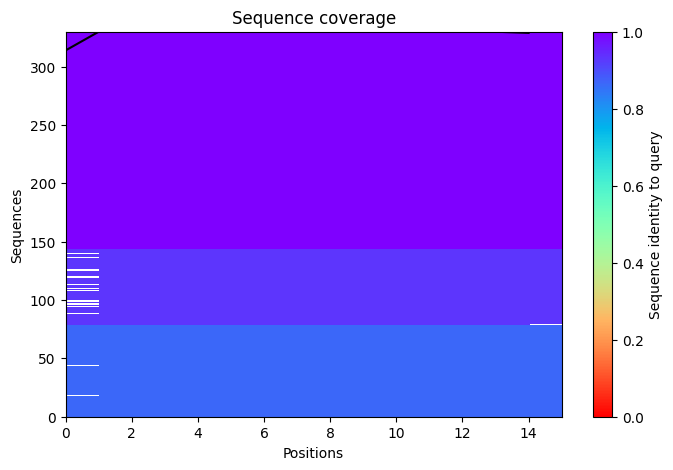

2025-11-17 07:18:02,487 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=86.1 pTM=0.0424
2025-11-17 07:18:23,323 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=86.1 pTM=0.0435 tol=0.183
2025-11-17 07:18:25,926 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=85.8 pTM=0.0437 tol=0.0538
2025-11-17 07:18:28,542 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=86 pTM=0.0438 tol=0.128
2025-11-17 07:18:28,543 alphafold2_ptm_model_1_seed_000 took 46.3s (3 recycles)


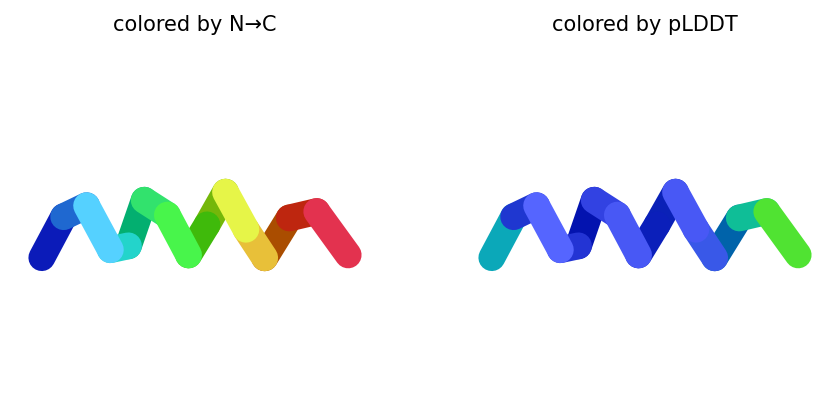

2025-11-17 07:18:31,276 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=83.1 pTM=0.0424
2025-11-17 07:18:33,898 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=85.1 pTM=0.0438 tol=0.0787
2025-11-17 07:18:36,525 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=85.6 pTM=0.044 tol=0.02
2025-11-17 07:18:39,154 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=86 pTM=0.0444 tol=0.0774
2025-11-17 07:18:39,155 alphafold2_ptm_model_2_seed_000 took 10.5s (3 recycles)


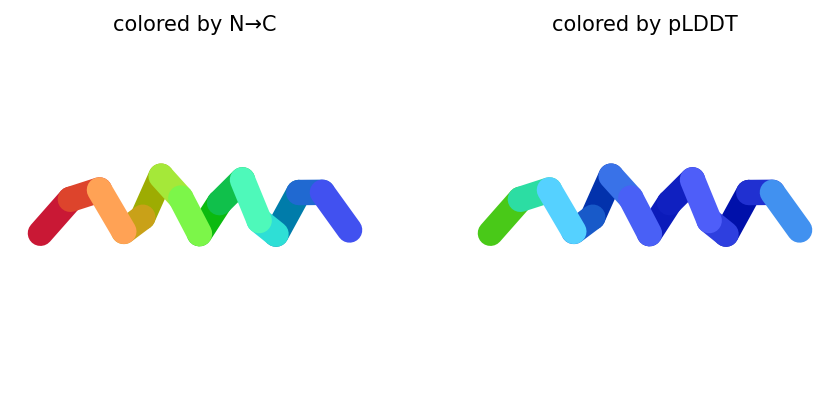

2025-11-17 07:18:41,850 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=69.2 pTM=0.0278
2025-11-17 07:18:44,463 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.5 pTM=0.028 tol=0.276
2025-11-17 07:18:47,074 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=68.3 pTM=0.0277 tol=0.325
2025-11-17 07:18:49,680 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=68.3 pTM=0.0275 tol=1.18
2025-11-17 07:18:49,681 alphafold2_ptm_model_3_seed_000 took 10.5s (3 recycles)


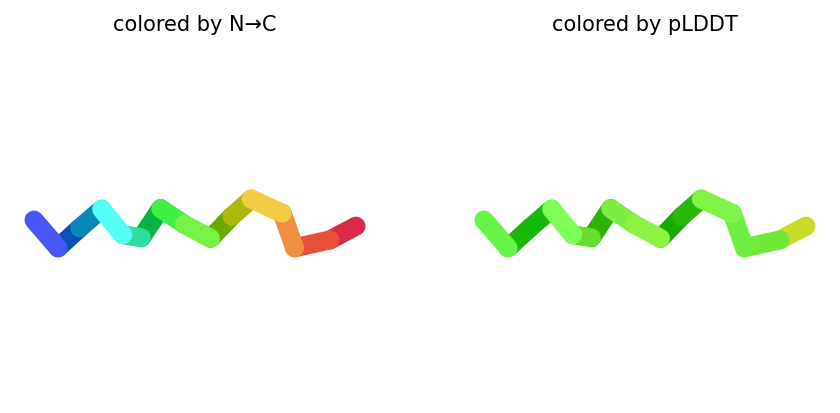

2025-11-17 07:18:52,340 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.4 pTM=0.0353
2025-11-17 07:18:54,941 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=80.4 pTM=0.037 tol=0.173
2025-11-17 07:18:57,543 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=81.4 pTM=0.0371 tol=0.0715
2025-11-17 07:19:00,140 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=82.2 pTM=0.0381 tol=0.0425
2025-11-17 07:19:00,140 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


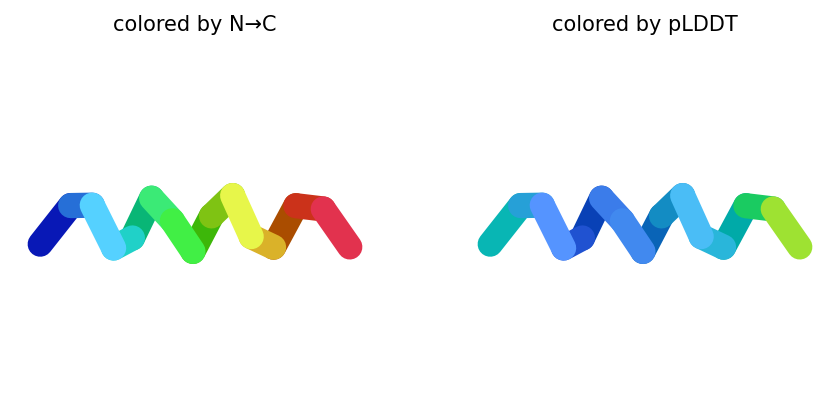

2025-11-17 07:19:02,785 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=88.6 pTM=0.0465
2025-11-17 07:19:05,378 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=88.2 pTM=0.0468 tol=0.16
2025-11-17 07:19:07,970 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=88.2 pTM=0.0465 tol=0.0813
2025-11-17 07:19:10,559 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.2 pTM=0.0469 tol=0.105
2025-11-17 07:19:10,560 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


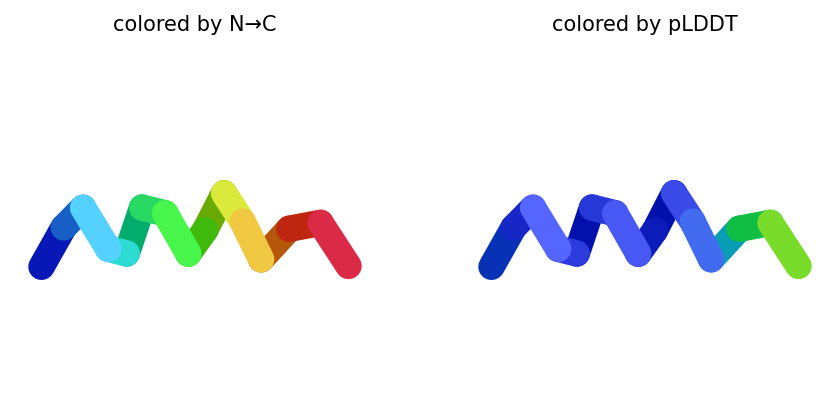

2025-11-17 07:19:10,612 reranking models by 'plddt' metric
2025-11-17 07:19:10,613 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.2 pTM=0.0469
2025-11-17 07:19:10,614 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=86 pTM=0.0444
2025-11-17 07:19:10,615 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=86 pTM=0.0438
2025-11-17 07:19:10,615 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=82.2 pTM=0.0381
2025-11-17 07:19:10,615 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=68.3 pTM=0.0275
2025-11-17 07:19:11,520 Query 2/146: peptide_0_IC50_216.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:19:11,818 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


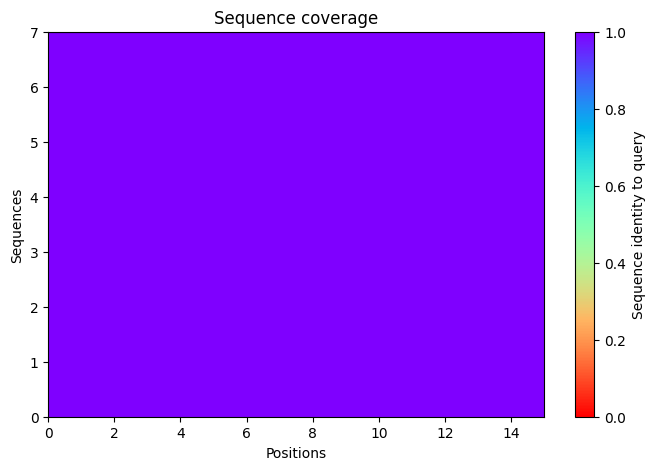

2025-11-17 07:19:24,833 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=59.6 pTM=0.0291
2025-11-17 07:19:27,410 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.4 pTM=0.0362 tol=3.09
2025-11-17 07:19:29,986 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=80.3 pTM=0.0376 tol=0.0836
2025-11-17 07:19:32,566 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=83 pTM=0.0388 tol=0.139
2025-11-17 07:19:32,567 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


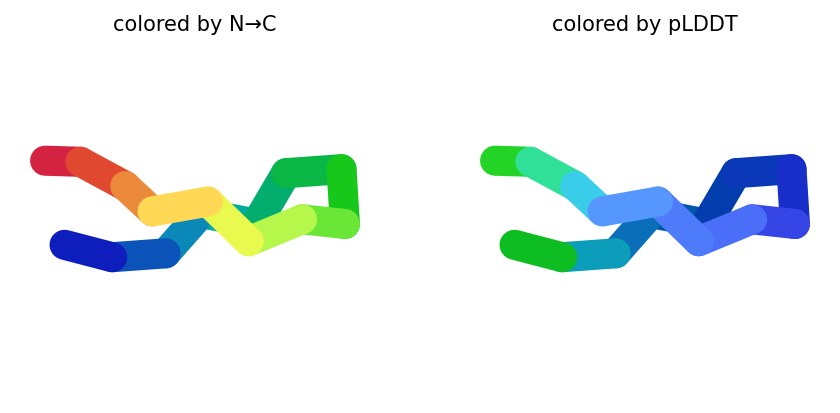

2025-11-17 07:19:35,199 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73 pTM=0.0342
2025-11-17 07:19:37,775 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=81.8 pTM=0.039 tol=0.727
2025-11-17 07:19:40,355 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=83.9 pTM=0.0396 tol=0.0764
2025-11-17 07:19:42,936 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=85.6 pTM=0.0406 tol=0.0671
2025-11-17 07:19:42,937 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


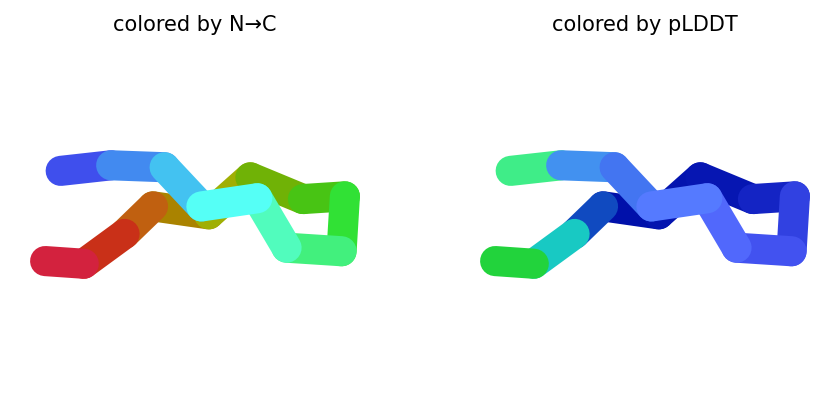

2025-11-17 07:19:45,579 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.3 pTM=0.0355
2025-11-17 07:19:48,163 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.3 pTM=0.0345 tol=0.212
2025-11-17 07:19:50,755 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.3 pTM=0.0358 tol=0.184
2025-11-17 07:19:53,626 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.8 pTM=0.0379 tol=0.128
2025-11-17 07:19:53,627 alphafold2_ptm_model_3_seed_000 took 10.6s (3 recycles)


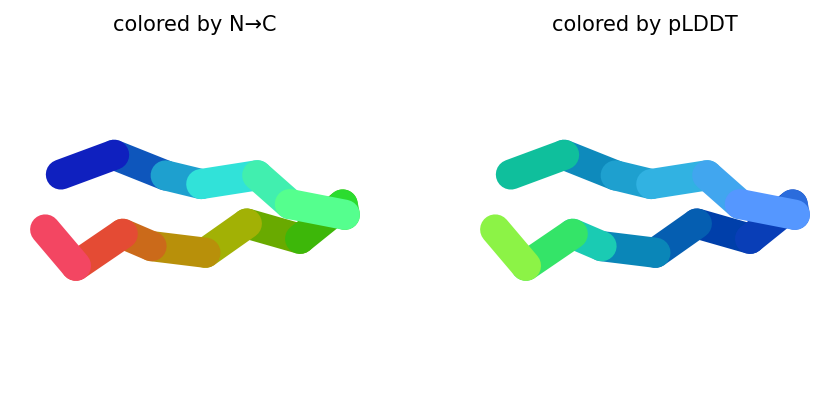

2025-11-17 07:19:56,283 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=60.4 pTM=0.0272
2025-11-17 07:19:58,888 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=84.3 pTM=0.0376 tol=8.7
2025-11-17 07:20:01,486 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=84.1 pTM=0.0386 tol=0.204
2025-11-17 07:20:04,089 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=86.1 pTM=0.04 tol=0.116
2025-11-17 07:20:04,089 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


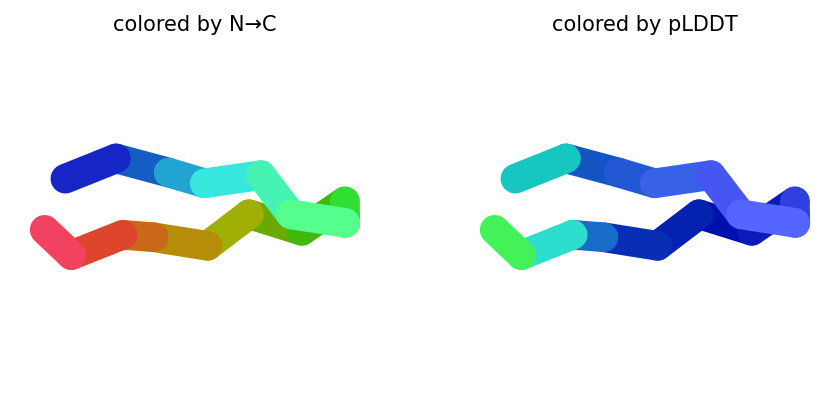

2025-11-17 07:20:06,768 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75 pTM=0.0343
2025-11-17 07:20:09,368 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=84 pTM=0.0388 tol=0.466
2025-11-17 07:20:11,964 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=86.5 pTM=0.0397 tol=0.136
2025-11-17 07:20:14,559 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=87.6 pTM=0.0408 tol=0.0505
2025-11-17 07:20:14,559 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


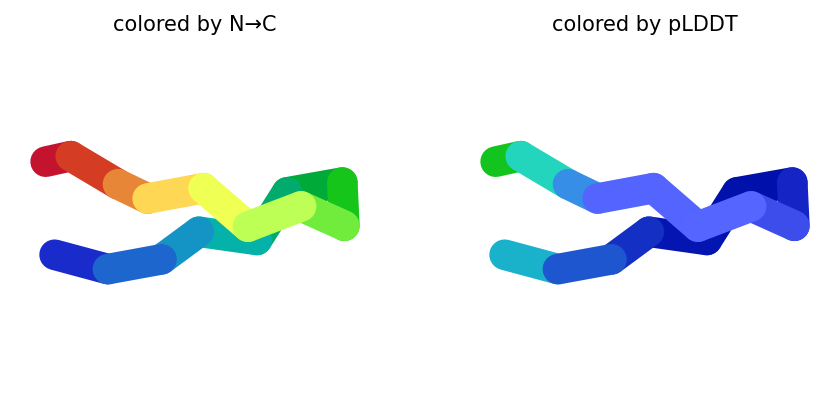

2025-11-17 07:20:14,613 reranking models by 'plddt' metric
2025-11-17 07:20:14,613 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=87.6 pTM=0.0408
2025-11-17 07:20:14,614 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=86.1 pTM=0.04
2025-11-17 07:20:14,614 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=85.6 pTM=0.0406
2025-11-17 07:20:14,614 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=83 pTM=0.0388
2025-11-17 07:20:14,614 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=81.8 pTM=0.0379
2025-11-17 07:20:15,808 Query 3/146: peptide_1_IC50_215.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:20:16,087 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


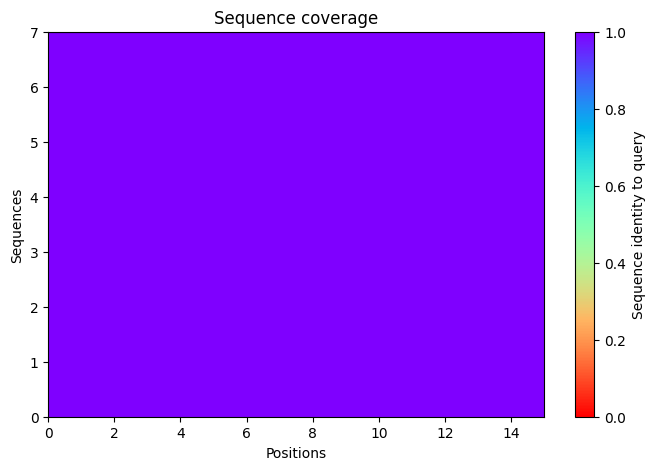

2025-11-17 07:20:26,051 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61 pTM=0.0286
2025-11-17 07:20:28,631 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=63.5 pTM=0.0291 tol=1.16
2025-11-17 07:20:31,206 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=65.5 pTM=0.0306 tol=0.843
2025-11-17 07:20:33,781 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.9 pTM=0.0322 tol=0.534
2025-11-17 07:20:33,782 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


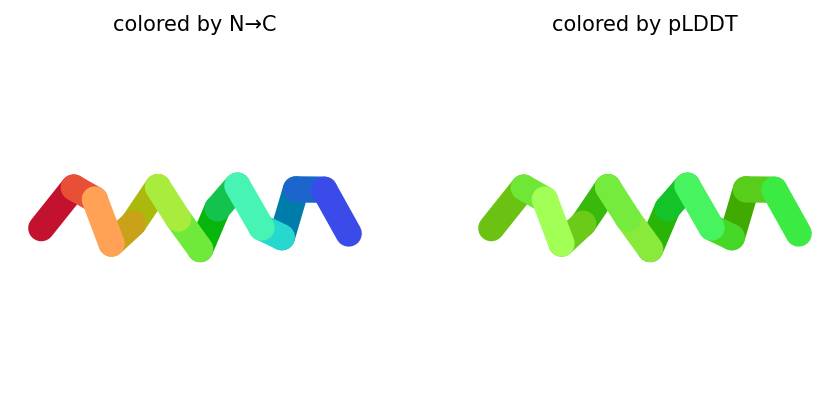

2025-11-17 07:20:36,414 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.2 pTM=0.0274
2025-11-17 07:20:38,992 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.3 pTM=0.0268 tol=0.563
2025-11-17 07:20:41,573 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69.8 pTM=0.0328 tol=7.55
2025-11-17 07:20:44,154 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76.2 pTM=0.0361 tol=0.457
2025-11-17 07:20:44,155 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


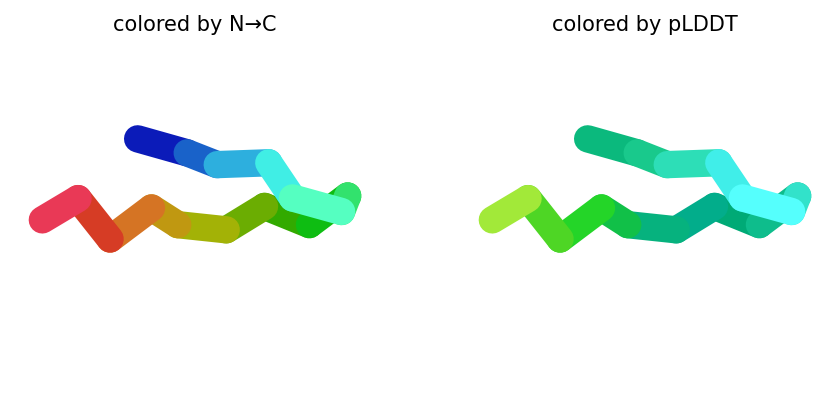

2025-11-17 07:20:46,789 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=59.7 pTM=0.0261
2025-11-17 07:20:49,365 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=60.7 pTM=0.0267 tol=1.71
2025-11-17 07:20:51,942 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63.8 pTM=0.0285 tol=1.31
2025-11-17 07:20:54,529 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=67.1 pTM=0.0292 tol=0.431
2025-11-17 07:20:54,530 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


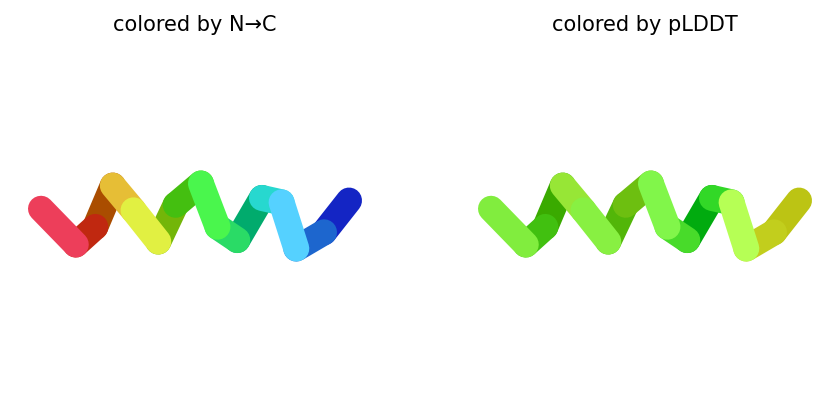

2025-11-17 07:20:57,166 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=58.5 pTM=0.0269
2025-11-17 07:20:59,748 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=58 pTM=0.0272 tol=0.879
2025-11-17 07:21:02,335 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=60.5 pTM=0.0276 tol=1.03
2025-11-17 07:21:04,916 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=63.5 pTM=0.0285 tol=1.15
2025-11-17 07:21:04,917 alphafold2_ptm_model_4_seed_000 took 10.3s (3 recycles)


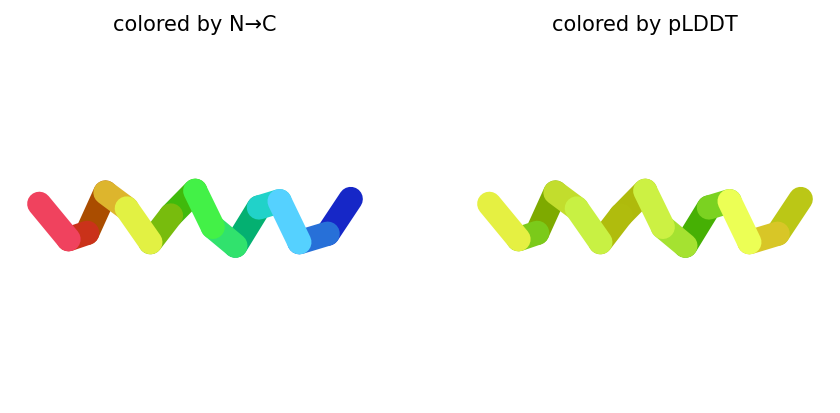

2025-11-17 07:21:07,586 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.6 pTM=0.0331
2025-11-17 07:21:10,166 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.1 pTM=0.0332 tol=0.0881
2025-11-17 07:21:12,752 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=69.1 pTM=0.0328 tol=0.147
2025-11-17 07:21:15,335 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.9 pTM=0.0321 tol=0.0839
2025-11-17 07:21:15,336 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


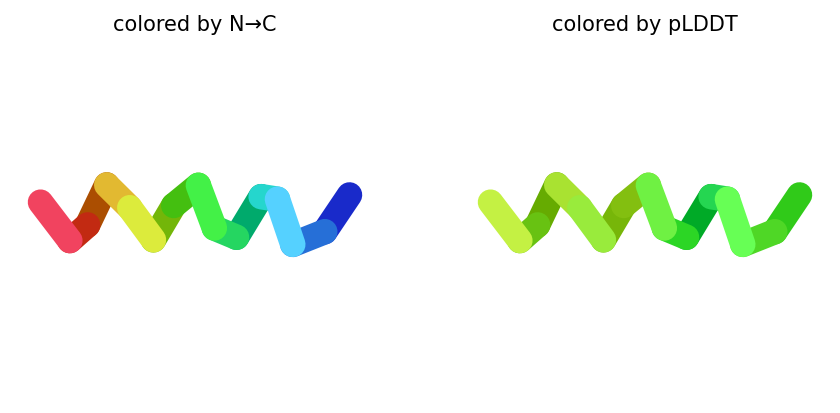

2025-11-17 07:21:15,422 reranking models by 'plddt' metric
2025-11-17 07:21:15,423 rank_001_alphafold2_ptm_model_2_seed_000 pLDDT=76.2 pTM=0.0361
2025-11-17 07:21:15,424 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=68.9 pTM=0.0322
2025-11-17 07:21:15,424 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=67.9 pTM=0.0321
2025-11-17 07:21:15,424 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=67.1 pTM=0.0292
2025-11-17 07:21:15,425 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=63.5 pTM=0.0285
2025-11-17 07:21:16,746 Query 4/146: peptide_2_IC50_209.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:21:17,026 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


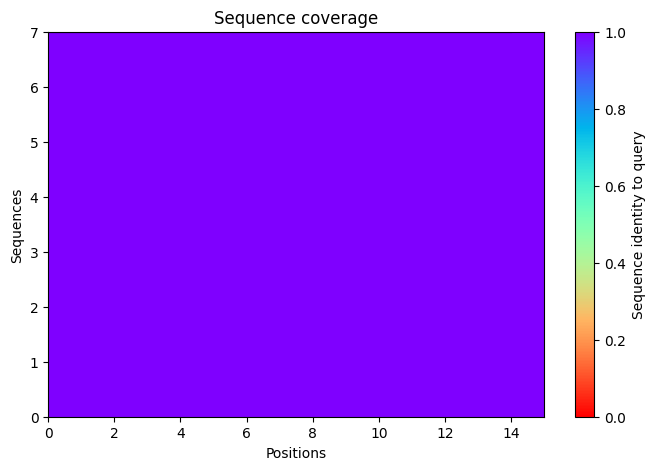

2025-11-17 07:21:28,497 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=56.6 pTM=0.0284
2025-11-17 07:21:31,072 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=57.5 pTM=0.0283 tol=1.46
2025-11-17 07:21:33,647 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=58.7 pTM=0.0286 tol=0.943
2025-11-17 07:21:36,222 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=57.1 pTM=0.0286 tol=1.31
2025-11-17 07:21:36,223 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


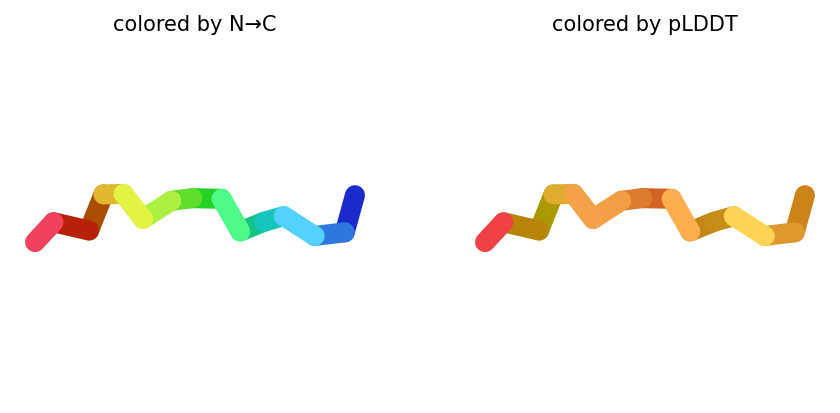

2025-11-17 07:21:38,855 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.8 pTM=0.0276
2025-11-17 07:21:41,436 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.8 pTM=0.0271 tol=0.501
2025-11-17 07:21:44,024 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=58.4 pTM=0.027 tol=0.812
2025-11-17 07:21:46,607 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=58.7 pTM=0.027 tol=1.69
2025-11-17 07:21:46,608 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


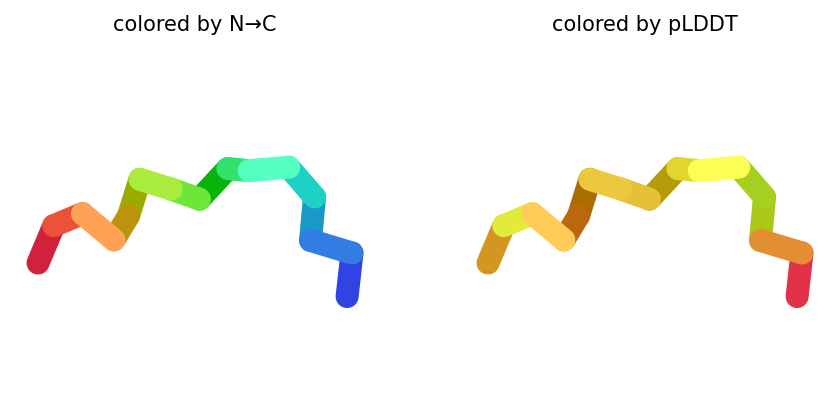

2025-11-17 07:21:49,251 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=57.7 pTM=0.026
2025-11-17 07:21:51,843 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=59.1 pTM=0.0264 tol=1.17
2025-11-17 07:21:54,436 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=61.7 pTM=0.0269 tol=0.87
2025-11-17 07:21:57,025 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=63.2 pTM=0.0277 tol=1.47
2025-11-17 07:21:57,026 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


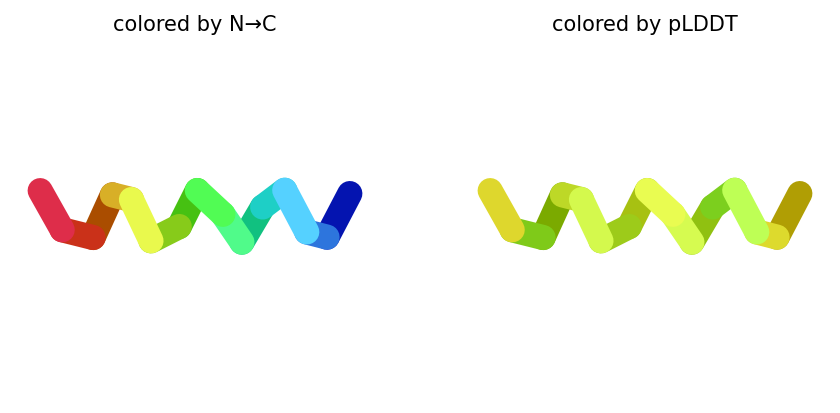

2025-11-17 07:21:59,670 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=58.4 pTM=0.0268
2025-11-17 07:22:02,258 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=58.3 pTM=0.0274 tol=0.545
2025-11-17 07:22:04,838 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=58.7 pTM=0.0279 tol=0.602
2025-11-17 07:22:07,425 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=61.8 pTM=0.0285 tol=1.32
2025-11-17 07:22:07,426 alphafold2_ptm_model_4_seed_000 took 10.3s (3 recycles)


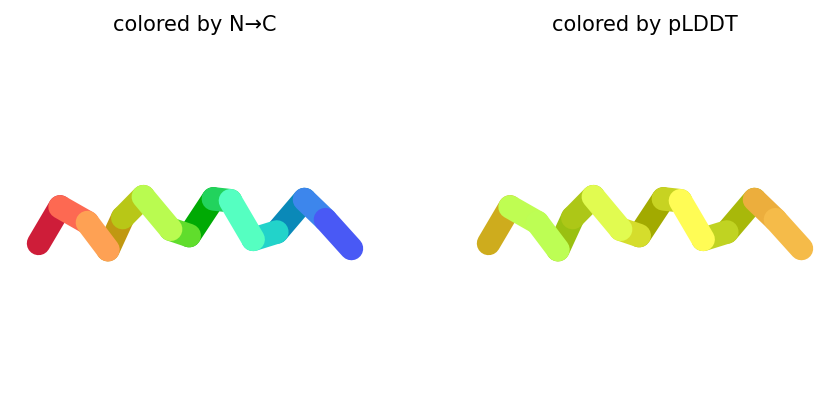

2025-11-17 07:22:10,063 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=56.4 pTM=0.0269
2025-11-17 07:22:12,641 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=59 pTM=0.027 tol=0.572
2025-11-17 07:22:15,219 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=58.2 pTM=0.0273 tol=0.472
2025-11-17 07:22:17,803 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=59 pTM=0.0272 tol=0.296
2025-11-17 07:22:17,804 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


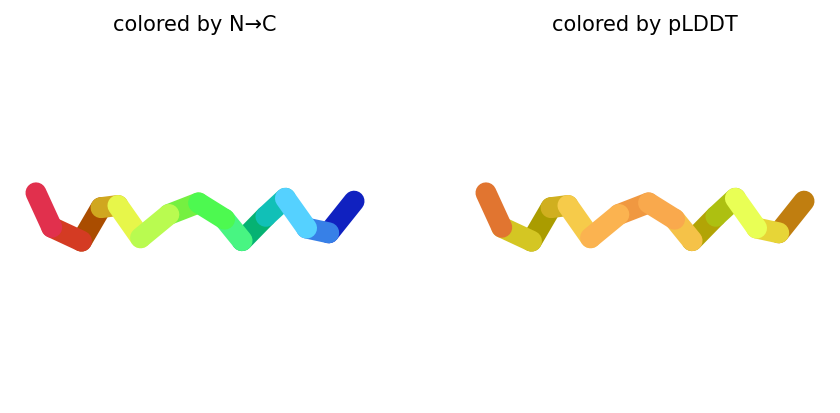

2025-11-17 07:22:17,884 reranking models by 'plddt' metric
2025-11-17 07:22:17,885 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=63.2 pTM=0.0277
2025-11-17 07:22:17,885 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=61.8 pTM=0.0285
2025-11-17 07:22:17,886 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=59 pTM=0.0272
2025-11-17 07:22:17,886 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=58.7 pTM=0.027
2025-11-17 07:22:17,886 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=57.1 pTM=0.0286
2025-11-17 07:22:18,827 Query 5/146: peptide_3_IC50_217.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:22:19,110 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


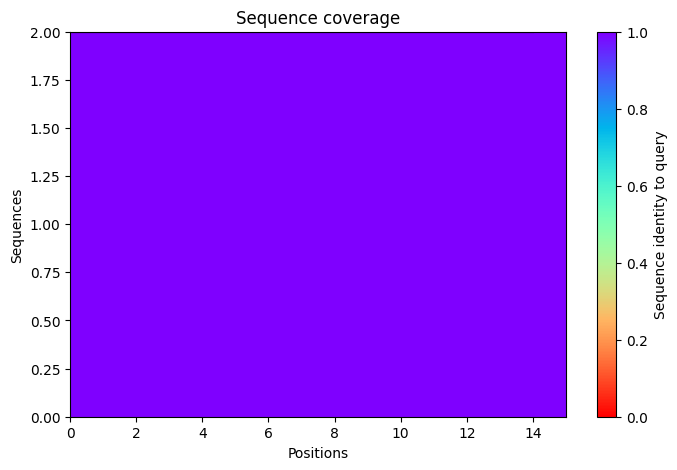

2025-11-17 07:22:33,149 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=74.2 pTM=0.0285
2025-11-17 07:22:35,730 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=79.2 pTM=0.0288 tol=0.799
2025-11-17 07:22:38,308 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79.4 pTM=0.0292 tol=0.0659
2025-11-17 07:22:40,892 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=79.1 pTM=0.0296 tol=0.22
2025-11-17 07:22:40,893 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


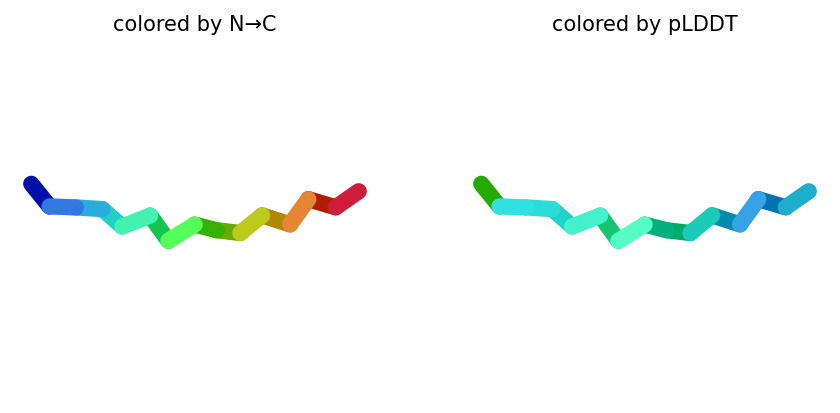

2025-11-17 07:22:43,570 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70.1 pTM=0.0268
2025-11-17 07:22:46,152 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.5 pTM=0.0268 tol=1.03
2025-11-17 07:22:48,734 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.4 pTM=0.0271 tol=0.827
2025-11-17 07:22:51,314 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.7 pTM=0.0276 tol=0.186
2025-11-17 07:22:51,315 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


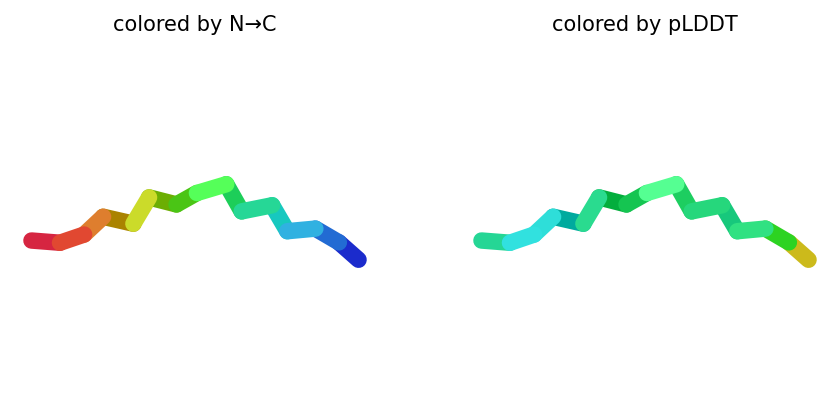

2025-11-17 07:22:53,952 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=75.7 pTM=0.0273
2025-11-17 07:22:56,544 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=77.8 pTM=0.0273 tol=0.588
2025-11-17 07:22:59,138 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.9 pTM=0.0278 tol=0.132
2025-11-17 07:23:01,733 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77.8 pTM=0.0279 tol=0.0804
2025-11-17 07:23:01,734 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


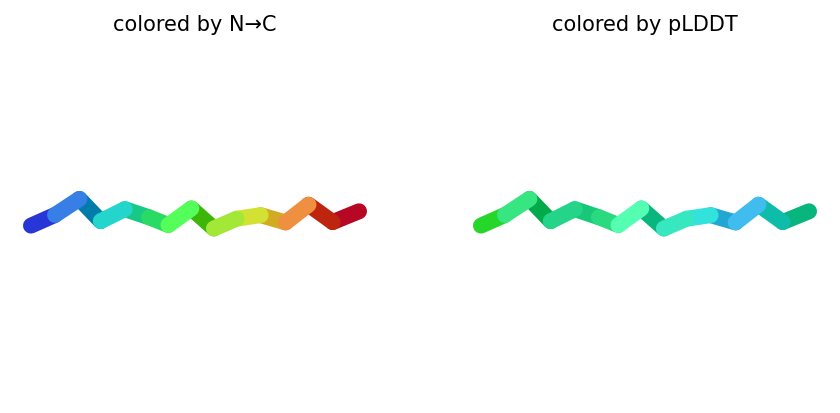

2025-11-17 07:23:04,393 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.1 pTM=0.0287
2025-11-17 07:23:06,993 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.9 pTM=0.0289 tol=0.404
2025-11-17 07:23:09,591 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.2 pTM=0.0289 tol=0.383
2025-11-17 07:23:12,187 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=78.1 pTM=0.0292 tol=0.338
2025-11-17 07:23:12,188 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


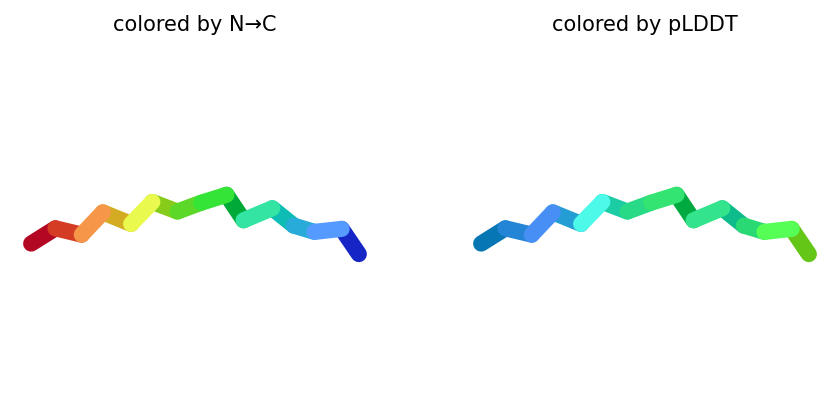

2025-11-17 07:23:14,837 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=74 pTM=0.028
2025-11-17 07:23:17,430 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=77.9 pTM=0.0281 tol=0.288
2025-11-17 07:23:20,022 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=78.6 pTM=0.0284 tol=0.193
2025-11-17 07:23:22,614 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78.5 pTM=0.0285 tol=0.231
2025-11-17 07:23:22,615 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


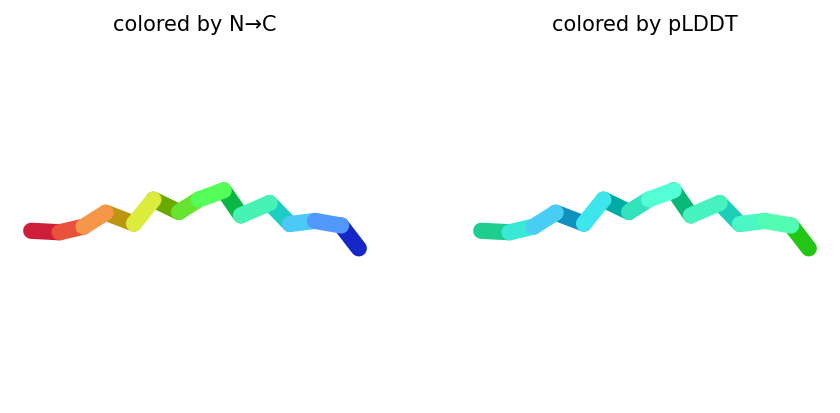

2025-11-17 07:23:22,664 reranking models by 'plddt' metric
2025-11-17 07:23:22,664 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=79.1 pTM=0.0296
2025-11-17 07:23:22,664 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=78.5 pTM=0.0285
2025-11-17 07:23:22,665 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=78.1 pTM=0.0292
2025-11-17 07:23:22,665 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=77.8 pTM=0.0279
2025-11-17 07:23:22,665 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.7 pTM=0.0276
2025-11-17 07:23:23,576 Query 6/146: peptide_19_IC50_231.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:23:23,856 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


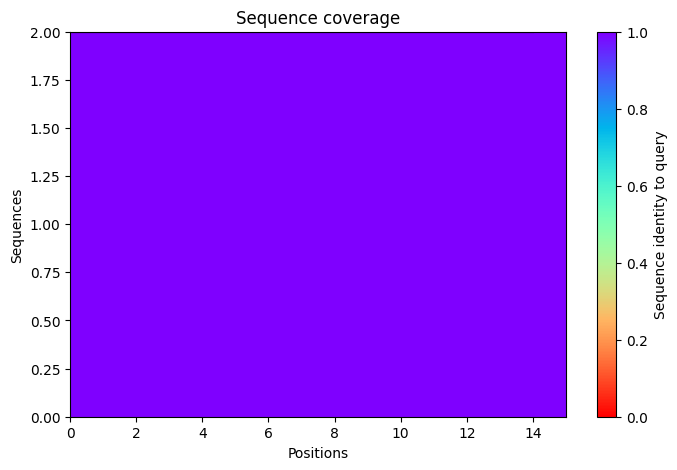

2025-11-17 07:23:37,871 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.6 pTM=0.029
2025-11-17 07:23:40,446 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77 pTM=0.0298 tol=1.26
2025-11-17 07:23:43,025 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.3 pTM=0.0299 tol=0.281
2025-11-17 07:23:45,603 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=77.9 pTM=0.0296 tol=0.561
2025-11-17 07:23:45,603 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


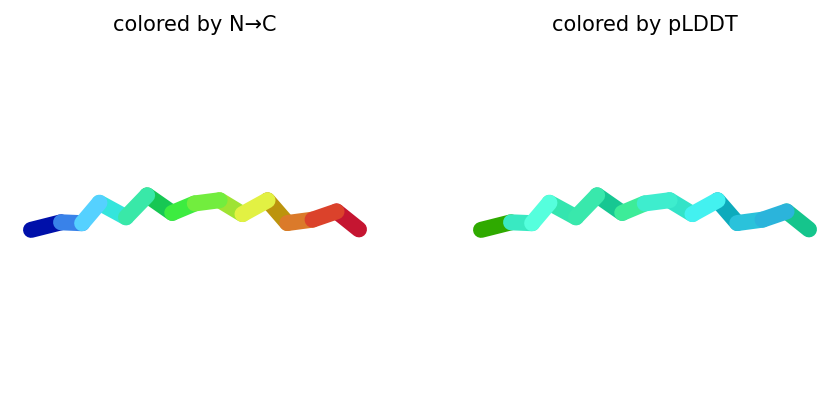

2025-11-17 07:23:48,230 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.6 pTM=0.0277
2025-11-17 07:23:50,810 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73 pTM=0.0285 tol=0.666
2025-11-17 07:23:53,394 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.4 pTM=0.0289 tol=0.135
2025-11-17 07:23:55,974 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.6 pTM=0.0287 tol=0.118
2025-11-17 07:23:55,975 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


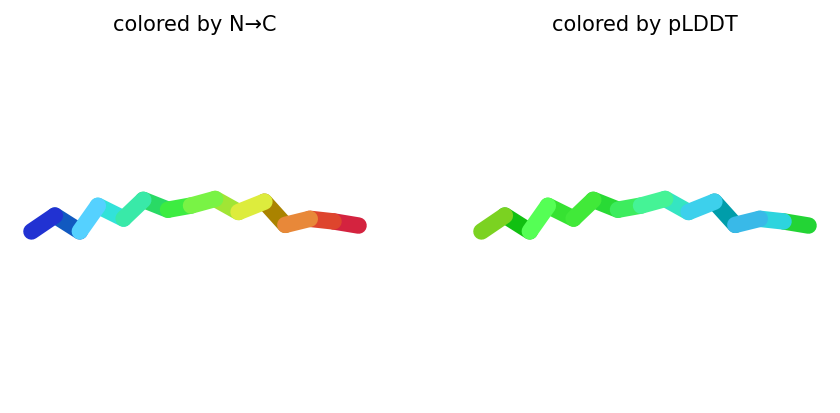

2025-11-17 07:23:58,609 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.1 pTM=0.0282
2025-11-17 07:24:01,198 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.2 pTM=0.0282 tol=0.386
2025-11-17 07:24:03,785 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=79.4 pTM=0.0283 tol=0.0936
2025-11-17 07:24:06,379 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=78.9 pTM=0.0283 tol=0.198
2025-11-17 07:24:06,380 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


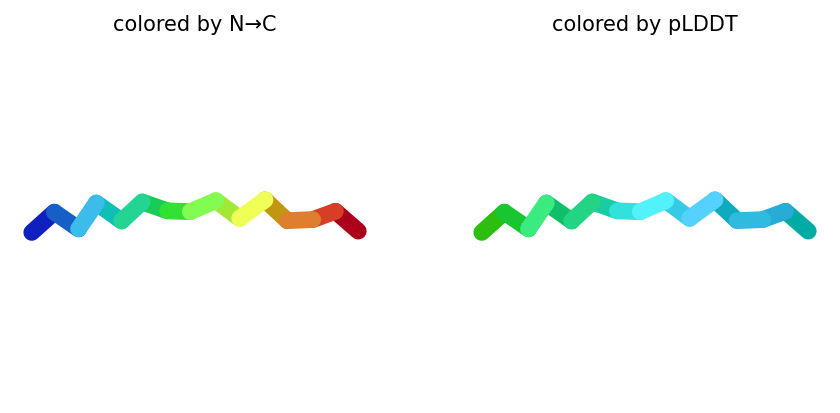

2025-11-17 07:24:09,031 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=77.9 pTM=0.0294
2025-11-17 07:24:11,629 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.9 pTM=0.0289 tol=0.147
2025-11-17 07:24:14,230 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.8 pTM=0.029 tol=0.244
2025-11-17 07:24:16,829 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=77.1 pTM=0.0288 tol=0.0828
2025-11-17 07:24:16,829 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


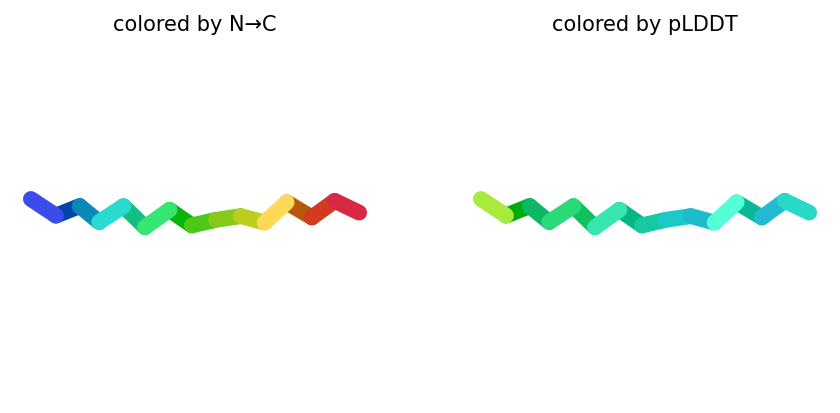

2025-11-17 07:24:19,501 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.8 pTM=0.0277
2025-11-17 07:24:22,097 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.6 pTM=0.0284 tol=0.76
2025-11-17 07:24:24,689 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=77.1 pTM=0.0287 tol=0.2
2025-11-17 07:24:27,281 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.9 pTM=0.0282 tol=0.399
2025-11-17 07:24:27,282 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


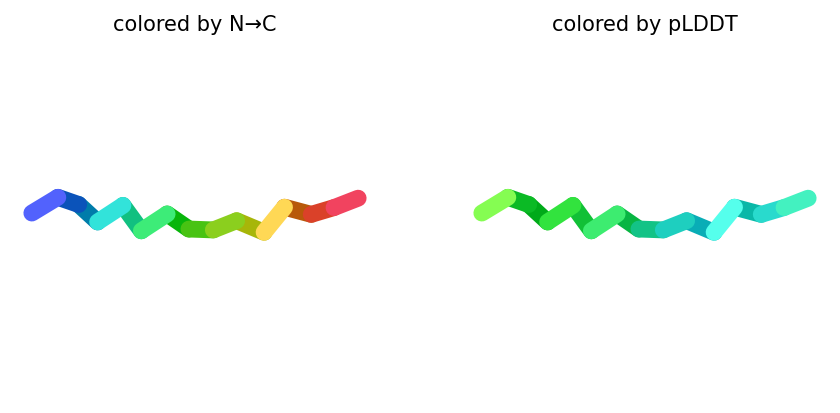

2025-11-17 07:24:27,331 reranking models by 'plddt' metric
2025-11-17 07:24:27,332 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=78.9 pTM=0.0283
2025-11-17 07:24:27,333 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=77.9 pTM=0.0296
2025-11-17 07:24:27,333 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=77.1 pTM=0.0288
2025-11-17 07:24:27,333 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=75.9 pTM=0.0282
2025-11-17 07:24:27,333 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.6 pTM=0.0287
2025-11-17 07:24:28,257 Query 7/146: peptide_21_IC50_242.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:24:28,539 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


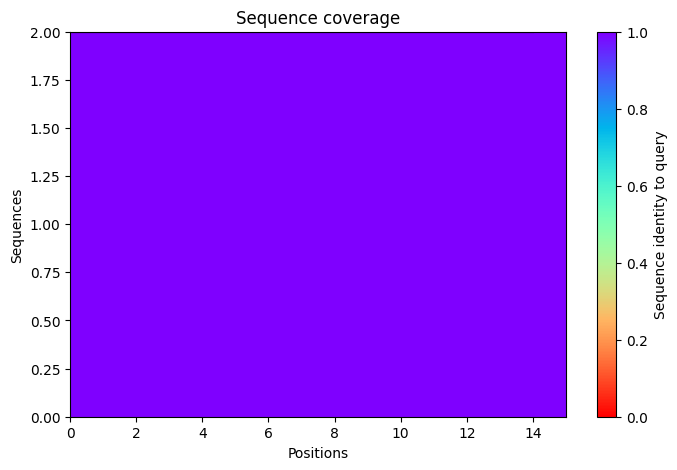

2025-11-17 07:24:40,527 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=82.2 pTM=0.0426
2025-11-17 07:24:43,103 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=84 pTM=0.044 tol=0.0861
2025-11-17 07:24:45,677 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.8 pTM=0.0436 tol=0.108
2025-11-17 07:24:48,251 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.6 pTM=0.043 tol=0.0613
2025-11-17 07:24:48,252 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


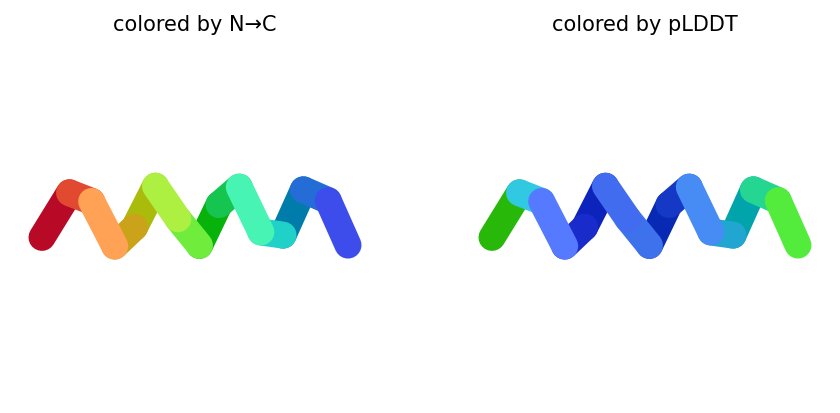

2025-11-17 07:24:50,882 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=75 pTM=0.0401
2025-11-17 07:24:53,464 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.7 pTM=0.0407 tol=0.14
2025-11-17 07:24:56,046 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.4 pTM=0.0399 tol=0.154
2025-11-17 07:24:58,629 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=73 pTM=0.0396 tol=0.097
2025-11-17 07:24:58,630 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


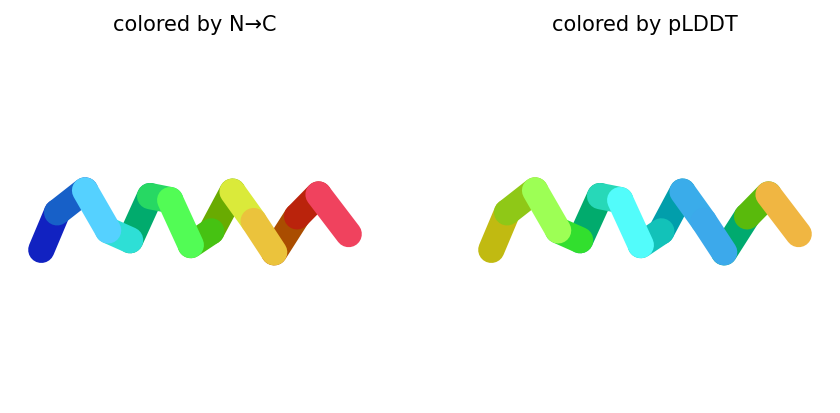

2025-11-17 07:25:01,719 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=79.9 pTM=0.0377
2025-11-17 07:25:04,312 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=83.6 pTM=0.0407 tol=0.0975
2025-11-17 07:25:06,903 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=84.6 pTM=0.0415 tol=0.0513
2025-11-17 07:25:09,490 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=85.1 pTM=0.0417 tol=0.0414
2025-11-17 07:25:09,491 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


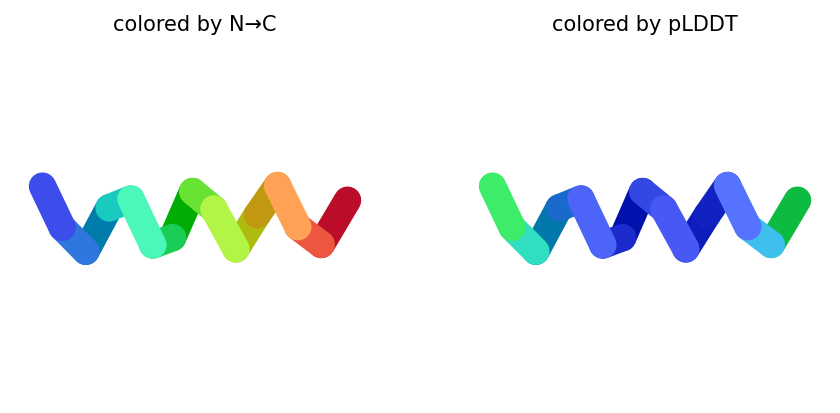

2025-11-17 07:25:12,134 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=84.1 pTM=0.0426
2025-11-17 07:25:14,721 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=84.8 pTM=0.0437 tol=0.0786
2025-11-17 07:25:17,312 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=84.9 pTM=0.044 tol=0.0264
2025-11-17 07:25:19,899 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=85 pTM=0.0437 tol=0.0392
2025-11-17 07:25:19,900 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


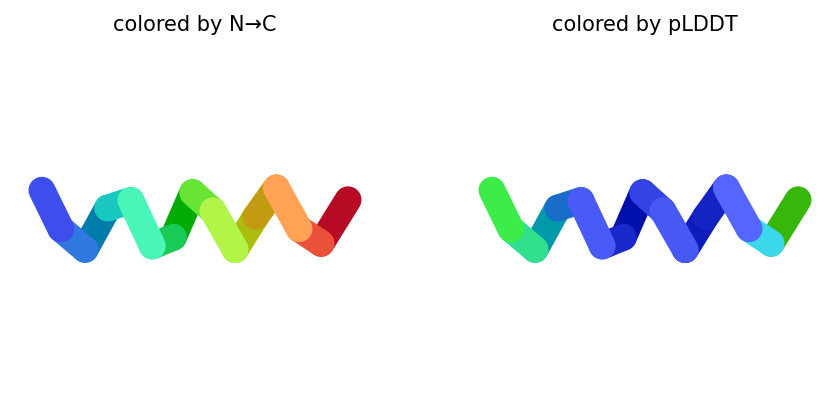

2025-11-17 07:25:22,542 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=88.1 pTM=0.0437
2025-11-17 07:25:25,129 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=89 pTM=0.0445 tol=0.0959
2025-11-17 07:25:27,708 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=88.4 pTM=0.0447 tol=0.0368
2025-11-17 07:25:30,293 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.4 pTM=0.0448 tol=0.0273
2025-11-17 07:25:30,293 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


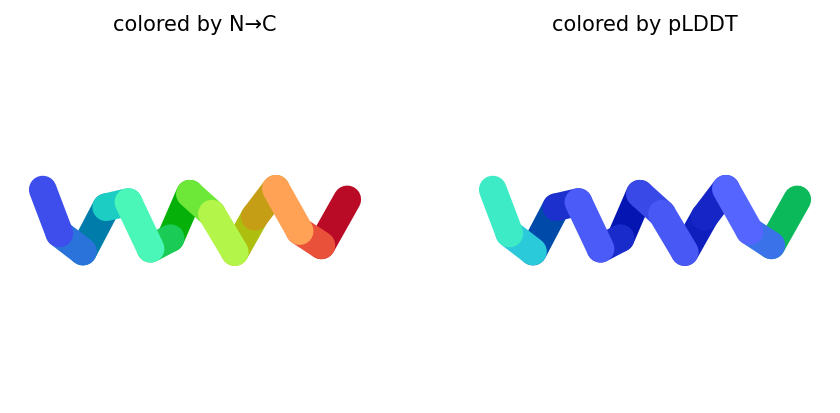

2025-11-17 07:25:30,343 reranking models by 'plddt' metric
2025-11-17 07:25:30,344 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.4 pTM=0.0448
2025-11-17 07:25:30,344 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=85.1 pTM=0.0417
2025-11-17 07:25:30,344 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=85 pTM=0.0437
2025-11-17 07:25:30,344 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=82.6 pTM=0.043
2025-11-17 07:25:30,345 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=73 pTM=0.0396
2025-11-17 07:25:31,274 Query 8/146: peptide_22_IC50_236.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:25:31,548 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


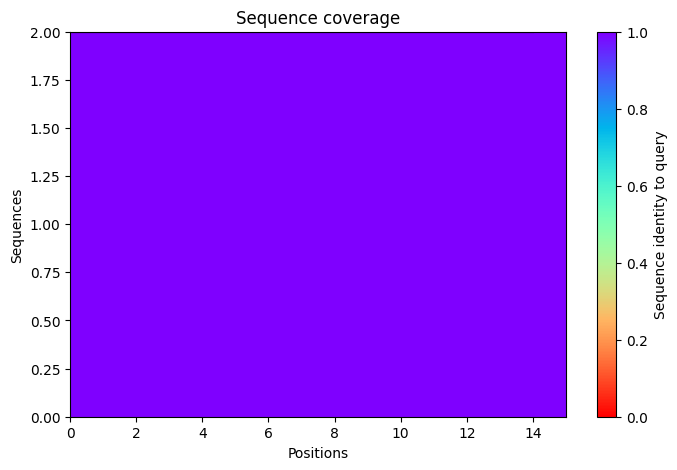

2025-11-17 07:25:46,606 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66.5 pTM=0.0286
2025-11-17 07:25:49,184 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=75.4 pTM=0.0294 tol=1.57
2025-11-17 07:25:51,765 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.5 pTM=0.0295 tol=0.153
2025-11-17 07:25:54,344 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=77.4 pTM=0.0295 tol=0.134
2025-11-17 07:25:54,345 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


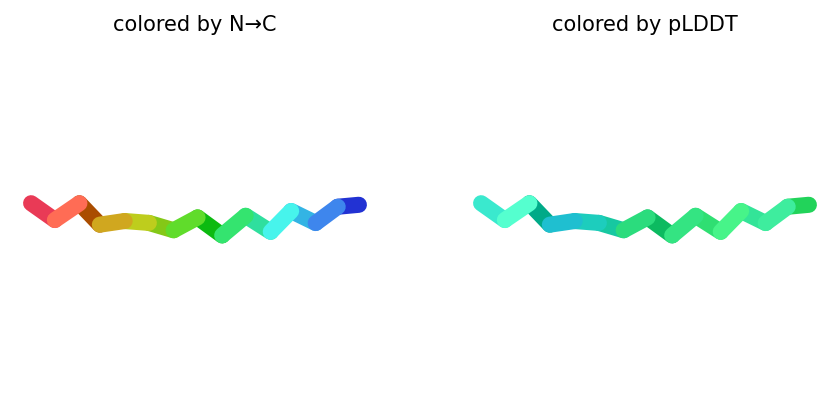

2025-11-17 07:25:56,985 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.7 pTM=0.0274
2025-11-17 07:25:59,567 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.8 pTM=0.0282 tol=0.545
2025-11-17 07:26:02,149 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.2 pTM=0.0285 tol=0.323
2025-11-17 07:26:04,732 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=77.1 pTM=0.0288 tol=0.115
2025-11-17 07:26:04,733 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


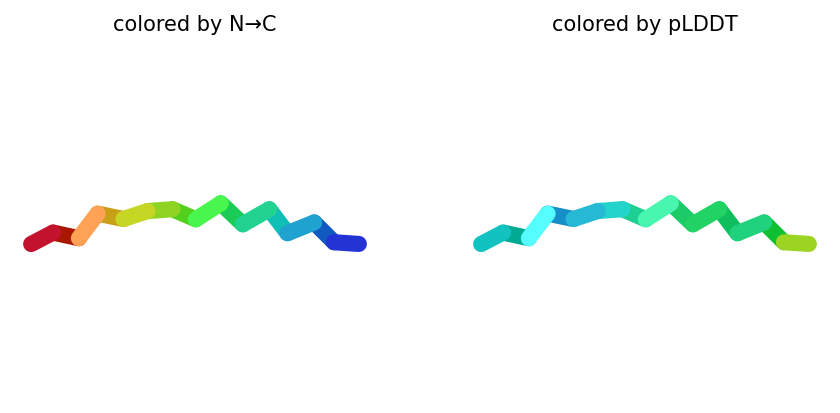

2025-11-17 07:26:07,405 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.3 pTM=0.0276
2025-11-17 07:26:09,996 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.9 pTM=0.0276 tol=0.682
2025-11-17 07:26:12,596 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.5 pTM=0.0275 tol=0.383
2025-11-17 07:26:15,194 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.7 pTM=0.0273 tol=0.613
2025-11-17 07:26:15,195 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


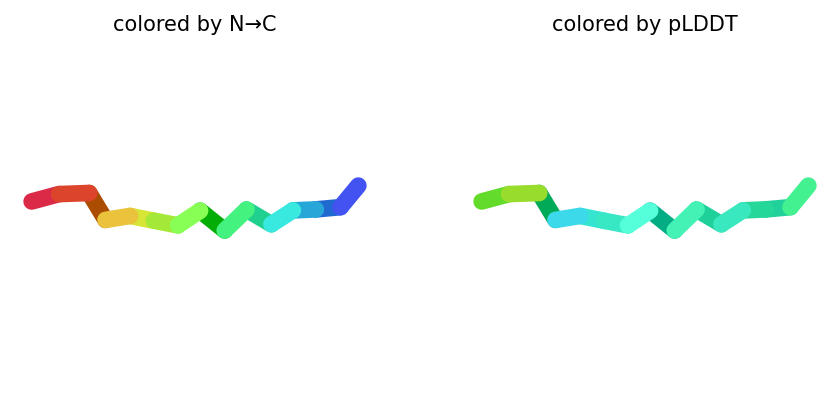

2025-11-17 07:26:17,850 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=74.8 pTM=0.0289
2025-11-17 07:26:20,455 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.7 pTM=0.0284 tol=0.209
2025-11-17 07:26:23,053 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78.1 pTM=0.0291 tol=0.0862
2025-11-17 07:26:25,647 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=78.5 pTM=0.029 tol=0.0895
2025-11-17 07:26:25,648 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


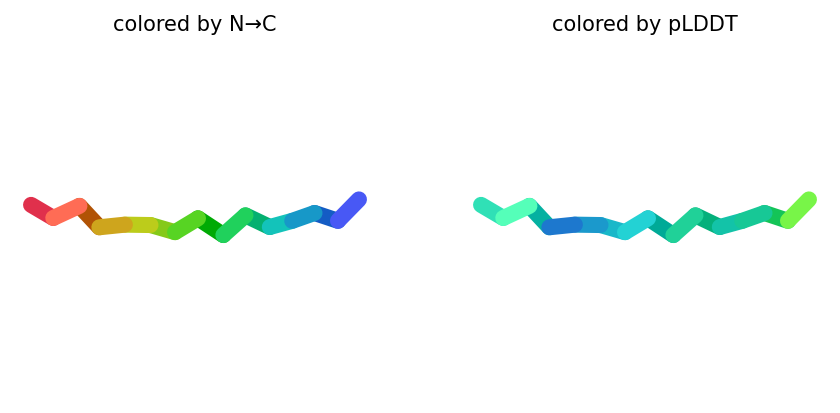

2025-11-17 07:26:28,295 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.5 pTM=0.0273
2025-11-17 07:26:30,890 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=75.9 pTM=0.0282 tol=0.43
2025-11-17 07:26:33,482 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=79.1 pTM=0.0287 tol=0.154
2025-11-17 07:26:36,069 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78.5 pTM=0.0287 tol=0.205
2025-11-17 07:26:36,070 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


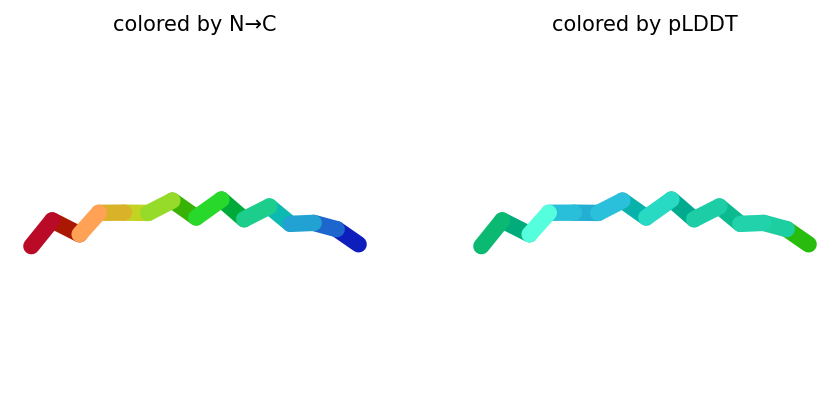

2025-11-17 07:26:36,119 reranking models by 'plddt' metric
2025-11-17 07:26:36,119 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=78.5 pTM=0.0287
2025-11-17 07:26:36,120 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=78.5 pTM=0.029
2025-11-17 07:26:36,120 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=77.4 pTM=0.0295
2025-11-17 07:26:36,120 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=77.1 pTM=0.0288
2025-11-17 07:26:36,120 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=76.7 pTM=0.0273
2025-11-17 07:26:37,052 Query 9/146: peptide_25_IC50_238.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:26:37,694 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


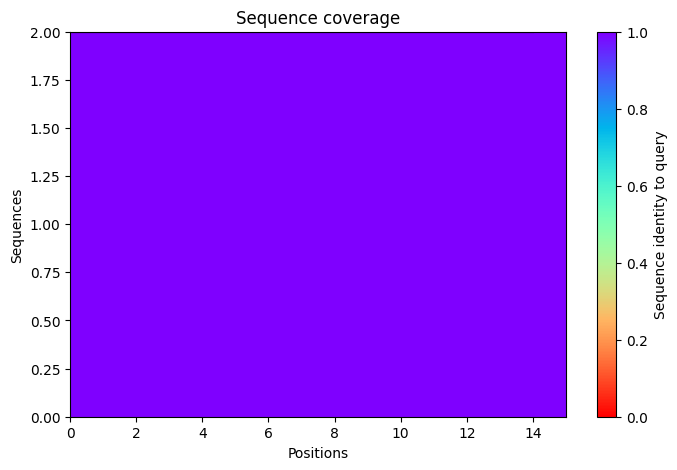

2025-11-17 07:26:49,692 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75 pTM=0.0284
2025-11-17 07:26:52,267 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=75.1 pTM=0.0296 tol=0.364
2025-11-17 07:26:54,846 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.1 pTM=0.0298 tol=0.192
2025-11-17 07:26:57,420 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=70.1 pTM=0.0292 tol=0.832
2025-11-17 07:26:57,421 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


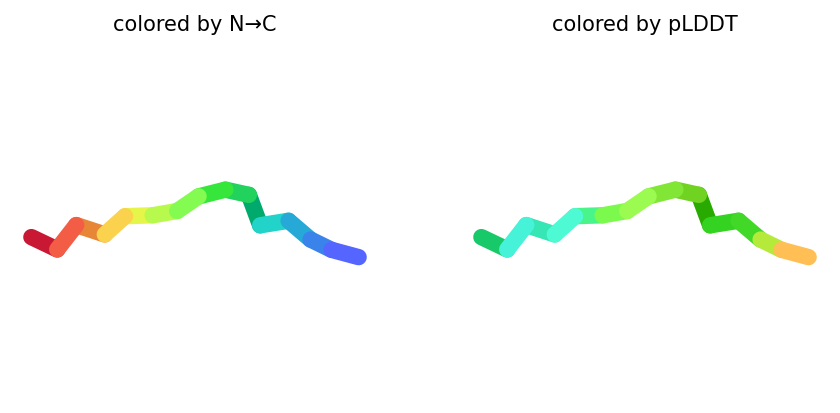

2025-11-17 07:27:00,052 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.5 pTM=0.0275
2025-11-17 07:27:02,629 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.8 pTM=0.0274 tol=0.29
2025-11-17 07:27:05,212 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.9 pTM=0.0275 tol=0.504
2025-11-17 07:27:07,795 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.3 pTM=0.0274 tol=0.341
2025-11-17 07:27:07,796 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


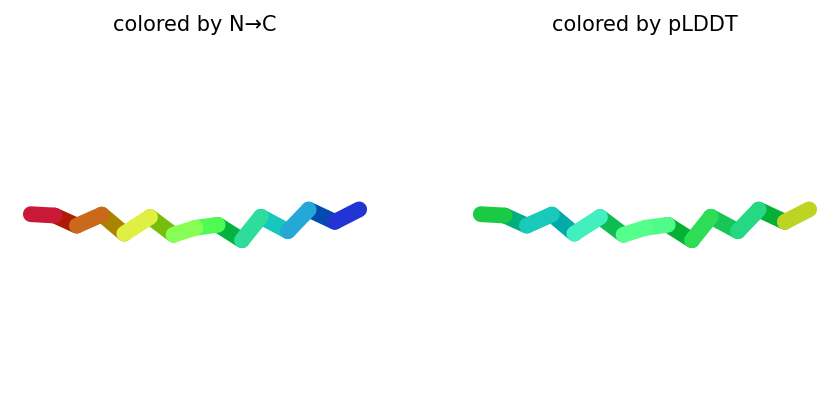

2025-11-17 07:27:10,425 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=79.2 pTM=0.0274
2025-11-17 07:27:13,014 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.5 pTM=0.0277 tol=0.336
2025-11-17 07:27:15,600 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.2 pTM=0.0281 tol=0.093
2025-11-17 07:27:18,193 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.1 pTM=0.0276 tol=0.103
2025-11-17 07:27:18,193 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


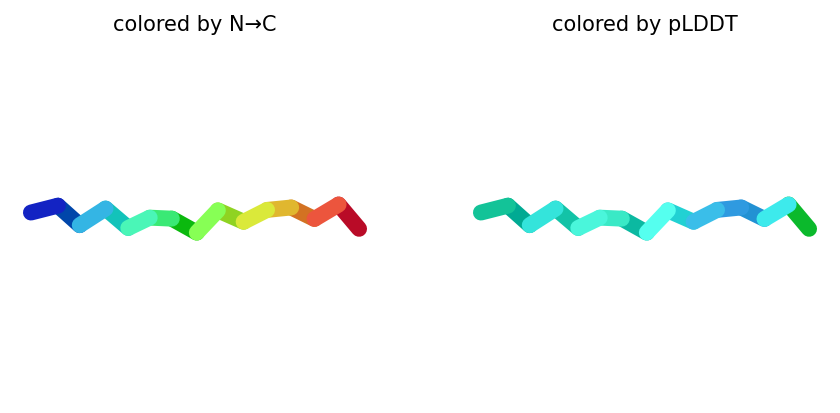

2025-11-17 07:27:20,837 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=77.2 pTM=0.0284
2025-11-17 07:27:23,434 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.9 pTM=0.0284 tol=0.639
2025-11-17 07:27:26,034 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.2 pTM=0.0284 tol=0.0818
2025-11-17 07:27:28,638 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.8 pTM=0.0283 tol=0.162
2025-11-17 07:27:28,639 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


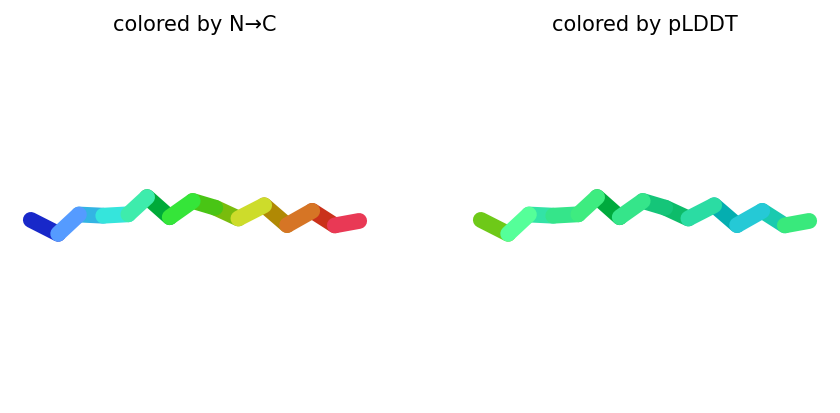

2025-11-17 07:27:31,321 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=73.6 pTM=0.0281
2025-11-17 07:27:33,914 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.4 pTM=0.028 tol=0.632
2025-11-17 07:27:36,504 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76.2 pTM=0.028 tol=0.174
2025-11-17 07:27:39,092 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=73.8 pTM=0.0279 tol=0.233
2025-11-17 07:27:39,093 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


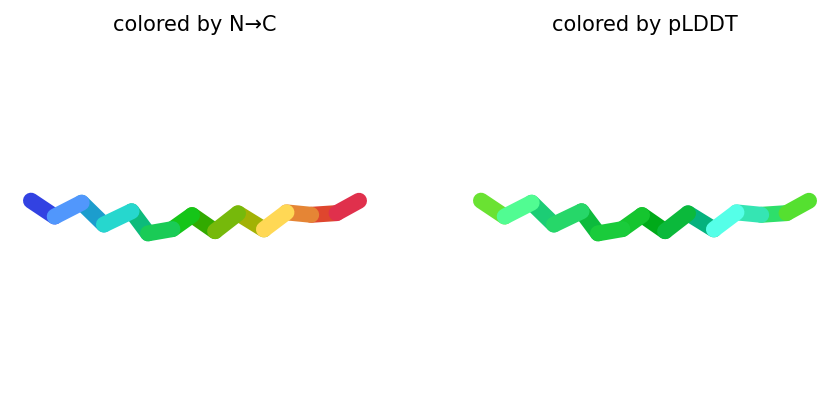

2025-11-17 07:27:39,144 reranking models by 'plddt' metric
2025-11-17 07:27:39,145 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=80.1 pTM=0.0276
2025-11-17 07:27:39,145 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=75.8 pTM=0.0283
2025-11-17 07:27:39,146 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=74.3 pTM=0.0274
2025-11-17 07:27:39,146 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=73.8 pTM=0.0279
2025-11-17 07:27:39,147 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=70.1 pTM=0.0292
2025-11-17 07:27:40,167 Query 10/146: peptide_27_IC50_245.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:27:40,445 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


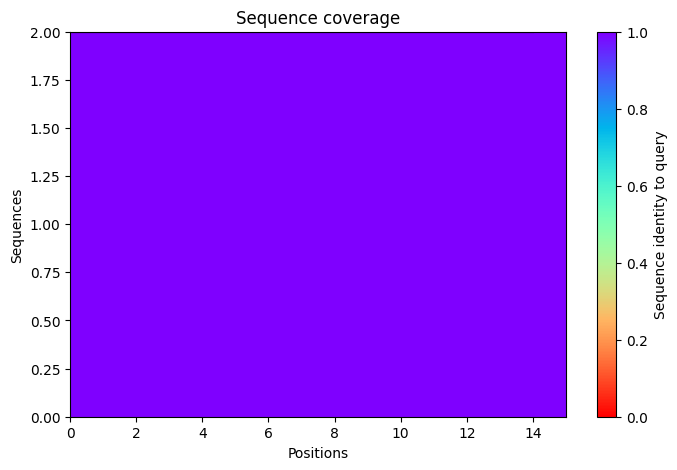

2025-11-17 07:27:51,465 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=58.8 pTM=0.0282
2025-11-17 07:27:54,046 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=60.1 pTM=0.0279 tol=0.717
2025-11-17 07:27:56,621 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=59.9 pTM=0.0277 tol=0.417
2025-11-17 07:27:59,198 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=59.2 pTM=0.0274 tol=0.955
2025-11-17 07:27:59,199 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


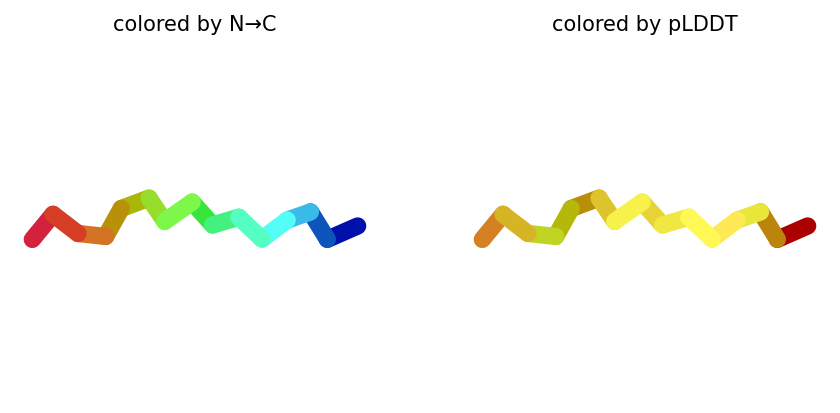

2025-11-17 07:28:02,288 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.3 pTM=0.0267
2025-11-17 07:28:04,867 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=62.8 pTM=0.0265 tol=1.36
2025-11-17 07:28:07,447 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=62 pTM=0.0264 tol=0.893
2025-11-17 07:28:10,032 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=62.5 pTM=0.0267 tol=0.575
2025-11-17 07:28:10,033 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


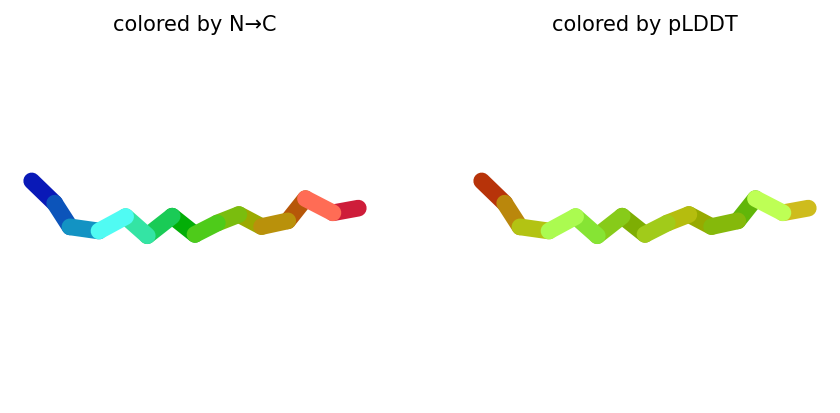

2025-11-17 07:28:12,669 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=60.6 pTM=0.0254
2025-11-17 07:28:15,251 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=60.9 pTM=0.0255 tol=0.873
2025-11-17 07:28:17,842 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=61.8 pTM=0.0256 tol=0.508
2025-11-17 07:28:20,424 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=63.7 pTM=0.026 tol=1.18
2025-11-17 07:28:20,424 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


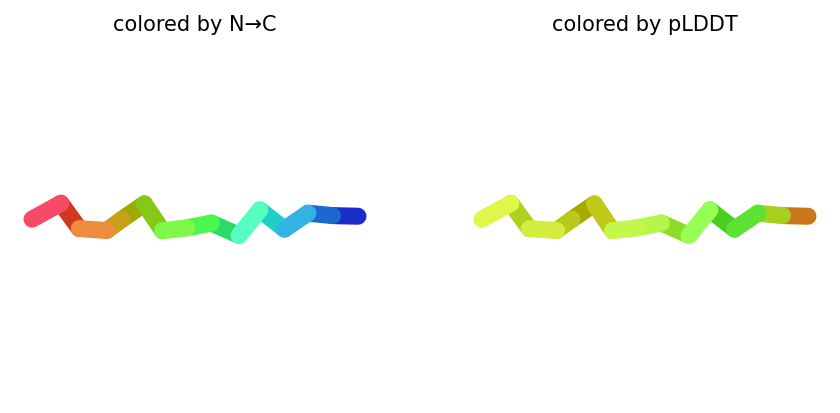

2025-11-17 07:28:23,060 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=58.6 pTM=0.0264
2025-11-17 07:28:25,646 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=58.5 pTM=0.0266 tol=0.605
2025-11-17 07:28:28,231 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=58.1 pTM=0.0266 tol=0.25
2025-11-17 07:28:30,819 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=56.8 pTM=0.0263 tol=0.791
2025-11-17 07:28:30,820 alphafold2_ptm_model_4_seed_000 took 10.3s (3 recycles)


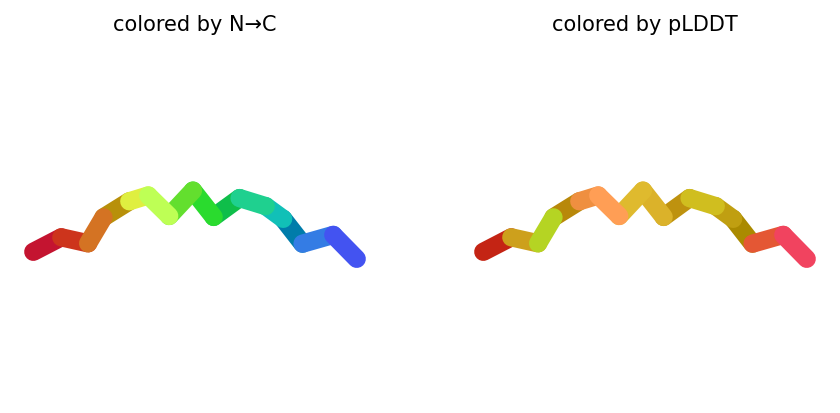

2025-11-17 07:28:33,457 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.9 pTM=0.0264
2025-11-17 07:28:36,035 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=59.7 pTM=0.0266 tol=0.646
2025-11-17 07:28:38,619 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=61 pTM=0.0266 tol=0.535
2025-11-17 07:28:41,202 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=61.8 pTM=0.0269 tol=0.78
2025-11-17 07:28:41,202 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


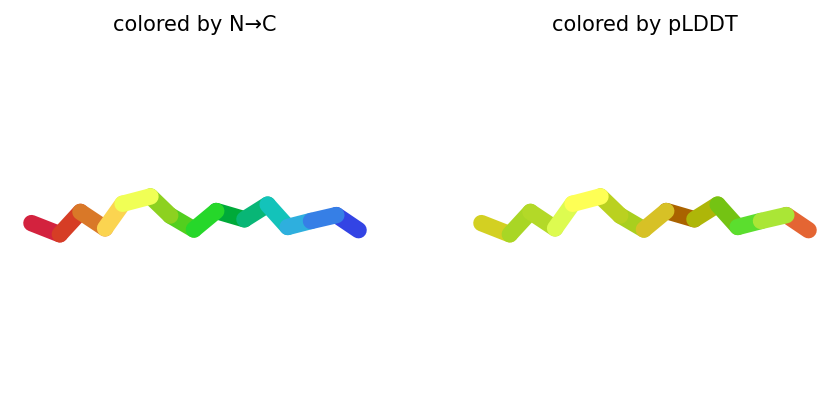

2025-11-17 07:28:41,278 reranking models by 'plddt' metric
2025-11-17 07:28:41,280 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=63.7 pTM=0.026
2025-11-17 07:28:41,280 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=62.5 pTM=0.0267
2025-11-17 07:28:41,280 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=61.8 pTM=0.0269
2025-11-17 07:28:41,281 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=59.2 pTM=0.0274
2025-11-17 07:28:41,281 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=56.8 pTM=0.0263
2025-11-17 07:28:42,458 Query 11/146: peptide_30_IC50_244.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:28:42,754 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


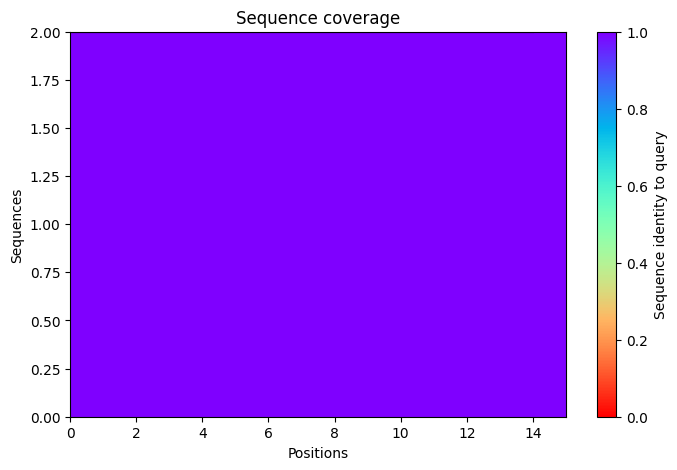

2025-11-17 07:28:52,794 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=82.2 pTM=0.0428
2025-11-17 07:28:55,374 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83 pTM=0.0435 tol=0.142
2025-11-17 07:28:57,951 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=83.5 pTM=0.0437 tol=0.0807
2025-11-17 07:29:00,528 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=83.4 pTM=0.0432 tol=0.0594
2025-11-17 07:29:00,529 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


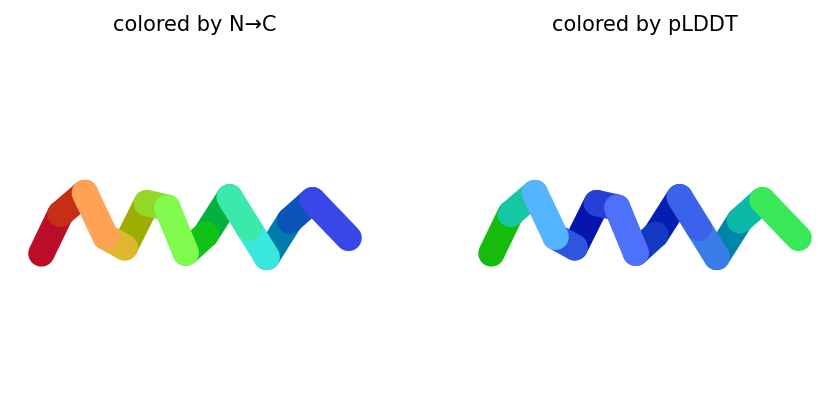

2025-11-17 07:29:03,161 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=74.3 pTM=0.0398
2025-11-17 07:29:05,738 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.1 pTM=0.04 tol=0.396
2025-11-17 07:29:08,325 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.3 pTM=0.0392 tol=0.152
2025-11-17 07:29:10,908 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=73.6 pTM=0.0394 tol=0.0717
2025-11-17 07:29:10,908 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


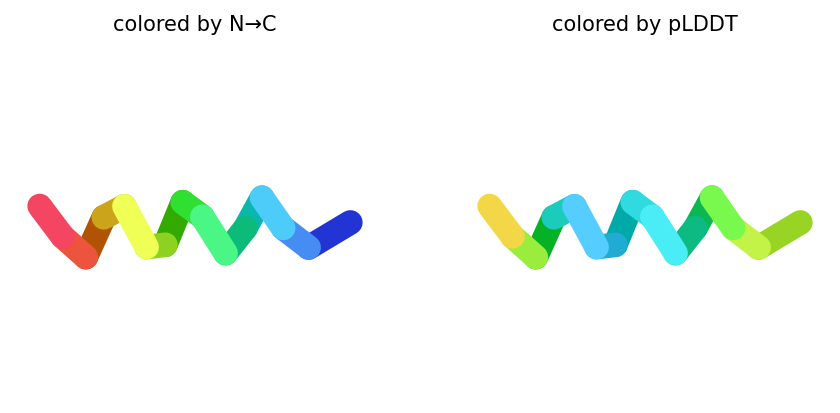

2025-11-17 07:29:13,545 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.9 pTM=0.0348
2025-11-17 07:29:16,135 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=77.9 pTM=0.0377 tol=0.287
2025-11-17 07:29:18,719 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.2 pTM=0.0388 tol=0.0358
2025-11-17 07:29:21,309 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.6 pTM=0.0398 tol=0.142
2025-11-17 07:29:21,310 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


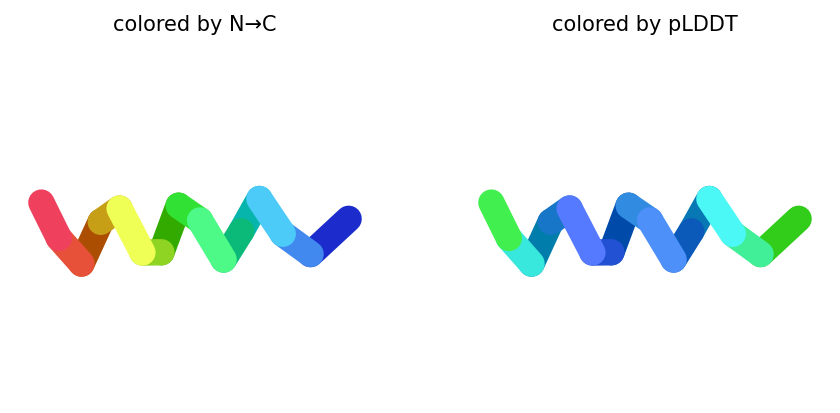

2025-11-17 07:29:23,951 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.1 pTM=0.0406
2025-11-17 07:29:26,537 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=78.9 pTM=0.0417 tol=0.116
2025-11-17 07:29:29,124 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78 pTM=0.0419 tol=0.323
2025-11-17 07:29:31,707 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.8 pTM=0.0428 tol=0.165
2025-11-17 07:29:31,708 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


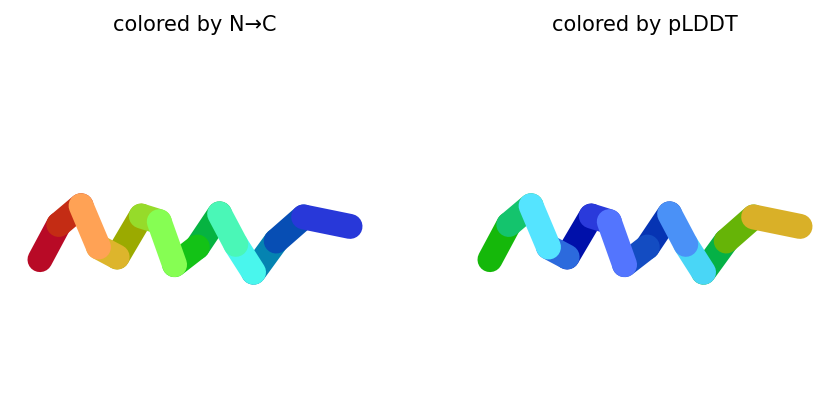

2025-11-17 07:29:34,345 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=86.1 pTM=0.0441
2025-11-17 07:29:36,926 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=86.5 pTM=0.0449 tol=0.181
2025-11-17 07:29:39,503 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=86.4 pTM=0.0447 tol=0.13
2025-11-17 07:29:42,087 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=87.2 pTM=0.0446 tol=0.0313
2025-11-17 07:29:42,087 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


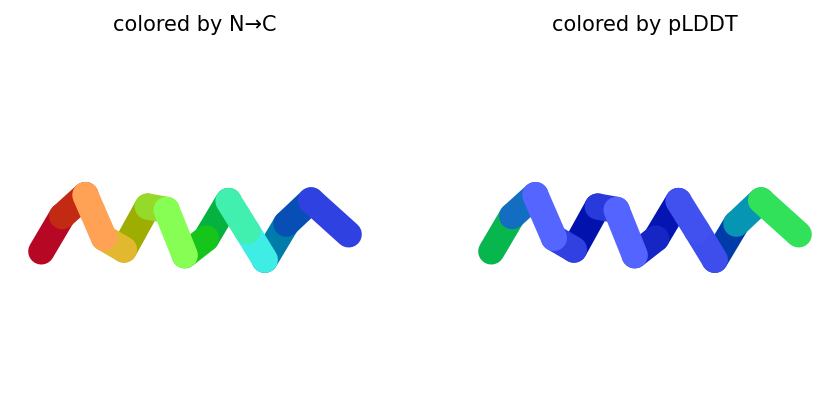

2025-11-17 07:29:42,163 reranking models by 'plddt' metric
2025-11-17 07:29:42,165 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=87.2 pTM=0.0446
2025-11-17 07:29:42,166 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=83.4 pTM=0.0432
2025-11-17 07:29:42,166 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=81.6 pTM=0.0398
2025-11-17 07:29:42,166 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=79.8 pTM=0.0428
2025-11-17 07:29:42,166 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=73.6 pTM=0.0394
2025-11-17 07:29:43,258 Query 12/146: peptide_34_IC50_271.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:29:43,532 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


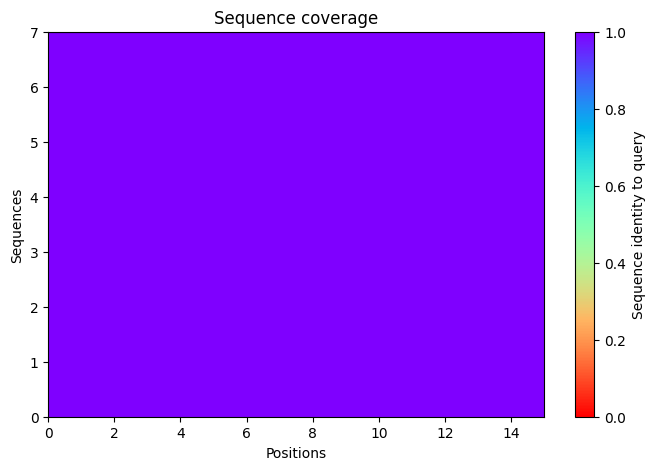

2025-11-17 07:29:58,083 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.9 pTM=0.0335
2025-11-17 07:30:00,662 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.8 pTM=0.0374 tol=0.538
2025-11-17 07:30:03,236 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=80.8 pTM=0.0387 tol=0.0941
2025-11-17 07:30:05,814 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=83.2 pTM=0.0396 tol=0.0734
2025-11-17 07:30:05,815 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


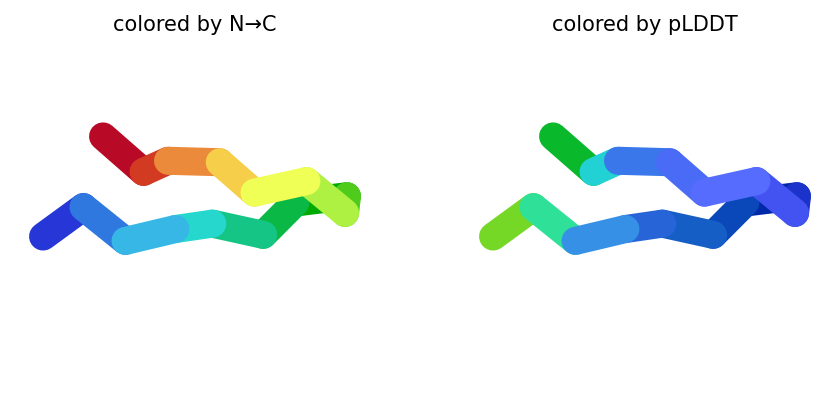

2025-11-17 07:30:08,476 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=81.6 pTM=0.0386
2025-11-17 07:30:11,059 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=82.7 pTM=0.04 tol=0.261
2025-11-17 07:30:13,637 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=84.9 pTM=0.0412 tol=0.075
2025-11-17 07:30:16,220 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=86.1 pTM=0.0419 tol=0.0581
2025-11-17 07:30:16,221 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


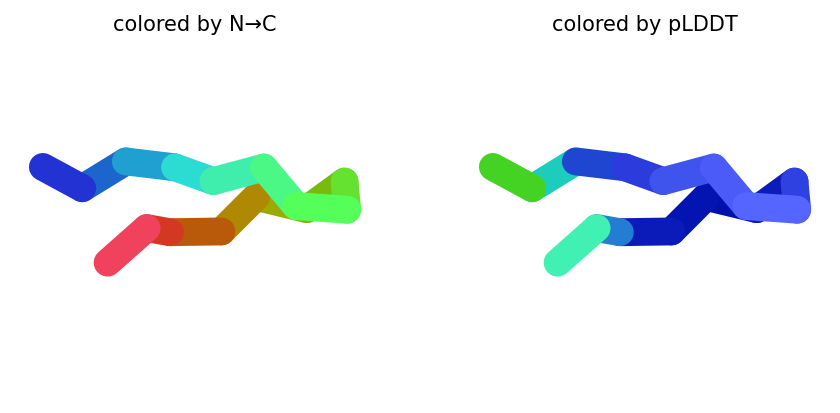

2025-11-17 07:30:18,869 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=80.7 pTM=0.0372
2025-11-17 07:30:21,457 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=82.6 pTM=0.0379 tol=0.245
2025-11-17 07:30:24,051 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=83.8 pTM=0.0385 tol=0.0721
2025-11-17 07:30:26,654 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=86.8 pTM=0.0398 tol=0.0692
2025-11-17 07:30:26,655 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


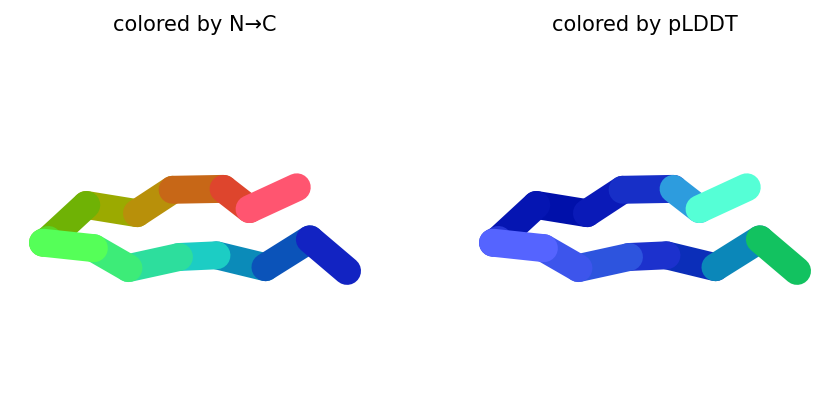

2025-11-17 07:30:29,313 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=82.8 pTM=0.0372
2025-11-17 07:30:31,919 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=85.4 pTM=0.0395 tol=0.231
2025-11-17 07:30:34,524 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=86.4 pTM=0.0408 tol=0.0778
2025-11-17 07:30:37,124 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=86.8 pTM=0.041 tol=0.0631
2025-11-17 07:30:37,125 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


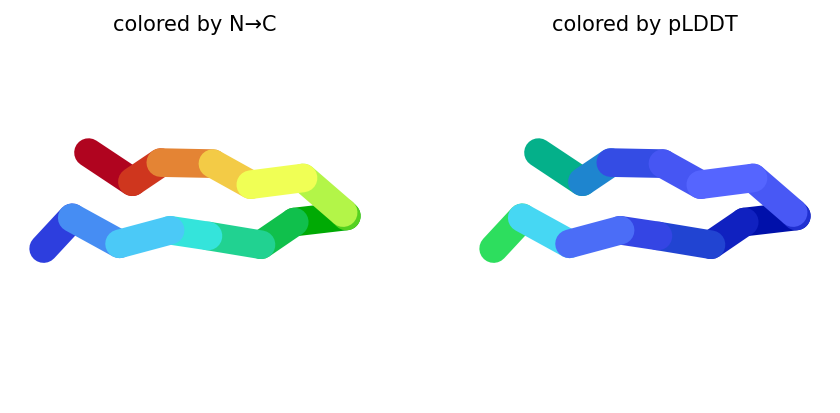

2025-11-17 07:30:39,772 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.4 pTM=0.0305
2025-11-17 07:30:42,369 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=82.1 pTM=0.0384 tol=1.02
2025-11-17 07:30:44,963 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=86.9 pTM=0.0408 tol=0.101
2025-11-17 07:30:47,553 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=87.9 pTM=0.0413 tol=0.105
2025-11-17 07:30:47,554 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


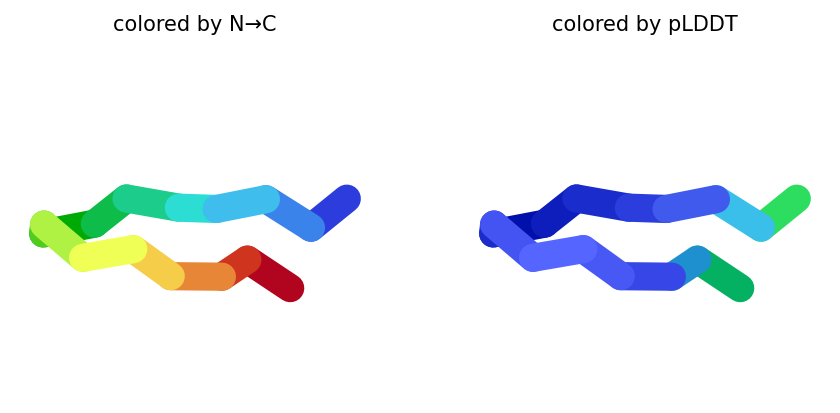

2025-11-17 07:30:47,608 reranking models by 'plddt' metric
2025-11-17 07:30:47,608 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=87.9 pTM=0.0413
2025-11-17 07:30:47,609 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=86.8 pTM=0.041
2025-11-17 07:30:47,609 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=86.8 pTM=0.0398
2025-11-17 07:30:47,609 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=86.1 pTM=0.0419
2025-11-17 07:30:47,609 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=83.2 pTM=0.0396
2025-11-17 07:30:48,566 Query 13/146: peptide_36_IC50_268.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:30:48,842 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


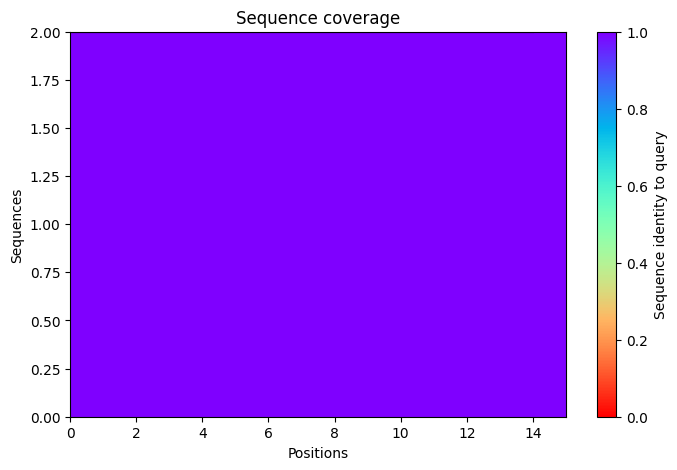

2025-11-17 07:31:02,714 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=64.4 pTM=0.0293
2025-11-17 07:31:05,290 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.1 pTM=0.0298 tol=2.15
2025-11-17 07:31:07,866 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=76.8 pTM=0.03 tol=0.334
2025-11-17 07:31:10,443 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.8 pTM=0.0297 tol=0.157
2025-11-17 07:31:10,444 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


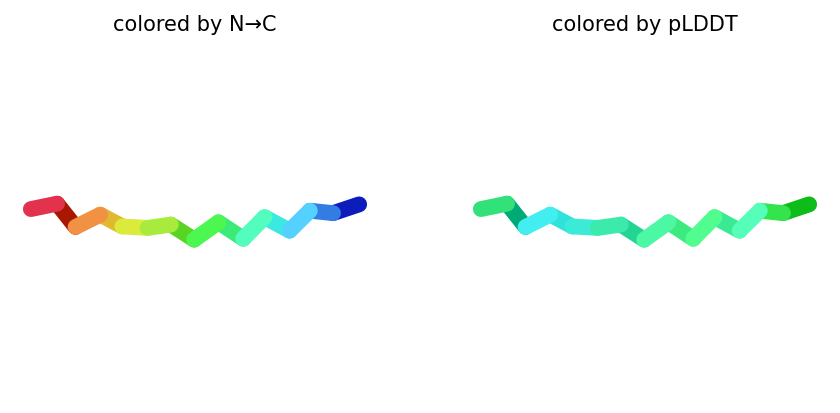

2025-11-17 07:31:13,558 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.8 pTM=0.0276
2025-11-17 07:31:16,143 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=75.2 pTM=0.0283 tol=0.505
2025-11-17 07:31:18,724 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=77.4 pTM=0.0288 tol=0.165
2025-11-17 07:31:21,309 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=77.5 pTM=0.0284 tol=0.121
2025-11-17 07:31:21,310 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


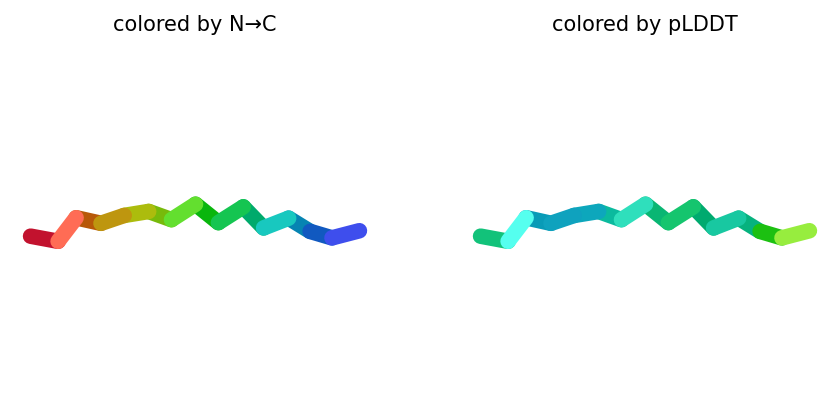

2025-11-17 07:31:23,942 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.1 pTM=0.028
2025-11-17 07:31:26,524 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.9 pTM=0.028 tol=0.172
2025-11-17 07:31:29,114 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=78.6 pTM=0.0285 tol=0.261
2025-11-17 07:31:31,705 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=78.2 pTM=0.028 tol=0.115
2025-11-17 07:31:31,706 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


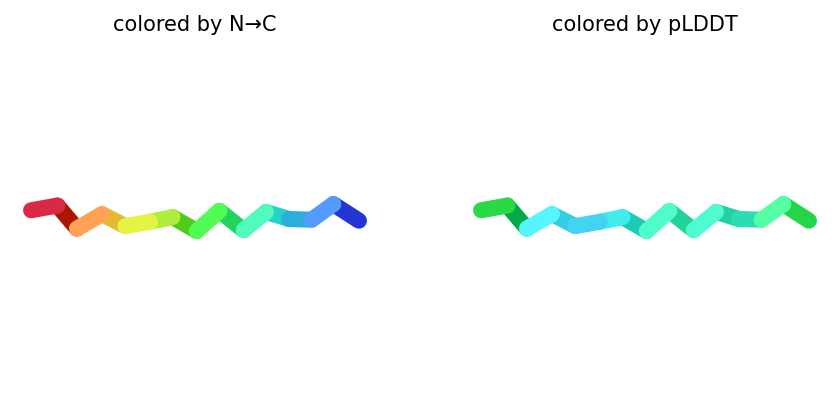

2025-11-17 07:31:34,356 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.6 pTM=0.0295
2025-11-17 07:31:36,953 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75.3 pTM=0.0287 tol=0.219
2025-11-17 07:31:39,551 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.9 pTM=0.0292 tol=0.203
2025-11-17 07:31:42,151 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.4 pTM=0.0289 tol=0.137
2025-11-17 07:31:42,152 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


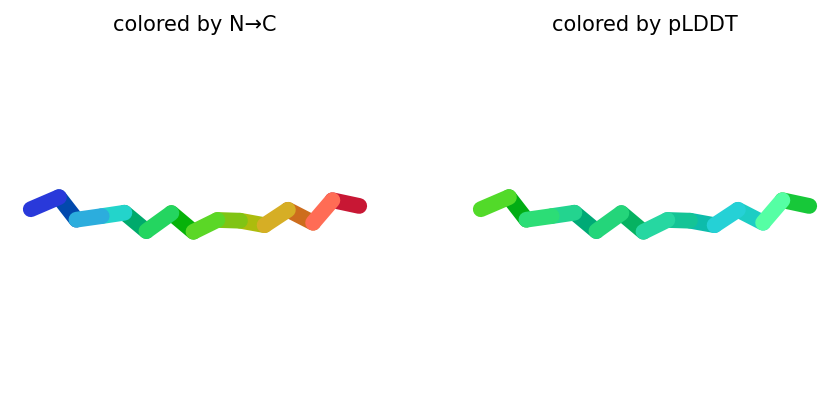

2025-11-17 07:31:44,827 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.8 pTM=0.0273
2025-11-17 07:31:47,421 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=73.9 pTM=0.0283 tol=0.575
2025-11-17 07:31:50,017 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=79.1 pTM=0.0287 tol=0.451
2025-11-17 07:31:52,608 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=79.2 pTM=0.0285 tol=0.114
2025-11-17 07:31:52,609 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


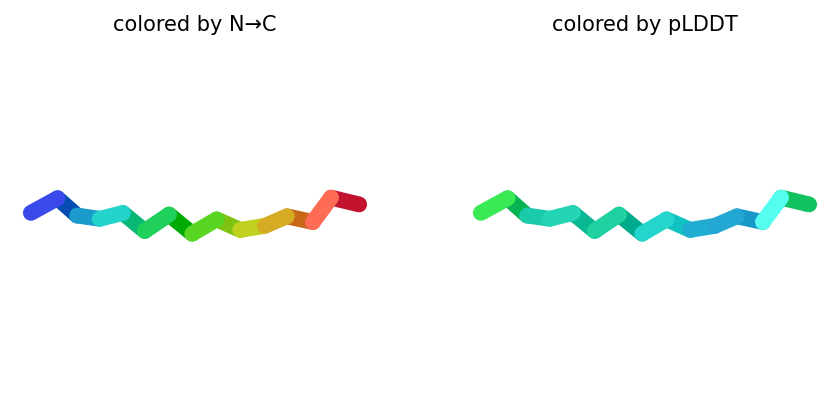

2025-11-17 07:31:52,657 reranking models by 'plddt' metric
2025-11-17 07:31:52,658 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=79.2 pTM=0.0285
2025-11-17 07:31:52,658 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=78.2 pTM=0.028
2025-11-17 07:31:52,659 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=77.5 pTM=0.0284
2025-11-17 07:31:52,659 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=76.8 pTM=0.0297
2025-11-17 07:31:52,659 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=76.4 pTM=0.0289
2025-11-17 07:31:53,882 Query 14/146: peptide_37_IC50_261.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:31:54,523 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:11 remaining: 00:00]


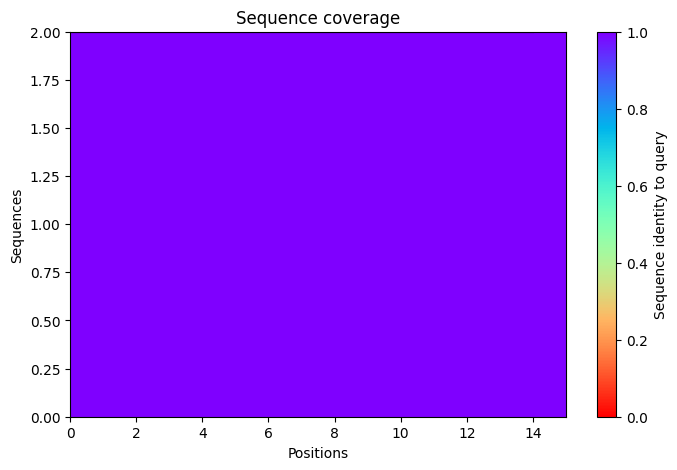

2025-11-17 07:32:10,169 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=62.1 pTM=0.0281
2025-11-17 07:32:12,744 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=62.5 pTM=0.0282 tol=0.398
2025-11-17 07:32:15,321 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=62.3 pTM=0.0276 tol=0.676
2025-11-17 07:32:17,900 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=60.4 pTM=0.027 tol=2.26
2025-11-17 07:32:17,902 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


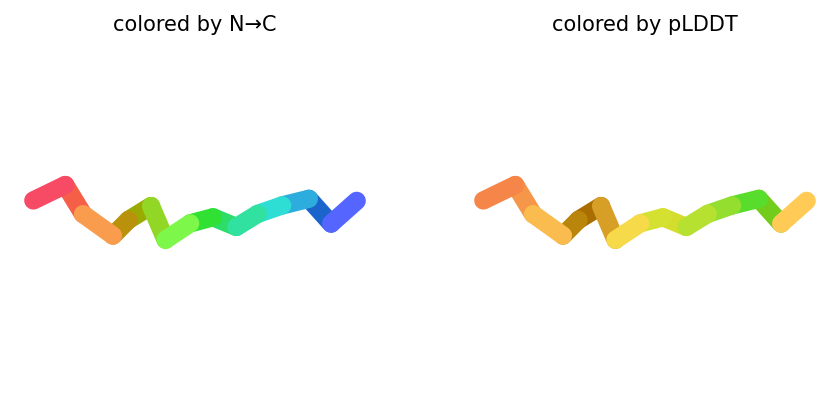

2025-11-17 07:32:20,562 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=64.7 pTM=0.0263
2025-11-17 07:32:23,139 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=67.2 pTM=0.0267 tol=0.424
2025-11-17 07:32:25,716 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=67.9 pTM=0.027 tol=0.311
2025-11-17 07:32:28,302 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.9 pTM=0.0273 tol=0.312
2025-11-17 07:32:28,303 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


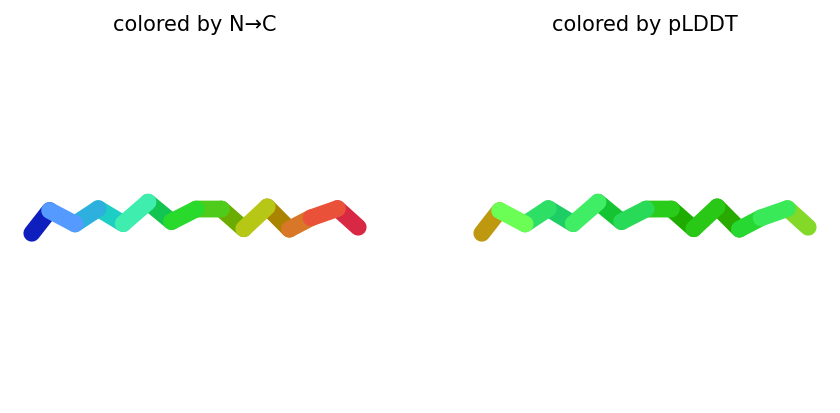

2025-11-17 07:32:30,942 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.9 pTM=0.0284
2025-11-17 07:32:33,532 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.4 pTM=0.0288 tol=0.339
2025-11-17 07:32:36,126 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.4 pTM=0.0292 tol=0.185
2025-11-17 07:32:38,727 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.8 pTM=0.0293 tol=0.083
2025-11-17 07:32:38,728 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


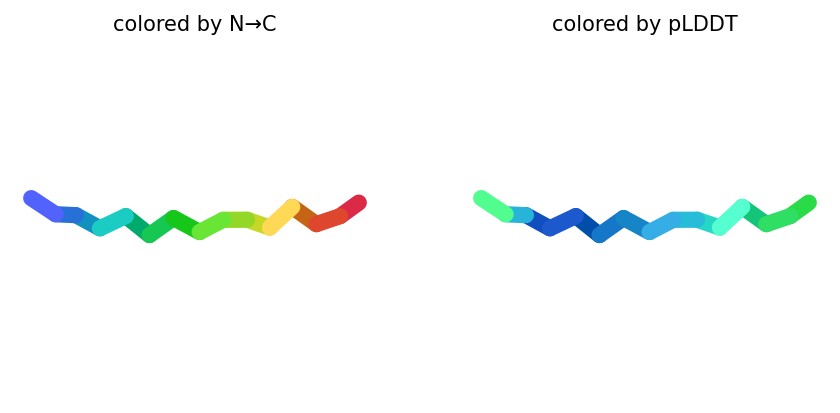

2025-11-17 07:32:41,379 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=71.8 pTM=0.028
2025-11-17 07:32:43,978 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.9 pTM=0.0285 tol=0.332
2025-11-17 07:32:46,575 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.3 pTM=0.0288 tol=0.387
2025-11-17 07:32:49,174 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.1 pTM=0.029 tol=0.104
2025-11-17 07:32:49,175 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


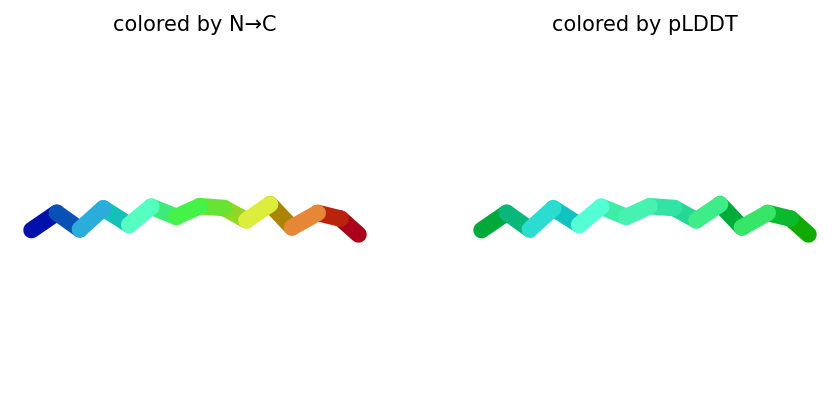

2025-11-17 07:32:51,824 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.2 pTM=0.0263
2025-11-17 07:32:54,421 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.2 pTM=0.0275 tol=2.02
2025-11-17 07:32:57,015 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.5 pTM=0.0287 tol=0.531
2025-11-17 07:32:59,606 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.6 pTM=0.0287 tol=0.185
2025-11-17 07:32:59,607 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


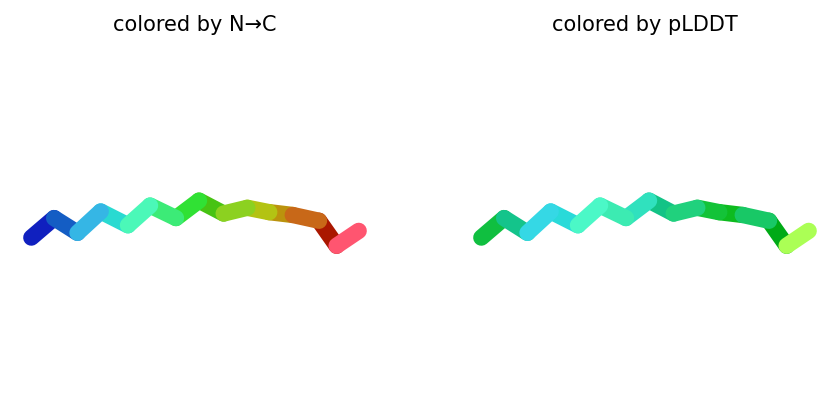

2025-11-17 07:32:59,655 reranking models by 'plddt' metric
2025-11-17 07:32:59,656 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=80.8 pTM=0.0293
2025-11-17 07:32:59,656 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=76.1 pTM=0.029
2025-11-17 07:32:59,656 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=75.6 pTM=0.0287
2025-11-17 07:32:59,657 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=69.9 pTM=0.0273
2025-11-17 07:32:59,657 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=60.4 pTM=0.027
2025-11-17 07:33:00,595 Query 15/146: peptide_43_IC50_254.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:33:00,873 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


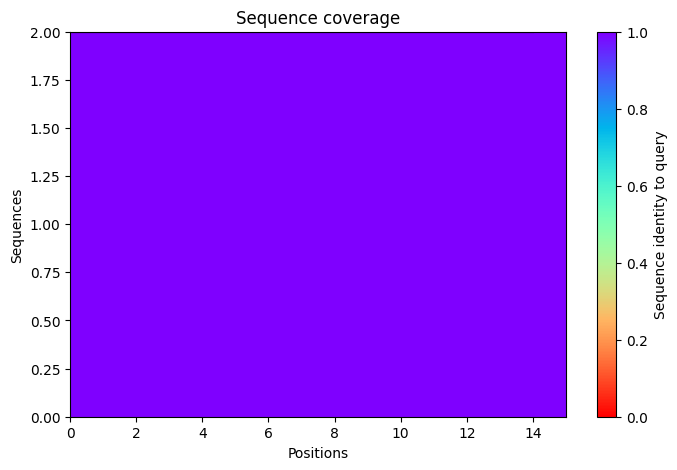

2025-11-17 07:33:11,282 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.2 pTM=0.0288
2025-11-17 07:33:13,859 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=71.8 pTM=0.0293 tol=0.881
2025-11-17 07:33:16,436 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.6 pTM=0.0292 tol=0.581
2025-11-17 07:33:19,016 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.6 pTM=0.0291 tol=0.323
2025-11-17 07:33:19,017 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


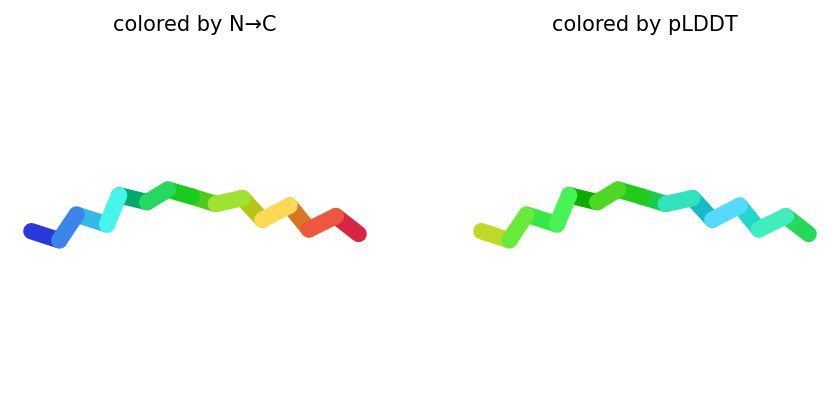

2025-11-17 07:33:21,676 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.4 pTM=0.0273
2025-11-17 07:33:24,257 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74 pTM=0.0278 tol=0.713
2025-11-17 07:33:26,838 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.9 pTM=0.0277 tol=0.115
2025-11-17 07:33:29,420 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=73.4 pTM=0.0282 tol=0.381
2025-11-17 07:33:29,421 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


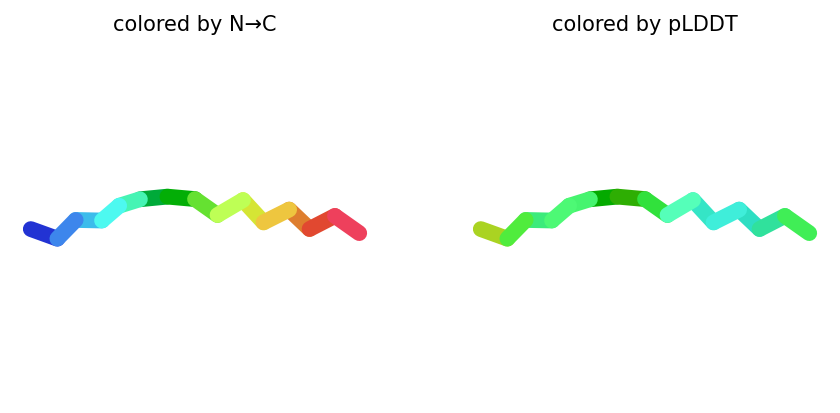

2025-11-17 07:33:32,054 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.8 pTM=0.027
2025-11-17 07:33:34,635 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.4 pTM=0.0275 tol=0.23
2025-11-17 07:33:37,216 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.9 pTM=0.0281 tol=0.523
2025-11-17 07:33:39,805 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.9 pTM=0.0278 tol=0.218
2025-11-17 07:33:39,805 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


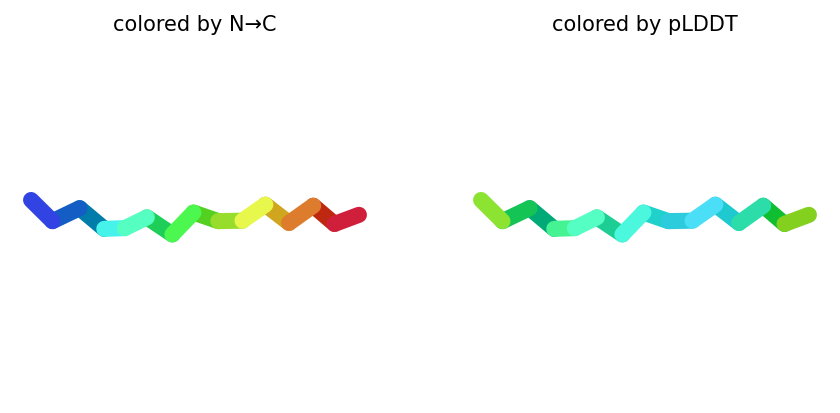

2025-11-17 07:33:42,447 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.1 pTM=0.0284
2025-11-17 07:33:45,042 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=74.1 pTM=0.0284 tol=0.143
2025-11-17 07:33:47,629 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=73.1 pTM=0.0285 tol=0.097
2025-11-17 07:33:50,219 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=72.6 pTM=0.0283 tol=0.413
2025-11-17 07:33:50,219 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


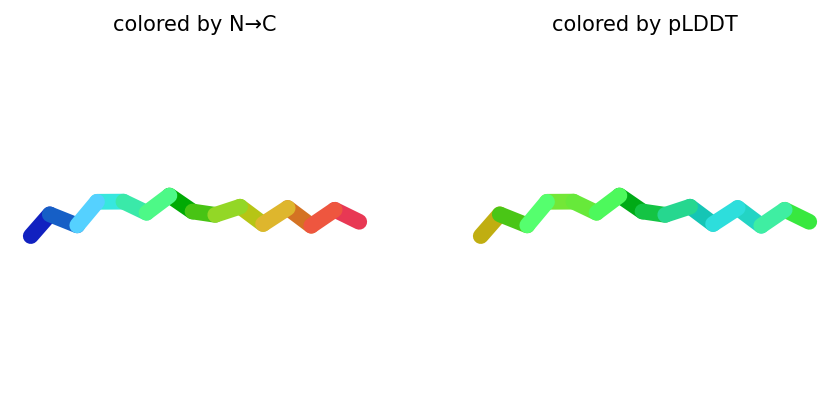

2025-11-17 07:33:52,854 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=71.4 pTM=0.0277
2025-11-17 07:33:55,438 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=74.9 pTM=0.0283 tol=0.439
2025-11-17 07:33:58,026 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76.2 pTM=0.0284 tol=0.194
2025-11-17 07:34:00,603 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.8 pTM=0.0281 tol=0.315
2025-11-17 07:34:00,603 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


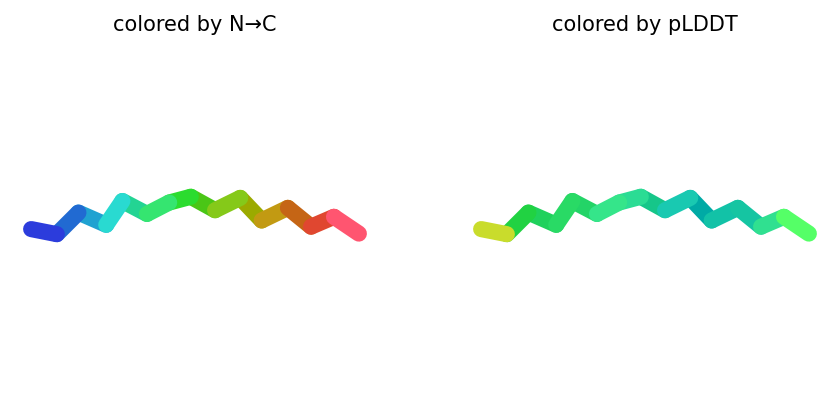

2025-11-17 07:34:00,652 reranking models by 'plddt' metric
2025-11-17 07:34:00,652 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=75.9 pTM=0.0278
2025-11-17 07:34:00,653 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=74.8 pTM=0.0281
2025-11-17 07:34:00,653 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=73.6 pTM=0.0291
2025-11-17 07:34:00,653 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=73.4 pTM=0.0282
2025-11-17 07:34:00,653 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=72.6 pTM=0.0283
2025-11-17 07:34:01,595 Query 16/146: peptide_44_IC50_250.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:34:02,236 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


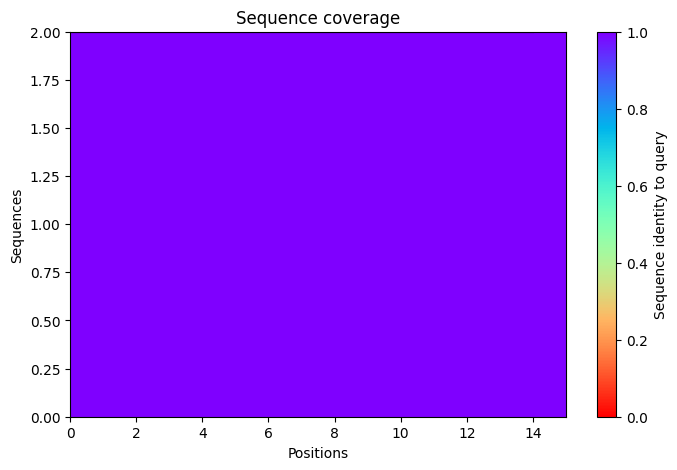

2025-11-17 07:34:16,071 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=71.1 pTM=0.0283
2025-11-17 07:34:18,650 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.1 pTM=0.0283 tol=0.996
2025-11-17 07:34:21,233 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=71.1 pTM=0.0288 tol=2.37
2025-11-17 07:34:23,813 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=71.6 pTM=0.0287 tol=0.743
2025-11-17 07:34:23,814 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


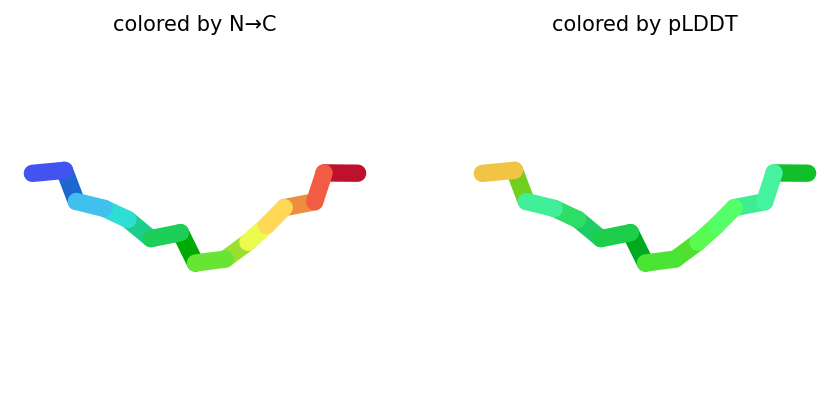

2025-11-17 07:34:26,448 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.1 pTM=0.0273
2025-11-17 07:34:29,024 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=67.6 pTM=0.0275 tol=0.3
2025-11-17 07:34:31,607 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=67.2 pTM=0.0266 tol=1.91
2025-11-17 07:34:34,196 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=66.3 pTM=0.0266 tol=1.5
2025-11-17 07:34:34,197 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


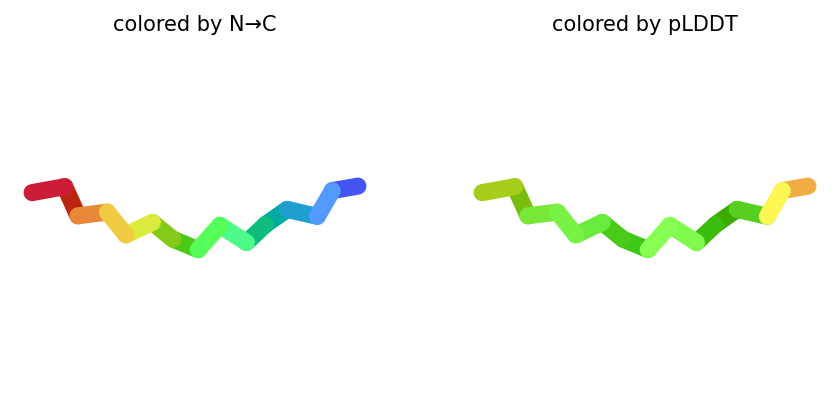

2025-11-17 07:34:36,836 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=72.1 pTM=0.0267
2025-11-17 07:34:39,428 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.9 pTM=0.0268 tol=0.387
2025-11-17 07:34:42,015 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.1 pTM=0.0275 tol=0.278
2025-11-17 07:34:44,613 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.5 pTM=0.0275 tol=0.138
2025-11-17 07:34:44,614 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


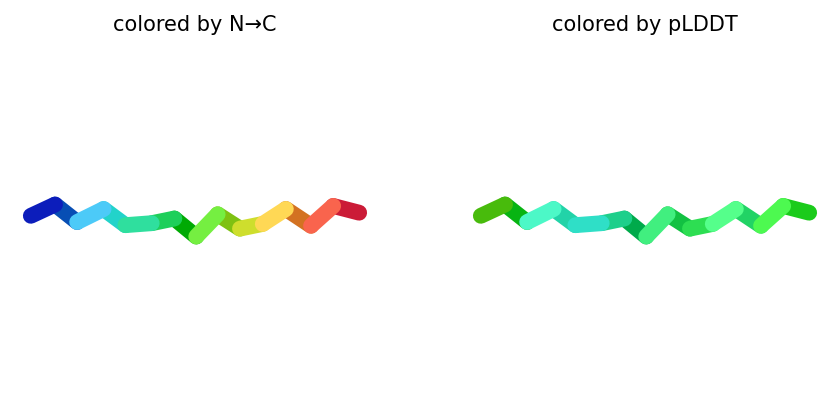

2025-11-17 07:34:47,255 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.5 pTM=0.0268
2025-11-17 07:34:49,845 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.4 pTM=0.0274 tol=0.381
2025-11-17 07:34:52,438 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72 pTM=0.0276 tol=0.23
2025-11-17 07:34:55,025 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.8 pTM=0.0277 tol=0.302
2025-11-17 07:34:55,026 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


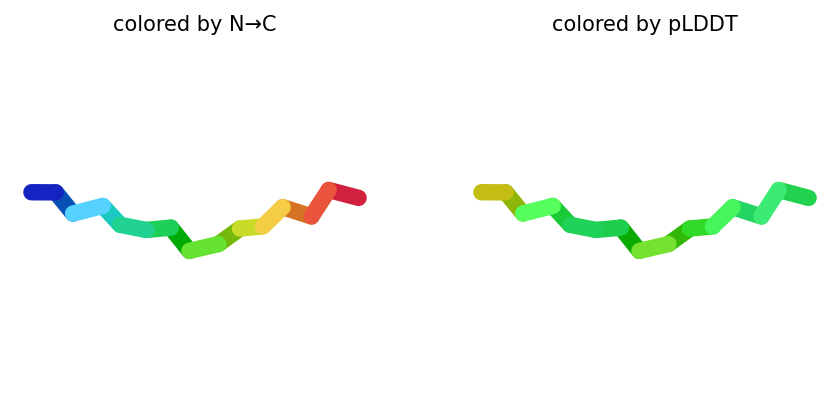

2025-11-17 07:34:57,689 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=86.8 pTM=0.0382
2025-11-17 07:35:00,271 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=88.1 pTM=0.0384 tol=0.324
2025-11-17 07:35:02,856 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=89.4 pTM=0.0395 tol=0.133
2025-11-17 07:35:05,433 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=89 pTM=0.0391 tol=0.0744
2025-11-17 07:35:05,434 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


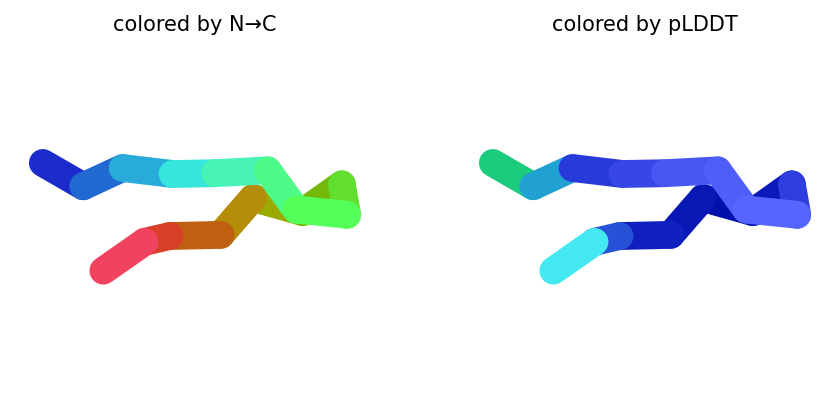

2025-11-17 07:35:05,486 reranking models by 'plddt' metric
2025-11-17 07:35:05,486 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=89 pTM=0.0391
2025-11-17 07:35:05,487 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=74.5 pTM=0.0275
2025-11-17 07:35:05,487 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=71.6 pTM=0.0287
2025-11-17 07:35:05,487 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=70.8 pTM=0.0277
2025-11-17 07:35:05,487 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=66.3 pTM=0.0266
2025-11-17 07:35:06,733 Query 17/146: peptide_51_IC50_280.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:35:07,022 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


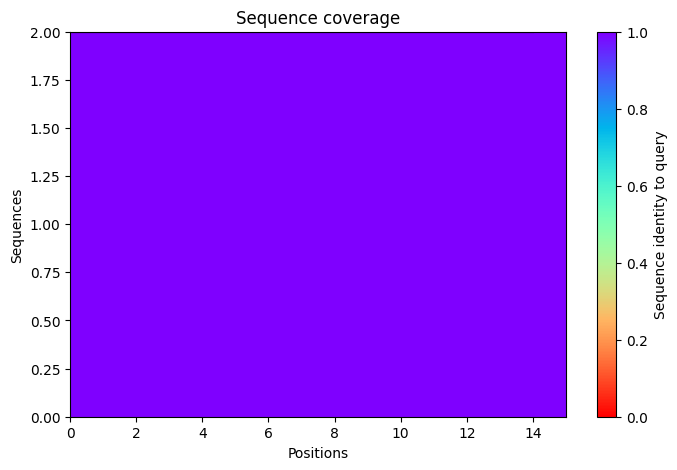

2025-11-17 07:35:18,080 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.5 pTM=0.0283
2025-11-17 07:35:20,656 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=61.2 pTM=0.0284 tol=1.79
2025-11-17 07:35:23,231 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=58.5 pTM=0.0281 tol=0.381
2025-11-17 07:35:25,810 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=58.3 pTM=0.0282 tol=0.378
2025-11-17 07:35:25,811 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


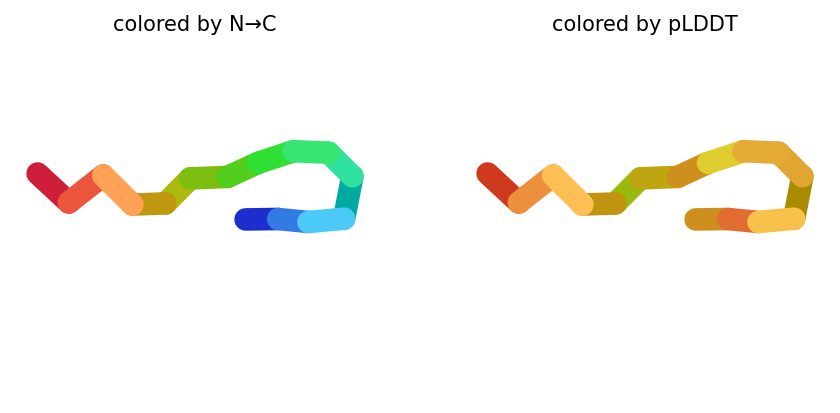

2025-11-17 07:35:28,451 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=59.7 pTM=0.027
2025-11-17 07:35:31,032 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63.6 pTM=0.0271 tol=3.06
2025-11-17 07:35:33,616 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.4 pTM=0.0275 tol=0.6
2025-11-17 07:35:36,196 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.5 pTM=0.0273 tol=0.172
2025-11-17 07:35:36,197 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


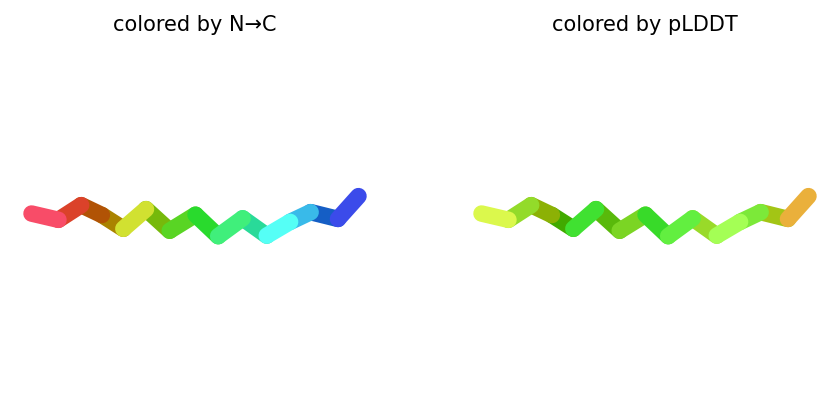

2025-11-17 07:35:38,836 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=59 pTM=0.0261
2025-11-17 07:35:41,422 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=67.8 pTM=0.0269 tol=1.71
2025-11-17 07:35:44,018 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=70.8 pTM=0.0267 tol=0.688
2025-11-17 07:35:46,613 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=70.3 pTM=0.0266 tol=0.166
2025-11-17 07:35:46,614 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


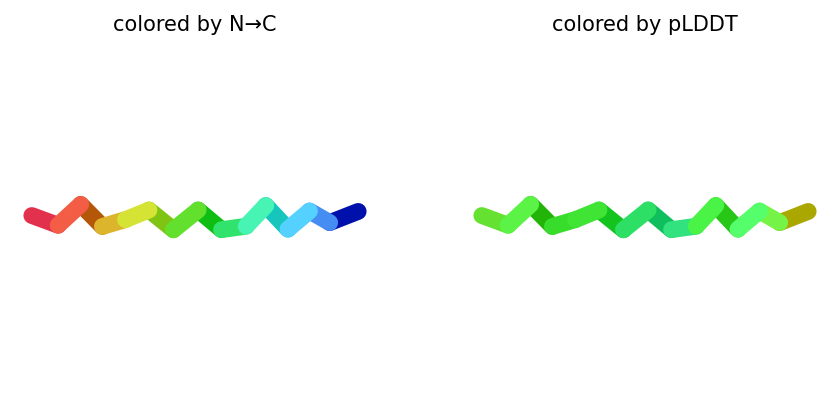

2025-11-17 07:35:49,257 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62.1 pTM=0.0274
2025-11-17 07:35:51,847 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=65.3 pTM=0.0283 tol=0.705
2025-11-17 07:35:54,437 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.6 pTM=0.0286 tol=0.603
2025-11-17 07:35:57,029 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.9 pTM=0.0291 tol=0.315
2025-11-17 07:35:57,030 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


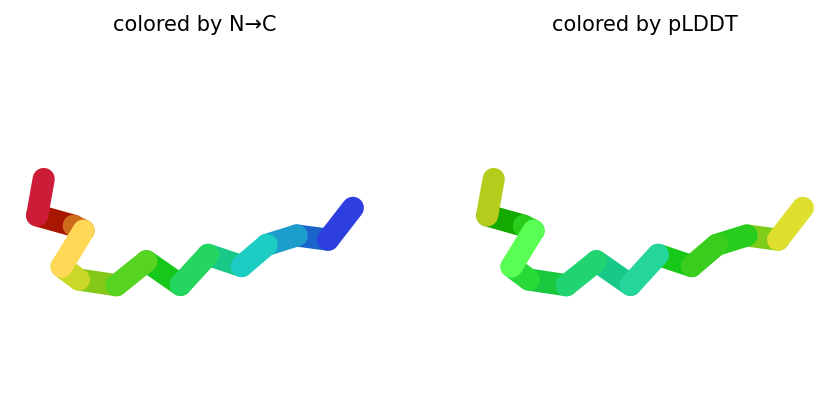

2025-11-17 07:35:59,666 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=61.5 pTM=0.0268
2025-11-17 07:36:02,254 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.8 pTM=0.0268 tol=1.19
2025-11-17 07:36:04,835 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.2 pTM=0.0271 tol=1.41
2025-11-17 07:36:07,420 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.2 pTM=0.0266 tol=0.751
2025-11-17 07:36:07,421 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


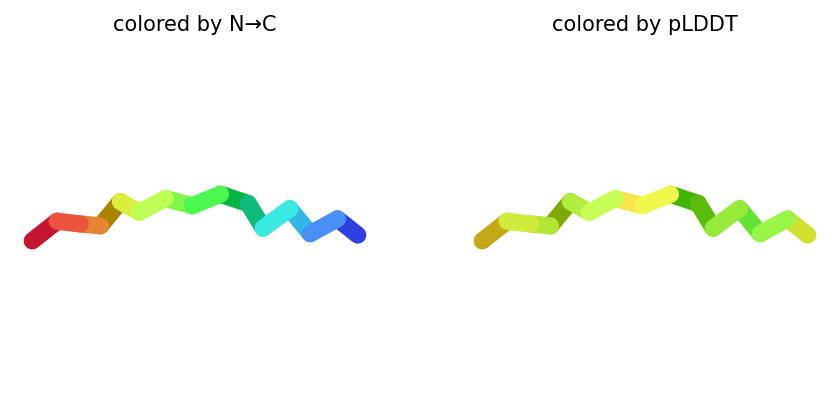

2025-11-17 07:36:07,495 reranking models by 'plddt' metric
2025-11-17 07:36:07,496 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=70.3 pTM=0.0266
2025-11-17 07:36:07,497 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=69.9 pTM=0.0291
2025-11-17 07:36:07,497 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=65.5 pTM=0.0273
2025-11-17 07:36:07,497 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=64.2 pTM=0.0266
2025-11-17 07:36:07,497 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=58.3 pTM=0.0282
2025-11-17 07:36:08,772 Query 18/146: peptide_52_IC50_283.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:36:09,054 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


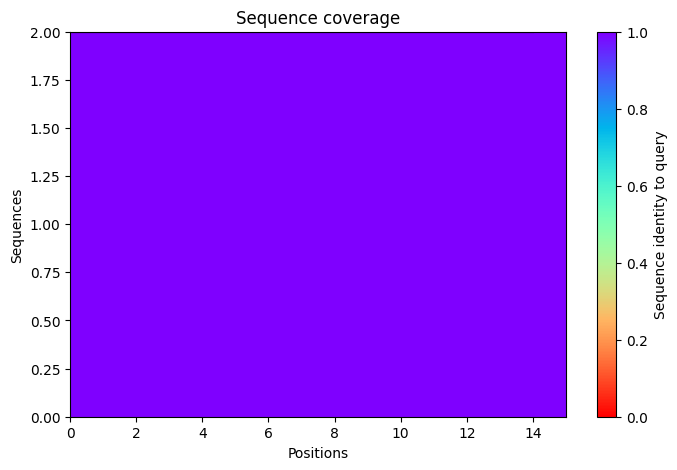

2025-11-17 07:36:23,713 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76.2 pTM=0.0335
2025-11-17 07:36:26,290 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=75.9 pTM=0.0341 tol=0.46
2025-11-17 07:36:28,869 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.9 pTM=0.0338 tol=0.106
2025-11-17 07:36:31,448 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.1 pTM=0.0329 tol=0.103
2025-11-17 07:36:31,448 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


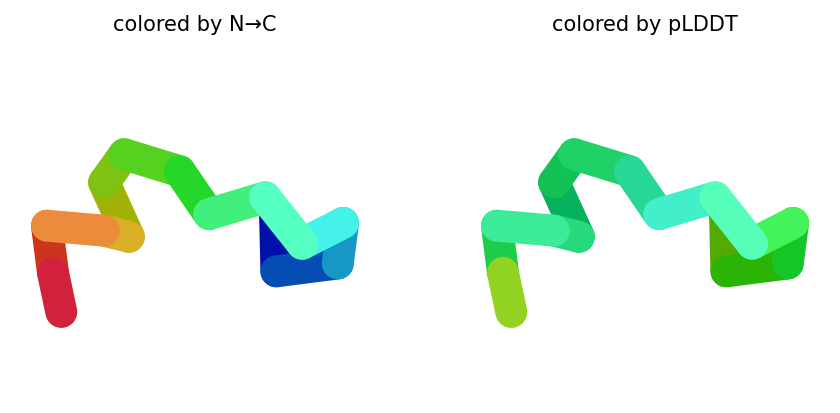

2025-11-17 07:36:34,117 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.7 pTM=0.029
2025-11-17 07:36:36,695 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=62.8 pTM=0.0288 tol=0.416
2025-11-17 07:36:39,273 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=61 pTM=0.0278 tol=0.417
2025-11-17 07:36:41,859 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=61.1 pTM=0.0273 tol=0.267
2025-11-17 07:36:41,860 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


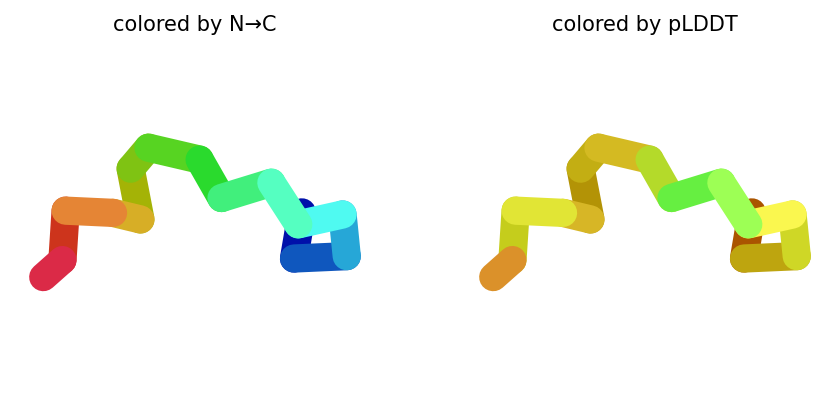

2025-11-17 07:36:44,504 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=66.8 pTM=0.0279
2025-11-17 07:36:47,097 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=66.9 pTM=0.0276 tol=0.33
2025-11-17 07:36:49,685 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63 pTM=0.0268 tol=1.13
2025-11-17 07:36:52,281 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=60.8 pTM=0.0262 tol=1.5
2025-11-17 07:36:52,282 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


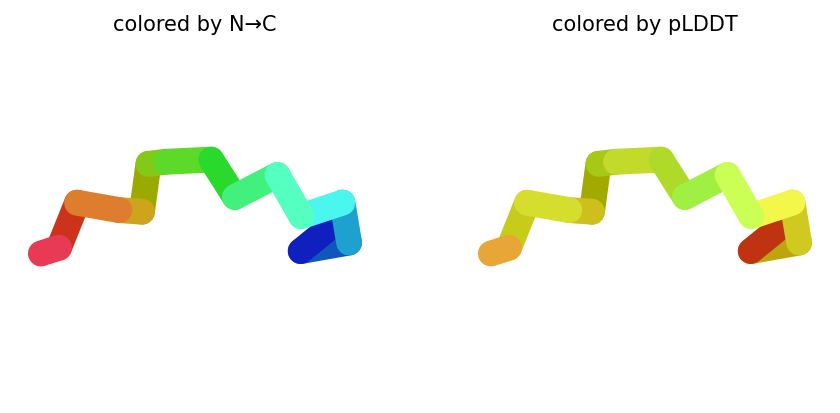

2025-11-17 07:36:54,940 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.8 pTM=0.0334
2025-11-17 07:36:57,542 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.8 pTM=0.0349 tol=0.203
2025-11-17 07:37:00,142 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.9 pTM=0.0345 tol=0.097
2025-11-17 07:37:02,741 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=77.6 pTM=0.0351 tol=0.236
2025-11-17 07:37:02,742 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


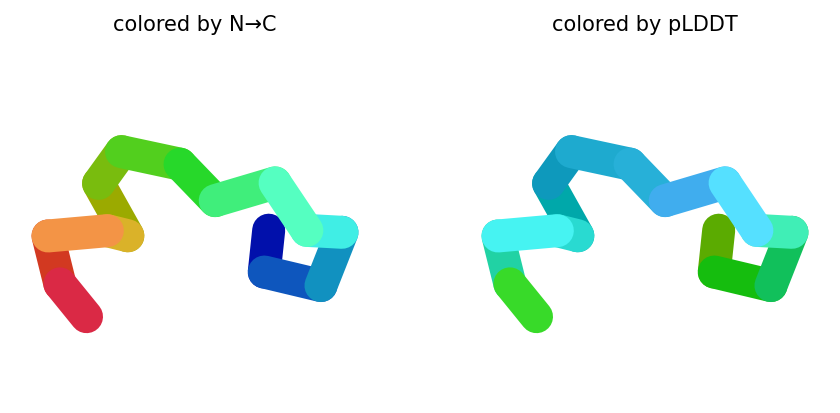

2025-11-17 07:37:05,400 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=63.2 pTM=0.0282
2025-11-17 07:37:08,000 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=64.9 pTM=0.0304 tol=0.721
2025-11-17 07:37:10,593 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.1 pTM=0.0297 tol=0.349
2025-11-17 07:37:13,184 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.4 pTM=0.0288 tol=0.326
2025-11-17 07:37:13,185 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


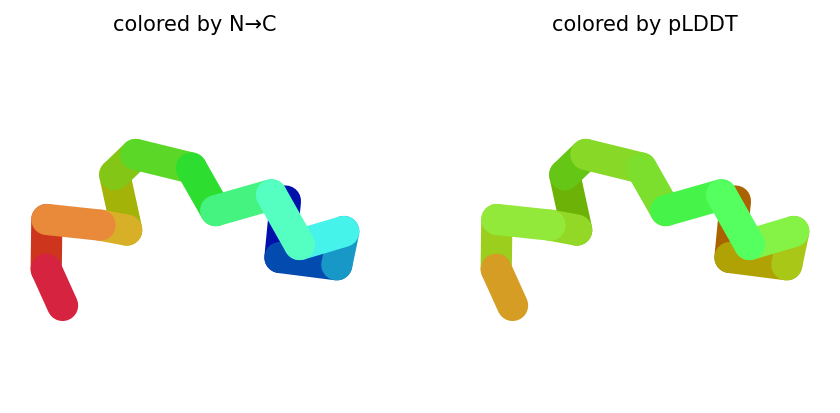

2025-11-17 07:37:13,236 reranking models by 'plddt' metric
2025-11-17 07:37:13,236 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=77.6 pTM=0.0351
2025-11-17 07:37:13,237 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=73.1 pTM=0.0329
2025-11-17 07:37:13,237 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=64.4 pTM=0.0288
2025-11-17 07:37:13,238 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=61.1 pTM=0.0273
2025-11-17 07:37:13,239 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=60.8 pTM=0.0262
2025-11-17 07:37:14,165 Query 19/146: peptide_53_IC50_281.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:37:14,442 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


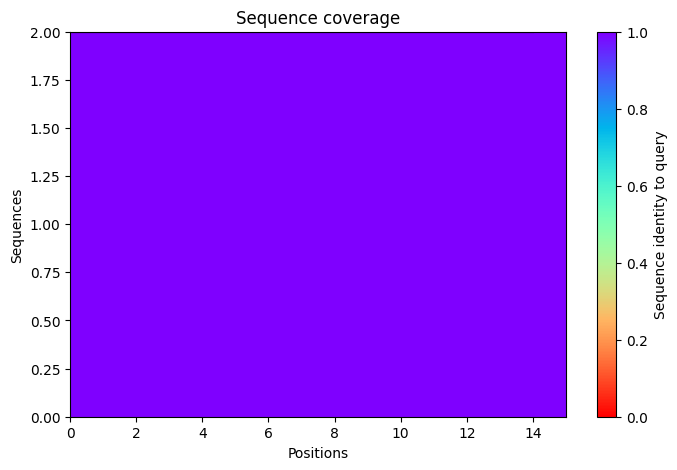

2025-11-17 07:37:27,434 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.9 pTM=0.0296
2025-11-17 07:37:30,008 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.4 pTM=0.0303 tol=1.12
2025-11-17 07:37:32,584 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.9 pTM=0.0304 tol=0.269
2025-11-17 07:37:35,162 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=79.7 pTM=0.0306 tol=0.151
2025-11-17 07:37:35,163 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


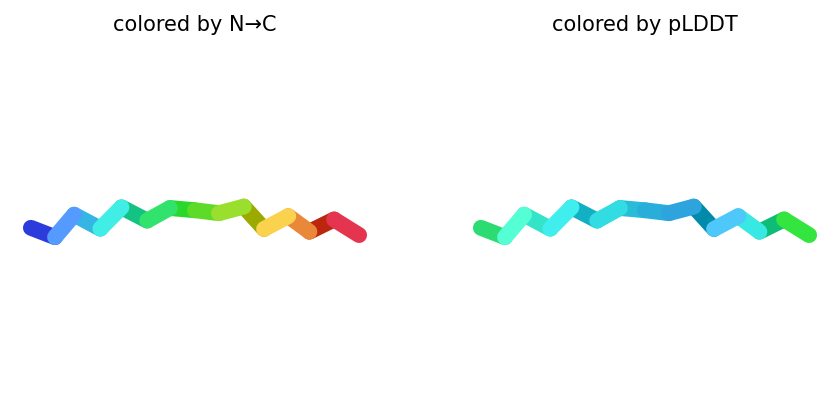

2025-11-17 07:37:37,788 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.9 pTM=0.0287
2025-11-17 07:37:40,367 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.9 pTM=0.0294 tol=0.689
2025-11-17 07:37:42,949 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.6 pTM=0.03 tol=0.143
2025-11-17 07:37:45,527 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=77.2 pTM=0.0302 tol=0.0695
2025-11-17 07:37:45,528 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


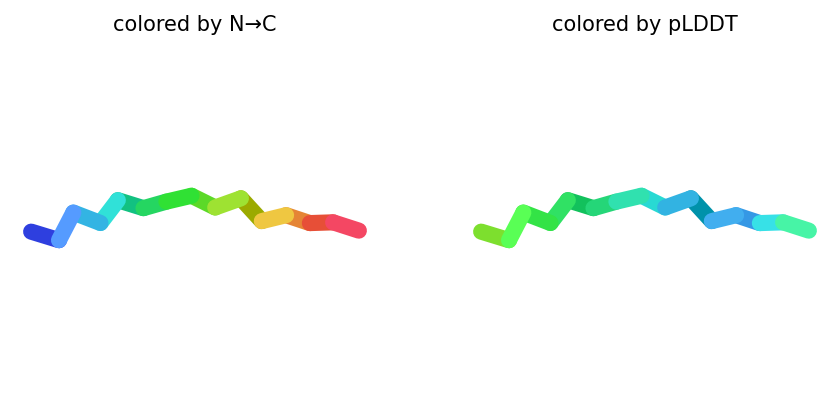

2025-11-17 07:37:48,165 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=78.9 pTM=0.0292
2025-11-17 07:37:50,745 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.1 pTM=0.0288 tol=0.224
2025-11-17 07:37:53,337 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=79.8 pTM=0.029 tol=0.116
2025-11-17 07:37:55,925 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.4 pTM=0.0292 tol=0.0861
2025-11-17 07:37:55,926 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


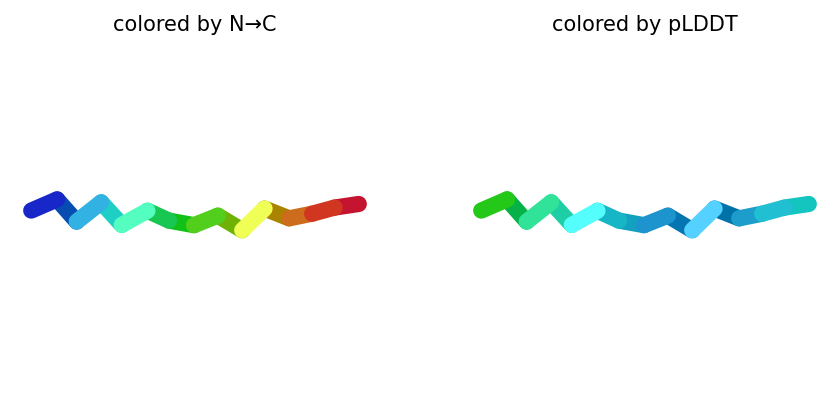

2025-11-17 07:37:58,598 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.3 pTM=0.0294
2025-11-17 07:38:01,193 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.5 pTM=0.0291 tol=0.386
2025-11-17 07:38:03,786 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=79.6 pTM=0.0293 tol=0.244
2025-11-17 07:38:06,376 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.9 pTM=0.0293 tol=0.0674
2025-11-17 07:38:06,377 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


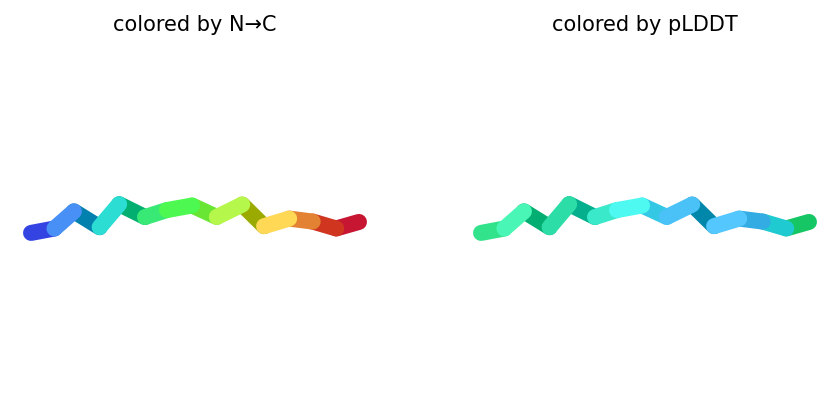

2025-11-17 07:38:09,024 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=74.1 pTM=0.0288
2025-11-17 07:38:11,614 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=80.2 pTM=0.0294 tol=0.585
2025-11-17 07:38:14,202 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=82.5 pTM=0.0298 tol=0.292
2025-11-17 07:38:16,785 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=82.2 pTM=0.0297 tol=0.0661
2025-11-17 07:38:16,786 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


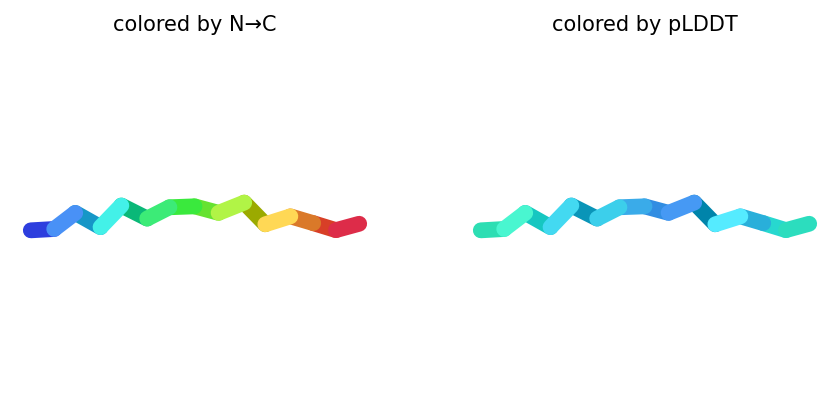

2025-11-17 07:38:16,835 reranking models by 'plddt' metric
2025-11-17 07:38:16,835 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=82.2 pTM=0.0297
2025-11-17 07:38:16,836 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=80.4 pTM=0.0292
2025-11-17 07:38:16,837 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=79.9 pTM=0.0293
2025-11-17 07:38:16,837 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=79.7 pTM=0.0306
2025-11-17 07:38:16,837 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=77.2 pTM=0.0302
2025-11-17 07:38:18,220 Query 20/146: peptide_56_IC50_308.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:38:18,517 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


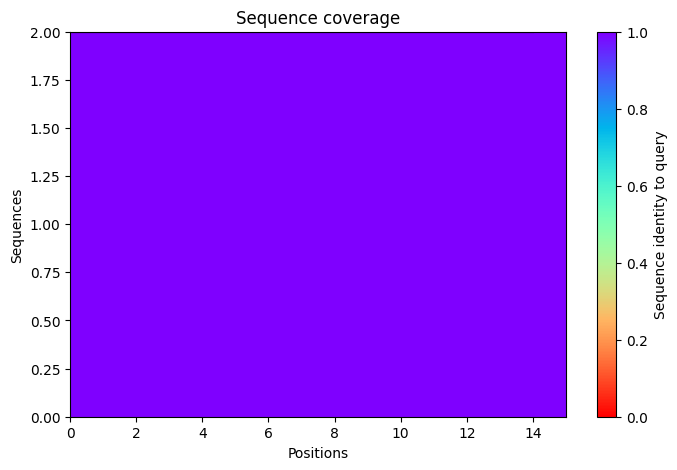

2025-11-17 07:38:30,540 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=85 pTM=0.0463
2025-11-17 07:38:33,115 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=86.6 pTM=0.0462 tol=0.139
2025-11-17 07:38:35,690 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=85.8 pTM=0.0459 tol=0.0495
2025-11-17 07:38:38,271 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=86 pTM=0.0459 tol=0.0486
2025-11-17 07:38:38,272 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


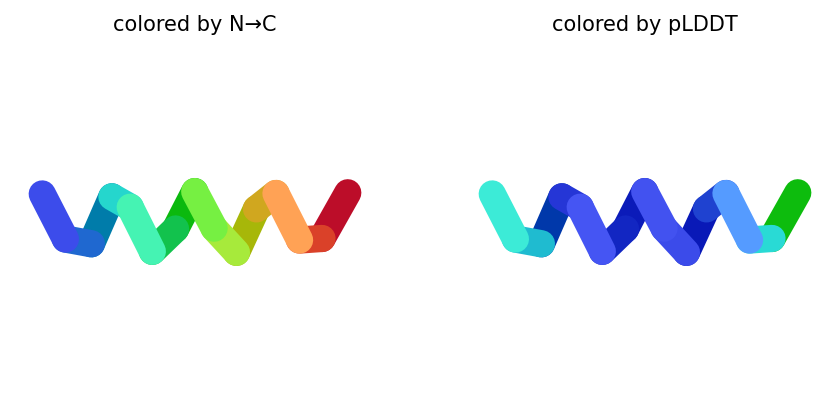

2025-11-17 07:38:40,907 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=80.8 pTM=0.0429
2025-11-17 07:38:43,486 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.3 pTM=0.0426 tol=0.0955
2025-11-17 07:38:46,066 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.7 pTM=0.0417 tol=0.0374
2025-11-17 07:38:48,650 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=75.8 pTM=0.0421 tol=0.0324
2025-11-17 07:38:48,651 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


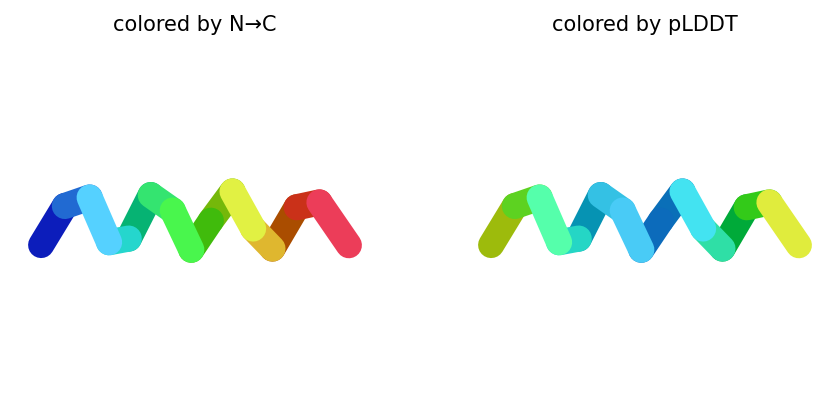

2025-11-17 07:38:51,289 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=77.6 pTM=0.0376
2025-11-17 07:38:53,873 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=81.2 pTM=0.0398 tol=0.29
2025-11-17 07:38:56,464 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.7 pTM=0.0403 tol=0.123
2025-11-17 07:38:59,055 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=84.2 pTM=0.042 tol=0.177
2025-11-17 07:38:59,055 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


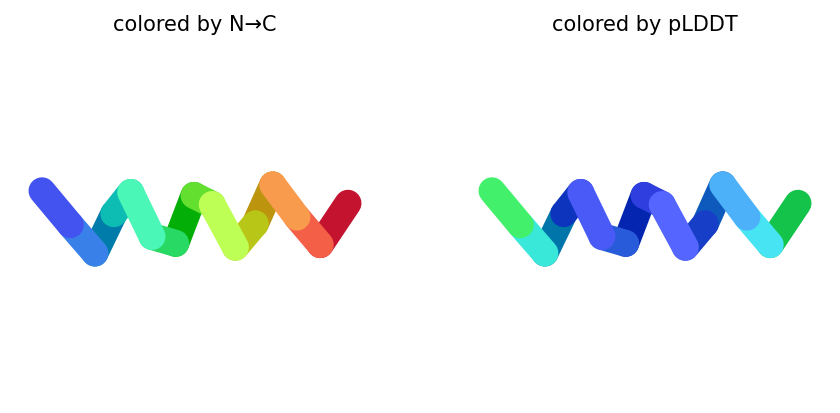

2025-11-17 07:39:01,698 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=86.1 pTM=0.0459
2025-11-17 07:39:04,289 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=85.4 pTM=0.0462 tol=0.238
2025-11-17 07:39:06,871 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=86.4 pTM=0.0462 tol=0.153
2025-11-17 07:39:09,460 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=86.9 pTM=0.0465 tol=0.0681
2025-11-17 07:39:09,460 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


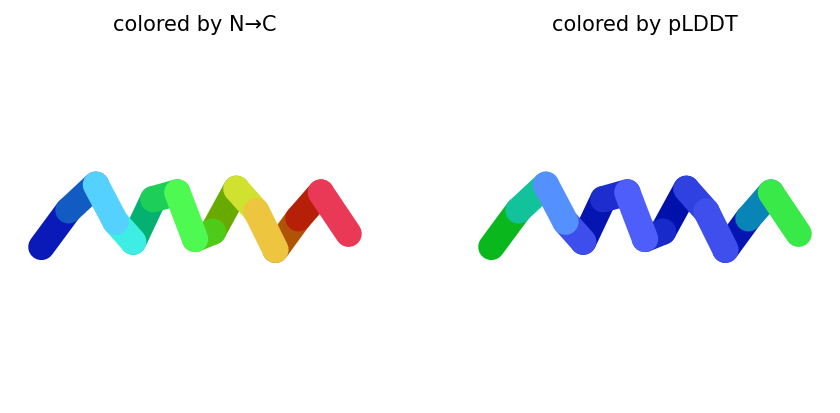

2025-11-17 07:39:12,099 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=87.3 pTM=0.0447
2025-11-17 07:39:14,678 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=87.1 pTM=0.0449 tol=0.0844
2025-11-17 07:39:17,263 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=87.6 pTM=0.0452 tol=0.052
2025-11-17 07:39:19,844 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.6 pTM=0.0454 tol=0.0529
2025-11-17 07:39:19,844 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


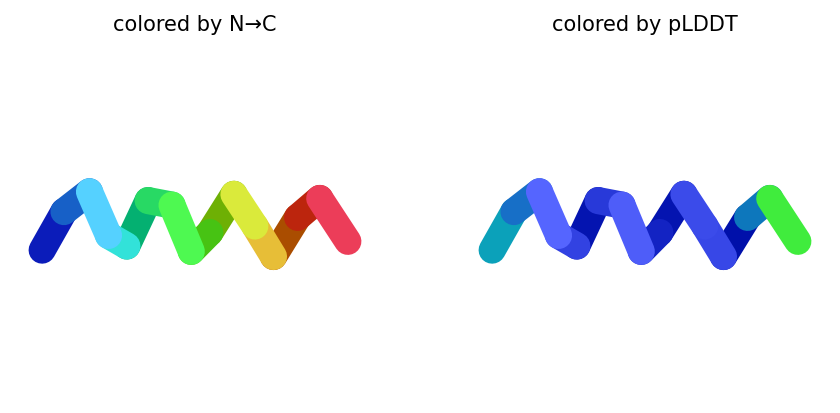

2025-11-17 07:39:19,926 reranking models by 'plddt' metric
2025-11-17 07:39:19,926 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.6 pTM=0.0454
2025-11-17 07:39:19,927 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=86.9 pTM=0.0465
2025-11-17 07:39:19,927 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=86 pTM=0.0459
2025-11-17 07:39:19,928 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=84.2 pTM=0.042
2025-11-17 07:39:19,928 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=75.8 pTM=0.0421
2025-11-17 07:39:21,243 Query 21/146: peptide_57_IC50_302.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:39:21,531 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


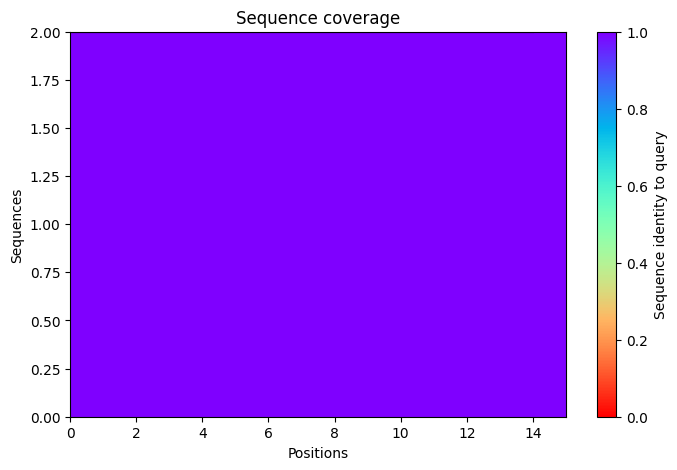

2025-11-17 07:39:37,290 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.7 pTM=0.0306
2025-11-17 07:39:39,868 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=71.2 pTM=0.032 tol=0.27
2025-11-17 07:39:42,445 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72 pTM=0.0327 tol=0.0988
2025-11-17 07:39:45,023 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=71.9 pTM=0.0329 tol=0.0776
2025-11-17 07:39:45,024 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


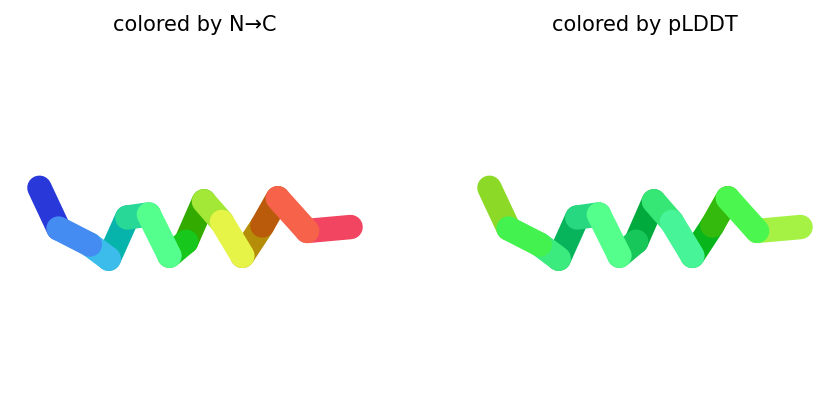

2025-11-17 07:39:47,679 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.2 pTM=0.0265
2025-11-17 07:39:50,263 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63.7 pTM=0.0267 tol=2.17
2025-11-17 07:39:52,841 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.4 pTM=0.0272 tol=1.56
2025-11-17 07:39:55,421 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=67 pTM=0.0268 tol=0.854
2025-11-17 07:39:55,421 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


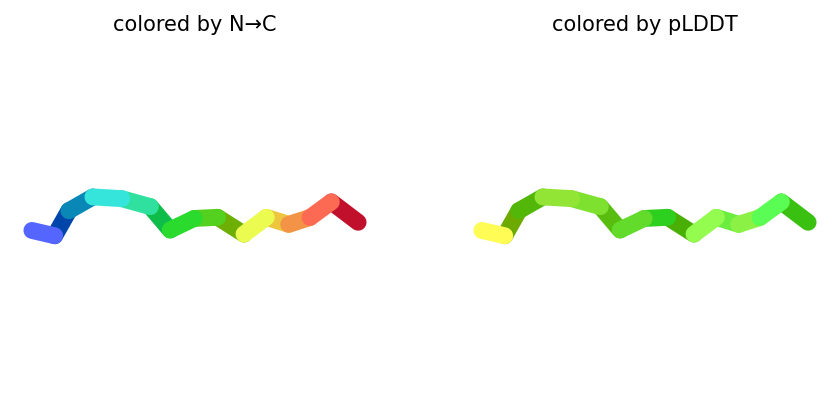

2025-11-17 07:39:58,060 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.7 pTM=0.028
2025-11-17 07:40:00,652 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.4 pTM=0.0287 tol=1.03
2025-11-17 07:40:03,237 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.1 pTM=0.0291 tol=0.262
2025-11-17 07:40:05,836 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77.8 pTM=0.0294 tol=0.571
2025-11-17 07:40:05,837 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


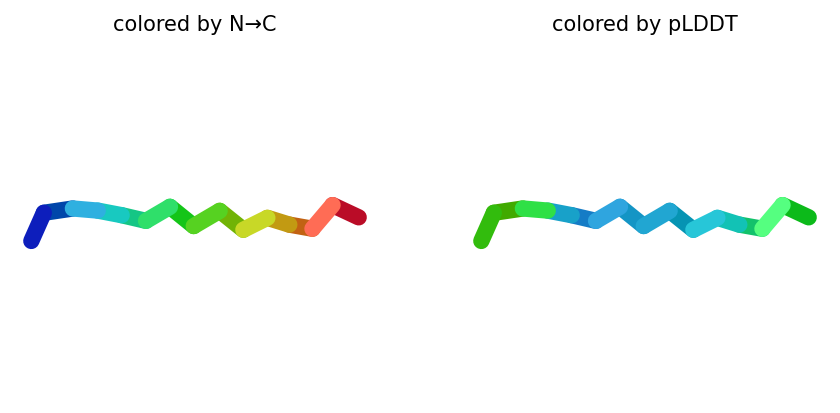

2025-11-17 07:40:08,491 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.3 pTM=0.0278
2025-11-17 07:40:11,097 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=69.8 pTM=0.0283 tol=0.36
2025-11-17 07:40:13,699 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.1 pTM=0.0287 tol=0.419
2025-11-17 07:40:16,295 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.3 pTM=0.0285 tol=0.179
2025-11-17 07:40:16,296 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


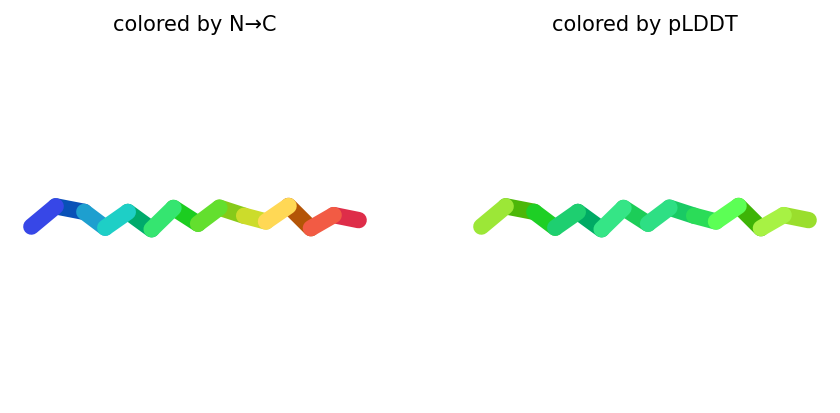

2025-11-17 07:40:18,943 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.4 pTM=0.0284
2025-11-17 07:40:21,540 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.3 pTM=0.0274 tol=0.997
2025-11-17 07:40:24,132 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=62.6 pTM=0.0273 tol=0.946
2025-11-17 07:40:26,720 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=61.7 pTM=0.0269 tol=0.364
2025-11-17 07:40:26,720 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


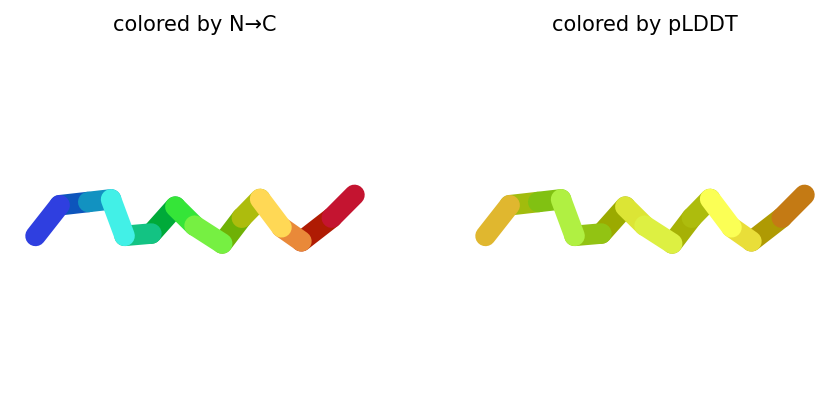

2025-11-17 07:40:26,768 reranking models by 'plddt' metric
2025-11-17 07:40:26,769 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=77.8 pTM=0.0294
2025-11-17 07:40:26,769 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=71.9 pTM=0.0329
2025-11-17 07:40:26,769 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=71.3 pTM=0.0285
2025-11-17 07:40:26,770 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=67 pTM=0.0268
2025-11-17 07:40:26,770 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=61.7 pTM=0.0269
2025-11-17 07:40:27,734 Query 22/146: peptide_58_IC50_304.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:40:28,014 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


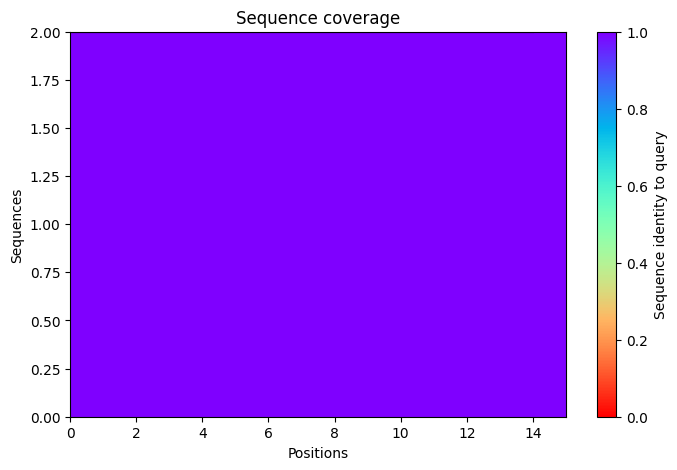

2025-11-17 07:40:40,088 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=80.2 pTM=0.04
2025-11-17 07:40:42,665 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.2 pTM=0.041 tol=0.0613
2025-11-17 07:40:45,246 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.4 pTM=0.0421 tol=0.0528
2025-11-17 07:40:47,825 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.2 pTM=0.0418 tol=0.0438
2025-11-17 07:40:47,825 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


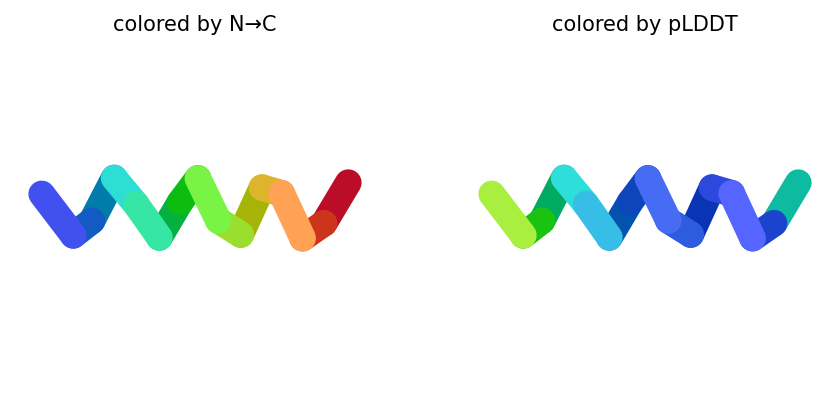

2025-11-17 07:40:50,457 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.6 pTM=0.0391
2025-11-17 07:40:53,035 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.3 pTM=0.0392 tol=0.192
2025-11-17 07:40:55,618 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.9 pTM=0.04 tol=0.0744
2025-11-17 07:40:58,202 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=73.2 pTM=0.0387 tol=0.0438
2025-11-17 07:40:58,203 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


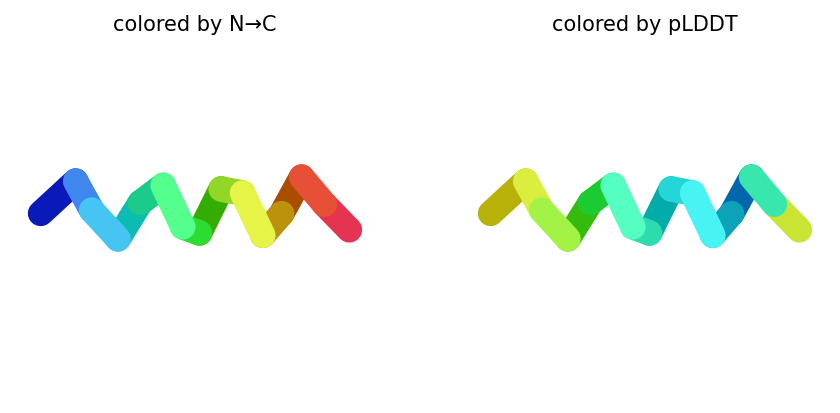

2025-11-17 07:41:00,875 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=81.5 pTM=0.0384
2025-11-17 07:41:03,455 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=82.6 pTM=0.0399 tol=0.0793
2025-11-17 07:41:06,043 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=83.6 pTM=0.0403 tol=0.0647
2025-11-17 07:41:08,633 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=83 pTM=0.0397 tol=0.0603
2025-11-17 07:41:08,634 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


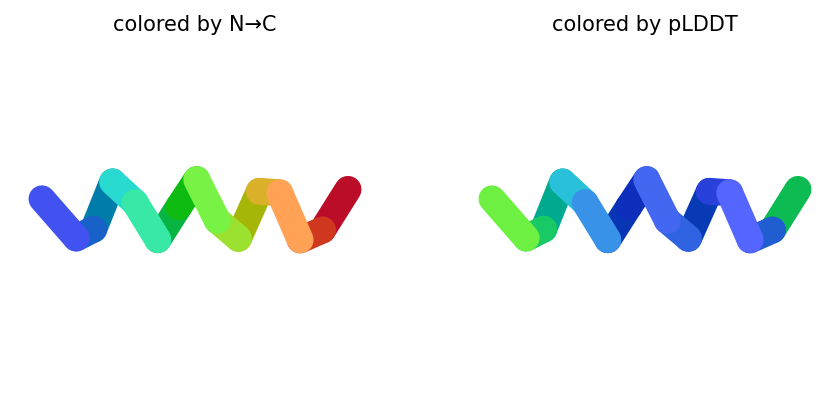

2025-11-17 07:41:11,302 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=82.5 pTM=0.042
2025-11-17 07:41:13,888 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=84.8 pTM=0.0434 tol=0.0421
2025-11-17 07:41:16,478 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=85.3 pTM=0.0437 tol=0.112
2025-11-17 07:41:19,068 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=85.6 pTM=0.0434 tol=0.0505
2025-11-17 07:41:19,069 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


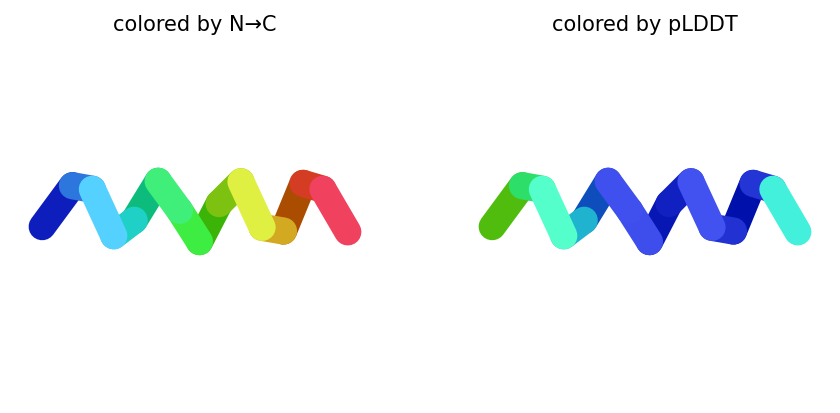

2025-11-17 07:41:21,704 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=87.4 pTM=0.043
2025-11-17 07:41:24,285 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=87.6 pTM=0.0445 tol=0.0555
2025-11-17 07:41:26,871 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=88.8 pTM=0.0446 tol=0.0431
2025-11-17 07:41:29,449 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.1 pTM=0.0441 tol=0.0527
2025-11-17 07:41:29,450 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


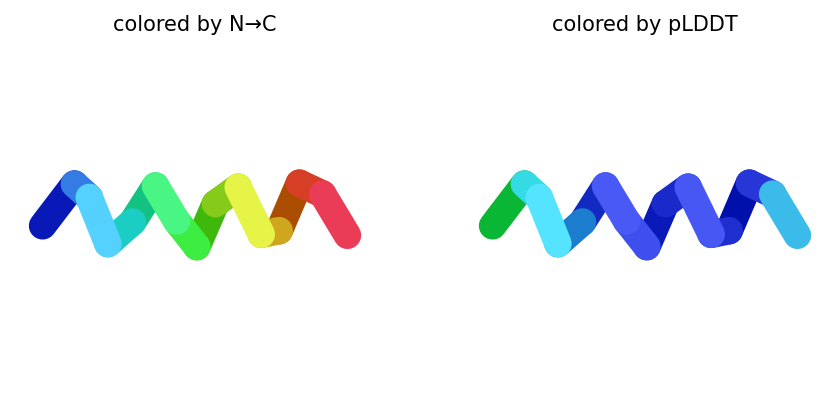

2025-11-17 07:41:29,501 reranking models by 'plddt' metric
2025-11-17 07:41:29,501 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.1 pTM=0.0441
2025-11-17 07:41:29,501 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=85.6 pTM=0.0434
2025-11-17 07:41:29,502 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=83 pTM=0.0397
2025-11-17 07:41:29,502 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=82.2 pTM=0.0418
2025-11-17 07:41:29,502 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=73.2 pTM=0.0387
2025-11-17 07:41:30,883 Query 23/146: peptide_59_IC50_293.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:41:31,169 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


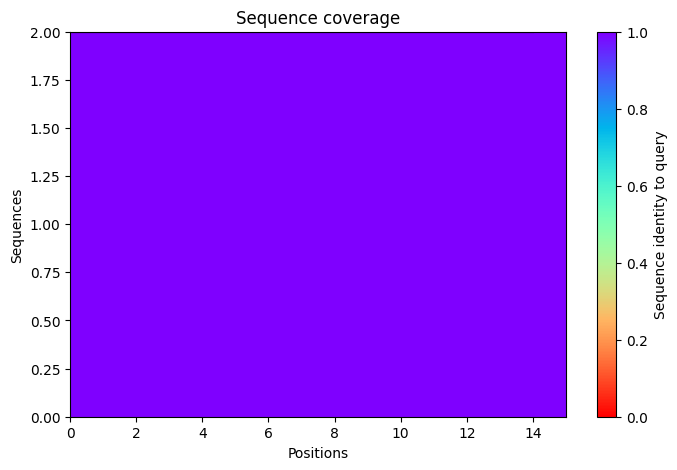

2025-11-17 07:41:46,201 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=79.1 pTM=0.0399
2025-11-17 07:41:48,781 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.6 pTM=0.035 tol=0.782
2025-11-17 07:41:51,360 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=66.1 pTM=0.0326 tol=0.984
2025-11-17 07:41:53,938 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=64 pTM=0.0314 tol=0.809
2025-11-17 07:41:53,939 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


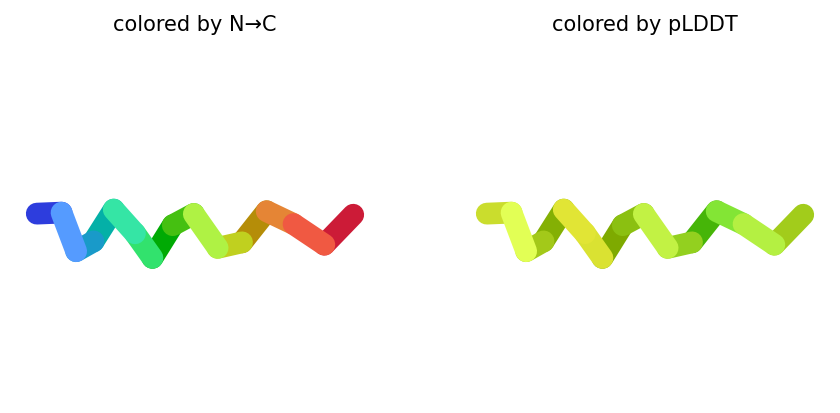

2025-11-17 07:41:56,588 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70.4 pTM=0.0366
2025-11-17 07:41:59,174 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.4 pTM=0.0303 tol=1.81
2025-11-17 07:42:01,755 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=61.4 pTM=0.0295 tol=0.947
2025-11-17 07:42:04,334 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=61.8 pTM=0.0285 tol=1.31
2025-11-17 07:42:04,335 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


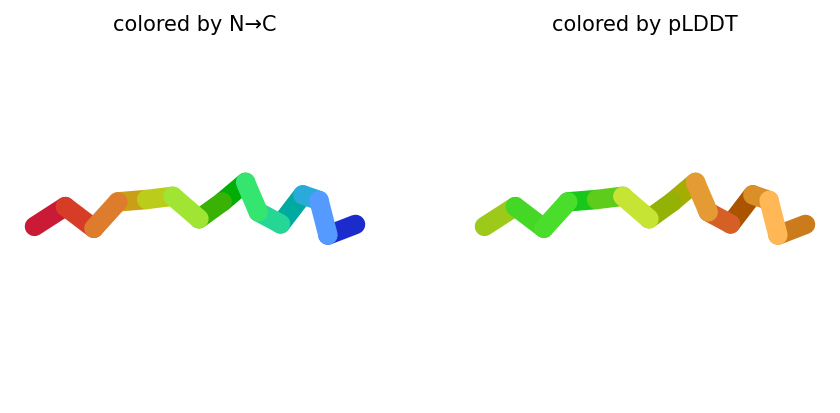

2025-11-17 07:42:06,983 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.8 pTM=0.0337
2025-11-17 07:42:09,576 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.8 pTM=0.0317 tol=0.417
2025-11-17 07:42:12,171 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=70.4 pTM=0.0302 tol=0.654
2025-11-17 07:42:14,774 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=67.1 pTM=0.0289 tol=1.22
2025-11-17 07:42:14,774 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


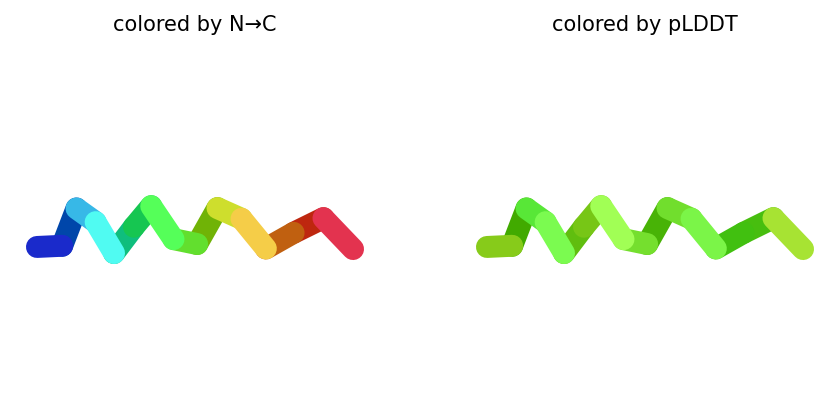

2025-11-17 07:42:17,431 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=64.4 pTM=0.0298
2025-11-17 07:42:20,035 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=64.5 pTM=0.0288 tol=1.62
2025-11-17 07:42:22,632 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=65.4 pTM=0.028 tol=0.785
2025-11-17 07:42:25,226 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=66.4 pTM=0.0278 tol=0.247
2025-11-17 07:42:25,227 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


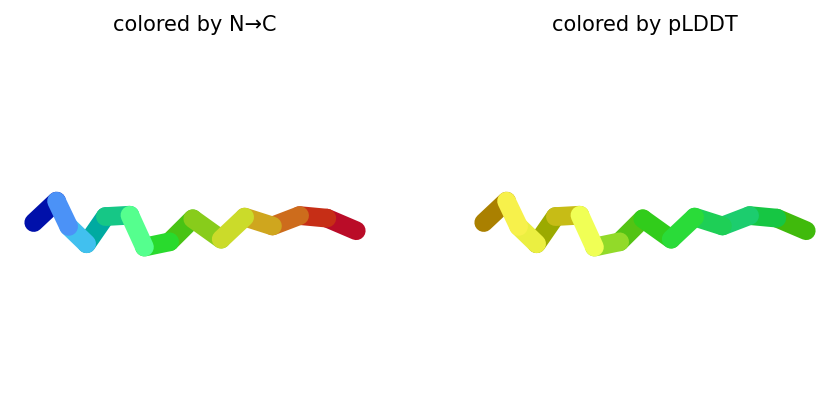

2025-11-17 07:42:27,872 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=79.7 pTM=0.0387
2025-11-17 07:42:30,467 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=75.3 pTM=0.0364 tol=0.448
2025-11-17 07:42:33,062 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.1 pTM=0.0349 tol=0.269
2025-11-17 07:42:35,652 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=71.7 pTM=0.0338 tol=0.26
2025-11-17 07:42:35,653 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


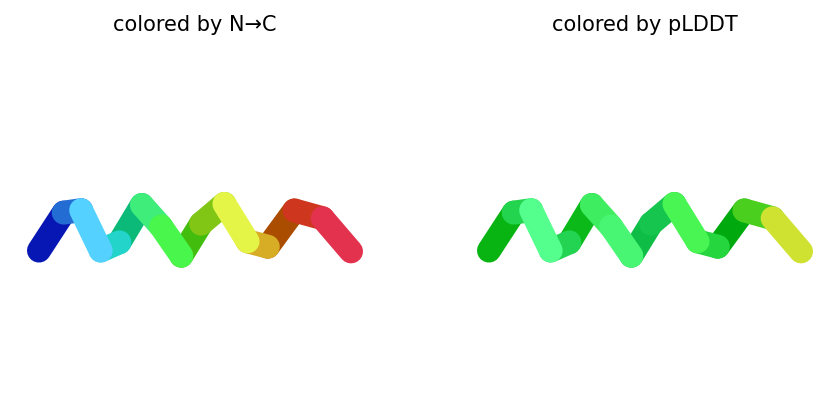

2025-11-17 07:42:35,703 reranking models by 'plddt' metric
2025-11-17 07:42:35,704 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=71.7 pTM=0.0338
2025-11-17 07:42:35,704 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=67.1 pTM=0.0289
2025-11-17 07:42:35,704 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=66.4 pTM=0.0278
2025-11-17 07:42:35,704 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=64 pTM=0.0314
2025-11-17 07:42:35,705 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=61.8 pTM=0.0285
2025-11-17 07:42:36,698 Query 24/146: peptide_60_IC50_305.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:42:36,990 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


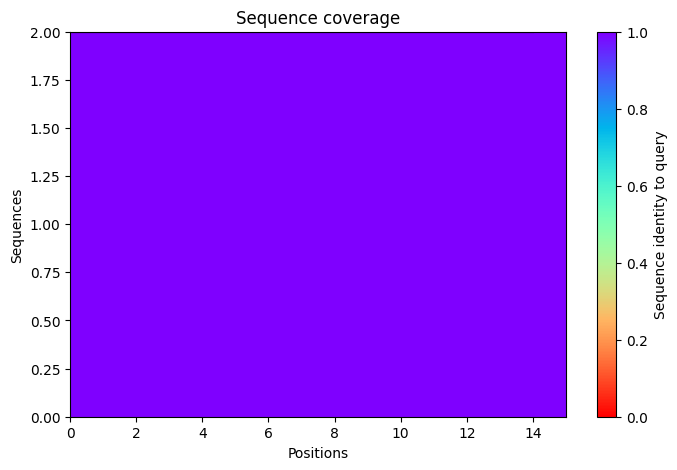

2025-11-17 07:42:48,427 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=87.5 pTM=0.0436
2025-11-17 07:42:51,002 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=86.2 pTM=0.043 tol=0.158
2025-11-17 07:42:53,577 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=86.1 pTM=0.043 tol=0.0335
2025-11-17 07:42:56,153 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=86.2 pTM=0.0432 tol=0.0341
2025-11-17 07:42:56,154 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


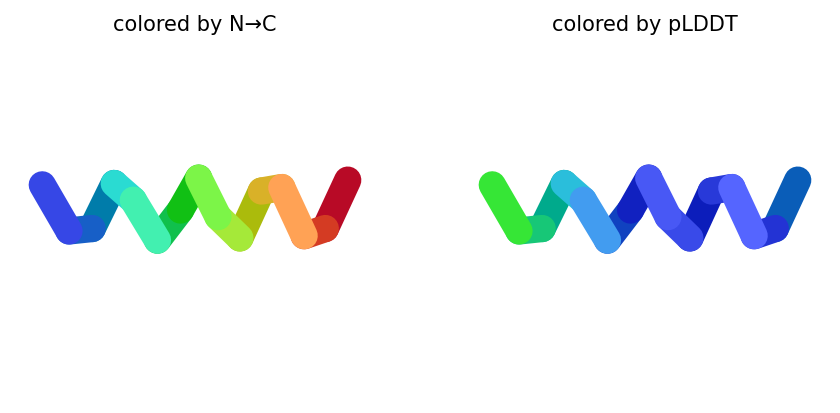

2025-11-17 07:42:58,791 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=82.4 pTM=0.0417
2025-11-17 07:43:01,373 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=79.5 pTM=0.0408 tol=0.152
2025-11-17 07:43:03,951 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=79.2 pTM=0.0407 tol=0.0339
2025-11-17 07:43:06,532 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=80.6 pTM=0.0416 tol=0.0482
2025-11-17 07:43:06,533 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


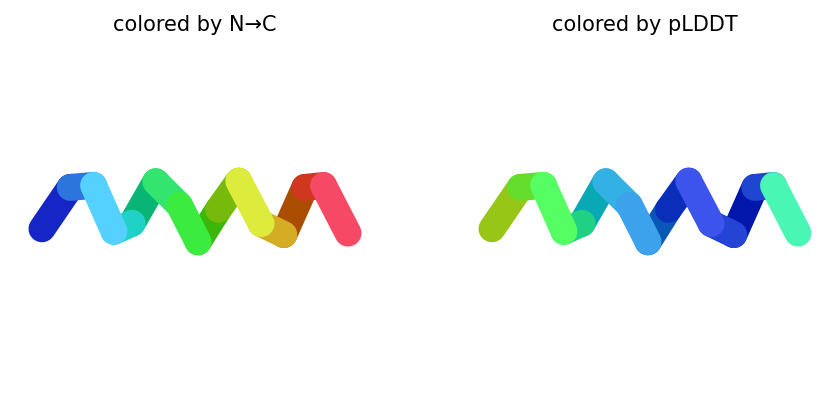

2025-11-17 07:43:09,163 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=91.6 pTM=0.0443
2025-11-17 07:43:11,751 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=89.8 pTM=0.0434 tol=0.0484
2025-11-17 07:43:14,333 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=89.9 pTM=0.044 tol=0.044
2025-11-17 07:43:16,924 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=90.5 pTM=0.0448 tol=0.0388
2025-11-17 07:43:16,925 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


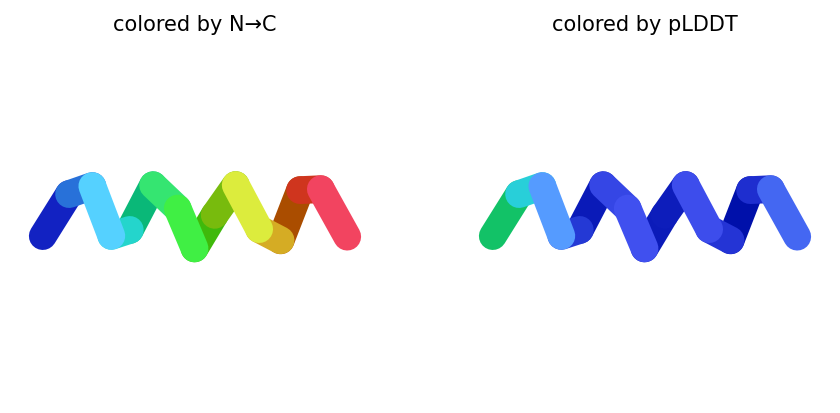

2025-11-17 07:43:19,569 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=86.9 pTM=0.0428
2025-11-17 07:43:22,163 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=86.1 pTM=0.043 tol=0.0753
2025-11-17 07:43:24,755 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=85.6 pTM=0.043 tol=0.0202
2025-11-17 07:43:27,346 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=86.8 pTM=0.0437 tol=0.0172
2025-11-17 07:43:27,346 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


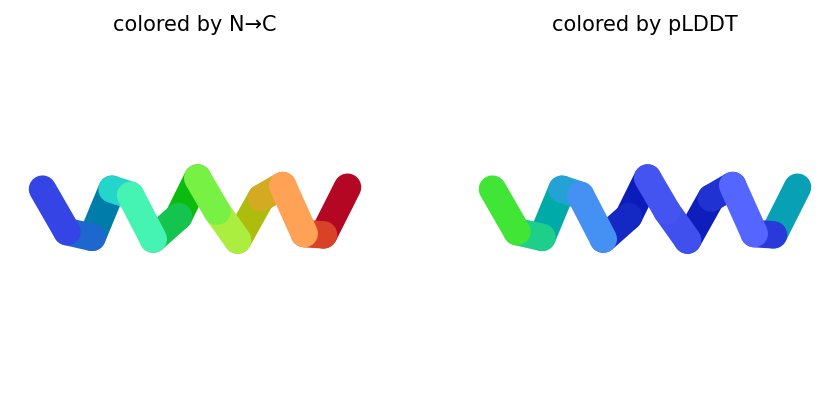

2025-11-17 07:43:29,985 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=92.4 pTM=0.0446
2025-11-17 07:43:32,569 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=91.4 pTM=0.0444 tol=0.0748
2025-11-17 07:43:35,157 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=91.8 pTM=0.0444 tol=0.0329
2025-11-17 07:43:37,745 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=91.8 pTM=0.045 tol=0.0408
2025-11-17 07:43:37,746 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


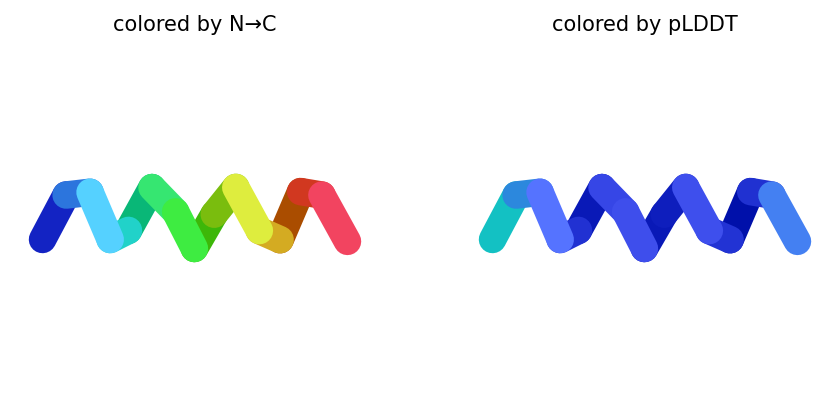

2025-11-17 07:43:37,795 reranking models by 'plddt' metric
2025-11-17 07:43:37,796 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=91.8 pTM=0.045
2025-11-17 07:43:37,796 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=90.5 pTM=0.0448
2025-11-17 07:43:37,796 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=86.8 pTM=0.0437
2025-11-17 07:43:37,797 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=86.2 pTM=0.0432
2025-11-17 07:43:37,797 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=80.6 pTM=0.0416
2025-11-17 07:43:38,768 Query 25/146: peptide_61_IC50_295.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:43:39,040 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


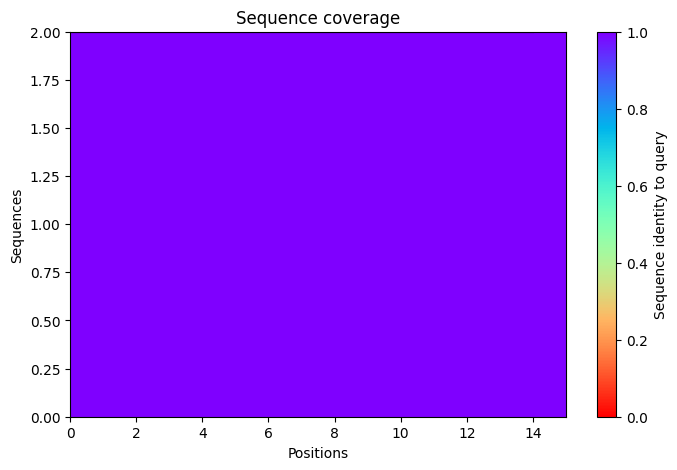

2025-11-17 07:43:53,119 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.8 pTM=0.0321
2025-11-17 07:43:55,695 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=66.5 pTM=0.0343 tol=0.659
2025-11-17 07:43:58,276 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=66.9 pTM=0.0334 tol=0.126
2025-11-17 07:44:00,856 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=70 pTM=0.0355 tol=0.308
2025-11-17 07:44:00,857 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


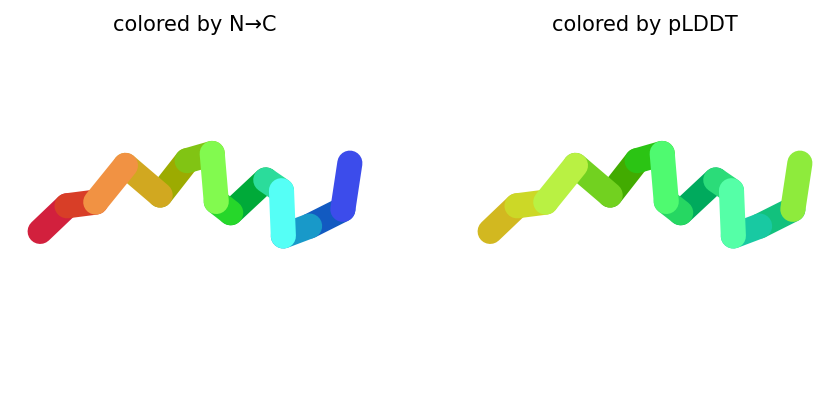

2025-11-17 07:44:03,492 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.3 pTM=0.0276
2025-11-17 07:44:06,071 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.5 pTM=0.0273 tol=0.872
2025-11-17 07:44:08,647 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.3 pTM=0.0266 tol=0.618
2025-11-17 07:44:11,229 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60.7 pTM=0.0265 tol=0.208
2025-11-17 07:44:11,230 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


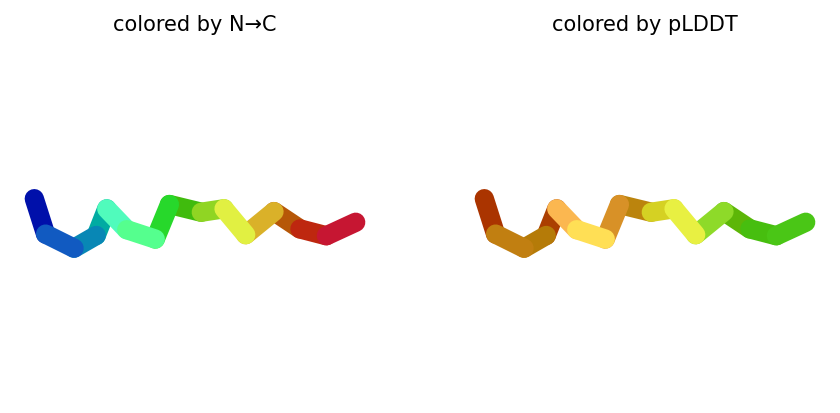

2025-11-17 07:44:13,875 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=69.6 pTM=0.0267
2025-11-17 07:44:16,465 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=78.6 pTM=0.0286 tol=0.471
2025-11-17 07:44:19,056 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.9 pTM=0.0291 tol=0.161
2025-11-17 07:44:21,652 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=82.1 pTM=0.0297 tol=0.0786
2025-11-17 07:44:21,653 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


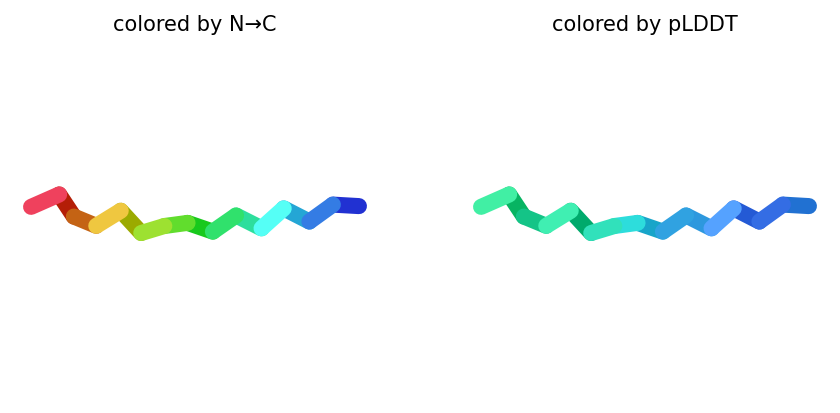

2025-11-17 07:44:24,326 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.1 pTM=0.0267
2025-11-17 07:44:26,919 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=68.5 pTM=0.0282 tol=1.92
2025-11-17 07:44:29,512 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=73 pTM=0.0287 tol=0.426
2025-11-17 07:44:32,106 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.1 pTM=0.0292 tol=0.183
2025-11-17 07:44:32,107 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


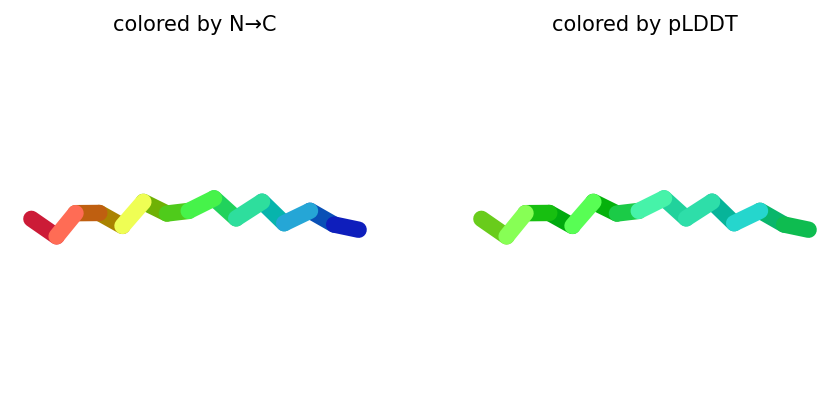

2025-11-17 07:44:34,750 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=65.2 pTM=0.0319
2025-11-17 07:44:37,342 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.2 pTM=0.0307 tol=0.509
2025-11-17 07:44:39,929 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63.7 pTM=0.0302 tol=0.425
2025-11-17 07:44:42,518 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.6 pTM=0.0308 tol=0.397
2025-11-17 07:44:42,519 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


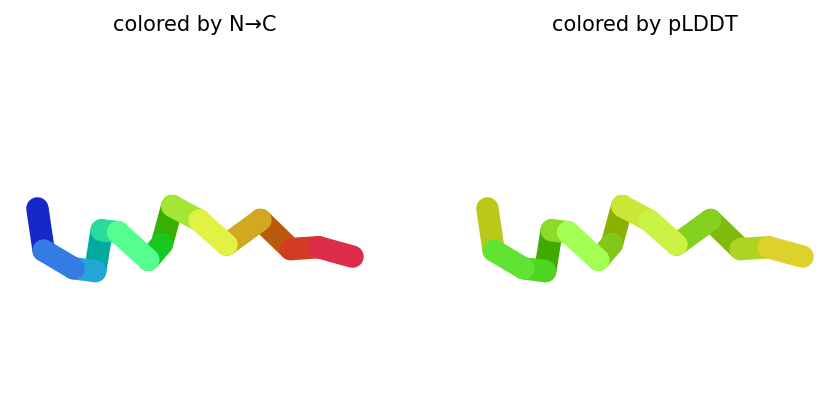

2025-11-17 07:44:42,568 reranking models by 'plddt' metric
2025-11-17 07:44:42,569 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=82.1 pTM=0.0297
2025-11-17 07:44:42,569 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=74.1 pTM=0.0292
2025-11-17 07:44:42,569 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=70 pTM=0.0355
2025-11-17 07:44:42,570 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=64.6 pTM=0.0308
2025-11-17 07:44:42,570 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60.7 pTM=0.0265
2025-11-17 07:44:43,990 Query 26/146: peptide_62_IC50_308.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:44:44,279 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


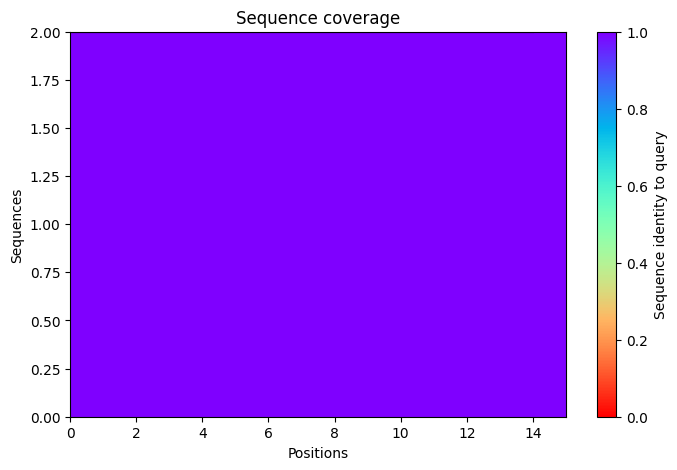

2025-11-17 07:44:54,376 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=83.5 pTM=0.0412
2025-11-17 07:44:56,954 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=75.5 pTM=0.0374 tol=0.306
2025-11-17 07:44:59,530 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=65.8 pTM=0.0341 tol=0.849
2025-11-17 07:45:02,105 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=69.5 pTM=0.0357 tol=0.417
2025-11-17 07:45:02,106 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


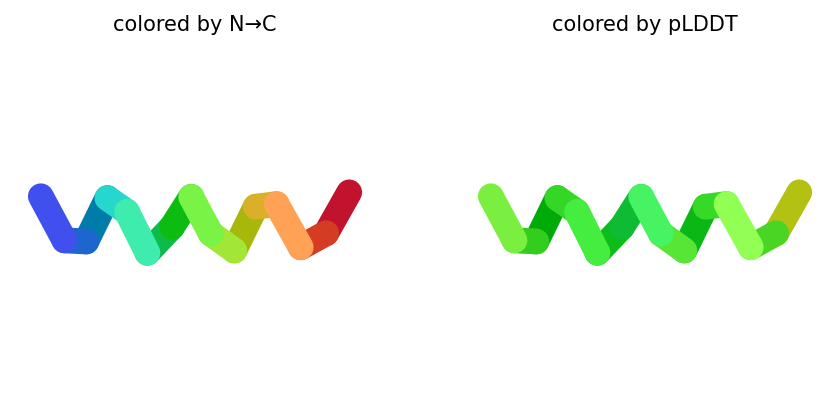

2025-11-17 07:45:04,737 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70 pTM=0.0352
2025-11-17 07:45:07,315 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.4 pTM=0.0305 tol=0.817
2025-11-17 07:45:09,900 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60 pTM=0.0274 tol=2.82
2025-11-17 07:45:12,483 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=61 pTM=0.0296 tol=2.2
2025-11-17 07:45:12,484 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


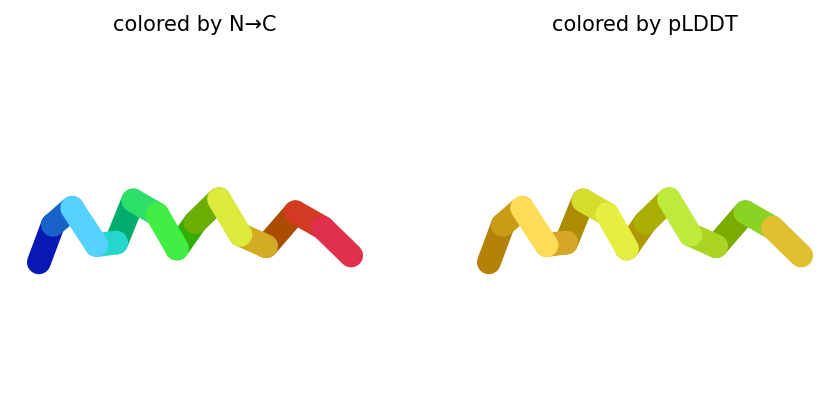

2025-11-17 07:45:15,118 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.4 pTM=0.0332
2025-11-17 07:45:17,705 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.9 pTM=0.0322 tol=1.09
2025-11-17 07:45:20,293 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.9 pTM=0.0286 tol=2.68
2025-11-17 07:45:22,887 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=65.6 pTM=0.0275 tol=1.76
2025-11-17 07:45:22,888 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


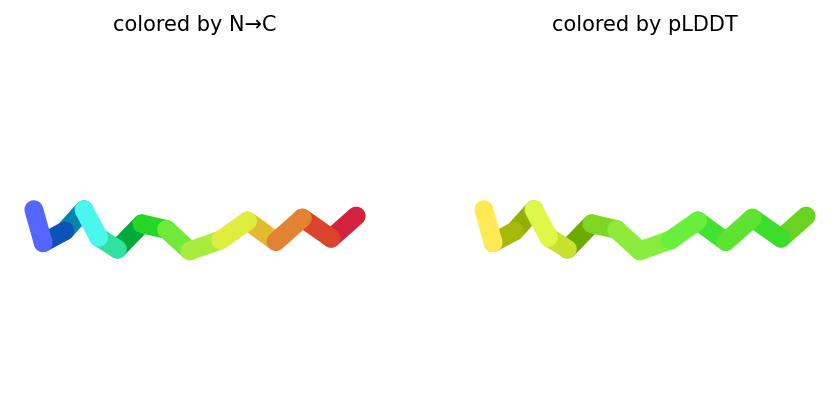

2025-11-17 07:45:25,558 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.4 pTM=0.0284
2025-11-17 07:45:28,145 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.7 pTM=0.0281 tol=1.75
2025-11-17 07:45:30,734 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=67.1 pTM=0.0277 tol=1.74
2025-11-17 07:45:33,321 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=67 pTM=0.0276 tol=0.4
2025-11-17 07:45:33,322 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


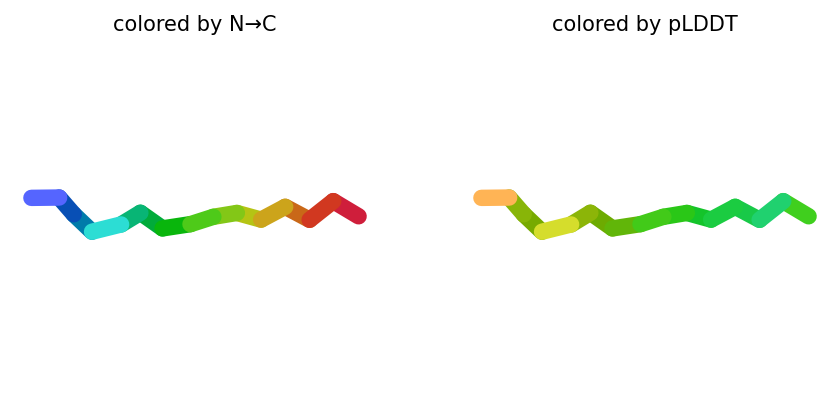

2025-11-17 07:45:35,955 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=77.8 pTM=0.0374
2025-11-17 07:45:38,540 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67.1 pTM=0.0326 tol=1.32
2025-11-17 07:45:41,118 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.3 pTM=0.0289 tol=3.79
2025-11-17 07:45:43,703 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.1 pTM=0.0279 tol=0.335
2025-11-17 07:45:43,704 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


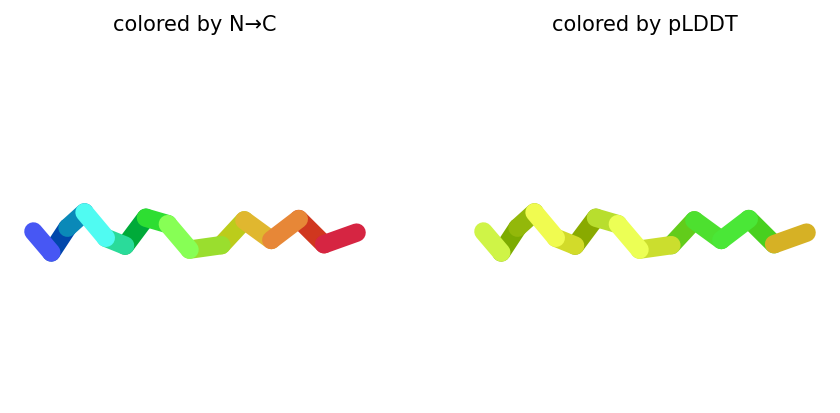

2025-11-17 07:45:43,758 reranking models by 'plddt' metric
2025-11-17 07:45:43,759 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=69.5 pTM=0.0357
2025-11-17 07:45:43,760 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=67 pTM=0.0276
2025-11-17 07:45:43,761 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=65.6 pTM=0.0275
2025-11-17 07:45:43,761 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=64.1 pTM=0.0279
2025-11-17 07:45:43,761 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=61 pTM=0.0296
2025-11-17 07:45:44,761 Query 27/146: peptide_67_IC50_303.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:45:45,054 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


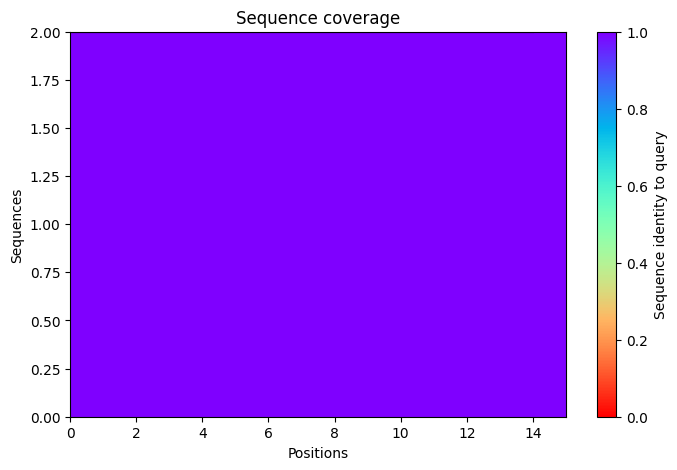

2025-11-17 07:45:55,137 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72 pTM=0.0282
2025-11-17 07:45:57,714 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72 pTM=0.028 tol=0.276
2025-11-17 07:46:00,294 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.2 pTM=0.028 tol=0.0961
2025-11-17 07:46:02,871 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=71.4 pTM=0.0279 tol=0.198
2025-11-17 07:46:02,872 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


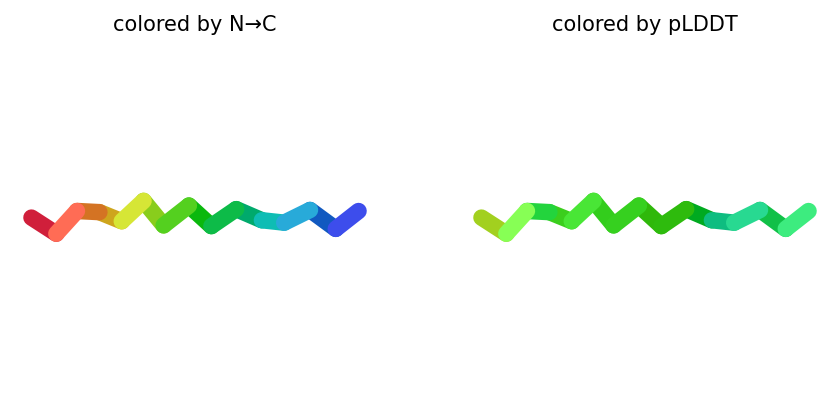

2025-11-17 07:46:05,503 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.3 pTM=0.0274
2025-11-17 07:46:08,081 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.4 pTM=0.0282 tol=0.326
2025-11-17 07:46:10,656 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.5 pTM=0.0279 tol=0.166
2025-11-17 07:46:13,233 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.1 pTM=0.0278 tol=0.0859
2025-11-17 07:46:13,233 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


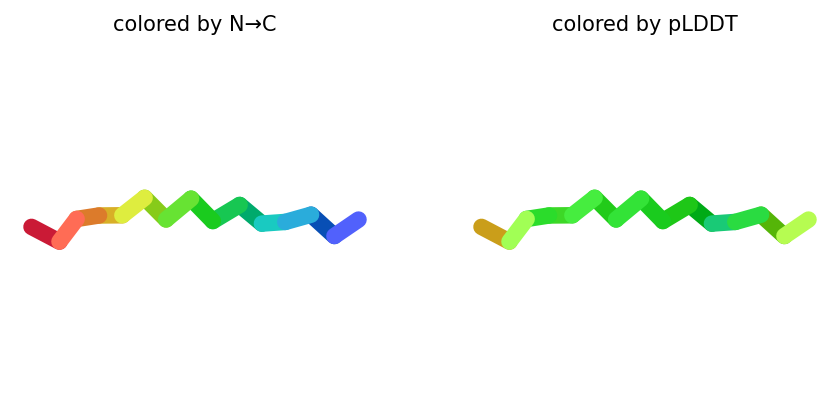

2025-11-17 07:46:15,867 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.4 pTM=0.0269
2025-11-17 07:46:18,446 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.1 pTM=0.0269 tol=0.706
2025-11-17 07:46:21,035 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=73.4 pTM=0.0271 tol=0.485
2025-11-17 07:46:23,619 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=71.7 pTM=0.0268 tol=0.485
2025-11-17 07:46:23,620 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


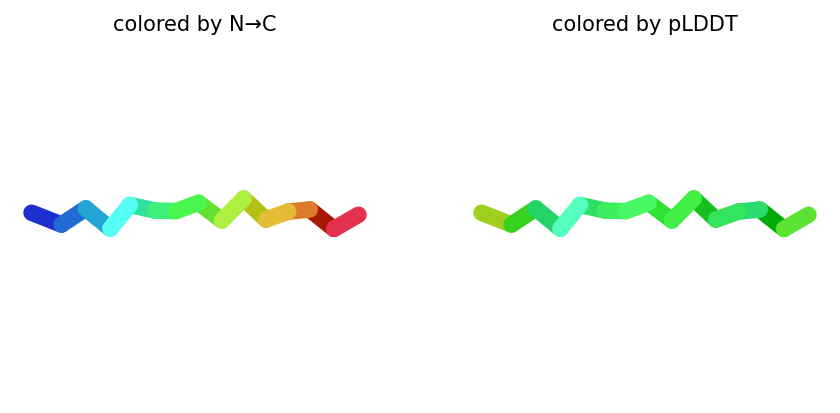

2025-11-17 07:46:26,266 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.1 pTM=0.0282
2025-11-17 07:46:28,847 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.7 pTM=0.0287 tol=0.0812
2025-11-17 07:46:31,431 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.6 pTM=0.0283 tol=0.0638
2025-11-17 07:46:34,014 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.7 pTM=0.0281 tol=0.0977
2025-11-17 07:46:34,015 alphafold2_ptm_model_4_seed_000 took 10.3s (3 recycles)


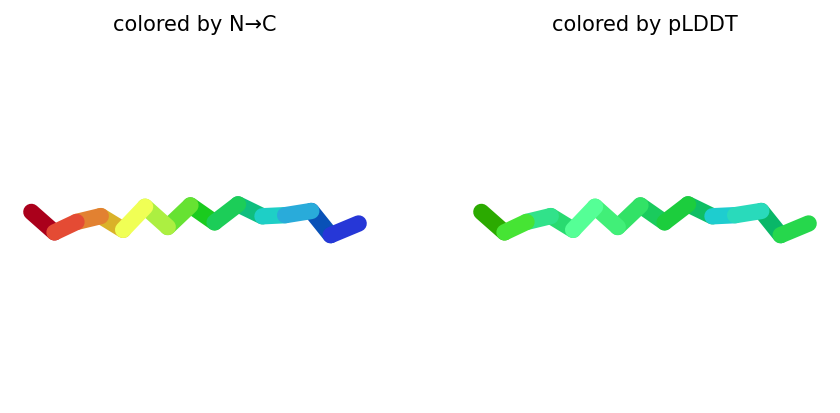

2025-11-17 07:46:36,673 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.8 pTM=0.027
2025-11-17 07:46:39,257 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=68.6 pTM=0.0271 tol=0.443
2025-11-17 07:46:41,835 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=67.4 pTM=0.0273 tol=0.229
2025-11-17 07:46:44,410 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=69.4 pTM=0.0268 tol=0.321
2025-11-17 07:46:44,410 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


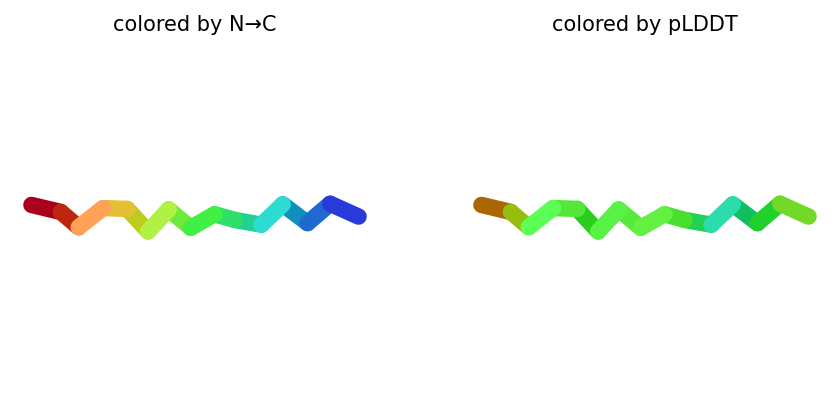

2025-11-17 07:46:44,458 reranking models by 'plddt' metric
2025-11-17 07:46:44,458 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=74.7 pTM=0.0281
2025-11-17 07:46:44,459 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=71.7 pTM=0.0268
2025-11-17 07:46:44,459 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=71.4 pTM=0.0279
2025-11-17 07:46:44,459 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=69.4 pTM=0.0268
2025-11-17 07:46:44,459 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=69.1 pTM=0.0278
2025-11-17 07:46:45,444 Query 28/146: peptide_77_IC50_300.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:46:45,742 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


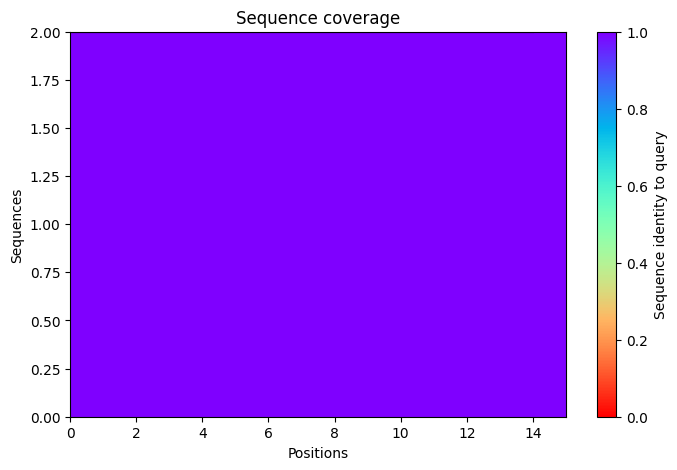

2025-11-17 07:46:55,829 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=56.4 pTM=0.0277
2025-11-17 07:46:58,406 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=58.4 pTM=0.0275 tol=4.12
2025-11-17 07:47:00,984 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=60 pTM=0.0278 tol=0.744
2025-11-17 07:47:03,566 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=59.1 pTM=0.0276 tol=0.703
2025-11-17 07:47:03,566 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


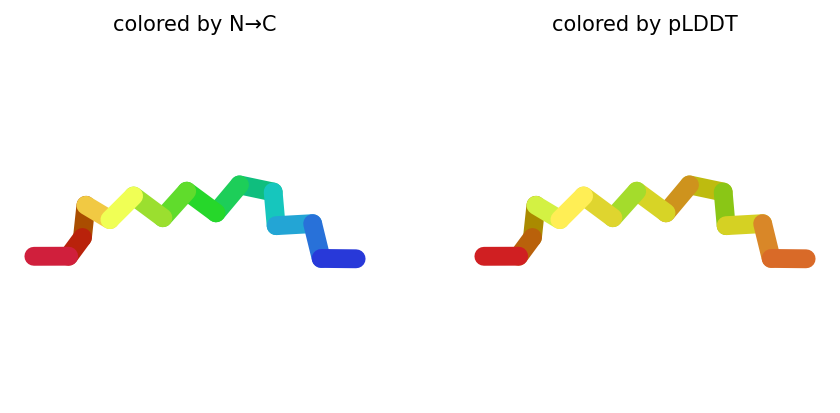

2025-11-17 07:47:06,199 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=59.4 pTM=0.027
2025-11-17 07:47:08,778 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63.2 pTM=0.0277 tol=2.36
2025-11-17 07:47:11,359 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.9 pTM=0.0281 tol=0.658
2025-11-17 07:47:13,945 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=64.6 pTM=0.0279 tol=0.232
2025-11-17 07:47:13,946 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


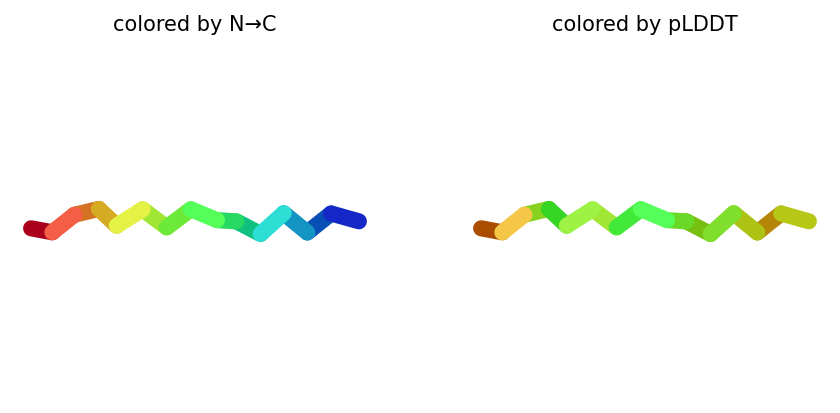

2025-11-17 07:47:16,588 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=61.2 pTM=0.0266
2025-11-17 07:47:19,172 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=67.9 pTM=0.0275 tol=2.55
2025-11-17 07:47:21,767 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=71.6 pTM=0.0279 tol=0.517
2025-11-17 07:47:24,355 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.6 pTM=0.0278 tol=0.192
2025-11-17 07:47:24,355 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


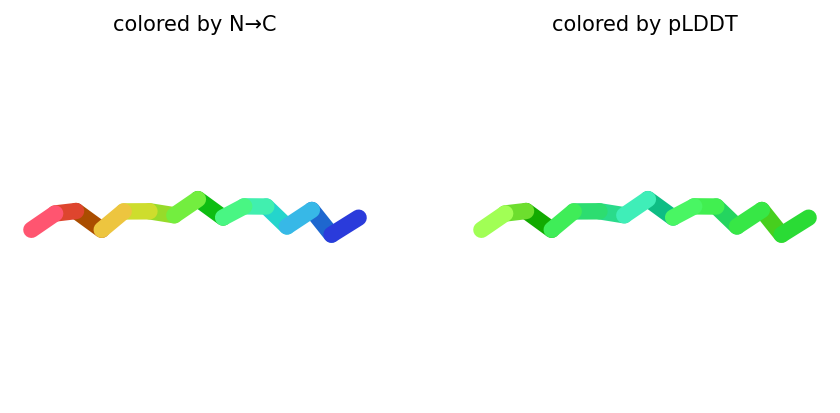

2025-11-17 07:47:26,994 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62.4 pTM=0.0272
2025-11-17 07:47:29,579 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.7 pTM=0.0276 tol=0.46
2025-11-17 07:47:32,169 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=65.4 pTM=0.0276 tol=0.459
2025-11-17 07:47:34,749 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=66 pTM=0.0277 tol=0.671
2025-11-17 07:47:34,750 alphafold2_ptm_model_4_seed_000 took 10.3s (3 recycles)


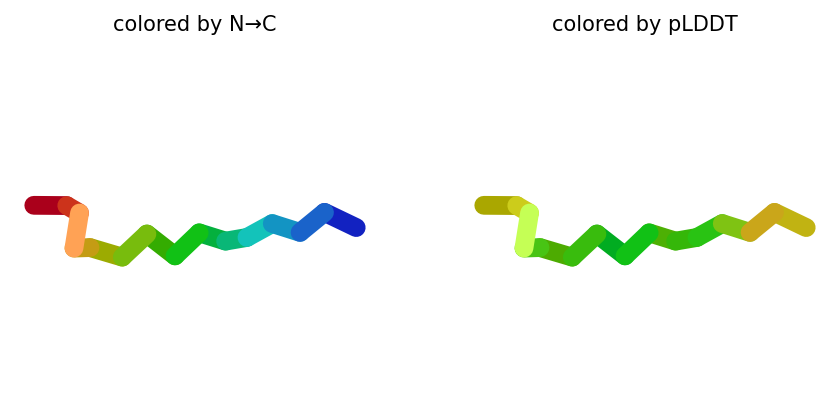

2025-11-17 07:47:37,405 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=58.6 pTM=0.0271
2025-11-17 07:47:39,990 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.1 pTM=0.0277 tol=2.13
2025-11-17 07:47:42,565 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.2 pTM=0.0277 tol=0.731
2025-11-17 07:47:45,142 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=65.7 pTM=0.0273 tol=0.244
2025-11-17 07:47:45,142 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


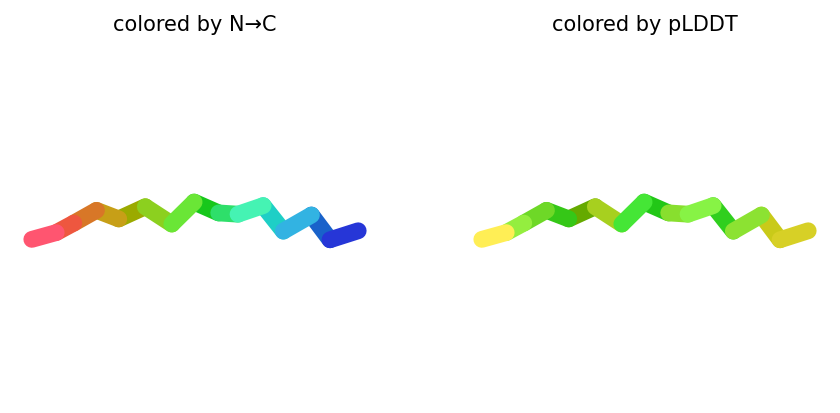

2025-11-17 07:47:45,194 reranking models by 'plddt' metric
2025-11-17 07:47:45,195 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=72.6 pTM=0.0278
2025-11-17 07:47:45,195 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=66 pTM=0.0277
2025-11-17 07:47:45,195 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=65.7 pTM=0.0273
2025-11-17 07:47:45,196 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=64.6 pTM=0.0279
2025-11-17 07:47:45,196 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=59.1 pTM=0.0276
2025-11-17 07:47:47,019 Query 29/146: peptide_78_IC50_323.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:47:47,300 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:11 remaining: 00:00]


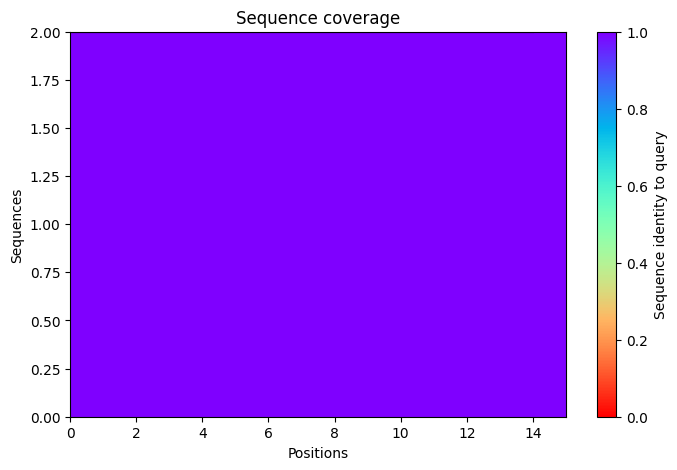

2025-11-17 07:48:03,417 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=58.8 pTM=0.0277
2025-11-17 07:48:05,994 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=60.6 pTM=0.0275 tol=0.836
2025-11-17 07:48:08,569 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=61.8 pTM=0.0276 tol=0.707
2025-11-17 07:48:11,146 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=62.4 pTM=0.0276 tol=0.605
2025-11-17 07:48:11,146 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


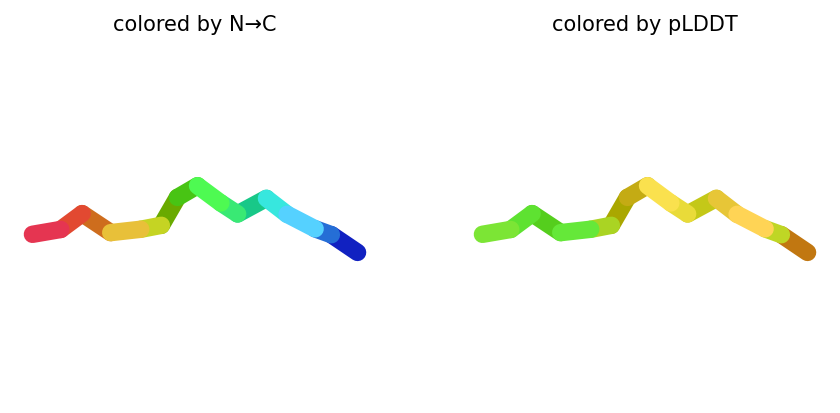

2025-11-17 07:48:13,802 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=59.9 pTM=0.0266
2025-11-17 07:48:16,385 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.5 pTM=0.0263 tol=0.671
2025-11-17 07:48:18,967 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63.4 pTM=0.0263 tol=0.655
2025-11-17 07:48:21,542 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=64.4 pTM=0.0264 tol=0.242
2025-11-17 07:48:21,542 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


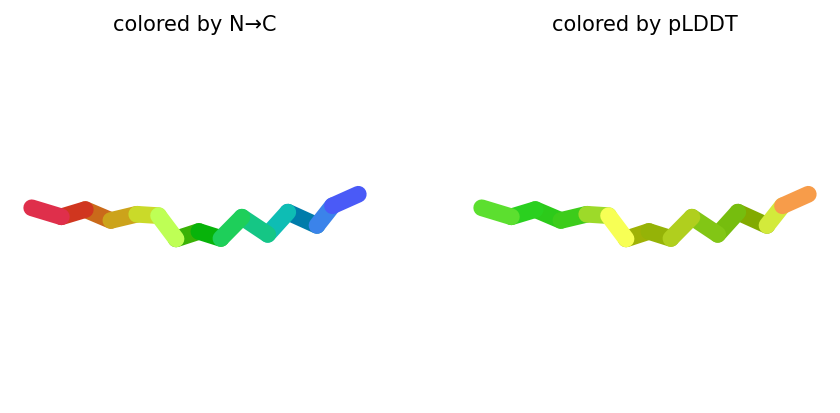

2025-11-17 07:48:24,176 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=63.4 pTM=0.0252
2025-11-17 07:48:26,757 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=63.8 pTM=0.0254 tol=0.633
2025-11-17 07:48:29,347 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.1 pTM=0.0255 tol=0.704
2025-11-17 07:48:31,934 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=63.3 pTM=0.0254 tol=0.493
2025-11-17 07:48:31,935 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


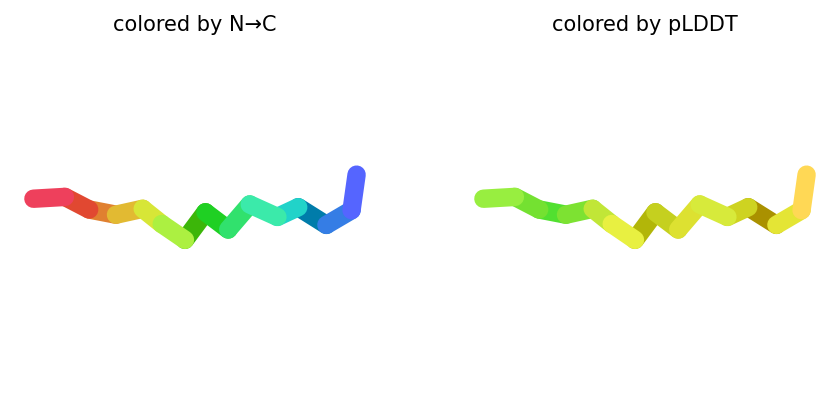

2025-11-17 07:48:34,583 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.5 pTM=0.0264
2025-11-17 07:48:37,172 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=61.4 pTM=0.0269 tol=0.665
2025-11-17 07:48:39,769 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=63.4 pTM=0.0265 tol=0.554
2025-11-17 07:48:42,370 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=61.7 pTM=0.0267 tol=0.314
2025-11-17 07:48:42,371 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


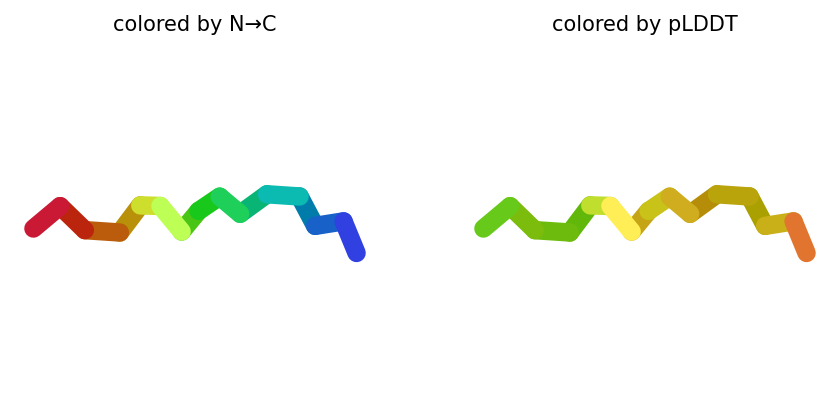

2025-11-17 07:48:45,022 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=60.2 pTM=0.0264
2025-11-17 07:48:47,618 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=59.2 pTM=0.0264 tol=0.997
2025-11-17 07:48:50,212 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63.2 pTM=0.0264 tol=1.43
2025-11-17 07:48:52,803 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=65.2 pTM=0.0265 tol=0.475
2025-11-17 07:48:52,803 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


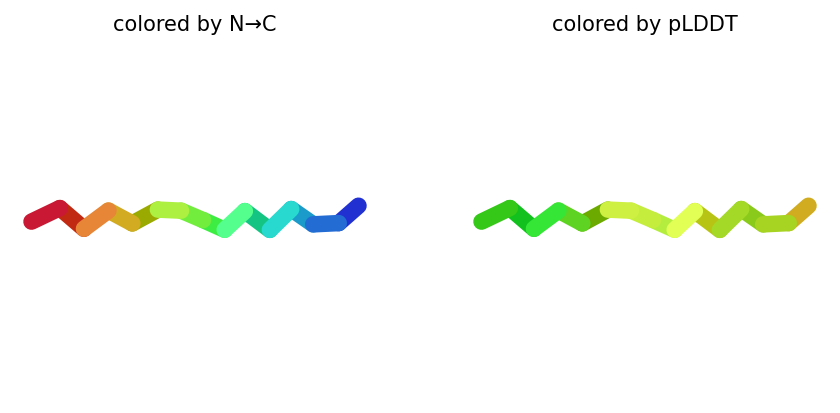

2025-11-17 07:48:52,852 reranking models by 'plddt' metric
2025-11-17 07:48:52,852 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=65.2 pTM=0.0265
2025-11-17 07:48:52,853 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=64.4 pTM=0.0264
2025-11-17 07:48:52,853 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=63.3 pTM=0.0254
2025-11-17 07:48:52,853 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=62.4 pTM=0.0276
2025-11-17 07:48:52,854 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=61.7 pTM=0.0267
2025-11-17 07:48:53,834 Query 30/146: peptide_83_IC50_325.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:48:54,112 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


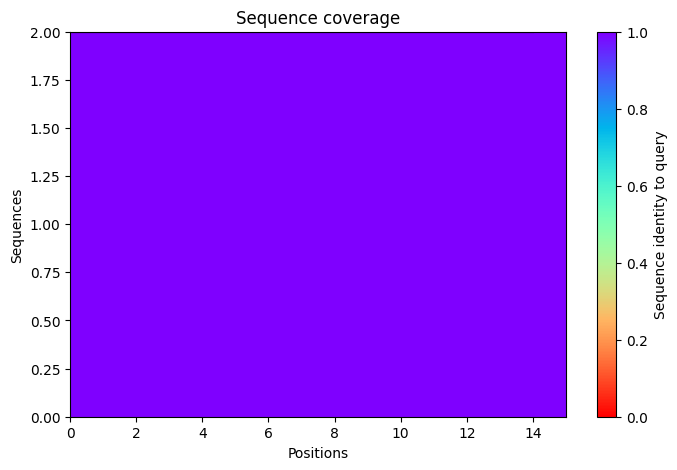

2025-11-17 07:49:08,213 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.8 pTM=0.0288
2025-11-17 07:49:10,792 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.9 pTM=0.0286 tol=0.599
2025-11-17 07:49:13,370 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=69.2 pTM=0.0291 tol=1.74
2025-11-17 07:49:15,944 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=67.4 pTM=0.0286 tol=0.483
2025-11-17 07:49:15,945 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


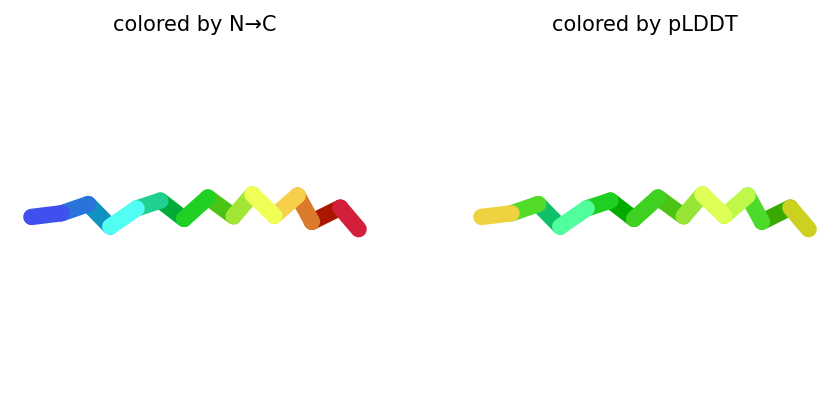

2025-11-17 07:49:18,581 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.3 pTM=0.0282
2025-11-17 07:49:21,167 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.6 pTM=0.0282 tol=0.405
2025-11-17 07:49:23,747 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.3 pTM=0.0285 tol=0.432
2025-11-17 07:49:26,325 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.6 pTM=0.0285 tol=0.24
2025-11-17 07:49:26,326 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


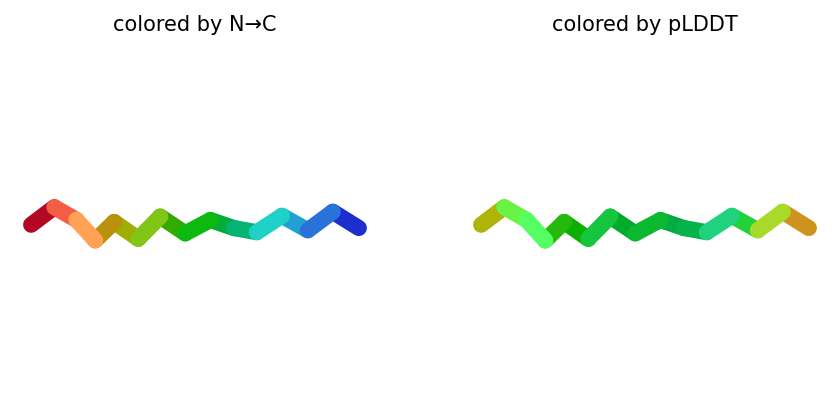

2025-11-17 07:49:28,960 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.1 pTM=0.0294
2025-11-17 07:49:31,543 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.3 pTM=0.0291 tol=0.609
2025-11-17 07:49:34,136 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=73.9 pTM=0.0289 tol=0.223
2025-11-17 07:49:36,723 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.1 pTM=0.0286 tol=0.106
2025-11-17 07:49:36,724 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


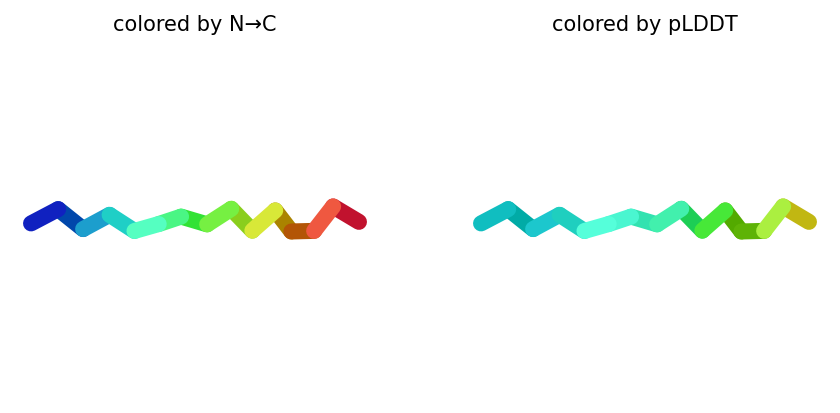

2025-11-17 07:49:39,403 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.1 pTM=0.0286
2025-11-17 07:49:41,995 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=71.8 pTM=0.0287 tol=0.356
2025-11-17 07:49:44,587 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.9 pTM=0.029 tol=0.267
2025-11-17 07:49:47,181 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.4 pTM=0.0288 tol=0.0606
2025-11-17 07:49:47,183 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


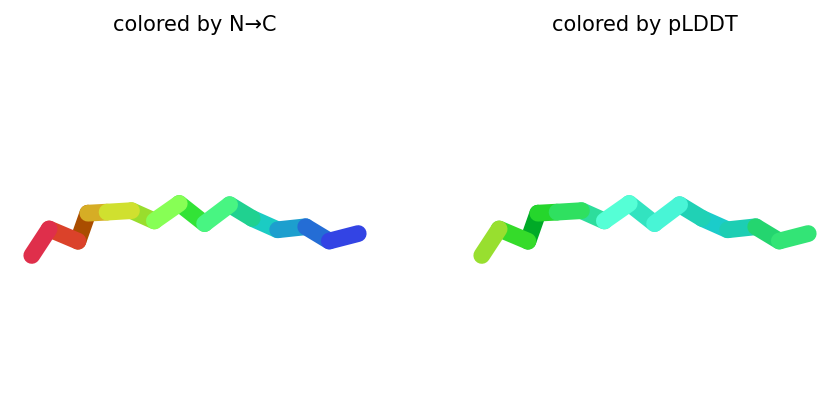

2025-11-17 07:49:49,855 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.2 pTM=0.0274
2025-11-17 07:49:52,440 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67.9 pTM=0.0276 tol=2.33
2025-11-17 07:49:55,024 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=69.6 pTM=0.0285 tol=0.974
2025-11-17 07:49:57,607 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=70.8 pTM=0.0286 tol=0.785
2025-11-17 07:49:57,608 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


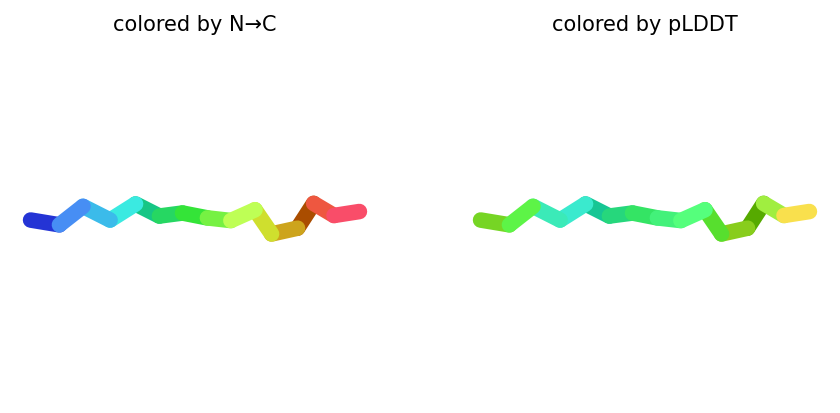

2025-11-17 07:49:57,656 reranking models by 'plddt' metric
2025-11-17 07:49:57,656 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=75.4 pTM=0.0288
2025-11-17 07:49:57,657 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=74.1 pTM=0.0286
2025-11-17 07:49:57,657 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=70.8 pTM=0.0286
2025-11-17 07:49:57,657 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=69.6 pTM=0.0285
2025-11-17 07:49:57,657 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=67.4 pTM=0.0286
2025-11-17 07:49:58,644 Query 31/146: peptide_84_IC50_325.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:49:59,303 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


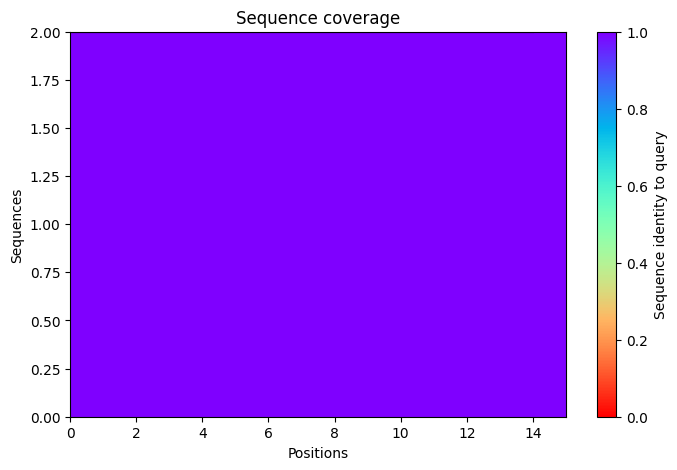

2025-11-17 07:50:11,395 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=64.2 pTM=0.0295
2025-11-17 07:50:13,976 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=63.6 pTM=0.0298 tol=1.29
2025-11-17 07:50:16,550 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=63.9 pTM=0.0299 tol=0.701
2025-11-17 07:50:19,127 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=63.8 pTM=0.0304 tol=0.646
2025-11-17 07:50:19,128 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


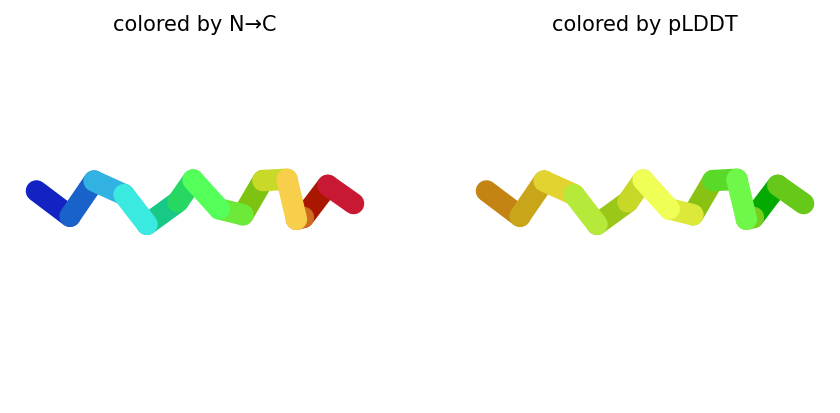

2025-11-17 07:50:21,760 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63 pTM=0.0274
2025-11-17 07:50:24,336 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=65.5 pTM=0.0278 tol=0.504
2025-11-17 07:50:26,916 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=66.9 pTM=0.0278 tol=0.537
2025-11-17 07:50:29,505 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.8 pTM=0.0281 tol=0.386
2025-11-17 07:50:29,505 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


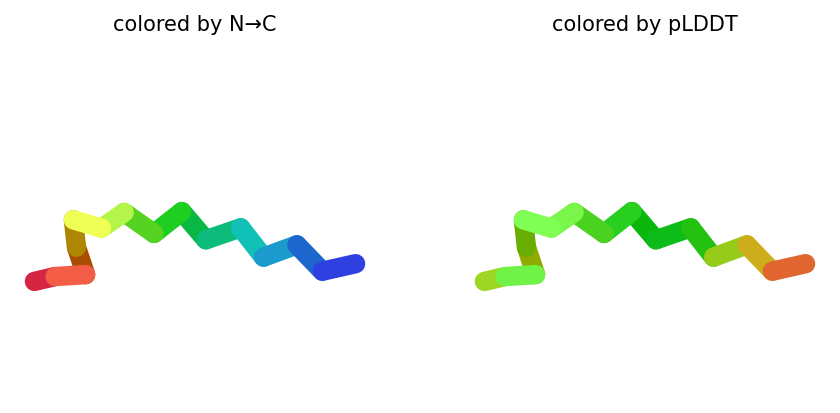

2025-11-17 07:50:32,143 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.1 pTM=0.027
2025-11-17 07:50:34,727 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=71.8 pTM=0.0276 tol=0.779
2025-11-17 07:50:37,323 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.8 pTM=0.028 tol=0.538
2025-11-17 07:50:39,920 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.1 pTM=0.0287 tol=0.277
2025-11-17 07:50:39,920 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


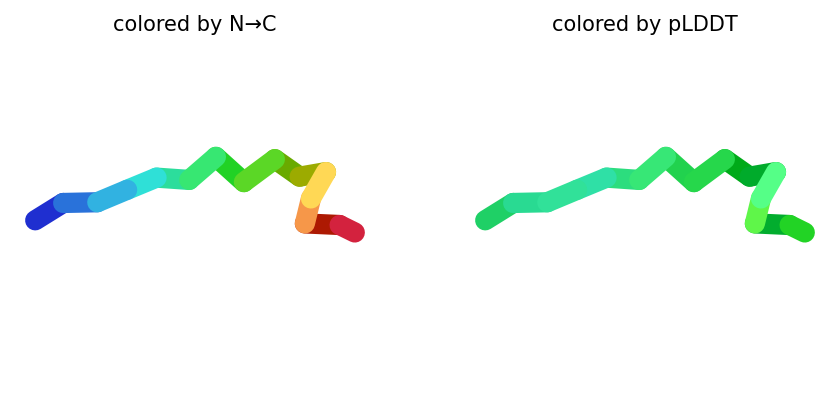

2025-11-17 07:50:42,566 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.9 pTM=0.0298
2025-11-17 07:50:45,162 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.2 pTM=0.0315 tol=0.284
2025-11-17 07:50:47,758 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74 pTM=0.0316 tol=0.416
2025-11-17 07:50:50,352 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.9 pTM=0.032 tol=0.042
2025-11-17 07:50:50,352 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


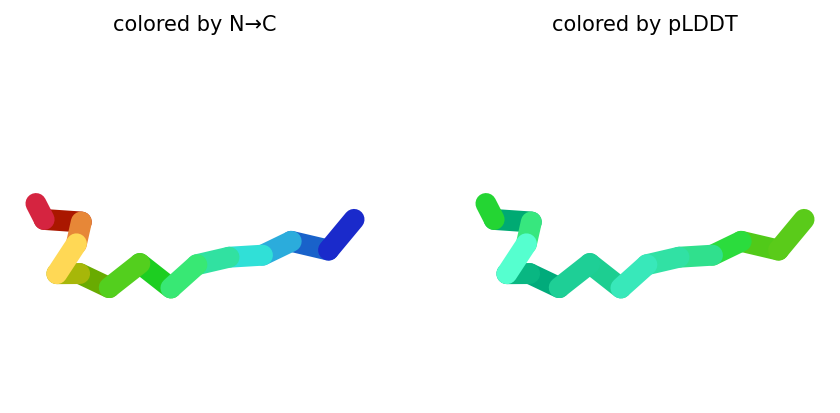

2025-11-17 07:50:52,997 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.3 pTM=0.031
2025-11-17 07:50:55,589 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=66.2 pTM=0.0293 tol=0.452
2025-11-17 07:50:58,180 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.4 pTM=0.0293 tol=0.103
2025-11-17 07:51:00,767 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.9 pTM=0.031 tol=0.361
2025-11-17 07:51:00,768 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


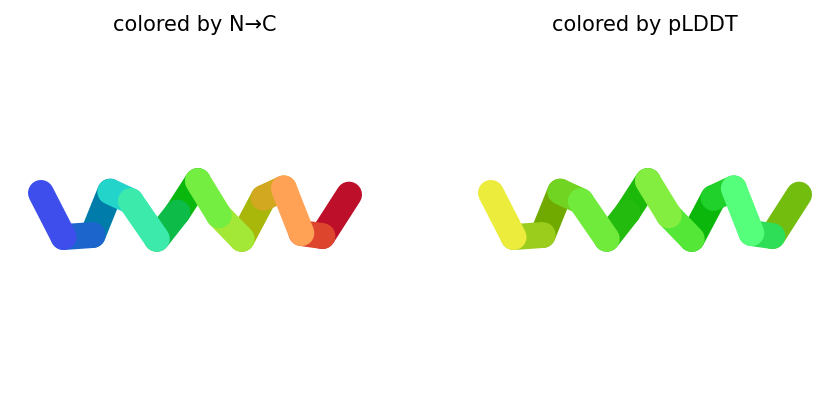

2025-11-17 07:51:00,843 reranking models by 'plddt' metric
2025-11-17 07:51:00,844 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=74.9 pTM=0.032
2025-11-17 07:51:00,844 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=74.1 pTM=0.0287
2025-11-17 07:51:00,844 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=67.9 pTM=0.031
2025-11-17 07:51:00,844 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=65.8 pTM=0.0281
2025-11-17 07:51:00,845 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=63.8 pTM=0.0304
2025-11-17 07:51:02,588 Query 32/146: peptide_86_IC50_333.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:51:02,870 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


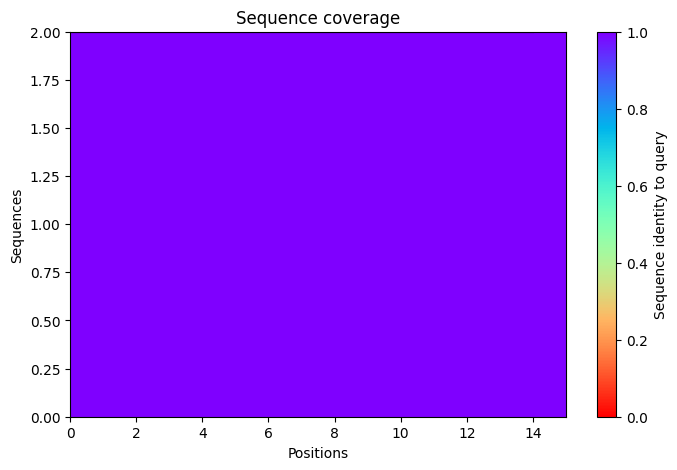

2025-11-17 07:51:13,949 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.2 pTM=0.0288
2025-11-17 07:51:16,525 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=66.2 pTM=0.0287 tol=0.484
2025-11-17 07:51:19,106 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=62.1 pTM=0.0275 tol=0.293
2025-11-17 07:51:21,683 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=61 pTM=0.0274 tol=0.628
2025-11-17 07:51:21,683 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


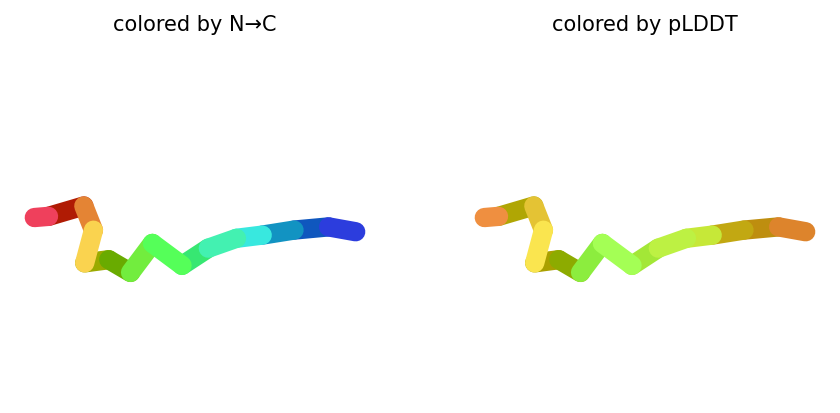

2025-11-17 07:51:24,319 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.2 pTM=0.0271
2025-11-17 07:51:26,898 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63.8 pTM=0.0278 tol=1.64
2025-11-17 07:51:29,479 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.8 pTM=0.0277 tol=0.298
2025-11-17 07:51:32,060 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.2 pTM=0.0272 tol=0.159
2025-11-17 07:51:32,061 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


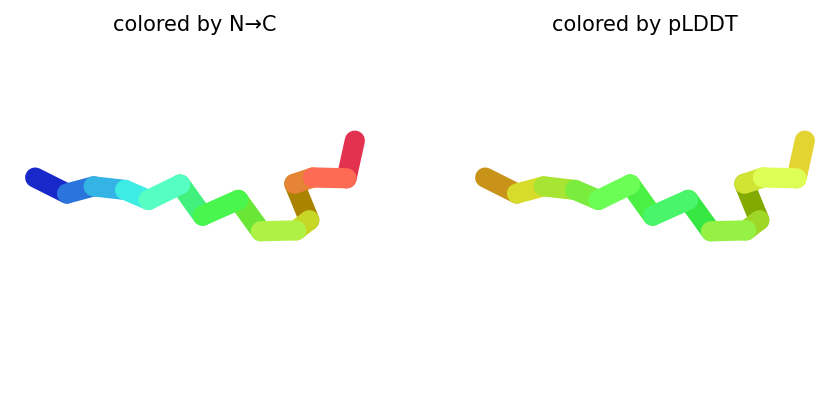

2025-11-17 07:51:34,697 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.6 pTM=0.0256
2025-11-17 07:51:37,278 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.4 pTM=0.027 tol=0.697
2025-11-17 07:51:39,872 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=75.7 pTM=0.0287 tol=0.199
2025-11-17 07:51:42,458 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77 pTM=0.0291 tol=0.117
2025-11-17 07:51:42,459 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


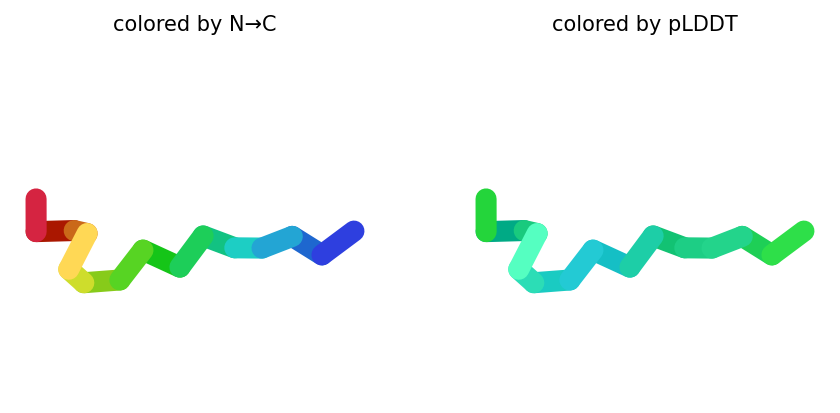

2025-11-17 07:51:45,110 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.7 pTM=0.029
2025-11-17 07:51:47,706 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=67.5 pTM=0.0294 tol=0.351
2025-11-17 07:51:50,299 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=67.4 pTM=0.0294 tol=0.244
2025-11-17 07:51:52,895 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=64.7 pTM=0.0286 tol=0.661
2025-11-17 07:51:52,896 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


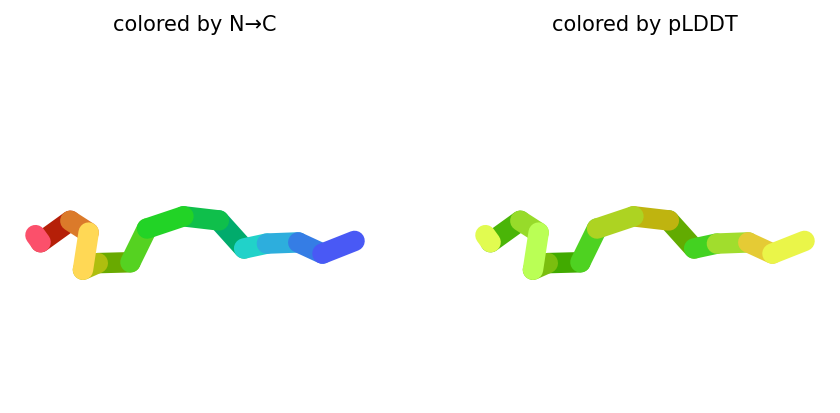

2025-11-17 07:51:55,541 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=63 pTM=0.0269
2025-11-17 07:51:58,131 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67.1 pTM=0.0273 tol=0.657
2025-11-17 07:52:00,719 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.9 pTM=0.0273 tol=0.1
2025-11-17 07:52:03,310 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63.7 pTM=0.0266 tol=0.539
2025-11-17 07:52:03,310 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


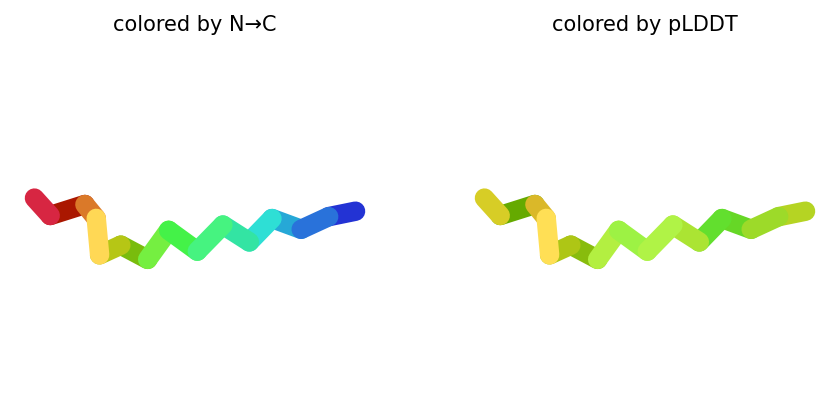

2025-11-17 07:52:03,360 reranking models by 'plddt' metric
2025-11-17 07:52:03,361 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=77 pTM=0.0291
2025-11-17 07:52:03,361 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=65.2 pTM=0.0272
2025-11-17 07:52:03,361 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=64.7 pTM=0.0286
2025-11-17 07:52:03,362 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=63.7 pTM=0.0266
2025-11-17 07:52:03,362 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=61 pTM=0.0274
2025-11-17 07:52:04,347 Query 33/146: peptide_87_IC50_342.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:52:04,639 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


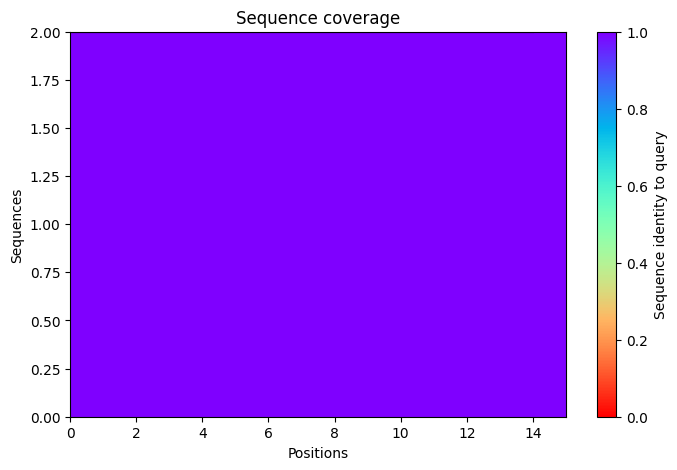

2025-11-17 07:52:17,076 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=74.2 pTM=0.029
2025-11-17 07:52:19,651 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72.7 pTM=0.0288 tol=0.317
2025-11-17 07:52:22,224 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=70.6 pTM=0.0287 tol=0.545
2025-11-17 07:52:24,799 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.1 pTM=0.0288 tol=0.492
2025-11-17 07:52:24,800 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


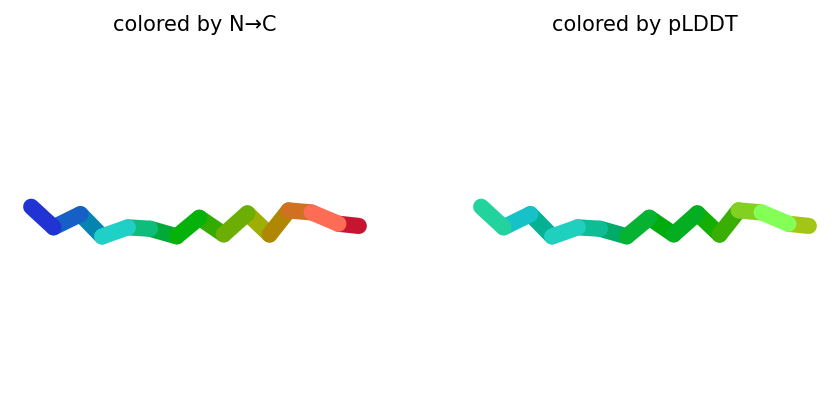

2025-11-17 07:52:27,428 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.8 pTM=0.0282
2025-11-17 07:52:30,008 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.8 pTM=0.0285 tol=0.467
2025-11-17 07:52:32,585 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.7 pTM=0.0284 tol=0.542
2025-11-17 07:52:35,161 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.9 pTM=0.0284 tol=0.0869
2025-11-17 07:52:35,162 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


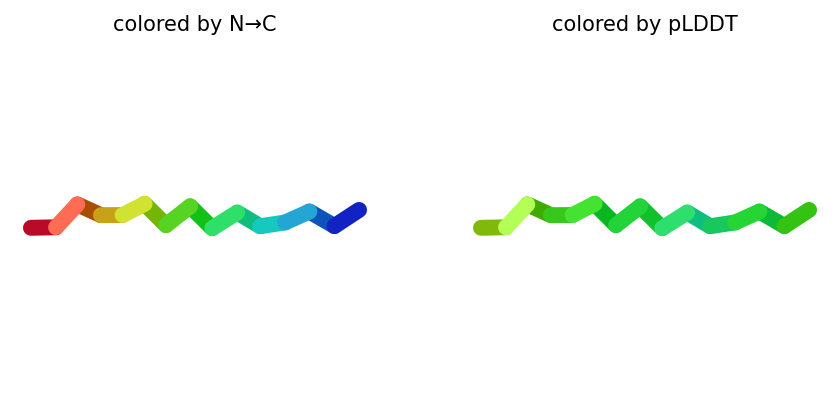

2025-11-17 07:52:37,797 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.5 pTM=0.0277
2025-11-17 07:52:40,385 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.2 pTM=0.0275 tol=0.292
2025-11-17 07:52:42,978 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=75.1 pTM=0.0279 tol=0.604
2025-11-17 07:52:45,574 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.1 pTM=0.0277 tol=0.382
2025-11-17 07:52:45,575 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


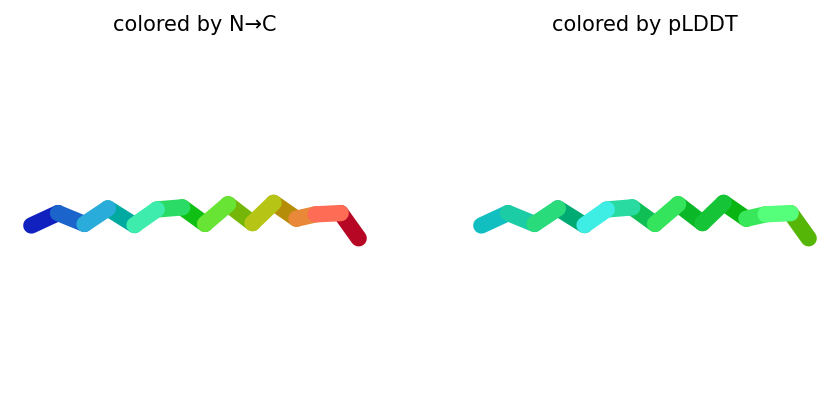

2025-11-17 07:52:48,224 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.4 pTM=0.0286
2025-11-17 07:52:50,821 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75.2 pTM=0.0286 tol=0.146
2025-11-17 07:52:53,416 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.8 pTM=0.0287 tol=0.535
2025-11-17 07:52:56,009 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.1 pTM=0.0289 tol=0.511
2025-11-17 07:52:56,010 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


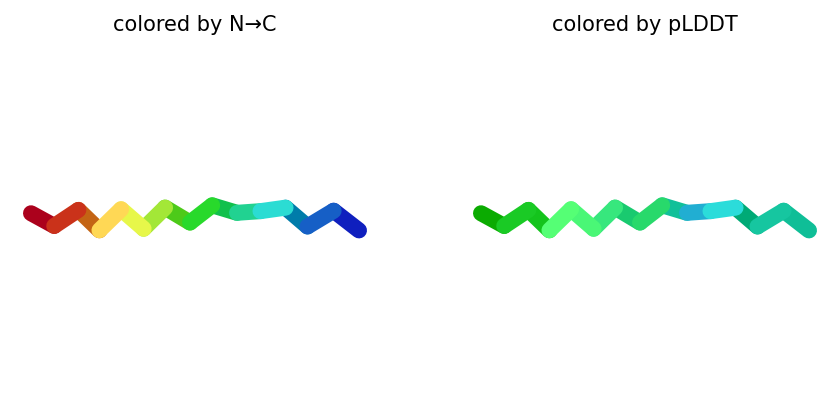

2025-11-17 07:52:58,649 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69.4 pTM=0.0276
2025-11-17 07:53:01,238 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=72.9 pTM=0.0278 tol=0.344
2025-11-17 07:53:03,827 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.8 pTM=0.0277 tol=0.307
2025-11-17 07:53:06,419 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=73.6 pTM=0.0277 tol=0.166
2025-11-17 07:53:06,419 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


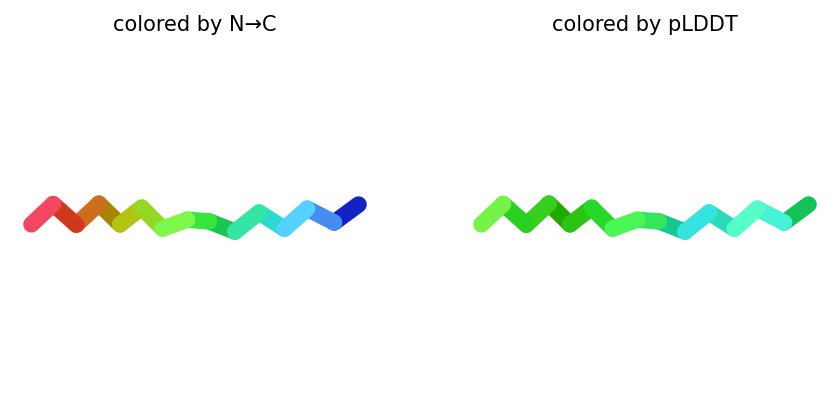

2025-11-17 07:53:06,468 reranking models by 'plddt' metric
2025-11-17 07:53:06,469 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=76.1 pTM=0.0289
2025-11-17 07:53:06,470 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=75.1 pTM=0.0277
2025-11-17 07:53:06,470 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=73.6 pTM=0.0277
2025-11-17 07:53:06,470 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73.1 pTM=0.0288
2025-11-17 07:53:06,471 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=70.9 pTM=0.0284
2025-11-17 07:53:07,473 Query 34/146: peptide_88_IC50_340.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:53:07,753 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


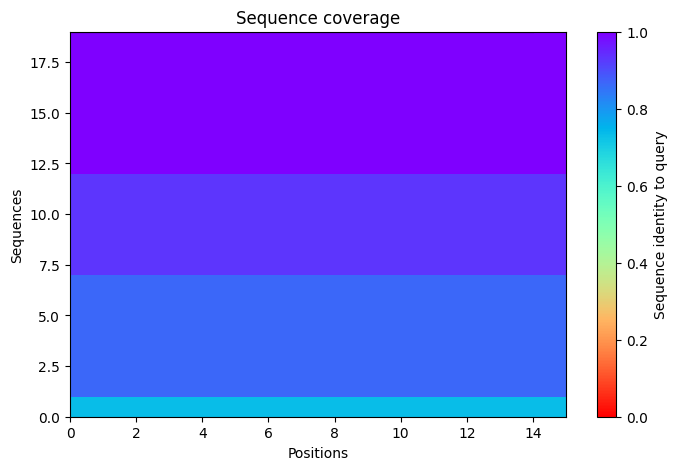

2025-11-17 07:53:20,796 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=64.8 pTM=0.0284
2025-11-17 07:53:23,372 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=69.2 pTM=0.0286 tol=1.06
2025-11-17 07:53:25,948 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.3 pTM=0.029 tol=0.56
2025-11-17 07:53:28,524 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.2 pTM=0.0291 tol=0.405
2025-11-17 07:53:28,524 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


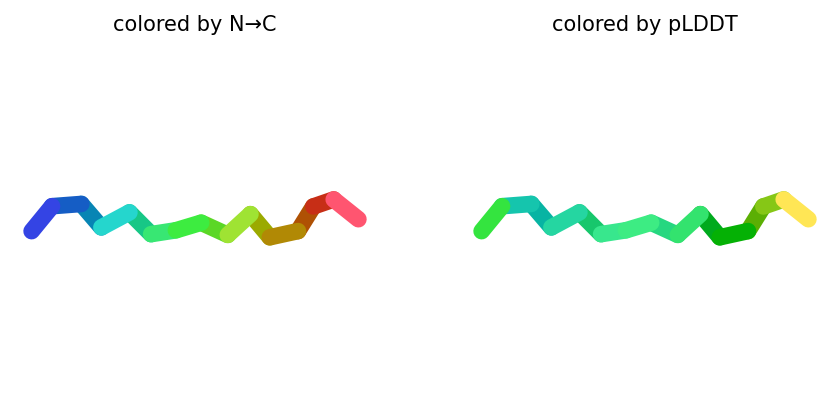

2025-11-17 07:53:31,154 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.5 pTM=0.0288
2025-11-17 07:53:33,729 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.6 pTM=0.028 tol=0.8
2025-11-17 07:53:36,311 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.8 pTM=0.0276 tol=0.427
2025-11-17 07:53:38,903 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60.9 pTM=0.0275 tol=0.39
2025-11-17 07:53:38,904 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


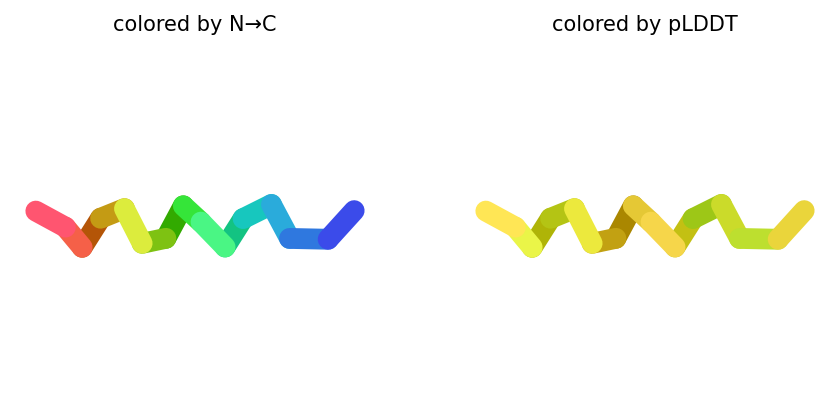

2025-11-17 07:53:41,572 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.7 pTM=0.0272
2025-11-17 07:53:44,160 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.7 pTM=0.0287 tol=0.311
2025-11-17 07:53:46,759 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.2 pTM=0.0287 tol=0.543
2025-11-17 07:53:49,361 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.9 pTM=0.0285 tol=0.513
2025-11-17 07:53:49,361 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


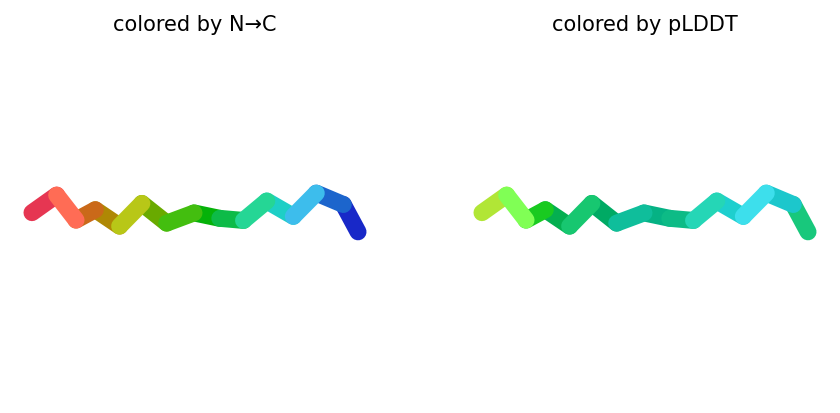

2025-11-17 07:53:52,012 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=67.4 pTM=0.0276
2025-11-17 07:53:54,610 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=68.2 pTM=0.0271 tol=0.523
2025-11-17 07:53:57,206 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.8 pTM=0.0271 tol=0.201
2025-11-17 07:53:59,798 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=66.9 pTM=0.0273 tol=0.391
2025-11-17 07:53:59,799 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


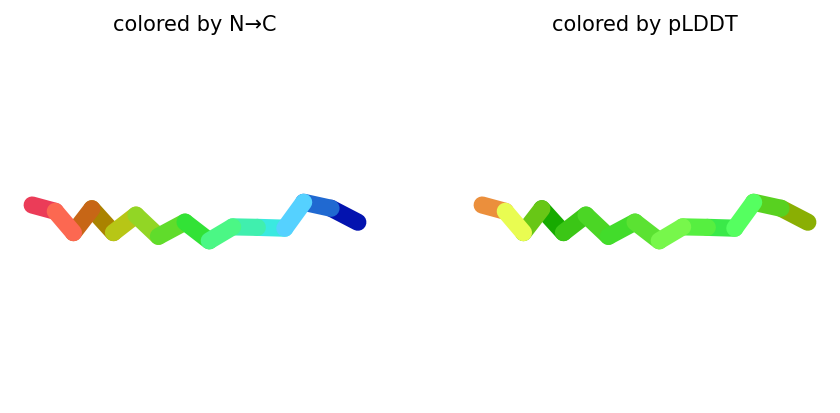

2025-11-17 07:54:02,444 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=64.9 pTM=0.0288
2025-11-17 07:54:05,037 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.1 pTM=0.028 tol=1.64
2025-11-17 07:54:07,627 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=62.6 pTM=0.0276 tol=1.1
2025-11-17 07:54:10,217 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63 pTM=0.0277 tol=1.42
2025-11-17 07:54:10,218 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


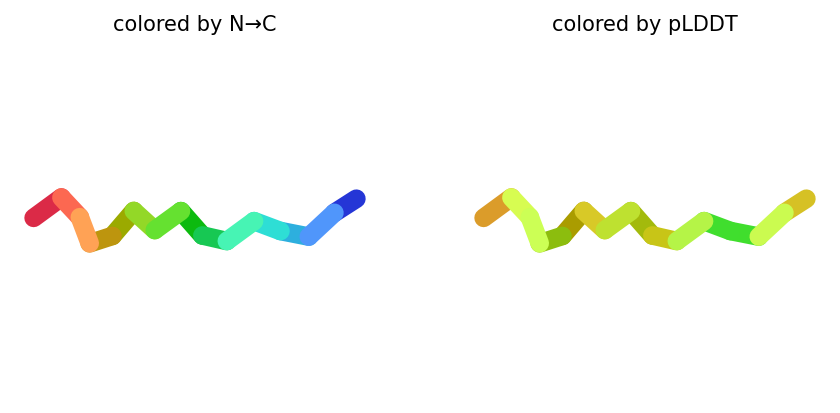

2025-11-17 07:54:10,267 reranking models by 'plddt' metric
2025-11-17 07:54:10,267 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=75.9 pTM=0.0285
2025-11-17 07:54:10,268 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=72.2 pTM=0.0291
2025-11-17 07:54:10,268 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=66.9 pTM=0.0273
2025-11-17 07:54:10,268 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=63 pTM=0.0277
2025-11-17 07:54:10,269 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60.9 pTM=0.0275
2025-11-17 07:54:11,691 Query 35/146: peptide_89_IC50_341.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:54:11,958 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


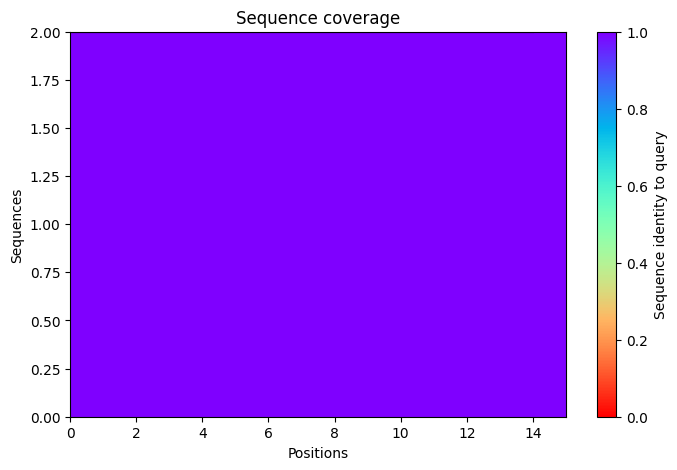

2025-11-17 07:54:22,019 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=82.7 pTM=0.0417
2025-11-17 07:54:24,589 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81 pTM=0.0408 tol=0.257
2025-11-17 07:54:27,158 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79.2 pTM=0.0397 tol=0.139
2025-11-17 07:54:29,732 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=80.4 pTM=0.0404 tol=0.056
2025-11-17 07:54:29,732 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


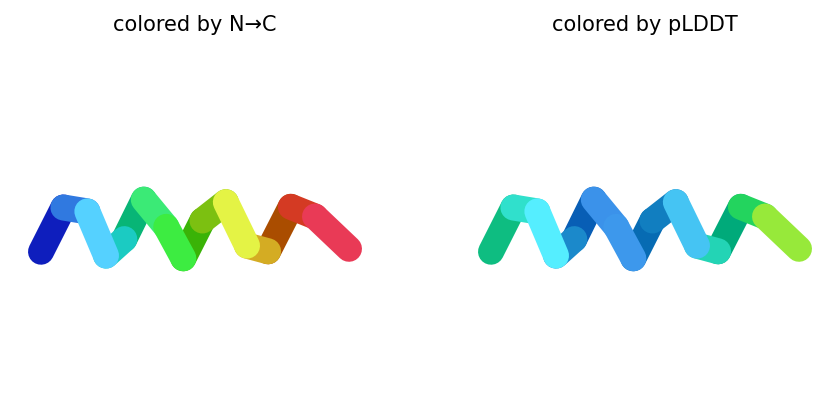

2025-11-17 07:54:32,370 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=74.2 pTM=0.0397
2025-11-17 07:54:34,947 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.6 pTM=0.0363 tol=0.382
2025-11-17 07:54:37,530 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=66.2 pTM=0.0343 tol=0.517
2025-11-17 07:54:40,112 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.9 pTM=0.0361 tol=0.291
2025-11-17 07:54:40,113 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


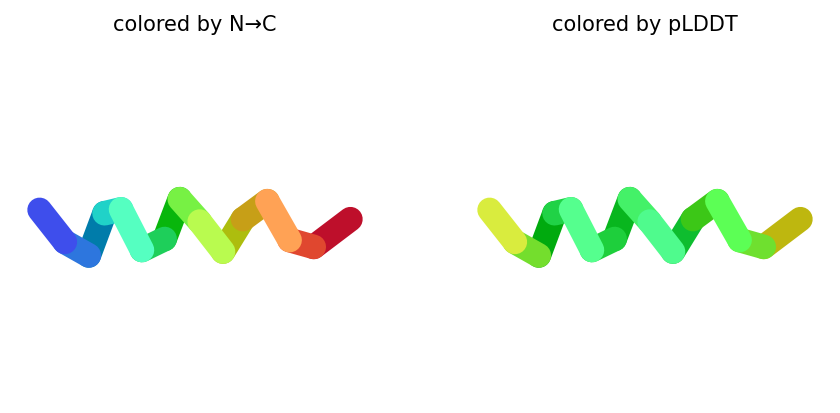

2025-11-17 07:54:42,749 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=77.9 pTM=0.034
2025-11-17 07:54:45,338 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=80.3 pTM=0.0353 tol=0.0789
2025-11-17 07:54:47,921 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=79.1 pTM=0.0334 tol=0.262
2025-11-17 07:54:50,516 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=82.8 pTM=0.0365 tol=0.25
2025-11-17 07:54:50,517 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


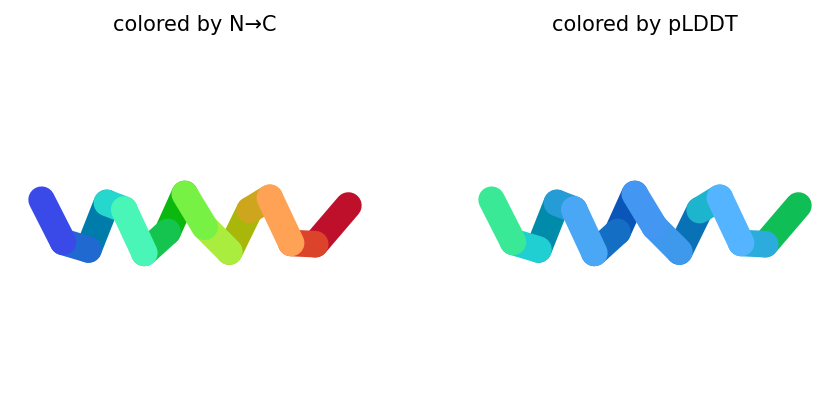

2025-11-17 07:54:53,188 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=77.1 pTM=0.0372
2025-11-17 07:54:55,778 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=82.1 pTM=0.0405 tol=0.229
2025-11-17 07:54:58,367 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80.6 pTM=0.0396 tol=0.0955
2025-11-17 07:55:00,956 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=84.6 pTM=0.0421 tol=0.168
2025-11-17 07:55:00,957 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


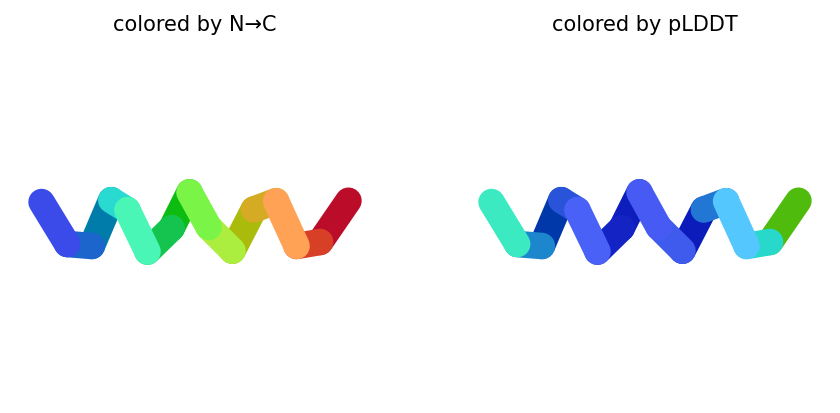

2025-11-17 07:55:03,602 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=84.9 pTM=0.0423
2025-11-17 07:55:06,192 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=85.2 pTM=0.0423 tol=0.113
2025-11-17 07:55:08,779 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=83.7 pTM=0.0414 tol=0.12
2025-11-17 07:55:11,367 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=84.6 pTM=0.0415 tol=0.0635
2025-11-17 07:55:11,368 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


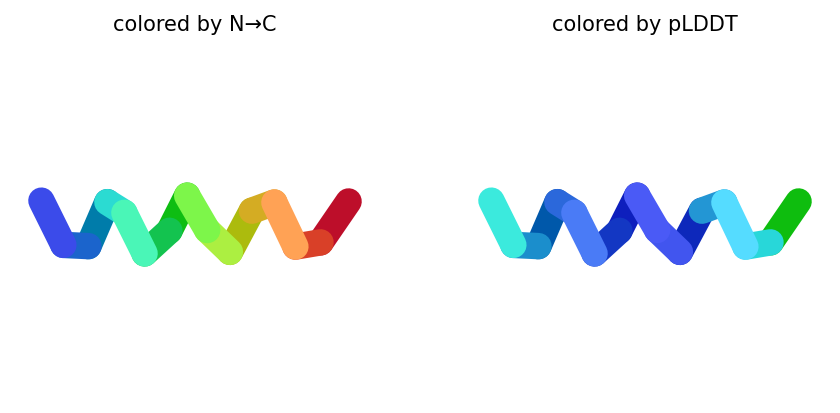

2025-11-17 07:55:11,419 reranking models by 'plddt' metric
2025-11-17 07:55:11,420 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=84.6 pTM=0.0421
2025-11-17 07:55:11,420 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=84.6 pTM=0.0415
2025-11-17 07:55:11,420 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=82.8 pTM=0.0365
2025-11-17 07:55:11,421 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=80.4 pTM=0.0404
2025-11-17 07:55:11,421 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=69.9 pTM=0.0361
2025-11-17 07:55:12,417 Query 36/146: peptide_91_IC50_344.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:55:13,067 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


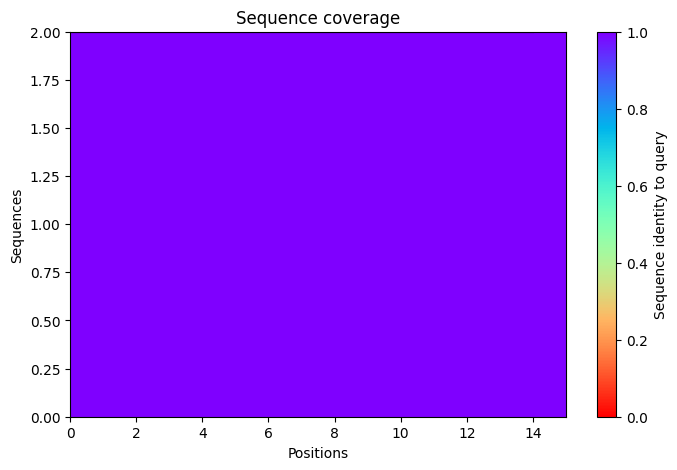

2025-11-17 07:55:25,115 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=64.2 pTM=0.0281
2025-11-17 07:55:27,686 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=66.1 pTM=0.0282 tol=1.85
2025-11-17 07:55:30,259 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=65.9 pTM=0.0284 tol=1.44
2025-11-17 07:55:32,833 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.3 pTM=0.0288 tol=0.463
2025-11-17 07:55:32,834 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


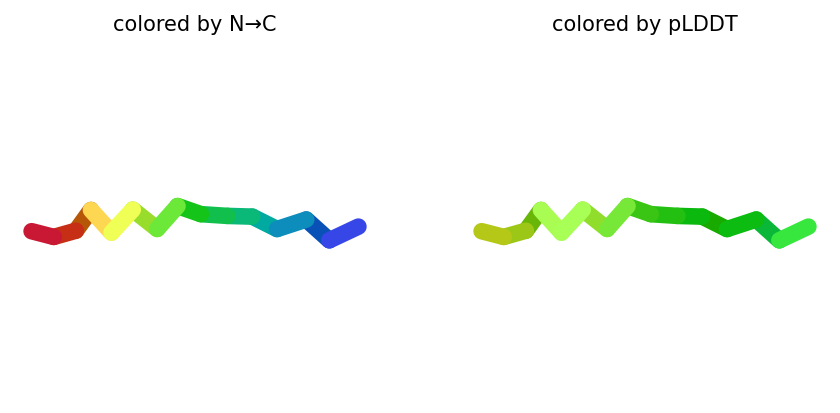

2025-11-17 07:55:35,469 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.6 pTM=0.027
2025-11-17 07:55:38,049 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.1 pTM=0.0283 tol=1.9
2025-11-17 07:55:40,635 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.4 pTM=0.0286 tol=0.395
2025-11-17 07:55:43,215 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71 pTM=0.0286 tol=0.465
2025-11-17 07:55:43,215 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


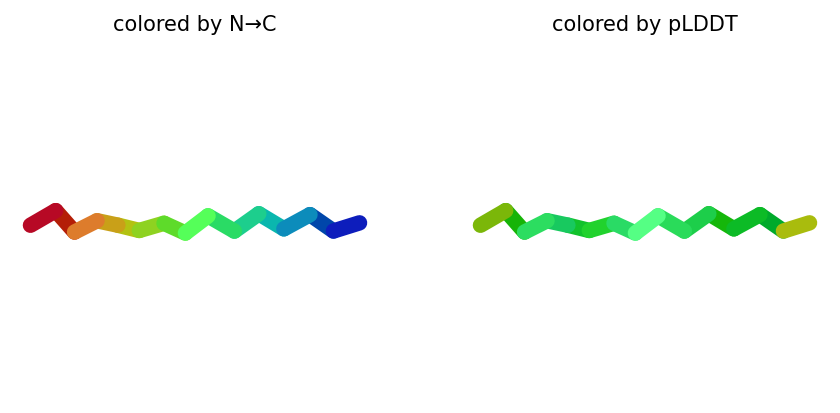

2025-11-17 07:55:45,868 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=72.3 pTM=0.0281
2025-11-17 07:55:48,459 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.3 pTM=0.0282 tol=0.998
2025-11-17 07:55:51,054 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.6 pTM=0.0285 tol=0.379
2025-11-17 07:55:53,656 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.9 pTM=0.0289 tol=0.218
2025-11-17 07:55:53,657 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


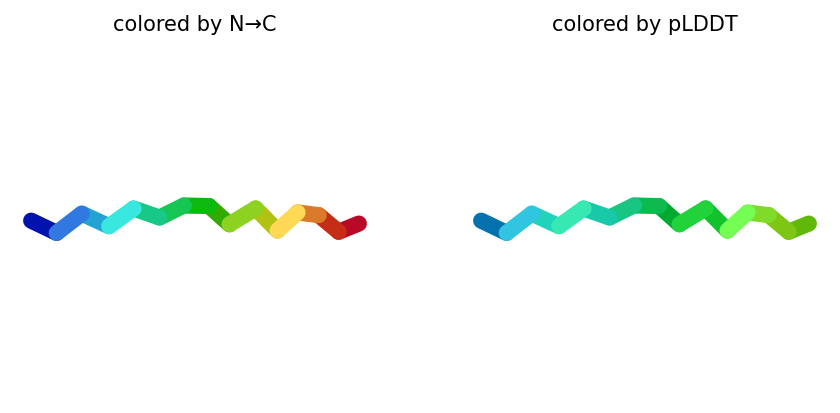

2025-11-17 07:55:56,303 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=71.9 pTM=0.0281
2025-11-17 07:55:58,899 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.9 pTM=0.0282 tol=0.526
2025-11-17 07:56:01,494 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=73.6 pTM=0.0278 tol=0.233
2025-11-17 07:56:04,085 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.5 pTM=0.0281 tol=0.144
2025-11-17 07:56:04,086 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


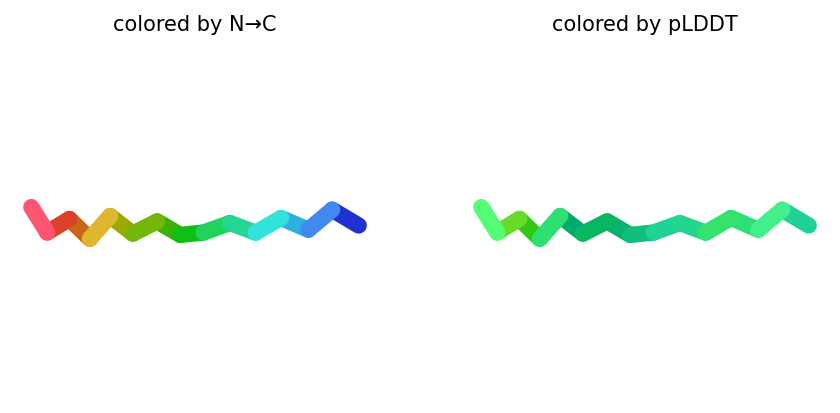

2025-11-17 07:56:06,724 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=77.4 pTM=0.0354
2025-11-17 07:56:09,311 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=78.8 pTM=0.0367 tol=0.159
2025-11-17 07:56:11,899 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=79.3 pTM=0.0364 tol=0.0438
2025-11-17 07:56:14,487 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=81.1 pTM=0.0385 tol=0.0491
2025-11-17 07:56:14,487 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


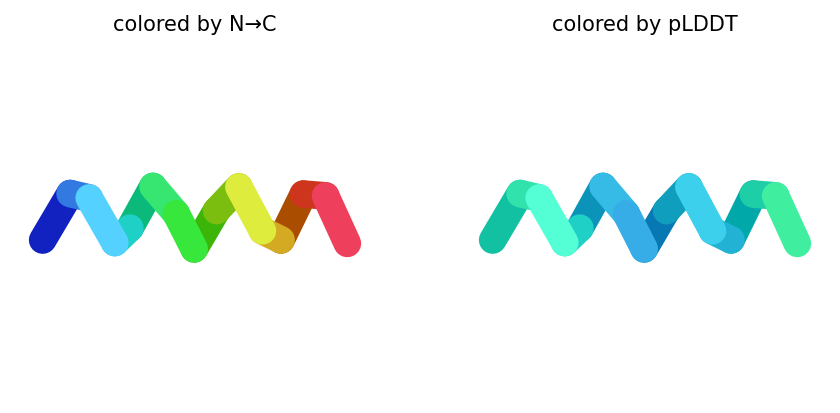

2025-11-17 07:56:14,562 reranking models by 'plddt' metric
2025-11-17 07:56:14,564 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=81.1 pTM=0.0385
2025-11-17 07:56:14,564 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=75.5 pTM=0.0281
2025-11-17 07:56:14,565 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=74.9 pTM=0.0289
2025-11-17 07:56:14,565 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=71 pTM=0.0286
2025-11-17 07:56:14,565 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=68.3 pTM=0.0288
2025-11-17 07:56:15,954 Query 37/146: peptide_92_IC50_341.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:56:16,241 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


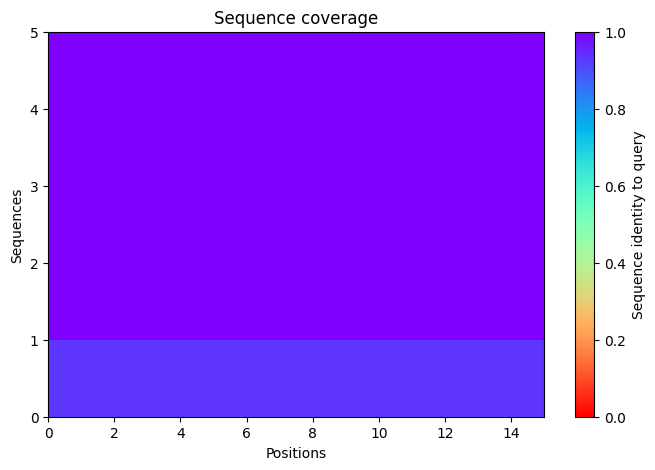

2025-11-17 07:56:26,272 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.8 pTM=0.0338
2025-11-17 07:56:28,852 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.2 pTM=0.0357 tol=0.244
2025-11-17 07:56:31,428 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.6 pTM=0.0365 tol=0.0888
2025-11-17 07:56:34,009 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=71.2 pTM=0.0357 tol=0.176
2025-11-17 07:56:34,010 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


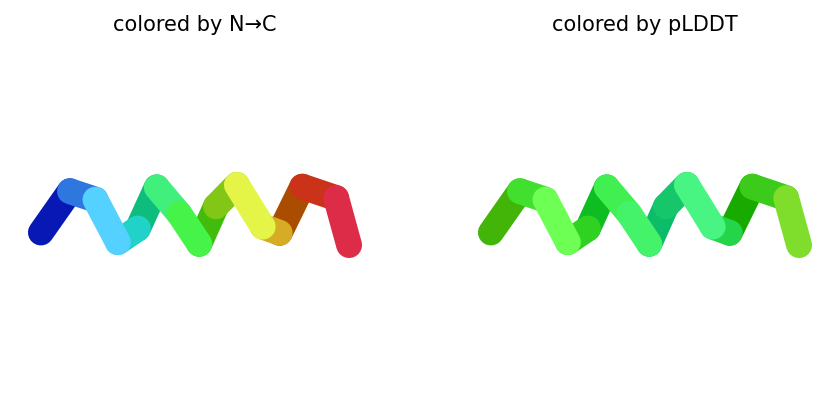

2025-11-17 07:56:36,647 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.5 pTM=0.0306
2025-11-17 07:56:39,227 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.8 pTM=0.029 tol=0.695
2025-11-17 07:56:41,813 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.4 pTM=0.029 tol=0.231
2025-11-17 07:56:44,395 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60 pTM=0.0283 tol=0.479
2025-11-17 07:56:44,396 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


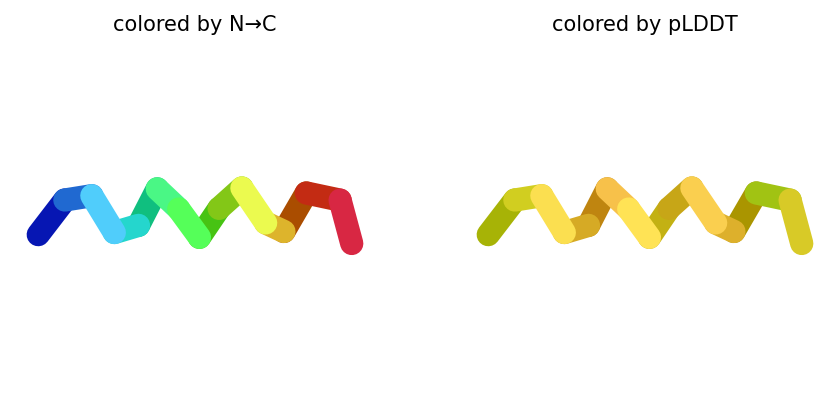

2025-11-17 07:56:47,032 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=63.3 pTM=0.0265
2025-11-17 07:56:49,622 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=62.1 pTM=0.0261 tol=0.479
2025-11-17 07:56:52,214 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=62 pTM=0.0264 tol=0.418
2025-11-17 07:56:54,809 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=62.1 pTM=0.0264 tol=0.38
2025-11-17 07:56:54,810 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


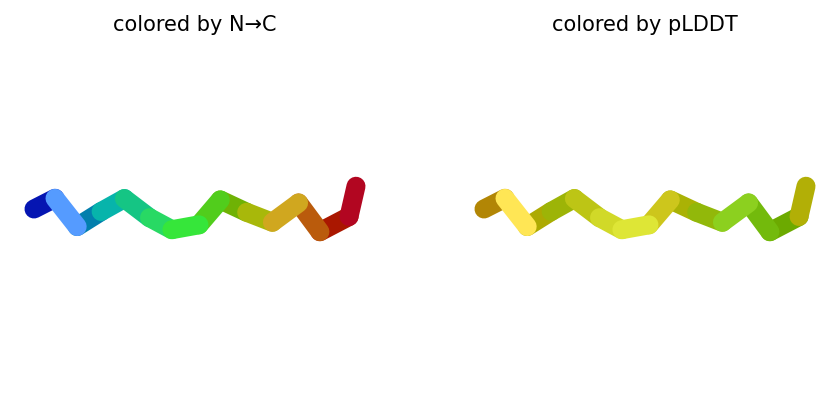

2025-11-17 07:56:57,454 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=59.8 pTM=0.0267
2025-11-17 07:57:00,045 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.5 pTM=0.0269 tol=0.735
2025-11-17 07:57:02,635 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=63.7 pTM=0.0268 tol=0.311
2025-11-17 07:57:05,228 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=64 pTM=0.027 tol=0.373
2025-11-17 07:57:05,229 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


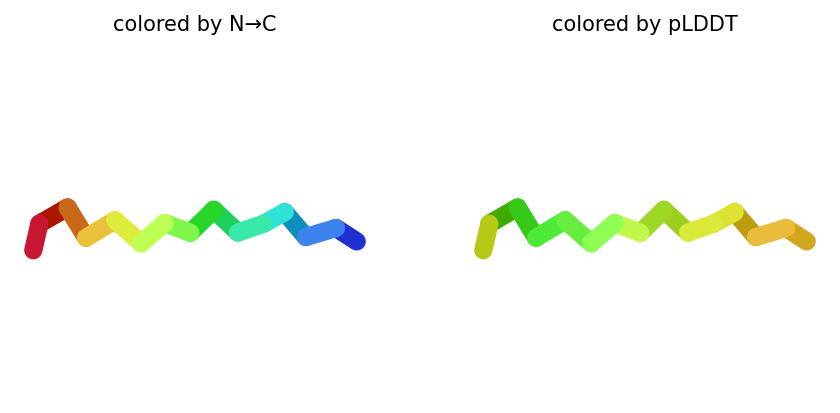

2025-11-17 07:57:07,866 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.7 pTM=0.0388
2025-11-17 07:57:10,457 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.2 pTM=0.0357 tol=0.177
2025-11-17 07:57:13,043 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.2 pTM=0.0327 tol=0.593
2025-11-17 07:57:15,631 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.4 pTM=0.0313 tol=0.474
2025-11-17 07:57:15,631 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


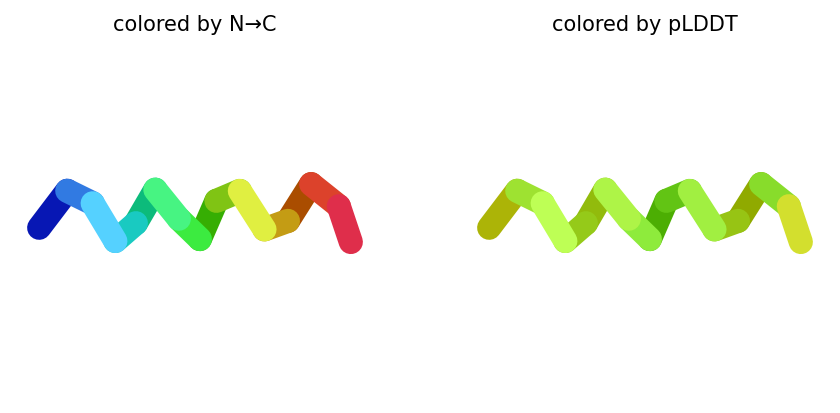

2025-11-17 07:57:15,710 reranking models by 'plddt' metric
2025-11-17 07:57:15,711 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=71.2 pTM=0.0357
2025-11-17 07:57:15,711 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=64.4 pTM=0.0313
2025-11-17 07:57:15,711 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=64 pTM=0.027
2025-11-17 07:57:15,711 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=62.1 pTM=0.0264
2025-11-17 07:57:15,711 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60 pTM=0.0283
2025-11-17 07:57:17,637 Query 38/146: peptide_95_IC50_344.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:57:17,932 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


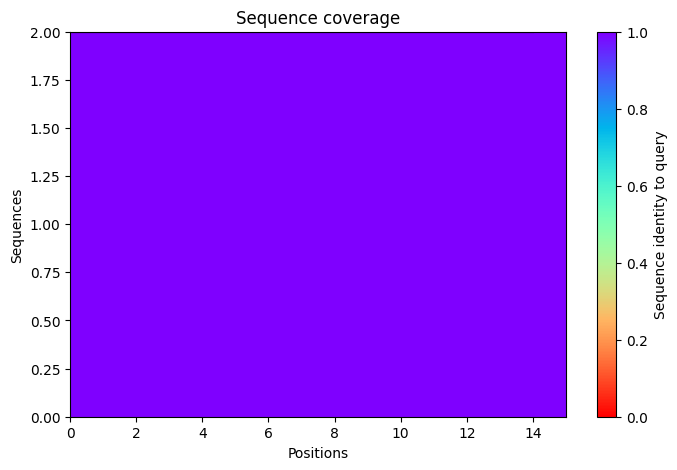

2025-11-17 07:57:33,387 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=73.6 pTM=0.0352
2025-11-17 07:57:35,958 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72.6 pTM=0.0347 tol=0.103
2025-11-17 07:57:38,531 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=76.4 pTM=0.0378 tol=0.252
2025-11-17 07:57:41,112 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.9 pTM=0.0365 tol=0.115
2025-11-17 07:57:41,112 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


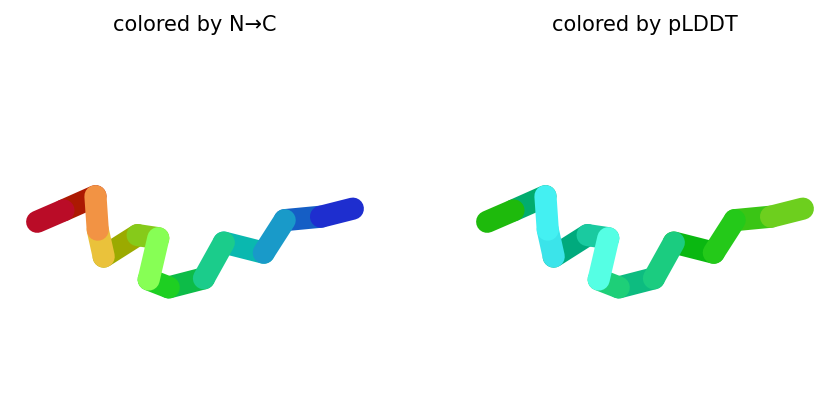

2025-11-17 07:57:43,766 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70.6 pTM=0.0339
2025-11-17 07:57:46,344 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70 pTM=0.0344 tol=0.0629
2025-11-17 07:57:48,929 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.8 pTM=0.0364 tol=0.15
2025-11-17 07:57:51,507 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.6 pTM=0.0343 tol=0.113
2025-11-17 07:57:51,508 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


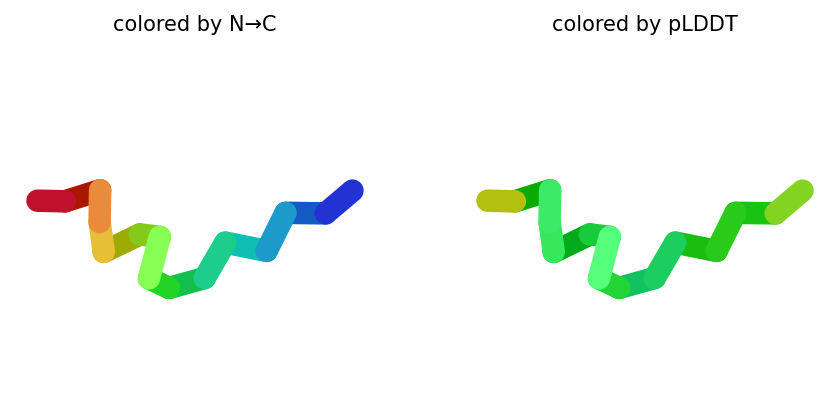

2025-11-17 07:57:54,147 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.9 pTM=0.0285
2025-11-17 07:57:56,738 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.6 pTM=0.0284 tol=0.39
2025-11-17 07:57:59,330 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.8 pTM=0.0292 tol=0.293
2025-11-17 07:58:01,928 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=73.1 pTM=0.029 tol=0.143
2025-11-17 07:58:01,929 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


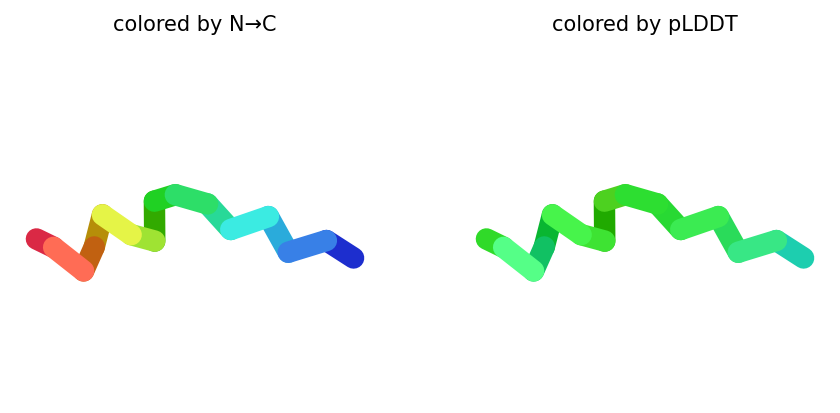

2025-11-17 07:58:04,586 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.6 pTM=0.0349
2025-11-17 07:58:07,185 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=78.2 pTM=0.035 tol=0.101
2025-11-17 07:58:09,779 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.5 pTM=0.0351 tol=0.0786
2025-11-17 07:58:12,376 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.5 pTM=0.0354 tol=0.0807
2025-11-17 07:58:12,376 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


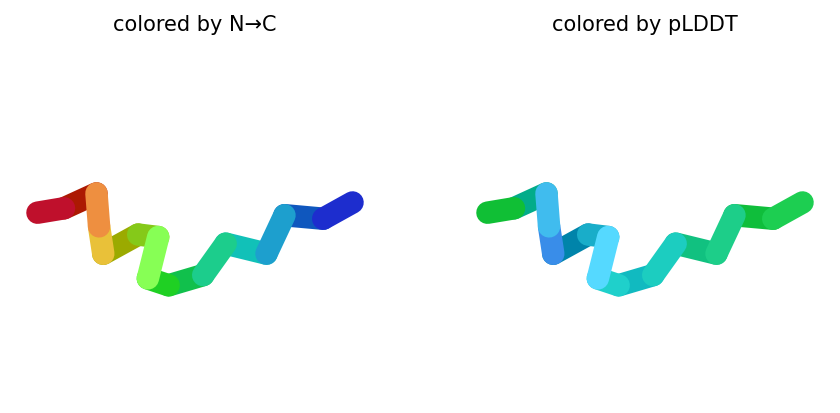

2025-11-17 07:58:15,023 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=71.5 pTM=0.0299
2025-11-17 07:58:17,620 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=66.6 pTM=0.0277 tol=1.13
2025-11-17 07:58:20,213 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.4 pTM=0.0271 tol=0.617
2025-11-17 07:58:22,800 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.2 pTM=0.0277 tol=0.335
2025-11-17 07:58:22,801 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


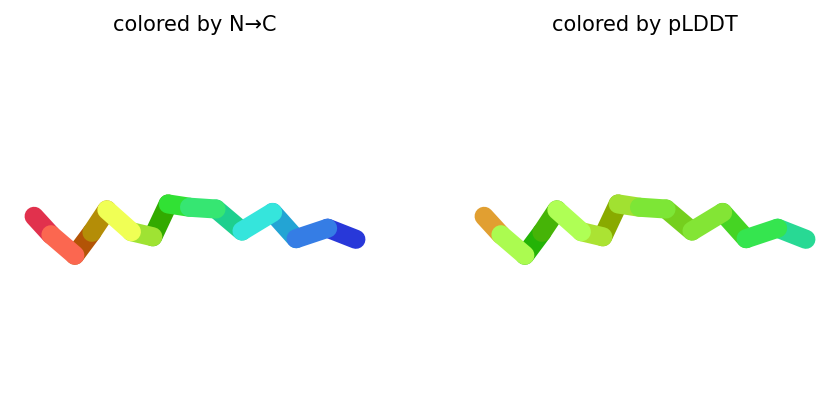

2025-11-17 07:58:22,849 reranking models by 'plddt' metric
2025-11-17 07:58:22,850 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=79.5 pTM=0.0354
2025-11-17 07:58:22,850 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=74.9 pTM=0.0365
2025-11-17 07:58:22,850 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=73.1 pTM=0.029
2025-11-17 07:58:22,851 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=70.6 pTM=0.0343
2025-11-17 07:58:22,851 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=67.2 pTM=0.0277
2025-11-17 07:58:23,860 Query 39/146: peptide_96_IC50_350.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:58:24,137 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


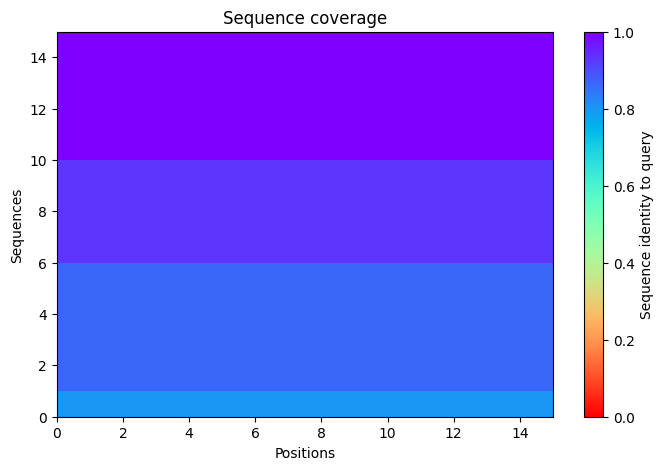

2025-11-17 07:58:39,205 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=67.4 pTM=0.029
2025-11-17 07:58:41,784 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.4 pTM=0.0293 tol=0.72
2025-11-17 07:58:44,361 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.8 pTM=0.0296 tol=0.311
2025-11-17 07:58:46,942 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.4 pTM=0.0299 tol=0.274
2025-11-17 07:58:46,943 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


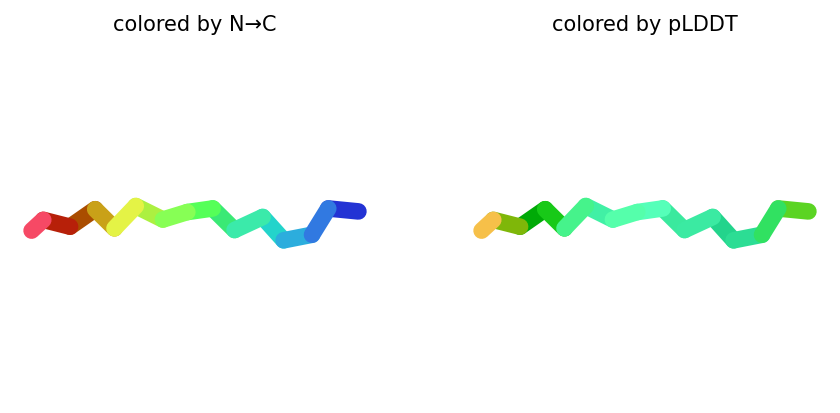

2025-11-17 07:58:49,577 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62 pTM=0.0274
2025-11-17 07:58:52,155 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=67.1 pTM=0.0281 tol=1.66
2025-11-17 07:58:54,743 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70 pTM=0.0285 tol=0.294
2025-11-17 07:58:57,323 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71 pTM=0.0289 tol=0.155
2025-11-17 07:58:57,324 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


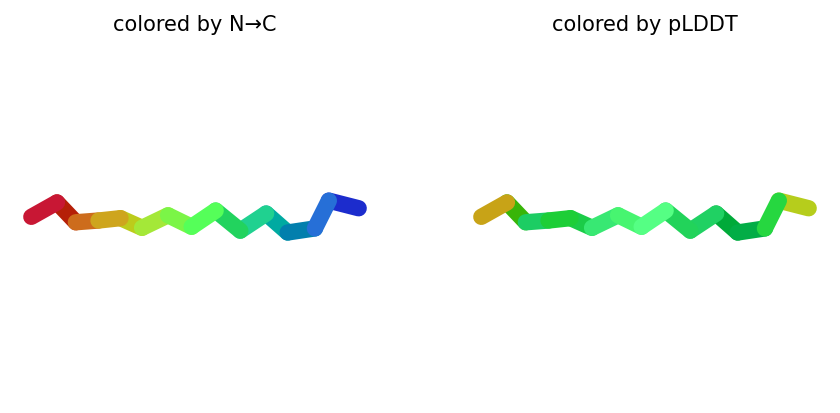

2025-11-17 07:58:59,960 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.7 pTM=0.0285
2025-11-17 07:59:02,552 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.4 pTM=0.0292 tol=0.566
2025-11-17 07:59:05,144 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.6 pTM=0.0293 tol=0.302
2025-11-17 07:59:07,740 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=78.3 pTM=0.0293 tol=0.263
2025-11-17 07:59:07,741 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


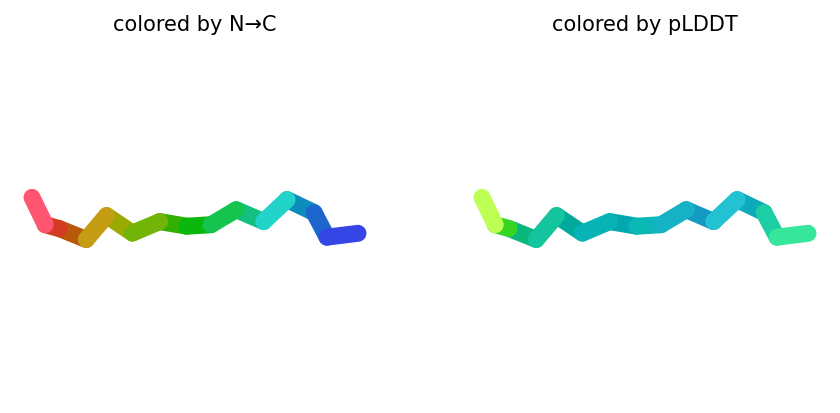

2025-11-17 07:59:10,392 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.4 pTM=0.0274
2025-11-17 07:59:12,993 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=69.8 pTM=0.0272 tol=0.902
2025-11-17 07:59:15,594 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=69.2 pTM=0.0273 tol=0.272
2025-11-17 07:59:18,200 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.1 pTM=0.0274 tol=0.507
2025-11-17 07:59:18,200 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


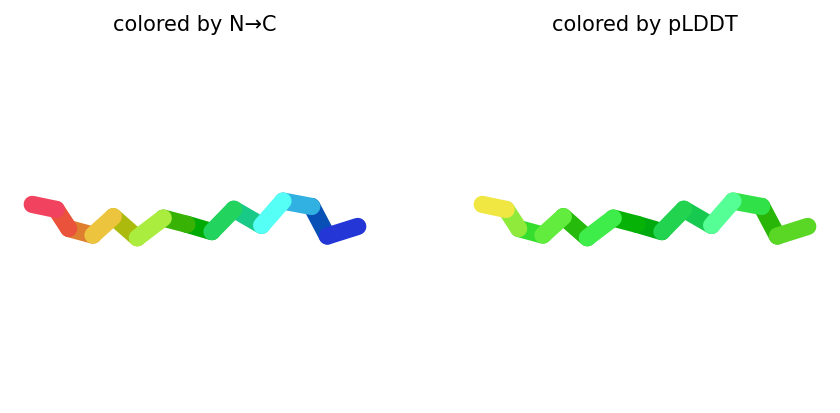

2025-11-17 07:59:20,886 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.8 pTM=0.0276
2025-11-17 07:59:23,479 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=65.1 pTM=0.0278 tol=2.01
2025-11-17 07:59:26,069 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=70.9 pTM=0.0287 tol=1.55
2025-11-17 07:59:28,662 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.1 pTM=0.0292 tol=0.485
2025-11-17 07:59:28,663 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


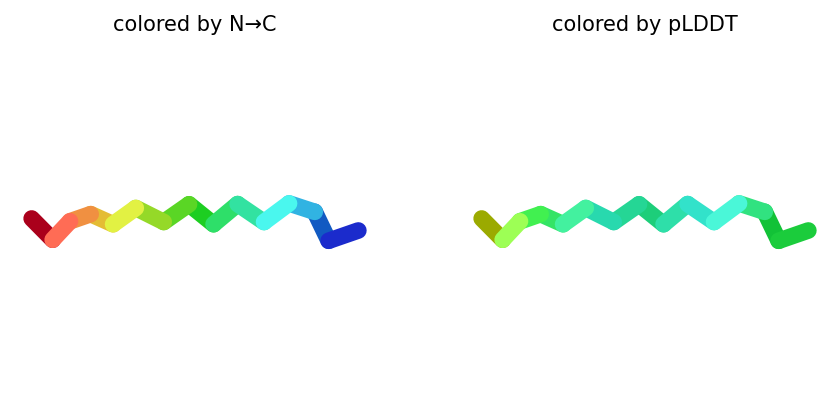

2025-11-17 07:59:28,735 reranking models by 'plddt' metric
2025-11-17 07:59:28,735 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=78.3 pTM=0.0293
2025-11-17 07:59:28,735 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=74.1 pTM=0.0292
2025-11-17 07:59:28,736 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=72.4 pTM=0.0299
2025-11-17 07:59:28,736 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=71 pTM=0.0289
2025-11-17 07:59:28,736 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=70.1 pTM=0.0274
2025-11-17 07:59:30,101 Query 40/146: peptide_97_IC50_351.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 07:59:30,389 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


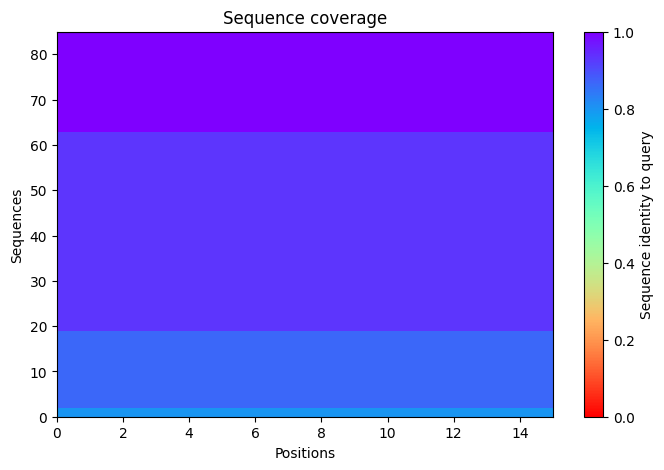

2025-11-17 07:59:44,492 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=86 pTM=0.0417
2025-11-17 07:59:47,070 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=89.6 pTM=0.0443 tol=0.0654
2025-11-17 07:59:49,649 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=90.6 pTM=0.0447 tol=0.0515
2025-11-17 07:59:52,232 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=91.1 pTM=0.0454 tol=0.034
2025-11-17 07:59:52,232 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


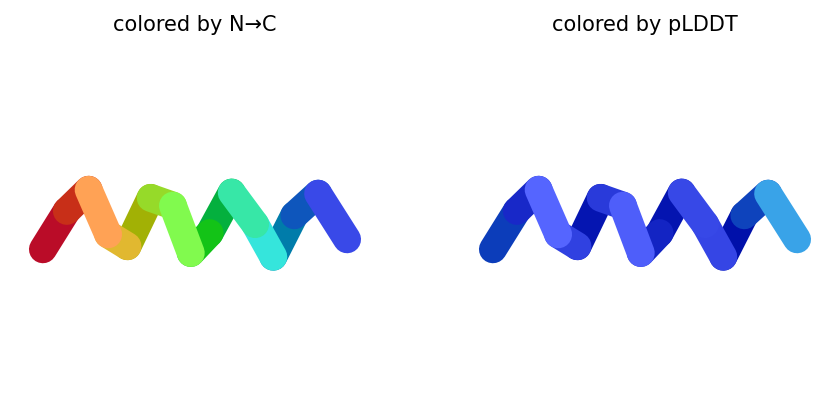

2025-11-17 07:59:54,873 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=90 pTM=0.0446
2025-11-17 07:59:57,462 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=90.3 pTM=0.0446 tol=0.0602
2025-11-17 08:00:00,046 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=91.2 pTM=0.0454 tol=0.0267
2025-11-17 08:00:02,638 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=91.8 pTM=0.0458 tol=0.0186
2025-11-17 08:00:02,638 alphafold2_ptm_model_2_seed_000 took 10.4s (3 recycles)


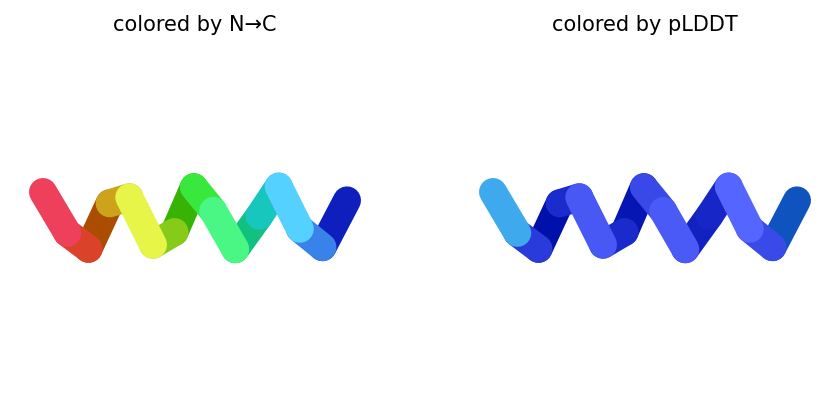

2025-11-17 08:00:05,283 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=87.9 pTM=0.0416
2025-11-17 08:00:07,883 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=89.5 pTM=0.0429 tol=0.0666
2025-11-17 08:00:10,483 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=90.9 pTM=0.0443 tol=0.0406
2025-11-17 08:00:13,085 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=91.5 pTM=0.0447 tol=0.0259
2025-11-17 08:00:13,085 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


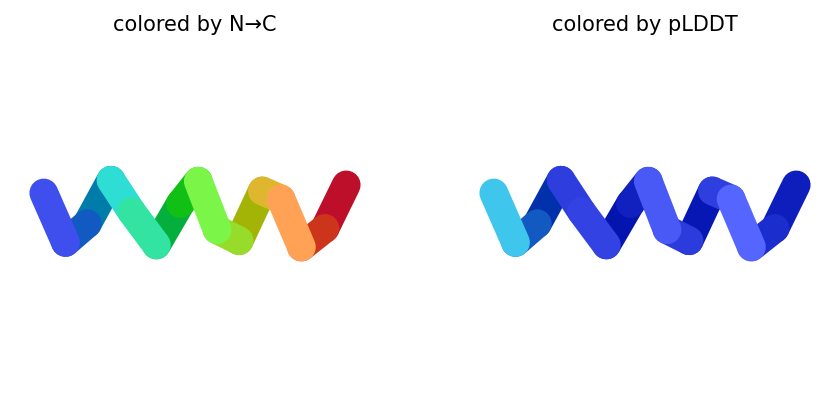

2025-11-17 08:00:15,743 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=84.2 pTM=0.0385
2025-11-17 08:00:18,345 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=89.1 pTM=0.0414 tol=0.0803
2025-11-17 08:00:20,943 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=90.4 pTM=0.0426 tol=0.0473
2025-11-17 08:00:23,538 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=91.6 pTM=0.0434 tol=0.0509
2025-11-17 08:00:23,539 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


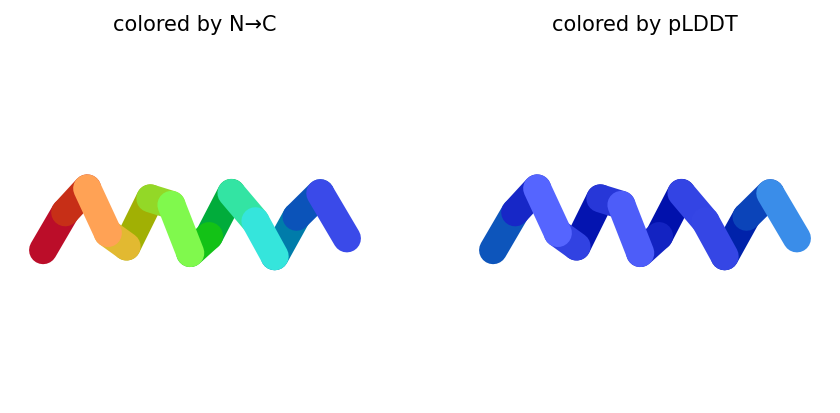

2025-11-17 08:00:26,189 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=90.9 pTM=0.044
2025-11-17 08:00:28,788 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=91.5 pTM=0.0444 tol=0.0623
2025-11-17 08:00:31,389 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=92.3 pTM=0.0451 tol=0.0364
2025-11-17 08:00:33,985 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=92.8 pTM=0.0456 tol=0.024
2025-11-17 08:00:33,986 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


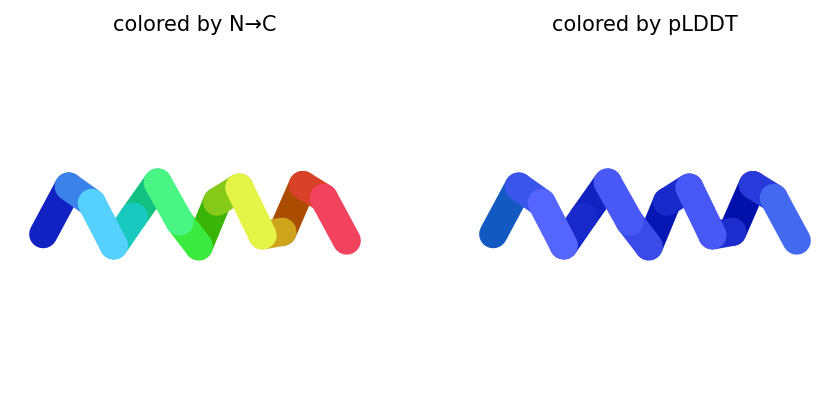

2025-11-17 08:00:34,037 reranking models by 'plddt' metric
2025-11-17 08:00:34,039 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=92.8 pTM=0.0456
2025-11-17 08:00:34,039 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=91.8 pTM=0.0458
2025-11-17 08:00:34,039 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=91.6 pTM=0.0434
2025-11-17 08:00:34,040 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=91.5 pTM=0.0447
2025-11-17 08:00:34,040 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=91.1 pTM=0.0454
2025-11-17 08:00:35,458 Query 41/146: peptide_99_IC50_349.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:00:35,735 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


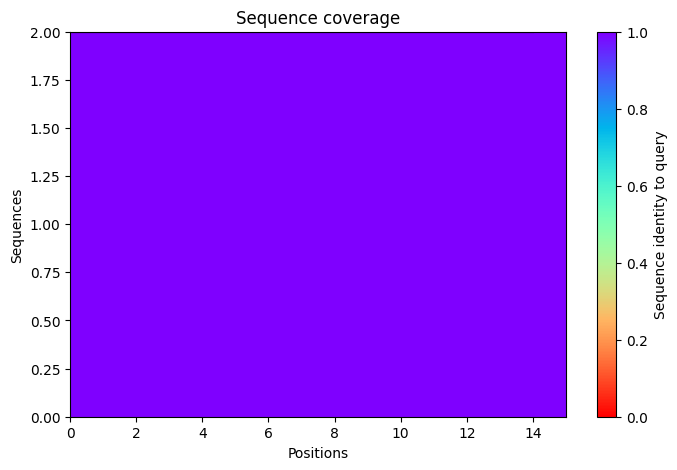

2025-11-17 08:00:47,860 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=78.1 pTM=0.0374
2025-11-17 08:00:50,436 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.8 pTM=0.0385 tol=0.235
2025-11-17 08:00:53,015 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.6 pTM=0.0375 tol=0.324
2025-11-17 08:00:55,599 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.6 pTM=0.037 tol=0.148
2025-11-17 08:00:55,600 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


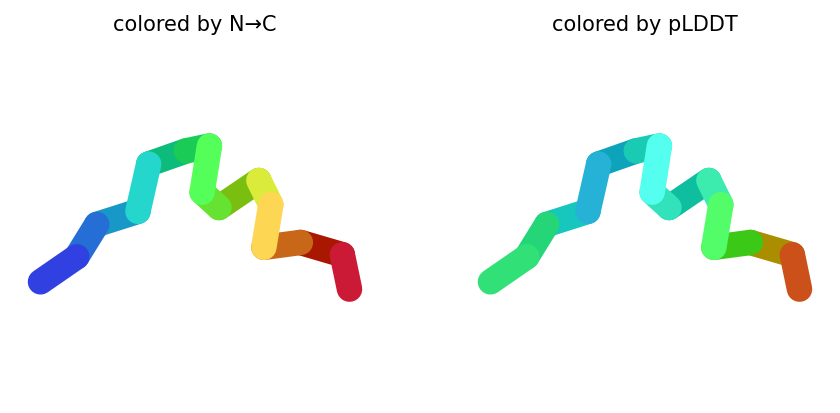

2025-11-17 08:00:58,234 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=80.1 pTM=0.0392
2025-11-17 08:01:00,814 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=79.3 pTM=0.0393 tol=0.141
2025-11-17 08:01:03,400 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.8 pTM=0.0379 tol=0.0568
2025-11-17 08:01:05,984 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=75.9 pTM=0.0376 tol=0.13
2025-11-17 08:01:05,985 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


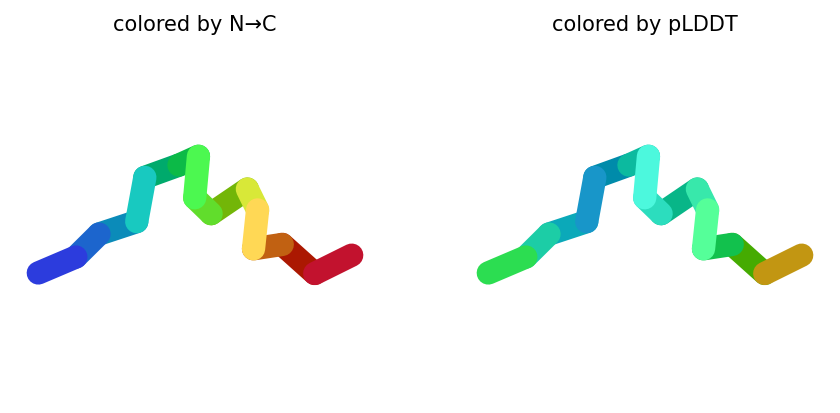

2025-11-17 08:01:08,654 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=80.5 pTM=0.0371
2025-11-17 08:01:11,245 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=80.2 pTM=0.0372 tol=0.258
2025-11-17 08:01:13,841 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.6 pTM=0.0352 tol=0.293
2025-11-17 08:01:16,437 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.8 pTM=0.0347 tol=0.172
2025-11-17 08:01:16,437 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


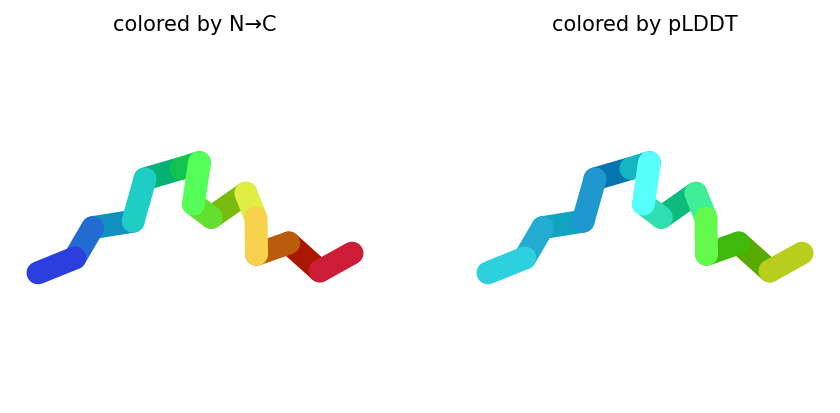

2025-11-17 08:01:19,091 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=80.3 pTM=0.0378
2025-11-17 08:01:21,688 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=81.3 pTM=0.0389 tol=0.0988
2025-11-17 08:01:24,280 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80.5 pTM=0.0386 tol=0.0953
2025-11-17 08:01:26,873 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=81.3 pTM=0.0391 tol=0.0724
2025-11-17 08:01:26,874 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


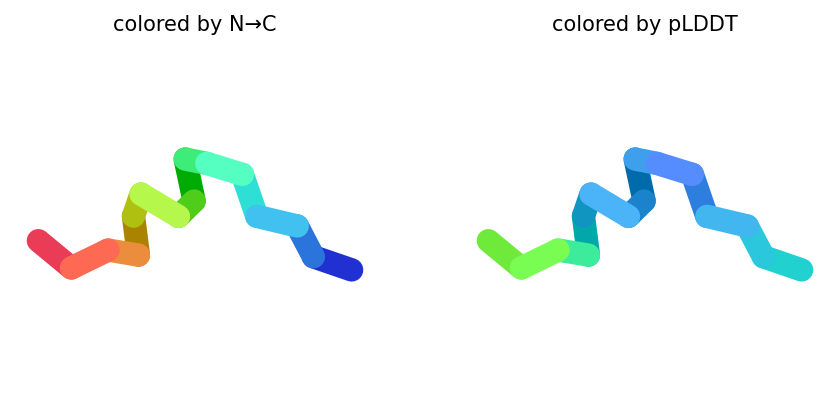

2025-11-17 08:01:29,512 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=76.9 pTM=0.0361
2025-11-17 08:01:32,102 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=74.4 pTM=0.035 tol=0.35
2025-11-17 08:01:34,685 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=68.9 pTM=0.0318 tol=0.467
2025-11-17 08:01:37,271 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=68.2 pTM=0.0312 tol=0.338
2025-11-17 08:01:37,272 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


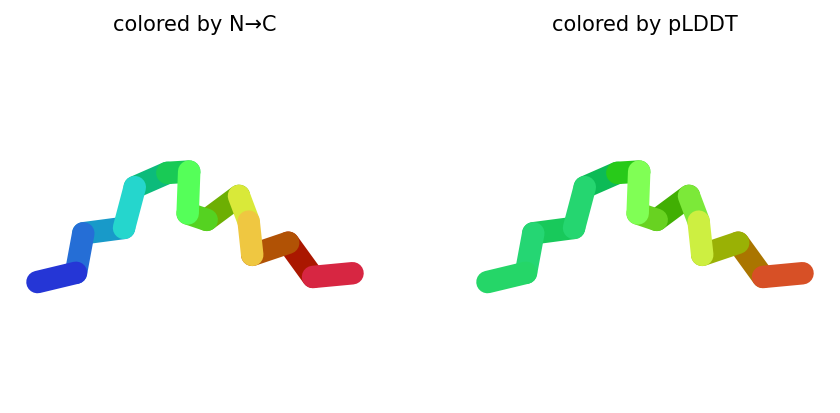

2025-11-17 08:01:37,323 reranking models by 'plddt' metric
2025-11-17 08:01:37,323 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=81.3 pTM=0.0391
2025-11-17 08:01:37,323 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=76.8 pTM=0.0347
2025-11-17 08:01:37,324 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=75.9 pTM=0.0376
2025-11-17 08:01:37,324 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=74.6 pTM=0.037
2025-11-17 08:01:37,324 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=68.2 pTM=0.0312
2025-11-17 08:01:38,331 Query 42/146: peptide_101_IC50_349.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:01:38,615 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


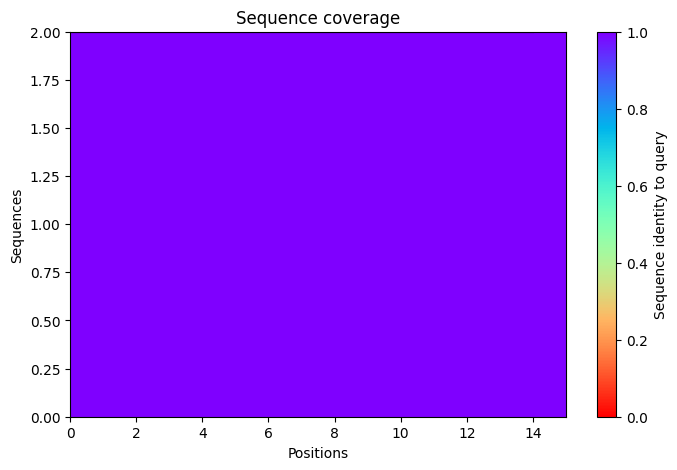

2025-11-17 08:01:52,739 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=73 pTM=0.028
2025-11-17 08:01:55,320 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74 pTM=0.0284 tol=0.523
2025-11-17 08:01:57,898 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.1 pTM=0.0284 tol=0.299
2025-11-17 08:02:00,475 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.9 pTM=0.0283 tol=0.25
2025-11-17 08:02:00,476 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


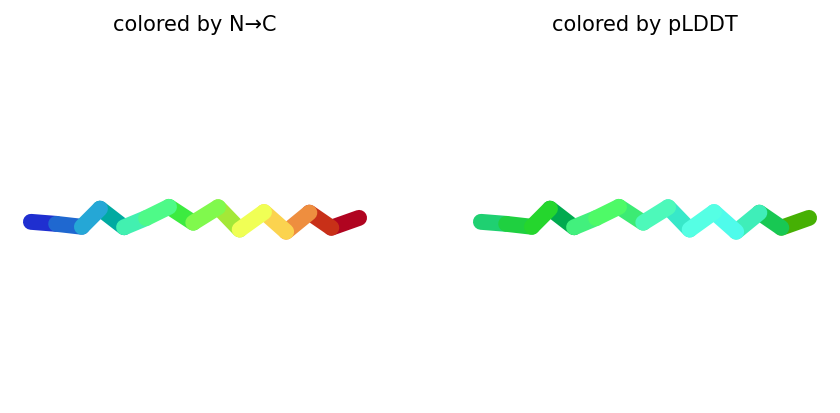

2025-11-17 08:02:03,109 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=72 pTM=0.0272
2025-11-17 08:02:05,694 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.9 pTM=0.0273 tol=0.205
2025-11-17 08:02:08,275 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.8 pTM=0.0275 tol=0.374
2025-11-17 08:02:10,861 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.6 pTM=0.0271 tol=0.293
2025-11-17 08:02:10,861 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


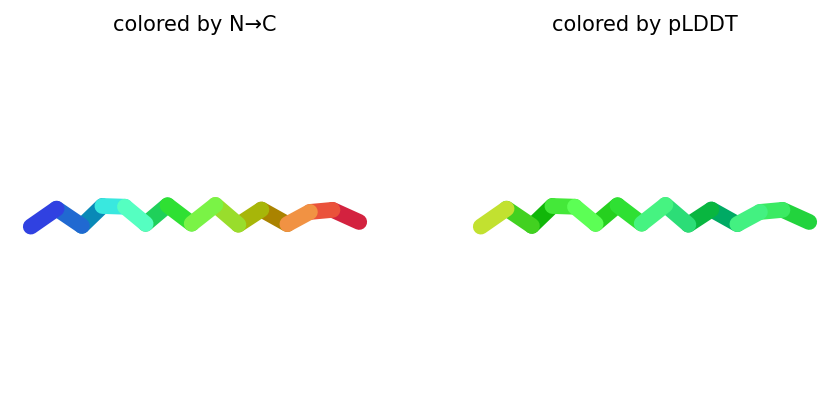

2025-11-17 08:02:13,498 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.4 pTM=0.0266
2025-11-17 08:02:16,093 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.4 pTM=0.0272 tol=0.424
2025-11-17 08:02:18,690 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.9 pTM=0.0275 tol=0.133
2025-11-17 08:02:21,288 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.9 pTM=0.0273 tol=0.251
2025-11-17 08:02:21,289 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


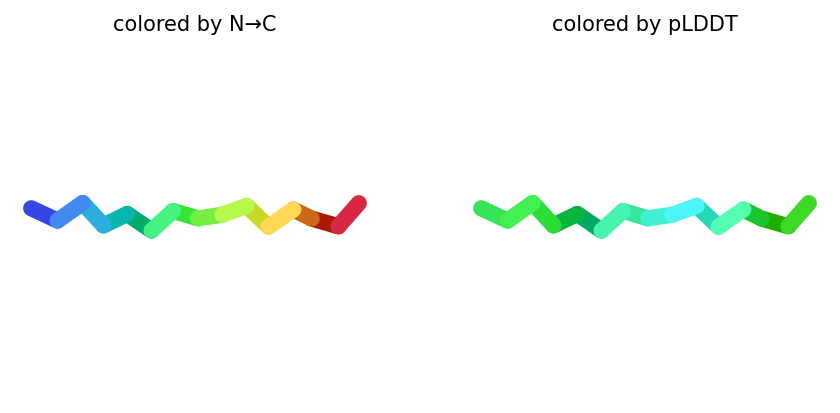

2025-11-17 08:02:23,939 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.1 pTM=0.028
2025-11-17 08:02:26,536 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.1 pTM=0.028 tol=0.318
2025-11-17 08:02:29,134 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.7 pTM=0.028 tol=0.0637
2025-11-17 08:02:31,732 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.4 pTM=0.0277 tol=0.057
2025-11-17 08:02:31,733 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


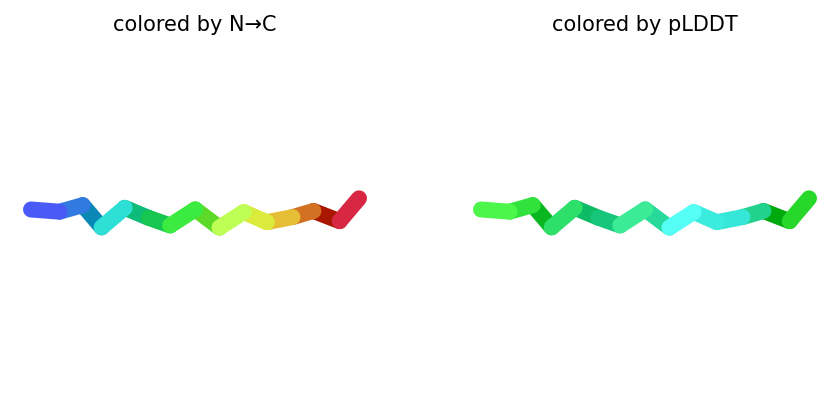

2025-11-17 08:02:34,403 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=74.1 pTM=0.0277
2025-11-17 08:02:36,995 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=77.8 pTM=0.0287 tol=0.292
2025-11-17 08:02:39,586 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=78.7 pTM=0.0286 tol=0.0886
2025-11-17 08:02:42,178 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=77.8 pTM=0.0283 tol=0.0681
2025-11-17 08:02:42,178 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


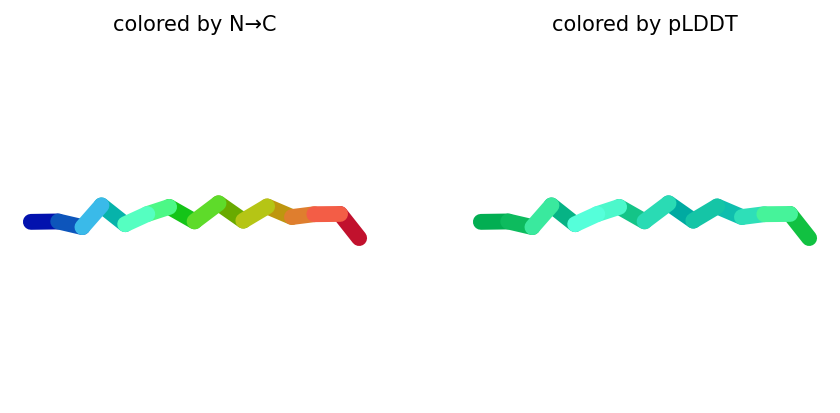

2025-11-17 08:02:42,252 reranking models by 'plddt' metric
2025-11-17 08:02:42,253 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=77.8 pTM=0.0283
2025-11-17 08:02:42,253 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=75.4 pTM=0.0277
2025-11-17 08:02:42,254 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=74.9 pTM=0.0273
2025-11-17 08:02:42,254 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=74.9 pTM=0.0283
2025-11-17 08:02:42,254 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=71.6 pTM=0.0271
2025-11-17 08:02:43,621 Query 43/146: peptide_102_IC50_348.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:02:43,949 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


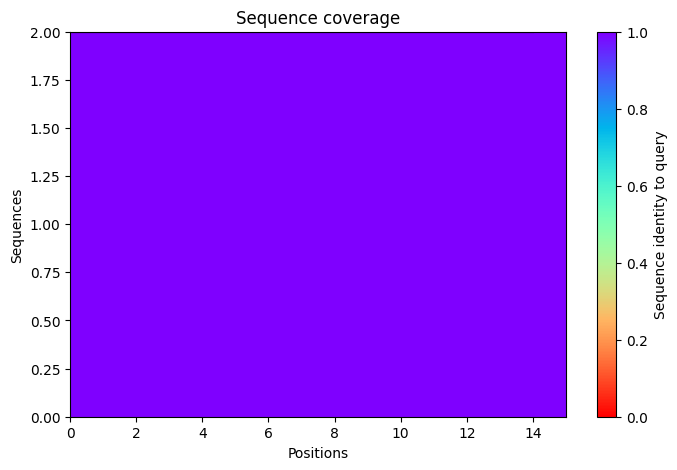

2025-11-17 08:02:54,042 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.5 pTM=0.0307
2025-11-17 08:02:56,617 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=59.3 pTM=0.029 tol=1.37
2025-11-17 08:02:59,194 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=57.7 pTM=0.0278 tol=1.2
2025-11-17 08:03:01,773 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=57.9 pTM=0.0282 tol=1.53
2025-11-17 08:03:01,774 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


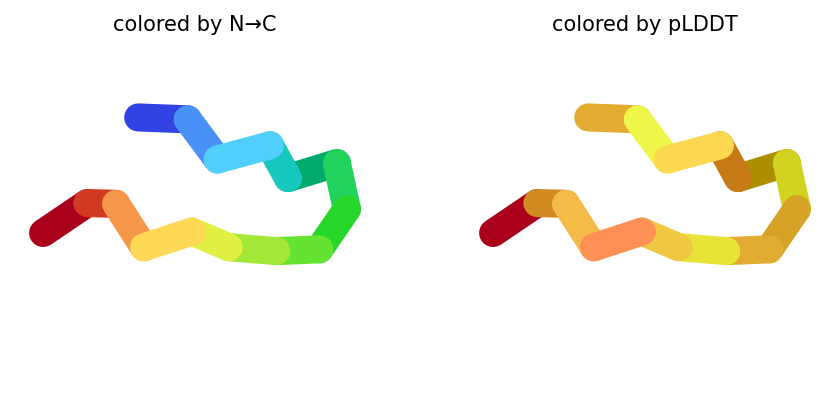

2025-11-17 08:03:04,411 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.2 pTM=0.0277
2025-11-17 08:03:06,989 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=58.8 pTM=0.0276 tol=0.356
2025-11-17 08:03:09,573 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.7 pTM=0.0272 tol=5
2025-11-17 08:03:12,157 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=61.2 pTM=0.0282 tol=5.3
2025-11-17 08:03:12,157 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


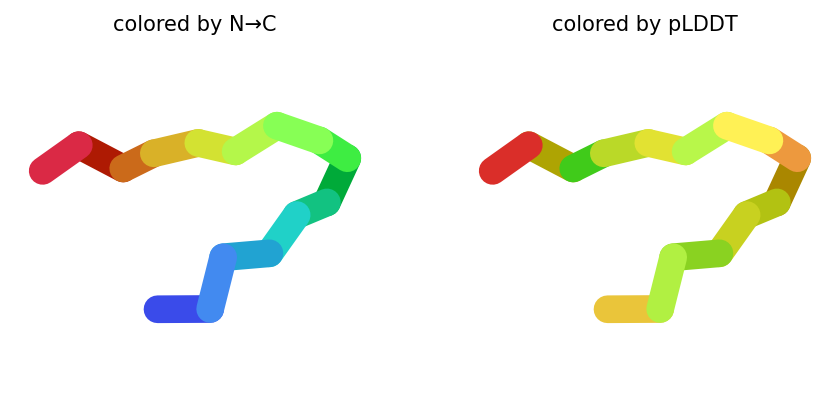

2025-11-17 08:03:14,800 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=58.7 pTM=0.0271
2025-11-17 08:03:17,388 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=58.9 pTM=0.0267 tol=1.31
2025-11-17 08:03:19,979 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=59.3 pTM=0.0265 tol=1.83
2025-11-17 08:03:22,569 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=59.7 pTM=0.0262 tol=0.469
2025-11-17 08:03:22,570 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


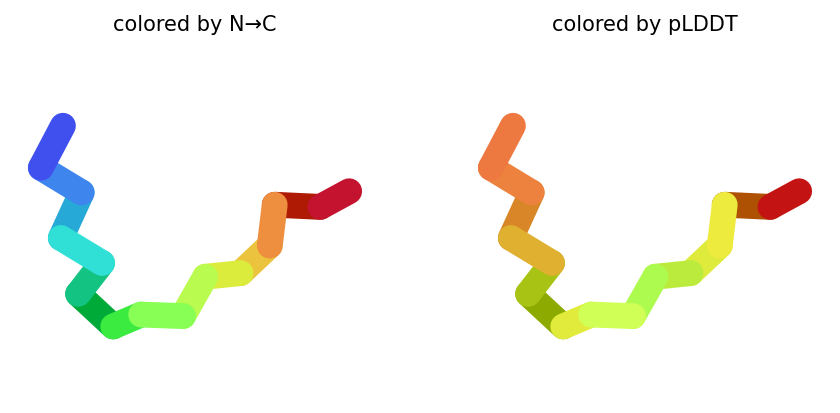

2025-11-17 08:03:25,217 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=65.9 pTM=0.0277
2025-11-17 08:03:27,808 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.7 pTM=0.0275 tol=0.554
2025-11-17 08:03:30,392 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=58.7 pTM=0.0269 tol=0.964
2025-11-17 08:03:32,983 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=61.2 pTM=0.027 tol=0.982
2025-11-17 08:03:32,984 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


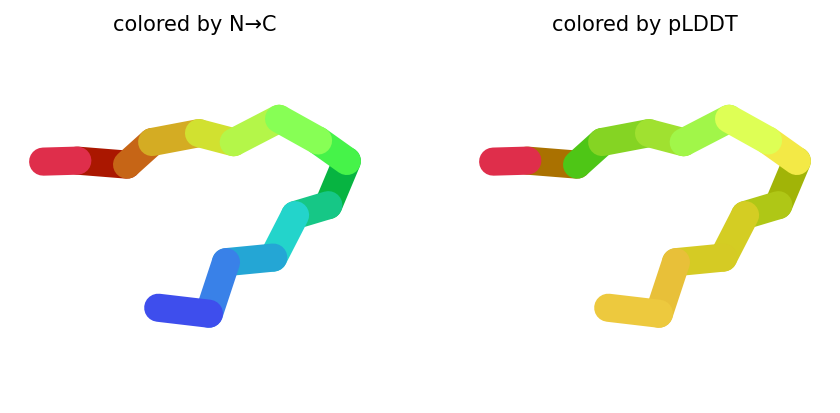

2025-11-17 08:03:35,623 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=77.5 pTM=0.0329
2025-11-17 08:03:38,211 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=68.5 pTM=0.0313 tol=1.16
2025-11-17 08:03:40,799 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=59.4 pTM=0.0281 tol=1.3
2025-11-17 08:03:43,386 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=58.7 pTM=0.0275 tol=0.515
2025-11-17 08:03:43,387 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


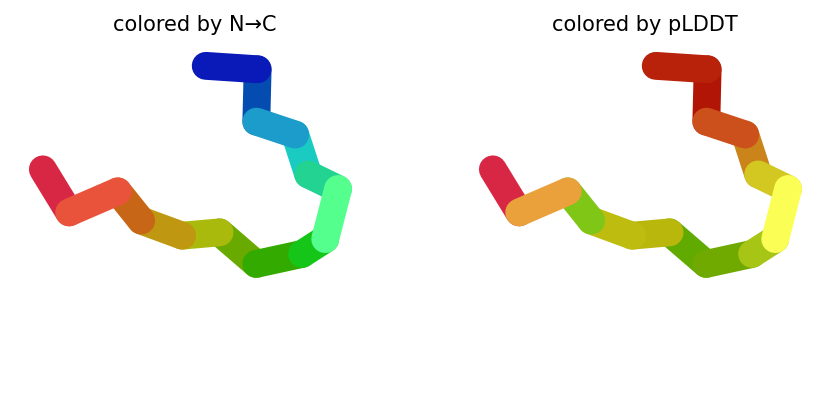

2025-11-17 08:03:43,467 reranking models by 'plddt' metric
2025-11-17 08:03:43,468 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=61.2 pTM=0.027
2025-11-17 08:03:43,468 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=61.2 pTM=0.0282
2025-11-17 08:03:43,468 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=59.7 pTM=0.0262
2025-11-17 08:03:43,469 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=58.7 pTM=0.0275
2025-11-17 08:03:43,469 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=57.9 pTM=0.0282
2025-11-17 08:03:45,440 Query 44/146: peptide_106_IC50_356.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:03:45,729 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:11 remaining: 00:00]


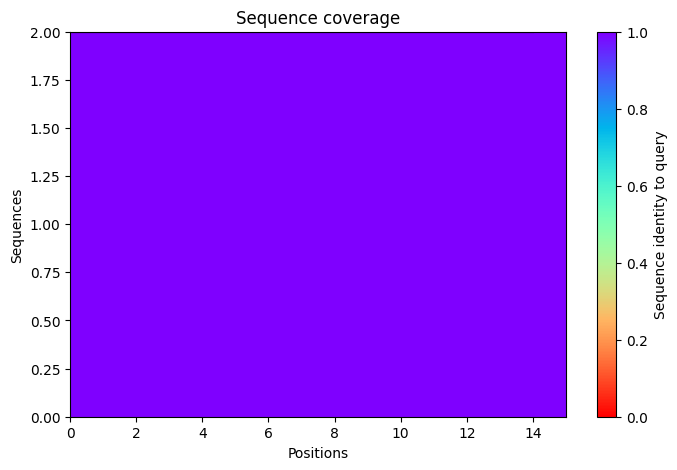

2025-11-17 08:04:01,896 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.3 pTM=0.0362
2025-11-17 08:04:04,472 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.8 pTM=0.0345 tol=0.383
2025-11-17 08:04:07,051 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=64.6 pTM=0.033 tol=0.242
2025-11-17 08:04:09,635 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=64.7 pTM=0.0326 tol=0.168
2025-11-17 08:04:09,636 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


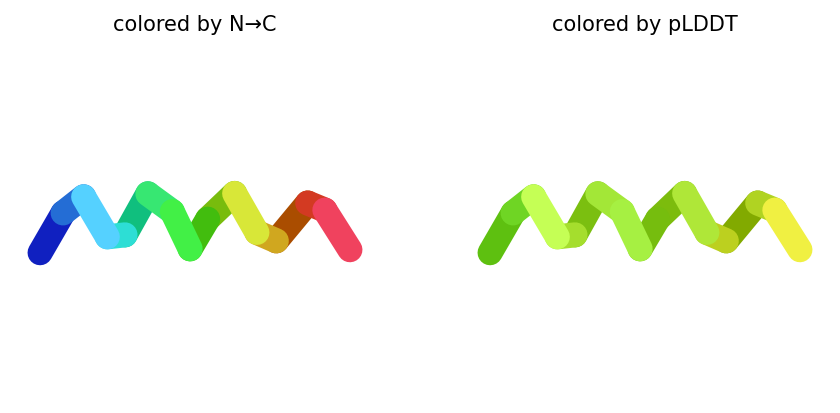

2025-11-17 08:04:12,269 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61.3 pTM=0.0315
2025-11-17 08:04:14,851 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.3 pTM=0.0276 tol=2.23
2025-11-17 08:04:17,438 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=61.8 pTM=0.027 tol=2.28
2025-11-17 08:04:20,024 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=63.6 pTM=0.027 tol=1.29
2025-11-17 08:04:20,024 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


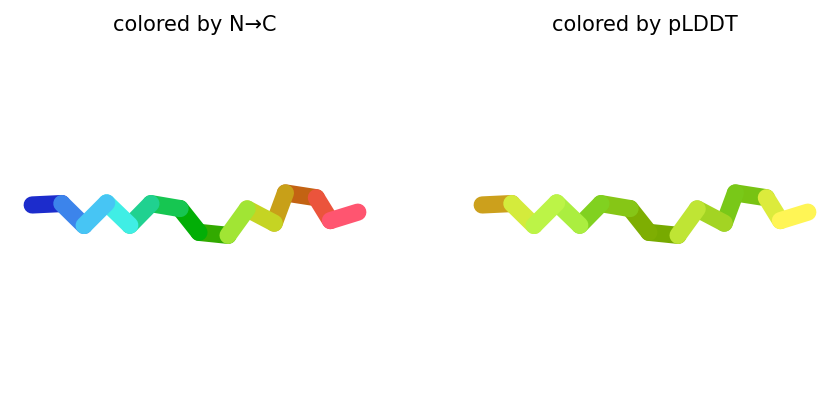

2025-11-17 08:04:22,690 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=64.8 pTM=0.027
2025-11-17 08:04:25,285 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.8 pTM=0.0281 tol=0.784
2025-11-17 08:04:27,883 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.7 pTM=0.0285 tol=0.391
2025-11-17 08:04:30,483 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.7 pTM=0.0285 tol=0.0719
2025-11-17 08:04:30,484 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


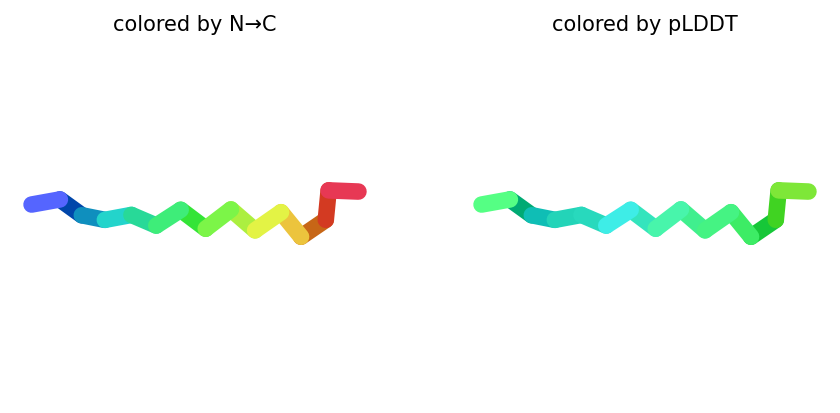

2025-11-17 08:04:33,142 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.3 pTM=0.0274
2025-11-17 08:04:35,739 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.9 pTM=0.028 tol=1.1
2025-11-17 08:04:38,340 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.6 pTM=0.0281 tol=0.337
2025-11-17 08:04:40,936 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.1 pTM=0.0282 tol=0.188
2025-11-17 08:04:40,937 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


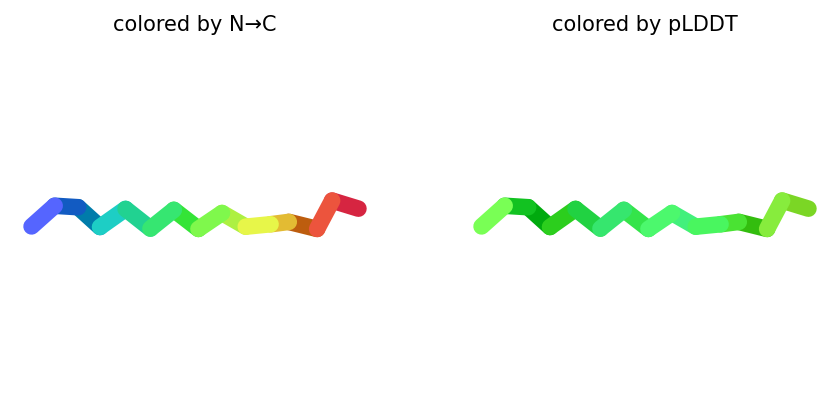

2025-11-17 08:04:43,581 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.4 pTM=0.0334
2025-11-17 08:04:46,174 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.9 pTM=0.0297 tol=1.64
2025-11-17 08:04:48,760 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=58.3 pTM=0.0279 tol=2.31
2025-11-17 08:04:51,350 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=61.2 pTM=0.0275 tol=1.52
2025-11-17 08:04:51,351 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


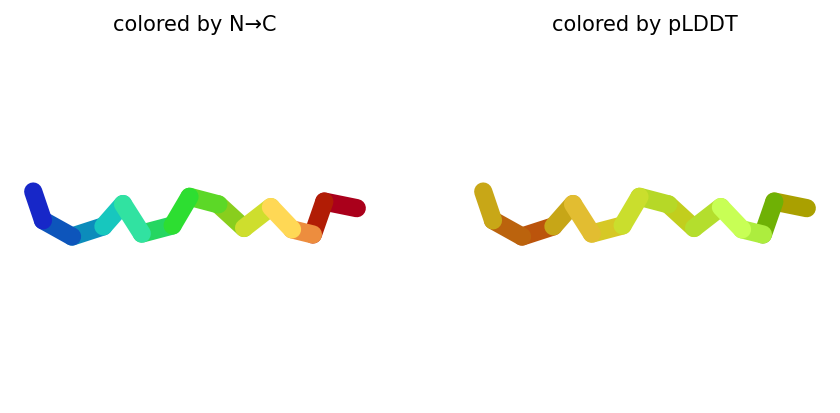

2025-11-17 08:04:51,401 reranking models by 'plddt' metric
2025-11-17 08:04:51,402 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=75.7 pTM=0.0285
2025-11-17 08:04:51,402 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=71.1 pTM=0.0282
2025-11-17 08:04:51,403 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=64.7 pTM=0.0326
2025-11-17 08:04:51,403 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=63.6 pTM=0.027
2025-11-17 08:04:51,403 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=61.2 pTM=0.0275
2025-11-17 08:04:52,423 Query 45/146: peptide_107_IC50_360.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:04:52,715 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


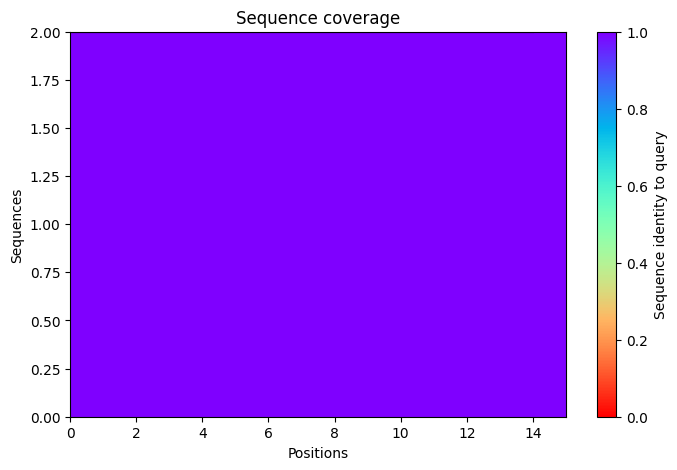

2025-11-17 08:05:06,782 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=69.4 pTM=0.0372
2025-11-17 08:05:09,358 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=68.6 pTM=0.0366 tol=0.447
2025-11-17 08:05:11,933 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=67.4 pTM=0.0364 tol=0.462
2025-11-17 08:05:14,510 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.4 pTM=0.0368 tol=0.417
2025-11-17 08:05:14,511 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


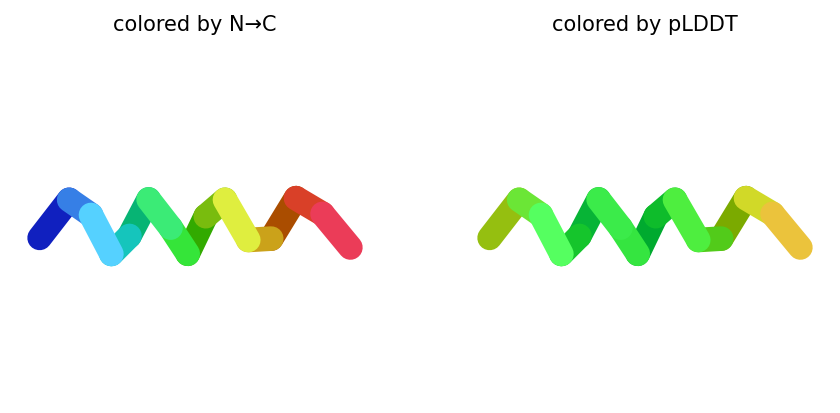

2025-11-17 08:05:17,146 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.8 pTM=0.0349
2025-11-17 08:05:19,729 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=62.5 pTM=0.0333 tol=0.492
2025-11-17 08:05:22,313 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=59.6 pTM=0.0316 tol=0.437
2025-11-17 08:05:24,897 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60.6 pTM=0.0317 tol=0.147
2025-11-17 08:05:24,897 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


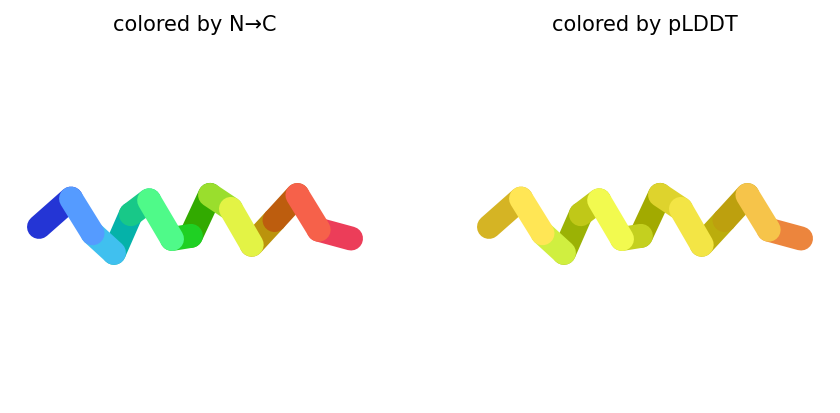

2025-11-17 08:05:27,532 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=67.6 pTM=0.0279
2025-11-17 08:05:30,119 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.9 pTM=0.0287 tol=0.856
2025-11-17 08:05:32,715 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.9 pTM=0.029 tol=0.238
2025-11-17 08:05:35,311 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.1 pTM=0.0287 tol=0.198
2025-11-17 08:05:35,312 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


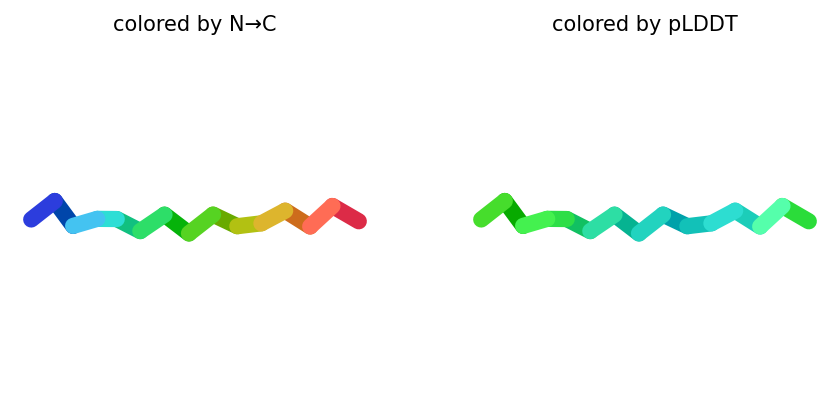

2025-11-17 08:05:37,954 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=66.8 pTM=0.0299
2025-11-17 08:05:40,549 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.9 pTM=0.0284 tol=3.36
2025-11-17 08:05:43,144 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.3 pTM=0.0287 tol=0.531
2025-11-17 08:05:45,743 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=68.6 pTM=0.0289 tol=0.302
2025-11-17 08:05:45,744 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


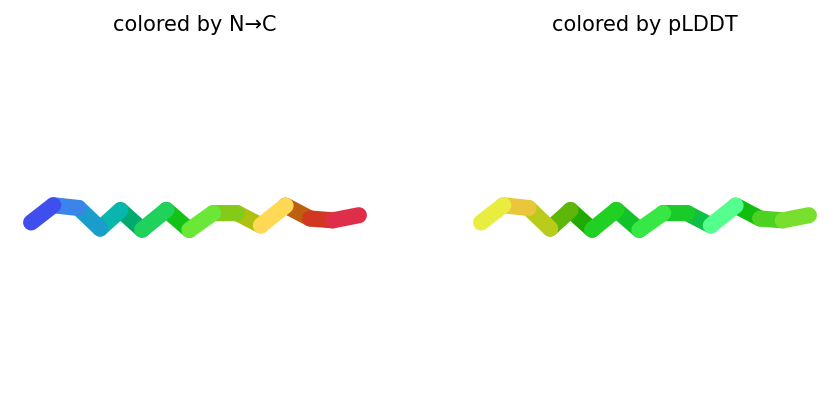

2025-11-17 08:05:48,393 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.2 pTM=0.0296
2025-11-17 08:05:50,990 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.8 pTM=0.028 tol=2.87
2025-11-17 08:05:53,583 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=62.6 pTM=0.0282 tol=0.796
2025-11-17 08:05:56,176 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=61.7 pTM=0.0279 tol=0.496
2025-11-17 08:05:56,177 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


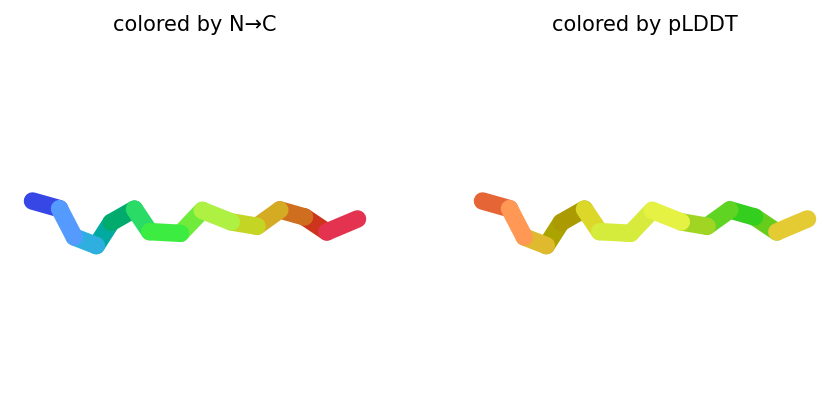

2025-11-17 08:05:56,248 reranking models by 'plddt' metric
2025-11-17 08:05:56,249 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=76.1 pTM=0.0287
2025-11-17 08:05:56,249 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=68.6 pTM=0.0289
2025-11-17 08:05:56,250 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=68.4 pTM=0.0368
2025-11-17 08:05:56,250 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=61.7 pTM=0.0279
2025-11-17 08:05:56,250 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60.6 pTM=0.0317
2025-11-17 08:05:57,626 Query 46/146: peptide_108_IC50_368.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:05:57,915 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


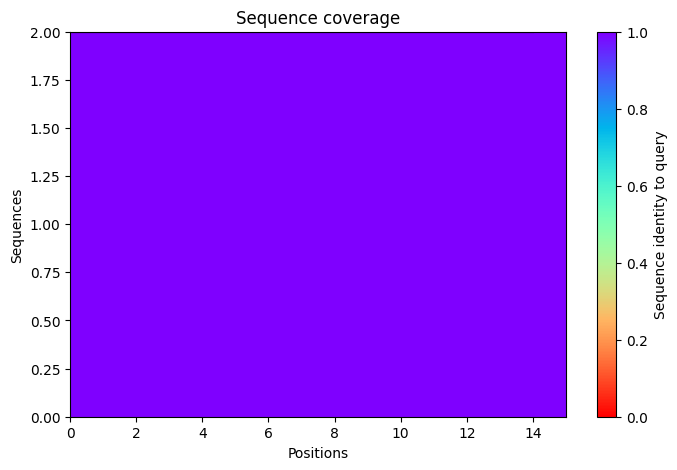

2025-11-17 08:06:10,027 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=64.1 pTM=0.0329
2025-11-17 08:06:12,605 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.8 pTM=0.0341 tol=0.175
2025-11-17 08:06:15,181 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=62.9 pTM=0.0321 tol=0.55
2025-11-17 08:06:17,760 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=65.4 pTM=0.0332 tol=0.424
2025-11-17 08:06:17,761 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


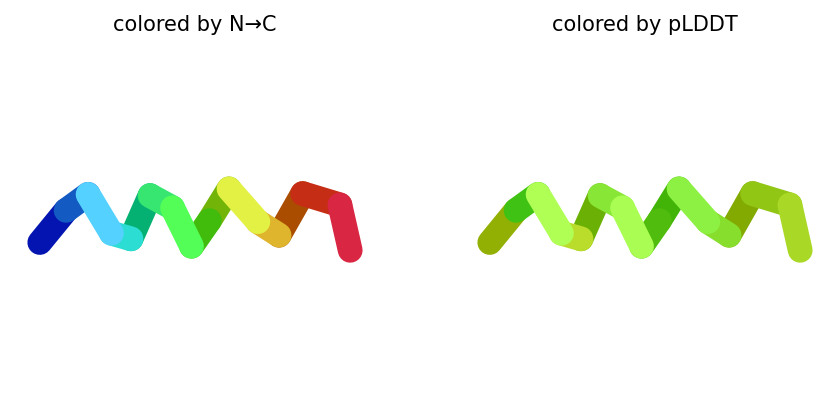

2025-11-17 08:06:20,399 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.7 pTM=0.0299
2025-11-17 08:06:22,981 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.5 pTM=0.0292 tol=0.951
2025-11-17 08:06:25,564 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=59.2 pTM=0.0278 tol=1.63
2025-11-17 08:06:28,148 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=59.6 pTM=0.028 tol=0.659
2025-11-17 08:06:28,148 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


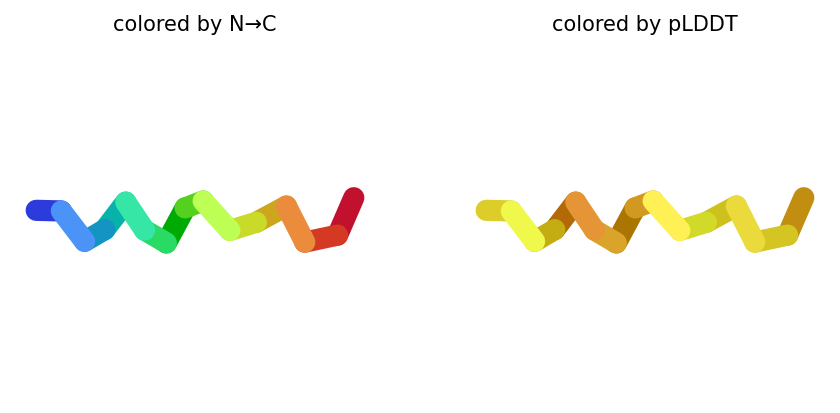

2025-11-17 08:06:30,786 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62.7 pTM=0.0267
2025-11-17 08:06:33,377 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.1 pTM=0.0273 tol=1.3
2025-11-17 08:06:35,974 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.4 pTM=0.0278 tol=0.523
2025-11-17 08:06:38,570 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.4 pTM=0.0276 tol=0.149
2025-11-17 08:06:38,570 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


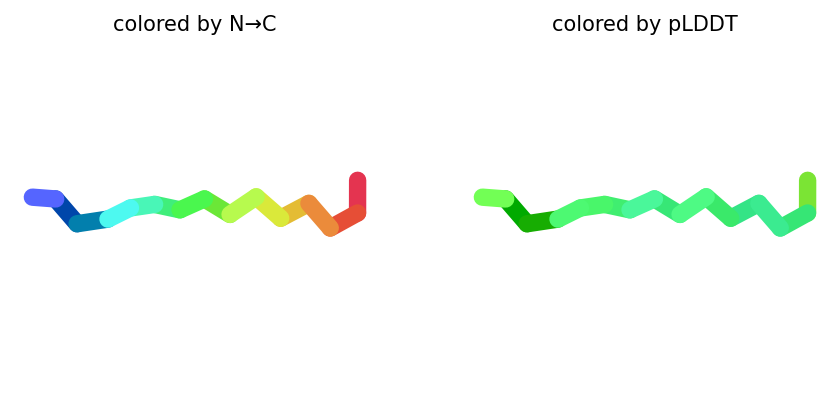

2025-11-17 08:06:41,219 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62 pTM=0.0271
2025-11-17 08:06:43,815 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=68.7 pTM=0.0281 tol=0.837
2025-11-17 08:06:46,410 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.4 pTM=0.028 tol=0.235
2025-11-17 08:06:49,007 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.5 pTM=0.028 tol=0.158
2025-11-17 08:06:49,007 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


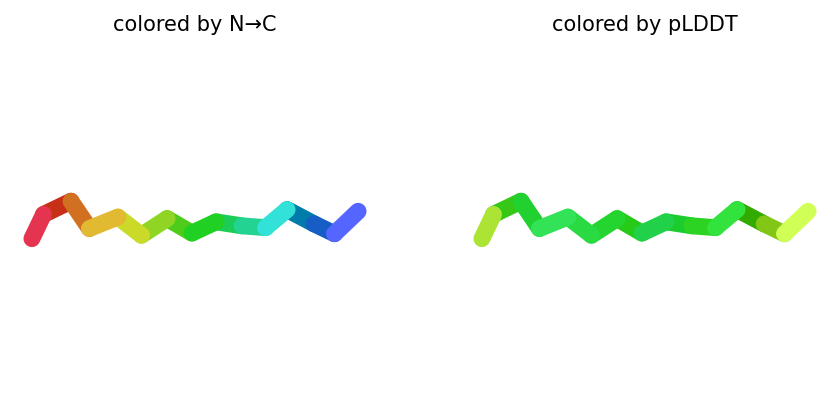

2025-11-17 08:06:51,644 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=74.3 pTM=0.0366
2025-11-17 08:06:54,234 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=69 pTM=0.034 tol=0.428
2025-11-17 08:06:56,826 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64.1 pTM=0.0313 tol=1.01
2025-11-17 08:06:59,414 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.6 pTM=0.0313 tol=0.195
2025-11-17 08:06:59,415 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


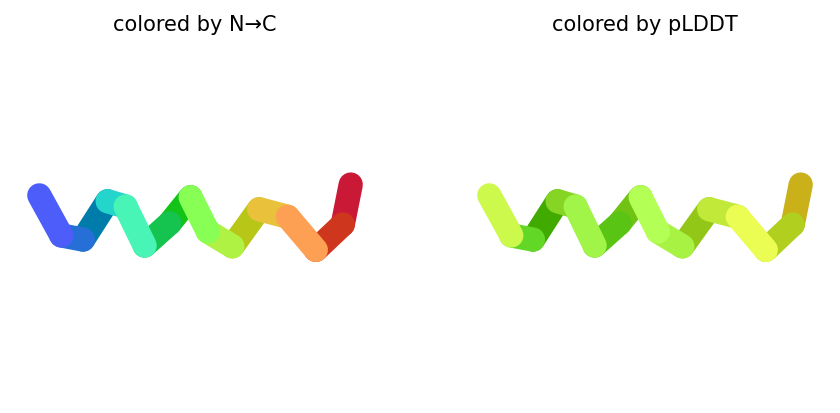

2025-11-17 08:06:59,465 reranking models by 'plddt' metric
2025-11-17 08:06:59,466 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=72.4 pTM=0.0276
2025-11-17 08:06:59,466 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=69.5 pTM=0.028
2025-11-17 08:06:59,466 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=65.4 pTM=0.0332
2025-11-17 08:06:59,466 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=64.6 pTM=0.0313
2025-11-17 08:06:59,467 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=59.6 pTM=0.028
2025-11-17 08:07:00,903 Query 47/146: peptide_109_IC50_372.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:07:01,195 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


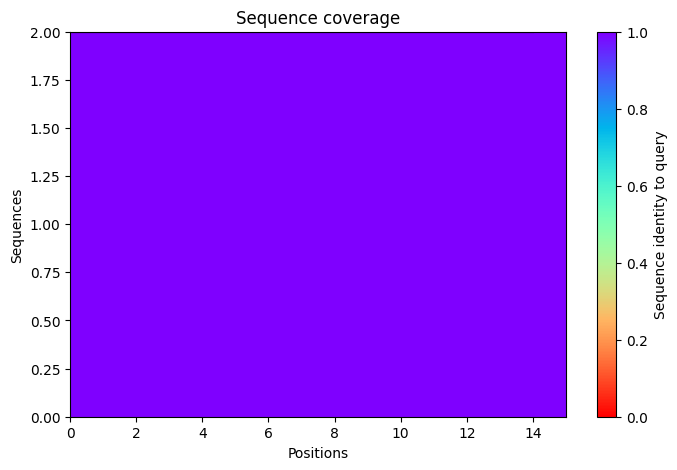

2025-11-17 08:07:14,237 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=69.1 pTM=0.0281
2025-11-17 08:07:16,812 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72.5 pTM=0.0287 tol=1.12
2025-11-17 08:07:19,390 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.3 pTM=0.0292 tol=0.228
2025-11-17 08:07:21,973 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.9 pTM=0.0288 tol=0.0557
2025-11-17 08:07:21,974 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


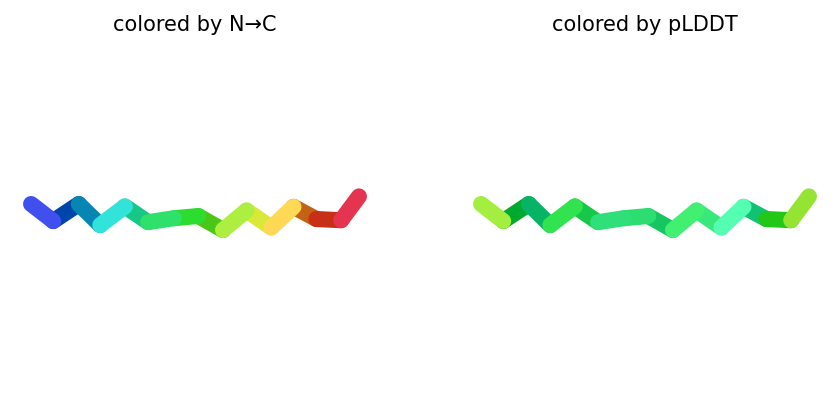

2025-11-17 08:07:24,630 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.4 pTM=0.0269
2025-11-17 08:07:27,210 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70.4 pTM=0.0266 tol=1.42
2025-11-17 08:07:29,795 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.4 pTM=0.0269 tol=0.71
2025-11-17 08:07:32,380 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.8 pTM=0.0268 tol=0.131
2025-11-17 08:07:32,380 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


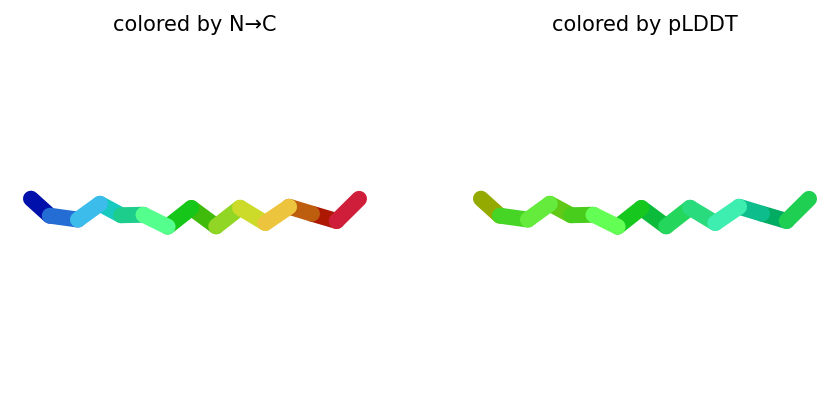

2025-11-17 08:07:35,024 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.4 pTM=0.027
2025-11-17 08:07:37,620 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=81.2 pTM=0.0283 tol=0.397
2025-11-17 08:07:40,214 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=83.2 pTM=0.0296 tol=0.273
2025-11-17 08:07:42,810 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=83.9 pTM=0.0299 tol=0.0839
2025-11-17 08:07:42,810 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


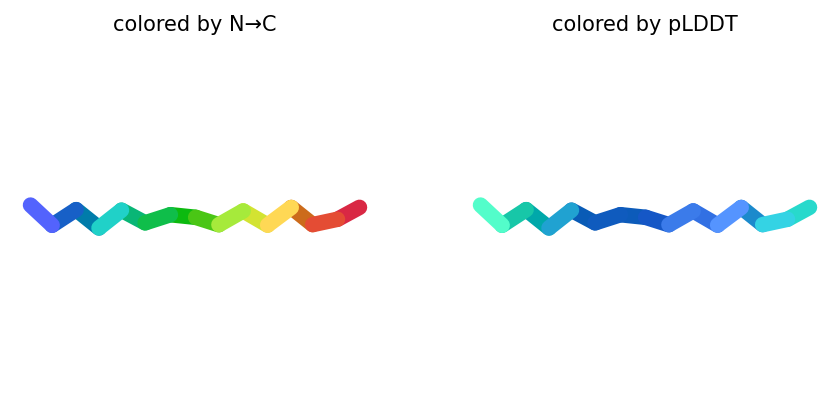

2025-11-17 08:07:45,458 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.2 pTM=0.0268
2025-11-17 08:07:48,053 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=74.3 pTM=0.0273 tol=0.442
2025-11-17 08:07:50,651 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.2 pTM=0.028 tol=0.208
2025-11-17 08:07:53,242 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.4 pTM=0.0284 tol=0.0554
2025-11-17 08:07:53,243 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


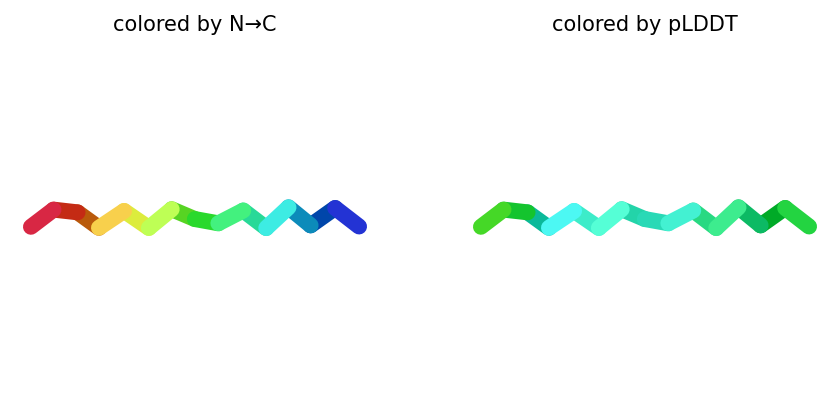

2025-11-17 08:07:55,889 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=67.1 pTM=0.0275
2025-11-17 08:07:58,479 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=63.3 pTM=0.0271 tol=1.62
2025-11-17 08:08:01,068 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=69.1 pTM=0.027 tol=1.16
2025-11-17 08:08:03,656 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=69.4 pTM=0.0275 tol=0.35
2025-11-17 08:08:03,657 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


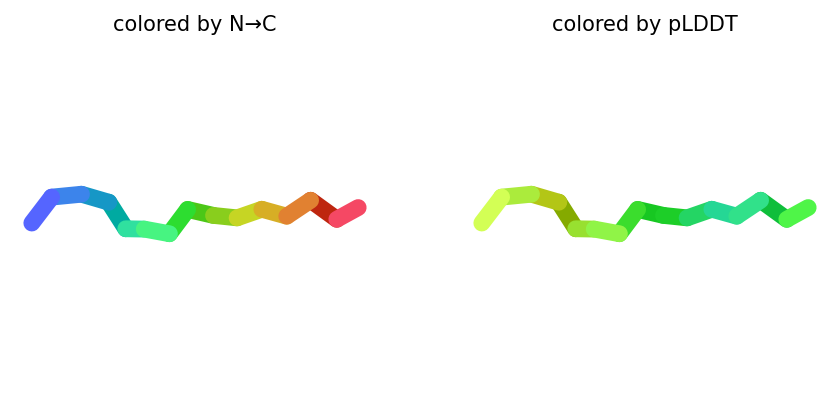

2025-11-17 08:08:03,706 reranking models by 'plddt' metric
2025-11-17 08:08:03,707 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=83.9 pTM=0.0299
2025-11-17 08:08:03,707 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=76.4 pTM=0.0284
2025-11-17 08:08:03,707 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=72.9 pTM=0.0288
2025-11-17 08:08:03,708 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=71.8 pTM=0.0268
2025-11-17 08:08:03,708 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=69.4 pTM=0.0275
2025-11-17 08:08:04,728 Query 48/146: peptide_110_IC50_370.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:08:05,011 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


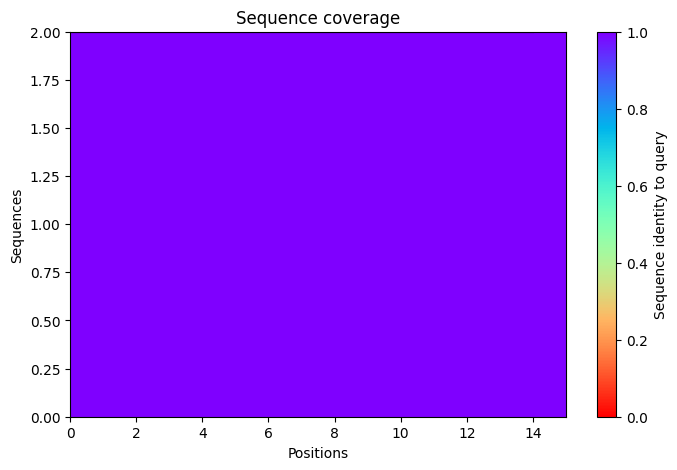

2025-11-17 08:08:16,587 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.2 pTM=0.0342
2025-11-17 08:08:19,163 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.1 pTM=0.0379 tol=0.192
2025-11-17 08:08:21,745 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81.2 pTM=0.0408 tol=0.251
2025-11-17 08:08:24,326 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.9 pTM=0.0412 tol=0.0598
2025-11-17 08:08:24,327 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


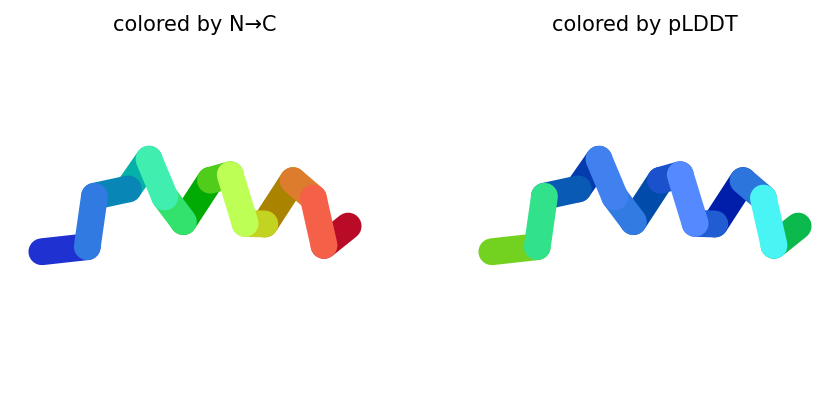

2025-11-17 08:08:26,959 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61.2 pTM=0.0267
2025-11-17 08:08:29,543 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=64.6 pTM=0.027 tol=2.06
2025-11-17 08:08:32,125 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=67.2 pTM=0.0278 tol=0.394
2025-11-17 08:08:34,710 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=63.1 pTM=0.0268 tol=0.985
2025-11-17 08:08:34,711 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


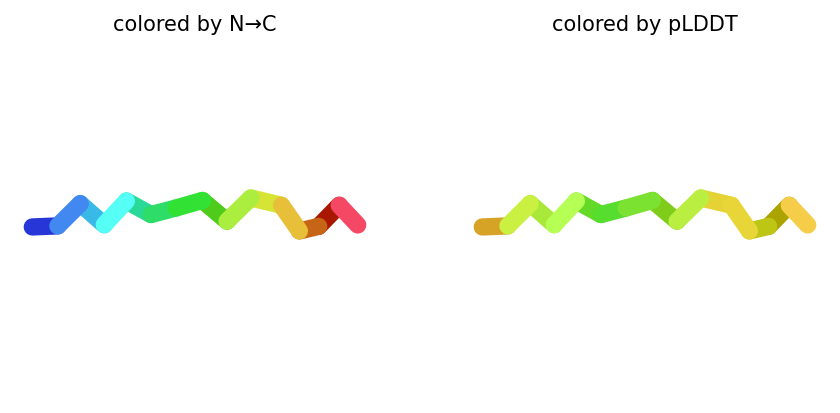

2025-11-17 08:08:37,371 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=75.2 pTM=0.0288
2025-11-17 08:08:39,963 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=76.8 pTM=0.0302 tol=1.14
2025-11-17 08:08:42,557 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=78.3 pTM=0.0303 tol=0.117
2025-11-17 08:08:45,150 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=78.8 pTM=0.0302 tol=0.134
2025-11-17 08:08:45,151 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


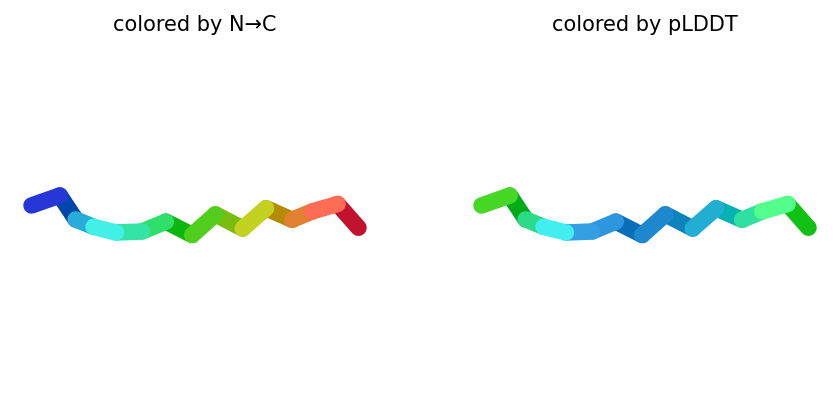

2025-11-17 08:08:47,801 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.9 pTM=0.0282
2025-11-17 08:08:50,395 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.1 pTM=0.0299 tol=1.38
2025-11-17 08:08:52,986 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.9 pTM=0.0303 tol=0.325
2025-11-17 08:08:55,579 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.4 pTM=0.0303 tol=0.219
2025-11-17 08:08:55,579 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


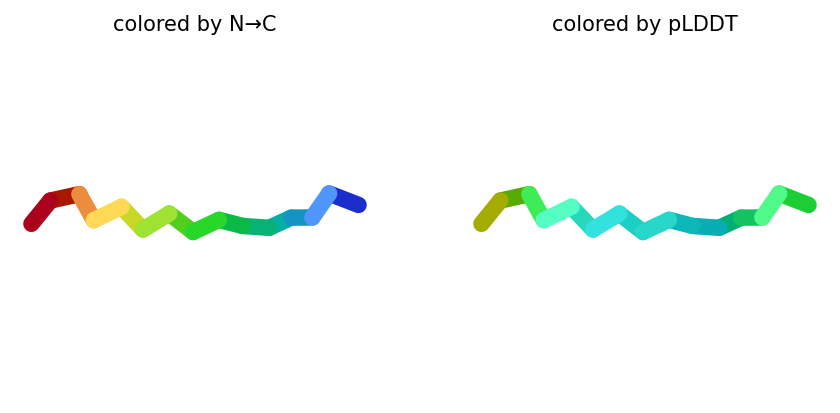

2025-11-17 08:08:58,216 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=79.4 pTM=0.0378
2025-11-17 08:09:00,807 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=78.6 pTM=0.0385 tol=0.339
2025-11-17 08:09:03,392 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=80.9 pTM=0.0399 tol=0.106
2025-11-17 08:09:05,979 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=81.2 pTM=0.0401 tol=0.0736
2025-11-17 08:09:05,979 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


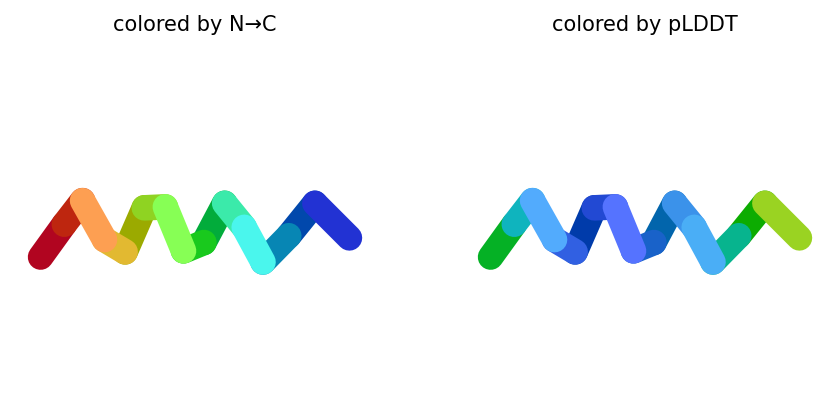

2025-11-17 08:09:06,032 reranking models by 'plddt' metric
2025-11-17 08:09:06,032 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=82.9 pTM=0.0412
2025-11-17 08:09:06,033 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=81.2 pTM=0.0401
2025-11-17 08:09:06,033 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=78.8 pTM=0.0302
2025-11-17 08:09:06,033 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=75.4 pTM=0.0303
2025-11-17 08:09:06,034 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=63.1 pTM=0.0268
2025-11-17 08:09:07,061 Query 49/146: peptide_114_IC50_375.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:09:07,375 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


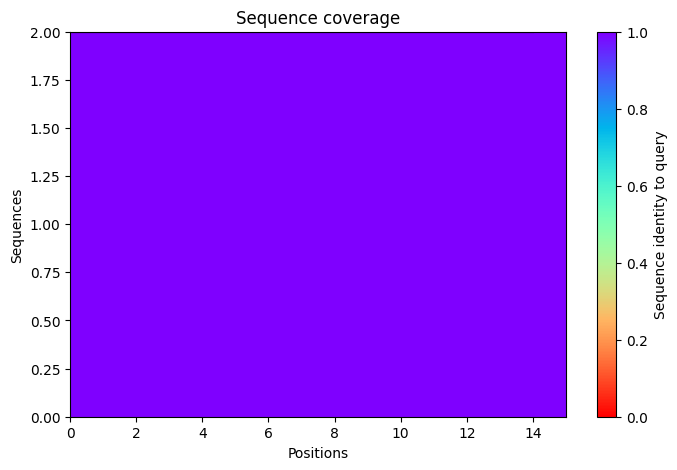

2025-11-17 08:09:20,504 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=63.2 pTM=0.032
2025-11-17 08:09:23,083 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=64.8 pTM=0.0333 tol=0.247
2025-11-17 08:09:25,665 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=64.9 pTM=0.0336 tol=0.385
2025-11-17 08:09:28,245 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=64.8 pTM=0.0334 tol=0.246
2025-11-17 08:09:28,246 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


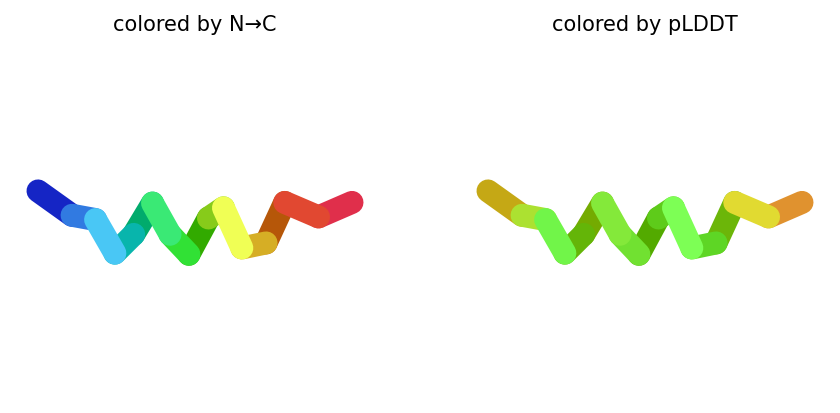

2025-11-17 08:09:30,882 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61 pTM=0.0309
2025-11-17 08:09:33,465 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.5 pTM=0.0298 tol=0.559
2025-11-17 08:09:36,052 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=58.2 pTM=0.0284 tol=1.13
2025-11-17 08:09:38,638 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=58.5 pTM=0.028 tol=0.367
2025-11-17 08:09:38,638 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


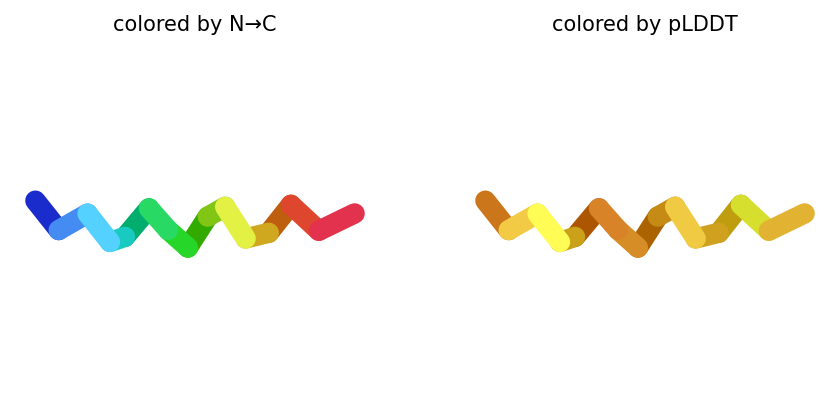

2025-11-17 08:09:41,283 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=61.8 pTM=0.0268
2025-11-17 08:09:43,876 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=62.2 pTM=0.0268 tol=0.492
2025-11-17 08:09:46,469 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=66.1 pTM=0.0274 tol=0.554
2025-11-17 08:09:49,065 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=66.7 pTM=0.0277 tol=0.23
2025-11-17 08:09:49,066 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


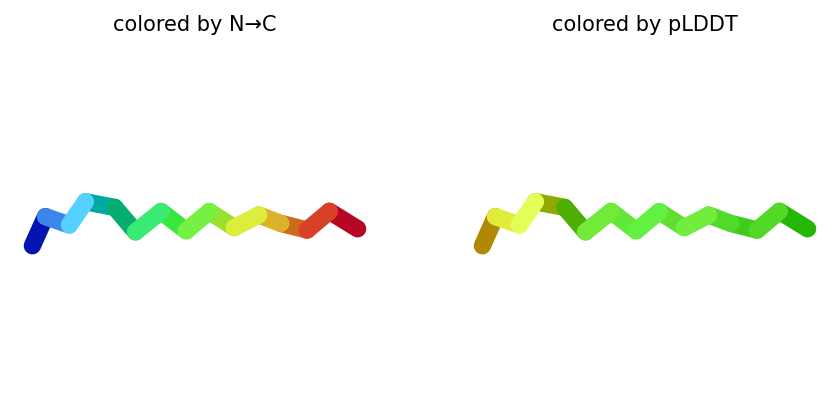

2025-11-17 08:09:51,712 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=57.2 pTM=0.0272
2025-11-17 08:09:54,309 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=61.4 pTM=0.0276 tol=1.59
2025-11-17 08:09:56,903 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=63.9 pTM=0.0277 tol=0.46
2025-11-17 08:09:59,501 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=64.7 pTM=0.0279 tol=0.473
2025-11-17 08:09:59,502 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


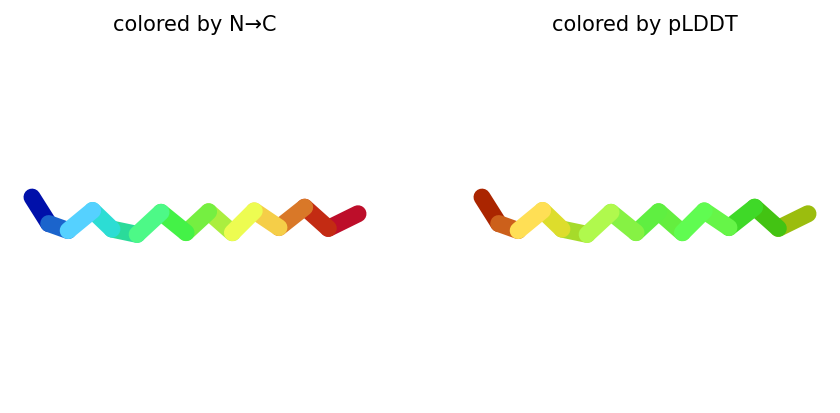

2025-11-17 08:10:02,169 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.6 pTM=0.0334
2025-11-17 08:10:04,756 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.9 pTM=0.0325 tol=0.534
2025-11-17 08:10:07,342 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=62.1 pTM=0.0311 tol=0.746
2025-11-17 08:10:09,932 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=61.4 pTM=0.0306 tol=0.456
2025-11-17 08:10:09,933 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


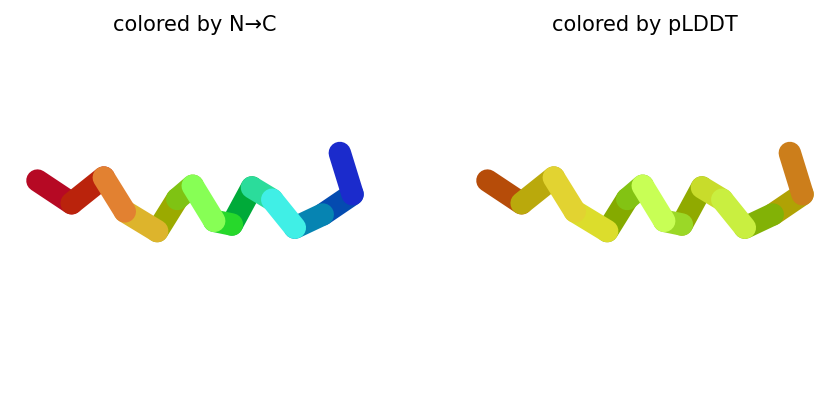

2025-11-17 08:10:09,988 reranking models by 'plddt' metric
2025-11-17 08:10:09,989 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=66.7 pTM=0.0277
2025-11-17 08:10:09,989 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=64.8 pTM=0.0334
2025-11-17 08:10:09,989 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=64.7 pTM=0.0279
2025-11-17 08:10:09,990 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=61.4 pTM=0.0306
2025-11-17 08:10:09,990 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=58.5 pTM=0.028
2025-11-17 08:10:11,583 Query 50/146: peptide_115_IC50_371.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:10:11,872 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


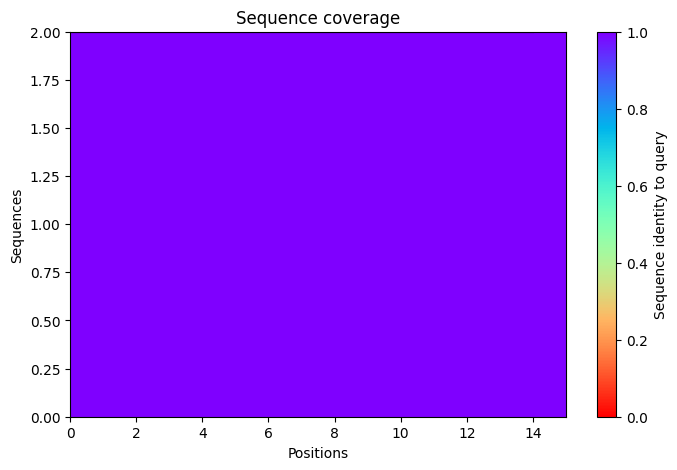

2025-11-17 08:10:21,974 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=84.4 pTM=0.0424
2025-11-17 08:10:24,551 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=86.4 pTM=0.0444 tol=0.0936
2025-11-17 08:10:27,128 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=88.1 pTM=0.0452 tol=0.072
2025-11-17 08:10:29,709 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=89.3 pTM=0.0456 tol=0.0408
2025-11-17 08:10:29,710 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


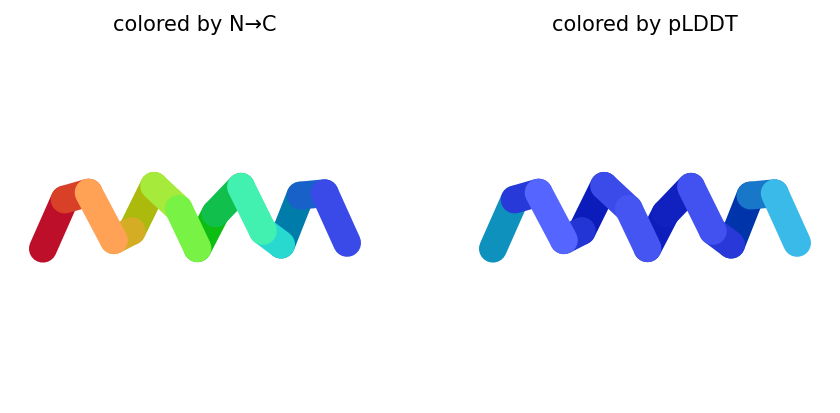

2025-11-17 08:10:32,346 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=76.1 pTM=0.0395
2025-11-17 08:10:34,923 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.2 pTM=0.0392 tol=0.143
2025-11-17 08:10:37,505 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=75 pTM=0.0389 tol=0.0501
2025-11-17 08:10:40,090 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.4 pTM=0.037 tol=0.0574
2025-11-17 08:10:40,091 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


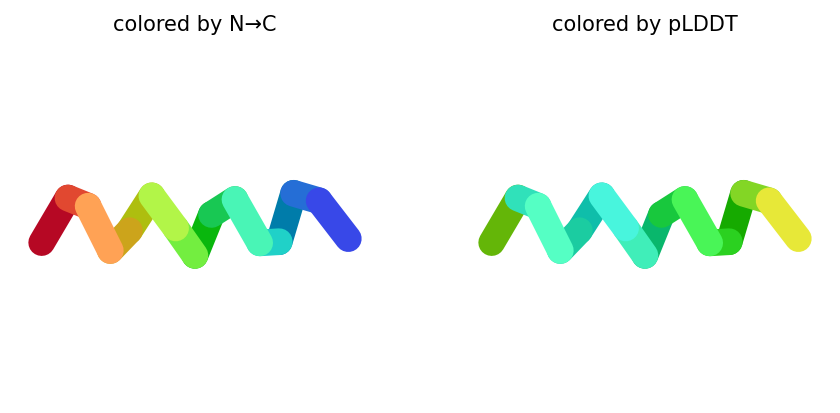

2025-11-17 08:10:42,726 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=82.6 pTM=0.0389
2025-11-17 08:10:45,316 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=80.8 pTM=0.0379 tol=0.145
2025-11-17 08:10:47,913 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=83 pTM=0.0388 tol=0.0579
2025-11-17 08:10:50,508 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=82.8 pTM=0.0389 tol=0.0558
2025-11-17 08:10:50,508 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


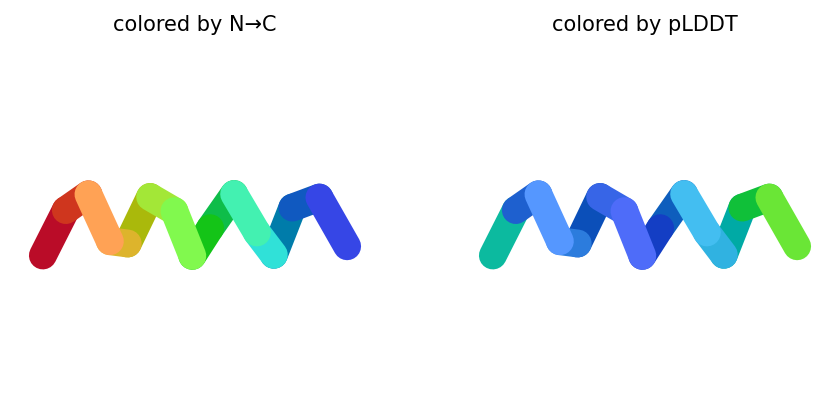

2025-11-17 08:10:53,155 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=87.9 pTM=0.0436
2025-11-17 08:10:55,749 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=88.4 pTM=0.0439 tol=0.105
2025-11-17 08:10:58,338 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=87.3 pTM=0.0429 tol=0.0505
2025-11-17 08:11:00,930 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=89.1 pTM=0.0432 tol=0.0414
2025-11-17 08:11:00,931 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


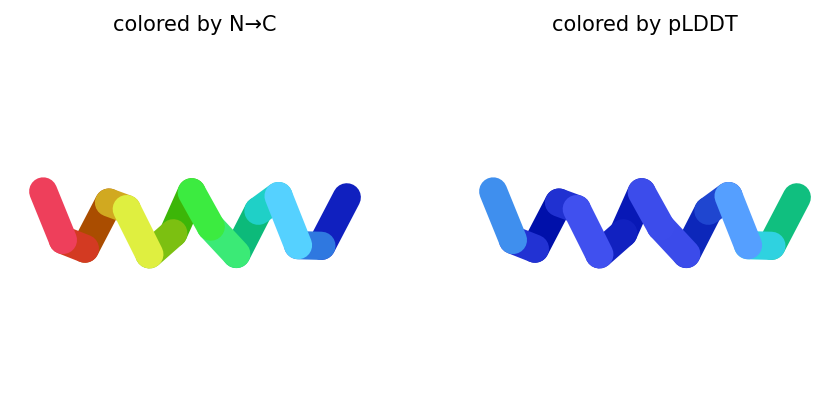

2025-11-17 08:11:03,602 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=88.8 pTM=0.0419
2025-11-17 08:11:06,190 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=89.6 pTM=0.0431 tol=0.0822
2025-11-17 08:11:08,774 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=89.6 pTM=0.043 tol=0.048
2025-11-17 08:11:11,363 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=90.3 pTM=0.0434 tol=0.082
2025-11-17 08:11:11,363 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


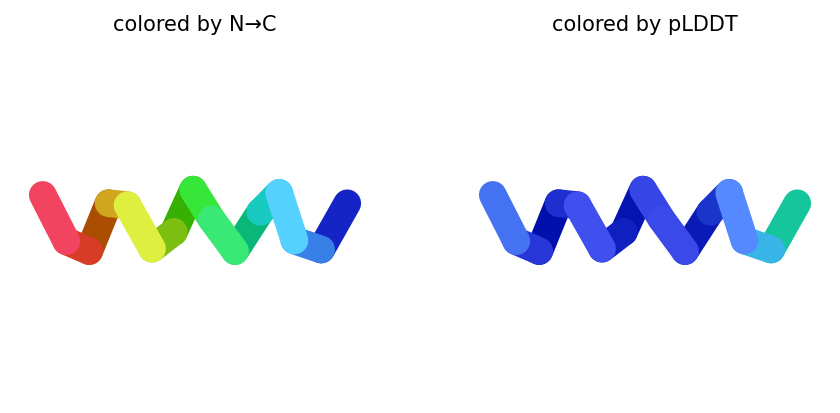

2025-11-17 08:11:11,416 reranking models by 'plddt' metric
2025-11-17 08:11:11,416 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=90.3 pTM=0.0434
2025-11-17 08:11:11,416 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=89.3 pTM=0.0456
2025-11-17 08:11:11,417 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=89.1 pTM=0.0432
2025-11-17 08:11:11,417 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=82.8 pTM=0.0389
2025-11-17 08:11:11,417 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.4 pTM=0.037
2025-11-17 08:11:12,667 Query 51/146: peptide_116_IC50_379.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:11:12,947 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


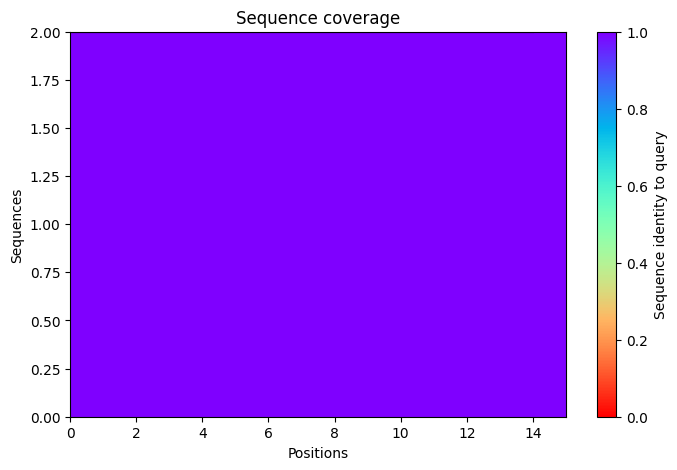

2025-11-17 08:11:25,076 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=79.4 pTM=0.0381
2025-11-17 08:11:27,655 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83.1 pTM=0.0402 tol=0.0999
2025-11-17 08:11:30,236 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=83.9 pTM=0.0405 tol=0.0492
2025-11-17 08:11:32,815 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=83.6 pTM=0.0406 tol=0.0331
2025-11-17 08:11:32,816 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


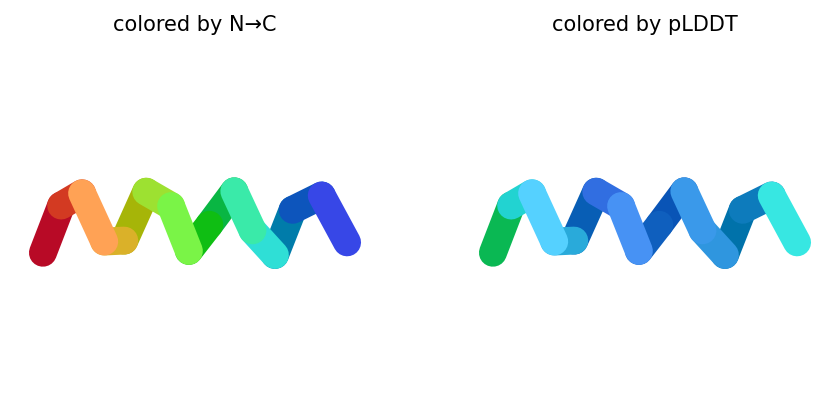

2025-11-17 08:11:35,459 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.6 pTM=0.0318
2025-11-17 08:11:38,045 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.9 pTM=0.0337 tol=0.246
2025-11-17 08:11:40,636 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.4 pTM=0.0324 tol=0.087
2025-11-17 08:11:43,223 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.6 pTM=0.0319 tol=0.122
2025-11-17 08:11:43,224 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


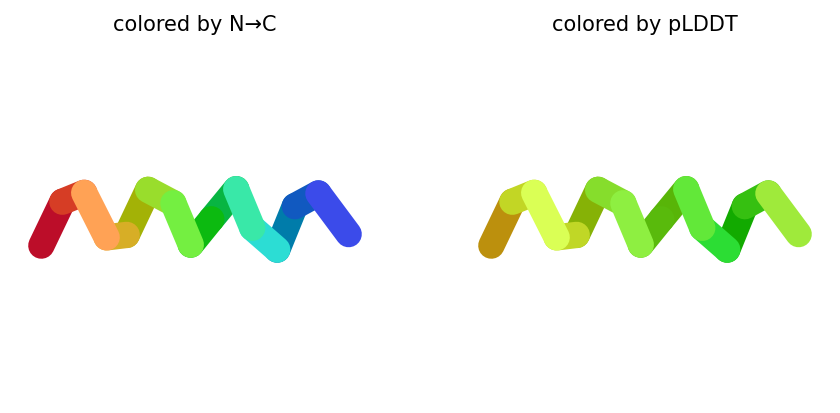

2025-11-17 08:11:45,867 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=63.8 pTM=0.0267
2025-11-17 08:11:48,463 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=60.7 pTM=0.0262 tol=1.06
2025-11-17 08:11:51,059 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=64.6 pTM=0.0267 tol=1.46
2025-11-17 08:11:53,657 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=68.4 pTM=0.0276 tol=1.26
2025-11-17 08:11:53,658 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


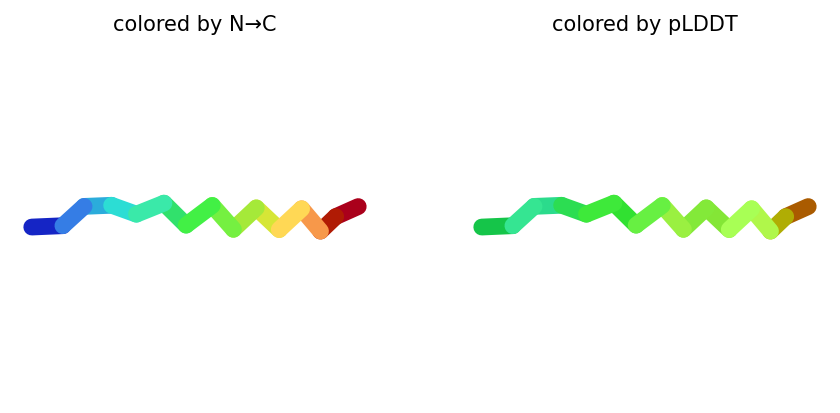

2025-11-17 08:11:56,308 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.8 pTM=0.0264
2025-11-17 08:11:58,904 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=65 pTM=0.0269 tol=1.17
2025-11-17 08:12:01,503 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.4 pTM=0.0271 tol=0.804
2025-11-17 08:12:04,097 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=72.1 pTM=0.0272 tol=0.219
2025-11-17 08:12:04,098 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


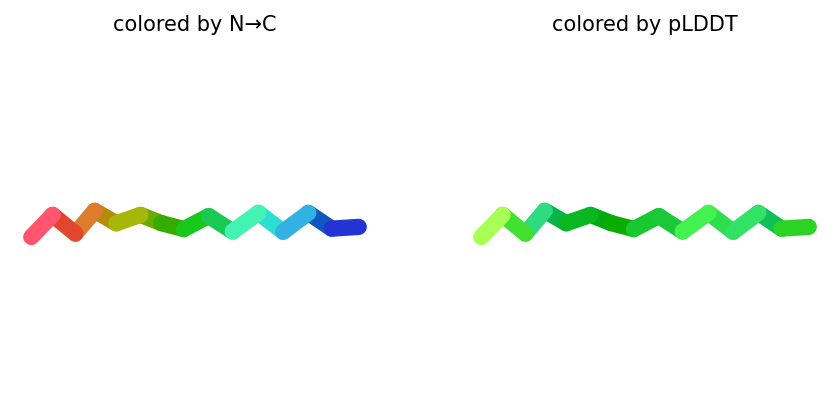

2025-11-17 08:12:06,739 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=80.3 pTM=0.0379
2025-11-17 08:12:09,326 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=87.2 pTM=0.0414 tol=0.171
2025-11-17 08:12:11,915 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=86.2 pTM=0.0401 tol=0.0555
2025-11-17 08:12:14,502 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=84.6 pTM=0.0392 tol=0.0323
2025-11-17 08:12:14,503 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


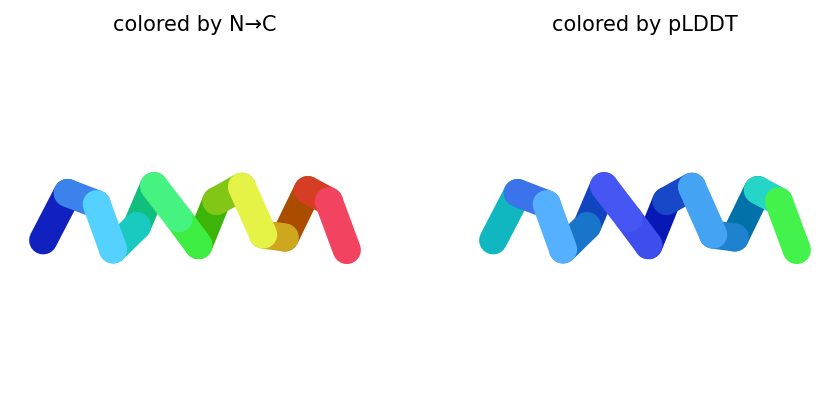

2025-11-17 08:12:14,576 reranking models by 'plddt' metric
2025-11-17 08:12:14,577 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=84.6 pTM=0.0392
2025-11-17 08:12:14,577 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=83.6 pTM=0.0406
2025-11-17 08:12:14,577 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=72.1 pTM=0.0272
2025-11-17 08:12:14,578 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=68.4 pTM=0.0276
2025-11-17 08:12:14,578 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=65.6 pTM=0.0319
2025-11-17 08:12:15,874 Query 52/146: peptide_118_IC50_373.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:12:16,157 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


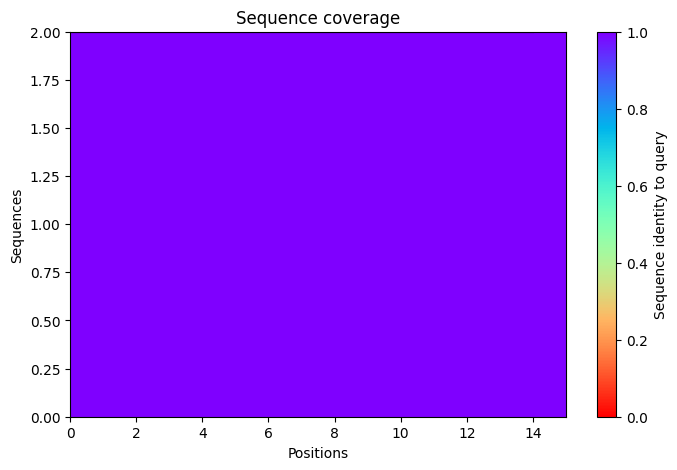

2025-11-17 08:12:30,942 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.9 pTM=0.0329
2025-11-17 08:12:33,516 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=71.6 pTM=0.0346 tol=0.726
2025-11-17 08:12:36,093 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.2 pTM=0.0351 tol=0.259
2025-11-17 08:12:38,670 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.1 pTM=0.0354 tol=0.483
2025-11-17 08:12:38,671 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


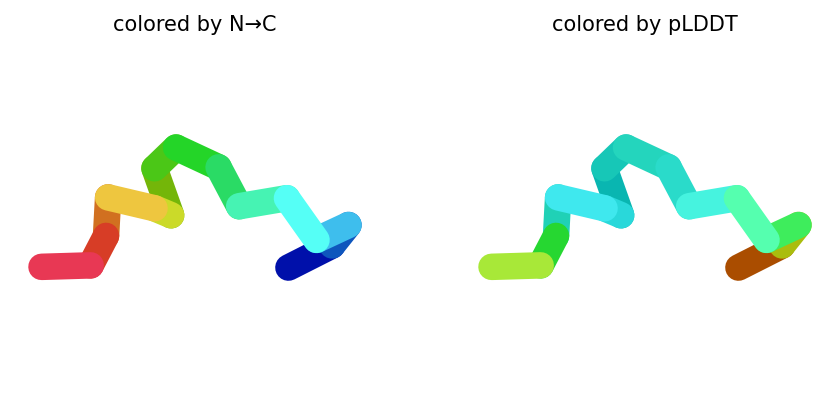

2025-11-17 08:12:41,333 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.1 pTM=0.031
2025-11-17 08:12:43,912 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=65 pTM=0.0305 tol=0.524
2025-11-17 08:12:46,495 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.6 pTM=0.0302 tol=1.32
2025-11-17 08:12:49,082 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.1 pTM=0.031 tol=0.607
2025-11-17 08:12:49,083 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


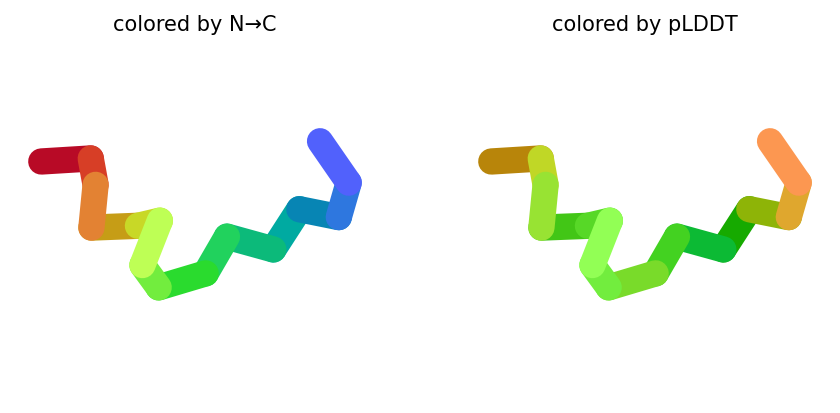

2025-11-17 08:12:51,724 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=68.6 pTM=0.029
2025-11-17 08:12:54,317 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=69.2 pTM=0.0298 tol=0.381
2025-11-17 08:12:56,912 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=68 pTM=0.0282 tol=0.268
2025-11-17 08:12:59,506 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=68.5 pTM=0.0287 tol=0.598
2025-11-17 08:12:59,507 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


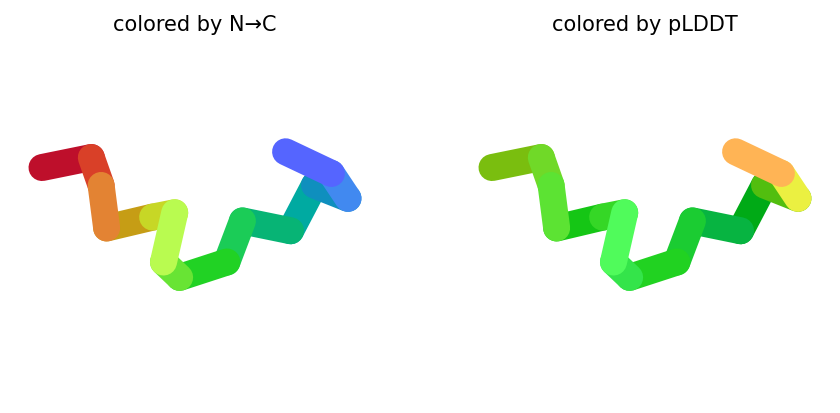

2025-11-17 08:13:02,160 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.1 pTM=0.0334
2025-11-17 08:13:04,761 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.1 pTM=0.0349 tol=0.165
2025-11-17 08:13:07,363 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.3 pTM=0.0344 tol=0.312
2025-11-17 08:13:09,962 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.6 pTM=0.0353 tol=0.144
2025-11-17 08:13:09,963 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


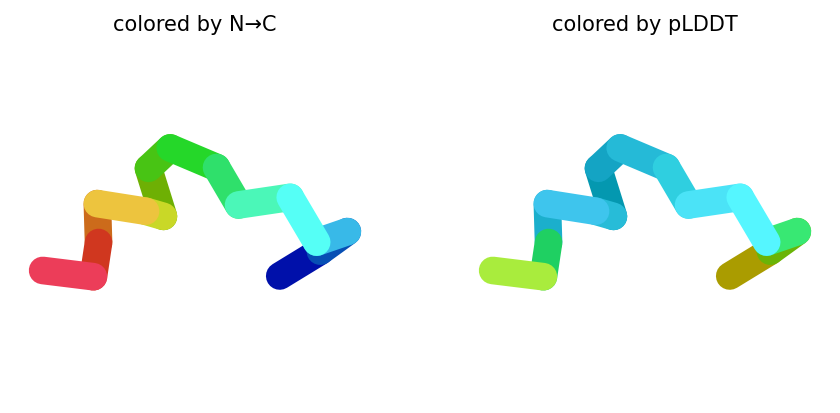

2025-11-17 08:13:12,620 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.8 pTM=0.0308
2025-11-17 08:13:15,217 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.9 pTM=0.0322 tol=0.496
2025-11-17 08:13:17,811 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=71.2 pTM=0.0321 tol=0.205
2025-11-17 08:13:20,401 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=71.9 pTM=0.032 tol=0.301
2025-11-17 08:13:20,402 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


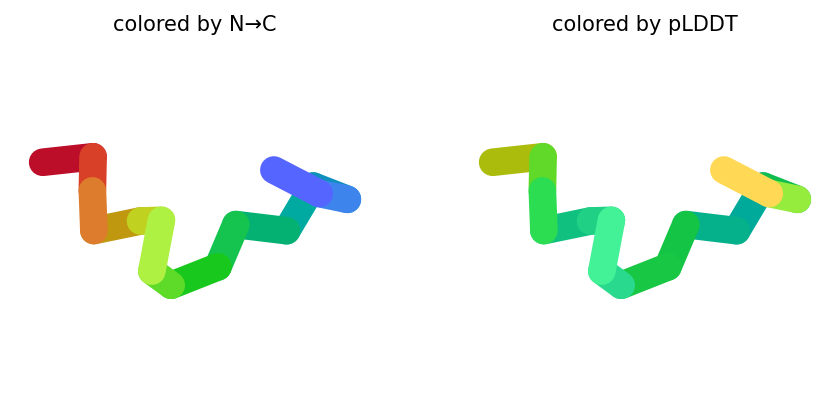

2025-11-17 08:13:20,453 reranking models by 'plddt' metric
2025-11-17 08:13:20,453 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=76.6 pTM=0.0353
2025-11-17 08:13:20,453 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=74.1 pTM=0.0354
2025-11-17 08:13:20,455 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=71.9 pTM=0.032
2025-11-17 08:13:20,455 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=68.5 pTM=0.0287
2025-11-17 08:13:20,455 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=65.1 pTM=0.031
2025-11-17 08:13:21,896 Query 53/146: peptide_121_IC50_370.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:13:22,185 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


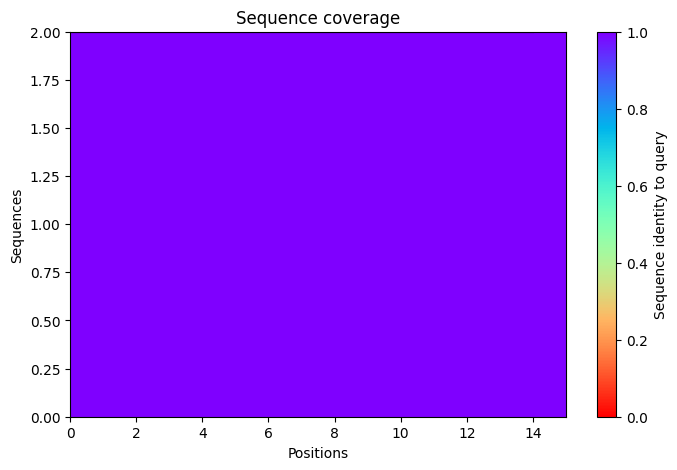

2025-11-17 08:13:33,335 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=62.4 pTM=0.0277
2025-11-17 08:13:35,911 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=68.2 pTM=0.0324 tol=5.56
2025-11-17 08:13:38,490 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=68.8 pTM=0.0339 tol=0.214
2025-11-17 08:13:41,066 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.2 pTM=0.0333 tol=0.0547
2025-11-17 08:13:41,067 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


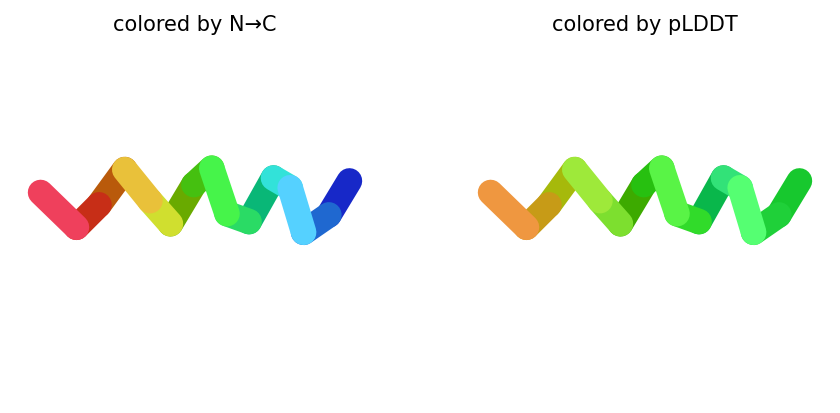

2025-11-17 08:13:43,699 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.1 pTM=0.0267
2025-11-17 08:13:46,277 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.8 pTM=0.0272 tol=0.584
2025-11-17 08:13:48,859 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.8 pTM=0.0283 tol=0.913
2025-11-17 08:13:51,442 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=62.7 pTM=0.0301 tol=0.888
2025-11-17 08:13:51,443 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


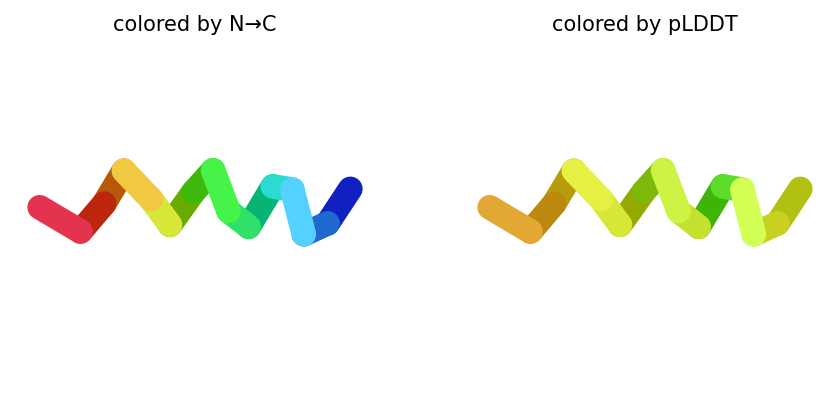

2025-11-17 08:13:54,098 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=66.2 pTM=0.0259
2025-11-17 08:13:56,686 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.8 pTM=0.0265 tol=0.489
2025-11-17 08:13:59,277 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.1 pTM=0.0277 tol=0.294
2025-11-17 08:14:01,871 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.8 pTM=0.0295 tol=0.188
2025-11-17 08:14:01,872 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


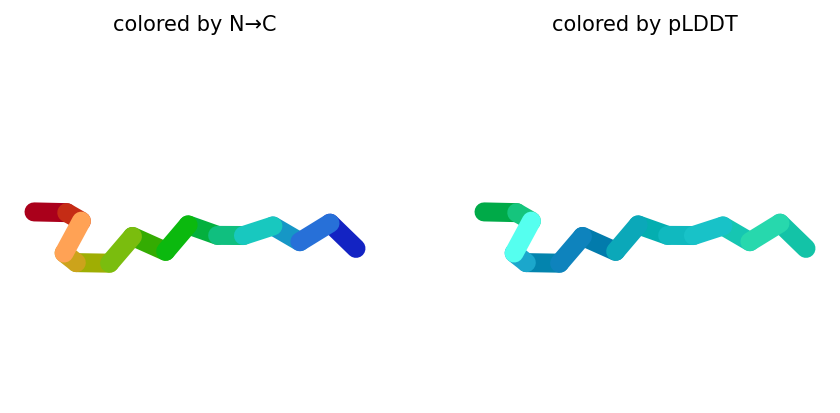

2025-11-17 08:14:04,518 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=67.5 pTM=0.0267
2025-11-17 08:14:07,115 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=67.1 pTM=0.0272 tol=0.532
2025-11-17 08:14:09,710 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=66.4 pTM=0.028 tol=0.229
2025-11-17 08:14:12,300 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=66.9 pTM=0.0282 tol=0.153
2025-11-17 08:14:12,300 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


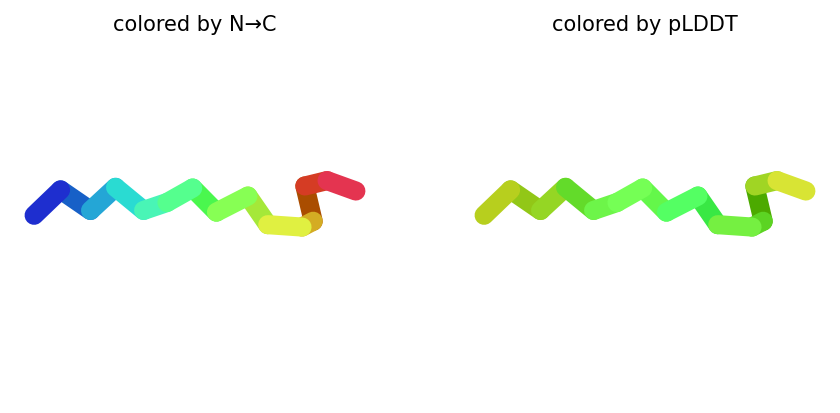

2025-11-17 08:14:14,940 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=61.2 pTM=0.0265
2025-11-17 08:14:17,527 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.8 pTM=0.0277 tol=2.55
2025-11-17 08:14:20,116 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63.5 pTM=0.0289 tol=1.58
2025-11-17 08:14:22,702 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63 pTM=0.0288 tol=0.294
2025-11-17 08:14:22,703 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


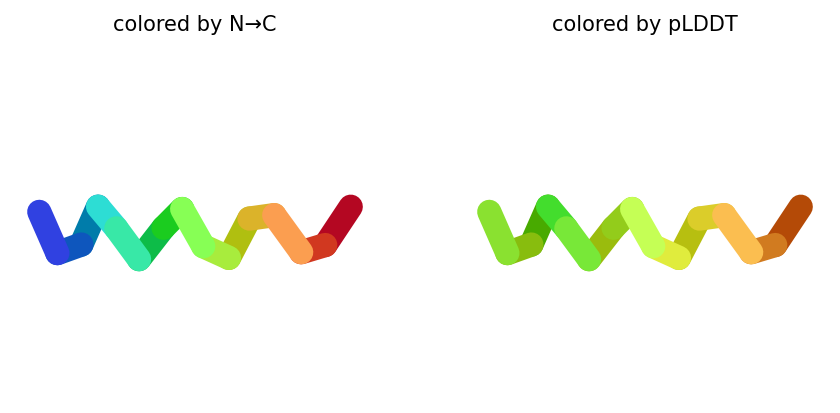

2025-11-17 08:14:22,753 reranking models by 'plddt' metric
2025-11-17 08:14:22,753 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=80.8 pTM=0.0295
2025-11-17 08:14:22,754 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=68.2 pTM=0.0333
2025-11-17 08:14:22,754 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=66.9 pTM=0.0282
2025-11-17 08:14:22,754 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=63 pTM=0.0288
2025-11-17 08:14:22,754 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=62.7 pTM=0.0301
2025-11-17 08:14:23,782 Query 54/146: peptide_123_IC50_367.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:14:24,052 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


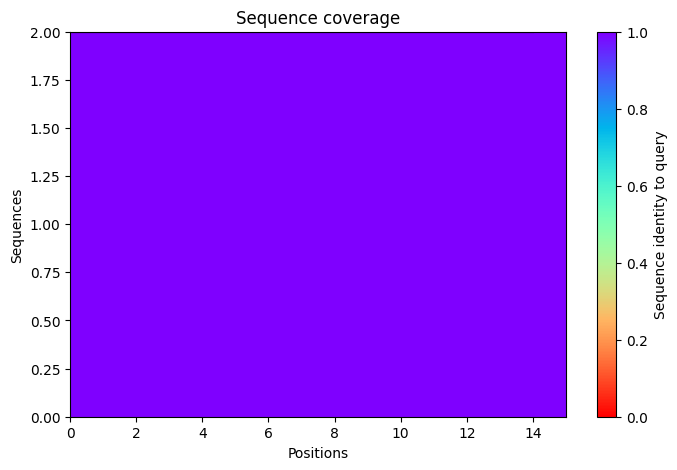

2025-11-17 08:14:37,182 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.8 pTM=0.0298
2025-11-17 08:14:39,761 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=60.8 pTM=0.03 tol=0.616
2025-11-17 08:14:42,342 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=61.4 pTM=0.0296 tol=0.452
2025-11-17 08:14:44,921 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=60.5 pTM=0.029 tol=0.952
2025-11-17 08:14:44,922 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


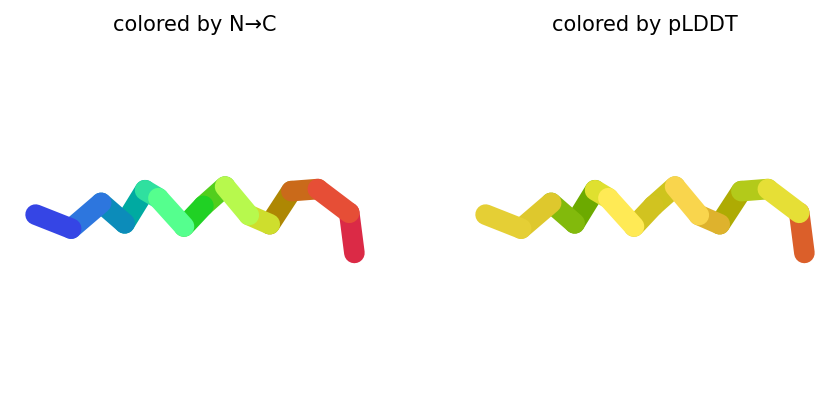

2025-11-17 08:14:47,557 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61 pTM=0.0277
2025-11-17 08:14:50,139 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63 pTM=0.0275 tol=1.54
2025-11-17 08:14:52,727 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.4 pTM=0.0277 tol=0.628
2025-11-17 08:14:55,319 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.4 pTM=0.0276 tol=0.223
2025-11-17 08:14:55,320 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


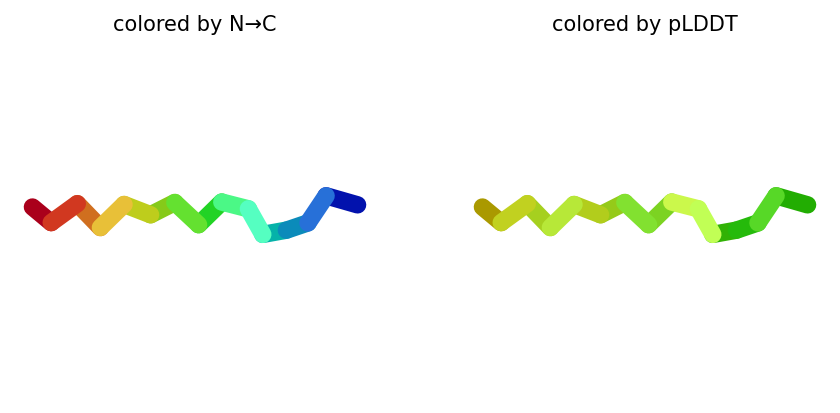

2025-11-17 08:14:57,970 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=67.6 pTM=0.0274
2025-11-17 08:15:00,565 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.4 pTM=0.0279 tol=0.509
2025-11-17 08:15:03,162 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.3 pTM=0.0279 tol=0.21
2025-11-17 08:15:05,762 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=73 pTM=0.0279 tol=0.0589
2025-11-17 08:15:05,763 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


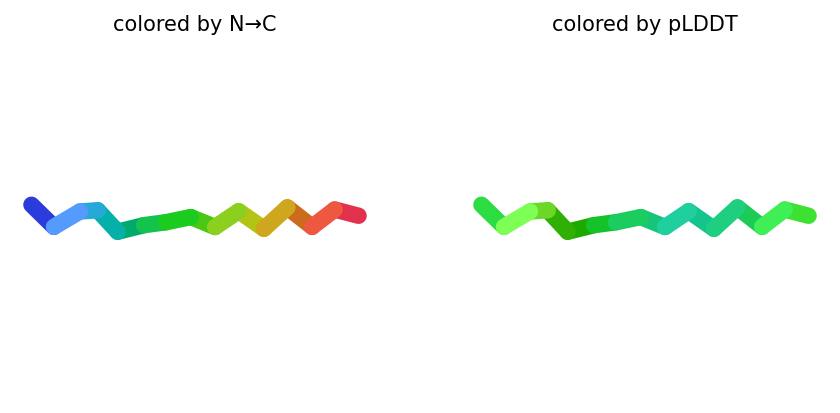

2025-11-17 08:15:08,415 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=64.2 pTM=0.0271
2025-11-17 08:15:11,007 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=67.6 pTM=0.0278 tol=0.724
2025-11-17 08:15:13,601 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.4 pTM=0.0279 tol=0.388
2025-11-17 08:15:16,196 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.4 pTM=0.0278 tol=0.251
2025-11-17 08:15:16,197 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


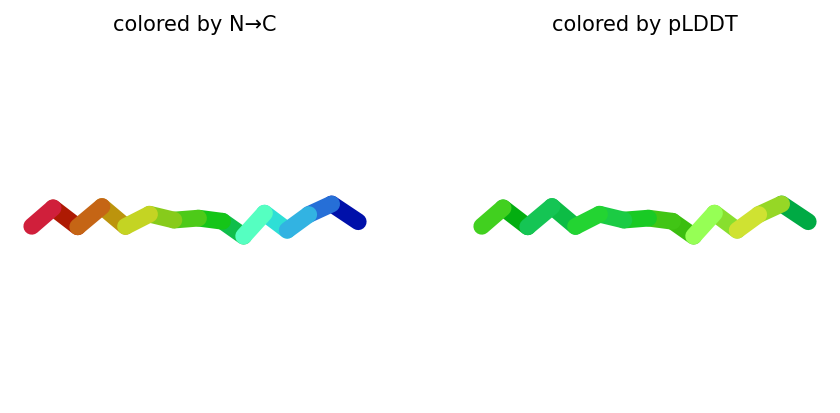

2025-11-17 08:15:18,861 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=64.1 pTM=0.0303
2025-11-17 08:15:21,445 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.5 pTM=0.0269 tol=2.2
2025-11-17 08:15:24,033 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=61.7 pTM=0.0267 tol=2.26
2025-11-17 08:15:26,616 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.6 pTM=0.0267 tol=0.798
2025-11-17 08:15:26,617 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


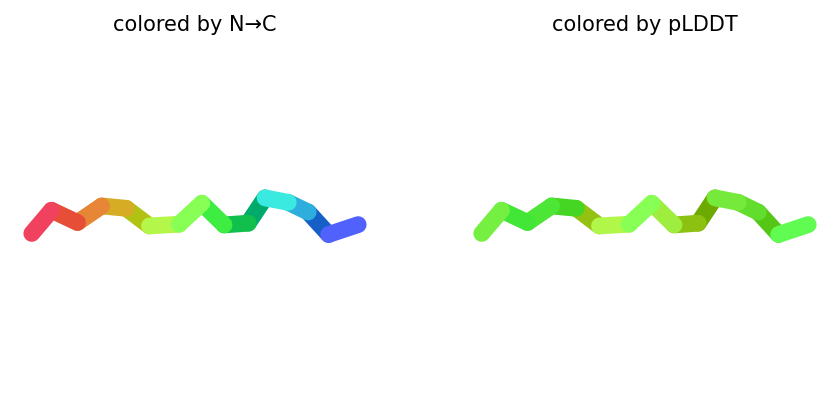

2025-11-17 08:15:26,665 reranking models by 'plddt' metric
2025-11-17 08:15:26,665 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=73 pTM=0.0279
2025-11-17 08:15:26,665 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=70.4 pTM=0.0278
2025-11-17 08:15:26,666 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=67.6 pTM=0.0267
2025-11-17 08:15:26,666 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=65.4 pTM=0.0276
2025-11-17 08:15:26,666 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=60.5 pTM=0.029
2025-11-17 08:15:27,773 Query 55/146: peptide_125_IC50_369.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:15:28,064 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


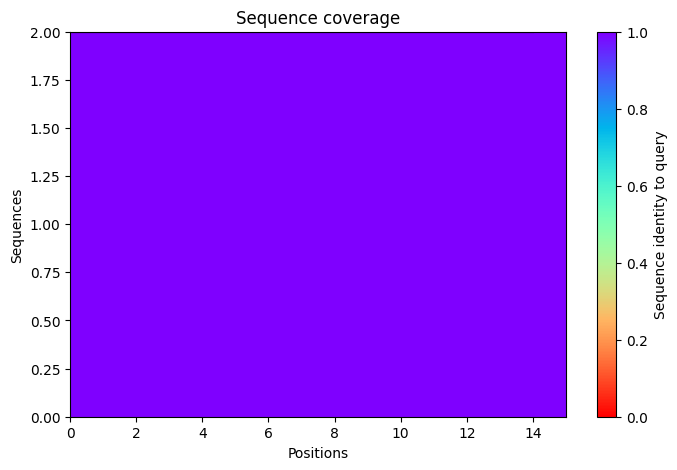

2025-11-17 08:15:40,205 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=77.5 pTM=0.0338
2025-11-17 08:15:42,784 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.2 pTM=0.0367 tol=0.251
2025-11-17 08:15:45,361 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81.8 pTM=0.037 tol=0.174
2025-11-17 08:15:47,940 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=80.9 pTM=0.0357 tol=0.29
2025-11-17 08:15:47,940 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


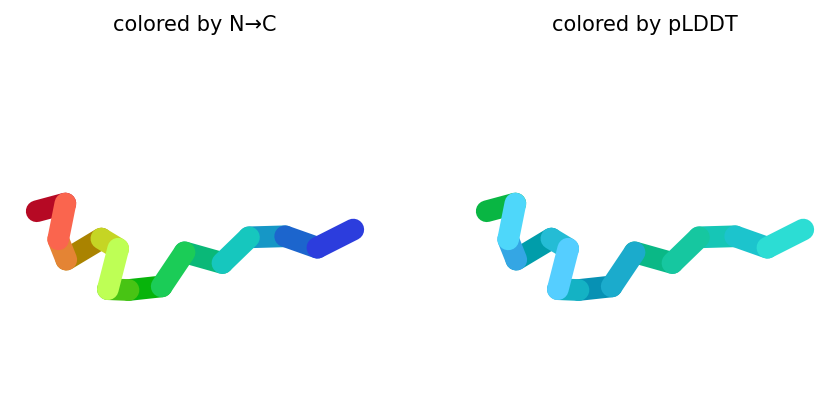

2025-11-17 08:15:50,574 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70.7 pTM=0.0317
2025-11-17 08:15:53,155 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.8 pTM=0.0348 tol=0.214
2025-11-17 08:15:55,740 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.6 pTM=0.0352 tol=0.117
2025-11-17 08:15:58,322 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.9 pTM=0.0326 tol=0.0751
2025-11-17 08:15:58,322 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


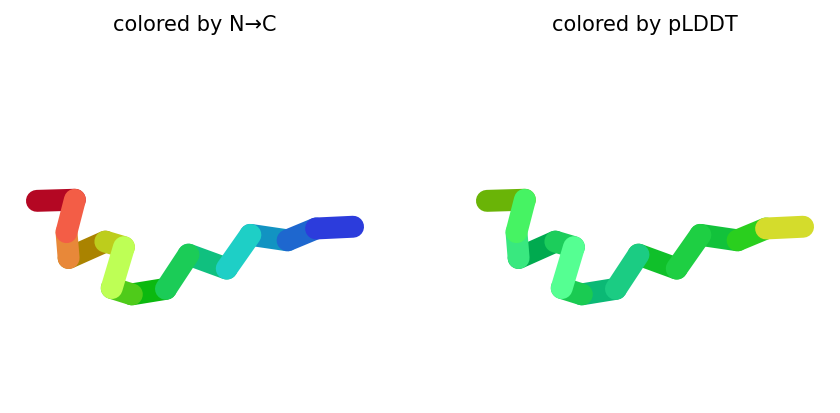

2025-11-17 08:16:00,966 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.4 pTM=0.0276
2025-11-17 08:16:03,557 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.8 pTM=0.0282 tol=1.81
2025-11-17 08:16:06,149 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=73.6 pTM=0.0284 tol=0.221
2025-11-17 08:16:08,743 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.6 pTM=0.0282 tol=0.522
2025-11-17 08:16:08,744 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


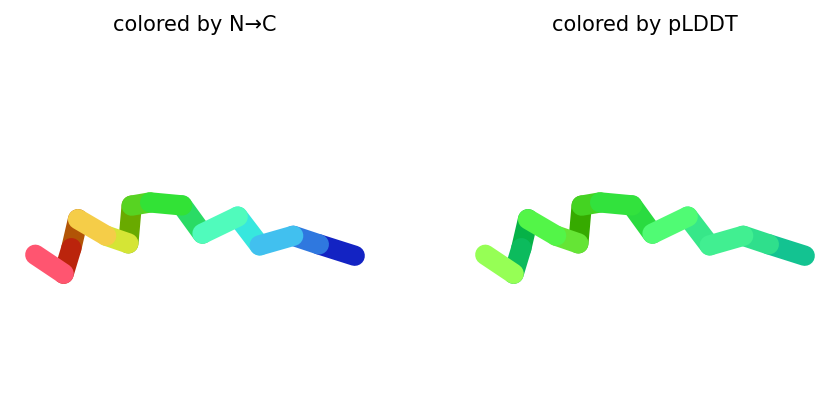

2025-11-17 08:16:11,395 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73 pTM=0.0312
2025-11-17 08:16:13,992 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.6 pTM=0.0323 tol=0.302
2025-11-17 08:16:16,590 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72.4 pTM=0.032 tol=0.0767
2025-11-17 08:16:19,188 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=72.4 pTM=0.0314 tol=0.0609
2025-11-17 08:16:19,189 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


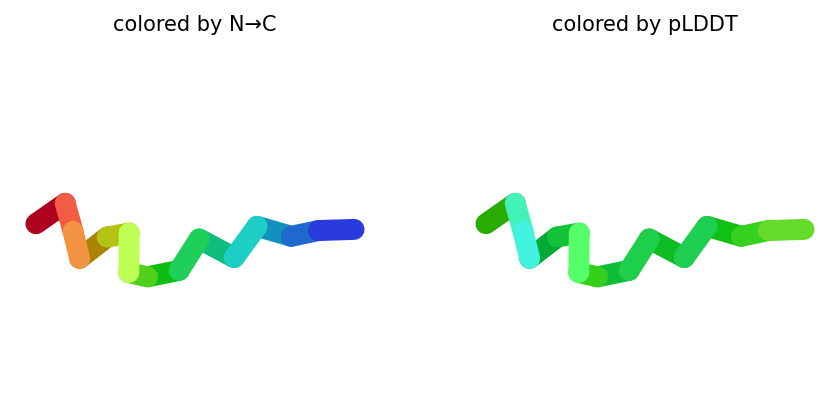

2025-11-17 08:16:21,835 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=72.1 pTM=0.0302
2025-11-17 08:16:24,427 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=68.1 pTM=0.0283 tol=0.284
2025-11-17 08:16:27,017 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=67.3 pTM=0.0288 tol=0.36
2025-11-17 08:16:29,609 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.3 pTM=0.0291 tol=0.287
2025-11-17 08:16:29,609 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


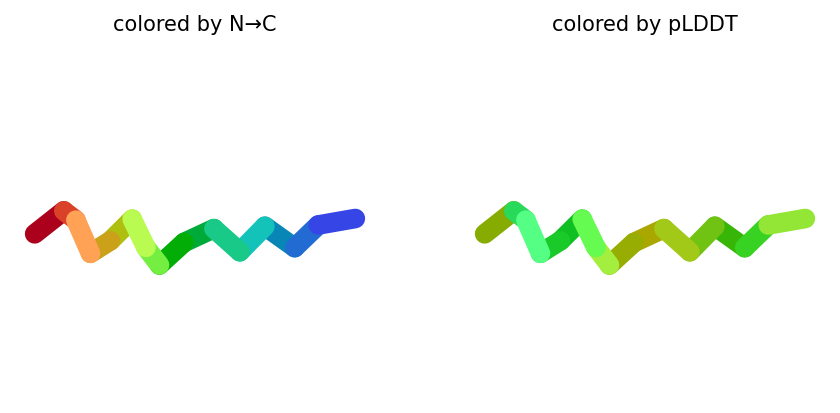

2025-11-17 08:16:29,682 reranking models by 'plddt' metric
2025-11-17 08:16:29,683 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=80.9 pTM=0.0357
2025-11-17 08:16:29,683 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=72.6 pTM=0.0282
2025-11-17 08:16:29,683 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=72.4 pTM=0.0314
2025-11-17 08:16:29,683 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=71.9 pTM=0.0326
2025-11-17 08:16:29,684 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=67.3 pTM=0.0291
2025-11-17 08:16:31,389 Query 56/146: peptide_126_IC50_368.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:16:32,012 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


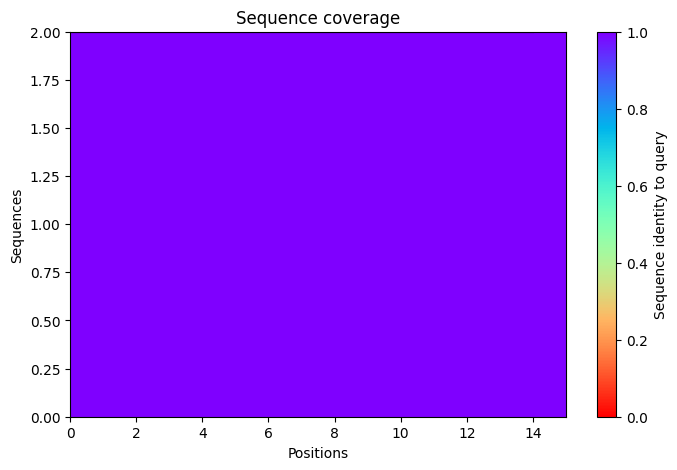

2025-11-17 08:16:43,141 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.9 pTM=0.0329
2025-11-17 08:16:45,717 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=67.7 pTM=0.0341 tol=0.188
2025-11-17 08:16:48,298 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=68.6 pTM=0.0344 tol=0.169
2025-11-17 08:16:50,876 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=70.3 pTM=0.0354 tol=0.199
2025-11-17 08:16:50,876 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


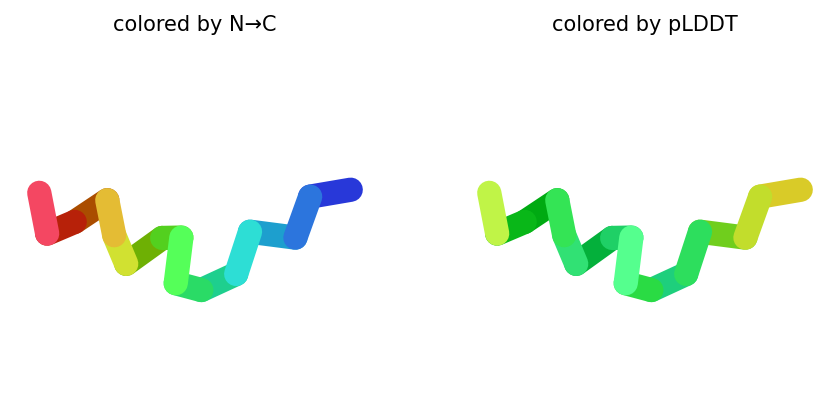

2025-11-17 08:16:53,510 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.2 pTM=0.031
2025-11-17 08:16:56,094 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=62.9 pTM=0.0317 tol=0.179
2025-11-17 08:16:58,676 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63 pTM=0.0318 tol=0.105
2025-11-17 08:17:01,262 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=64.4 pTM=0.032 tol=0.179
2025-11-17 08:17:01,263 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


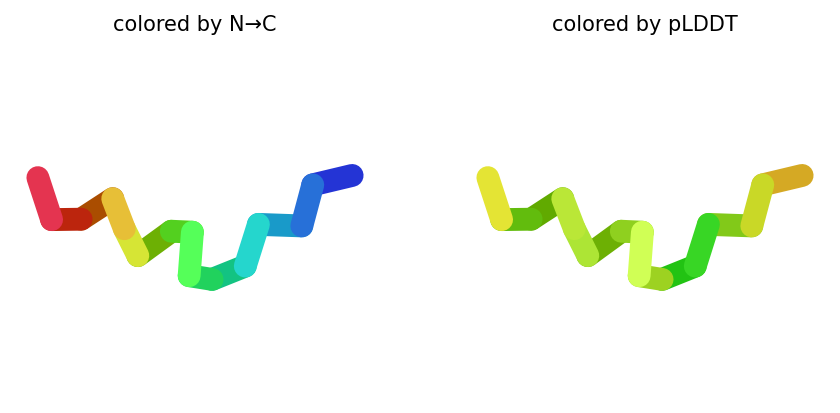

2025-11-17 08:17:03,907 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.4 pTM=0.0287
2025-11-17 08:17:06,499 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=64.6 pTM=0.028 tol=0.725
2025-11-17 08:17:09,094 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.1 pTM=0.028 tol=0.134
2025-11-17 08:17:11,689 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=66.3 pTM=0.0284 tol=0.716
2025-11-17 08:17:11,689 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


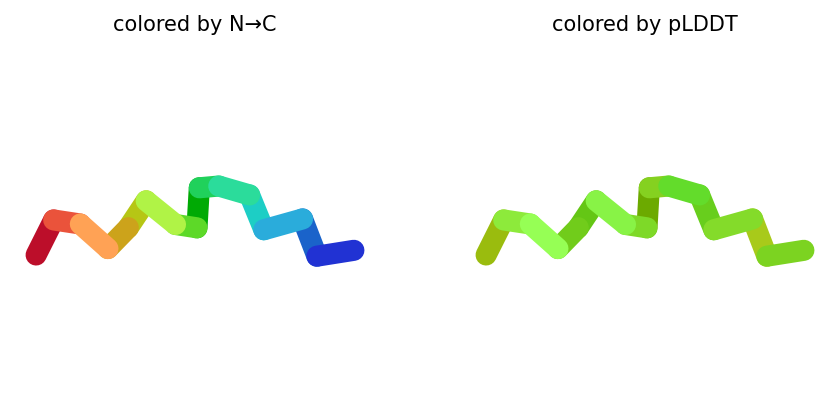

2025-11-17 08:17:14,339 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=67.8 pTM=0.0307
2025-11-17 08:17:16,933 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.2 pTM=0.0321 tol=0.503
2025-11-17 08:17:19,526 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.1 pTM=0.0316 tol=0.139
2025-11-17 08:17:22,114 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=73.1 pTM=0.0324 tol=0.219
2025-11-17 08:17:22,115 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


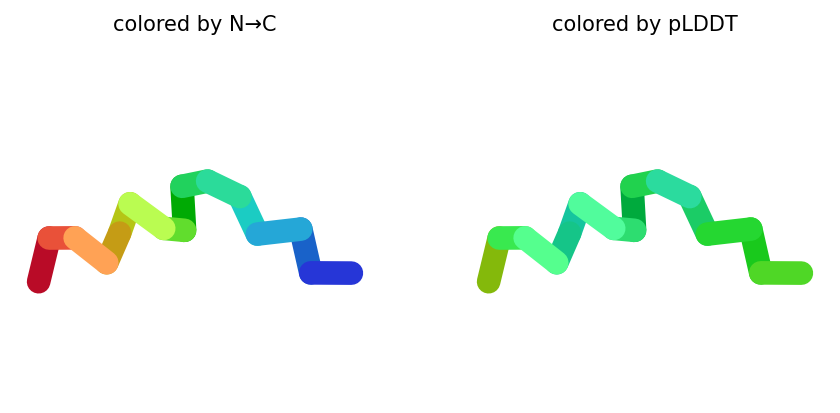

2025-11-17 08:17:24,757 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=65.2 pTM=0.029
2025-11-17 08:17:27,345 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=64.3 pTM=0.0282 tol=0.91
2025-11-17 08:17:29,935 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64 pTM=0.0278 tol=0.673
2025-11-17 08:17:32,522 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.6 pTM=0.028 tol=0.453
2025-11-17 08:17:32,523 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


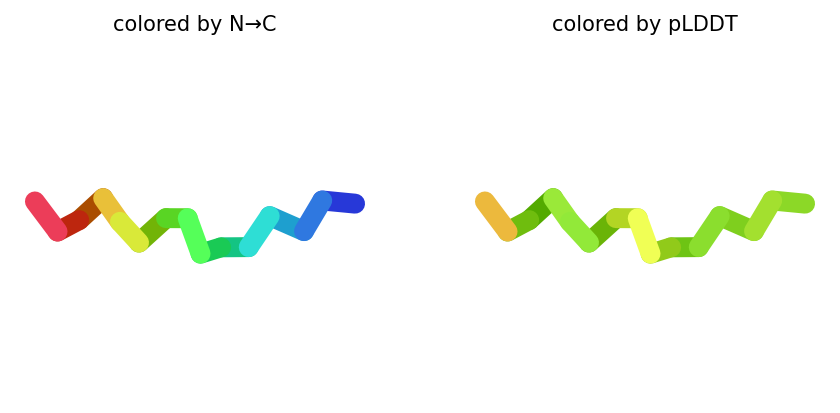

2025-11-17 08:17:32,573 reranking models by 'plddt' metric
2025-11-17 08:17:32,574 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=73.1 pTM=0.0324
2025-11-17 08:17:32,574 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=70.3 pTM=0.0354
2025-11-17 08:17:32,575 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=66.3 pTM=0.0284
2025-11-17 08:17:32,575 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=64.6 pTM=0.028
2025-11-17 08:17:32,575 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=64.4 pTM=0.032
2025-11-17 08:17:33,652 Query 57/146: peptide_127_IC50_382.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:17:33,930 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


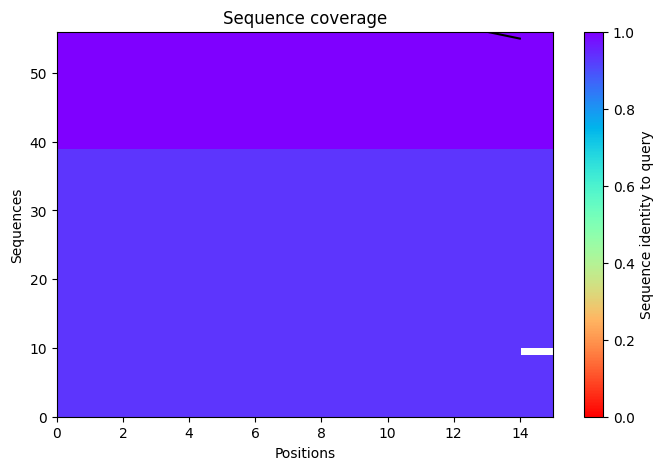

2025-11-17 08:17:47,461 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.6 pTM=0.0371
2025-11-17 08:17:50,041 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.9 pTM=0.041 tol=0.238
2025-11-17 08:17:52,619 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=84.9 pTM=0.0429 tol=0.088
2025-11-17 08:17:55,204 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=85.1 pTM=0.0437 tol=0.0609
2025-11-17 08:17:55,205 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


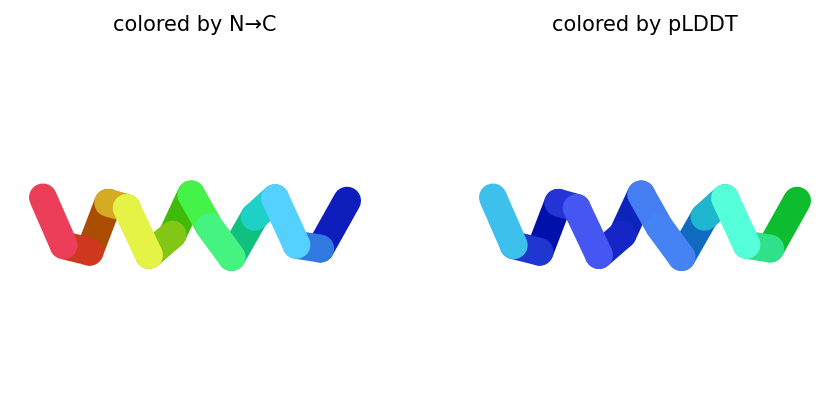

2025-11-17 08:17:57,874 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.1 pTM=0.0385
2025-11-17 08:18:00,459 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.7 pTM=0.0389 tol=0.0659
2025-11-17 08:18:03,046 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=79.2 pTM=0.0401 tol=0.0576
2025-11-17 08:18:05,632 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=79.4 pTM=0.0405 tol=0.0781
2025-11-17 08:18:05,633 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


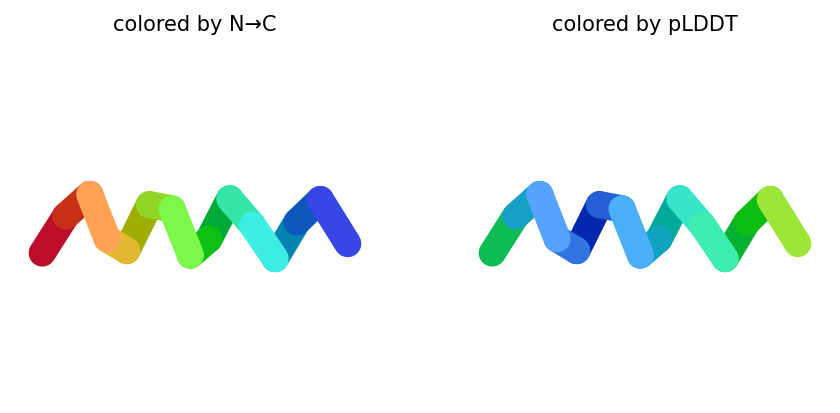

2025-11-17 08:18:08,283 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=80.2 pTM=0.0377
2025-11-17 08:18:10,880 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=81 pTM=0.0378 tol=0.101
2025-11-17 08:18:13,477 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=82 pTM=0.0389 tol=0.0609
2025-11-17 08:18:16,075 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=83.1 pTM=0.0403 tol=0.0279
2025-11-17 08:18:16,076 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


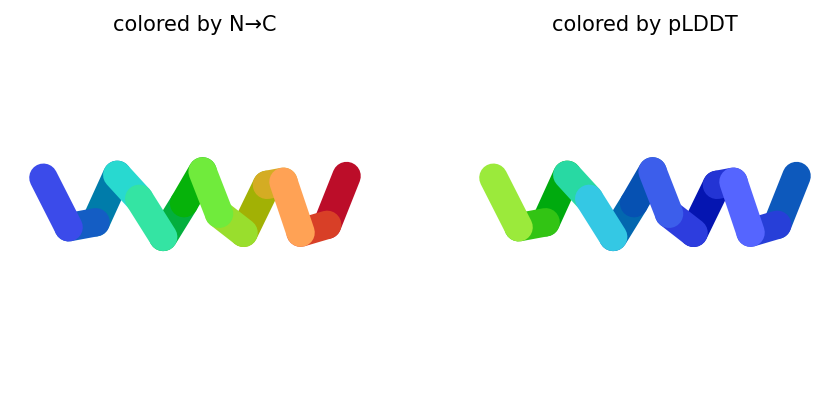

2025-11-17 08:18:18,737 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.5 pTM=0.0342
2025-11-17 08:18:21,336 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=80.1 pTM=0.0373 tol=0.621
2025-11-17 08:18:23,935 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=85.5 pTM=0.041 tol=0.125
2025-11-17 08:18:26,531 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=85.9 pTM=0.0415 tol=0.0511
2025-11-17 08:18:26,532 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


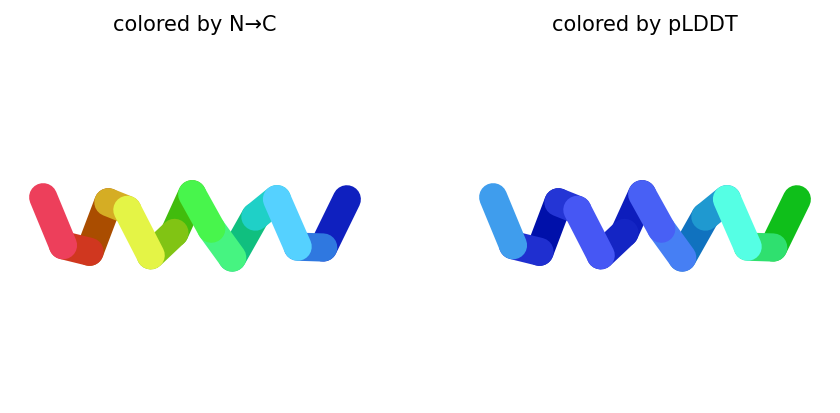

2025-11-17 08:18:29,180 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=85.9 pTM=0.0433
2025-11-17 08:18:31,777 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=86.7 pTM=0.0437 tol=0.062
2025-11-17 08:18:34,372 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=88.4 pTM=0.0446 tol=0.0502
2025-11-17 08:18:36,964 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=87.7 pTM=0.0444 tol=0.0264
2025-11-17 08:18:36,965 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


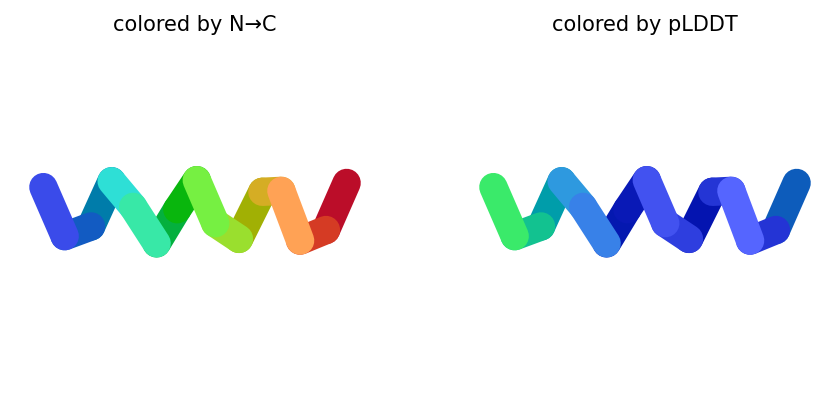

2025-11-17 08:18:37,018 reranking models by 'plddt' metric
2025-11-17 08:18:37,018 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=87.7 pTM=0.0444
2025-11-17 08:18:37,019 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=85.9 pTM=0.0415
2025-11-17 08:18:37,019 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=85.1 pTM=0.0437
2025-11-17 08:18:37,019 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=83.1 pTM=0.0403
2025-11-17 08:18:37,019 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=79.4 pTM=0.0405
2025-11-17 08:18:38,077 Query 58/146: peptide_128_IC50_380.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:18:38,372 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


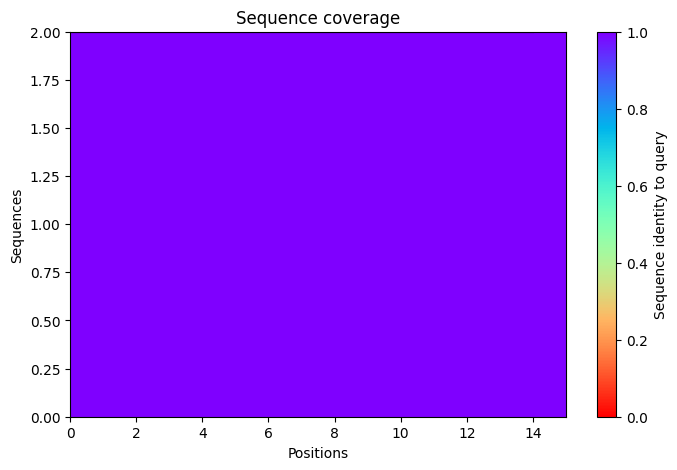

2025-11-17 08:18:50,506 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76.5 pTM=0.0376
2025-11-17 08:18:53,084 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.6 pTM=0.0381 tol=0.195
2025-11-17 08:18:55,663 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.6 pTM=0.0367 tol=0.0743
2025-11-17 08:18:58,244 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.6 pTM=0.0366 tol=0.108
2025-11-17 08:18:58,245 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


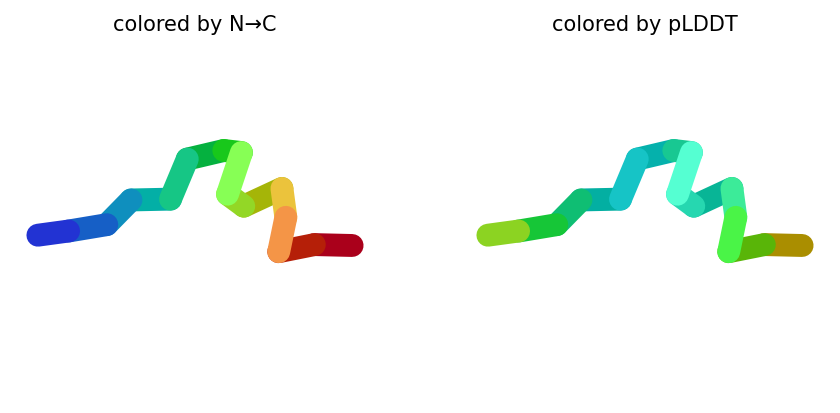

2025-11-17 08:19:00,876 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=79.1 pTM=0.0388
2025-11-17 08:19:03,460 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.6 pTM=0.0386 tol=0.169
2025-11-17 08:19:06,039 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.8 pTM=0.0383 tol=0.0655
2025-11-17 08:19:08,624 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76 pTM=0.0376 tol=0.0652
2025-11-17 08:19:08,625 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


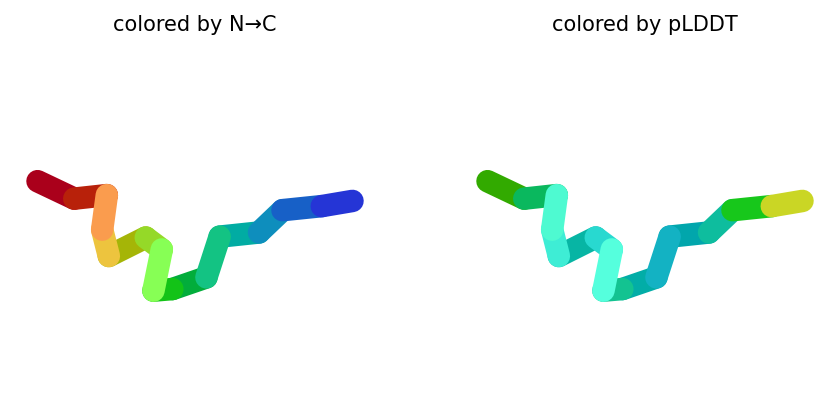

2025-11-17 08:19:11,286 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=81.9 pTM=0.0376
2025-11-17 08:19:13,875 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=81.4 pTM=0.0374 tol=0.45
2025-11-17 08:19:16,468 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.3 pTM=0.0356 tol=0.219
2025-11-17 08:19:19,065 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.2 pTM=0.0359 tol=0.16
2025-11-17 08:19:19,066 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


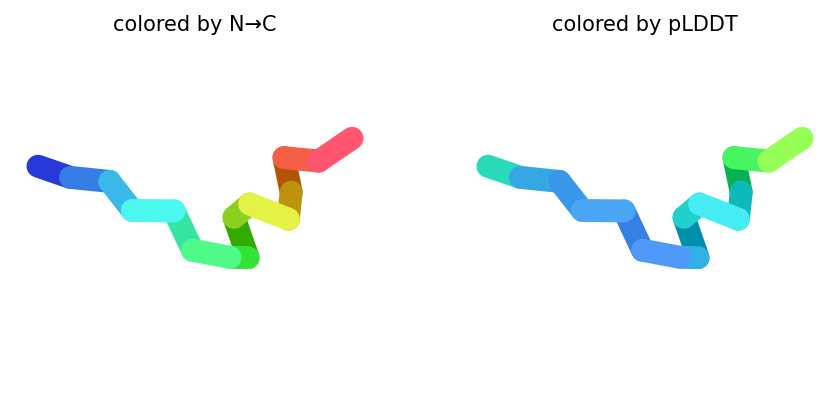

2025-11-17 08:19:21,745 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=82.9 pTM=0.0401
2025-11-17 08:19:24,342 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=81.1 pTM=0.0398 tol=0.104
2025-11-17 08:19:26,937 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=79.9 pTM=0.0384 tol=0.0732
2025-11-17 08:19:29,530 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=80.9 pTM=0.0391 tol=0.0525
2025-11-17 08:19:29,531 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


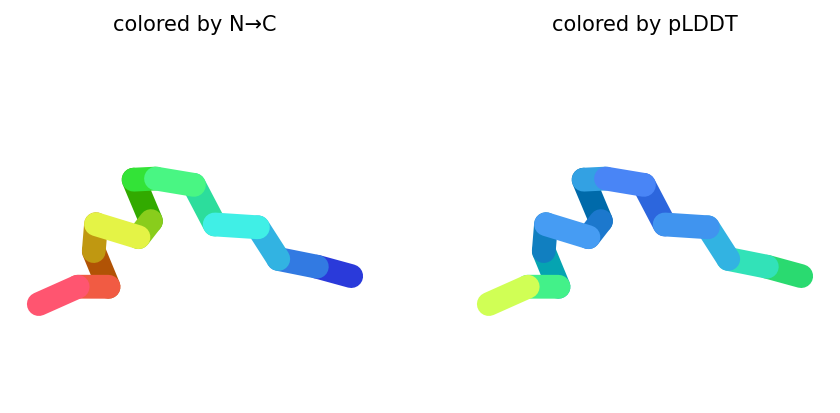

2025-11-17 08:19:32,177 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=80 pTM=0.0385
2025-11-17 08:19:34,769 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=78.5 pTM=0.0374 tol=0.418
2025-11-17 08:19:37,360 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.1 pTM=0.0341 tol=0.369
2025-11-17 08:19:39,946 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=73.4 pTM=0.0334 tol=0.093
2025-11-17 08:19:39,946 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


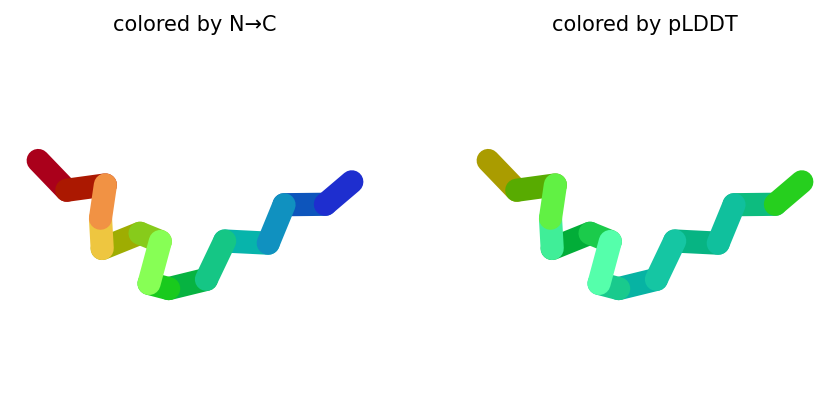

2025-11-17 08:19:40,003 reranking models by 'plddt' metric
2025-11-17 08:19:40,004 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=80.9 pTM=0.0391
2025-11-17 08:19:40,004 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=80.2 pTM=0.0359
2025-11-17 08:19:40,005 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=76 pTM=0.0376
2025-11-17 08:19:40,005 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73.6 pTM=0.0366
2025-11-17 08:19:40,006 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=73.4 pTM=0.0334
2025-11-17 08:19:41,460 Query 59/146: peptide_132_IC50_393.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:19:41,740 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


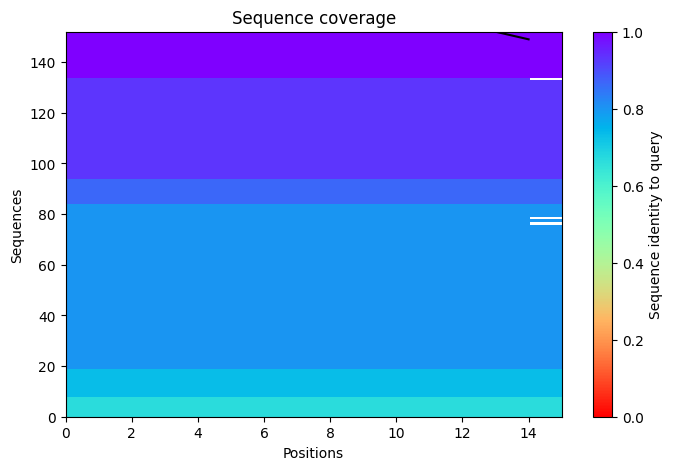

2025-11-17 08:19:52,912 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=69.8 pTM=0.0297
2025-11-17 08:19:55,497 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.8 pTM=0.0297 tol=0.758
2025-11-17 08:19:58,079 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.1 pTM=0.0299 tol=0.386
2025-11-17 08:20:00,666 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.6 pTM=0.0299 tol=0.135
2025-11-17 08:20:00,667 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


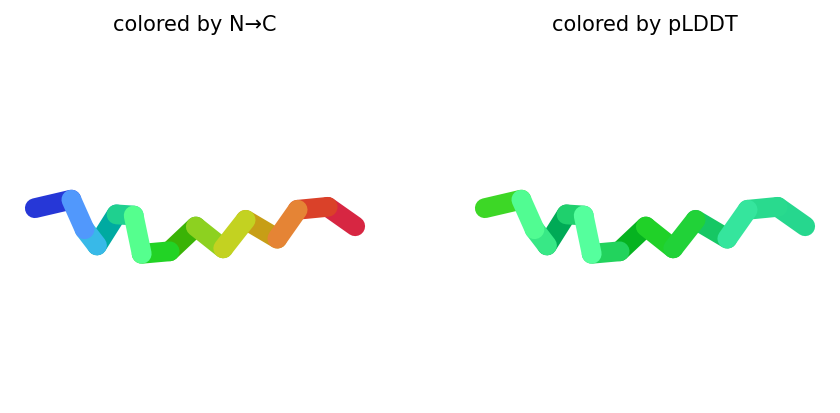

2025-11-17 08:20:03,308 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70.9 pTM=0.0306
2025-11-17 08:20:05,899 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.8 pTM=0.0317 tol=0.266
2025-11-17 08:20:08,490 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.6 pTM=0.0324 tol=0.0814
2025-11-17 08:20:11,081 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76.4 pTM=0.0323 tol=0.112
2025-11-17 08:20:11,081 alphafold2_ptm_model_2_seed_000 took 10.4s (3 recycles)


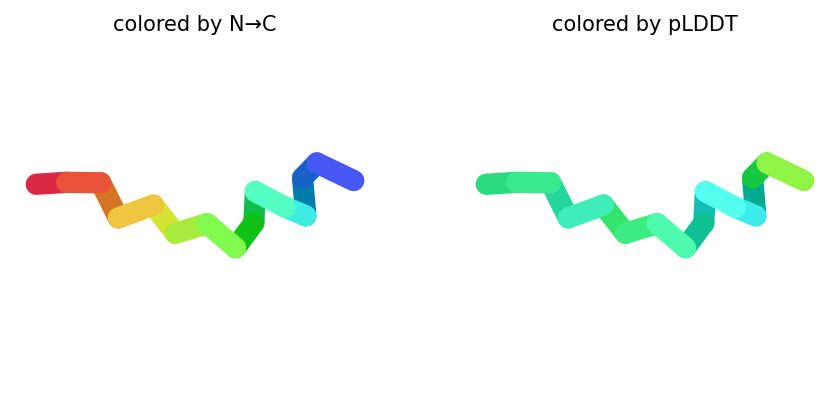

2025-11-17 08:20:13,726 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=72 pTM=0.03
2025-11-17 08:20:16,325 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.6 pTM=0.03 tol=1.48
2025-11-17 08:20:18,920 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.9 pTM=0.0304 tol=1.15
2025-11-17 08:20:21,519 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=79.2 pTM=0.0305 tol=0.187
2025-11-17 08:20:21,520 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


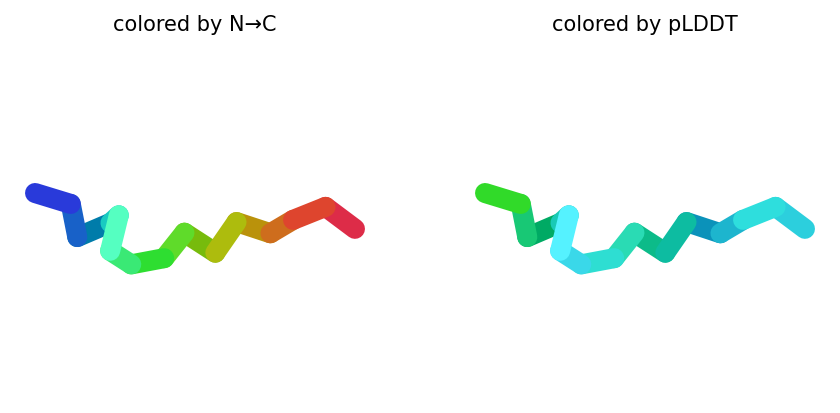

2025-11-17 08:20:24,175 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.3 pTM=0.0279
2025-11-17 08:20:26,777 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.9 pTM=0.0287 tol=0.158
2025-11-17 08:20:29,373 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.8 pTM=0.0295 tol=0.259
2025-11-17 08:20:31,970 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.5 pTM=0.0295 tol=0.346
2025-11-17 08:20:31,971 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


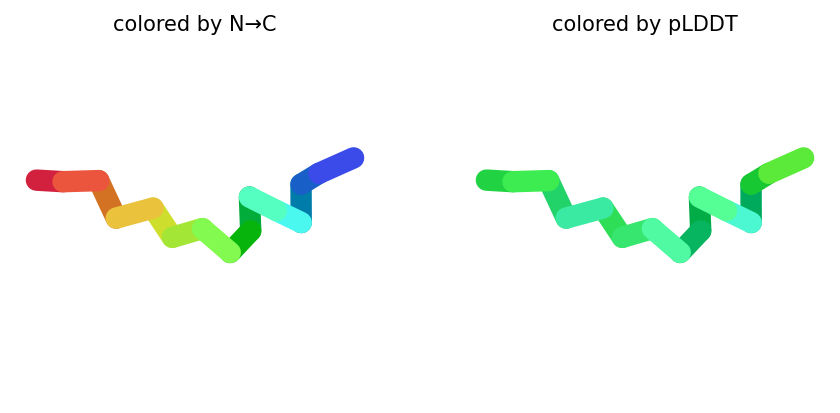

2025-11-17 08:20:34,656 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.8 pTM=0.0299
2025-11-17 08:20:37,252 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.9 pTM=0.0298 tol=1.18
2025-11-17 08:20:39,848 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=72.6 pTM=0.03 tol=0.381
2025-11-17 08:20:42,442 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.2 pTM=0.03 tol=0.285
2025-11-17 08:20:42,443 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


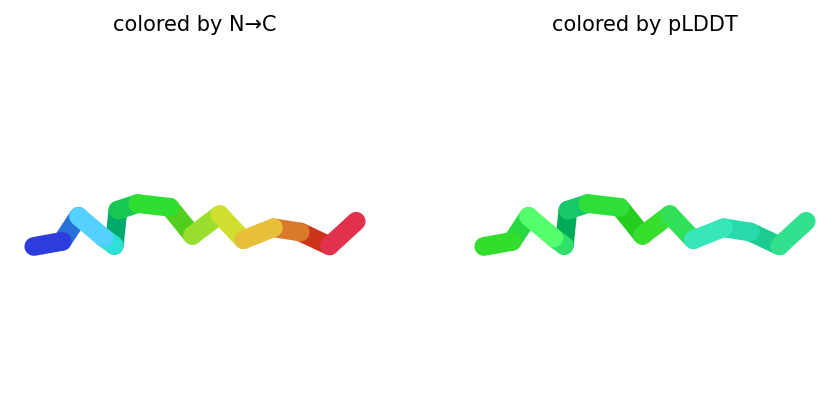

2025-11-17 08:20:42,496 reranking models by 'plddt' metric
2025-11-17 08:20:42,498 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=79.2 pTM=0.0305
2025-11-17 08:20:42,498 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=76.4 pTM=0.0323
2025-11-17 08:20:42,498 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=74.6 pTM=0.0299
2025-11-17 08:20:42,498 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=74.5 pTM=0.0295
2025-11-17 08:20:42,499 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=74.2 pTM=0.03
2025-11-17 08:20:43,537 Query 60/146: peptide_133_IC50_395.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:20:43,813 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


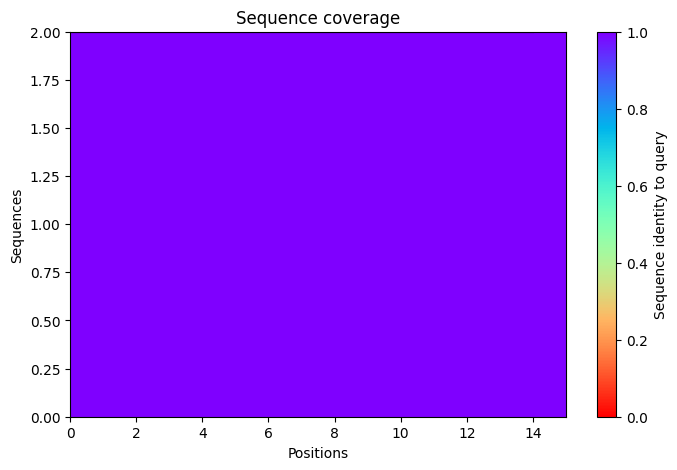

2025-11-17 08:20:59,267 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=64.8 pTM=0.0285
2025-11-17 08:21:01,845 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70 pTM=0.0294 tol=0.964
2025-11-17 08:21:04,425 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.7 pTM=0.0298 tol=0.333
2025-11-17 08:21:07,003 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.3 pTM=0.0299 tol=0.0939
2025-11-17 08:21:07,003 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


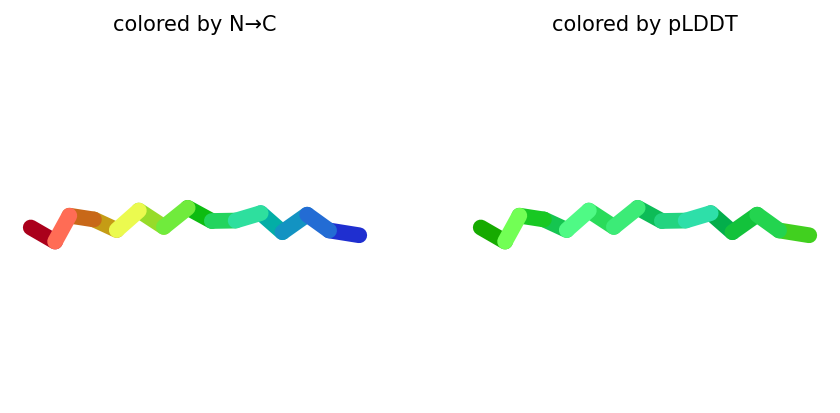

2025-11-17 08:21:09,641 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.7 pTM=0.0272
2025-11-17 08:21:12,228 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.3 pTM=0.0272 tol=1.34
2025-11-17 08:21:14,809 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.4 pTM=0.0274 tol=0.632
2025-11-17 08:21:17,400 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.5 pTM=0.0275 tol=0.251
2025-11-17 08:21:17,400 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


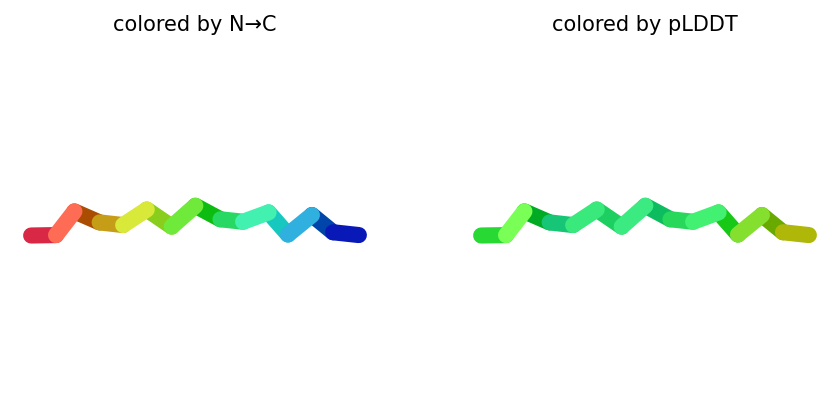

2025-11-17 08:21:20,043 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=75.1 pTM=0.0271
2025-11-17 08:21:22,640 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=80.2 pTM=0.028 tol=0.491
2025-11-17 08:21:25,238 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.9 pTM=0.0289 tol=0.123
2025-11-17 08:21:27,835 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=82.8 pTM=0.0293 tol=0.135
2025-11-17 08:21:27,836 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


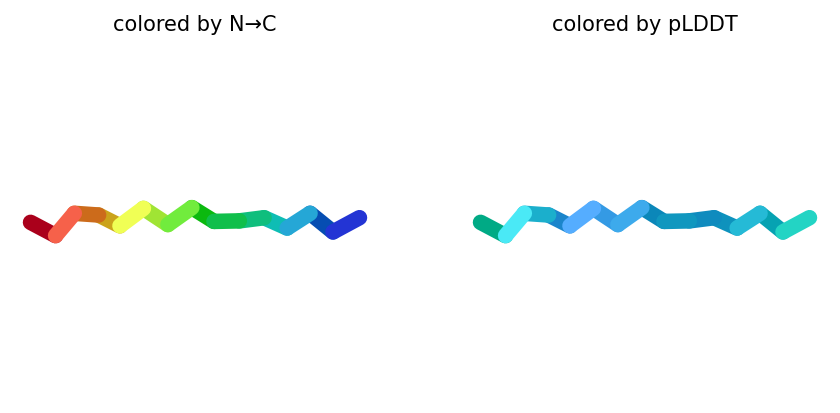

2025-11-17 08:21:30,484 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=72 pTM=0.0274
2025-11-17 08:21:33,087 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.4 pTM=0.0281 tol=0.519
2025-11-17 08:21:35,686 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.6 pTM=0.0292 tol=0.266
2025-11-17 08:21:38,280 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.8 pTM=0.0294 tol=0.385
2025-11-17 08:21:38,280 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


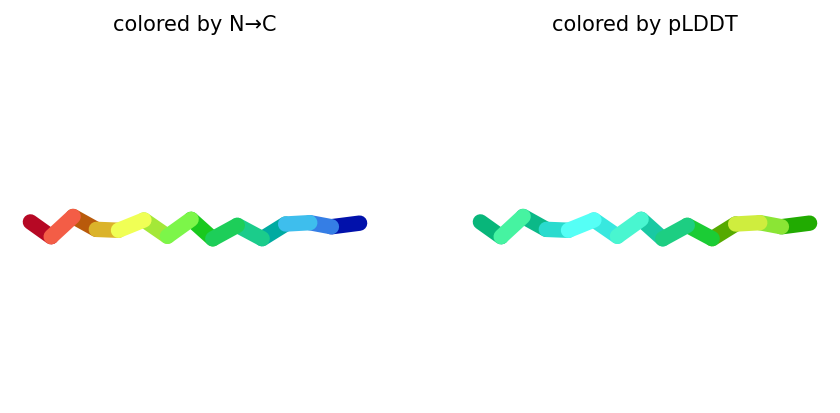

2025-11-17 08:21:40,924 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=63.3 pTM=0.0271
2025-11-17 08:21:43,515 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=64.3 pTM=0.0266 tol=1.25
2025-11-17 08:21:46,105 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=68.4 pTM=0.0271 tol=1.09
2025-11-17 08:21:48,695 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=70.6 pTM=0.0275 tol=0.49
2025-11-17 08:21:48,696 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


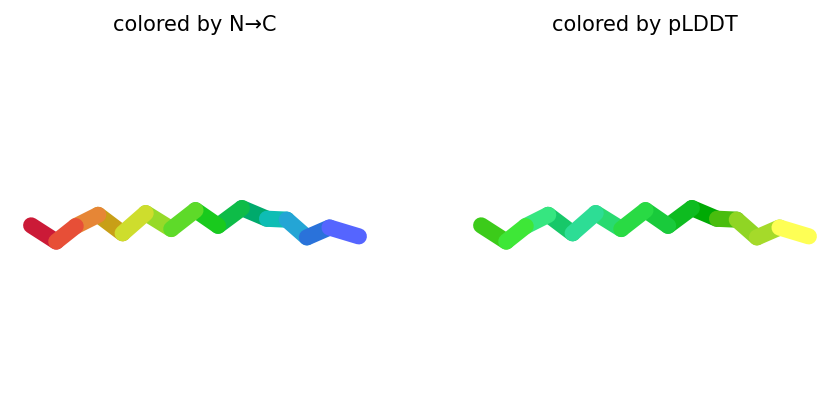

2025-11-17 08:21:48,742 reranking models by 'plddt' metric
2025-11-17 08:21:48,742 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=82.8 pTM=0.0293
2025-11-17 08:21:48,742 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=74.8 pTM=0.0294
2025-11-17 08:21:48,742 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=73.3 pTM=0.0299
2025-11-17 08:21:48,743 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=71.5 pTM=0.0275
2025-11-17 08:21:48,743 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=70.6 pTM=0.0275
2025-11-17 08:21:49,783 Query 61/146: peptide_134_IC50_387.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:21:50,078 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


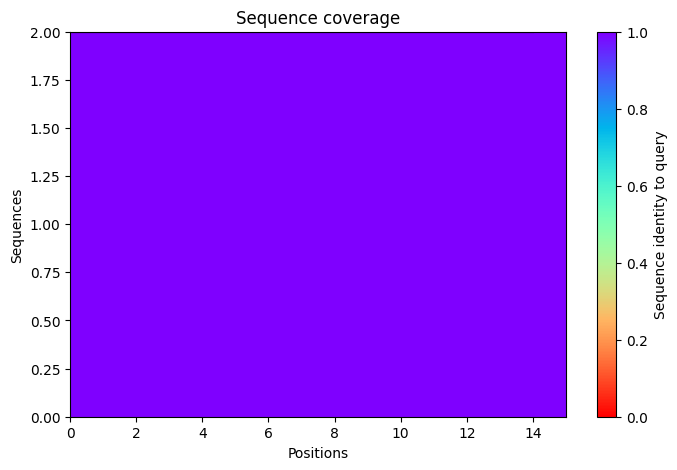

2025-11-17 08:22:03,385 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66.2 pTM=0.0324
2025-11-17 08:22:05,960 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.1 pTM=0.0349 tol=0.298
2025-11-17 08:22:08,538 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.2 pTM=0.0374 tol=0.135
2025-11-17 08:22:11,119 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.6 pTM=0.0398 tol=0.109
2025-11-17 08:22:11,120 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


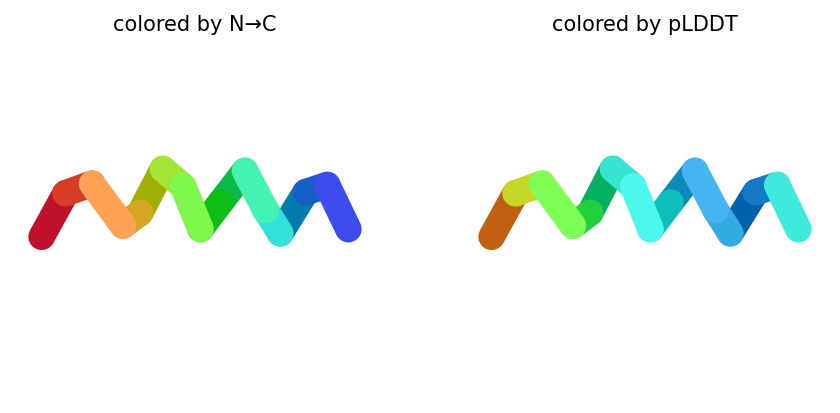

2025-11-17 08:22:13,751 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.9 pTM=0.0295
2025-11-17 08:22:16,329 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.3 pTM=0.0282 tol=1.49
2025-11-17 08:22:18,907 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63 pTM=0.0311 tol=0.94
2025-11-17 08:22:21,496 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=64.9 pTM=0.0334 tol=0.217
2025-11-17 08:22:21,497 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


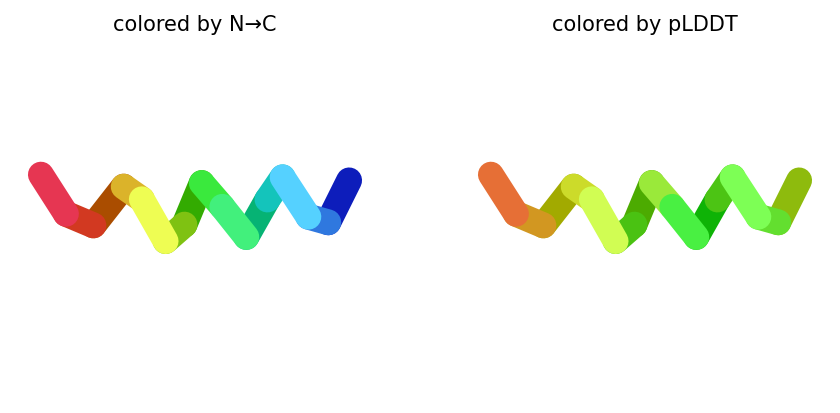

2025-11-17 08:22:24,158 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.8 pTM=0.0264
2025-11-17 08:22:26,751 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.9 pTM=0.0275 tol=0.958
2025-11-17 08:22:29,341 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=78.8 pTM=0.0285 tol=0.342
2025-11-17 08:22:31,938 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.2 pTM=0.0287 tol=0.105
2025-11-17 08:22:31,939 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


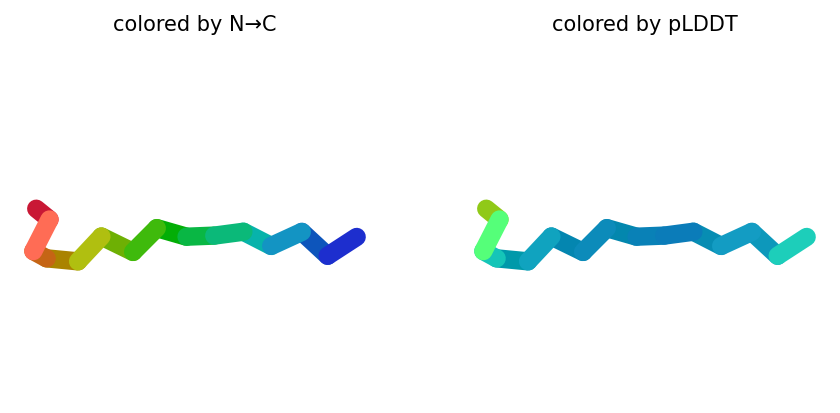

2025-11-17 08:22:34,595 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.5 pTM=0.0262
2025-11-17 08:22:37,195 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=65.2 pTM=0.0272 tol=0.547
2025-11-17 08:22:39,792 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=62.3 pTM=0.0269 tol=0.603
2025-11-17 08:22:42,391 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=63.7 pTM=0.0271 tol=0.45
2025-11-17 08:22:42,391 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


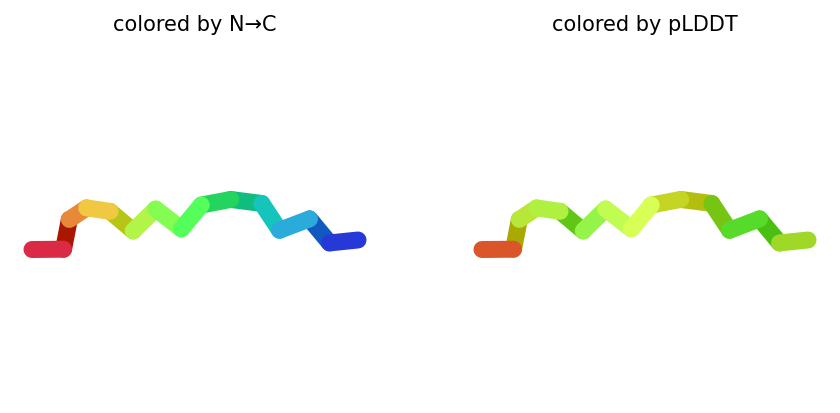

2025-11-17 08:22:45,038 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=64.3 pTM=0.0304
2025-11-17 08:22:47,630 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67.2 pTM=0.0323 tol=0.366
2025-11-17 08:22:50,217 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.8 pTM=0.0323 tol=0.0384
2025-11-17 08:22:52,806 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=69.7 pTM=0.0344 tol=0.217
2025-11-17 08:22:52,807 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


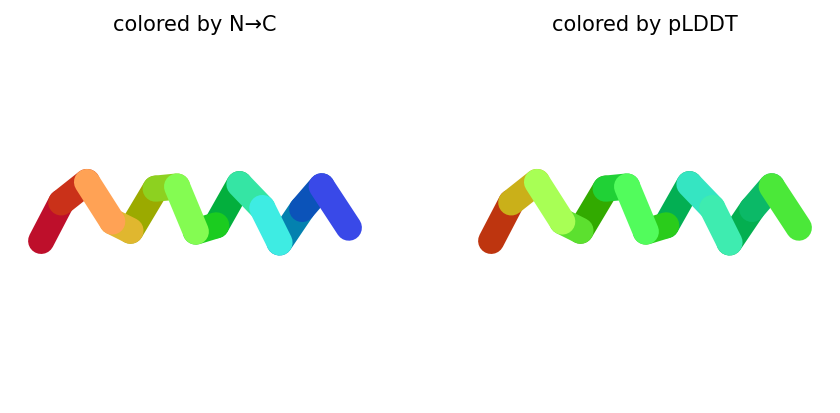

2025-11-17 08:22:52,858 reranking models by 'plddt' metric
2025-11-17 08:22:52,858 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=80.2 pTM=0.0287
2025-11-17 08:22:52,859 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=76.6 pTM=0.0398
2025-11-17 08:22:52,859 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=69.7 pTM=0.0344
2025-11-17 08:22:52,860 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=64.9 pTM=0.0334
2025-11-17 08:22:52,860 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=63.7 pTM=0.0271
2025-11-17 08:22:54,336 Query 62/146: peptide_137_IC50_389.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:22:54,616 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


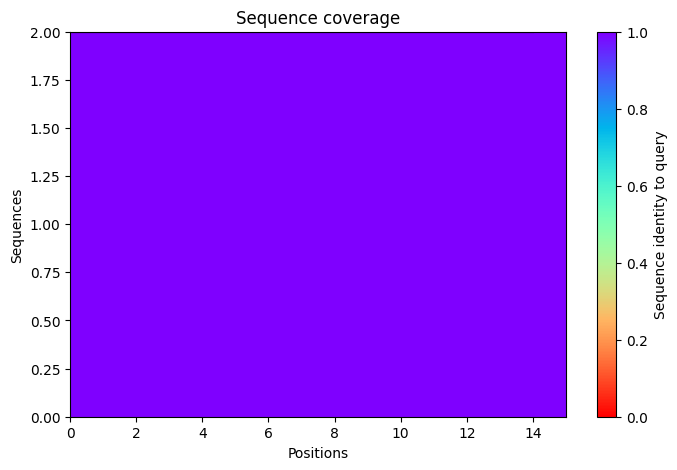

2025-11-17 08:23:07,767 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=67.4 pTM=0.0333
2025-11-17 08:23:10,343 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=64.8 pTM=0.0322 tol=0.771
2025-11-17 08:23:12,922 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=64.9 pTM=0.0315 tol=0.158
2025-11-17 08:23:15,499 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=64.6 pTM=0.0311 tol=0.397
2025-11-17 08:23:15,500 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


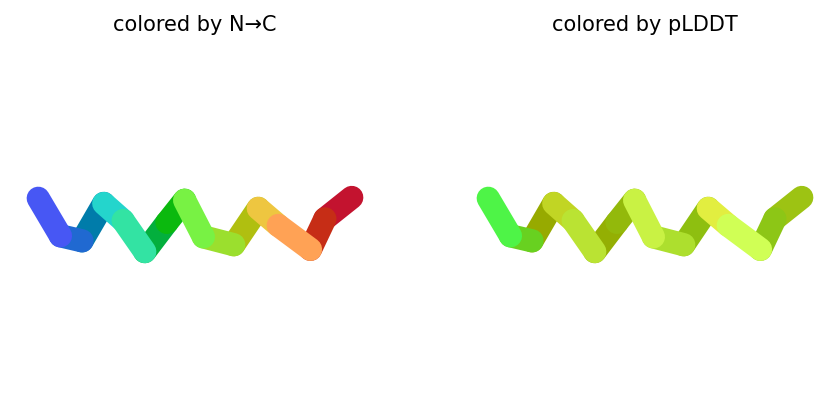

2025-11-17 08:23:18,131 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61.8 pTM=0.0299
2025-11-17 08:23:20,712 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.7 pTM=0.0281 tol=1.22
2025-11-17 08:23:23,298 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=61.8 pTM=0.0272 tol=1.42
2025-11-17 08:23:25,880 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=63.7 pTM=0.0268 tol=1.41
2025-11-17 08:23:25,881 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


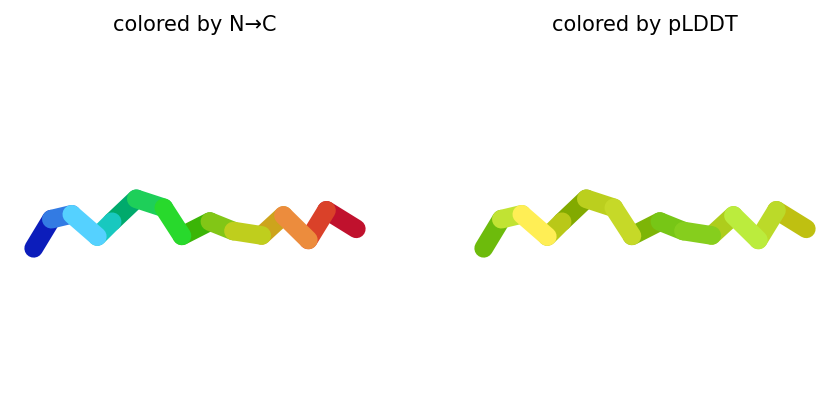

2025-11-17 08:23:28,523 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.1 pTM=0.0267
2025-11-17 08:23:31,115 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=71.8 pTM=0.0276 tol=1.04
2025-11-17 08:23:33,711 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.2 pTM=0.0279 tol=0.281
2025-11-17 08:23:36,308 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.9 pTM=0.0279 tol=0.169
2025-11-17 08:23:36,309 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


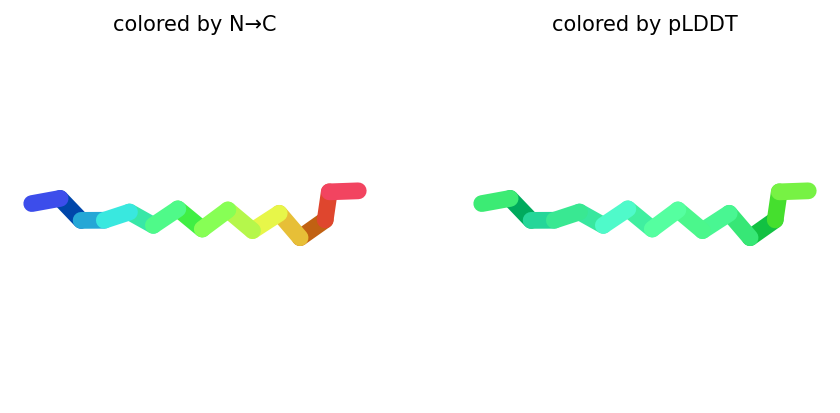

2025-11-17 08:23:38,956 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62.7 pTM=0.0277
2025-11-17 08:23:41,550 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.4 pTM=0.0284 tol=0.616
2025-11-17 08:23:44,142 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.9 pTM=0.0285 tol=1.06
2025-11-17 08:23:46,741 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.6 pTM=0.0283 tol=0.636
2025-11-17 08:23:46,742 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


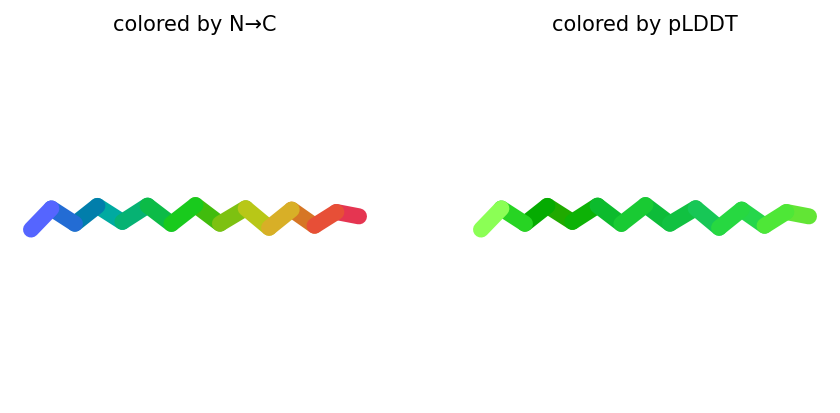

2025-11-17 08:23:49,403 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.8 pTM=0.0327
2025-11-17 08:23:51,993 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=64.8 pTM=0.0305 tol=1.04
2025-11-17 08:23:54,581 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64.4 pTM=0.029 tol=0.728
2025-11-17 08:23:57,170 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.1 pTM=0.0292 tol=0.165
2025-11-17 08:23:57,170 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


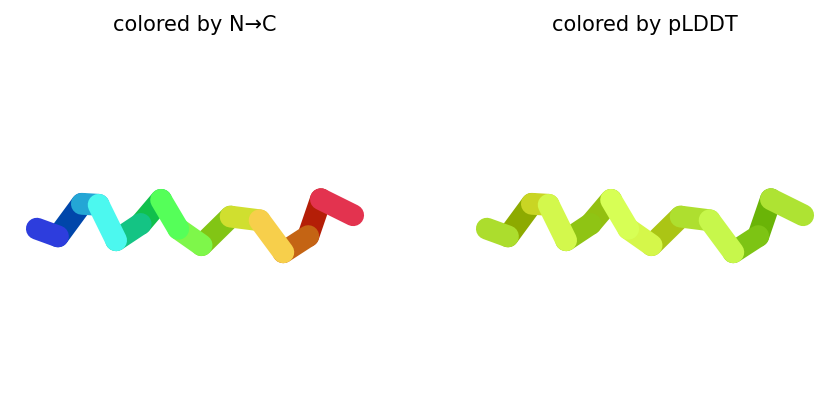

2025-11-17 08:23:57,244 reranking models by 'plddt' metric
2025-11-17 08:23:57,244 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=74.9 pTM=0.0279
2025-11-17 08:23:57,245 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=71.6 pTM=0.0283
2025-11-17 08:23:57,245 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=64.6 pTM=0.0311
2025-11-17 08:23:57,245 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=64.1 pTM=0.0292
2025-11-17 08:23:57,245 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=63.7 pTM=0.0268
2025-11-17 08:23:58,604 Query 63/146: peptide_140_IC50_388.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:23:58,870 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


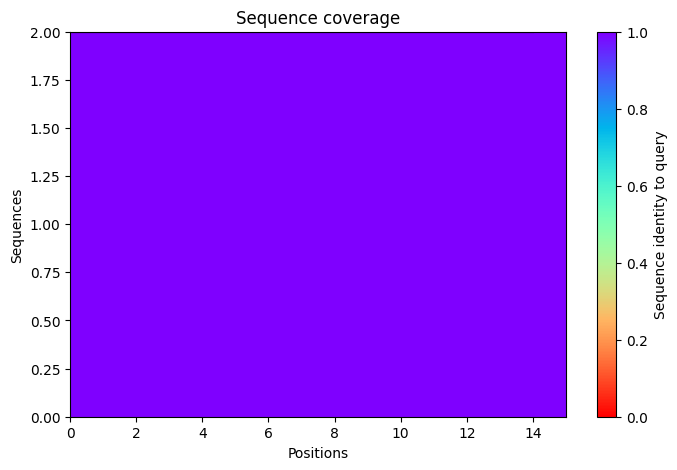

2025-11-17 08:24:09,038 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.5 pTM=0.0362
2025-11-17 08:24:11,617 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.6 pTM=0.0385 tol=0.108
2025-11-17 08:24:14,196 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.6 pTM=0.0382 tol=0.0889
2025-11-17 08:24:16,777 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.6 pTM=0.0379 tol=0.0977
2025-11-17 08:24:16,777 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


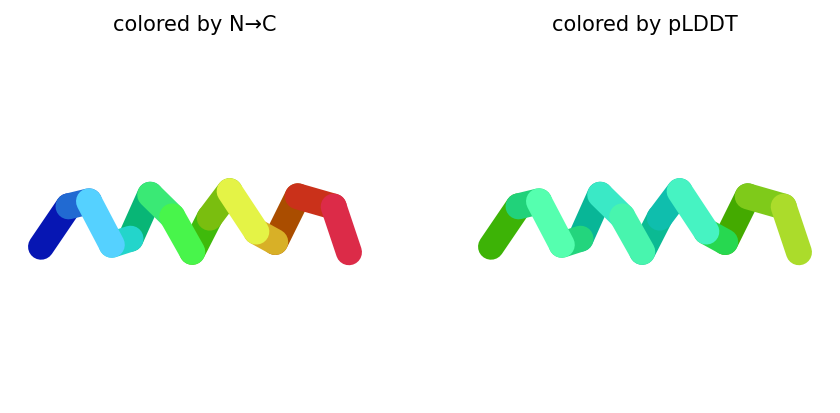

2025-11-17 08:24:19,410 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=64.2 pTM=0.0338
2025-11-17 08:24:21,992 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=62.8 pTM=0.0335 tol=0.277
2025-11-17 08:24:24,578 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.4 pTM=0.0317 tol=0.389
2025-11-17 08:24:27,158 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60.6 pTM=0.0312 tol=0.154
2025-11-17 08:24:27,159 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


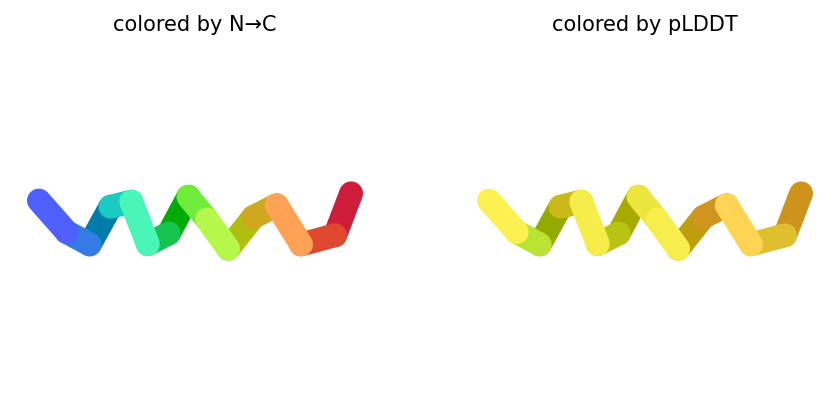

2025-11-17 08:24:29,793 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=61.6 pTM=0.0268
2025-11-17 08:24:32,382 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=62.2 pTM=0.0268 tol=1.34
2025-11-17 08:24:34,976 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63.8 pTM=0.0271 tol=0.71
2025-11-17 08:24:37,569 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=64.2 pTM=0.027 tol=0.373
2025-11-17 08:24:37,570 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


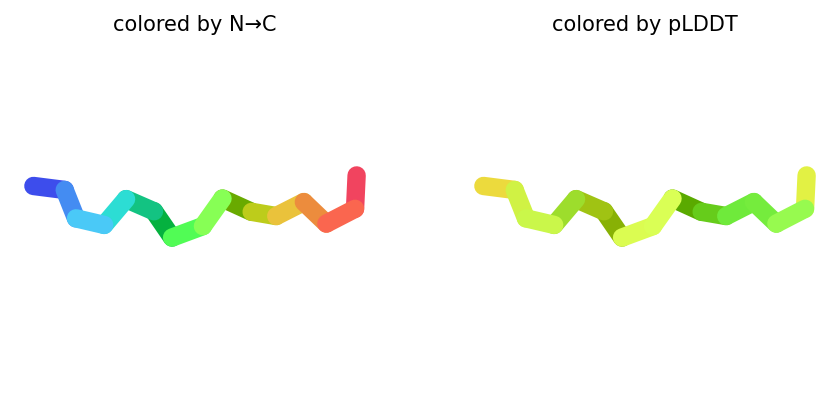

2025-11-17 08:24:40,215 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=59.2 pTM=0.0275
2025-11-17 08:24:42,804 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=60.7 pTM=0.0274 tol=0.962
2025-11-17 08:24:45,393 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=62.1 pTM=0.0275 tol=0.767
2025-11-17 08:24:47,986 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=62.8 pTM=0.0275 tol=0.498
2025-11-17 08:24:47,987 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


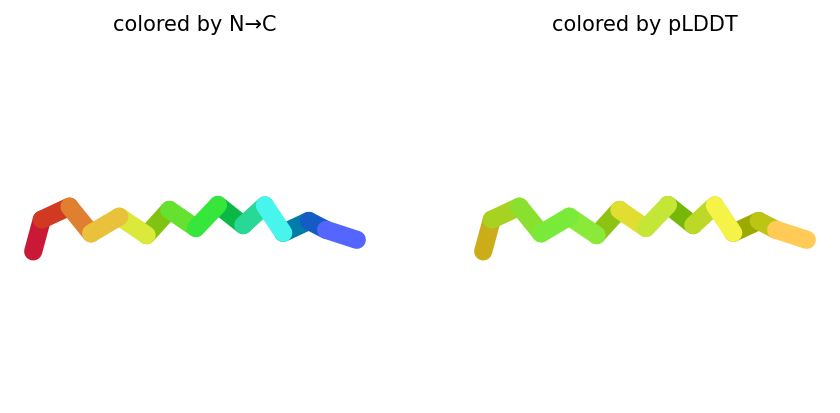

2025-11-17 08:24:50,667 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.8 pTM=0.0383
2025-11-17 08:24:53,255 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.7 pTM=0.0362 tol=0.408
2025-11-17 08:24:55,840 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.8 pTM=0.0339 tol=0.969
2025-11-17 08:24:58,426 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=65.4 pTM=0.0326 tol=0.603
2025-11-17 08:24:58,427 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


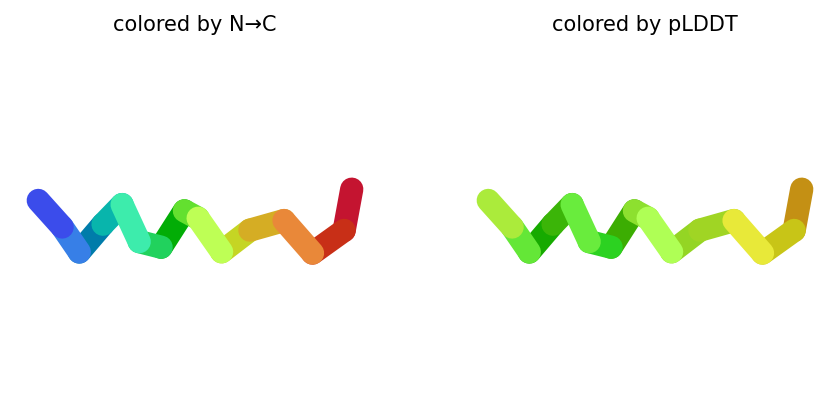

2025-11-17 08:24:58,502 reranking models by 'plddt' metric
2025-11-17 08:24:58,502 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=73.6 pTM=0.0379
2025-11-17 08:24:58,503 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=65.4 pTM=0.0326
2025-11-17 08:24:58,503 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=64.2 pTM=0.027
2025-11-17 08:24:58,504 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=62.8 pTM=0.0275
2025-11-17 08:24:58,504 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60.6 pTM=0.0312
2025-11-17 08:24:59,892 Query 64/146: peptide_142_IC50_383.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:25:00,174 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


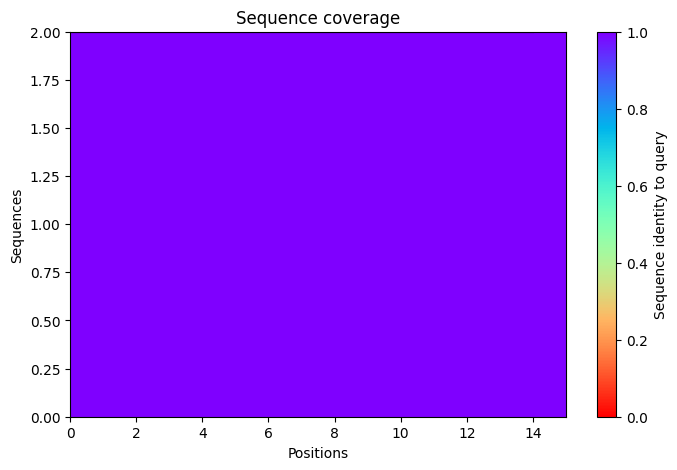

2025-11-17 08:25:14,569 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.7 pTM=0.0275
2025-11-17 08:25:17,144 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.1 pTM=0.0277 tol=0.215
2025-11-17 08:25:19,721 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.6 pTM=0.0278 tol=0.227
2025-11-17 08:25:22,301 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=75 pTM=0.0273 tol=0.277
2025-11-17 08:25:22,302 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


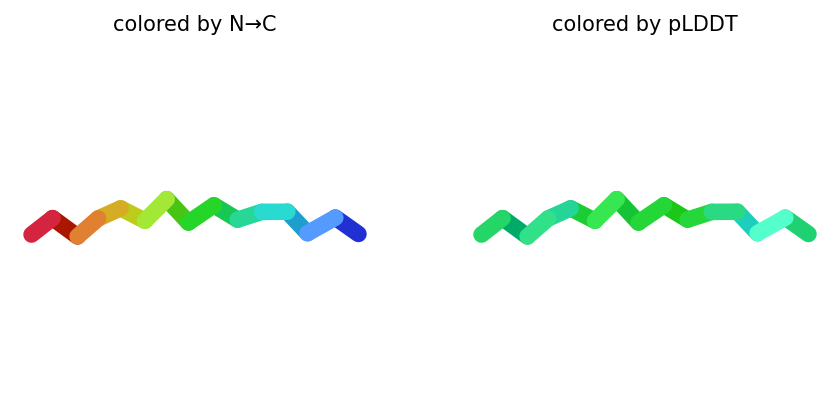

2025-11-17 08:25:24,934 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.1 pTM=0.0275
2025-11-17 08:25:27,519 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.6 pTM=0.0279 tol=0.343
2025-11-17 08:25:30,103 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.8 pTM=0.0277 tol=0.0814
2025-11-17 08:25:32,693 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=73 pTM=0.0275 tol=0.105
2025-11-17 08:25:32,693 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


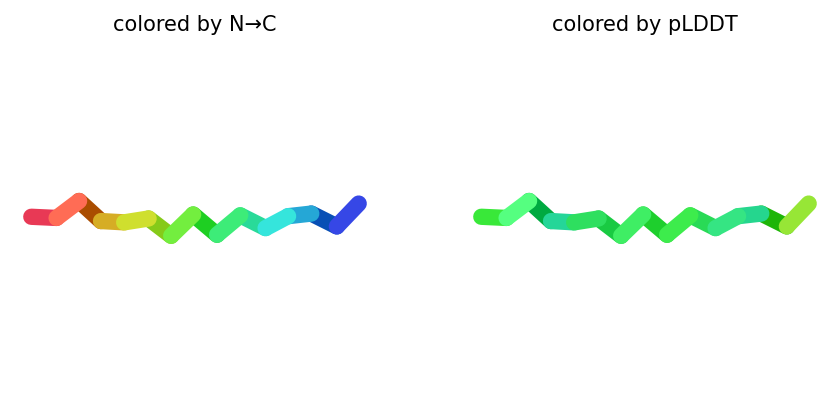

2025-11-17 08:25:35,337 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.6 pTM=0.0264
2025-11-17 08:25:37,935 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73 pTM=0.0266 tol=1.06
2025-11-17 08:25:40,534 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=75.1 pTM=0.0267 tol=0.201
2025-11-17 08:25:43,137 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=73.6 pTM=0.0266 tol=0.253
2025-11-17 08:25:43,138 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


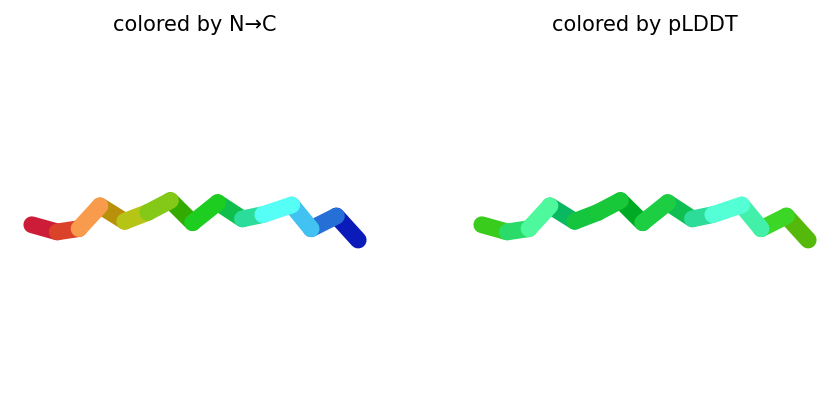

2025-11-17 08:25:45,785 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.9 pTM=0.0278
2025-11-17 08:25:48,390 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=74.6 pTM=0.0279 tol=0.186
2025-11-17 08:25:50,990 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.4 pTM=0.0277 tol=0.0754
2025-11-17 08:25:53,587 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.3 pTM=0.0275 tol=0.0867
2025-11-17 08:25:53,587 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


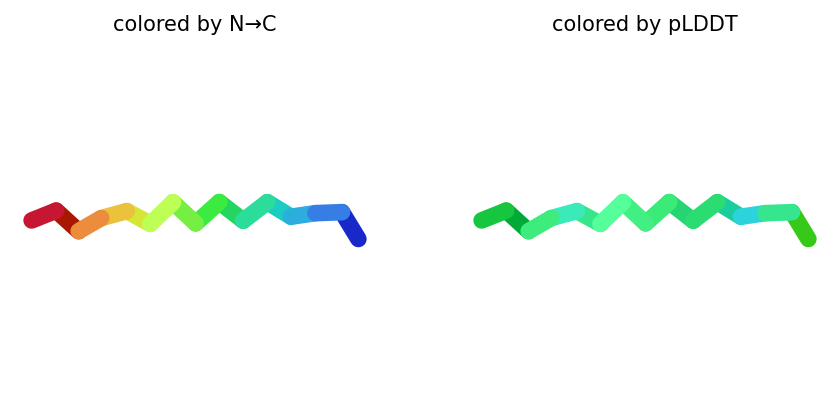

2025-11-17 08:25:56,231 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.8 pTM=0.0265
2025-11-17 08:25:58,819 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.6 pTM=0.0271 tol=0.769
2025-11-17 08:26:01,412 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=71.5 pTM=0.0272 tol=0.208
2025-11-17 08:26:04,001 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=69.9 pTM=0.0268 tol=0.333
2025-11-17 08:26:04,002 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


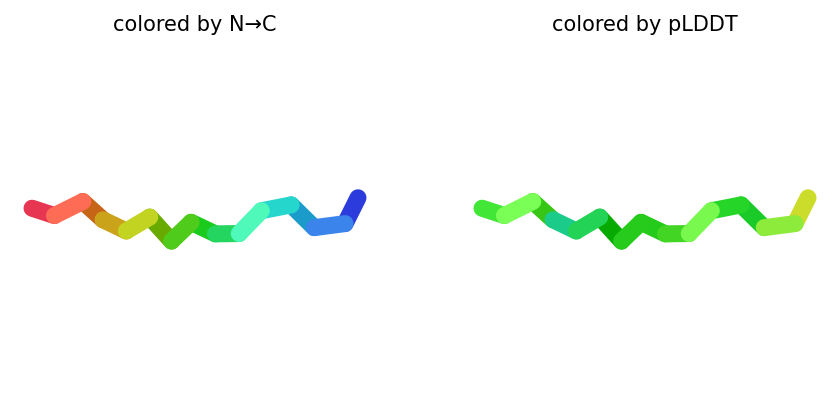

2025-11-17 08:26:04,051 reranking models by 'plddt' metric
2025-11-17 08:26:04,052 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=75.3 pTM=0.0275
2025-11-17 08:26:04,052 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=75 pTM=0.0273
2025-11-17 08:26:04,052 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=73.6 pTM=0.0266
2025-11-17 08:26:04,052 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=73 pTM=0.0275
2025-11-17 08:26:04,053 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=69.9 pTM=0.0268
2025-11-17 08:26:05,506 Query 65/146: peptide_143_IC50_398.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:26:05,786 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


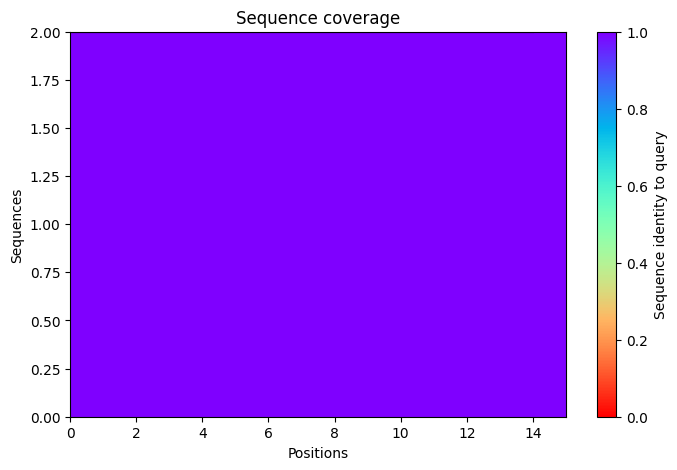

2025-11-17 08:26:18,017 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.4 pTM=0.0335
2025-11-17 08:26:20,591 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.8 pTM=0.0322 tol=0.324
2025-11-17 08:26:23,166 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=69 pTM=0.0339 tol=0.146
2025-11-17 08:26:25,741 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.7 pTM=0.0348 tol=0.235
2025-11-17 08:26:25,742 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


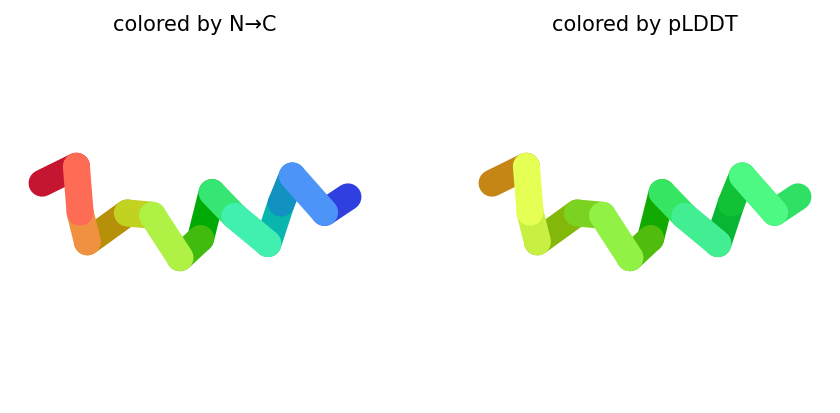

2025-11-17 08:26:28,373 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=57.3 pTM=0.0271
2025-11-17 08:26:30,955 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.2 pTM=0.0267 tol=4.01
2025-11-17 08:26:33,537 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63 pTM=0.0269 tol=1.55
2025-11-17 08:26:36,121 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=66.7 pTM=0.0275 tol=0.565
2025-11-17 08:26:36,122 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


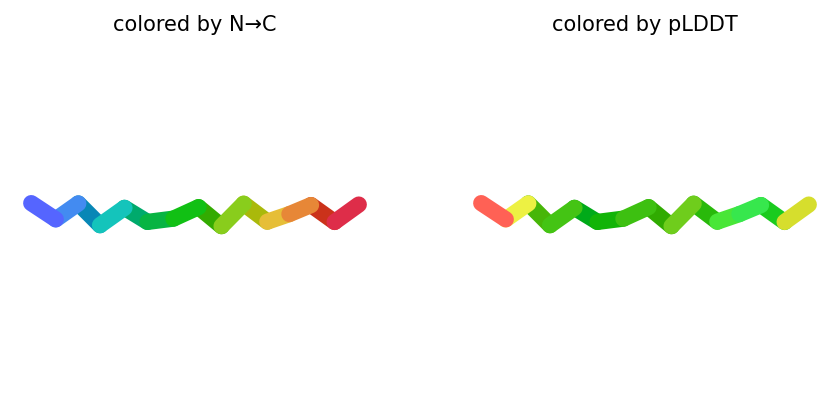

2025-11-17 08:26:38,884 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.6 pTM=0.0272
2025-11-17 08:26:41,472 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.6 pTM=0.0284 tol=0.461
2025-11-17 08:26:44,065 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.8 pTM=0.0285 tol=0.0795
2025-11-17 08:26:46,660 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=79.6 pTM=0.0291 tol=0.147
2025-11-17 08:26:46,661 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


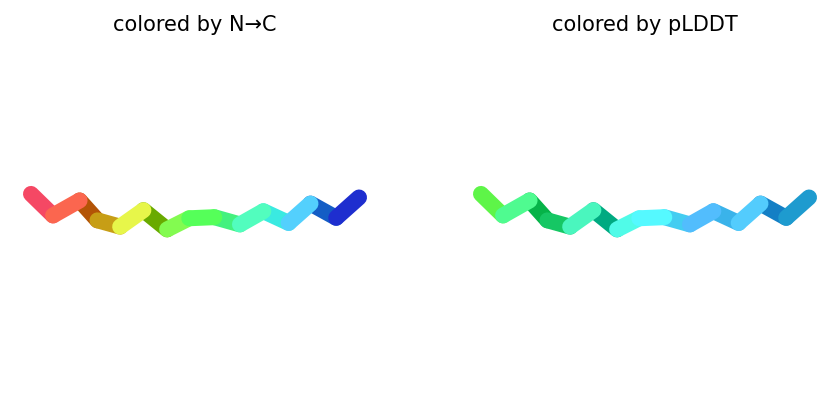

2025-11-17 08:26:49,316 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61 pTM=0.0268
2025-11-17 08:26:51,913 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=57.4 pTM=0.0271 tol=3.13
2025-11-17 08:26:54,506 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=65.4 pTM=0.0277 tol=2.08
2025-11-17 08:26:57,100 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.8 pTM=0.0286 tol=0.483
2025-11-17 08:26:57,101 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


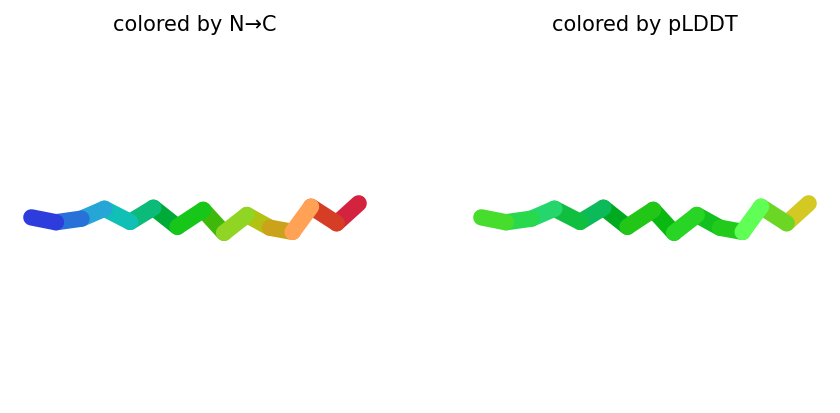

2025-11-17 08:26:59,746 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.1 pTM=0.036
2025-11-17 08:27:02,337 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.8 pTM=0.0382 tol=0.107
2025-11-17 08:27:04,927 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=78.6 pTM=0.0399 tol=0.0602
2025-11-17 08:27:07,520 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78.8 pTM=0.0403 tol=0.0718
2025-11-17 08:27:07,521 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


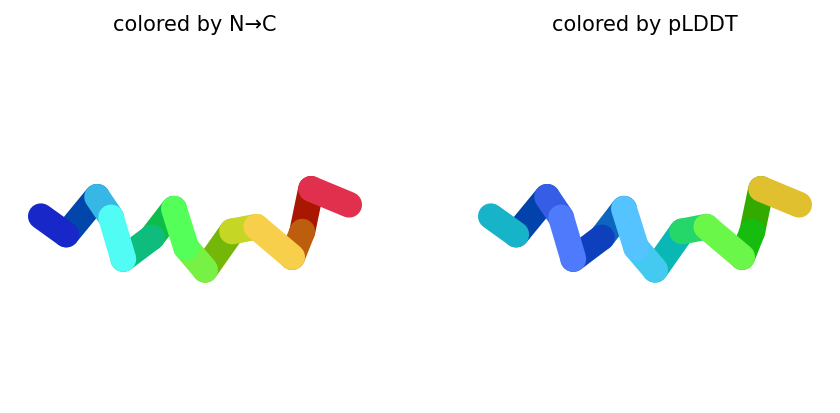

2025-11-17 08:27:07,571 reranking models by 'plddt' metric
2025-11-17 08:27:07,572 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=79.6 pTM=0.0291
2025-11-17 08:27:07,572 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=78.8 pTM=0.0403
2025-11-17 08:27:07,572 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=70.8 pTM=0.0286
2025-11-17 08:27:07,572 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=68.7 pTM=0.0348
2025-11-17 08:27:07,573 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=66.7 pTM=0.0275
2025-11-17 08:27:08,650 Query 66/146: peptide_149_IC50_401.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:27:08,936 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


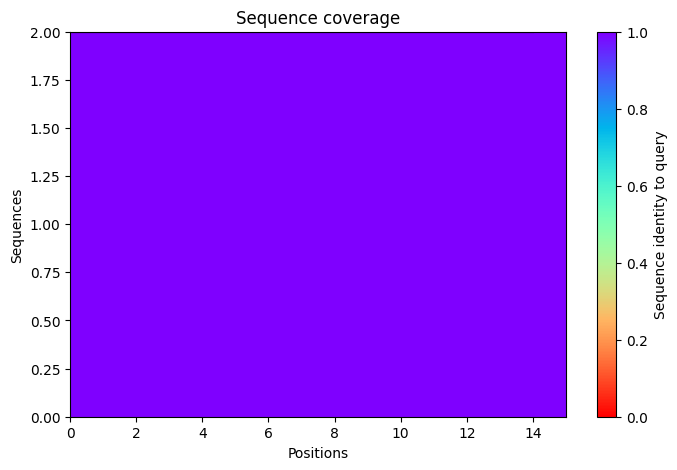

2025-11-17 08:27:23,055 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.8 pTM=0.0316
2025-11-17 08:27:25,632 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=66.8 pTM=0.0331 tol=1.14
2025-11-17 08:27:28,211 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=65.6 pTM=0.0332 tol=0.452
2025-11-17 08:27:30,789 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=64.7 pTM=0.0324 tol=0.603
2025-11-17 08:27:30,790 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


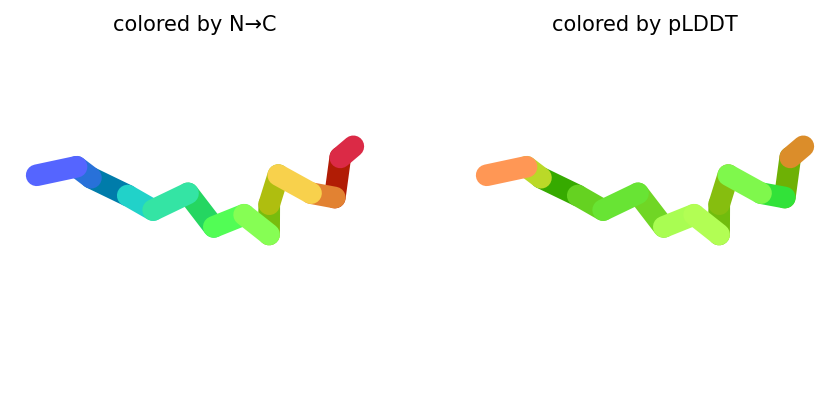

2025-11-17 08:27:33,423 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=64.4 pTM=0.0281
2025-11-17 08:27:36,004 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=64.1 pTM=0.0281 tol=0.203
2025-11-17 08:27:38,591 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.9 pTM=0.0281 tol=1.07
2025-11-17 08:27:41,171 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.3 pTM=0.0281 tol=0.274
2025-11-17 08:27:41,172 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


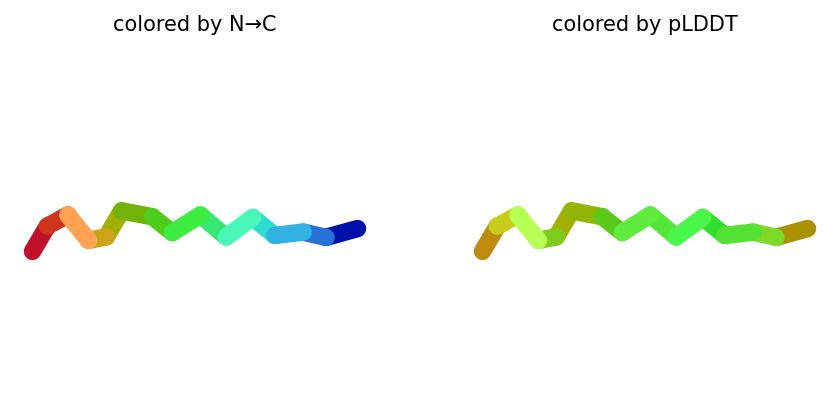

2025-11-17 08:27:43,806 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.6 pTM=0.0289
2025-11-17 08:27:46,399 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.1 pTM=0.0291 tol=0.59
2025-11-17 08:27:48,994 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.1 pTM=0.0294 tol=0.369
2025-11-17 08:27:51,590 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.8 pTM=0.0294 tol=0.177
2025-11-17 08:27:51,591 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


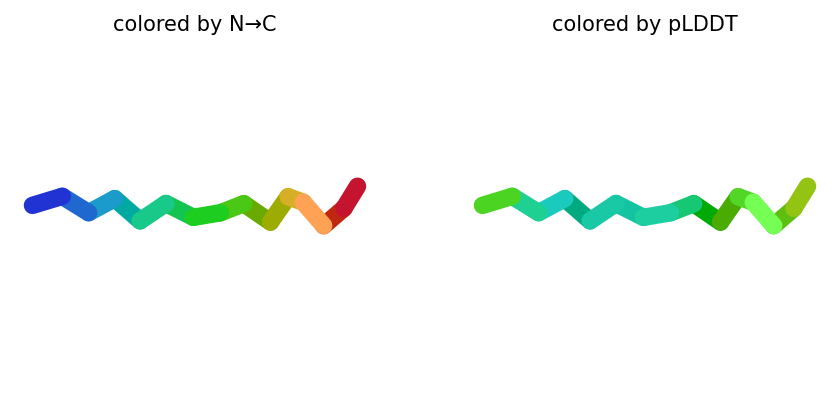

2025-11-17 08:27:54,236 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.1 pTM=0.0294
2025-11-17 08:27:56,835 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75.8 pTM=0.0301 tol=0.4
2025-11-17 08:27:59,433 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.1 pTM=0.0302 tol=0.288
2025-11-17 08:28:02,032 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.2 pTM=0.03 tol=0.132
2025-11-17 08:28:02,033 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


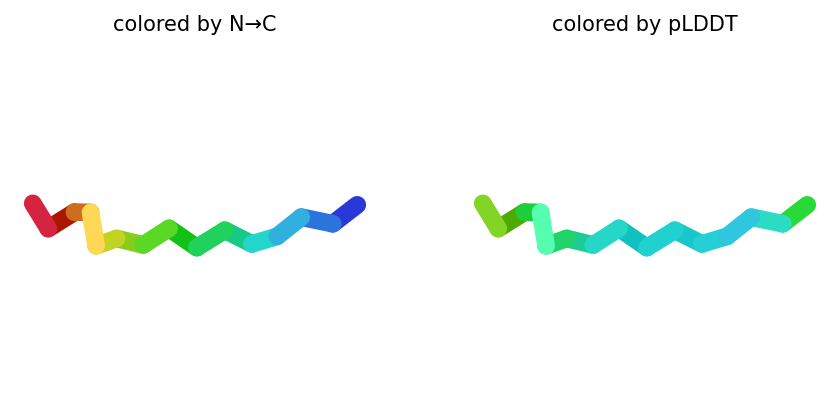

2025-11-17 08:28:04,710 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=61.6 pTM=0.0289
2025-11-17 08:28:07,306 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.8 pTM=0.0286 tol=1.14
2025-11-17 08:28:09,896 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=62.1 pTM=0.0281 tol=0.439
2025-11-17 08:28:12,486 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=62.5 pTM=0.0279 tol=0.257
2025-11-17 08:28:12,487 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


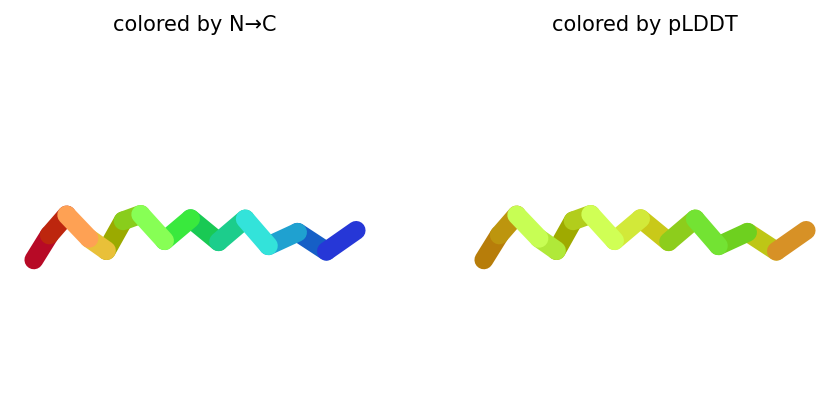

2025-11-17 08:28:12,535 reranking models by 'plddt' metric
2025-11-17 08:28:12,536 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=76.2 pTM=0.03
2025-11-17 08:28:12,538 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=72.8 pTM=0.0294
2025-11-17 08:28:12,539 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=65.3 pTM=0.0281
2025-11-17 08:28:12,539 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=64.7 pTM=0.0324
2025-11-17 08:28:12,539 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=62.5 pTM=0.0279
2025-11-17 08:28:13,905 Query 67/146: peptide_150_IC50_409.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:28:14,207 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


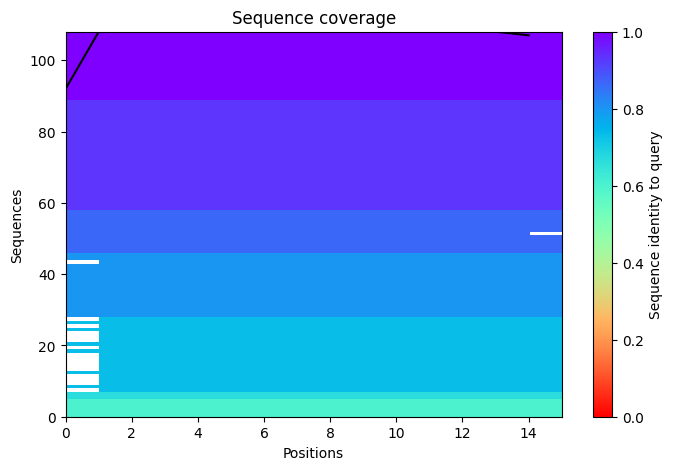

2025-11-17 08:28:24,329 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=67.4 pTM=0.0299
2025-11-17 08:28:26,914 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=69 pTM=0.0304 tol=1.18
2025-11-17 08:28:29,496 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=70.8 pTM=0.0307 tol=0.648
2025-11-17 08:28:32,080 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=71.7 pTM=0.0306 tol=0.499
2025-11-17 08:28:32,081 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


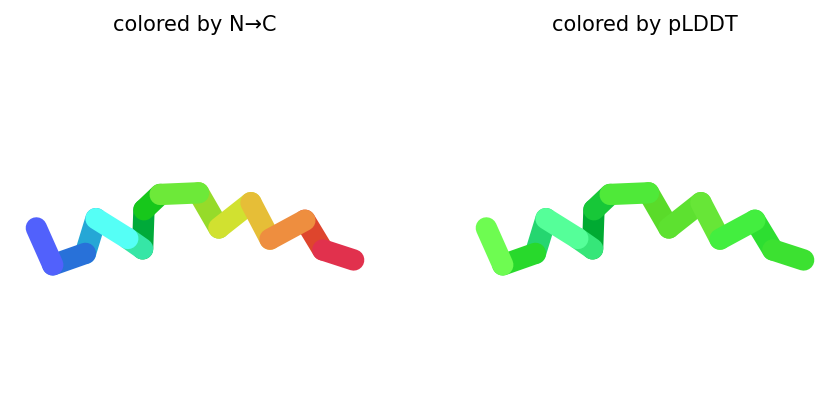

2025-11-17 08:28:34,719 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.8 pTM=0.0307
2025-11-17 08:28:37,304 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.6 pTM=0.0319 tol=0.25
2025-11-17 08:28:39,891 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.1 pTM=0.0322 tol=0.139
2025-11-17 08:28:42,484 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=73.4 pTM=0.032 tol=0.231
2025-11-17 08:28:42,485 alphafold2_ptm_model_2_seed_000 took 10.4s (3 recycles)


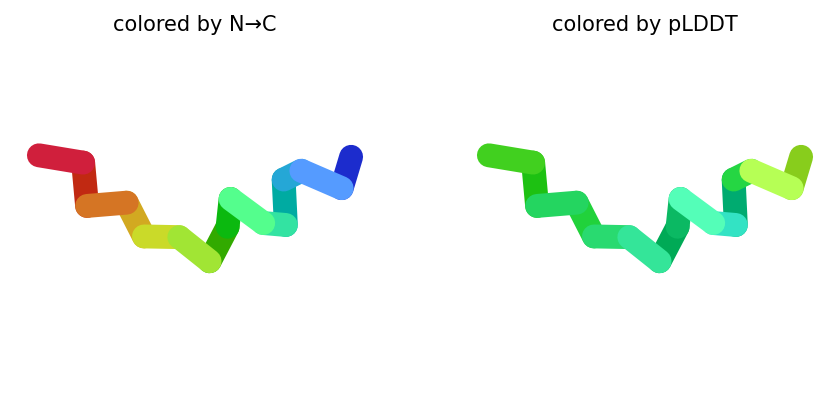

2025-11-17 08:28:45,129 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=72.5 pTM=0.0306
2025-11-17 08:28:47,722 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.5 pTM=0.031 tol=0.771
2025-11-17 08:28:50,317 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=75.2 pTM=0.0314 tol=0.436
2025-11-17 08:28:52,912 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.2 pTM=0.0316 tol=0.268
2025-11-17 08:28:52,912 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


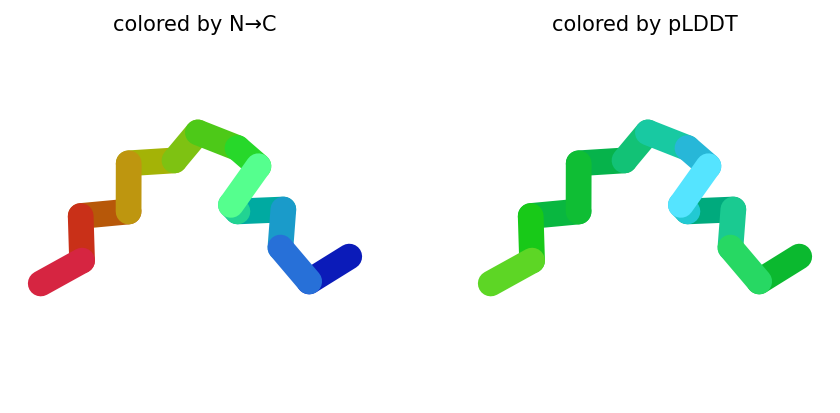

2025-11-17 08:28:55,566 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=65.4 pTM=0.0281
2025-11-17 08:28:58,162 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=71.3 pTM=0.0303 tol=1.14
2025-11-17 08:29:00,759 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=73.1 pTM=0.0312 tol=0.556
2025-11-17 08:29:03,358 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.2 pTM=0.032 tol=0.544
2025-11-17 08:29:03,358 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


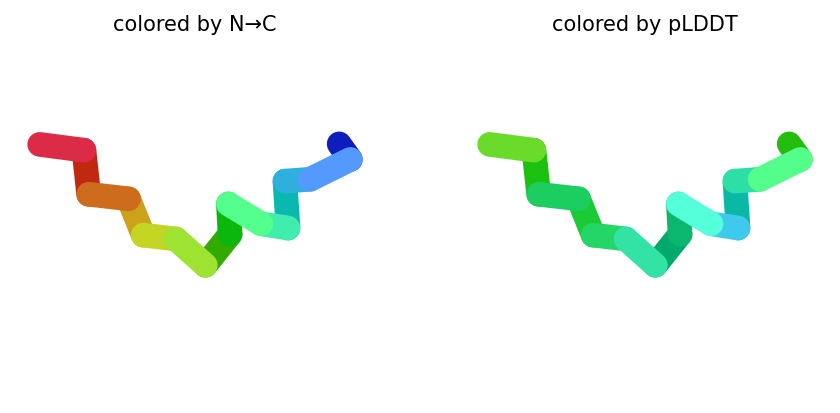

2025-11-17 08:29:06,043 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69.6 pTM=0.0315
2025-11-17 08:29:08,638 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=69.9 pTM=0.0314 tol=0.441
2025-11-17 08:29:11,232 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=71.9 pTM=0.0313 tol=1.05
2025-11-17 08:29:13,823 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=73.1 pTM=0.0312 tol=0.442
2025-11-17 08:29:13,823 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


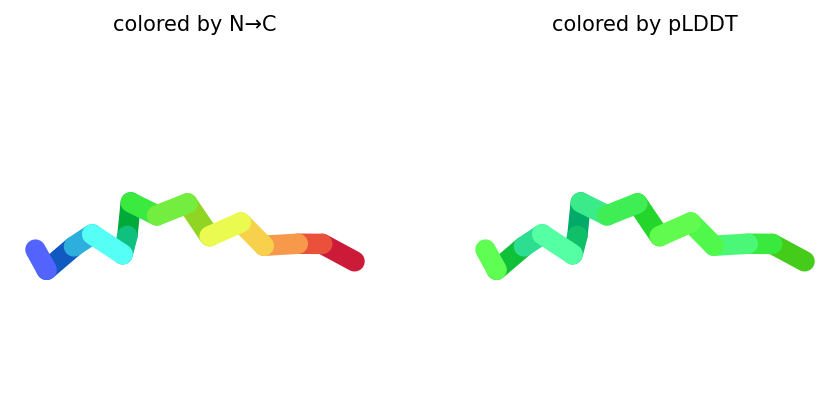

2025-11-17 08:29:13,874 reranking models by 'plddt' metric
2025-11-17 08:29:13,875 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=76.2 pTM=0.0316
2025-11-17 08:29:13,875 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=75.2 pTM=0.032
2025-11-17 08:29:13,875 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=73.4 pTM=0.032
2025-11-17 08:29:13,875 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=73.1 pTM=0.0312
2025-11-17 08:29:13,876 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=71.7 pTM=0.0306
2025-11-17 08:29:15,710 Query 68/146: peptide_151_IC50_410.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:29:16,006 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


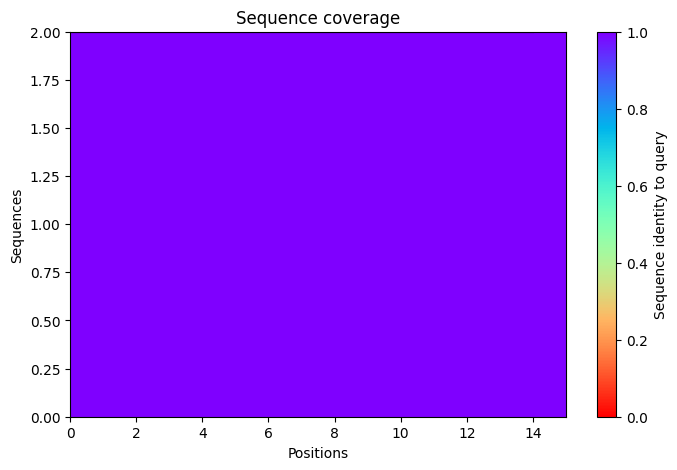

2025-11-17 08:29:29,329 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.8 pTM=0.0371
2025-11-17 08:29:31,905 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=67.9 pTM=0.0356 tol=0.539
2025-11-17 08:29:34,483 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=69.1 pTM=0.0357 tol=0.503
2025-11-17 08:29:37,067 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=67.8 pTM=0.0349 tol=0.0561
2025-11-17 08:29:37,068 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


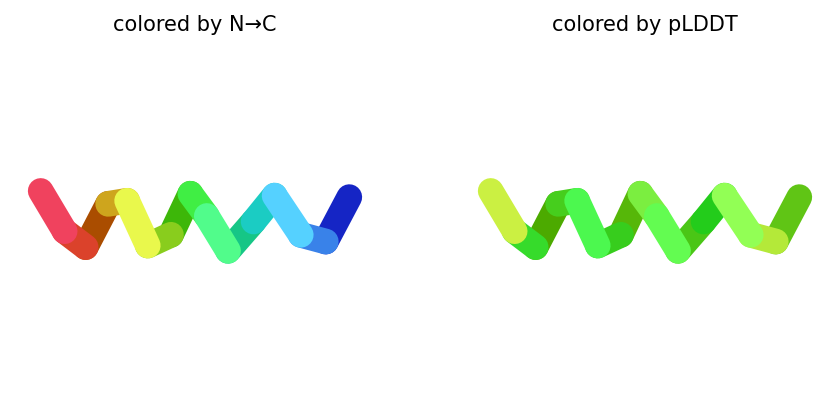

2025-11-17 08:29:39,707 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=66.5 pTM=0.0364
2025-11-17 08:29:42,292 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.8 pTM=0.0332 tol=0.519
2025-11-17 08:29:44,878 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=59.5 pTM=0.0321 tol=0.451
2025-11-17 08:29:47,469 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=58.7 pTM=0.0304 tol=0.188
2025-11-17 08:29:47,470 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


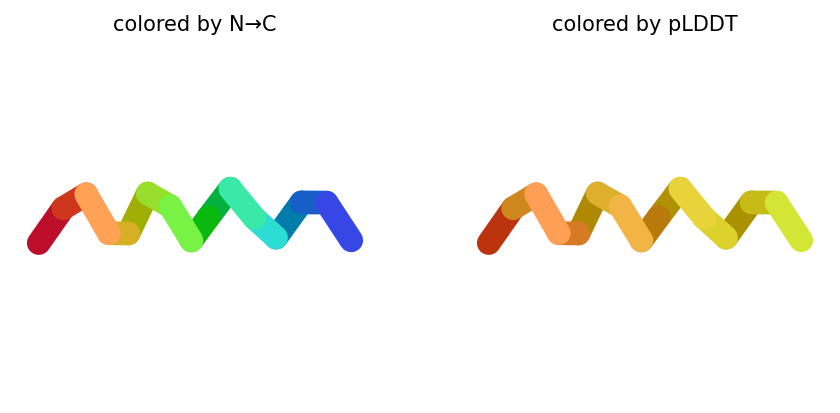

2025-11-17 08:29:50,114 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62 pTM=0.0277
2025-11-17 08:29:52,711 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.8 pTM=0.0287 tol=2.76
2025-11-17 08:29:55,310 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=70.2 pTM=0.0284 tol=0.36
2025-11-17 08:29:57,906 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=68.3 pTM=0.0281 tol=0.313
2025-11-17 08:29:57,907 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


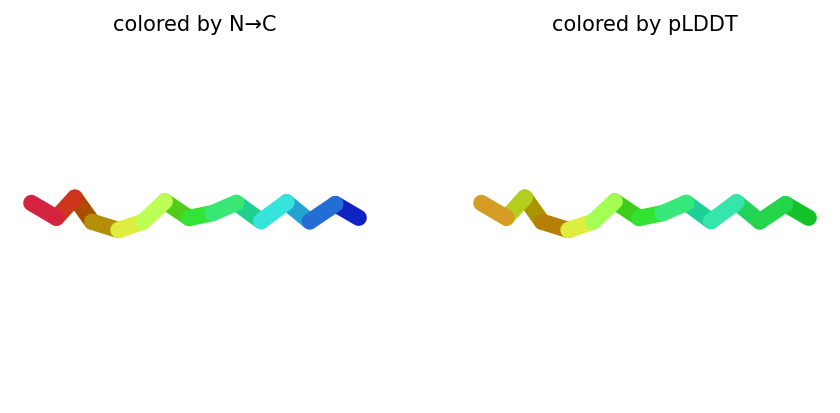

2025-11-17 08:30:00,557 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=65.6 pTM=0.0321
2025-11-17 08:30:03,157 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=64.9 pTM=0.0321 tol=0.17
2025-11-17 08:30:05,751 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=64.9 pTM=0.0322 tol=0.367
2025-11-17 08:30:08,343 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=65.1 pTM=0.0324 tol=0.21
2025-11-17 08:30:08,344 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


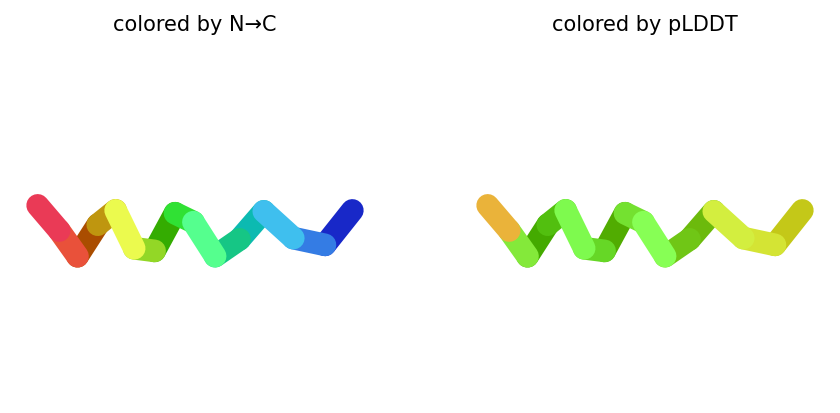

2025-11-17 08:30:10,992 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=60.7 pTM=0.0294
2025-11-17 08:30:13,580 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=63 pTM=0.0303 tol=0.643
2025-11-17 08:30:16,169 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=61.2 pTM=0.0292 tol=0.454
2025-11-17 08:30:18,757 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=60.6 pTM=0.0289 tol=0.134
2025-11-17 08:30:18,758 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


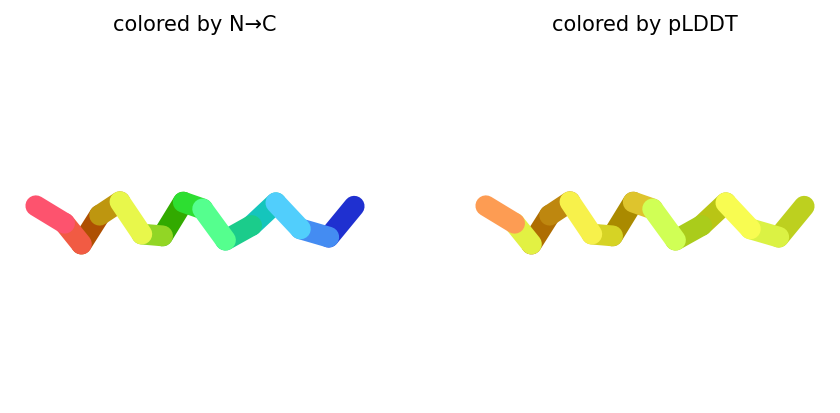

2025-11-17 08:30:18,807 reranking models by 'plddt' metric
2025-11-17 08:30:18,807 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=68.3 pTM=0.0281
2025-11-17 08:30:18,808 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=67.8 pTM=0.0349
2025-11-17 08:30:18,809 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=65.1 pTM=0.0324
2025-11-17 08:30:18,809 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=60.6 pTM=0.0289
2025-11-17 08:30:18,809 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=58.7 pTM=0.0304
2025-11-17 08:30:19,890 Query 69/146: peptide_152_IC50_409.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:30:20,175 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


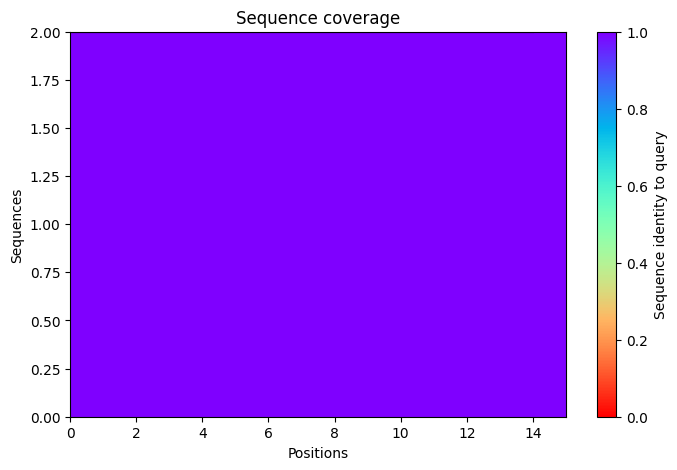

2025-11-17 08:30:35,356 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.2 pTM=0.0297
2025-11-17 08:30:37,924 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=80 pTM=0.0305 tol=0.741
2025-11-17 08:30:40,495 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79.8 pTM=0.0306 tol=0.28
2025-11-17 08:30:43,074 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=80.4 pTM=0.0304 tol=0.121
2025-11-17 08:30:43,075 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


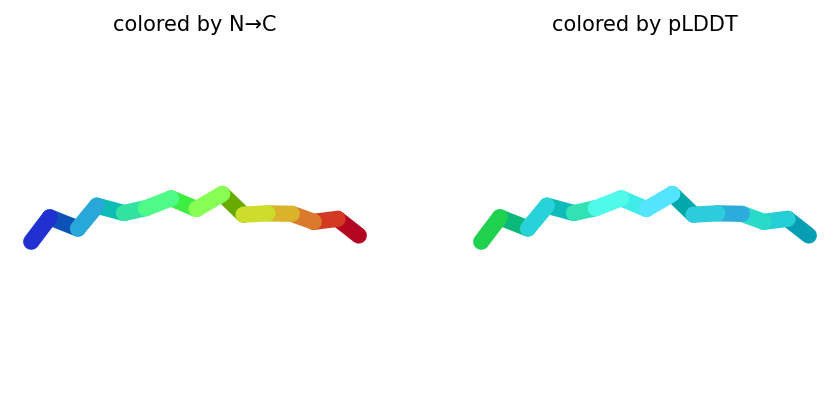

2025-11-17 08:30:45,705 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=75.1 pTM=0.0293
2025-11-17 08:30:48,288 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.8 pTM=0.03 tol=0.365
2025-11-17 08:30:50,869 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=77 pTM=0.0302 tol=0.172
2025-11-17 08:30:53,460 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=77.9 pTM=0.0304 tol=0.106
2025-11-17 08:30:53,461 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


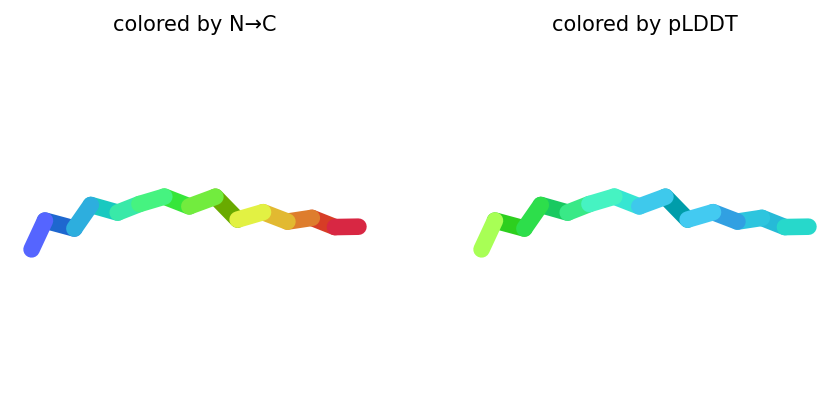

2025-11-17 08:30:56,137 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=78.9 pTM=0.0289
2025-11-17 08:30:58,730 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=81.1 pTM=0.029 tol=0.197
2025-11-17 08:31:01,324 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.6 pTM=0.0294 tol=0.114
2025-11-17 08:31:03,921 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.6 pTM=0.029 tol=0.0803
2025-11-17 08:31:03,922 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


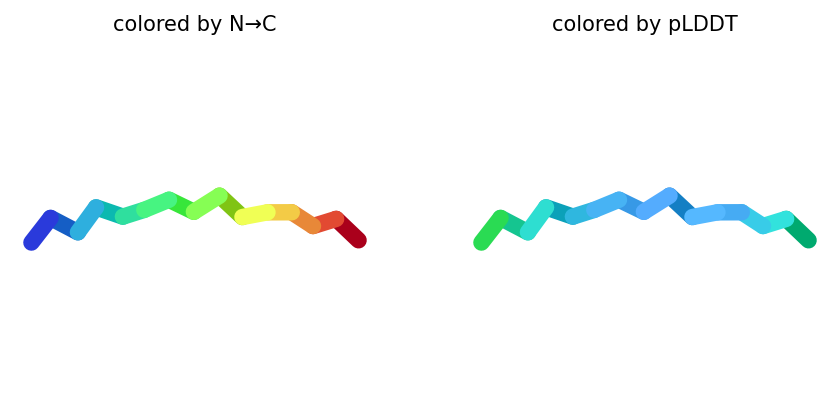

2025-11-17 08:31:06,598 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=77.1 pTM=0.0289
2025-11-17 08:31:09,202 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=78.5 pTM=0.0294 tol=0.113
2025-11-17 08:31:11,805 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78.8 pTM=0.0296 tol=0.0464
2025-11-17 08:31:14,404 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.2 pTM=0.0295 tol=0.0861
2025-11-17 08:31:14,404 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


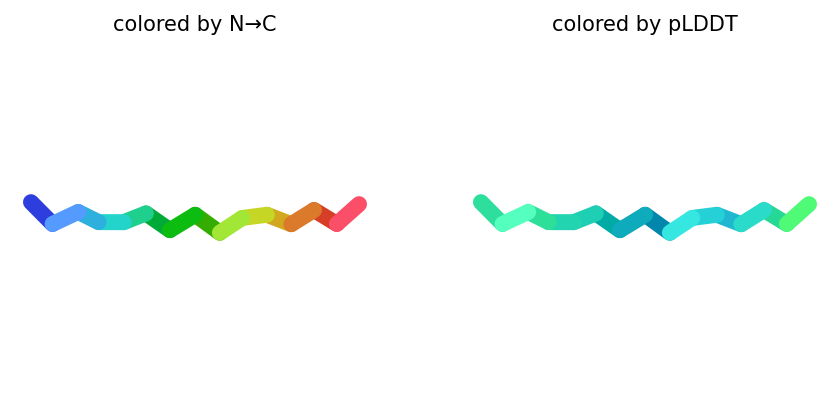

2025-11-17 08:31:17,055 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=74.1 pTM=0.029
2025-11-17 08:31:19,652 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.6 pTM=0.0294 tol=0.935
2025-11-17 08:31:22,244 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=78.9 pTM=0.0299 tol=0.364
2025-11-17 08:31:24,836 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=80.8 pTM=0.0296 tol=0.267
2025-11-17 08:31:24,836 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


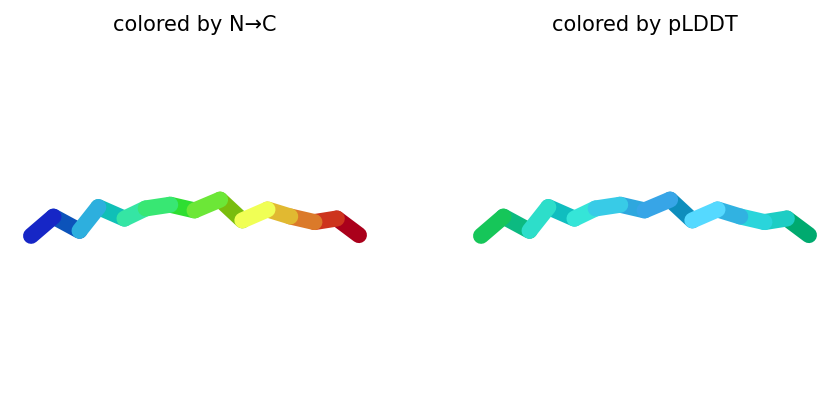

2025-11-17 08:31:24,884 reranking models by 'plddt' metric
2025-11-17 08:31:24,884 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=81.6 pTM=0.029
2025-11-17 08:31:24,885 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=80.8 pTM=0.0296
2025-11-17 08:31:24,885 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=80.4 pTM=0.0304
2025-11-17 08:31:24,885 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=79.2 pTM=0.0295
2025-11-17 08:31:24,885 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=77.9 pTM=0.0304
2025-11-17 08:31:25,956 Query 70/146: peptide_157_IC50_411.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:31:26,254 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


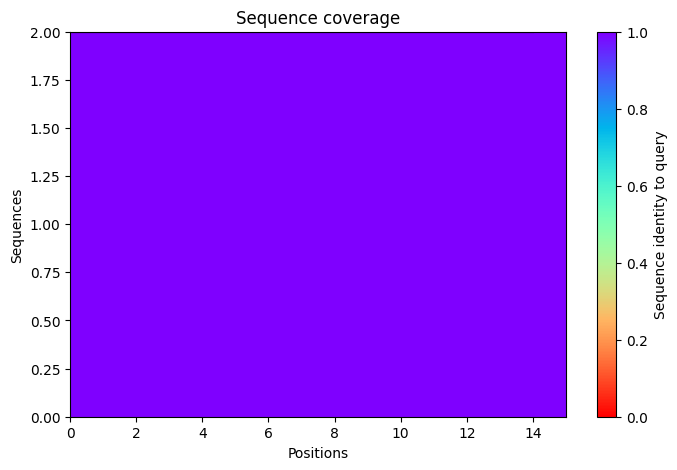

2025-11-17 08:31:41,401 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=71.6 pTM=0.034
2025-11-17 08:31:43,979 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.7 pTM=0.0362 tol=0.244
2025-11-17 08:31:46,559 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.3 pTM=0.0361 tol=0.374
2025-11-17 08:31:49,138 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=75.9 pTM=0.0374 tol=0.295
2025-11-17 08:31:49,138 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


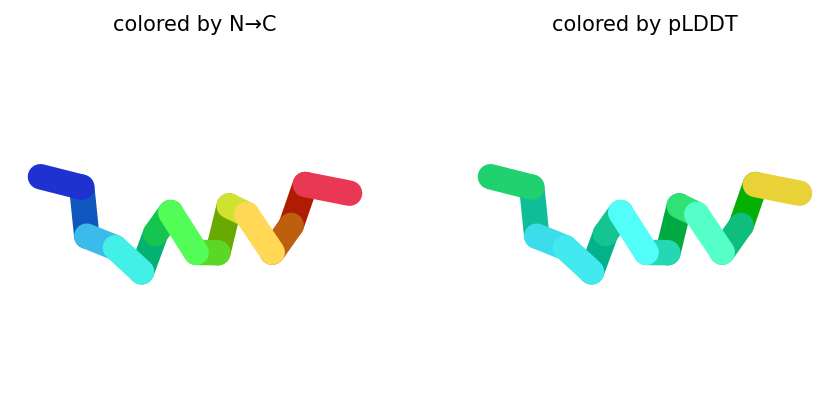

2025-11-17 08:31:51,774 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.4 pTM=0.0323
2025-11-17 08:31:54,352 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.9 pTM=0.0321 tol=0.152
2025-11-17 08:31:56,937 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=66.3 pTM=0.0319 tol=0.158
2025-11-17 08:31:59,518 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=67.8 pTM=0.0326 tol=0.0939
2025-11-17 08:31:59,519 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


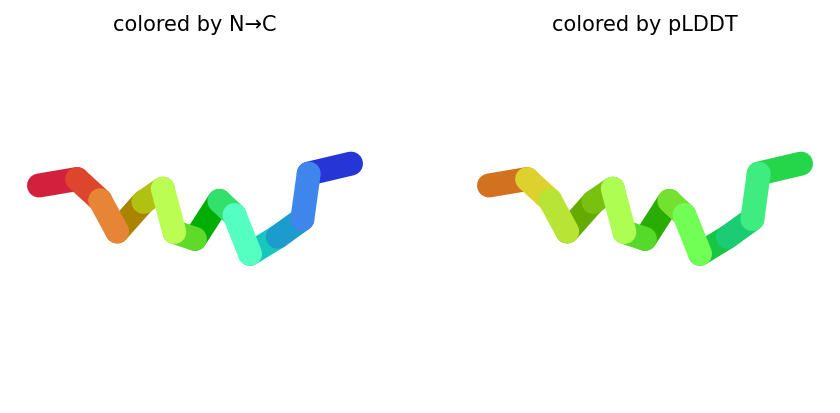

2025-11-17 08:32:02,158 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=67 pTM=0.0269
2025-11-17 08:32:04,752 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=67.7 pTM=0.0268 tol=0.348
2025-11-17 08:32:07,346 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=67.6 pTM=0.027 tol=0.233
2025-11-17 08:32:09,944 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=68.3 pTM=0.0272 tol=0.624
2025-11-17 08:32:09,945 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


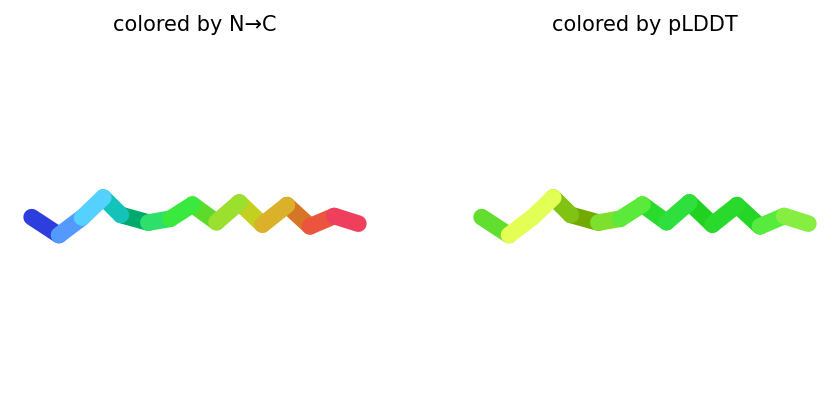

2025-11-17 08:32:12,598 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=65.9 pTM=0.0282
2025-11-17 08:32:15,199 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.4 pTM=0.0286 tol=0.707
2025-11-17 08:32:17,798 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=67.1 pTM=0.0288 tol=0.677
2025-11-17 08:32:20,396 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=67.1 pTM=0.0284 tol=0.201
2025-11-17 08:32:20,397 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


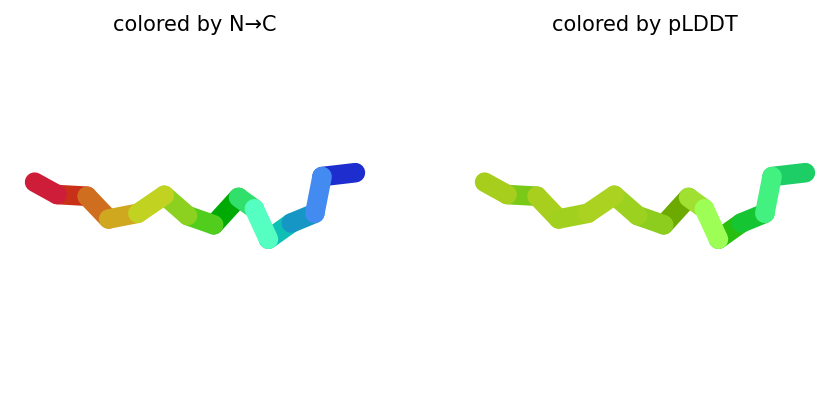

2025-11-17 08:32:23,042 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=71.1 pTM=0.0322
2025-11-17 08:32:25,635 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70 pTM=0.0317 tol=0.195
2025-11-17 08:32:28,225 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=67.8 pTM=0.0299 tol=0.508
2025-11-17 08:32:30,813 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=68.2 pTM=0.0297 tol=0.229
2025-11-17 08:32:30,814 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


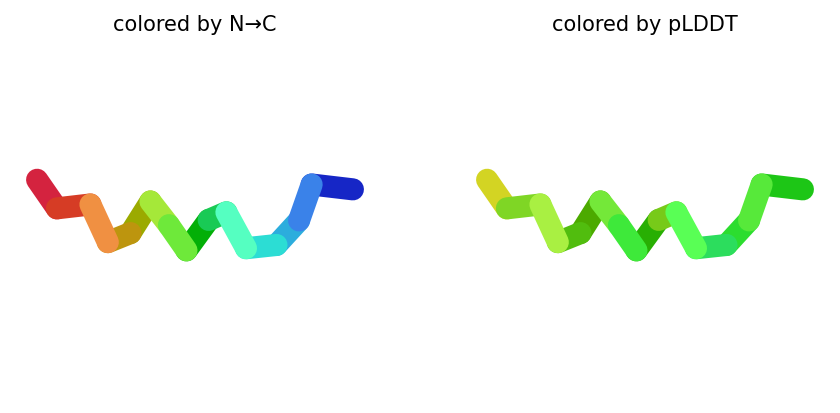

2025-11-17 08:32:30,866 reranking models by 'plddt' metric
2025-11-17 08:32:30,868 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=75.9 pTM=0.0374
2025-11-17 08:32:30,868 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=68.3 pTM=0.0272
2025-11-17 08:32:30,868 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=68.2 pTM=0.0297
2025-11-17 08:32:30,869 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=67.8 pTM=0.0326
2025-11-17 08:32:30,869 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=67.1 pTM=0.0284
2025-11-17 08:32:32,385 Query 71/146: peptide_158_IC50_415.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:32:33,045 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


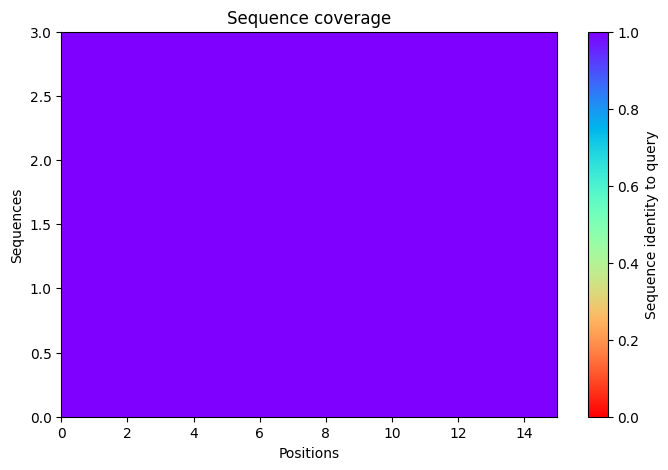

2025-11-17 08:32:46,640 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=73.5 pTM=0.029
2025-11-17 08:32:49,216 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=78.4 pTM=0.0321 tol=0.428
2025-11-17 08:32:51,790 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.6 pTM=0.0331 tol=0.279
2025-11-17 08:32:54,368 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=81.2 pTM=0.034 tol=0.285
2025-11-17 08:32:54,369 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


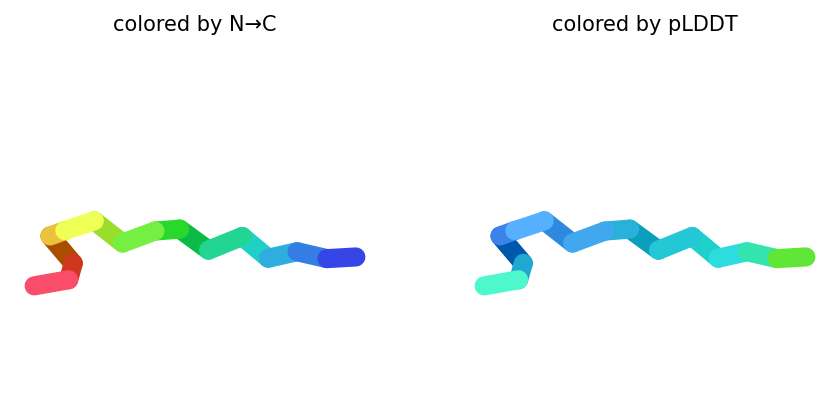

2025-11-17 08:32:57,029 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=72.8 pTM=0.0281
2025-11-17 08:32:59,607 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.4 pTM=0.0289 tol=0.613
2025-11-17 08:33:02,190 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.6 pTM=0.029 tol=0.131
2025-11-17 08:33:04,777 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.5 pTM=0.0282 tol=0.146
2025-11-17 08:33:04,778 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


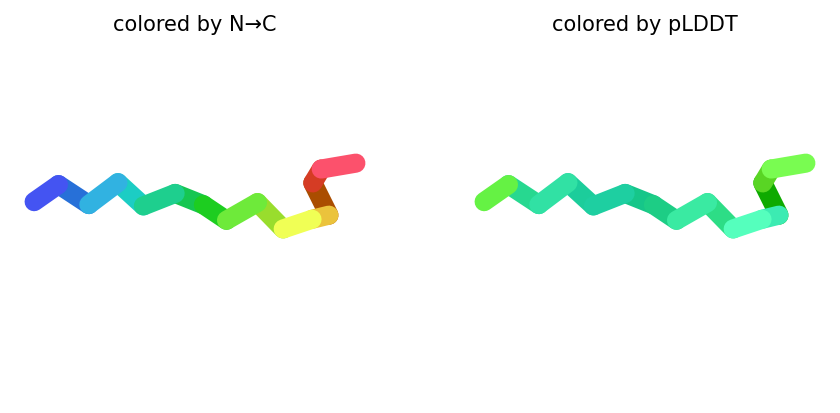

2025-11-17 08:33:07,425 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=80.8 pTM=0.0297
2025-11-17 08:33:10,016 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=84.9 pTM=0.0321 tol=0.276
2025-11-17 08:33:12,609 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=85.3 pTM=0.0324 tol=0.0641
2025-11-17 08:33:15,205 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=87.4 pTM=0.0331 tol=0.278
2025-11-17 08:33:15,206 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


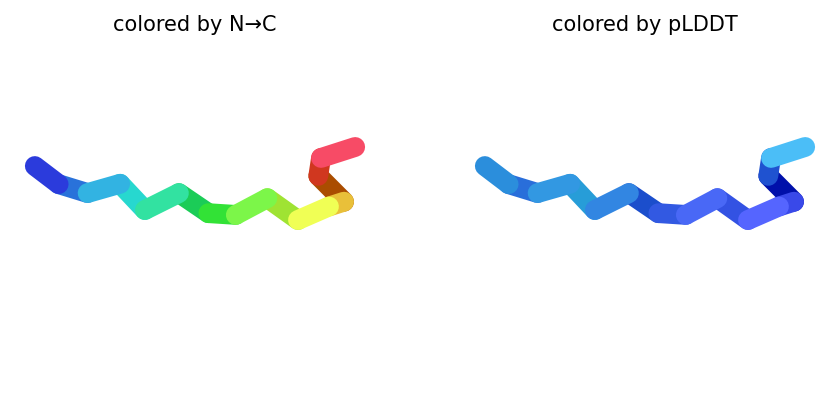

2025-11-17 08:33:17,862 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.9 pTM=0.0285
2025-11-17 08:33:20,461 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=79.8 pTM=0.0308 tol=0.156
2025-11-17 08:33:23,059 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80.1 pTM=0.031 tol=0.0556
2025-11-17 08:33:25,656 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=81.4 pTM=0.0312 tol=0.124
2025-11-17 08:33:25,657 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


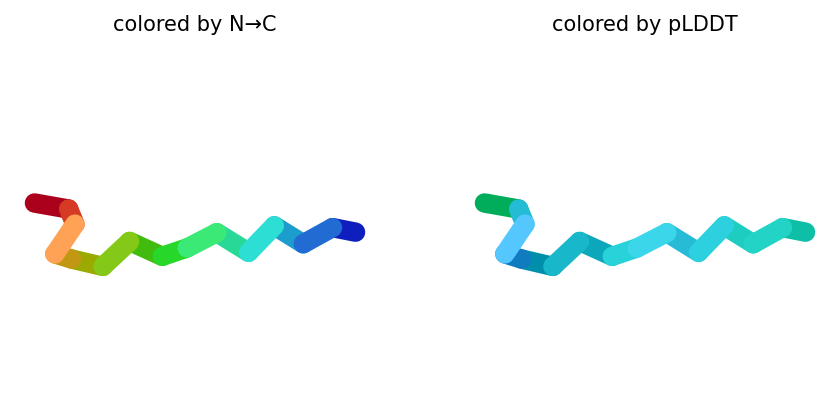

2025-11-17 08:33:28,303 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=72.6 pTM=0.0278
2025-11-17 08:33:30,896 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=72.8 pTM=0.0273 tol=0.382
2025-11-17 08:33:33,488 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.9 pTM=0.0274 tol=0.223
2025-11-17 08:33:36,073 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.6 pTM=0.0278 tol=0.393
2025-11-17 08:33:36,074 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


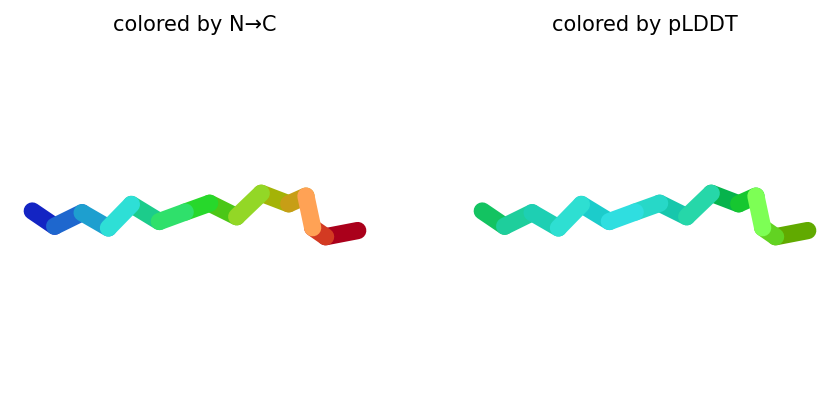

2025-11-17 08:33:36,124 reranking models by 'plddt' metric
2025-11-17 08:33:36,125 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=87.4 pTM=0.0331
2025-11-17 08:33:36,125 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=81.4 pTM=0.0312
2025-11-17 08:33:36,125 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=81.2 pTM=0.034
2025-11-17 08:33:36,126 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=75.6 pTM=0.0278
2025-11-17 08:33:36,126 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.5 pTM=0.0282
2025-11-17 08:33:37,205 Query 72/146: peptide_159_IC50_415.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:33:37,500 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


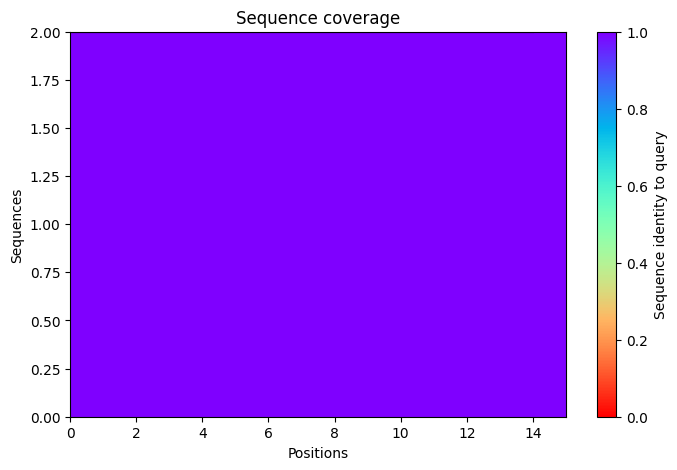

2025-11-17 08:33:52,650 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=83.6 pTM=0.0349
2025-11-17 08:33:55,228 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83.1 pTM=0.0353 tol=0.143
2025-11-17 08:33:57,806 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.9 pTM=0.0329 tol=0.302
2025-11-17 08:34:00,384 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=70.6 pTM=0.0312 tol=0.284
2025-11-17 08:34:00,385 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


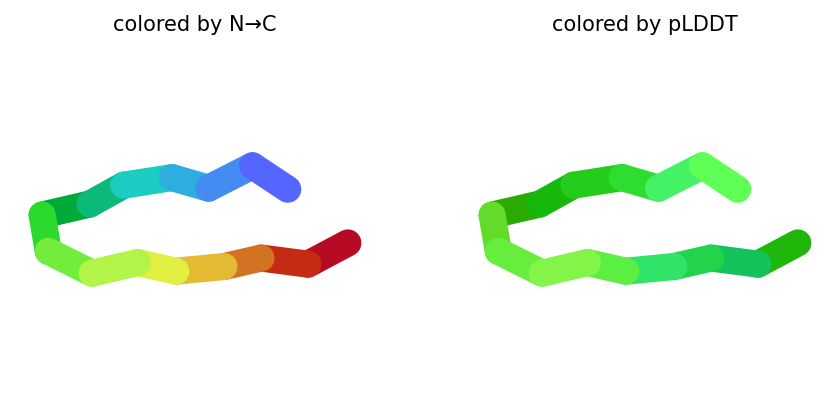

2025-11-17 08:34:03,019 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=82.9 pTM=0.034
2025-11-17 08:34:05,597 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70.8 pTM=0.0287 tol=8.57
2025-11-17 08:34:08,183 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.3 pTM=0.0292 tol=1.96
2025-11-17 08:34:10,766 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=77.5 pTM=0.0291 tol=0.177
2025-11-17 08:34:10,767 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


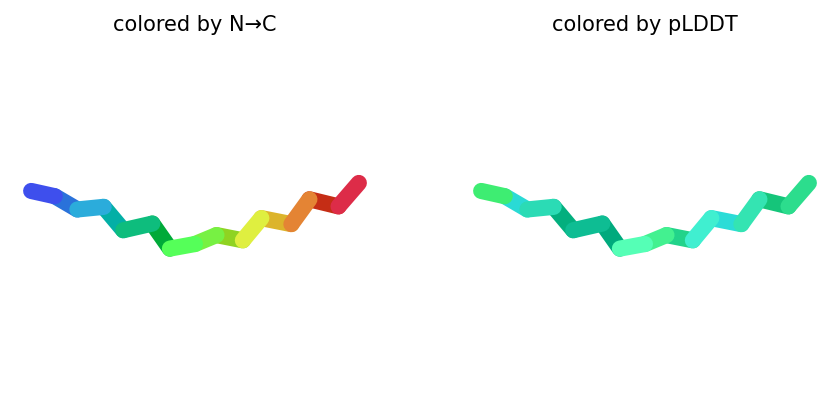

2025-11-17 08:34:13,406 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=75.4 pTM=0.0309
2025-11-17 08:34:15,998 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=69.1 pTM=0.0278 tol=4.96
2025-11-17 08:34:18,590 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.7 pTM=0.028 tol=5.34
2025-11-17 08:34:21,187 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77.7 pTM=0.0283 tol=0.542
2025-11-17 08:34:21,188 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


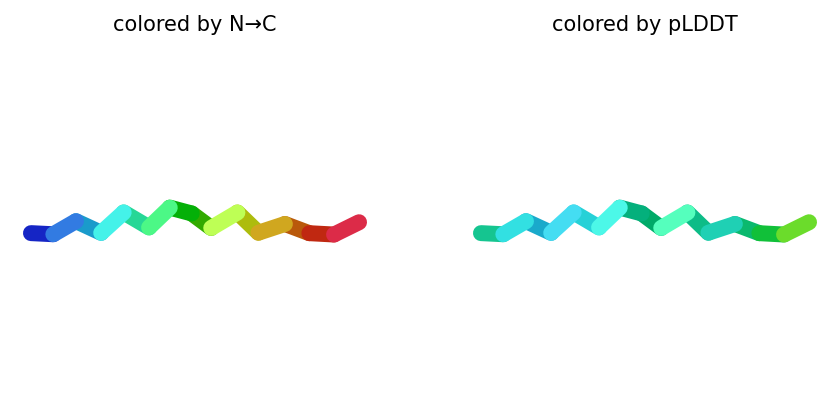

2025-11-17 08:34:23,836 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=79.9 pTM=0.0338
2025-11-17 08:34:26,436 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=71.8 pTM=0.0304 tol=0.865
2025-11-17 08:34:29,033 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.3 pTM=0.0293 tol=8.84
2025-11-17 08:34:31,630 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=72.8 pTM=0.0291 tol=0.948
2025-11-17 08:34:31,631 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


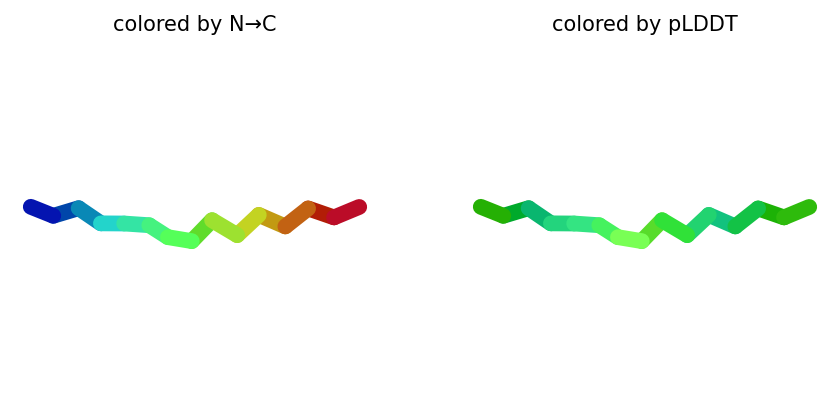

2025-11-17 08:34:34,306 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=84.2 pTM=0.0343
2025-11-17 08:34:36,898 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=78.2 pTM=0.0323 tol=0.193
2025-11-17 08:34:39,486 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76.8 pTM=0.0313 tol=0.296
2025-11-17 08:34:42,073 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.4 pTM=0.0311 tol=0.211
2025-11-17 08:34:42,074 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


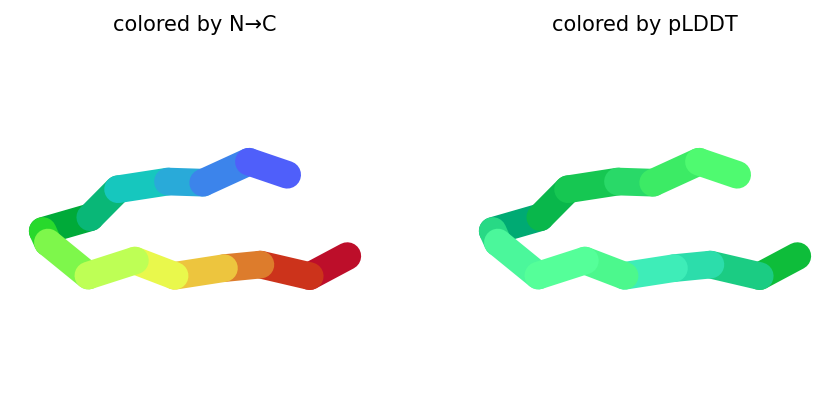

2025-11-17 08:34:42,125 reranking models by 'plddt' metric
2025-11-17 08:34:42,125 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=77.7 pTM=0.0283
2025-11-17 08:34:42,127 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=77.5 pTM=0.0291
2025-11-17 08:34:42,127 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=75.4 pTM=0.0311
2025-11-17 08:34:42,127 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=72.8 pTM=0.0291
2025-11-17 08:34:42,128 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=70.6 pTM=0.0312
2025-11-17 08:34:43,295 Query 73/146: peptide_161_IC50_413.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:34:43,587 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


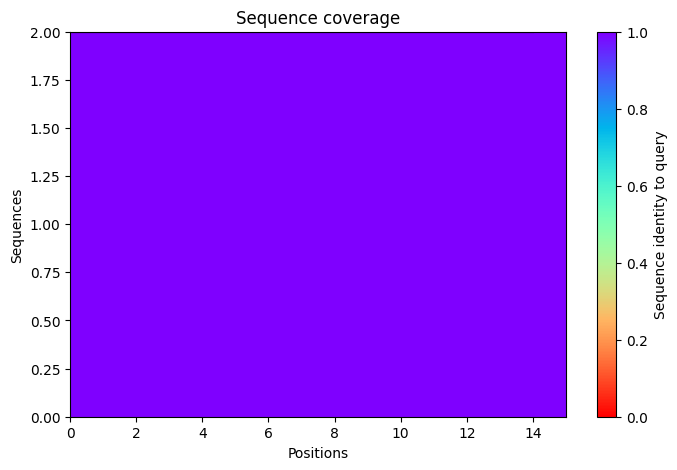

2025-11-17 08:34:57,766 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.1 pTM=0.0374
2025-11-17 08:35:00,340 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72.4 pTM=0.037 tol=0.201
2025-11-17 08:35:02,916 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.7 pTM=0.0369 tol=0.136
2025-11-17 08:35:05,493 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.2 pTM=0.0363 tol=0.149
2025-11-17 08:35:05,494 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


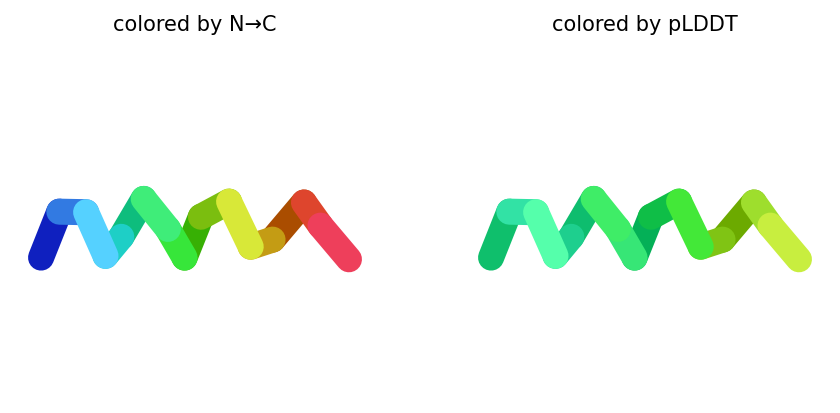

2025-11-17 08:35:08,129 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=66.4 pTM=0.0341
2025-11-17 08:35:10,713 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.7 pTM=0.0302 tol=0.984
2025-11-17 08:35:13,294 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.2 pTM=0.0283 tol=0.64
2025-11-17 08:35:15,881 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60.6 pTM=0.0284 tol=0.22
2025-11-17 08:35:15,881 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


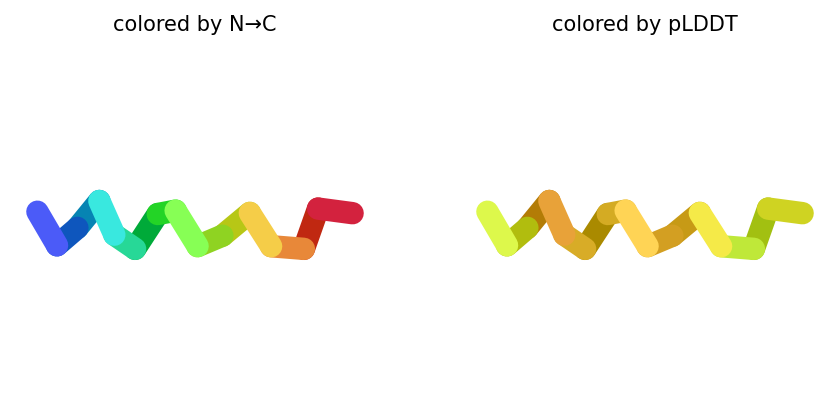

2025-11-17 08:35:18,521 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62.7 pTM=0.0268
2025-11-17 08:35:21,113 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.9 pTM=0.0273 tol=1.21
2025-11-17 08:35:23,708 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72 pTM=0.0277 tol=0.757
2025-11-17 08:35:26,305 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.8 pTM=0.0277 tol=0.324
2025-11-17 08:35:26,306 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


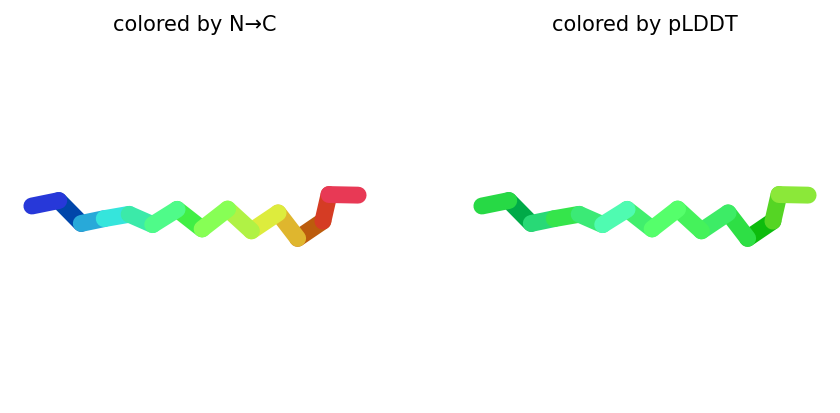

2025-11-17 08:35:28,953 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.3 pTM=0.0279
2025-11-17 08:35:31,554 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=60 pTM=0.0278 tol=1.74
2025-11-17 08:35:34,150 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=63.1 pTM=0.0276 tol=0.777
2025-11-17 08:35:36,748 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=63.3 pTM=0.0275 tol=0.288
2025-11-17 08:35:36,749 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


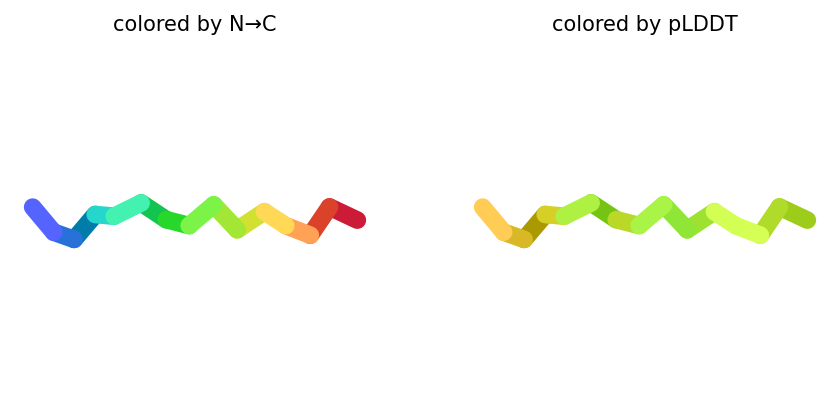

2025-11-17 08:35:39,392 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.4 pTM=0.0354
2025-11-17 08:35:41,984 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67 pTM=0.0337 tol=0.918
2025-11-17 08:35:44,576 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.1 pTM=0.0327 tol=0.358
2025-11-17 08:35:47,167 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=65.9 pTM=0.0326 tol=0.155
2025-11-17 08:35:47,168 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


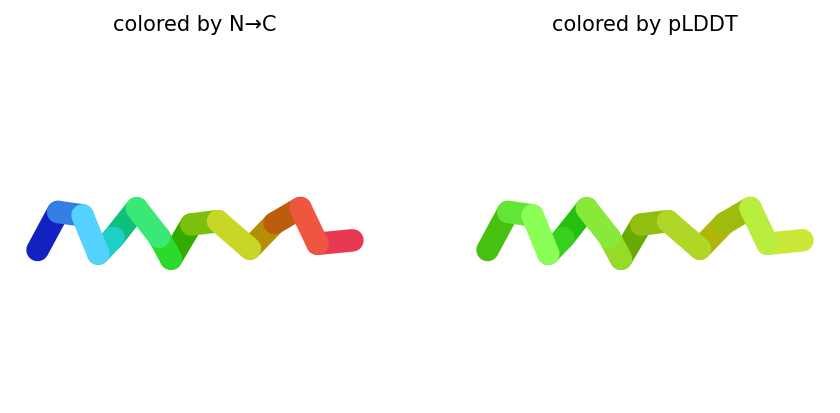

2025-11-17 08:35:47,218 reranking models by 'plddt' metric
2025-11-17 08:35:47,218 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=72.8 pTM=0.0277
2025-11-17 08:35:47,219 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=72.2 pTM=0.0363
2025-11-17 08:35:47,219 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=65.9 pTM=0.0326
2025-11-17 08:35:47,220 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=63.3 pTM=0.0275
2025-11-17 08:35:47,220 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60.6 pTM=0.0284
2025-11-17 08:35:48,688 Query 74/146: peptide_167_IC50_416.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:35:48,961 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


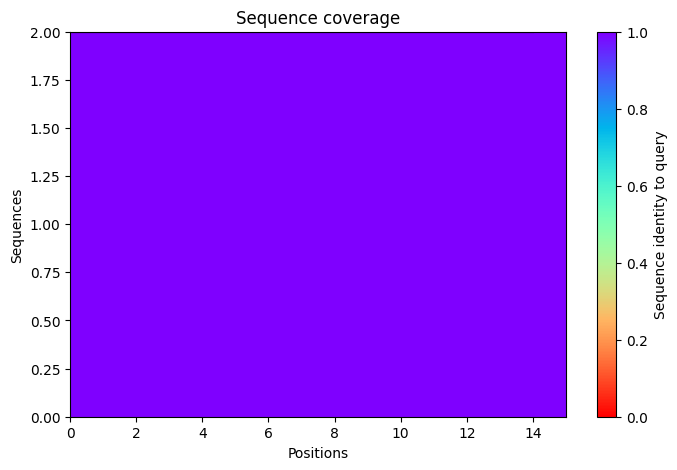

2025-11-17 08:36:00,606 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66.8 pTM=0.0325
2025-11-17 08:36:03,186 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.9 pTM=0.0348 tol=0.186
2025-11-17 08:36:05,761 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=70.9 pTM=0.0355 tol=0.201
2025-11-17 08:36:08,338 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=69.8 pTM=0.035 tol=0.155
2025-11-17 08:36:08,339 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


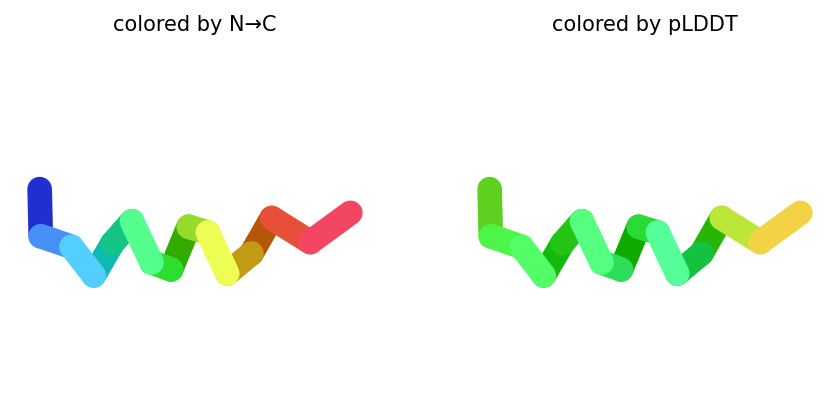

2025-11-17 08:36:10,969 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.8 pTM=0.0319
2025-11-17 08:36:13,550 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=64.2 pTM=0.0323 tol=0.194
2025-11-17 08:36:16,135 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63.6 pTM=0.0317 tol=0.394
2025-11-17 08:36:18,720 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=63.6 pTM=0.0315 tol=0.106
2025-11-17 08:36:18,721 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


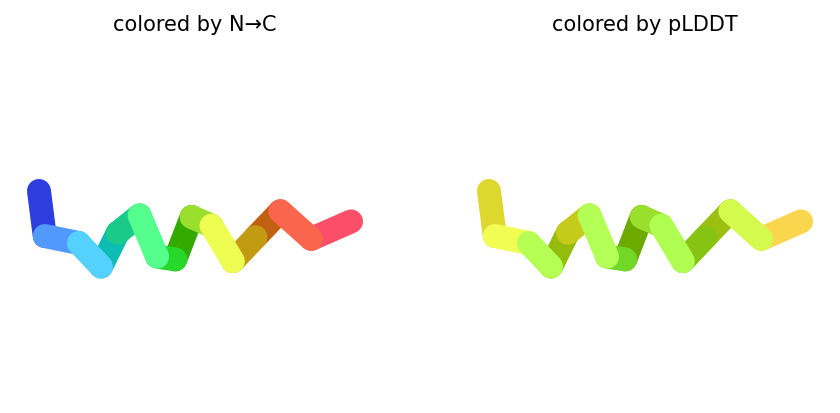

2025-11-17 08:36:21,362 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62.6 pTM=0.0264
2025-11-17 08:36:23,951 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=62.8 pTM=0.0268 tol=1.25
2025-11-17 08:36:26,544 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63.6 pTM=0.0267 tol=0.427
2025-11-17 08:36:29,136 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=63.8 pTM=0.0267 tol=0.473
2025-11-17 08:36:29,136 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


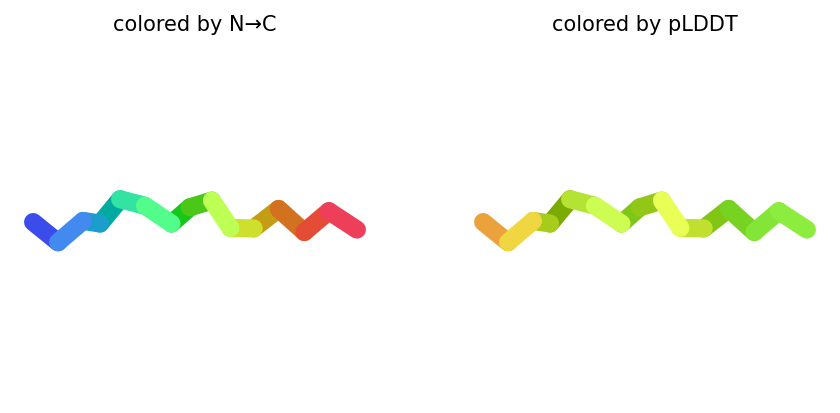

2025-11-17 08:36:31,781 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=60.4 pTM=0.0282
2025-11-17 08:36:34,374 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=60.8 pTM=0.0276 tol=1.03
2025-11-17 08:36:36,968 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=60.6 pTM=0.0276 tol=1.13
2025-11-17 08:36:39,555 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=61.9 pTM=0.0276 tol=0.339
2025-11-17 08:36:39,556 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


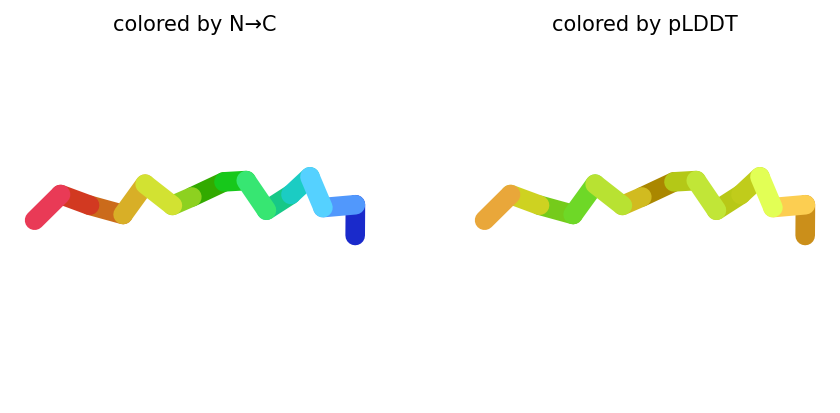

2025-11-17 08:36:42,194 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.9 pTM=0.0337
2025-11-17 08:36:44,781 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.5 pTM=0.0348 tol=0.204
2025-11-17 08:36:47,374 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=67.4 pTM=0.0333 tol=0.239
2025-11-17 08:36:49,961 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=66.3 pTM=0.0325 tol=0.281
2025-11-17 08:36:49,962 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


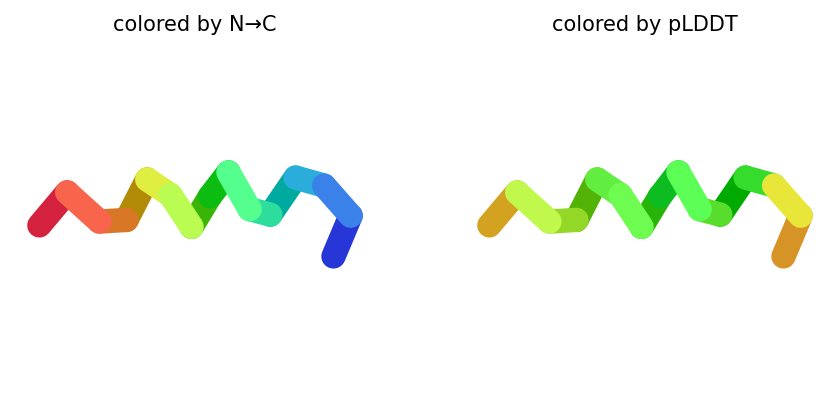

2025-11-17 08:36:50,016 reranking models by 'plddt' metric
2025-11-17 08:36:50,016 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=69.8 pTM=0.035
2025-11-17 08:36:50,017 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=66.3 pTM=0.0325
2025-11-17 08:36:50,017 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=63.8 pTM=0.0267
2025-11-17 08:36:50,017 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=63.6 pTM=0.0315
2025-11-17 08:36:50,018 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=61.9 pTM=0.0276
2025-11-17 08:36:51,094 Query 75/146: peptide_168_IC50_417.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:36:51,381 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


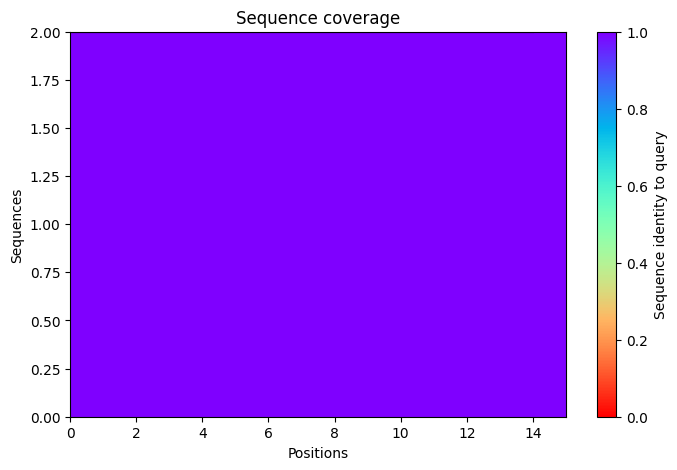

2025-11-17 08:37:03,221 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=87.3 pTM=0.0432
2025-11-17 08:37:05,797 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=85.9 pTM=0.0425 tol=0.09
2025-11-17 08:37:08,373 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=84.9 pTM=0.0421 tol=0.0864
2025-11-17 08:37:10,958 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=84.3 pTM=0.0419 tol=0.0684
2025-11-17 08:37:10,959 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


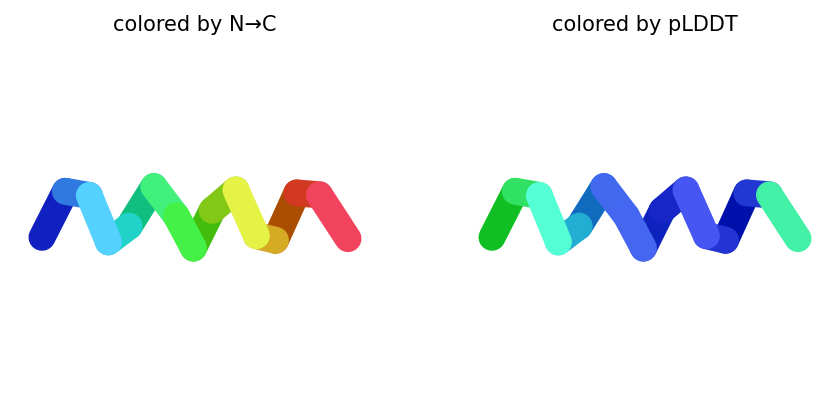

2025-11-17 08:37:13,625 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=82.6 pTM=0.0419
2025-11-17 08:37:16,211 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=77.2 pTM=0.0394 tol=0.0529
2025-11-17 08:37:18,794 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.9 pTM=0.0392 tol=0.103
2025-11-17 08:37:21,384 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76.3 pTM=0.039 tol=0.0397
2025-11-17 08:37:21,384 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


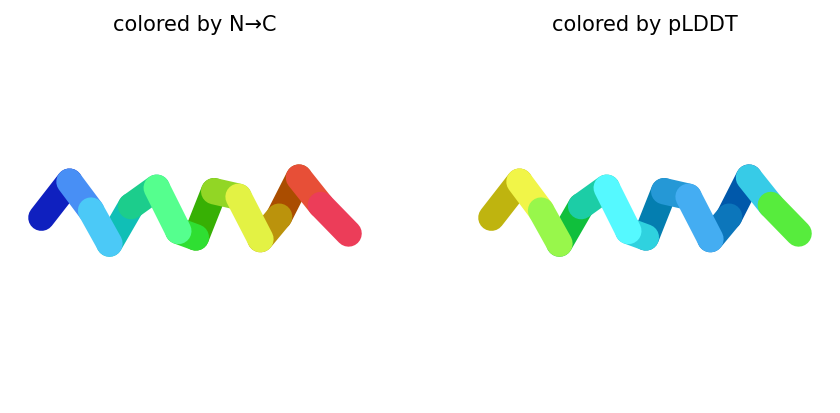

2025-11-17 08:37:24,031 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=87.1 pTM=0.0405
2025-11-17 08:37:26,630 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=88 pTM=0.0422 tol=0.0895
2025-11-17 08:37:29,228 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=88.8 pTM=0.0432 tol=0.03
2025-11-17 08:37:31,825 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=89.1 pTM=0.0438 tol=0.0569
2025-11-17 08:37:31,825 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


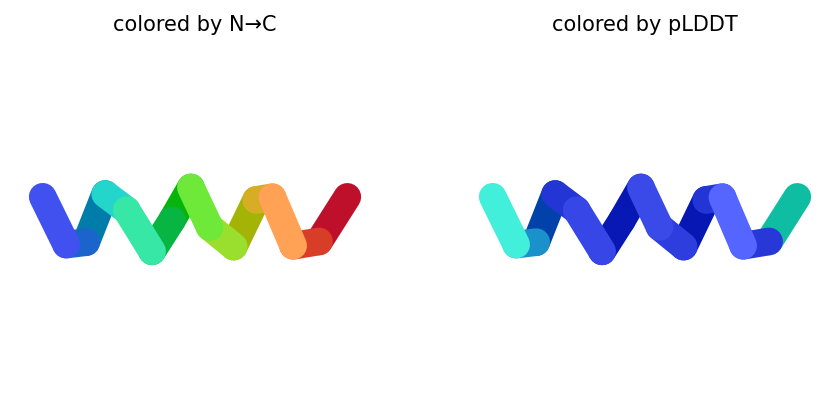

2025-11-17 08:37:34,476 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=78.5 pTM=0.0375
2025-11-17 08:37:37,074 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=79 pTM=0.0384 tol=0.101
2025-11-17 08:37:39,670 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80.1 pTM=0.039 tol=0.0554
2025-11-17 08:37:42,256 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=81.1 pTM=0.0396 tol=0.0305
2025-11-17 08:37:42,257 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


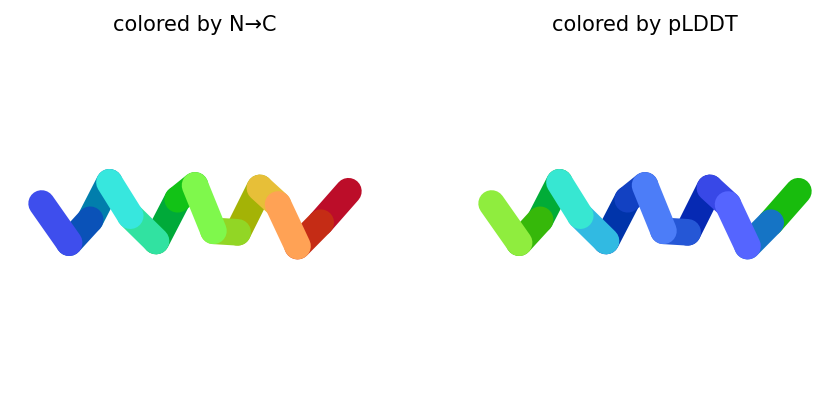

2025-11-17 08:37:44,899 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=91.3 pTM=0.0442
2025-11-17 08:37:47,487 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=90.3 pTM=0.0445 tol=0.0652
2025-11-17 08:37:50,076 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=90.7 pTM=0.0441 tol=0.05
2025-11-17 08:37:52,665 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=91.2 pTM=0.0445 tol=0.0475
2025-11-17 08:37:52,665 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


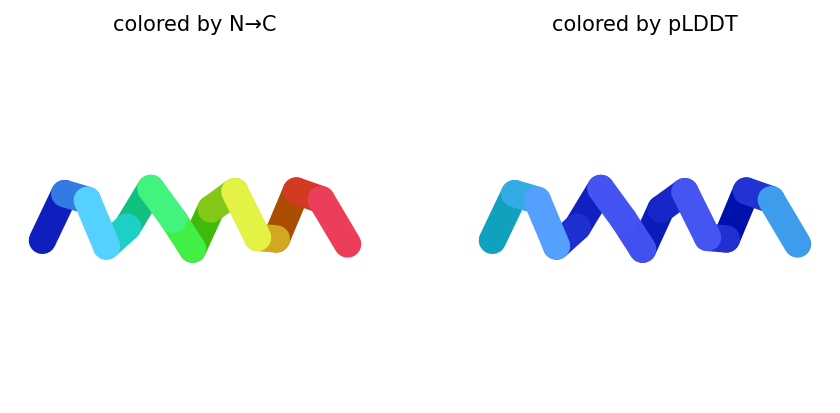

2025-11-17 08:37:52,713 reranking models by 'plddt' metric
2025-11-17 08:37:52,713 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=91.2 pTM=0.0445
2025-11-17 08:37:52,714 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=89.1 pTM=0.0438
2025-11-17 08:37:52,714 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=84.3 pTM=0.0419
2025-11-17 08:37:52,714 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=81.1 pTM=0.0396
2025-11-17 08:37:52,715 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=76.3 pTM=0.039
2025-11-17 08:37:53,806 Query 76/146: peptide_169_IC50_417.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:37:54,462 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


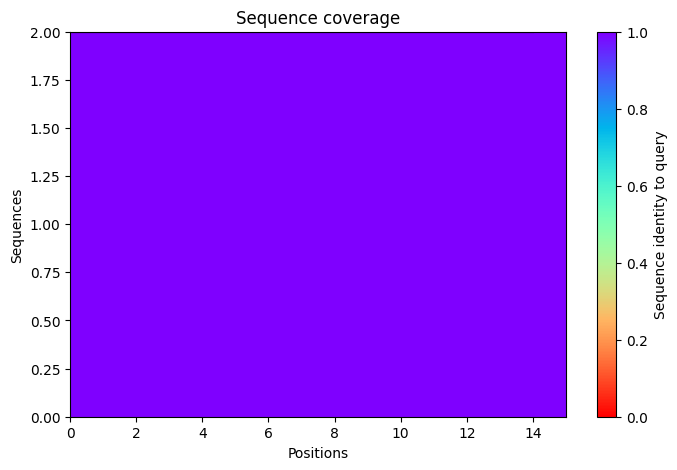

2025-11-17 08:38:05,800 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=59.7 pTM=0.0287
2025-11-17 08:38:08,376 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=57.1 pTM=0.0284 tol=1.15
2025-11-17 08:38:10,958 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=58.7 pTM=0.029 tol=1.21
2025-11-17 08:38:13,537 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=58.7 pTM=0.03 tol=0.89
2025-11-17 08:38:13,538 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


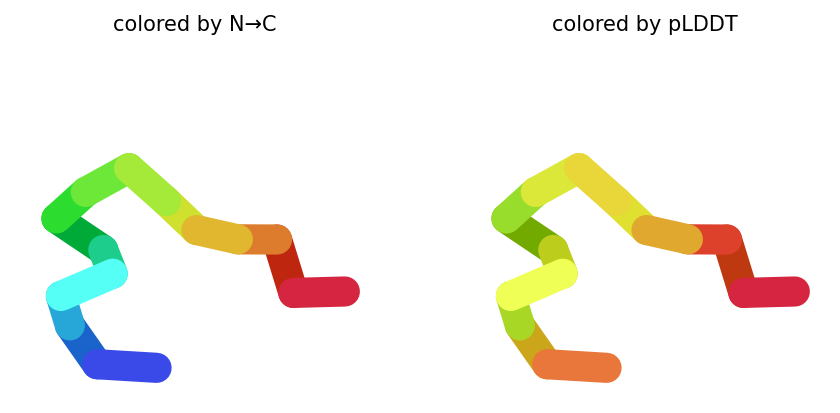

2025-11-17 08:38:16,170 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=57.9 pTM=0.0275
2025-11-17 08:38:18,752 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=56.9 pTM=0.0272 tol=0.938
2025-11-17 08:38:21,338 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=57.3 pTM=0.0273 tol=0.544
2025-11-17 08:38:23,929 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=57.5 pTM=0.028 tol=0.709
2025-11-17 08:38:23,930 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


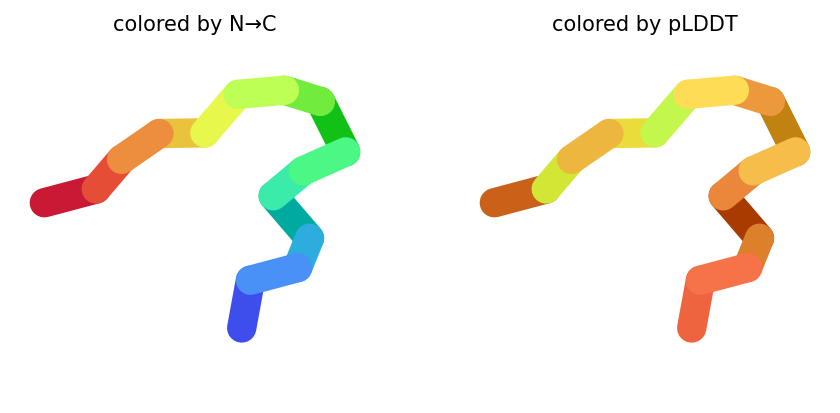

2025-11-17 08:38:26,608 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.9 pTM=0.0294
2025-11-17 08:38:29,197 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=64.9 pTM=0.0276 tol=1.43
2025-11-17 08:38:31,792 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=64 pTM=0.0279 tol=0.968
2025-11-17 08:38:34,388 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=63.8 pTM=0.0277 tol=0.208
2025-11-17 08:38:34,389 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


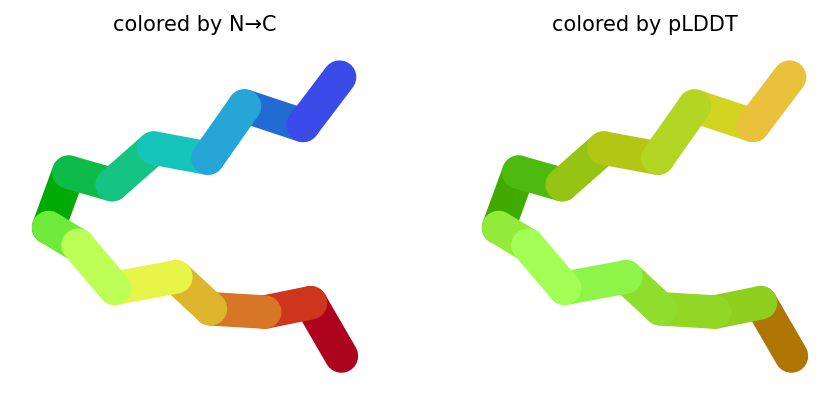

2025-11-17 08:38:37,044 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=71.8 pTM=0.0303
2025-11-17 08:38:39,640 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.8 pTM=0.0285 tol=1.94
2025-11-17 08:38:42,231 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=65 pTM=0.0285 tol=0.304
2025-11-17 08:38:44,823 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=66.1 pTM=0.0288 tol=0.386
2025-11-17 08:38:44,824 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


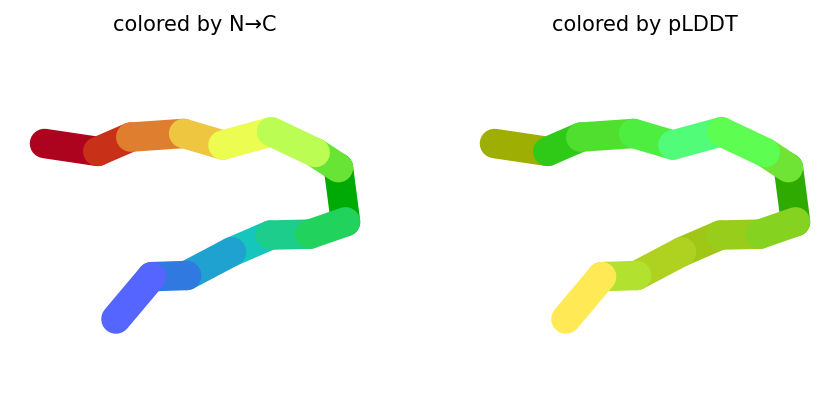

2025-11-17 08:38:47,474 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=83.6 pTM=0.0358
2025-11-17 08:38:50,066 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=80.9 pTM=0.0343 tol=0.308
2025-11-17 08:38:52,656 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76.9 pTM=0.0326 tol=0.178
2025-11-17 08:38:55,244 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.9 pTM=0.0322 tol=0.0531
2025-11-17 08:38:55,245 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


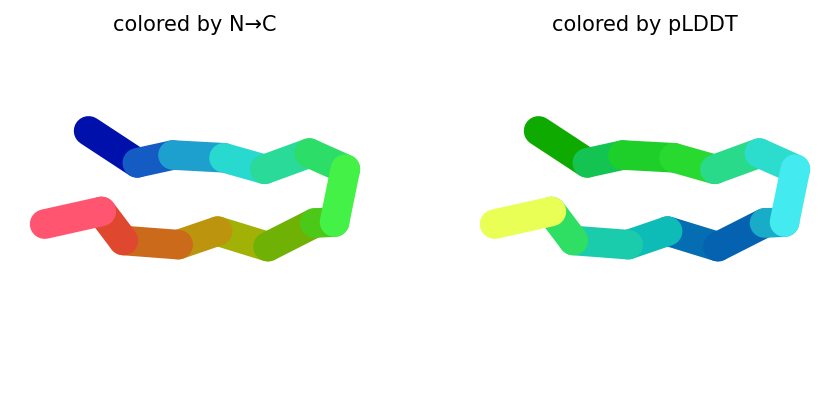

2025-11-17 08:38:55,297 reranking models by 'plddt' metric
2025-11-17 08:38:55,298 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=75.9 pTM=0.0322
2025-11-17 08:38:55,298 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=66.1 pTM=0.0288
2025-11-17 08:38:55,298 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=63.8 pTM=0.0277
2025-11-17 08:38:55,299 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=58.7 pTM=0.03
2025-11-17 08:38:55,299 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=57.5 pTM=0.028
2025-11-17 08:38:56,793 Query 77/146: peptide_170_IC50_419.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:38:57,071 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


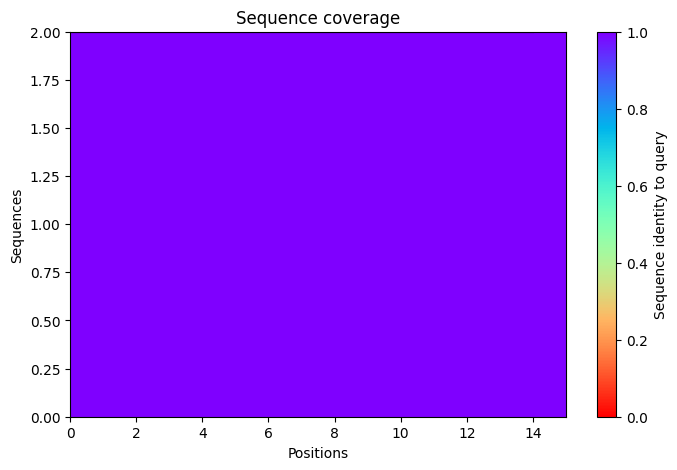

2025-11-17 08:39:11,296 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=78.7 pTM=0.0329
2025-11-17 08:39:13,870 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=78.6 pTM=0.0322 tol=0.585
2025-11-17 08:39:16,446 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.9 pTM=0.0326 tol=0.312
2025-11-17 08:39:19,024 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=81.1 pTM=0.0323 tol=0.305
2025-11-17 08:39:19,025 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


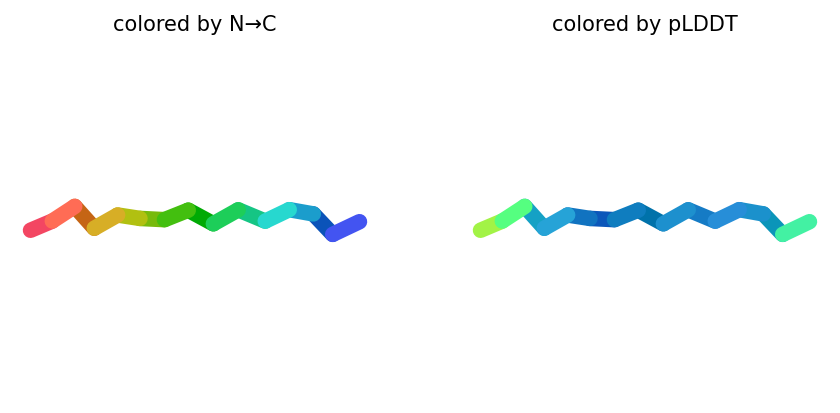

2025-11-17 08:39:21,658 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=74 pTM=0.0316
2025-11-17 08:39:24,242 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.9 pTM=0.0303 tol=0.515
2025-11-17 08:39:26,828 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=77.5 pTM=0.0306 tol=0.583
2025-11-17 08:39:29,415 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76.9 pTM=0.0304 tol=0.773
2025-11-17 08:39:29,416 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


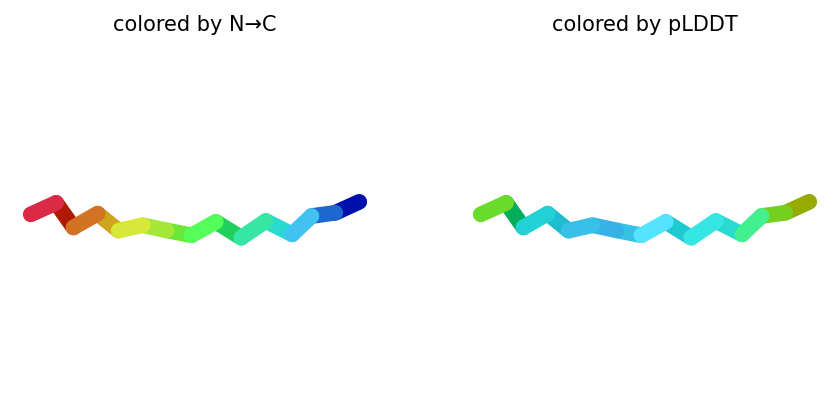

2025-11-17 08:39:32,057 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=79.8 pTM=0.0309
2025-11-17 08:39:34,649 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.4 pTM=0.0309 tol=0.644
2025-11-17 08:39:37,242 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.3 pTM=0.0314 tol=0.534
2025-11-17 08:39:39,838 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.6 pTM=0.0315 tol=0.211
2025-11-17 08:39:39,839 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


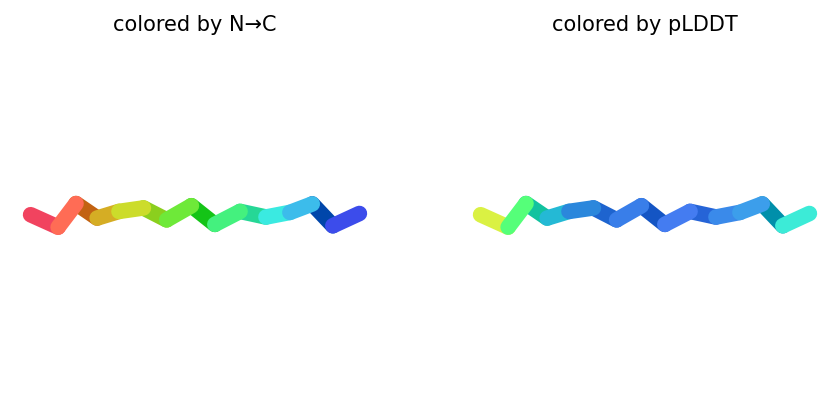

2025-11-17 08:39:42,490 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.4 pTM=0.0316
2025-11-17 08:39:45,088 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=80.4 pTM=0.0311 tol=0.438
2025-11-17 08:39:47,684 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=82.1 pTM=0.0316 tol=0.0959
2025-11-17 08:39:50,280 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=82.2 pTM=0.0316 tol=0.0595
2025-11-17 08:39:50,280 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


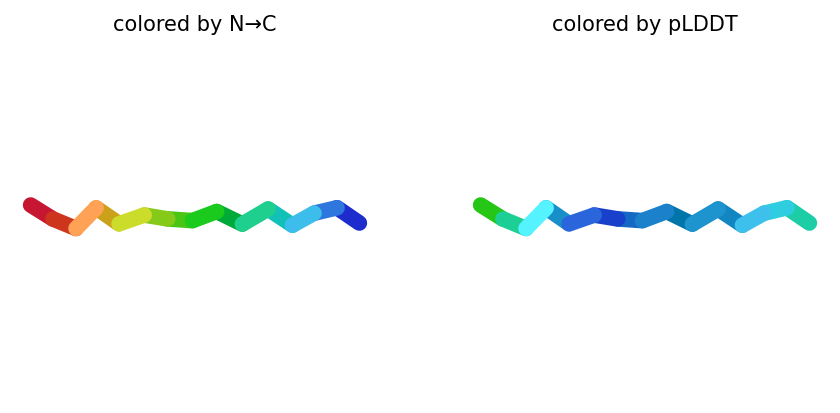

2025-11-17 08:39:52,958 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.5 pTM=0.0308
2025-11-17 08:39:55,545 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=77.2 pTM=0.0311 tol=0.613
2025-11-17 08:39:58,138 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75 pTM=0.0313 tol=0.469
2025-11-17 08:40:00,729 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75 pTM=0.0311 tol=0.493
2025-11-17 08:40:00,730 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


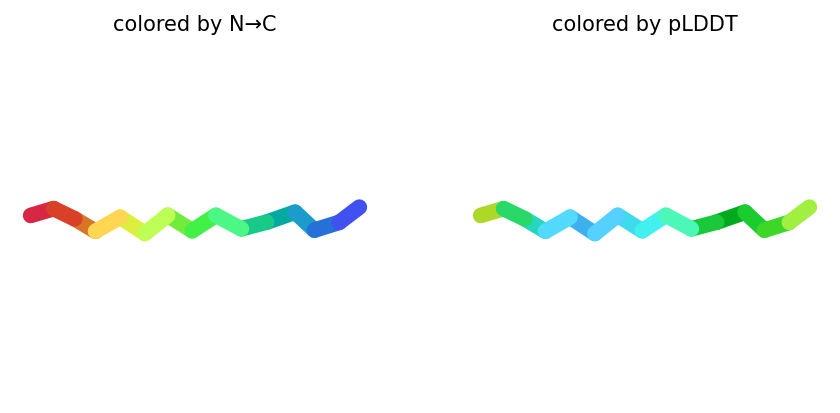

2025-11-17 08:40:00,804 reranking models by 'plddt' metric
2025-11-17 08:40:00,804 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=82.2 pTM=0.0316
2025-11-17 08:40:00,804 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=81.6 pTM=0.0315
2025-11-17 08:40:00,805 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=81.1 pTM=0.0323
2025-11-17 08:40:00,805 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=76.9 pTM=0.0304
2025-11-17 08:40:00,805 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=75 pTM=0.0311
2025-11-17 08:40:02,251 Query 78/146: peptide_172_IC50_421.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:40:02,523 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


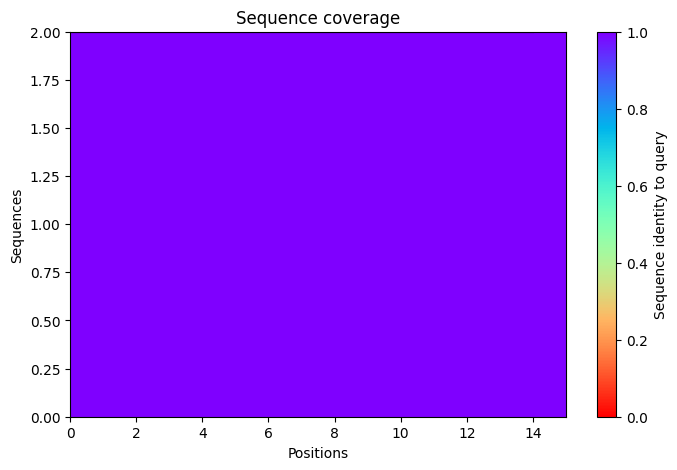

2025-11-17 08:40:17,040 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=80.6 pTM=0.0411
2025-11-17 08:40:19,617 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.6 pTM=0.0388 tol=0.111
2025-11-17 08:40:22,193 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.5 pTM=0.0395 tol=0.0994
2025-11-17 08:40:24,769 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.9 pTM=0.038 tol=0.0878
2025-11-17 08:40:24,770 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


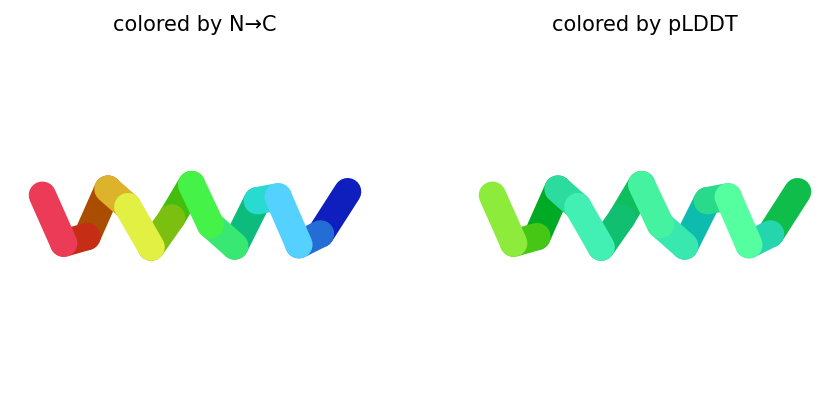

2025-11-17 08:40:27,402 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70 pTM=0.0394
2025-11-17 08:40:29,986 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.3 pTM=0.0344 tol=0.454
2025-11-17 08:40:32,567 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63.2 pTM=0.0359 tol=0.281
2025-11-17 08:40:35,152 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=60 pTM=0.0338 tol=0.198
2025-11-17 08:40:35,153 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


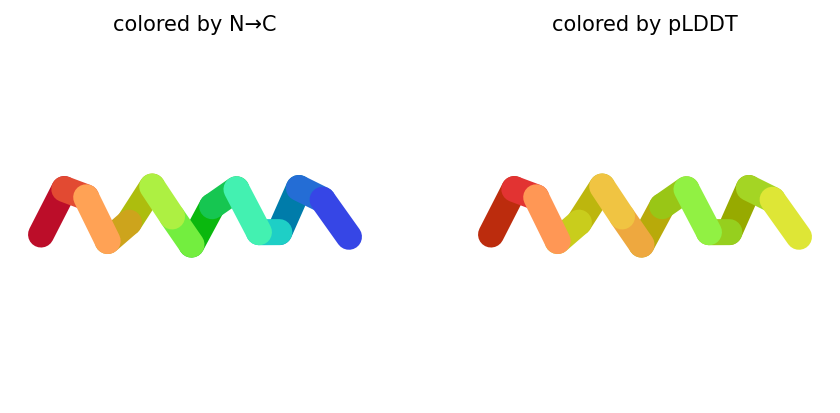

2025-11-17 08:40:37,794 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.1 pTM=0.0327
2025-11-17 08:40:40,384 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=65.9 pTM=0.0307 tol=0.205
2025-11-17 08:40:42,981 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=67.9 pTM=0.0309 tol=0.0917
2025-11-17 08:40:45,581 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=65.6 pTM=0.0302 tol=0.055
2025-11-17 08:40:45,582 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


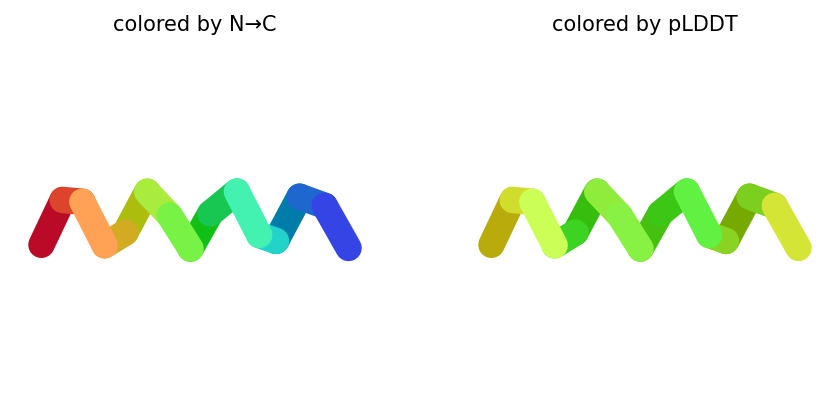

2025-11-17 08:40:48,233 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=71.8 pTM=0.0367
2025-11-17 08:40:50,832 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77 pTM=0.0387 tol=0.406
2025-11-17 08:40:53,431 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80.1 pTM=0.04 tol=0.0907
2025-11-17 08:40:56,029 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=82.7 pTM=0.0412 tol=0.0593
2025-11-17 08:40:56,030 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


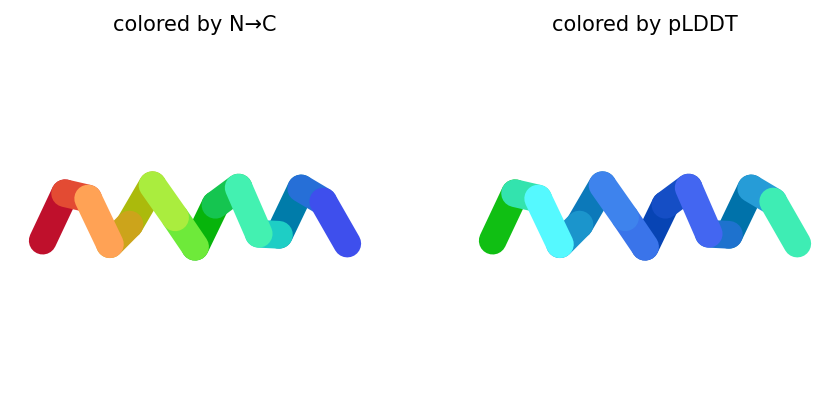

2025-11-17 08:40:58,678 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=81.2 pTM=0.0395
2025-11-17 08:41:01,275 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=80 pTM=0.0398 tol=0.08
2025-11-17 08:41:03,869 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=79.1 pTM=0.0391 tol=0.0571
2025-11-17 08:41:06,458 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=76.2 pTM=0.038 tol=0.0795
2025-11-17 08:41:06,458 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


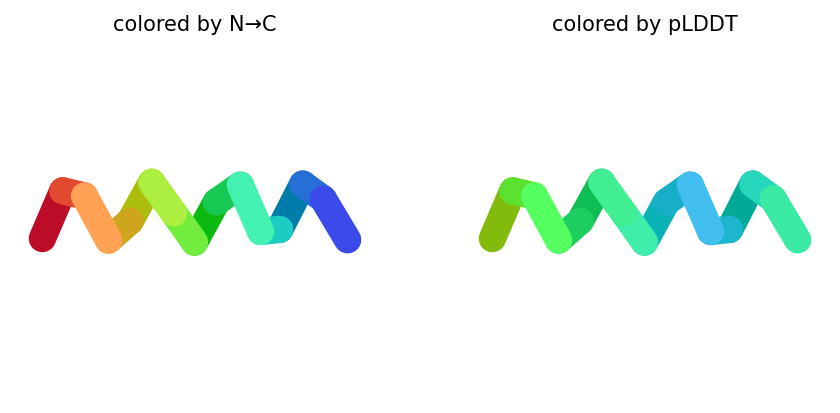

2025-11-17 08:41:06,507 reranking models by 'plddt' metric
2025-11-17 08:41:06,507 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=82.7 pTM=0.0412
2025-11-17 08:41:06,508 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=76.2 pTM=0.038
2025-11-17 08:41:06,508 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=74.9 pTM=0.038
2025-11-17 08:41:06,508 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=65.6 pTM=0.0302
2025-11-17 08:41:06,509 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=60 pTM=0.0338
2025-11-17 08:41:07,622 Query 79/146: peptide_173_IC50_427.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:41:07,894 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


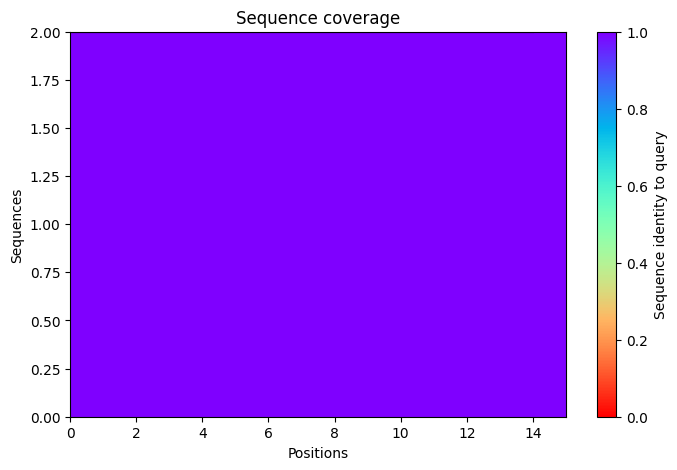

2025-11-17 08:41:19,768 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=82.7 pTM=0.0343
2025-11-17 08:41:22,345 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.1 pTM=0.0341 tol=0.116
2025-11-17 08:41:24,920 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.2 pTM=0.0326 tol=0.24
2025-11-17 08:41:27,498 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.1 pTM=0.0303 tol=0.322
2025-11-17 08:41:27,499 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


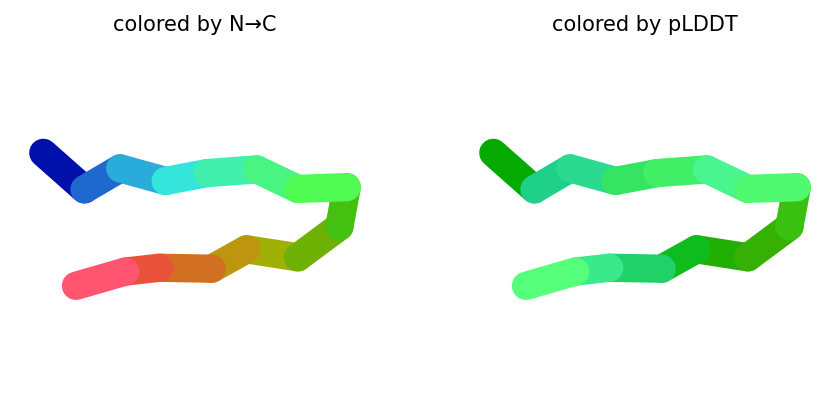

2025-11-17 08:41:30,163 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=80.4 pTM=0.0331
2025-11-17 08:41:32,742 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70.9 pTM=0.0285 tol=1.79
2025-11-17 08:41:35,326 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.4 pTM=0.0278 tol=5.28
2025-11-17 08:41:37,905 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.7 pTM=0.0279 tol=2.82
2025-11-17 08:41:37,906 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


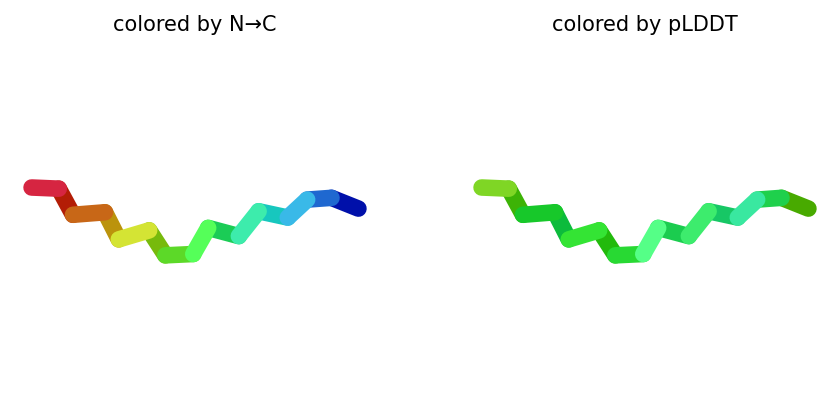

2025-11-17 08:41:40,540 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.4 pTM=0.0292
2025-11-17 08:41:43,130 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=69.8 pTM=0.0275 tol=0.661
2025-11-17 08:41:45,717 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.1 pTM=0.0273 tol=4.73
2025-11-17 08:41:48,312 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.7 pTM=0.0276 tol=4.14
2025-11-17 08:41:48,312 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


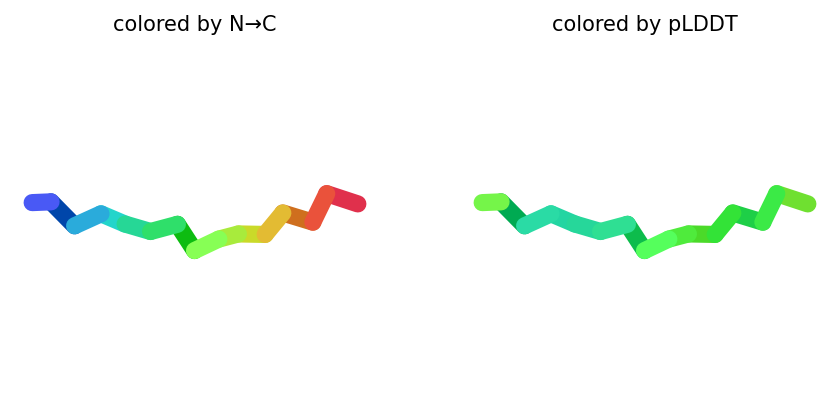

2025-11-17 08:41:50,956 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=79.5 pTM=0.0338
2025-11-17 08:41:53,551 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.2 pTM=0.0326 tol=0.129
2025-11-17 08:41:56,146 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.8 pTM=0.0316 tol=0.137
2025-11-17 08:41:58,739 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76 pTM=0.0315 tol=0.0906
2025-11-17 08:41:58,740 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


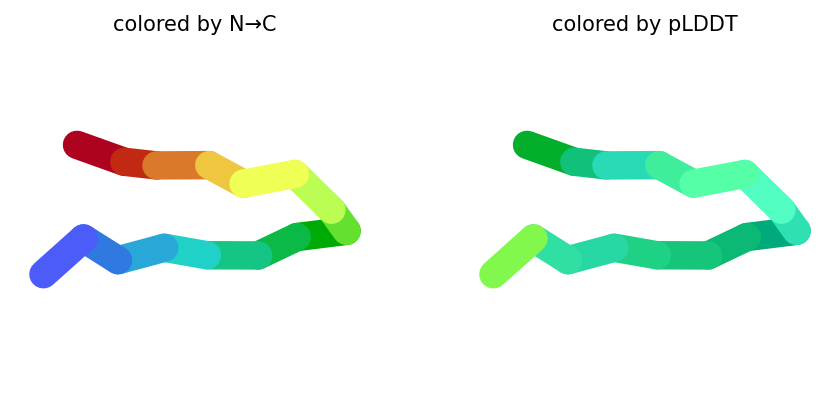

2025-11-17 08:42:01,380 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=77.6 pTM=0.0327
2025-11-17 08:42:03,972 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.9 pTM=0.0308 tol=0.374
2025-11-17 08:42:06,562 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=72 pTM=0.0303 tol=0.23
2025-11-17 08:42:09,144 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=72 pTM=0.03 tol=0.0706
2025-11-17 08:42:09,145 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


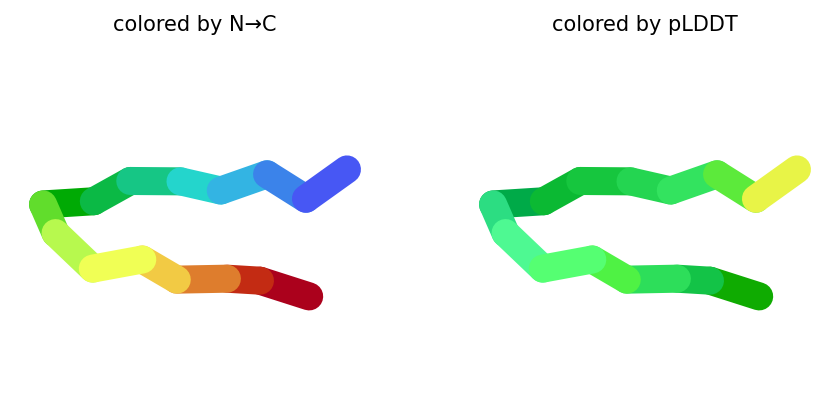

2025-11-17 08:42:09,198 reranking models by 'plddt' metric
2025-11-17 08:42:09,199 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=76 pTM=0.0315
2025-11-17 08:42:09,199 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=73.1 pTM=0.0303
2025-11-17 08:42:09,199 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=72.7 pTM=0.0276
2025-11-17 08:42:09,201 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=72 pTM=0.03
2025-11-17 08:42:09,201 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=71.7 pTM=0.0279
2025-11-17 08:42:10,644 Query 80/146: peptide_174_IC50_425.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:42:10,924 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


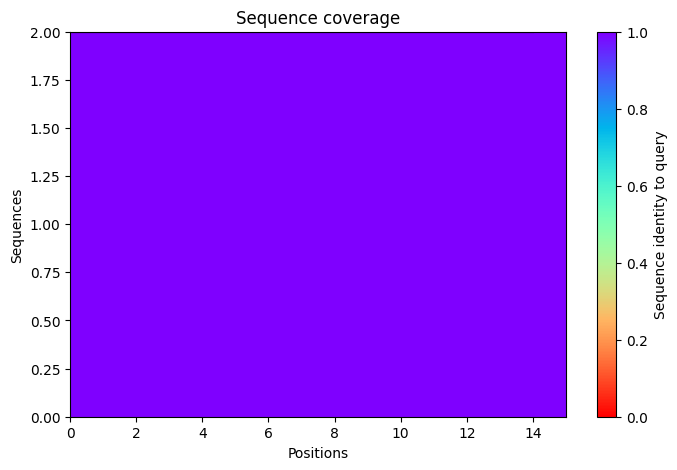

2025-11-17 08:42:25,096 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=63.2 pTM=0.0275
2025-11-17 08:42:27,674 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=62.5 pTM=0.0279 tol=0.709
2025-11-17 08:42:30,253 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=62.7 pTM=0.0275 tol=0.549
2025-11-17 08:42:32,834 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=60.7 pTM=0.0267 tol=1.84
2025-11-17 08:42:32,835 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


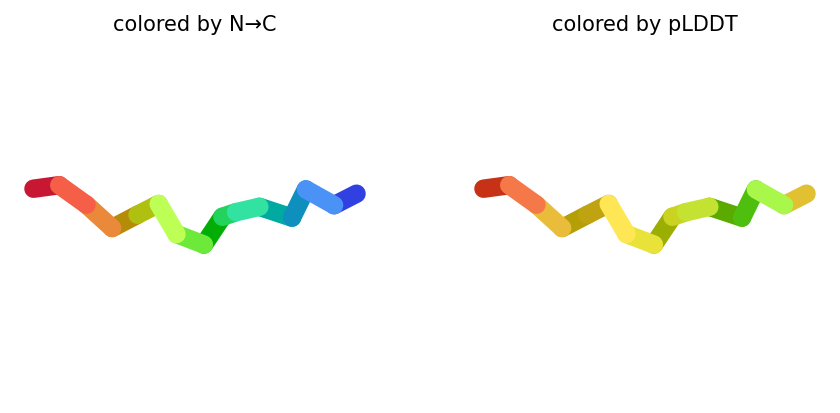

2025-11-17 08:42:35,469 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.8 pTM=0.0262
2025-11-17 08:42:38,051 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=65.2 pTM=0.0261 tol=1.51
2025-11-17 08:42:40,634 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=66 pTM=0.0265 tol=0.338
2025-11-17 08:42:43,224 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=68.1 pTM=0.0268 tol=0.32
2025-11-17 08:42:43,225 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


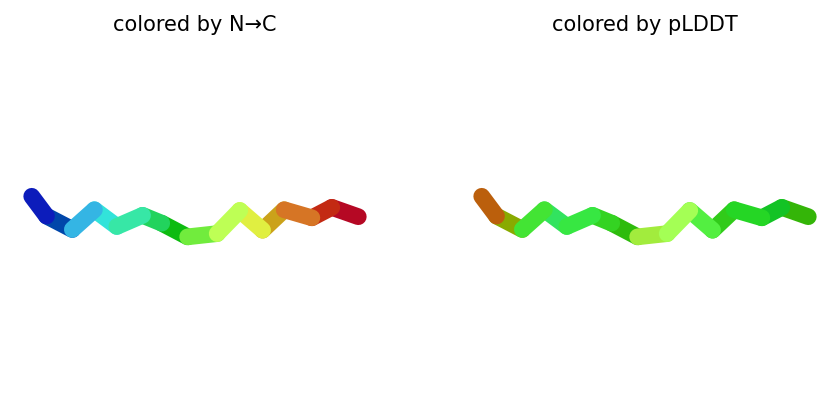

2025-11-17 08:42:45,867 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.1 pTM=0.0283
2025-11-17 08:42:48,465 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.2 pTM=0.0288 tol=0.825
2025-11-17 08:42:51,065 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.9 pTM=0.0291 tol=0.115
2025-11-17 08:42:53,665 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.7 pTM=0.0293 tol=0.193
2025-11-17 08:42:53,666 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


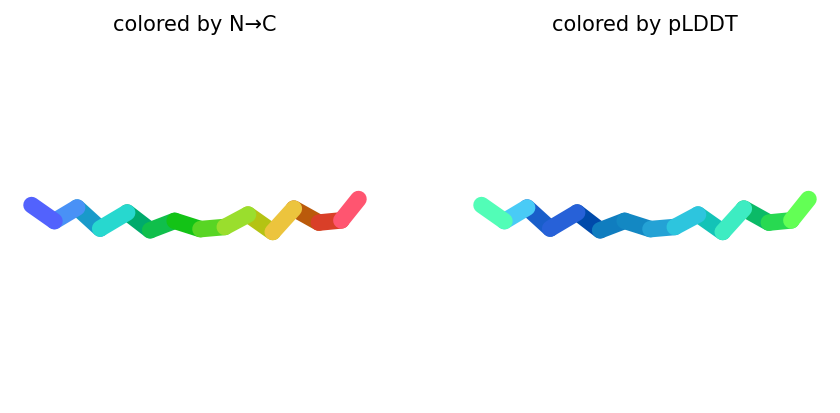

2025-11-17 08:42:56,347 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.1 pTM=0.0279
2025-11-17 08:42:58,946 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.3 pTM=0.0283 tol=0.253
2025-11-17 08:43:01,542 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.8 pTM=0.0288 tol=0.376
2025-11-17 08:43:04,139 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.7 pTM=0.0289 tol=0.176
2025-11-17 08:43:04,140 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


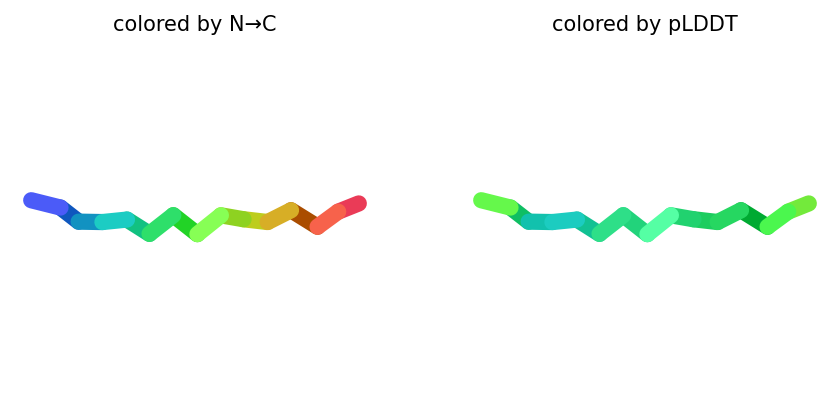

2025-11-17 08:43:06,775 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.9 pTM=0.0262
2025-11-17 08:43:09,367 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=68.9 pTM=0.0274 tol=1.25
2025-11-17 08:43:11,951 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.6 pTM=0.0282 tol=0.763
2025-11-17 08:43:14,538 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.3 pTM=0.0284 tol=0.306
2025-11-17 08:43:14,539 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


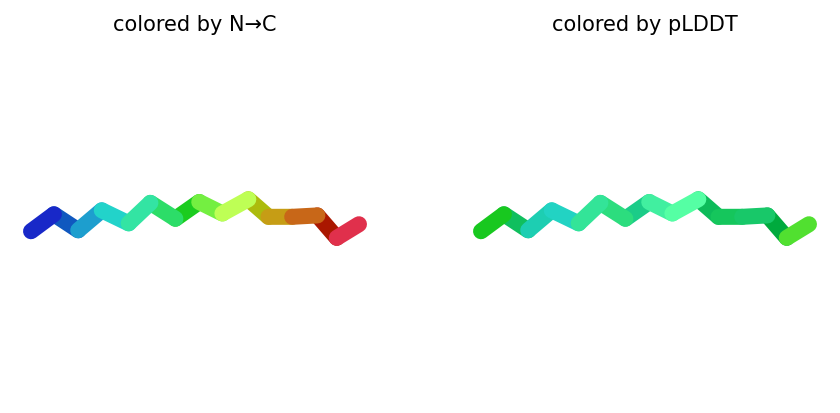

2025-11-17 08:43:14,588 reranking models by 'plddt' metric
2025-11-17 08:43:14,589 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=80.7 pTM=0.0293
2025-11-17 08:43:14,589 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=75.3 pTM=0.0284
2025-11-17 08:43:14,590 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=74.7 pTM=0.0289
2025-11-17 08:43:14,591 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=68.1 pTM=0.0268
2025-11-17 08:43:14,591 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=60.7 pTM=0.0267
2025-11-17 08:43:15,699 Query 81/146: peptide_175_IC50_424.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:43:15,975 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


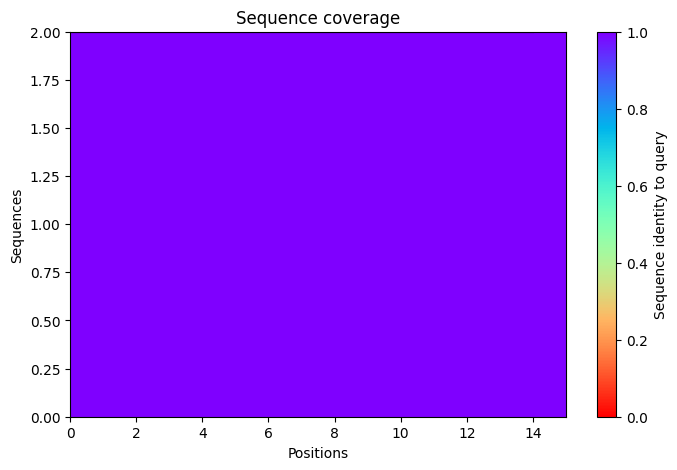

2025-11-17 08:43:28,203 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=60.8 pTM=0.0283
2025-11-17 08:43:30,781 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=61.9 pTM=0.0282 tol=2.18
2025-11-17 08:43:33,356 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=62.9 pTM=0.0286 tol=0.371
2025-11-17 08:43:35,931 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=61.1 pTM=0.0284 tol=0.937
2025-11-17 08:43:35,931 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


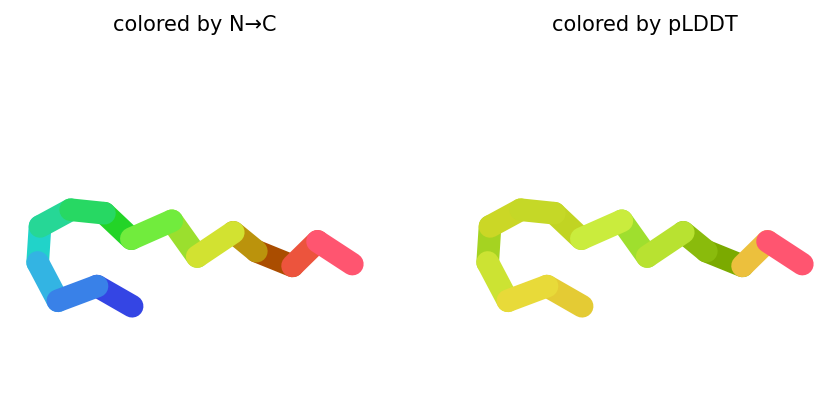

2025-11-17 08:43:38,568 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.1 pTM=0.0268
2025-11-17 08:43:41,153 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=64.2 pTM=0.0272 tol=1.14
2025-11-17 08:43:43,732 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.3 pTM=0.0274 tol=0.388
2025-11-17 08:43:46,316 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=63.5 pTM=0.0272 tol=0.281
2025-11-17 08:43:46,317 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


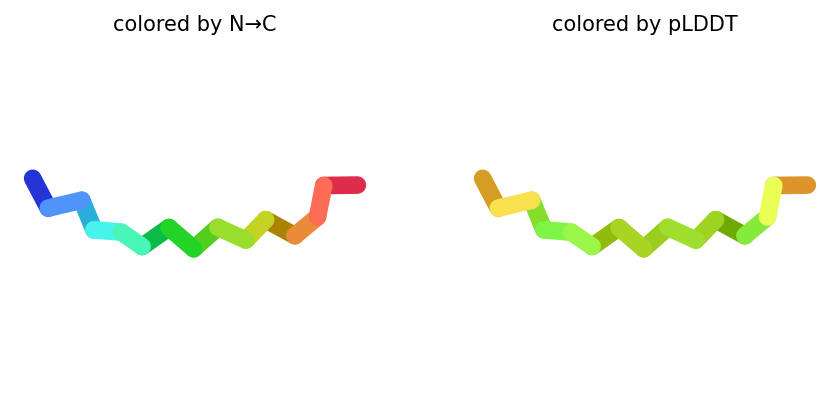

2025-11-17 08:43:48,953 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=60 pTM=0.0266
2025-11-17 08:43:51,540 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=61.5 pTM=0.0266 tol=3.99
2025-11-17 08:43:54,134 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=66.2 pTM=0.0269 tol=1.69
2025-11-17 08:43:56,730 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=66.4 pTM=0.0266 tol=0.127
2025-11-17 08:43:56,731 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


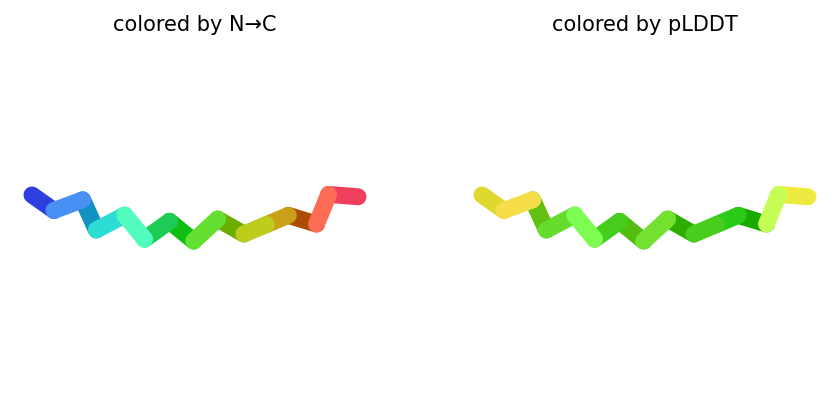

2025-11-17 08:43:59,381 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=63.3 pTM=0.0273
2025-11-17 08:44:01,977 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=65.6 pTM=0.0277 tol=0.713
2025-11-17 08:44:04,574 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=67.2 pTM=0.0279 tol=0.658
2025-11-17 08:44:07,167 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=65.3 pTM=0.0277 tol=0.575
2025-11-17 08:44:07,168 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


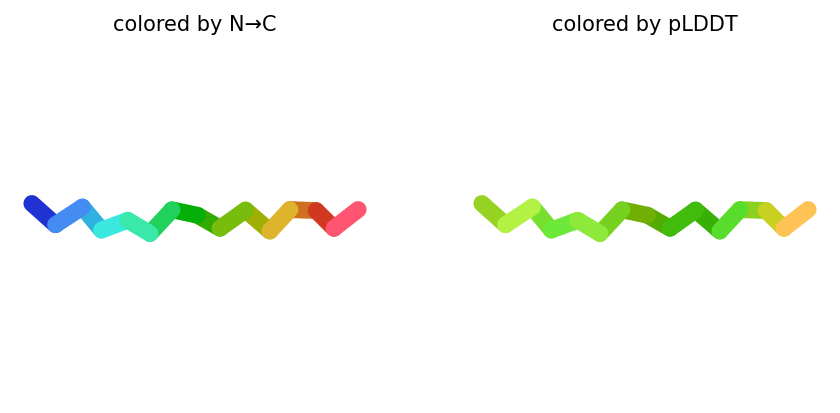

2025-11-17 08:44:09,810 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.2 pTM=0.0268
2025-11-17 08:44:12,397 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=59.8 pTM=0.0268 tol=0.395
2025-11-17 08:44:14,987 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=62.6 pTM=0.0272 tol=0.488
2025-11-17 08:44:17,573 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=60.5 pTM=0.0269 tol=0.418
2025-11-17 08:44:17,574 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


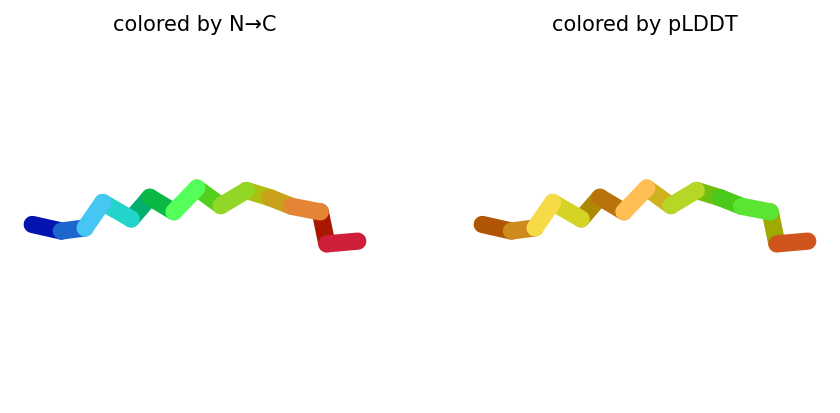

2025-11-17 08:44:17,641 reranking models by 'plddt' metric
2025-11-17 08:44:17,641 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=66.4 pTM=0.0266
2025-11-17 08:44:17,642 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=65.3 pTM=0.0277
2025-11-17 08:44:17,642 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=63.5 pTM=0.0272
2025-11-17 08:44:17,642 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=61.1 pTM=0.0284
2025-11-17 08:44:17,642 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=60.5 pTM=0.0269
2025-11-17 08:44:18,994 Query 82/146: peptide_177_IC50_428.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:44:19,278 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


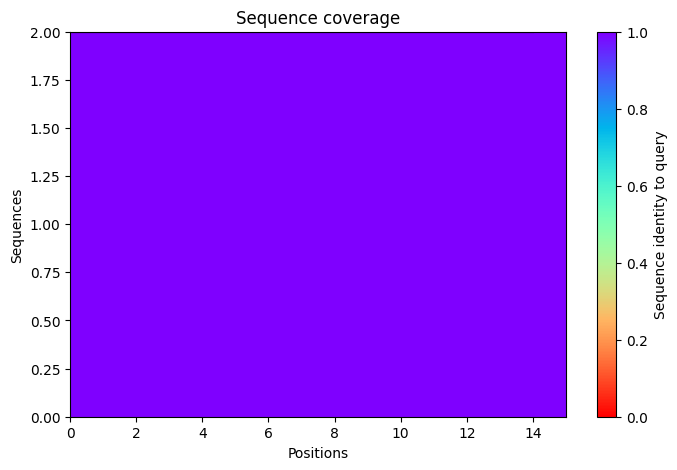

2025-11-17 08:44:31,432 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.3 pTM=0.028
2025-11-17 08:44:34,014 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=69.8 pTM=0.0282 tol=0.908
2025-11-17 08:44:36,593 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.9 pTM=0.0287 tol=0.569
2025-11-17 08:44:39,173 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.1 pTM=0.0283 tol=0.493
2025-11-17 08:44:39,174 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


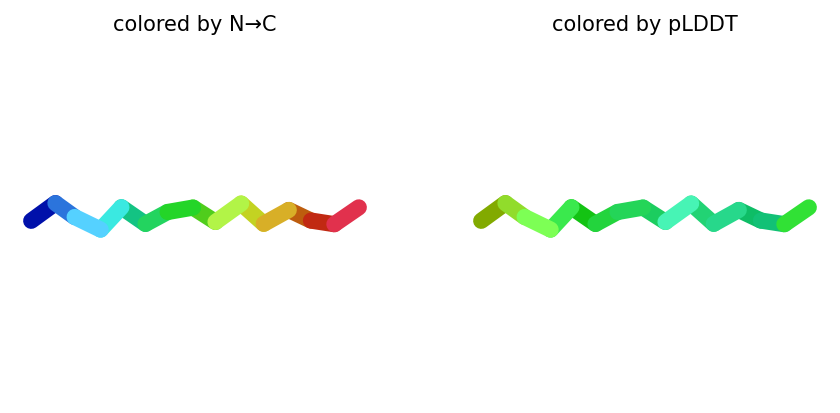

2025-11-17 08:44:41,800 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.9 pTM=0.0269
2025-11-17 08:44:44,385 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.5 pTM=0.0263 tol=1.08
2025-11-17 08:44:46,968 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.1 pTM=0.0264 tol=0.372
2025-11-17 08:44:49,555 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69 pTM=0.0264 tol=0.121
2025-11-17 08:44:49,556 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


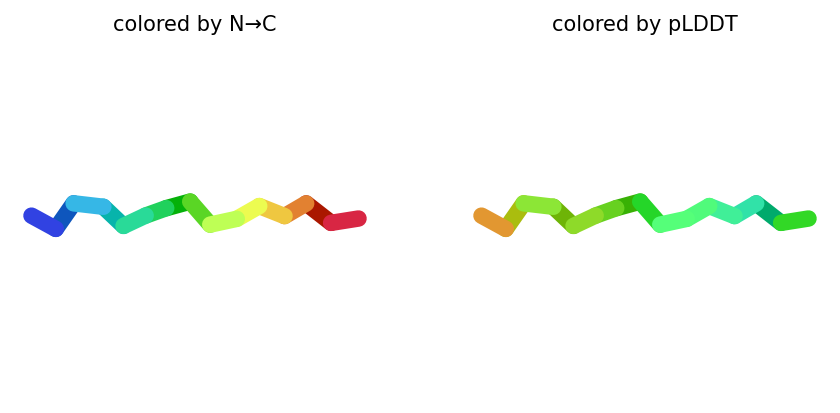

2025-11-17 08:44:52,209 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71 pTM=0.0271
2025-11-17 08:44:54,801 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=77.4 pTM=0.0281 tol=0.647
2025-11-17 08:44:57,399 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=79 pTM=0.029 tol=0.405
2025-11-17 08:44:59,994 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=79.6 pTM=0.0287 tol=0.152
2025-11-17 08:44:59,995 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


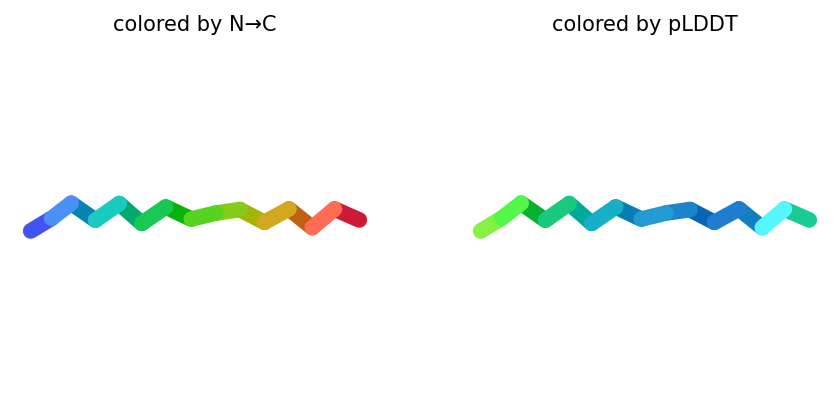

2025-11-17 08:45:02,635 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.6 pTM=0.0264
2025-11-17 08:45:05,225 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.4 pTM=0.0267 tol=0.416
2025-11-17 08:45:07,821 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.4 pTM=0.027 tol=0.483
2025-11-17 08:45:10,411 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.3 pTM=0.027 tol=0.503
2025-11-17 08:45:10,412 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


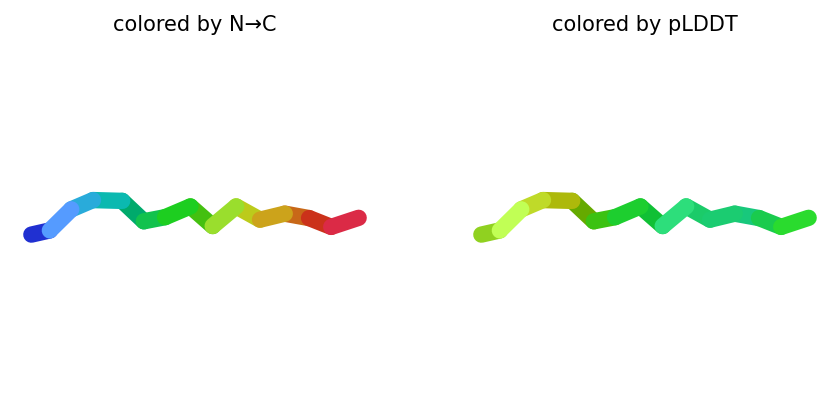

2025-11-17 08:45:13,046 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.5 pTM=0.028
2025-11-17 08:45:15,635 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.1 pTM=0.0277 tol=1.45
2025-11-17 08:45:18,216 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=66.5 pTM=0.0271 tol=0.713
2025-11-17 08:45:20,804 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63.1 pTM=0.027 tol=0.853
2025-11-17 08:45:20,805 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


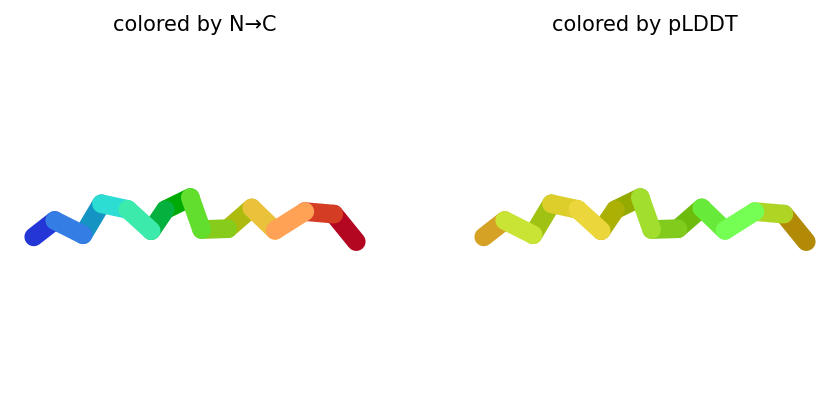

2025-11-17 08:45:20,885 reranking models by 'plddt' metric
2025-11-17 08:45:20,886 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=79.6 pTM=0.0287
2025-11-17 08:45:20,886 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=72.1 pTM=0.0283
2025-11-17 08:45:20,886 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=70.3 pTM=0.027
2025-11-17 08:45:20,886 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=69 pTM=0.0264
2025-11-17 08:45:20,887 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=63.1 pTM=0.027
2025-11-17 08:45:22,450 Query 83/146: peptide_180_IC50_426.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:45:22,741 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


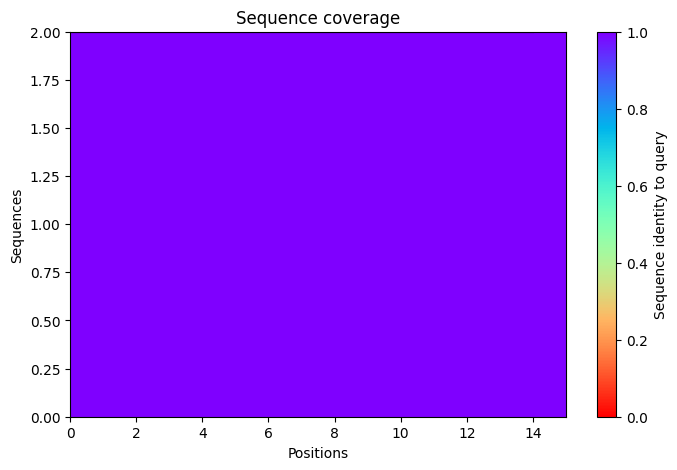

2025-11-17 08:45:32,952 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66.8 pTM=0.0292
2025-11-17 08:45:35,529 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=68.7 pTM=0.0307 tol=0.483
2025-11-17 08:45:38,103 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=68.5 pTM=0.031 tol=0.162
2025-11-17 08:45:40,680 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=67.9 pTM=0.0302 tol=0.223
2025-11-17 08:45:40,680 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


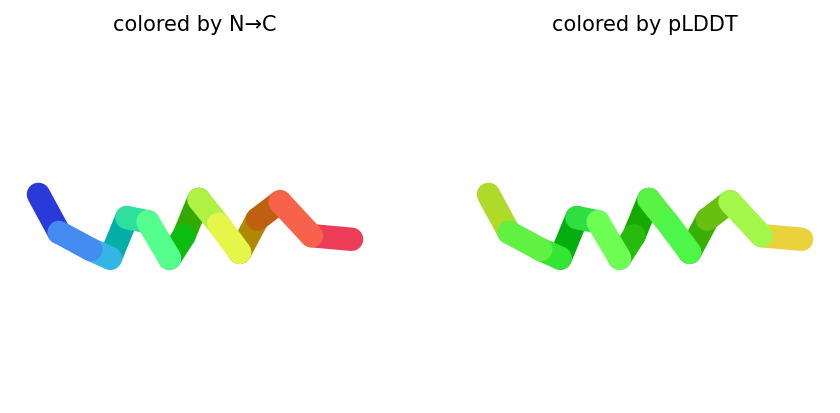

2025-11-17 08:45:43,314 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.2 pTM=0.0262
2025-11-17 08:45:45,898 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63 pTM=0.0265 tol=2.83
2025-11-17 08:45:48,477 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69.2 pTM=0.0267 tol=1.39
2025-11-17 08:45:51,061 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=67.7 pTM=0.0265 tol=0.781
2025-11-17 08:45:51,061 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


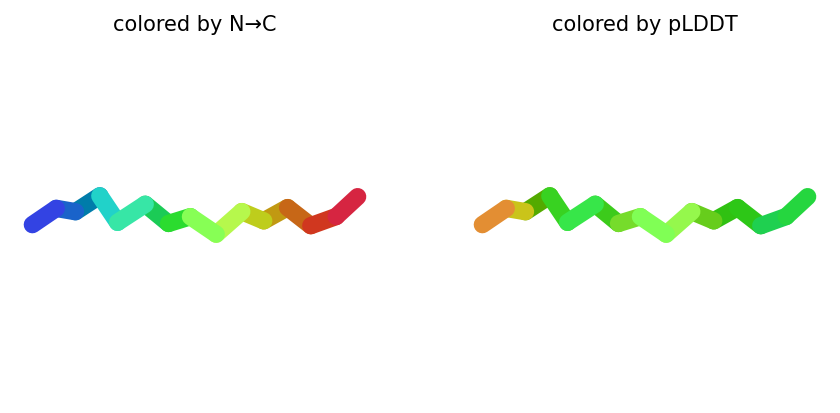

2025-11-17 08:45:53,698 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.8 pTM=0.0278
2025-11-17 08:45:56,287 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=76.6 pTM=0.0286 tol=0.754
2025-11-17 08:45:58,881 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=79.3 pTM=0.029 tol=0.362
2025-11-17 08:46:01,472 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=79.8 pTM=0.0289 tol=0.191
2025-11-17 08:46:01,472 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


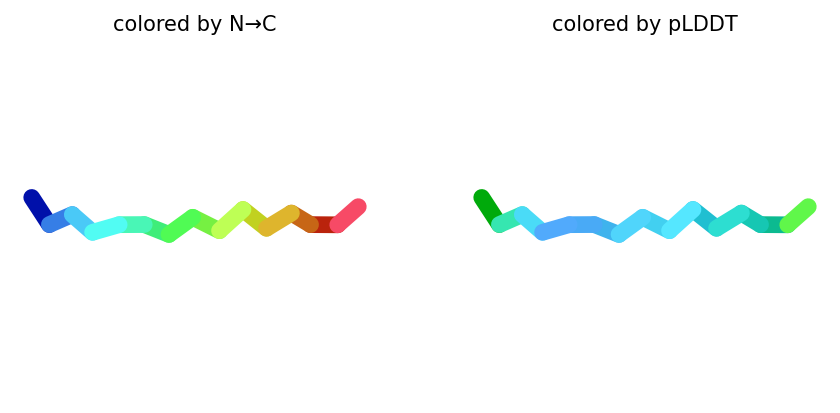

2025-11-17 08:46:04,121 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.9 pTM=0.0277
2025-11-17 08:46:06,714 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.6 pTM=0.0282 tol=0.359
2025-11-17 08:46:09,308 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=73.1 pTM=0.0286 tol=0.555
2025-11-17 08:46:11,901 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=72.4 pTM=0.0285 tol=0.226
2025-11-17 08:46:11,902 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


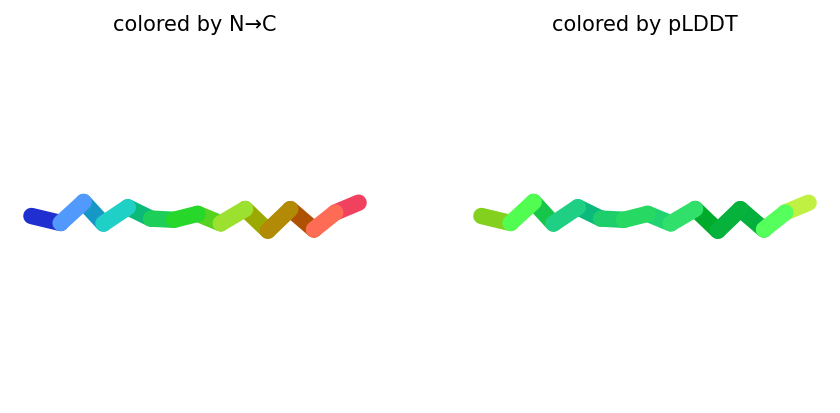

2025-11-17 08:46:14,551 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=63.8 pTM=0.0277
2025-11-17 08:46:17,139 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.7 pTM=0.0275 tol=0.552
2025-11-17 08:46:19,726 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63.3 pTM=0.0278 tol=0.294
2025-11-17 08:46:22,313 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63.2 pTM=0.0276 tol=0.265
2025-11-17 08:46:22,314 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


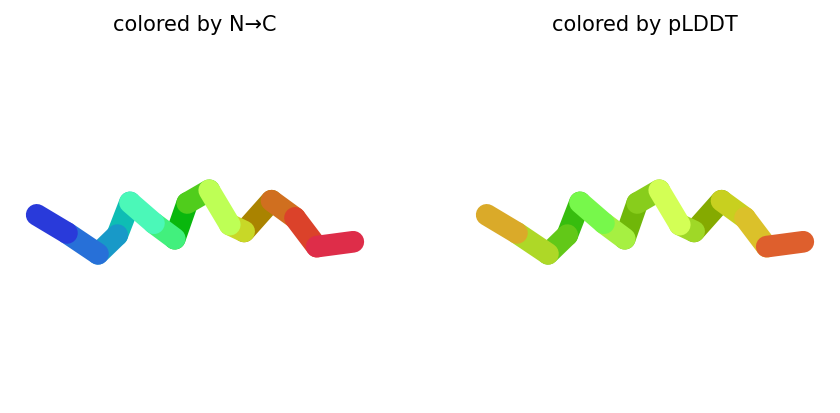

2025-11-17 08:46:22,393 reranking models by 'plddt' metric
2025-11-17 08:46:22,394 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=79.8 pTM=0.0289
2025-11-17 08:46:22,394 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=72.4 pTM=0.0285
2025-11-17 08:46:22,394 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=67.9 pTM=0.0302
2025-11-17 08:46:22,395 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=67.7 pTM=0.0265
2025-11-17 08:46:22,395 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=63.2 pTM=0.0276
2025-11-17 08:46:23,602 Query 84/146: peptide_182_IC50_426.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:46:23,890 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


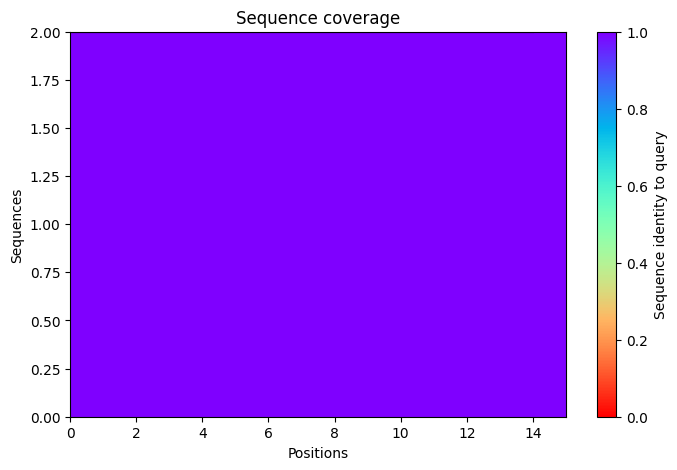

2025-11-17 08:46:35,240 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=77.1 pTM=0.0318
2025-11-17 08:46:37,818 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.5 pTM=0.0336 tol=0.236
2025-11-17 08:46:40,398 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.5 pTM=0.0342 tol=0.0377
2025-11-17 08:46:42,976 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=78 pTM=0.033 tol=0.0591
2025-11-17 08:46:42,977 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


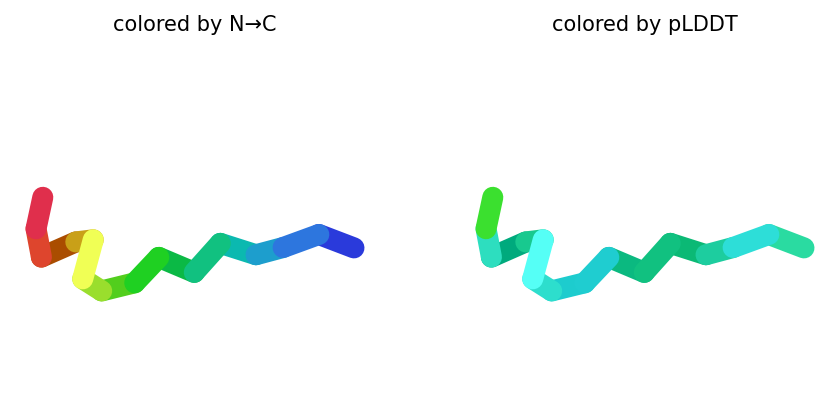

2025-11-17 08:46:45,614 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.4 pTM=0.0281
2025-11-17 08:46:48,200 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=65.6 pTM=0.0292 tol=0.496
2025-11-17 08:46:50,784 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=65.2 pTM=0.0292 tol=0.223
2025-11-17 08:46:53,369 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.2 pTM=0.0293 tol=0.218
2025-11-17 08:46:53,369 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


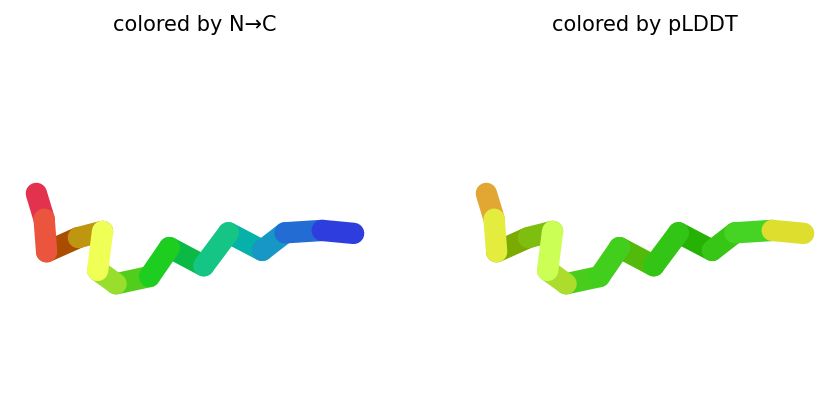

2025-11-17 08:46:56,010 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.6 pTM=0.0273
2025-11-17 08:46:58,602 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=71.4 pTM=0.0281 tol=1.42
2025-11-17 08:47:01,194 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=71.6 pTM=0.0282 tol=0.288
2025-11-17 08:47:03,788 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.8 pTM=0.0284 tol=0.253
2025-11-17 08:47:03,788 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


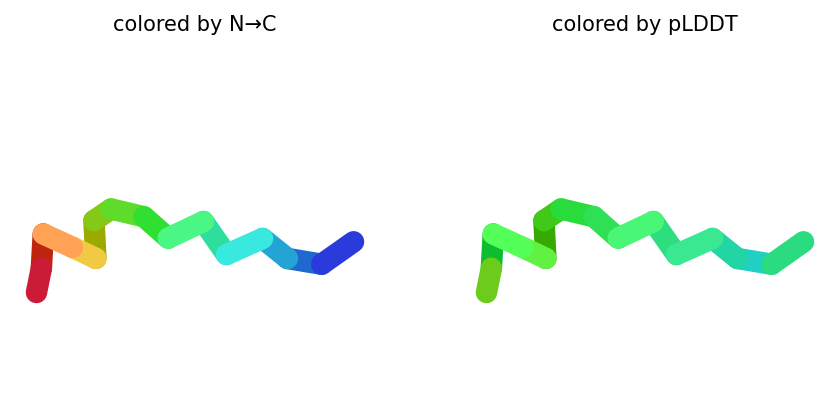

2025-11-17 08:47:06,429 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.8 pTM=0.028
2025-11-17 08:47:09,021 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.7 pTM=0.0283 tol=0.191
2025-11-17 08:47:11,614 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71 pTM=0.0288 tol=0.16
2025-11-17 08:47:14,206 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.4 pTM=0.0279 tol=0.229
2025-11-17 08:47:14,206 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


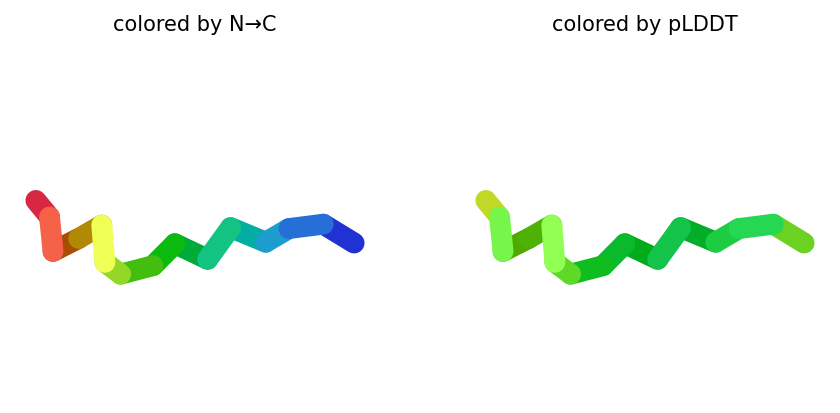

2025-11-17 08:47:16,846 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.6 pTM=0.028
2025-11-17 08:47:19,434 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67.6 pTM=0.0283 tol=0.557
2025-11-17 08:47:22,019 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.4 pTM=0.0283 tol=0.809
2025-11-17 08:47:24,608 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=62.1 pTM=0.0278 tol=0.683
2025-11-17 08:47:24,609 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


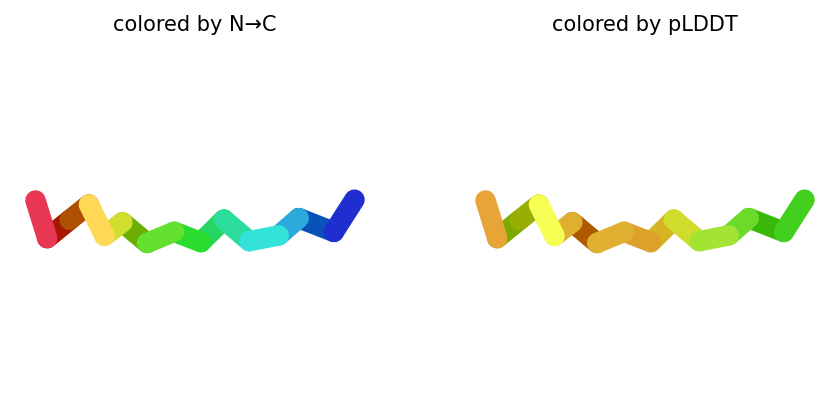

2025-11-17 08:47:24,656 reranking models by 'plddt' metric
2025-11-17 08:47:24,657 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=78 pTM=0.033
2025-11-17 08:47:24,657 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=72.8 pTM=0.0284
2025-11-17 08:47:24,657 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=69.4 pTM=0.0279
2025-11-17 08:47:24,658 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=65.2 pTM=0.0293
2025-11-17 08:47:24,658 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=62.1 pTM=0.0278
2025-11-17 08:47:25,764 Query 85/146: peptide_187_IC50_430.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:47:26,267 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


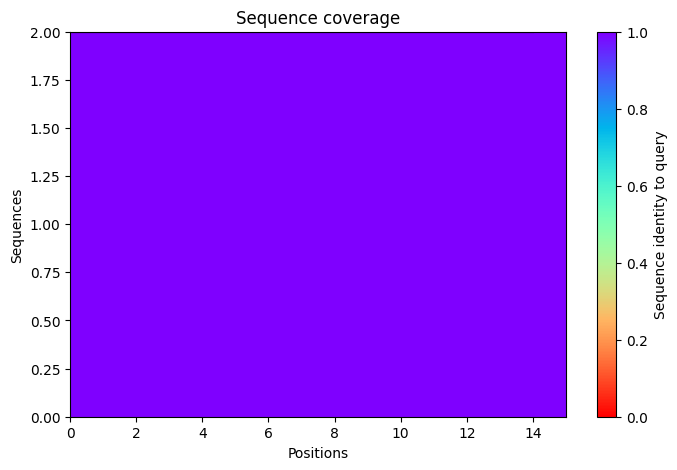

2025-11-17 08:47:39,115 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=74.3 pTM=0.0365
2025-11-17 08:47:41,692 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.6 pTM=0.0378 tol=0.561
2025-11-17 08:47:44,268 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.6 pTM=0.0374 tol=0.541
2025-11-17 08:47:46,847 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.2 pTM=0.0369 tol=0.207
2025-11-17 08:47:46,848 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


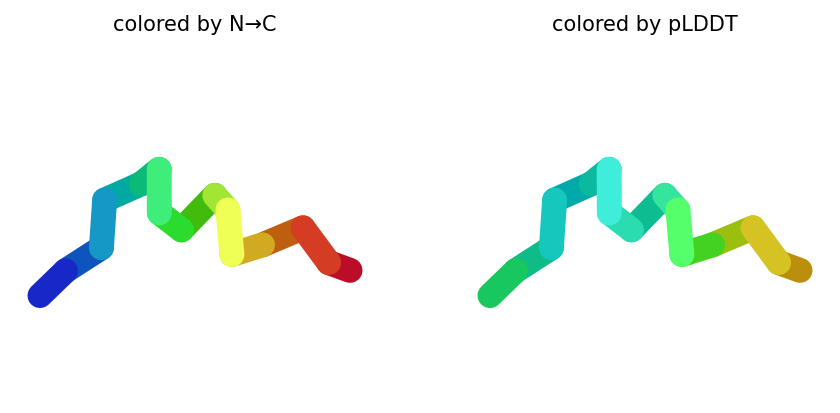

2025-11-17 08:47:49,507 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=74.3 pTM=0.037
2025-11-17 08:47:52,088 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.4 pTM=0.0381 tol=0.335
2025-11-17 08:47:54,670 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.1 pTM=0.0368 tol=0.0814
2025-11-17 08:47:57,258 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74 pTM=0.0369 tol=0.154
2025-11-17 08:47:57,259 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


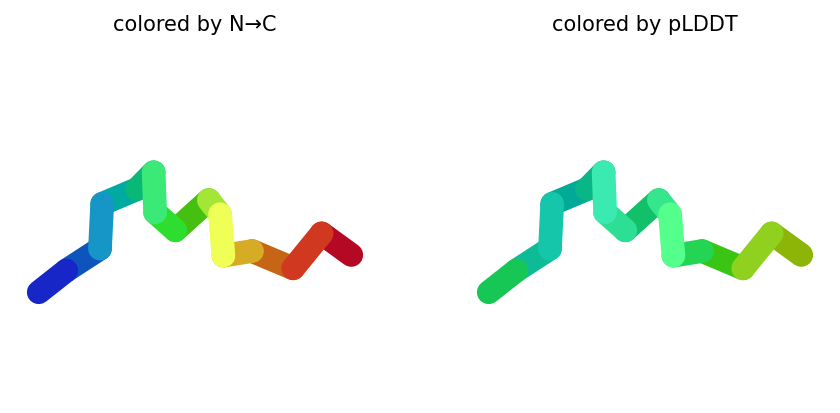

2025-11-17 08:47:59,904 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.9 pTM=0.0344
2025-11-17 08:48:02,497 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.6 pTM=0.0357 tol=0.23
2025-11-17 08:48:05,092 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.4 pTM=0.0342 tol=0.438
2025-11-17 08:48:07,686 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.8 pTM=0.0341 tol=0.141
2025-11-17 08:48:07,687 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


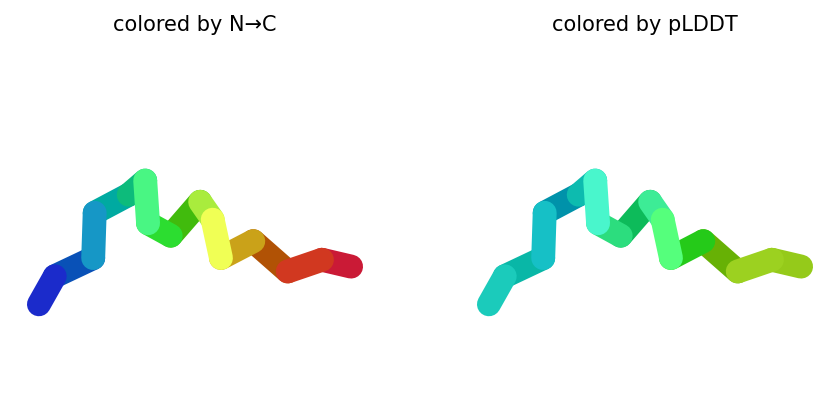

2025-11-17 08:48:10,339 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.8 pTM=0.0375
2025-11-17 08:48:12,941 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=78.4 pTM=0.0386 tol=0.263
2025-11-17 08:48:15,537 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78.2 pTM=0.0382 tol=0.101
2025-11-17 08:48:18,132 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79 pTM=0.0388 tol=0.0452
2025-11-17 08:48:18,132 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


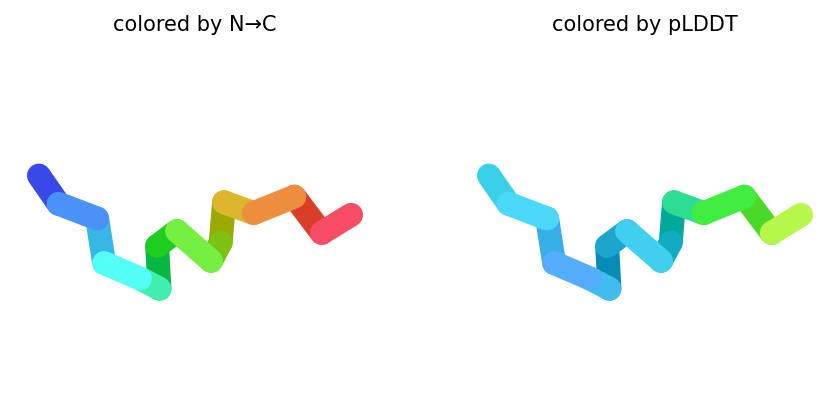

2025-11-17 08:48:20,781 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=67.2 pTM=0.0326
2025-11-17 08:48:23,372 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=64.5 pTM=0.0309 tol=0.827
2025-11-17 08:48:25,962 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63 pTM=0.0285 tol=1.69
2025-11-17 08:48:28,551 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=62.5 pTM=0.0276 tol=0.952
2025-11-17 08:48:28,552 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


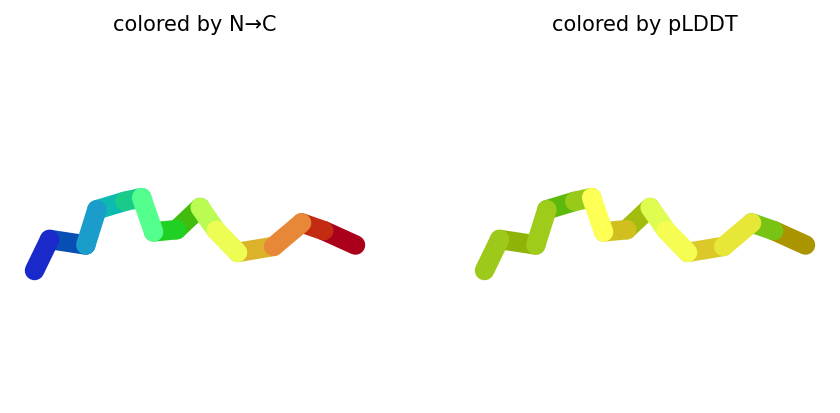

2025-11-17 08:48:28,605 reranking models by 'plddt' metric
2025-11-17 08:48:28,605 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=79 pTM=0.0388
2025-11-17 08:48:28,606 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=74.8 pTM=0.0341
2025-11-17 08:48:28,606 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=74 pTM=0.0369
2025-11-17 08:48:28,606 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73.2 pTM=0.0369
2025-11-17 08:48:28,606 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=62.5 pTM=0.0276
2025-11-17 08:48:30,134 Query 86/146: peptide_188_IC50_433.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:48:30,409 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


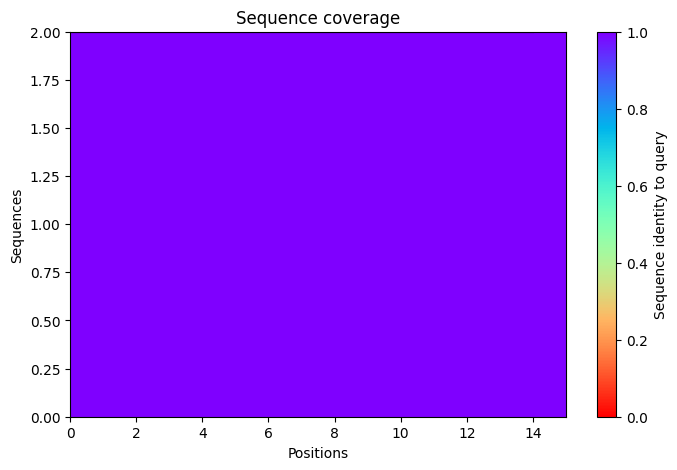

2025-11-17 08:48:44,644 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.8 pTM=0.0374
2025-11-17 08:48:47,218 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.7 pTM=0.0393 tol=0.451
2025-11-17 08:48:49,794 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.2 pTM=0.0391 tol=0.556
2025-11-17 08:48:52,372 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=77.5 pTM=0.0396 tol=0.0703
2025-11-17 08:48:52,373 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


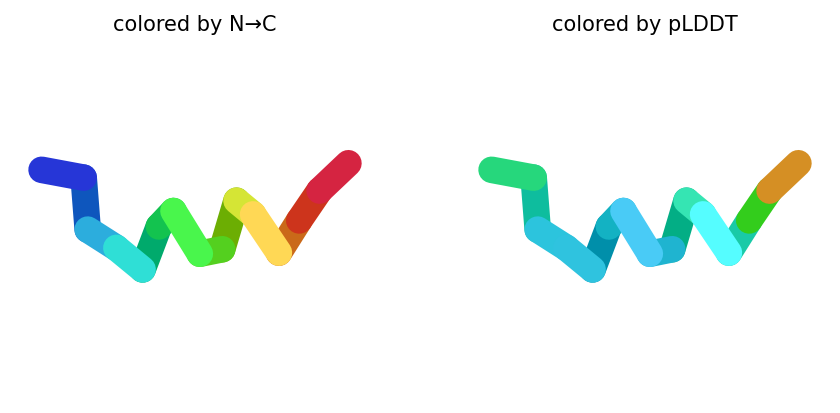

2025-11-17 08:48:55,012 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.1 pTM=0.0353
2025-11-17 08:48:57,594 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.1 pTM=0.035 tol=0.164
2025-11-17 08:49:00,176 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69.4 pTM=0.0348 tol=0.25
2025-11-17 08:49:02,764 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.7 pTM=0.0359 tol=0.149
2025-11-17 08:49:02,764 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


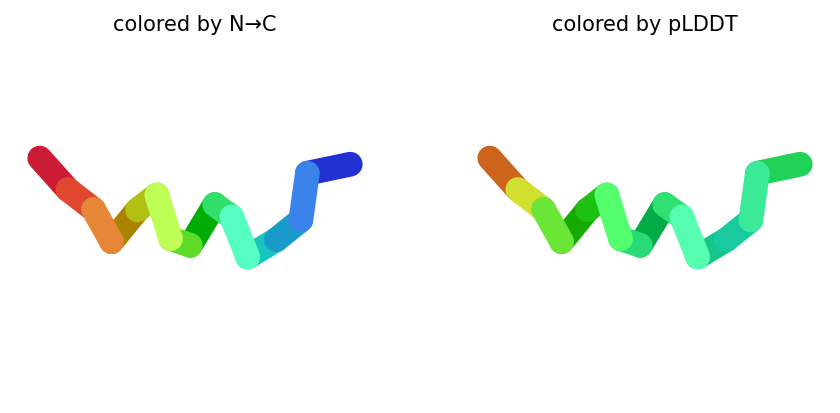

2025-11-17 08:49:05,407 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.2 pTM=0.027
2025-11-17 08:49:08,002 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=64.9 pTM=0.027 tol=1.59
2025-11-17 08:49:10,597 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.7 pTM=0.0278 tol=0.905
2025-11-17 08:49:13,192 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=67.9 pTM=0.0285 tol=1.03
2025-11-17 08:49:13,192 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


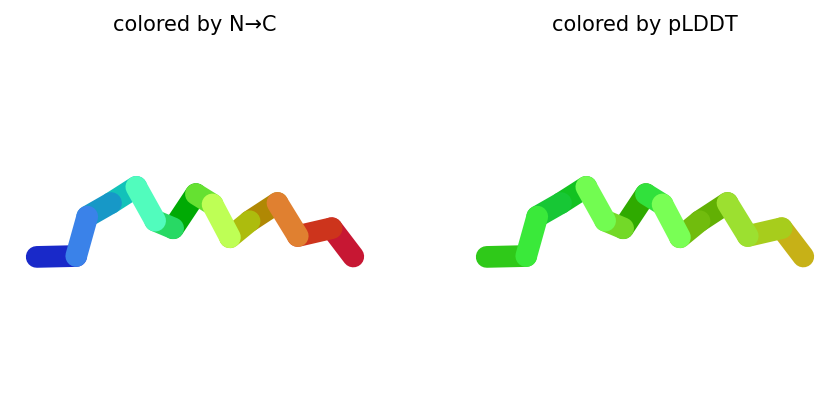

2025-11-17 08:49:15,866 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.5 pTM=0.0301
2025-11-17 08:49:18,464 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=69.7 pTM=0.0303 tol=0.324
2025-11-17 08:49:21,062 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.3 pTM=0.0296 tol=0.431
2025-11-17 08:49:23,660 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.4 pTM=0.0304 tol=0.475
2025-11-17 08:49:23,660 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


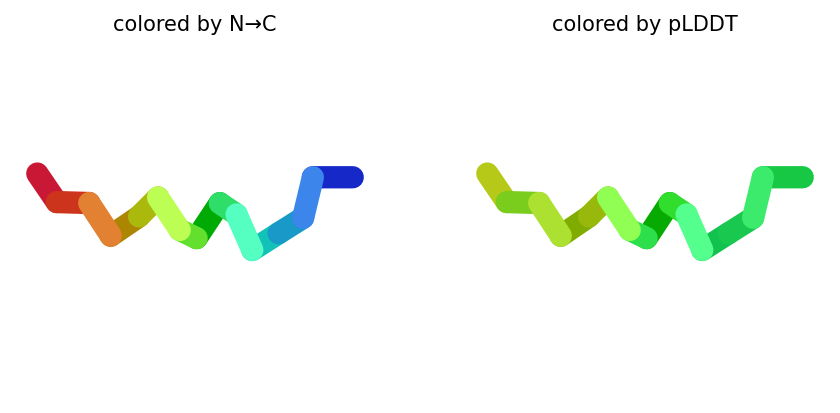

2025-11-17 08:49:26,305 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.8 pTM=0.0356
2025-11-17 08:49:28,899 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=75.4 pTM=0.0361 tol=0.259
2025-11-17 08:49:31,491 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.1 pTM=0.0352 tol=0.152
2025-11-17 08:49:34,078 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.9 pTM=0.0358 tol=0.152
2025-11-17 08:49:34,079 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


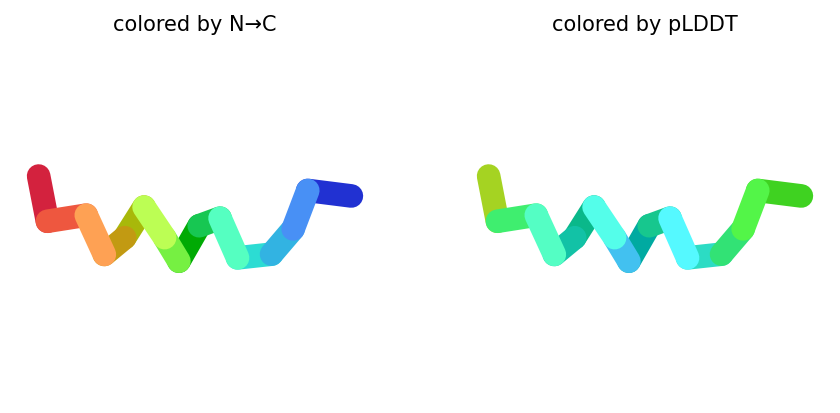

2025-11-17 08:49:34,129 reranking models by 'plddt' metric
2025-11-17 08:49:34,130 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=77.5 pTM=0.0396
2025-11-17 08:49:34,130 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=75.9 pTM=0.0358
2025-11-17 08:49:34,131 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=71.7 pTM=0.0359
2025-11-17 08:49:34,131 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=69.4 pTM=0.0304
2025-11-17 08:49:34,131 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=67.9 pTM=0.0285
2025-11-17 08:49:35,250 Query 87/146: peptide_189_IC50_433.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:49:35,529 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


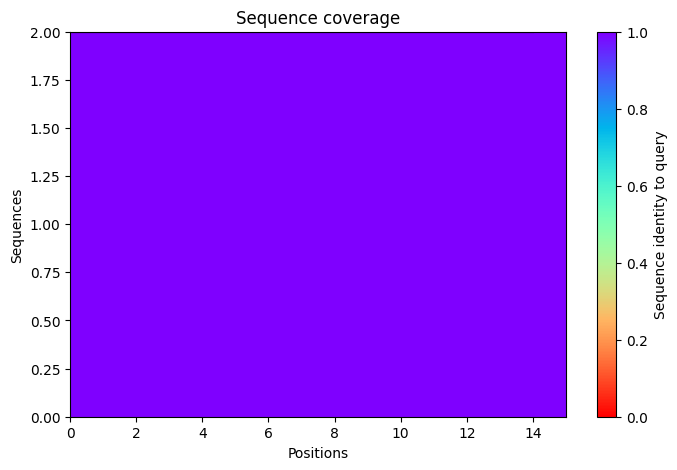

2025-11-17 08:49:48,755 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=71.9 pTM=0.0359
2025-11-17 08:49:51,332 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.9 pTM=0.0389 tol=0.178
2025-11-17 08:49:53,911 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.4 pTM=0.0398 tol=0.14
2025-11-17 08:49:56,486 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=78.6 pTM=0.0395 tol=0.0751
2025-11-17 08:49:56,487 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


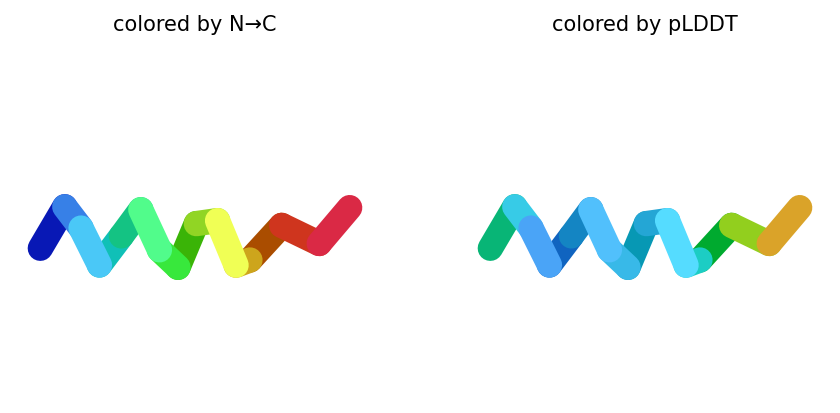

2025-11-17 08:49:59,118 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.5 pTM=0.0297
2025-11-17 08:50:01,698 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.3 pTM=0.0287 tol=0.598
2025-11-17 08:50:04,283 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=60.1 pTM=0.0279 tol=0.613
2025-11-17 08:50:06,862 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=59.7 pTM=0.0269 tol=0.937
2025-11-17 08:50:06,863 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


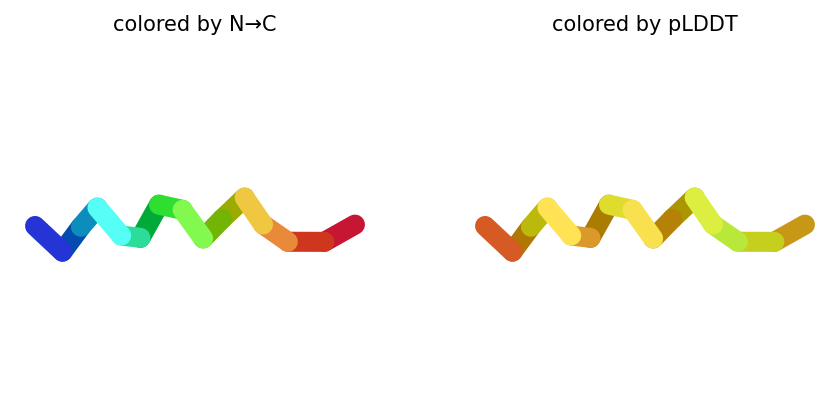

2025-11-17 08:50:09,499 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.5 pTM=0.0277
2025-11-17 08:50:12,090 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.6 pTM=0.0284 tol=0.403
2025-11-17 08:50:14,681 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=78.2 pTM=0.0286 tol=0.272
2025-11-17 08:50:17,277 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.1 pTM=0.0285 tol=0.386
2025-11-17 08:50:17,277 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


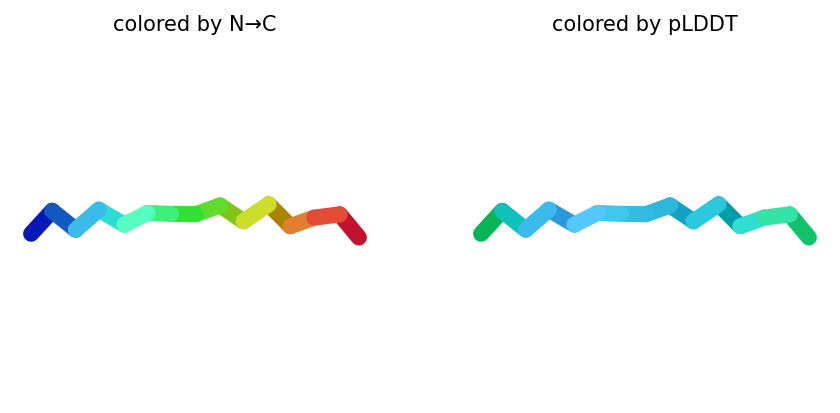

2025-11-17 08:50:19,923 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.3 pTM=0.0271
2025-11-17 08:50:22,516 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=65.8 pTM=0.0277 tol=1.03
2025-11-17 08:50:25,111 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.2 pTM=0.0287 tol=0.729
2025-11-17 08:50:27,705 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=73.9 pTM=0.029 tol=0.353
2025-11-17 08:50:27,706 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


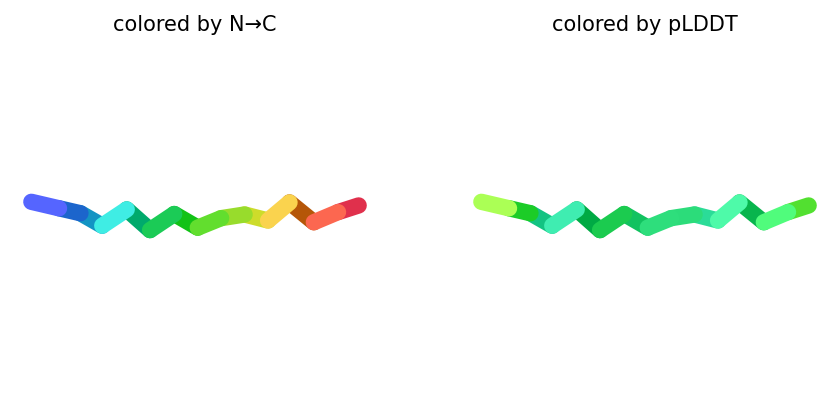

2025-11-17 08:50:30,348 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69.7 pTM=0.0317
2025-11-17 08:50:32,938 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=66.1 pTM=0.0308 tol=0.444
2025-11-17 08:50:35,527 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64 pTM=0.0288 tol=0.818
2025-11-17 08:50:38,117 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=61.5 pTM=0.0267 tol=2.19
2025-11-17 08:50:38,118 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


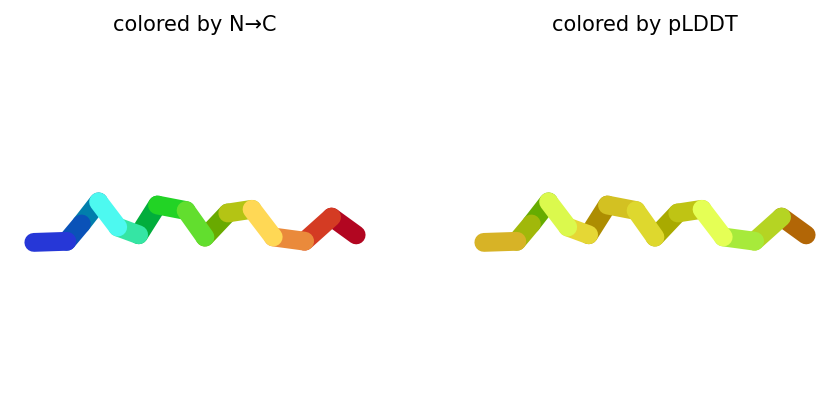

2025-11-17 08:50:38,188 reranking models by 'plddt' metric
2025-11-17 08:50:38,189 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=81.1 pTM=0.0285
2025-11-17 08:50:38,190 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=78.6 pTM=0.0395
2025-11-17 08:50:38,190 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=73.9 pTM=0.029
2025-11-17 08:50:38,190 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=61.5 pTM=0.0267
2025-11-17 08:50:38,190 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=59.7 pTM=0.0269
2025-11-17 08:50:39,573 Query 88/146: peptide_191_IC50_430.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:50:39,850 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


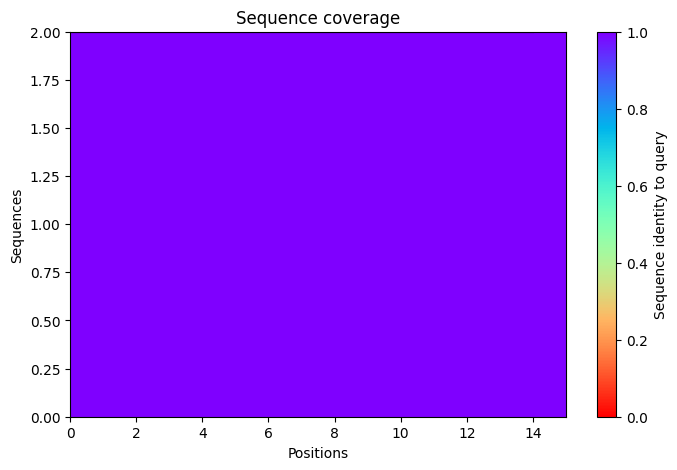

2025-11-17 08:50:54,539 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=62.5 pTM=0.0275
2025-11-17 08:50:57,117 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=69.8 pTM=0.0289 tol=1.09
2025-11-17 08:50:59,697 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.7 pTM=0.0294 tol=0.414
2025-11-17 08:51:02,278 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.4 pTM=0.0295 tol=0.206
2025-11-17 08:51:02,279 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


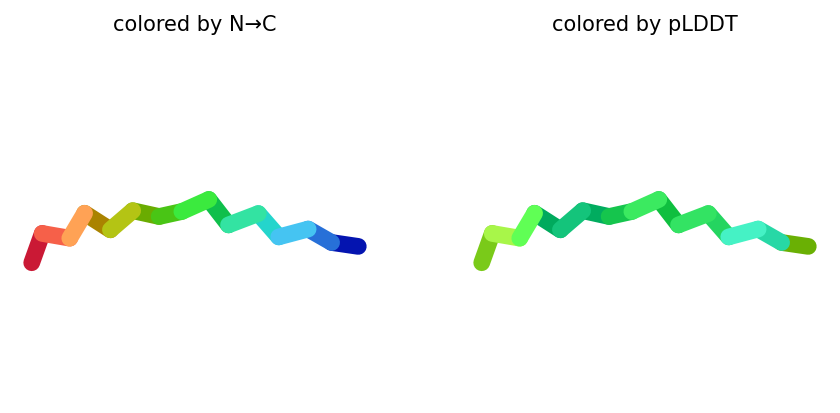

2025-11-17 08:51:04,913 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.4 pTM=0.0273
2025-11-17 08:51:07,493 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.7 pTM=0.0278 tol=0.997
2025-11-17 08:51:10,079 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.1 pTM=0.0283 tol=0.627
2025-11-17 08:51:12,668 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.6 pTM=0.0282 tol=0.175
2025-11-17 08:51:12,669 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


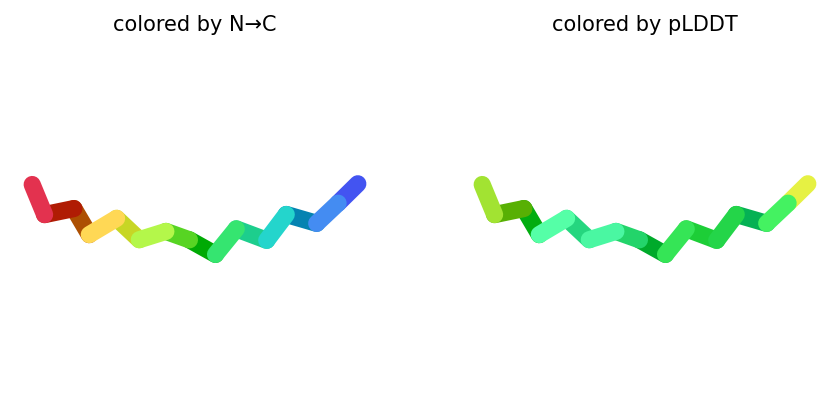

2025-11-17 08:51:15,316 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62.6 pTM=0.027
2025-11-17 08:51:17,913 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=66.8 pTM=0.0275 tol=1.3
2025-11-17 08:51:20,509 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=69.4 pTM=0.0277 tol=0.295
2025-11-17 08:51:23,103 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=70.4 pTM=0.0276 tol=0.198
2025-11-17 08:51:23,104 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


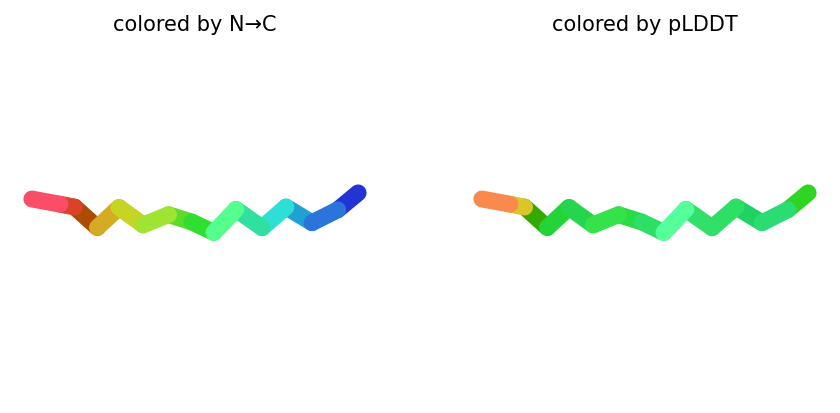

2025-11-17 08:51:25,753 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=66.1 pTM=0.028
2025-11-17 08:51:28,356 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=71.9 pTM=0.0301 tol=1.16
2025-11-17 08:51:30,959 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.8 pTM=0.0301 tol=0.208
2025-11-17 08:51:33,553 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.3 pTM=0.03 tol=0.0821
2025-11-17 08:51:33,554 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


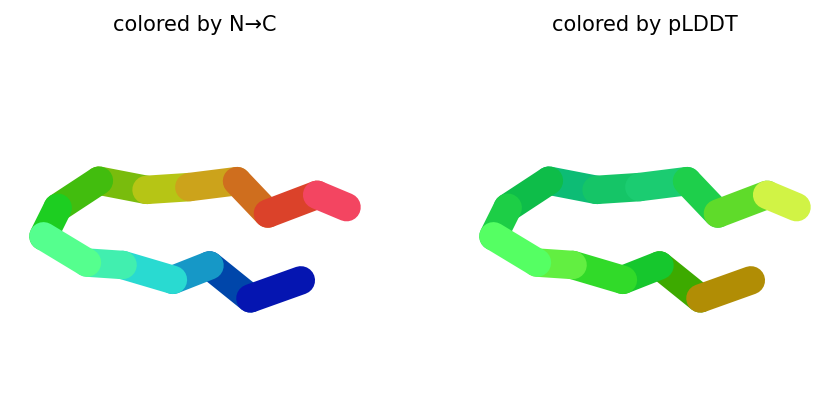

2025-11-17 08:51:36,197 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.5 pTM=0.028
2025-11-17 08:51:38,788 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.3 pTM=0.0276 tol=0.697
2025-11-17 08:51:41,374 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64.9 pTM=0.0283 tol=0.367
2025-11-17 08:51:43,964 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=64.5 pTM=0.0285 tol=0.452
2025-11-17 08:51:43,964 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


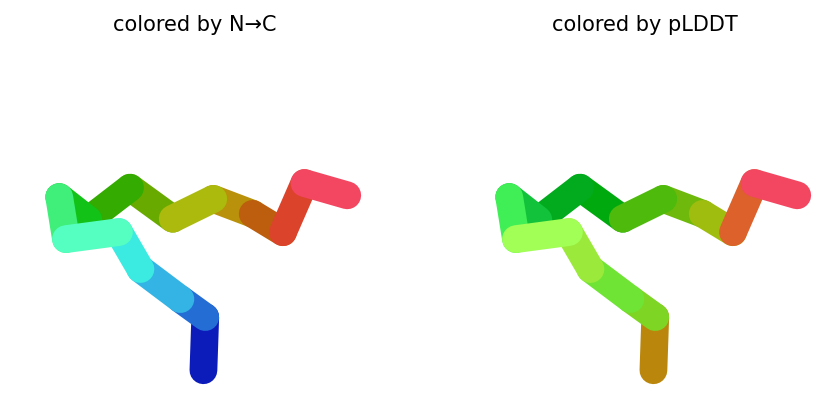

2025-11-17 08:51:44,021 reranking models by 'plddt' metric
2025-11-17 08:51:44,022 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=72.4 pTM=0.0295
2025-11-17 08:51:44,022 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=71.6 pTM=0.0282
2025-11-17 08:51:44,022 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=70.4 pTM=0.0276
2025-11-17 08:51:44,023 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=70.3 pTM=0.03
2025-11-17 08:51:44,023 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=64.5 pTM=0.0285
2025-11-17 08:51:45,557 Query 89/146: peptide_192_IC50_436.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:51:45,844 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


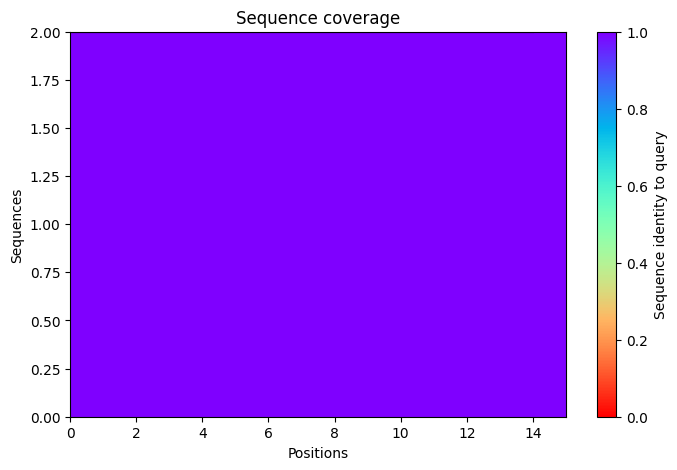

2025-11-17 08:51:56,631 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=74.8 pTM=0.0363
2025-11-17 08:51:59,205 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.4 pTM=0.0368 tol=0.365
2025-11-17 08:52:01,779 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.1 pTM=0.0373 tol=0.107
2025-11-17 08:52:04,356 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=78.2 pTM=0.0378 tol=0.0836
2025-11-17 08:52:04,357 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


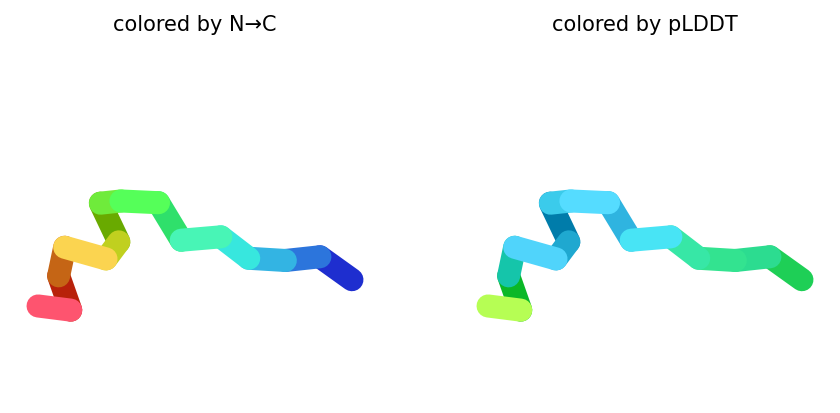

2025-11-17 08:52:07,023 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=77.1 pTM=0.0385
2025-11-17 08:52:09,602 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.8 pTM=0.0379 tol=0.314
2025-11-17 08:52:12,184 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=77.2 pTM=0.0385 tol=0.0989
2025-11-17 08:52:14,766 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=77.5 pTM=0.0382 tol=0.0619
2025-11-17 08:52:14,767 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


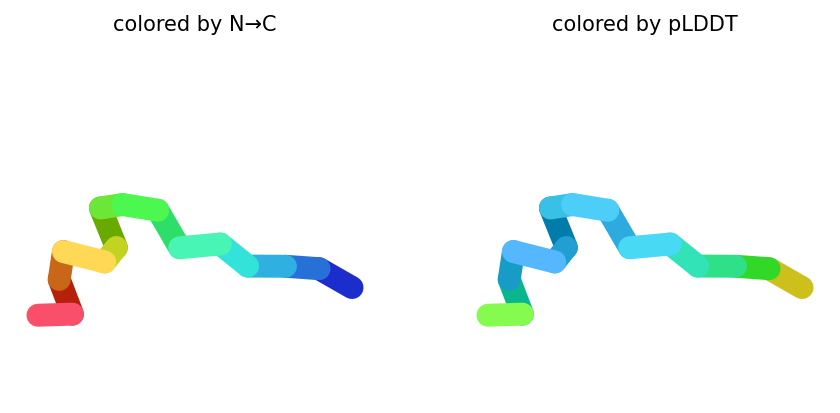

2025-11-17 08:52:17,405 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=84.4 pTM=0.0393
2025-11-17 08:52:19,995 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=85.9 pTM=0.0395 tol=0.405
2025-11-17 08:52:22,584 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=87.2 pTM=0.0394 tol=0.152
2025-11-17 08:52:25,176 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=86.4 pTM=0.0394 tol=0.0587
2025-11-17 08:52:25,177 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


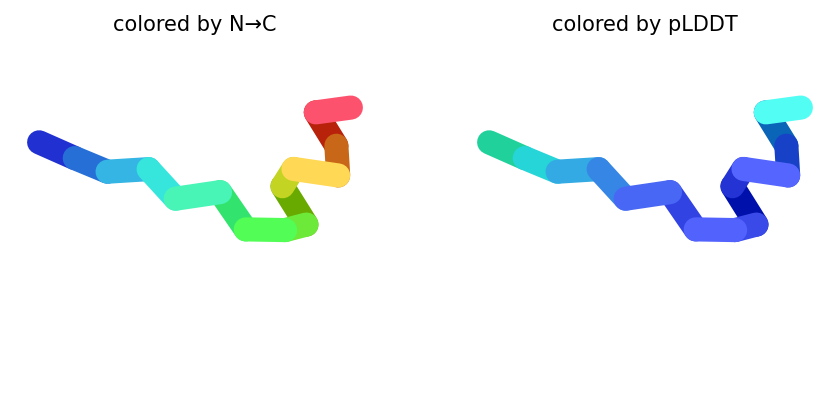

2025-11-17 08:52:27,823 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=82.2 pTM=0.0388
2025-11-17 08:52:30,417 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=82.8 pTM=0.0394 tol=0.196
2025-11-17 08:52:33,012 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=83.7 pTM=0.0396 tol=0.142
2025-11-17 08:52:35,604 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=83.7 pTM=0.04 tol=0.0739
2025-11-17 08:52:35,605 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


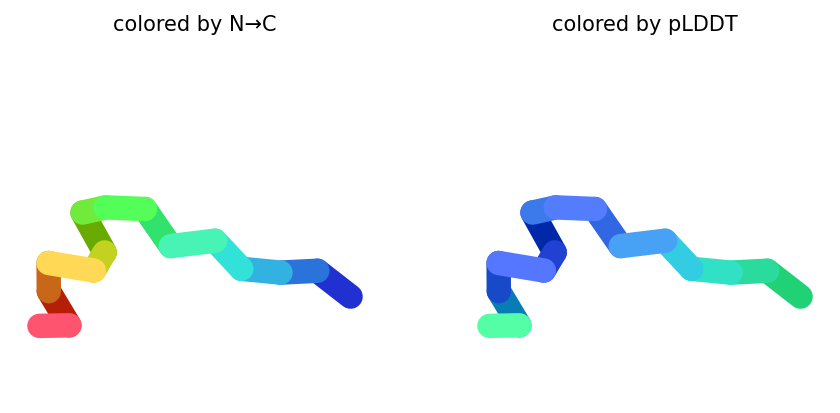

2025-11-17 08:52:38,248 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=78.3 pTM=0.0364
2025-11-17 08:52:40,833 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=78.1 pTM=0.0352 tol=0.518
2025-11-17 08:52:43,424 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=77.8 pTM=0.0349 tol=0.141
2025-11-17 08:52:46,016 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78.5 pTM=0.0351 tol=0.0721
2025-11-17 08:52:46,017 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


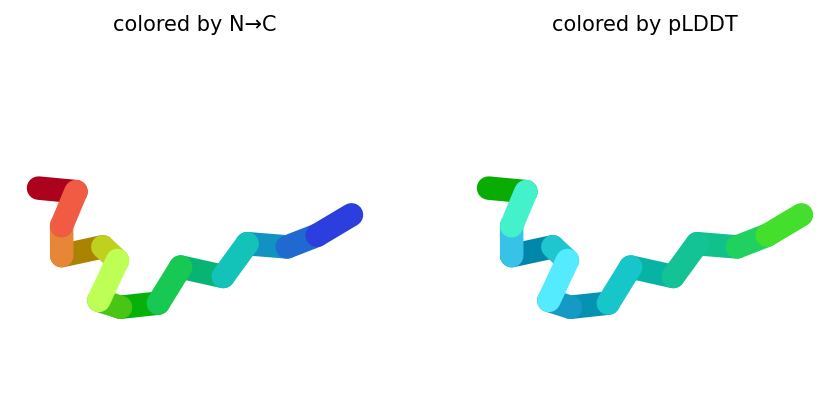

2025-11-17 08:52:46,070 reranking models by 'plddt' metric
2025-11-17 08:52:46,070 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=86.4 pTM=0.0394
2025-11-17 08:52:46,070 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=83.7 pTM=0.04
2025-11-17 08:52:46,071 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=78.5 pTM=0.0351
2025-11-17 08:52:46,071 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=78.2 pTM=0.0378
2025-11-17 08:52:46,071 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=77.5 pTM=0.0382
2025-11-17 08:52:47,208 Query 90/146: peptide_193_IC50_435.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:52:47,489 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


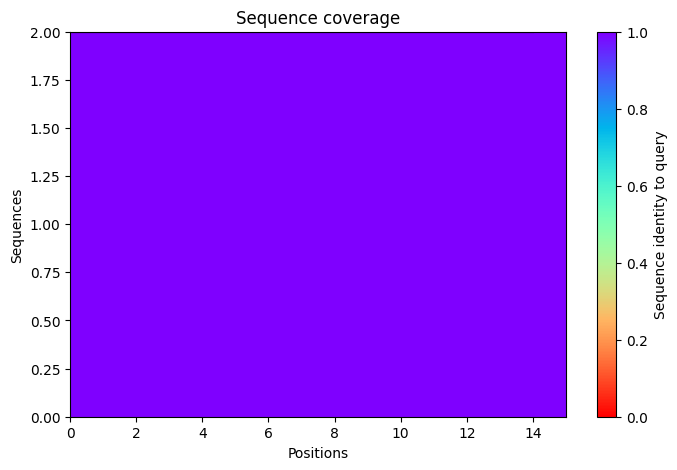

2025-11-17 08:52:58,253 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=85.1 pTM=0.0354
2025-11-17 08:53:00,835 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83.6 pTM=0.035 tol=0.167
2025-11-17 08:53:03,412 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81.2 pTM=0.0337 tol=0.187
2025-11-17 08:53:05,994 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.4 pTM=0.0342 tol=0.064
2025-11-17 08:53:05,995 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


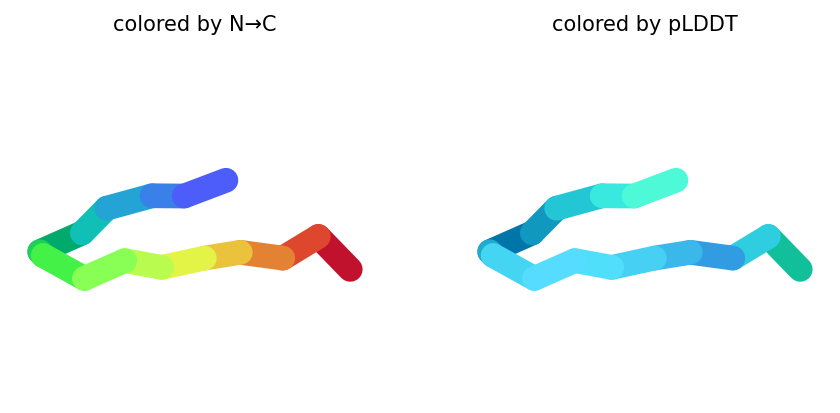

2025-11-17 08:53:08,661 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=79.5 pTM=0.033
2025-11-17 08:53:11,242 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.7 pTM=0.0295 tol=1.32
2025-11-17 08:53:13,828 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.2 pTM=0.0291 tol=5.17
2025-11-17 08:53:16,411 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.9 pTM=0.0292 tol=1.48
2025-11-17 08:53:16,412 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


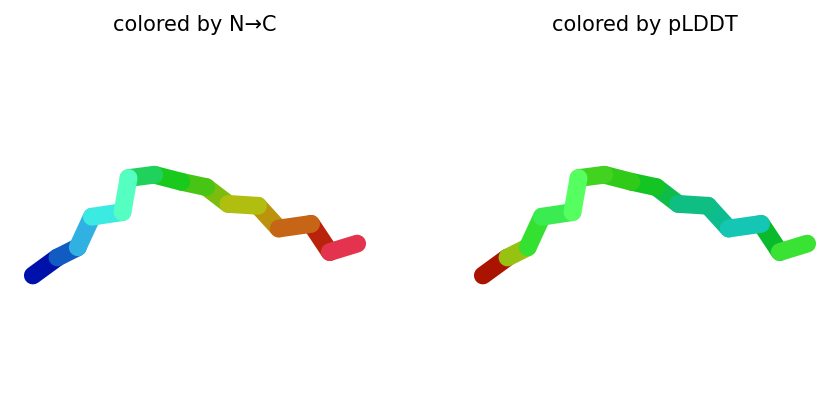

2025-11-17 08:53:19,053 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=79.2 pTM=0.0315
2025-11-17 08:53:21,648 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=77.6 pTM=0.0298 tol=0.311
2025-11-17 08:53:24,239 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.6 pTM=0.0286 tol=6.64
2025-11-17 08:53:26,830 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.2 pTM=0.0285 tol=2.92
2025-11-17 08:53:26,830 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


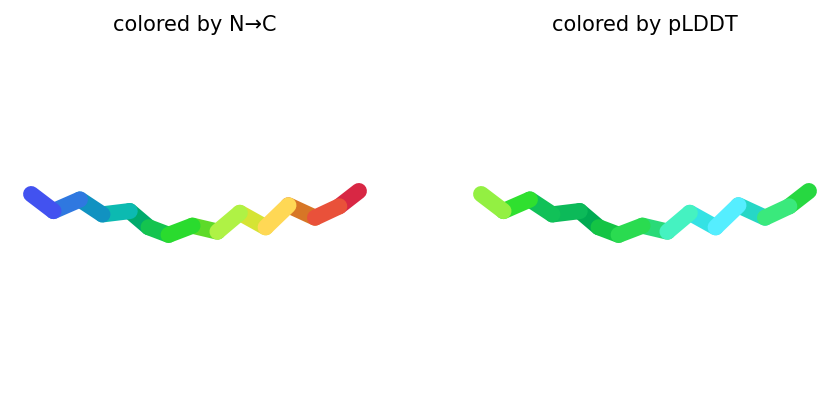

2025-11-17 08:53:29,470 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=80.1 pTM=0.0341
2025-11-17 08:53:32,060 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=79.9 pTM=0.0342 tol=0.0685
2025-11-17 08:53:34,647 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=79.6 pTM=0.0334 tol=0.114
2025-11-17 08:53:37,235 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.1 pTM=0.0334 tol=0.0966
2025-11-17 08:53:37,235 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


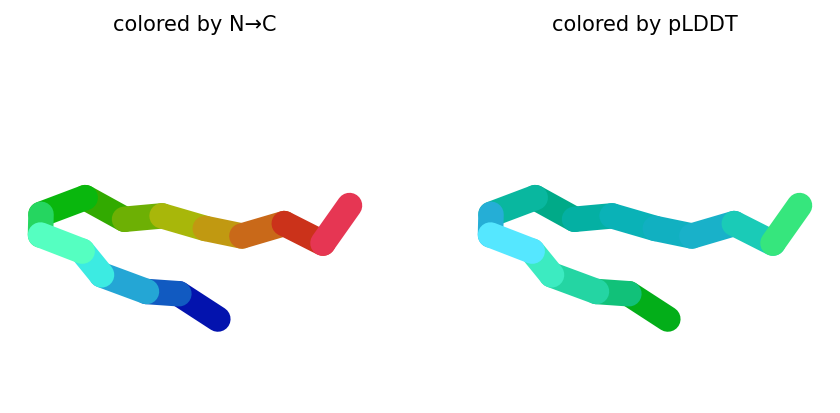

2025-11-17 08:53:39,873 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=80.6 pTM=0.033
2025-11-17 08:53:42,462 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.9 pTM=0.0319 tol=0.23
2025-11-17 08:53:45,046 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.1 pTM=0.0307 tol=0.427
2025-11-17 08:53:47,636 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.6 pTM=0.0304 tol=0.254
2025-11-17 08:53:47,637 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


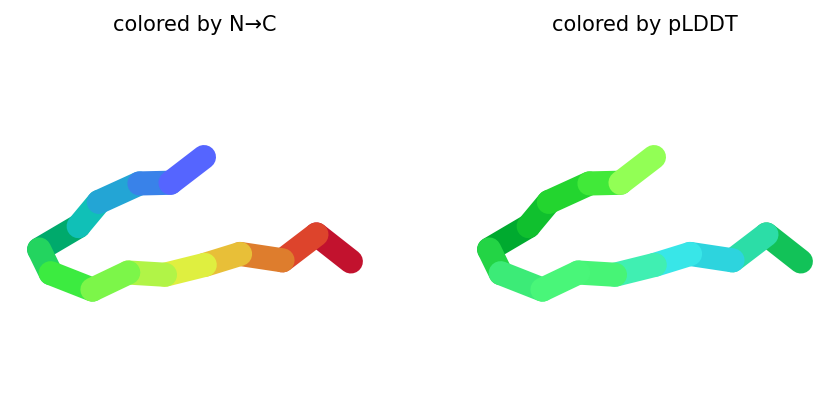

2025-11-17 08:53:47,693 reranking models by 'plddt' metric
2025-11-17 08:53:47,693 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=82.4 pTM=0.0342
2025-11-17 08:53:47,694 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=79.1 pTM=0.0334
2025-11-17 08:53:47,695 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=75.2 pTM=0.0285
2025-11-17 08:53:47,695 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=74.6 pTM=0.0304
2025-11-17 08:53:47,695 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=70.9 pTM=0.0292
2025-11-17 08:53:48,835 Query 91/146: peptide_200_IC50_434.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:53:49,112 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


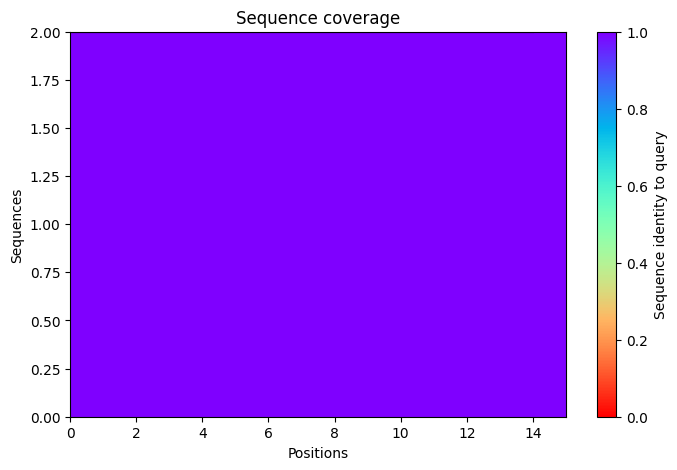

2025-11-17 08:54:04,352 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.1 pTM=0.0361
2025-11-17 08:54:06,932 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.2 pTM=0.0386 tol=0.182
2025-11-17 08:54:09,511 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.4 pTM=0.0385 tol=0.238
2025-11-17 08:54:12,088 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.9 pTM=0.0383 tol=0.0825
2025-11-17 08:54:12,089 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


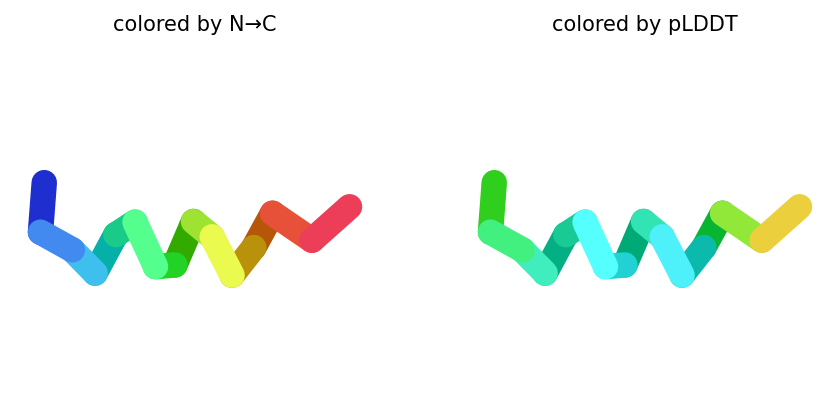

2025-11-17 08:54:14,722 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.5 pTM=0.035
2025-11-17 08:54:17,305 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.9 pTM=0.036 tol=0.144
2025-11-17 08:54:19,893 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.4 pTM=0.0353 tol=0.194
2025-11-17 08:54:22,479 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=68.6 pTM=0.0356 tol=0.127
2025-11-17 08:54:22,480 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


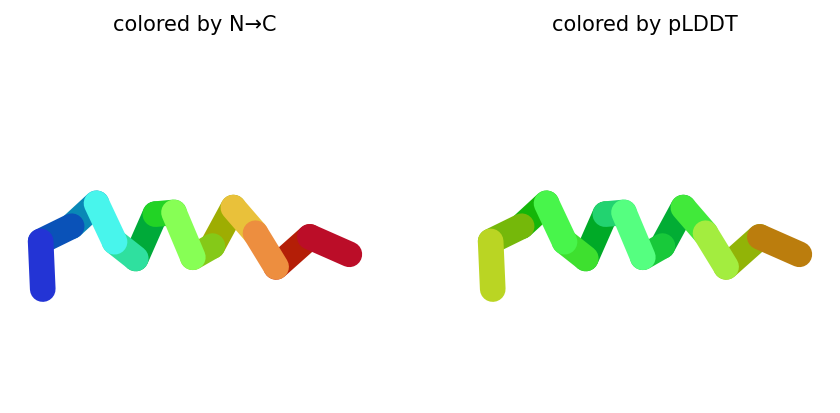

2025-11-17 08:54:25,127 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=61.2 pTM=0.027
2025-11-17 08:54:27,722 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=63.1 pTM=0.028 tol=1.37
2025-11-17 08:54:30,320 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.1 pTM=0.0294 tol=0.862
2025-11-17 08:54:32,919 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=66.1 pTM=0.0299 tol=0.336
2025-11-17 08:54:32,920 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


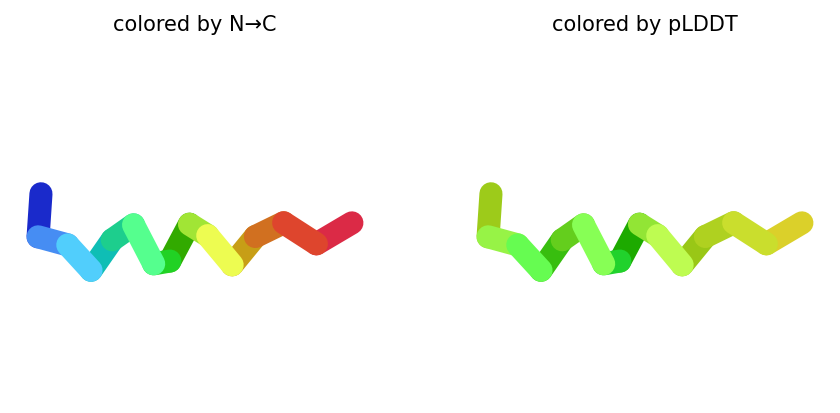

2025-11-17 08:54:35,601 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62.7 pTM=0.0306
2025-11-17 08:54:38,200 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.2 pTM=0.0311 tol=0.294
2025-11-17 08:54:40,796 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=62.9 pTM=0.0306 tol=0.247
2025-11-17 08:54:43,391 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=63.5 pTM=0.0309 tol=0.236
2025-11-17 08:54:43,391 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


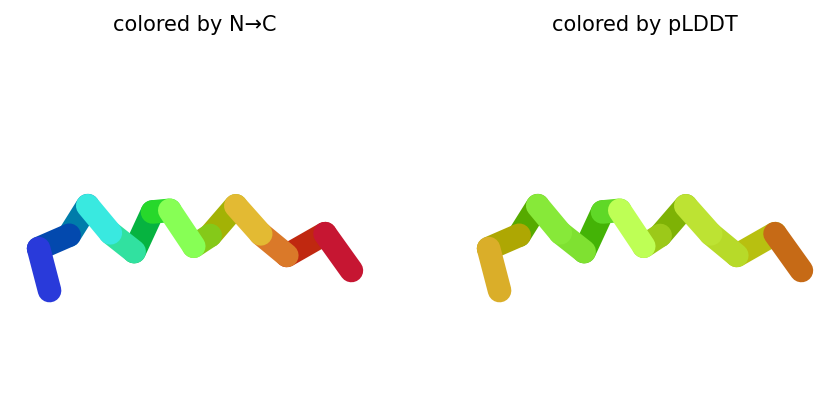

2025-11-17 08:54:46,037 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.4 pTM=0.035
2025-11-17 08:54:48,631 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.6 pTM=0.0364 tol=0.121
2025-11-17 08:54:51,217 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=69.7 pTM=0.0355 tol=0.37
2025-11-17 08:54:53,803 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=68.3 pTM=0.0347 tol=0.32
2025-11-17 08:54:53,803 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


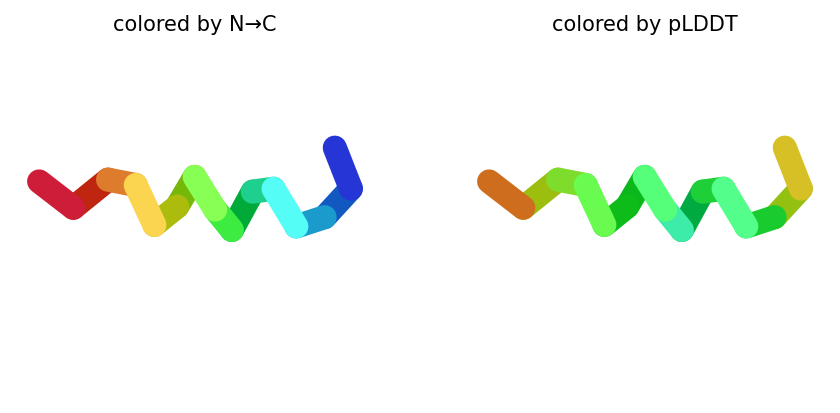

2025-11-17 08:54:53,853 reranking models by 'plddt' metric
2025-11-17 08:54:53,854 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=74.9 pTM=0.0383
2025-11-17 08:54:53,854 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=68.6 pTM=0.0356
2025-11-17 08:54:53,855 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=68.3 pTM=0.0347
2025-11-17 08:54:53,855 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=66.1 pTM=0.0299
2025-11-17 08:54:53,855 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=63.5 pTM=0.0309
2025-11-17 08:54:55,353 Query 92/146: peptide_201_IC50_442.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:54:55,627 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


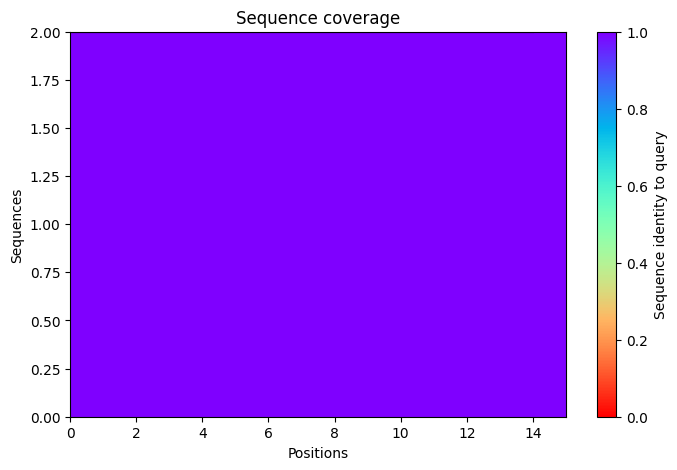

2025-11-17 08:55:08,877 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=62.9 pTM=0.0288
2025-11-17 08:55:11,454 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=61.3 pTM=0.0286 tol=1.01
2025-11-17 08:55:14,030 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=61.2 pTM=0.0283 tol=0.587
2025-11-17 08:55:16,610 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=61.8 pTM=0.0283 tol=0.829
2025-11-17 08:55:16,611 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


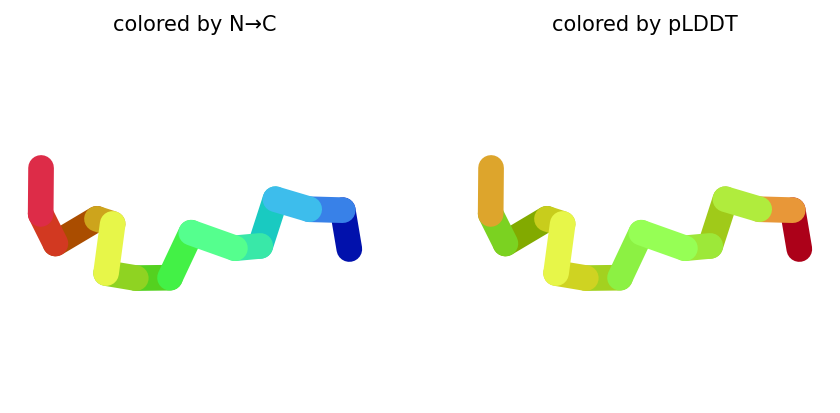

2025-11-17 08:55:19,243 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61.1 pTM=0.0272
2025-11-17 08:55:21,823 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.2 pTM=0.0278 tol=1.78
2025-11-17 08:55:24,405 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=62.1 pTM=0.0278 tol=0.429
2025-11-17 08:55:26,991 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=61.4 pTM=0.0271 tol=0.567
2025-11-17 08:55:26,991 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


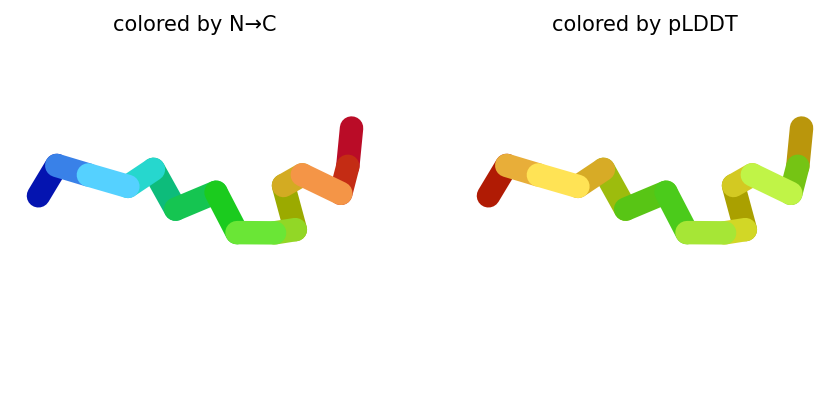

2025-11-17 08:55:29,628 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=62.2 pTM=0.0263
2025-11-17 08:55:32,220 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=63.6 pTM=0.0268 tol=1.06
2025-11-17 08:55:34,814 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.8 pTM=0.0281 tol=0.497
2025-11-17 08:55:37,411 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=66.2 pTM=0.0282 tol=0.446
2025-11-17 08:55:37,411 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


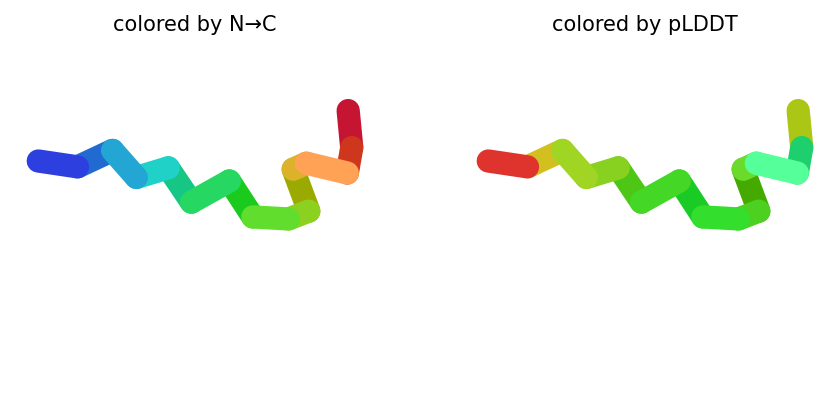

2025-11-17 08:55:40,062 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=67.6 pTM=0.0311
2025-11-17 08:55:42,658 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=64.9 pTM=0.0296 tol=0.234
2025-11-17 08:55:45,256 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=64.9 pTM=0.029 tol=0.292
2025-11-17 08:55:47,851 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=63 pTM=0.0286 tol=0.455
2025-11-17 08:55:47,852 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


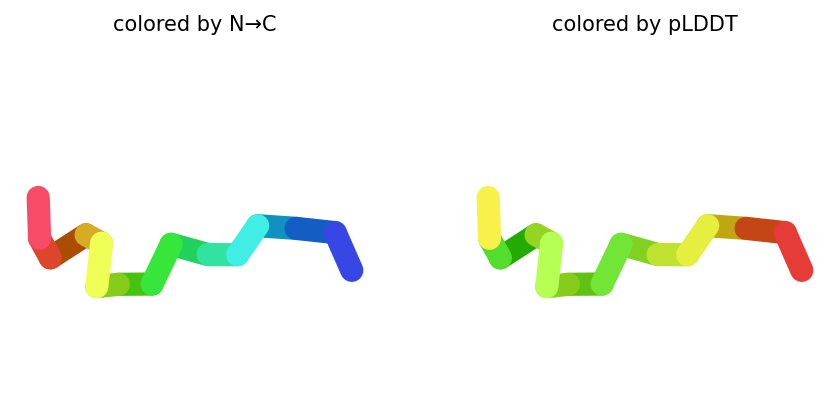

2025-11-17 08:55:50,494 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=61.3 pTM=0.028
2025-11-17 08:55:53,085 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=58.4 pTM=0.0268 tol=2.39
2025-11-17 08:55:55,670 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=60.3 pTM=0.0271 tol=1.06
2025-11-17 08:55:58,261 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=62.6 pTM=0.0279 tol=1.31
2025-11-17 08:55:58,262 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


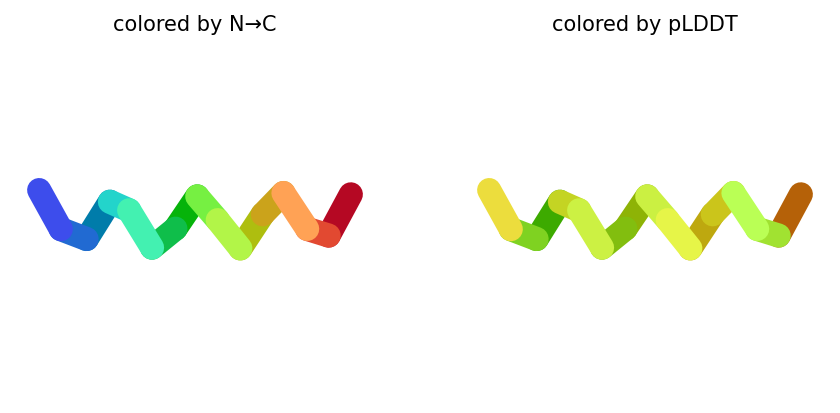

2025-11-17 08:55:58,336 reranking models by 'plddt' metric
2025-11-17 08:55:58,337 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=66.2 pTM=0.0282
2025-11-17 08:55:58,337 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=63 pTM=0.0286
2025-11-17 08:55:58,337 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=62.6 pTM=0.0279
2025-11-17 08:55:58,337 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=61.8 pTM=0.0283
2025-11-17 08:55:58,337 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=61.4 pTM=0.0271
2025-11-17 08:55:59,905 Query 93/146: peptide_202_IC50_437.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:56:00,190 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


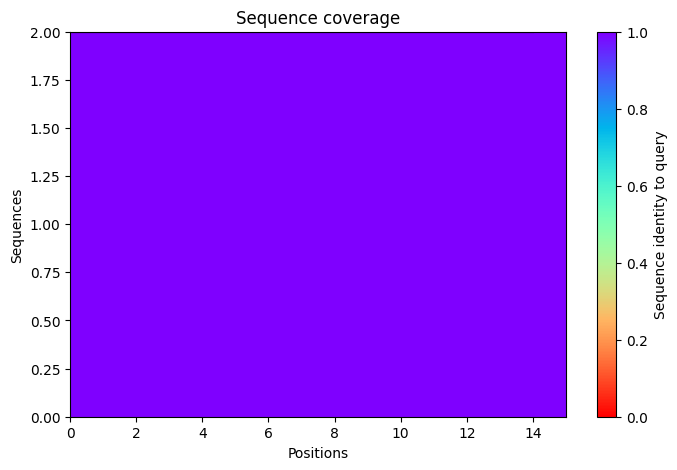

2025-11-17 08:56:12,477 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.6 pTM=0.0313
2025-11-17 08:56:15,051 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=62.9 pTM=0.0298 tol=4.11
2025-11-17 08:56:17,627 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=69.4 pTM=0.0289 tol=1.75
2025-11-17 08:56:20,207 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=71.7 pTM=0.0287 tol=0.466
2025-11-17 08:56:20,208 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


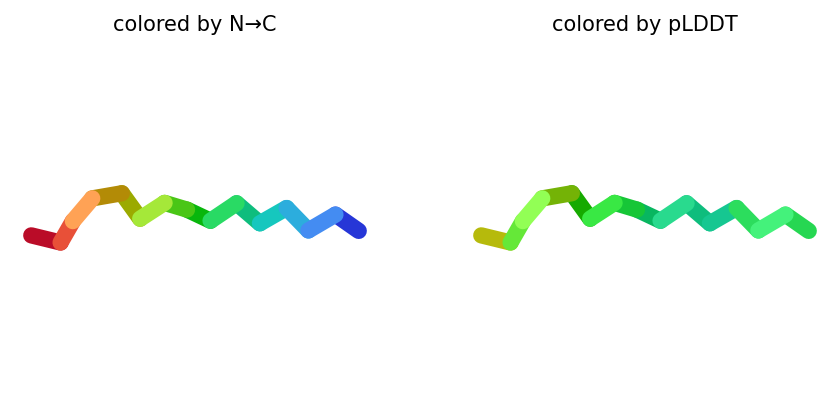

2025-11-17 08:56:22,842 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.3 pTM=0.0273
2025-11-17 08:56:25,421 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=67.8 pTM=0.0275 tol=0.747
2025-11-17 08:56:28,006 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.8 pTM=0.0279 tol=1
2025-11-17 08:56:30,587 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.5 pTM=0.0276 tol=0.28
2025-11-17 08:56:30,588 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


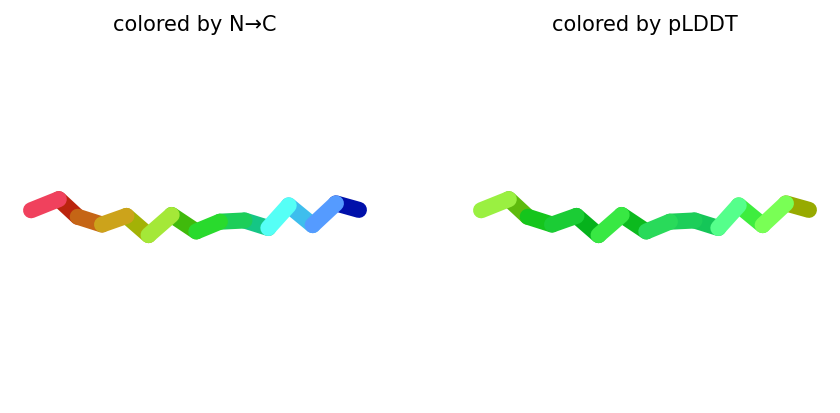

2025-11-17 08:56:33,226 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.7 pTM=0.0277
2025-11-17 08:56:35,815 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.7 pTM=0.0279 tol=0.335
2025-11-17 08:56:38,410 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.2 pTM=0.0278 tol=0.118
2025-11-17 08:56:41,004 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.1 pTM=0.0276 tol=0.0757
2025-11-17 08:56:41,005 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


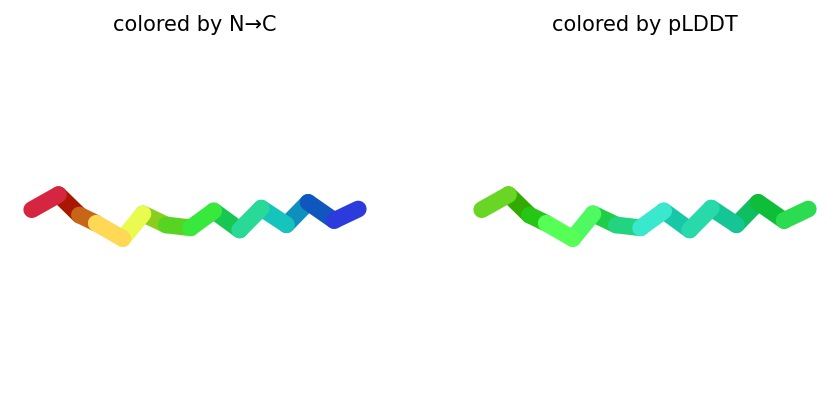

2025-11-17 08:56:43,652 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.2 pTM=0.0278
2025-11-17 08:56:46,246 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.9 pTM=0.0271 tol=0.391
2025-11-17 08:56:48,847 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.5 pTM=0.0271 tol=0.378
2025-11-17 08:56:51,439 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.8 pTM=0.027 tol=0.27
2025-11-17 08:56:51,440 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


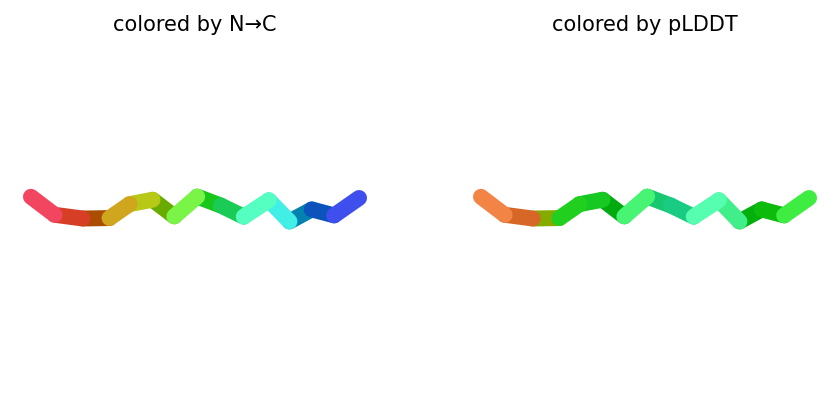

2025-11-17 08:56:54,081 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=63.6 pTM=0.0278
2025-11-17 08:56:56,670 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.9 pTM=0.0275 tol=2.31
2025-11-17 08:56:59,259 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64.6 pTM=0.0277 tol=1.18
2025-11-17 08:57:01,848 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.9 pTM=0.028 tol=0.686
2025-11-17 08:57:01,849 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


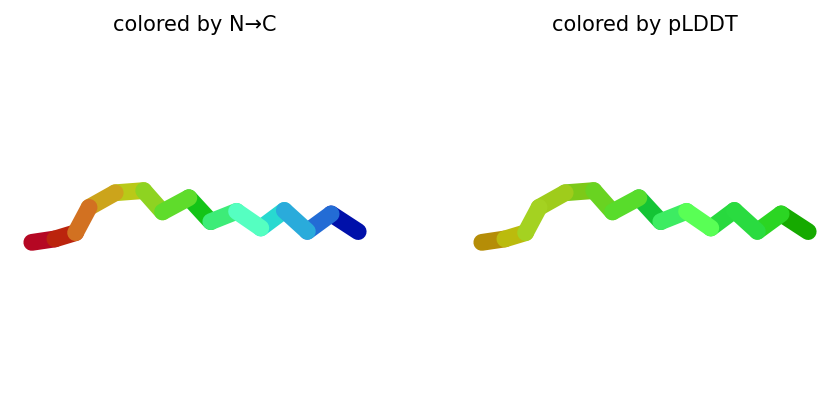

2025-11-17 08:57:01,896 reranking models by 'plddt' metric
2025-11-17 08:57:01,896 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=74.1 pTM=0.0276
2025-11-17 08:57:01,896 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=71.7 pTM=0.0287
2025-11-17 08:57:01,897 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=70.5 pTM=0.0276
2025-11-17 08:57:01,897 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=69.8 pTM=0.027
2025-11-17 08:57:01,897 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=67.9 pTM=0.028
2025-11-17 08:57:03,076 Query 94/146: peptide_203_IC50_440.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:57:03,353 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


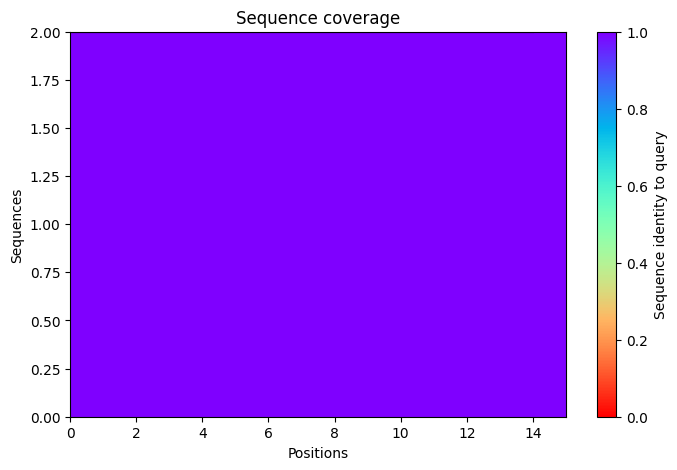

2025-11-17 08:57:13,597 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.9 pTM=0.0276
2025-11-17 08:57:16,174 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=69.9 pTM=0.0282 tol=0.469
2025-11-17 08:57:18,756 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=69.5 pTM=0.0281 tol=0.364
2025-11-17 08:57:21,333 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=69.2 pTM=0.0278 tol=0.618
2025-11-17 08:57:21,333 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


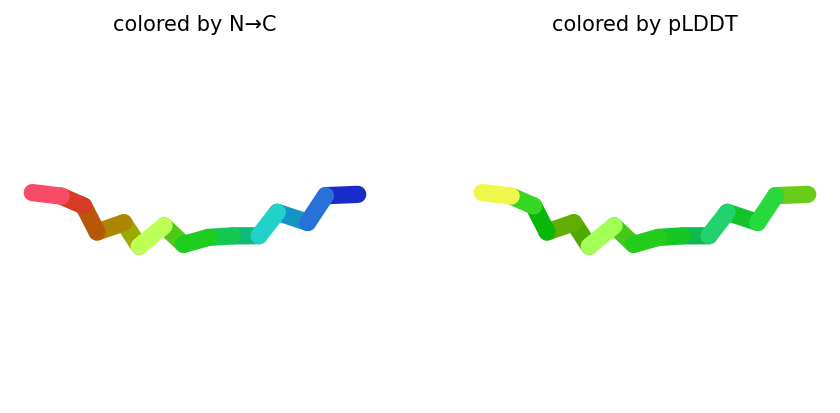

2025-11-17 08:57:23,966 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=66.8 pTM=0.0264
2025-11-17 08:57:26,548 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.1 pTM=0.027 tol=0.323
2025-11-17 08:57:29,133 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.9 pTM=0.0266 tol=0.163
2025-11-17 08:57:31,713 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.4 pTM=0.0265 tol=0.0701
2025-11-17 08:57:31,714 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


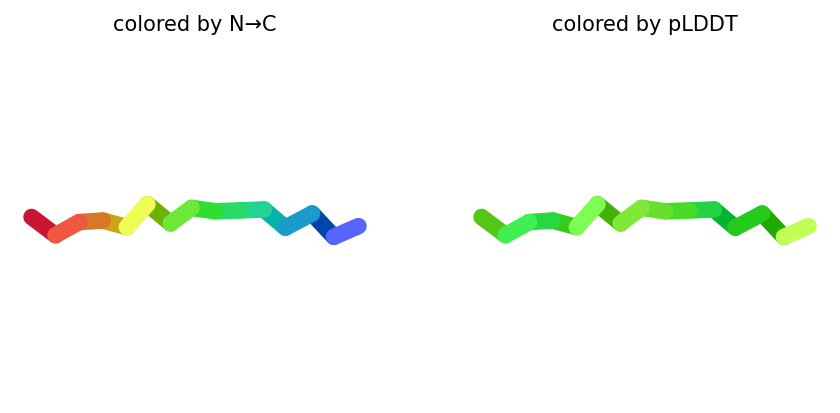

2025-11-17 08:57:34,347 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=68.9 pTM=0.0261
2025-11-17 08:57:36,941 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.8 pTM=0.0259 tol=0.279
2025-11-17 08:57:39,531 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=68.9 pTM=0.026 tol=0.421
2025-11-17 08:57:42,123 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=69 pTM=0.0256 tol=0.393
2025-11-17 08:57:42,124 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


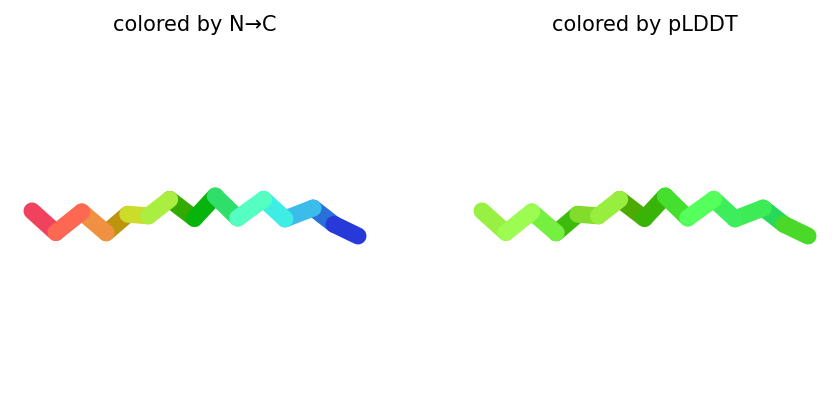

2025-11-17 08:57:44,766 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=72.3 pTM=0.0265
2025-11-17 08:57:47,357 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=69.9 pTM=0.0269 tol=0.262
2025-11-17 08:57:49,951 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=69.2 pTM=0.0268 tol=0.44
2025-11-17 08:57:52,542 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=68.9 pTM=0.0266 tol=0.368
2025-11-17 08:57:52,543 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


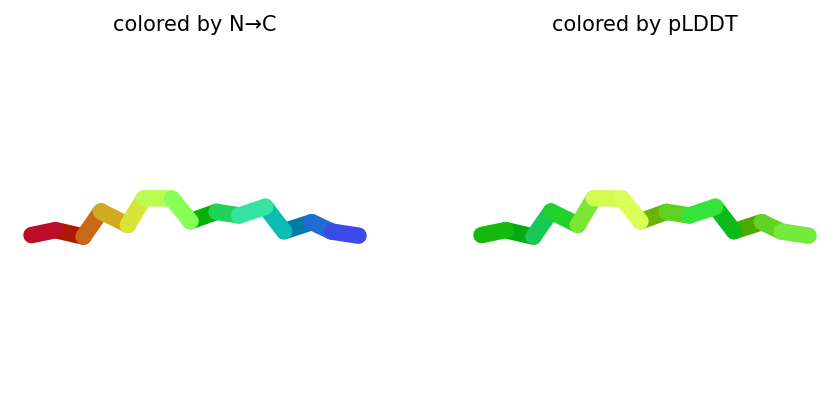

2025-11-17 08:57:55,188 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.7 pTM=0.0274
2025-11-17 08:57:57,776 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=69.9 pTM=0.0279 tol=0.331
2025-11-17 08:58:00,362 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=70.9 pTM=0.0277 tol=0.382
2025-11-17 08:58:02,948 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=69 pTM=0.0276 tol=0.43
2025-11-17 08:58:02,949 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


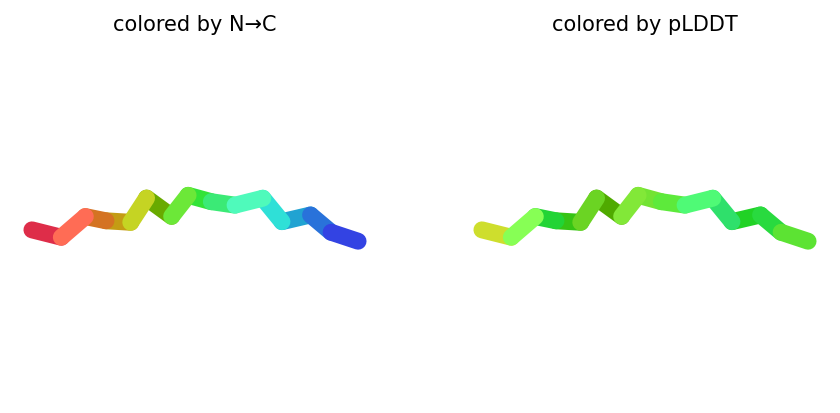

2025-11-17 08:58:03,005 reranking models by 'plddt' metric
2025-11-17 08:58:03,005 rank_001_alphafold2_ptm_model_2_seed_000 pLDDT=69.4 pTM=0.0265
2025-11-17 08:58:03,007 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=69.2 pTM=0.0278
2025-11-17 08:58:03,007 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=69 pTM=0.0276
2025-11-17 08:58:03,008 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=69 pTM=0.0256
2025-11-17 08:58:03,008 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=68.9 pTM=0.0266
2025-11-17 08:58:04,503 Query 95/146: peptide_205_IC50_441.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:58:04,801 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


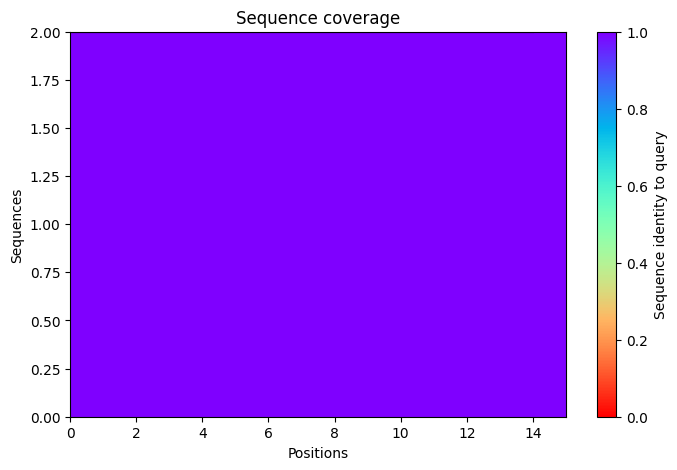

2025-11-17 08:58:16,864 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=73.8 pTM=0.0288
2025-11-17 08:58:19,439 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.2 pTM=0.0285 tol=0.625
2025-11-17 08:58:22,018 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.2 pTM=0.0288 tol=0.568
2025-11-17 08:58:24,596 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.5 pTM=0.0286 tol=0.146
2025-11-17 08:58:24,597 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


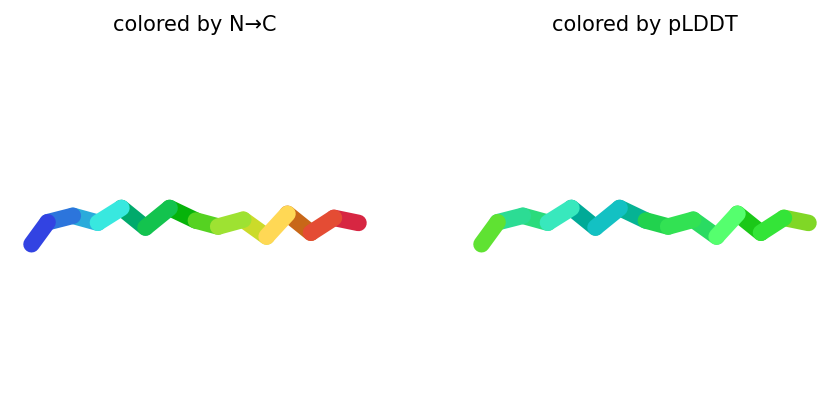

2025-11-17 08:58:27,235 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=72 pTM=0.0279
2025-11-17 08:58:29,819 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.8 pTM=0.028 tol=0.215
2025-11-17 08:58:32,399 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.8 pTM=0.0282 tol=0.221
2025-11-17 08:58:34,981 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.1 pTM=0.028 tol=0.169
2025-11-17 08:58:34,981 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


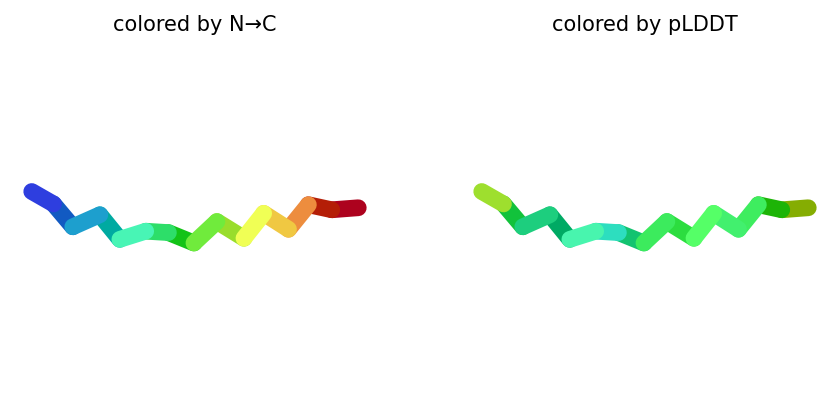

2025-11-17 08:58:37,625 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73 pTM=0.0275
2025-11-17 08:58:40,215 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.9 pTM=0.0272 tol=0.492
2025-11-17 08:58:42,809 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.4 pTM=0.0274 tol=0.102
2025-11-17 08:58:45,405 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.4 pTM=0.0273 tol=0.132
2025-11-17 08:58:45,406 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


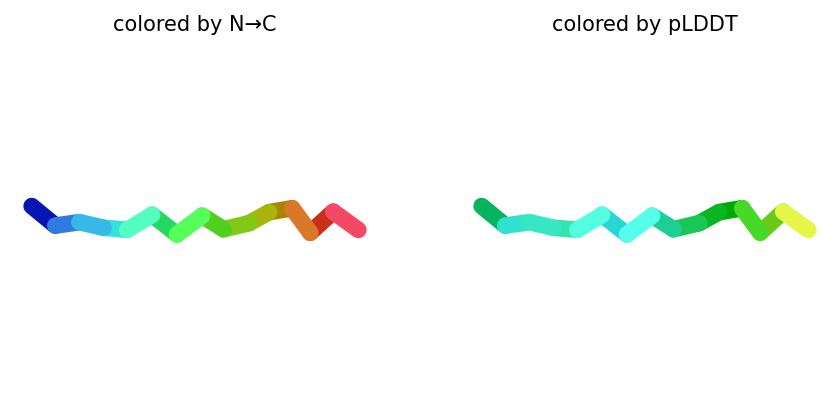

2025-11-17 08:58:48,052 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=72.1 pTM=0.0288
2025-11-17 08:58:50,653 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=74.4 pTM=0.0288 tol=0.684
2025-11-17 08:58:53,253 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.8 pTM=0.029 tol=0.235
2025-11-17 08:58:55,855 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.1 pTM=0.0287 tol=0.127
2025-11-17 08:58:55,855 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


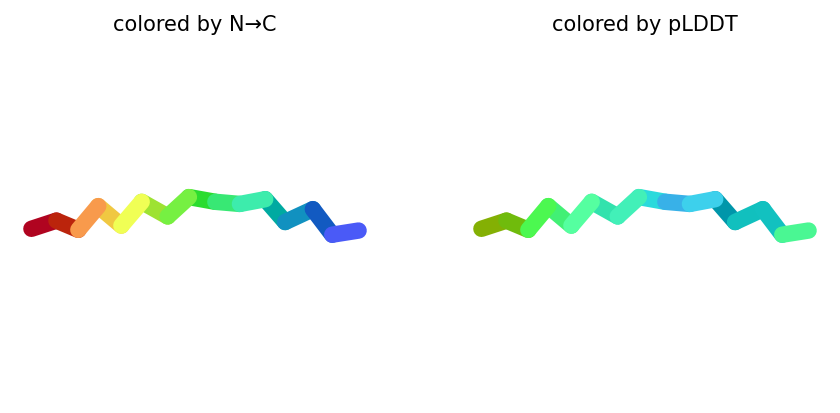

2025-11-17 08:58:58,503 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.8 pTM=0.0273
2025-11-17 08:59:01,098 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.5 pTM=0.0275 tol=0.515
2025-11-17 08:59:03,689 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=74.1 pTM=0.0277 tol=0.286
2025-11-17 08:59:06,282 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=72.6 pTM=0.0276 tol=0.306
2025-11-17 08:59:06,282 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


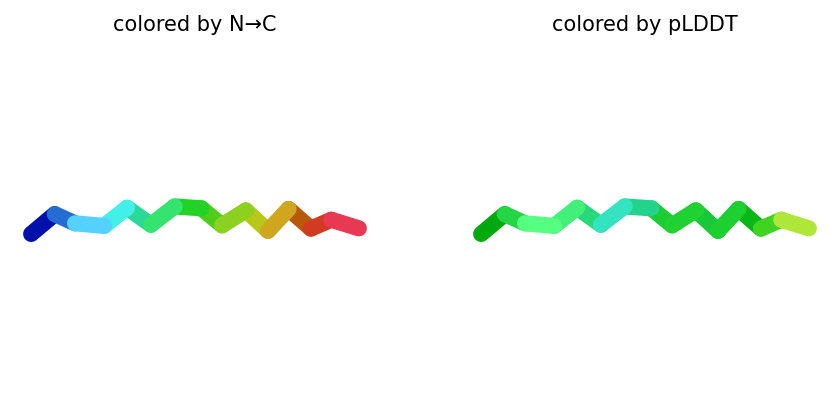

2025-11-17 08:59:06,333 reranking models by 'plddt' metric
2025-11-17 08:59:06,334 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=76.1 pTM=0.0287
2025-11-17 08:59:06,334 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=74.4 pTM=0.0273
2025-11-17 08:59:06,334 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=73.5 pTM=0.0286
2025-11-17 08:59:06,334 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=72.6 pTM=0.0276
2025-11-17 08:59:06,335 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.1 pTM=0.028
2025-11-17 08:59:07,520 Query 96/146: peptide_206_IC50_440.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 08:59:07,791 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


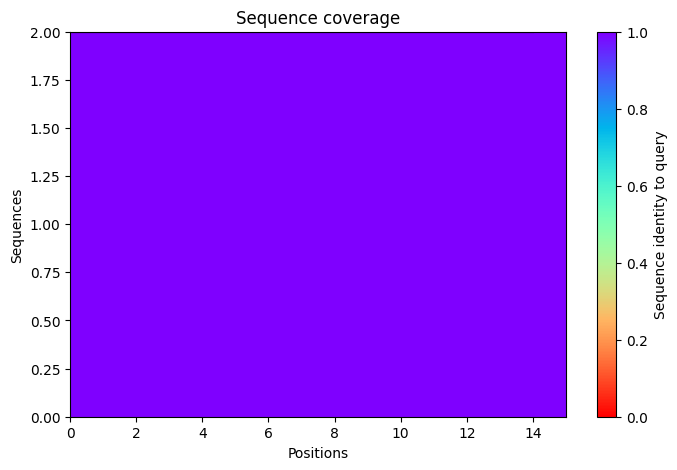

2025-11-17 08:59:20,542 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=82.1 pTM=0.0399
2025-11-17 08:59:23,118 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=84.1 pTM=0.0422 tol=0.166
2025-11-17 08:59:25,693 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=84.9 pTM=0.0433 tol=0.25
2025-11-17 08:59:28,267 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=85.6 pTM=0.043 tol=0.0782
2025-11-17 08:59:28,268 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


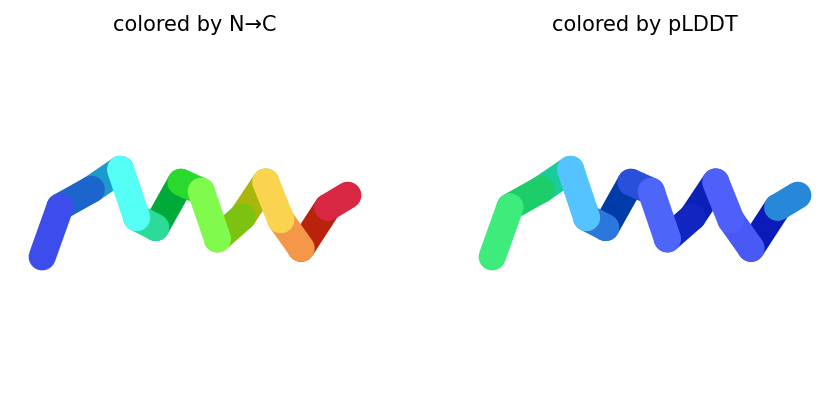

2025-11-17 08:59:30,922 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=68.9 pTM=0.0327
2025-11-17 08:59:33,501 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.9 pTM=0.0334 tol=0.431
2025-11-17 08:59:36,084 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=67.2 pTM=0.0332 tol=0.224
2025-11-17 08:59:38,664 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=68.4 pTM=0.0328 tol=0.0977
2025-11-17 08:59:38,665 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


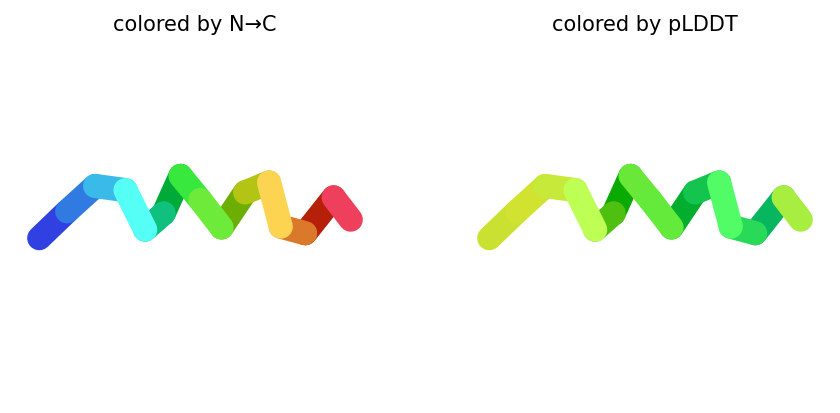

2025-11-17 08:59:41,298 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.8 pTM=0.0314
2025-11-17 08:59:43,885 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.9 pTM=0.0346 tol=0.414
2025-11-17 08:59:46,466 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=82.9 pTM=0.0374 tol=0.395
2025-11-17 08:59:49,056 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=83.8 pTM=0.0378 tol=0.0715
2025-11-17 08:59:49,056 alphafold2_ptm_model_3_seed_000 took 10.3s (3 recycles)


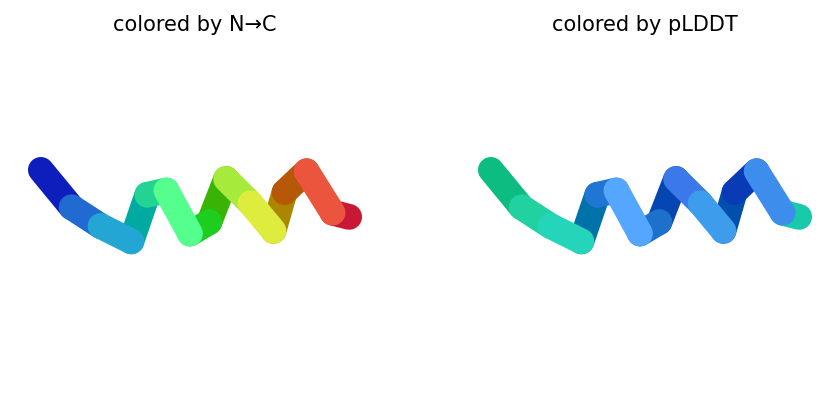

2025-11-17 08:59:51,702 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.2 pTM=0.0336
2025-11-17 08:59:54,297 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=78.8 pTM=0.0356 tol=0.174
2025-11-17 08:59:56,889 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80 pTM=0.0372 tol=0.0986
2025-11-17 08:59:59,480 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=81.8 pTM=0.0382 tol=0.0846
2025-11-17 08:59:59,481 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


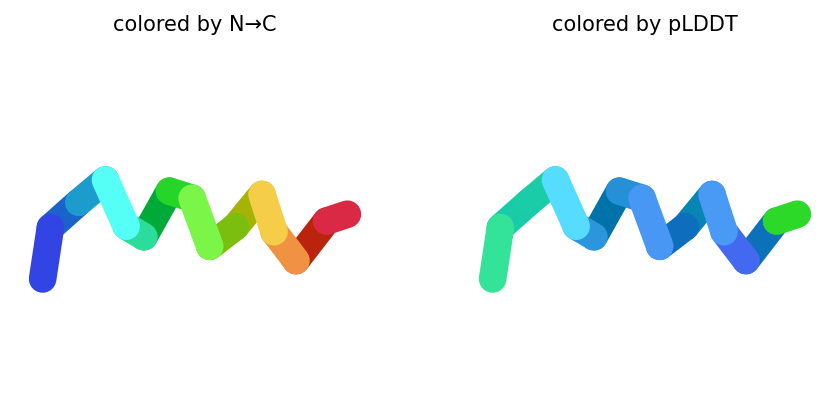

2025-11-17 09:00:02,129 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=89.7 pTM=0.0443
2025-11-17 09:00:04,721 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=90.4 pTM=0.0448 tol=0.0983
2025-11-17 09:00:07,312 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=90.7 pTM=0.0453 tol=0.0908
2025-11-17 09:00:09,904 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=91.6 pTM=0.046 tol=0.0759
2025-11-17 09:00:09,905 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


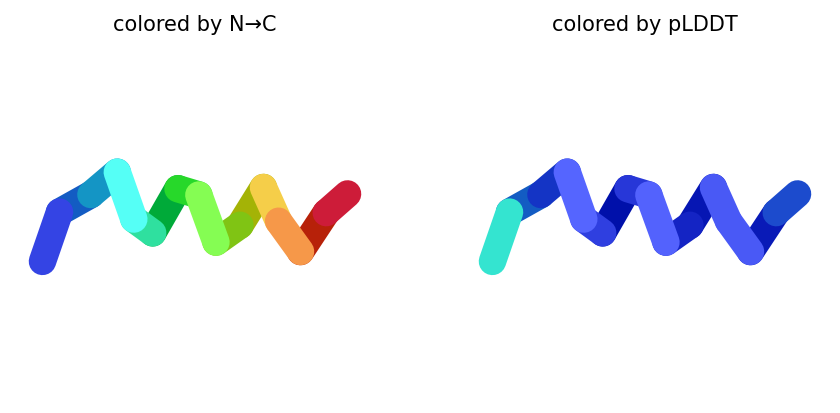

2025-11-17 09:00:09,955 reranking models by 'plddt' metric
2025-11-17 09:00:09,955 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=91.6 pTM=0.046
2025-11-17 09:00:09,956 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=85.6 pTM=0.043
2025-11-17 09:00:09,956 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=83.8 pTM=0.0378
2025-11-17 09:00:09,956 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=81.8 pTM=0.0382
2025-11-17 09:00:09,956 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=68.4 pTM=0.0328
2025-11-17 09:00:11,111 Query 97/146: peptide_207_IC50_438.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:00:11,746 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


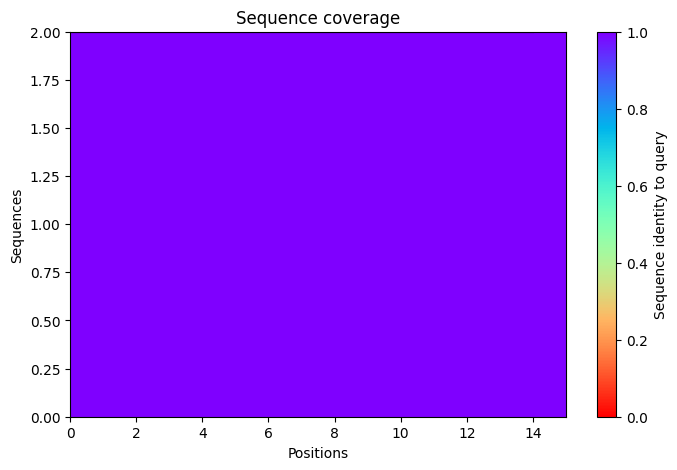

2025-11-17 09:00:25,990 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76.4 pTM=0.028
2025-11-17 09:00:28,572 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.5 pTM=0.0281 tol=0.374
2025-11-17 09:00:31,150 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.1 pTM=0.0283 tol=0.0726
2025-11-17 09:00:33,731 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=77.1 pTM=0.0283 tol=0.0687
2025-11-17 09:00:33,732 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


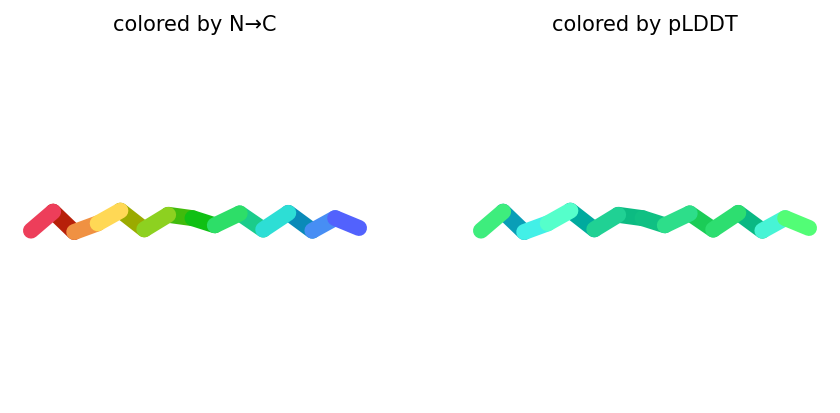

2025-11-17 09:00:36,365 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.7 pTM=0.0276
2025-11-17 09:00:38,949 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=75.2 pTM=0.028 tol=0.166
2025-11-17 09:00:41,535 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.6 pTM=0.0281 tol=0.345
2025-11-17 09:00:44,126 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=75.4 pTM=0.0283 tol=0.25
2025-11-17 09:00:44,127 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


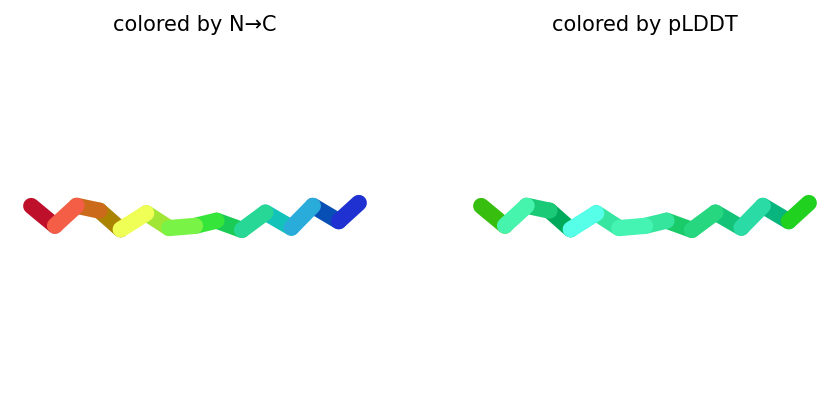

2025-11-17 09:00:46,769 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.1 pTM=0.0266
2025-11-17 09:00:49,363 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.4 pTM=0.0264 tol=0.443
2025-11-17 09:00:51,960 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.3 pTM=0.0267 tol=0.275
2025-11-17 09:00:54,558 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.8 pTM=0.0267 tol=0.218
2025-11-17 09:00:54,558 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


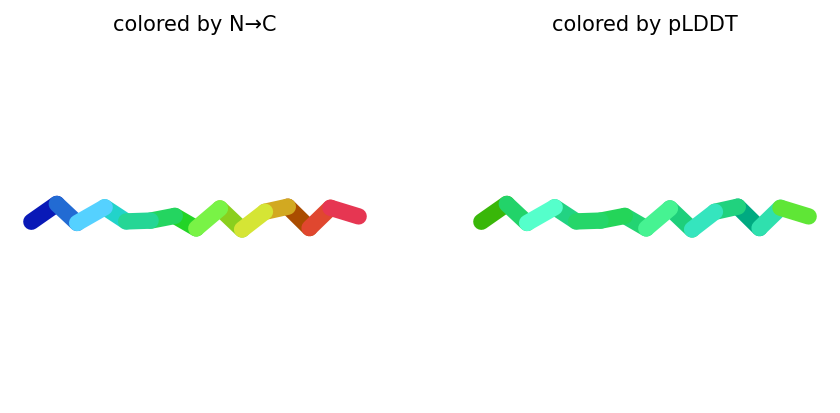

2025-11-17 09:00:57,231 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=77 pTM=0.0279
2025-11-17 09:00:59,822 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.1 pTM=0.028 tol=0.155
2025-11-17 09:01:02,414 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.1 pTM=0.0282 tol=0.0373
2025-11-17 09:01:05,004 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.4 pTM=0.0282 tol=0.0845
2025-11-17 09:01:05,005 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


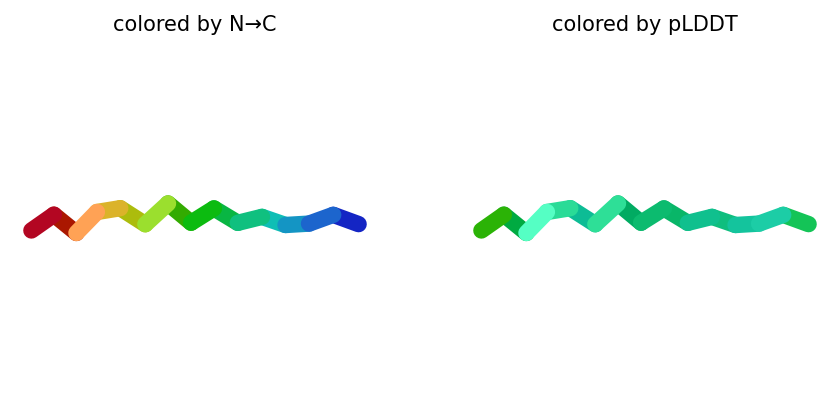

2025-11-17 09:01:07,644 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=71.7 pTM=0.0272
2025-11-17 09:01:10,236 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=74.8 pTM=0.0274 tol=0.427
2025-11-17 09:01:12,819 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.6 pTM=0.0274 tol=0.0754
2025-11-17 09:01:15,407 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.1 pTM=0.0273 tol=0.167
2025-11-17 09:01:15,407 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


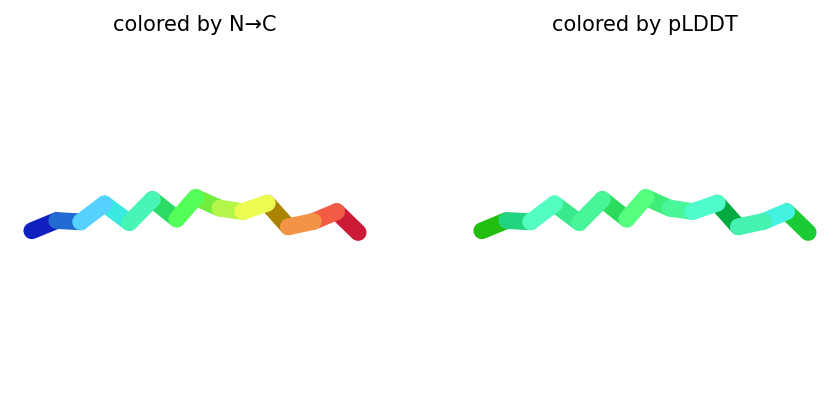

2025-11-17 09:01:15,459 reranking models by 'plddt' metric
2025-11-17 09:01:15,460 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=77.1 pTM=0.0283
2025-11-17 09:01:15,460 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=76.4 pTM=0.0282
2025-11-17 09:01:15,460 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=75.4 pTM=0.0283
2025-11-17 09:01:15,461 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=75.1 pTM=0.0273
2025-11-17 09:01:15,461 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=74.8 pTM=0.0267
2025-11-17 09:01:16,964 Query 98/146: peptide_208_IC50_444.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:01:17,237 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


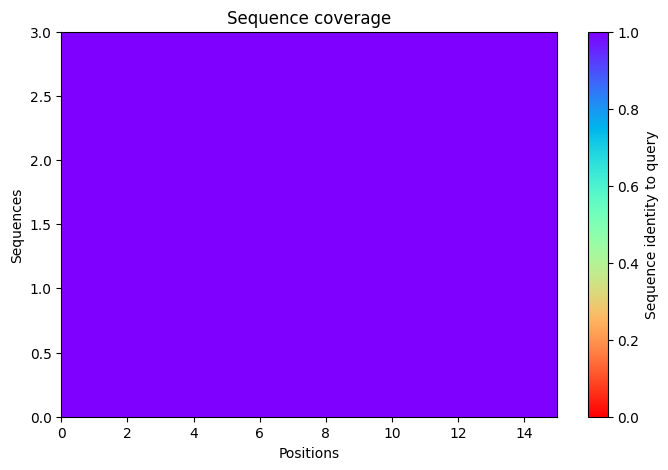

2025-11-17 09:01:30,858 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=71.1 pTM=0.029
2025-11-17 09:01:33,434 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72.6 pTM=0.0294 tol=0.568
2025-11-17 09:01:36,009 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=71.1 pTM=0.0291 tol=0.437
2025-11-17 09:01:38,587 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.4 pTM=0.0293 tol=0.755
2025-11-17 09:01:38,588 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


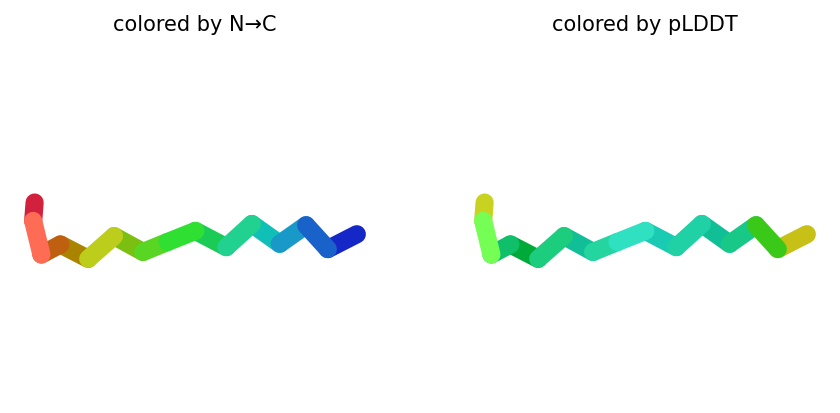

2025-11-17 09:01:41,215 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=72.7 pTM=0.0283
2025-11-17 09:01:43,800 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.4 pTM=0.0282 tol=0.646
2025-11-17 09:01:46,384 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.6 pTM=0.0281 tol=0.258
2025-11-17 09:01:48,970 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.5 pTM=0.0284 tol=0.432
2025-11-17 09:01:48,970 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


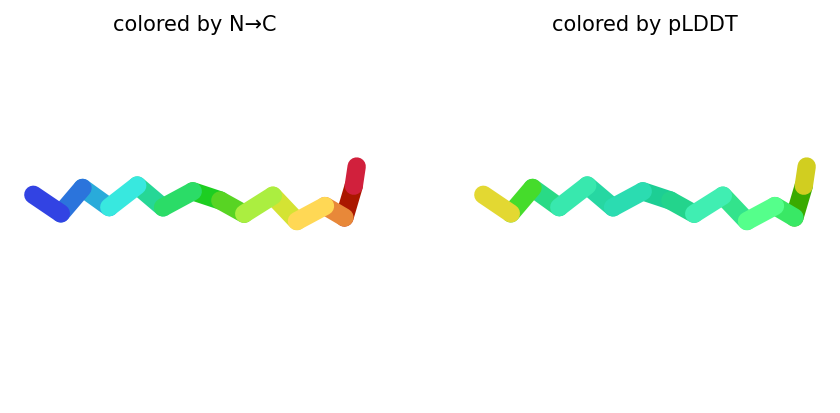

2025-11-17 09:01:51,610 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.2 pTM=0.0282
2025-11-17 09:01:54,199 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=81.8 pTM=0.0286 tol=0.334
2025-11-17 09:01:56,795 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=80.1 pTM=0.0283 tol=0.249
2025-11-17 09:01:59,392 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.3 pTM=0.0286 tol=0.171
2025-11-17 09:01:59,393 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


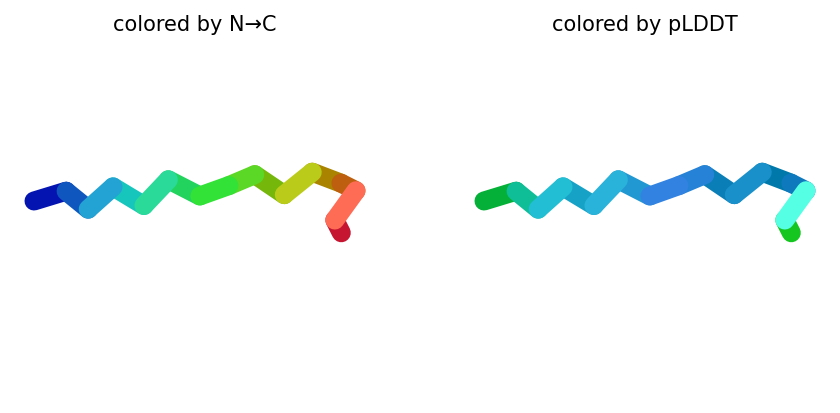

2025-11-17 09:02:02,043 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=72.5 pTM=0.0287
2025-11-17 09:02:04,641 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.6 pTM=0.0282 tol=0.287
2025-11-17 09:02:07,238 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.8 pTM=0.0281 tol=0.151
2025-11-17 09:02:09,837 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.9 pTM=0.0282 tol=0.112
2025-11-17 09:02:09,838 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


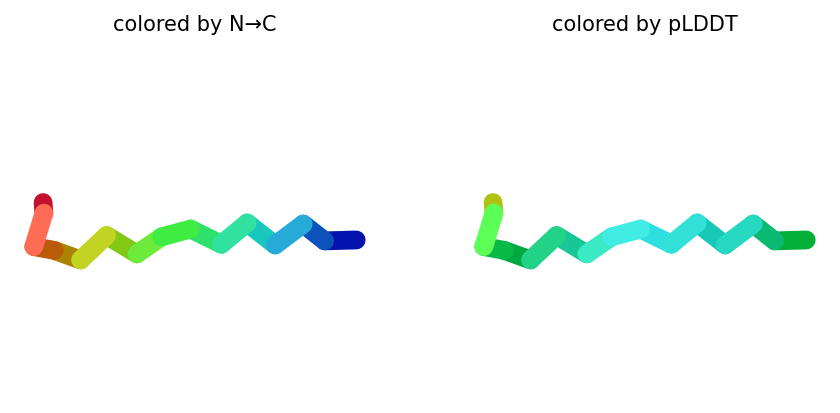

2025-11-17 09:02:12,500 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=72.7 pTM=0.0281
2025-11-17 09:02:15,095 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=73.4 pTM=0.0274 tol=0.215
2025-11-17 09:02:17,684 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=72.5 pTM=0.0274 tol=0.166
2025-11-17 09:02:20,271 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75 pTM=0.0281 tol=0.225
2025-11-17 09:02:20,272 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


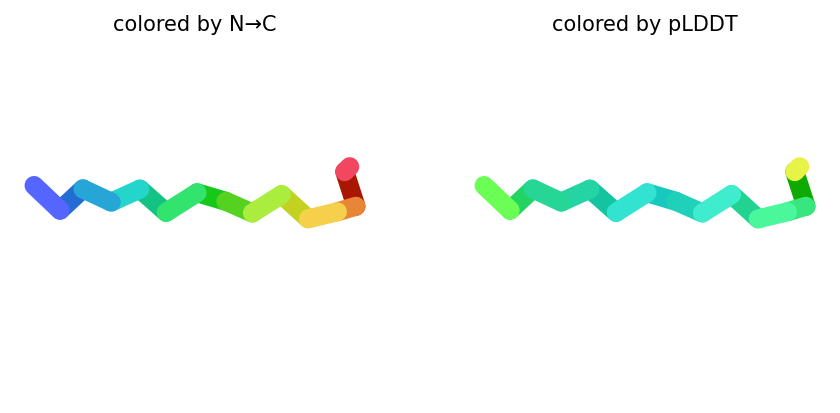

2025-11-17 09:02:20,343 reranking models by 'plddt' metric
2025-11-17 09:02:20,344 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=81.3 pTM=0.0286
2025-11-17 09:02:20,344 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=75.9 pTM=0.0282
2025-11-17 09:02:20,345 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=75 pTM=0.0281
2025-11-17 09:02:20,345 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73.4 pTM=0.0293
2025-11-17 09:02:20,346 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.5 pTM=0.0284
2025-11-17 09:02:21,800 Query 99/146: peptide_209_IC50_443.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:02:22,081 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


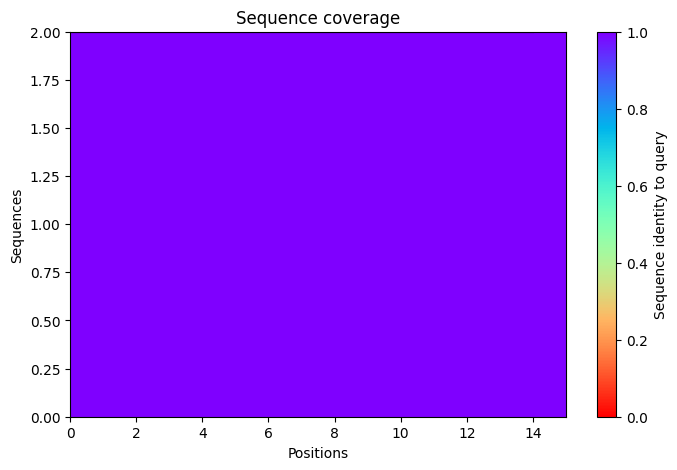

2025-11-17 09:02:36,962 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=73.2 pTM=0.0291
2025-11-17 09:02:39,541 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76 pTM=0.029 tol=0.641
2025-11-17 09:02:42,117 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=78.9 pTM=0.0294 tol=0.491
2025-11-17 09:02:44,699 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.6 pTM=0.0292 tol=0.529
2025-11-17 09:02:44,700 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


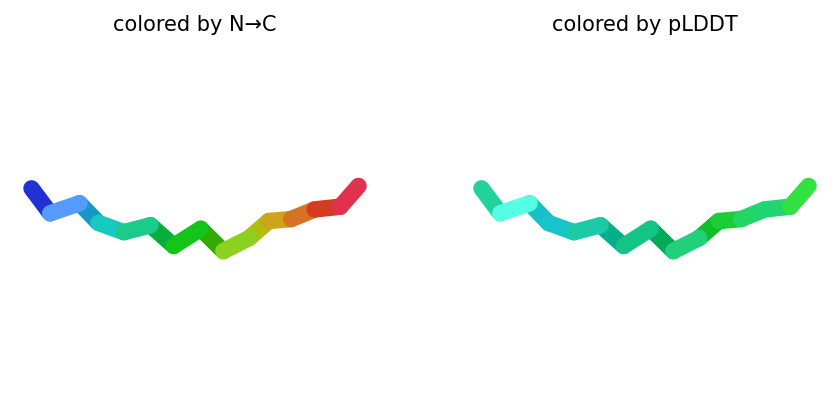

2025-11-17 09:02:47,366 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.2 pTM=0.0275
2025-11-17 09:02:49,950 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.2 pTM=0.0277 tol=1.3
2025-11-17 09:02:52,530 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69.3 pTM=0.0279 tol=1.99
2025-11-17 09:02:55,119 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=68.1 pTM=0.0273 tol=0.221
2025-11-17 09:02:55,120 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


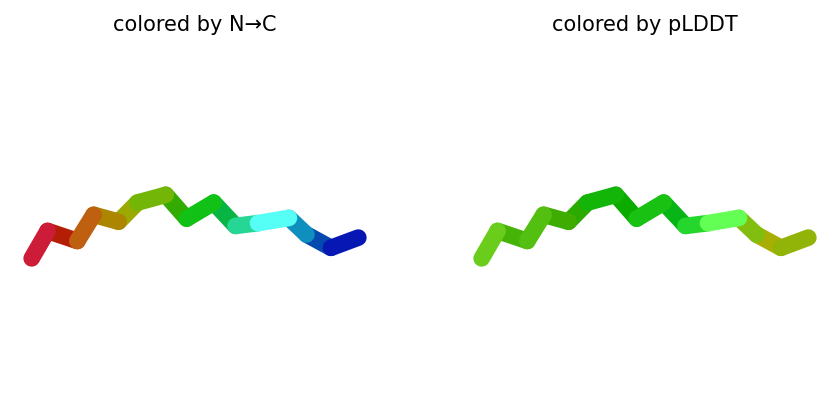

2025-11-17 09:02:57,763 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.1 pTM=0.0272
2025-11-17 09:03:00,359 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.2 pTM=0.0271 tol=0.259
2025-11-17 09:03:02,953 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.4 pTM=0.0272 tol=0.0652
2025-11-17 09:03:05,546 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.2 pTM=0.0272 tol=0.0737
2025-11-17 09:03:05,547 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


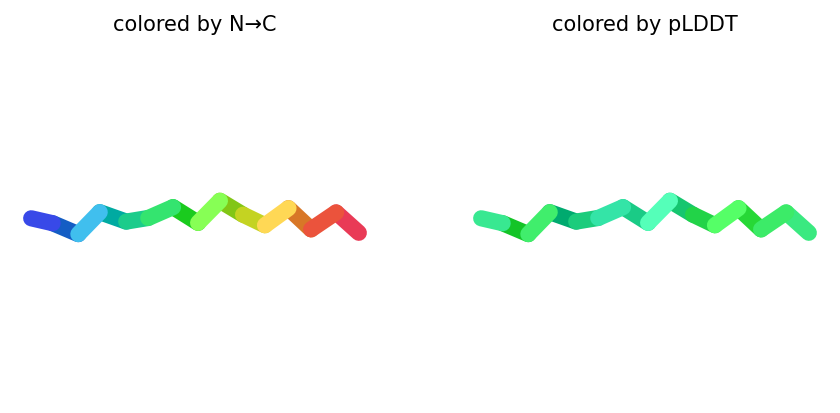

2025-11-17 09:03:08,195 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.6 pTM=0.0268
2025-11-17 09:03:10,793 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.2 pTM=0.0271 tol=0.354
2025-11-17 09:03:13,394 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.6 pTM=0.0275 tol=0.0944
2025-11-17 09:03:15,993 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.4 pTM=0.0273 tol=0.0618
2025-11-17 09:03:15,994 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


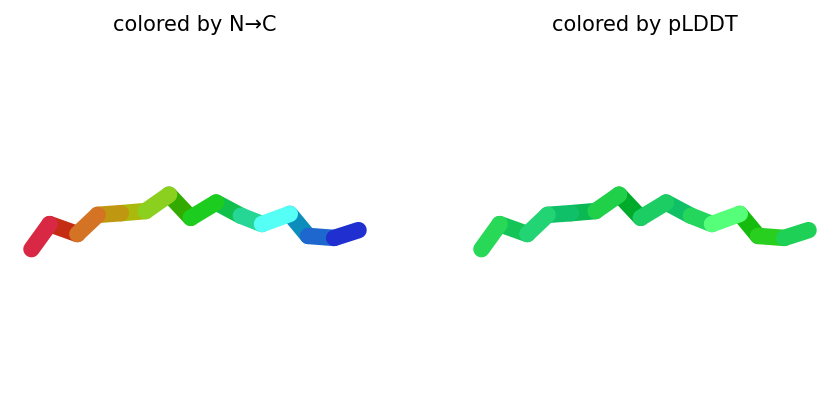

2025-11-17 09:03:18,642 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.1 pTM=0.0271
2025-11-17 09:03:21,235 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=69.4 pTM=0.0272 tol=0.795
2025-11-17 09:03:23,834 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.2 pTM=0.0275 tol=0.287
2025-11-17 09:03:26,428 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.8 pTM=0.0282 tol=0.265
2025-11-17 09:03:26,429 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


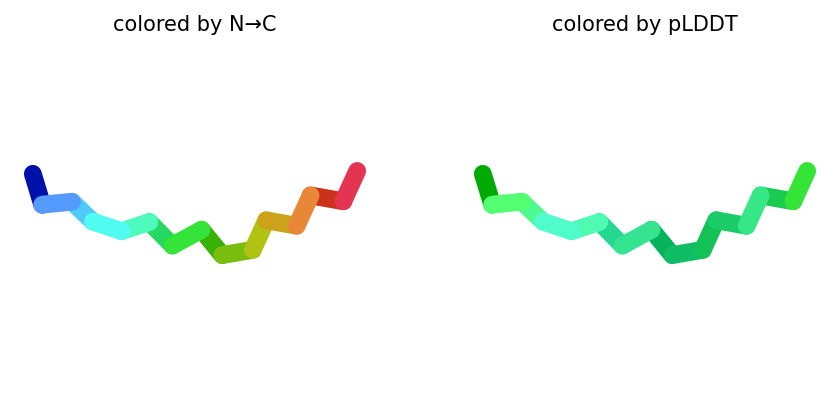

2025-11-17 09:03:26,478 reranking models by 'plddt' metric
2025-11-17 09:03:26,478 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=76.6 pTM=0.0292
2025-11-17 09:03:26,478 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=75.2 pTM=0.0272
2025-11-17 09:03:26,479 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=74.8 pTM=0.0282
2025-11-17 09:03:26,479 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=74.4 pTM=0.0273
2025-11-17 09:03:26,479 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=68.1 pTM=0.0273
2025-11-17 09:03:27,634 Query 100/146: peptide_211_IC50_445.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:03:27,916 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


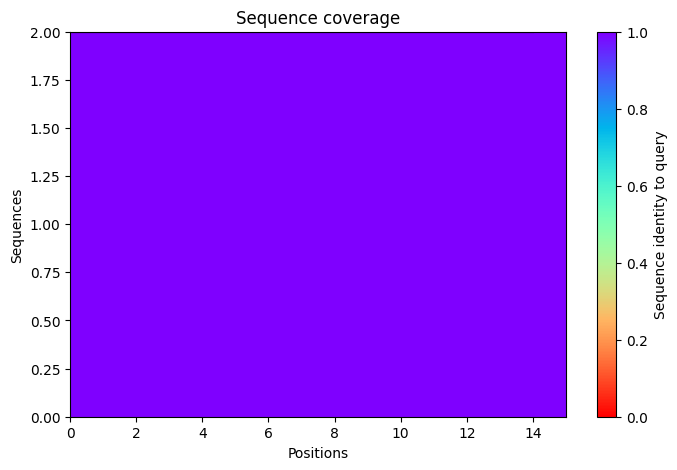

2025-11-17 09:03:40,133 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=73.4 pTM=0.0315
2025-11-17 09:03:42,709 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=73.3 pTM=0.0311 tol=0.436
2025-11-17 09:03:45,291 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.1 pTM=0.0312 tol=0.34
2025-11-17 09:03:47,865 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.2 pTM=0.0303 tol=0.728
2025-11-17 09:03:47,866 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


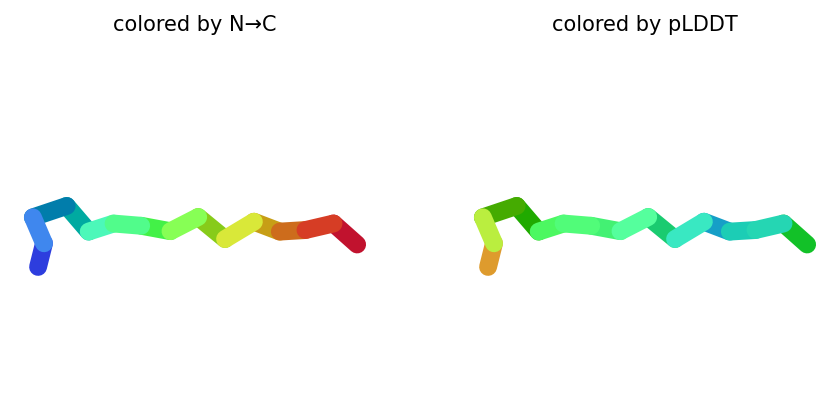

2025-11-17 09:03:50,518 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.6 pTM=0.0305
2025-11-17 09:03:53,095 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.6 pTM=0.0297 tol=0.433
2025-11-17 09:03:55,678 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=75.7 pTM=0.03 tol=0.21
2025-11-17 09:03:58,262 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=75.8 pTM=0.0298 tol=0.152
2025-11-17 09:03:58,263 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


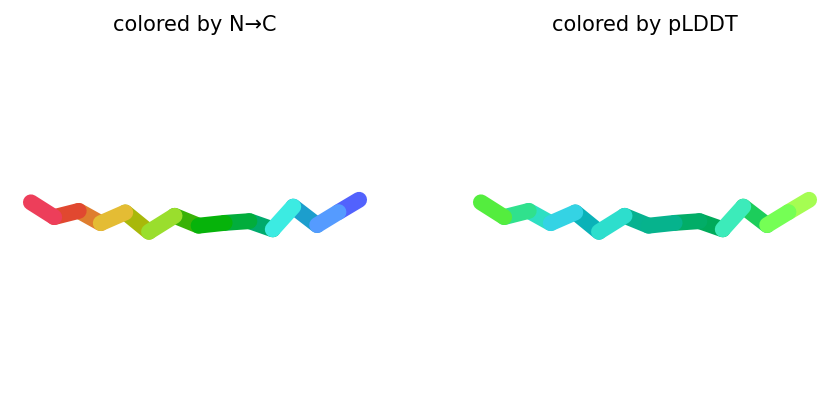

2025-11-17 09:04:00,901 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.2 pTM=0.0292
2025-11-17 09:04:03,493 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.6 pTM=0.0296 tol=1.95
2025-11-17 09:04:06,085 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.7 pTM=0.0302 tol=0.38
2025-11-17 09:04:08,678 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77.9 pTM=0.0299 tol=0.145
2025-11-17 09:04:08,678 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


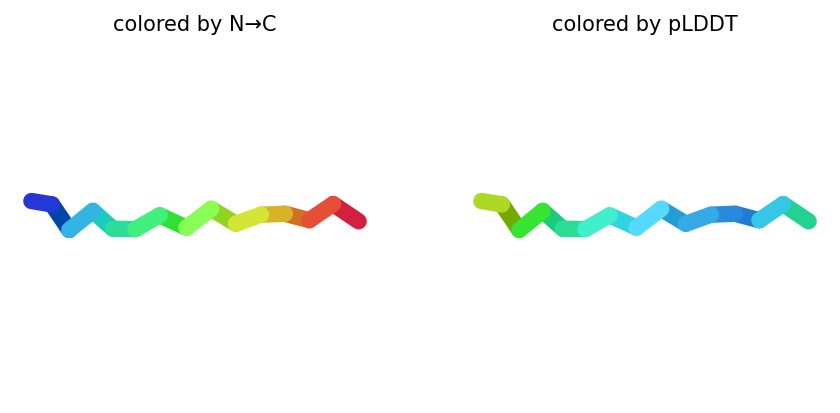

2025-11-17 09:04:11,324 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=74.9 pTM=0.0305
2025-11-17 09:04:13,918 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.5 pTM=0.0304 tol=0.306
2025-11-17 09:04:16,512 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78.6 pTM=0.0307 tol=0.164
2025-11-17 09:04:19,103 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.1 pTM=0.0304 tol=0.217
2025-11-17 09:04:19,103 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


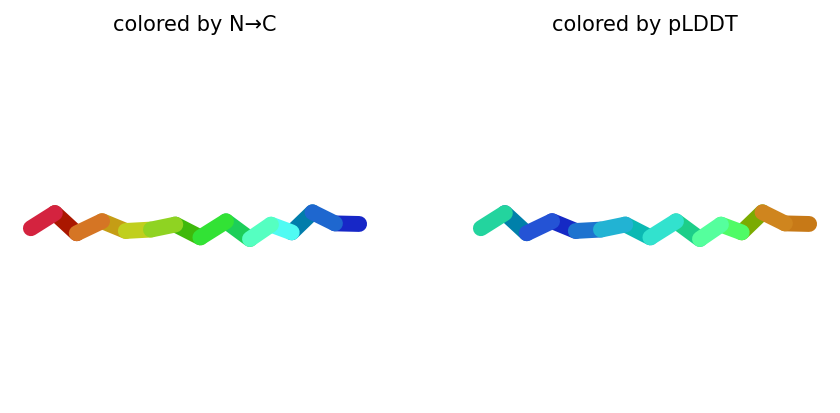

2025-11-17 09:04:21,742 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69 pTM=0.0298
2025-11-17 09:04:24,333 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.8 pTM=0.0298 tol=0.801
2025-11-17 09:04:26,927 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=71.9 pTM=0.0298 tol=2.14
2025-11-17 09:04:29,513 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=70.4 pTM=0.0292 tol=1.83
2025-11-17 09:04:29,514 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


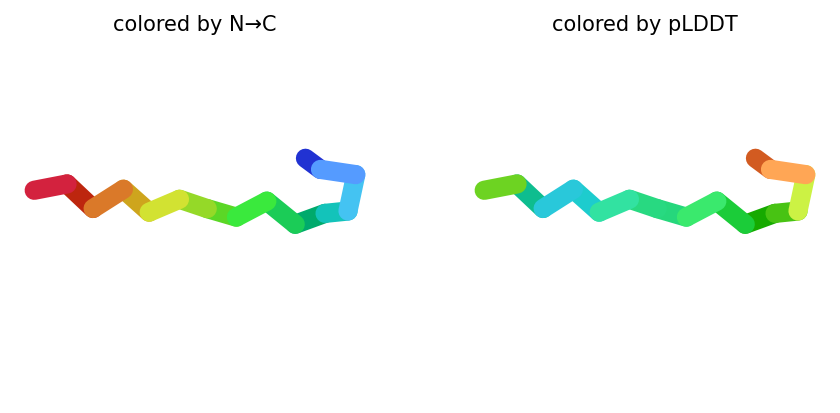

2025-11-17 09:04:29,568 reranking models by 'plddt' metric
2025-11-17 09:04:29,568 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=77.9 pTM=0.0299
2025-11-17 09:04:29,569 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=76.1 pTM=0.0304
2025-11-17 09:04:29,569 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=75.8 pTM=0.0298
2025-11-17 09:04:29,569 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=72.2 pTM=0.0303
2025-11-17 09:04:29,570 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=70.4 pTM=0.0292
2025-11-17 09:04:31,069 Query 101/146: peptide_212_IC50_446.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:04:31,360 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


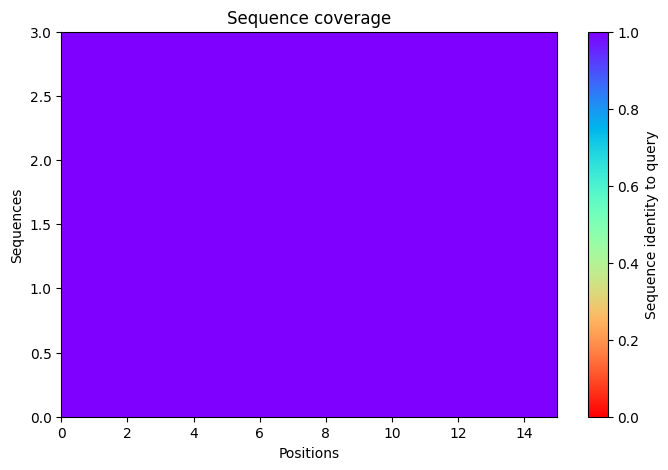

2025-11-17 09:04:45,598 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=63.9 pTM=0.0302
2025-11-17 09:04:48,175 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.3 pTM=0.03 tol=0.262
2025-11-17 09:04:50,752 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=66.6 pTM=0.0313 tol=0.415
2025-11-17 09:04:53,333 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=67.3 pTM=0.0315 tol=0.121
2025-11-17 09:04:53,333 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


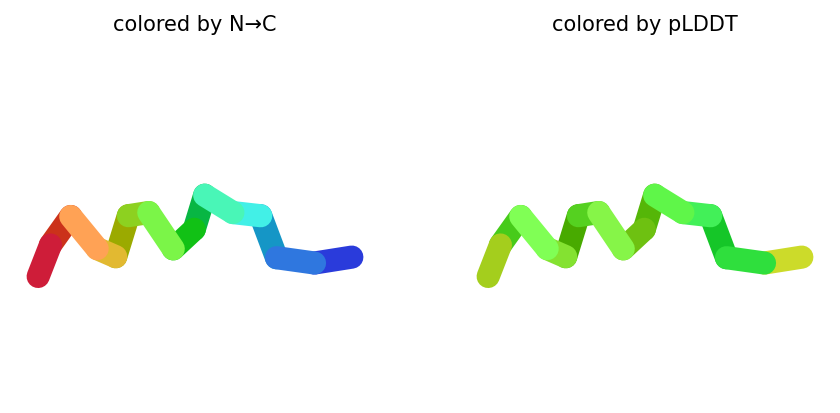

2025-11-17 09:04:55,971 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=62.2 pTM=0.0273
2025-11-17 09:04:58,551 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.9 pTM=0.0277 tol=0.494
2025-11-17 09:05:01,139 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=67.8 pTM=0.028 tol=0.155
2025-11-17 09:05:03,725 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.4 pTM=0.0277 tol=0.493
2025-11-17 09:05:03,725 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


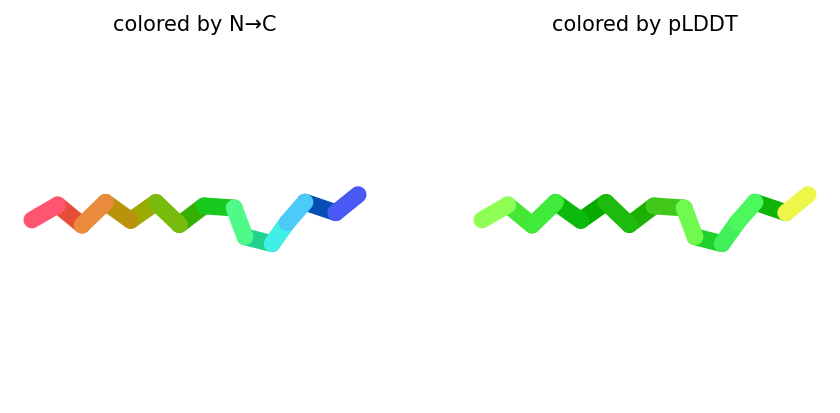

2025-11-17 09:05:06,372 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.6 pTM=0.0276
2025-11-17 09:05:08,964 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=71.1 pTM=0.0266 tol=0.221
2025-11-17 09:05:11,561 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=71.2 pTM=0.027 tol=0.376
2025-11-17 09:05:14,160 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=73.7 pTM=0.0276 tol=0.347
2025-11-17 09:05:14,161 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


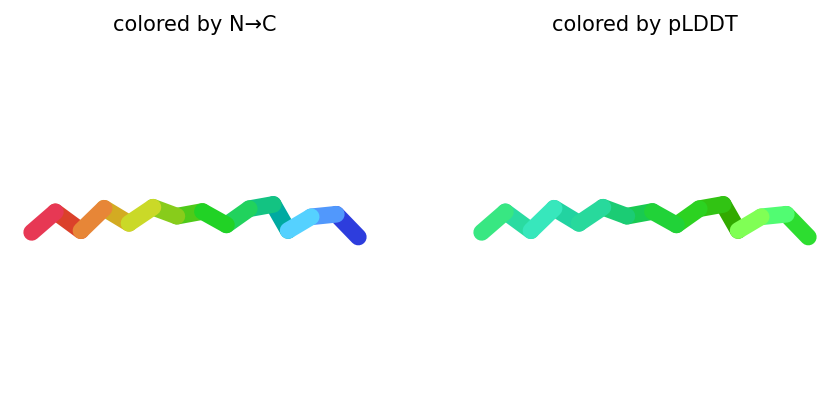

2025-11-17 09:05:16,831 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=63.3 pTM=0.0274
2025-11-17 09:05:19,435 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.1 pTM=0.0273 tol=0.818
2025-11-17 09:05:22,037 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.8 pTM=0.0275 tol=0.576
2025-11-17 09:05:24,633 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.9 pTM=0.0278 tol=0.185
2025-11-17 09:05:24,634 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


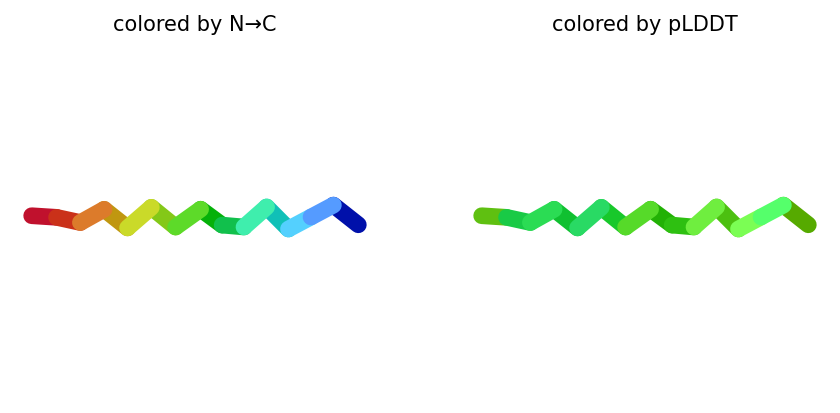

2025-11-17 09:05:27,280 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=67.2 pTM=0.0299
2025-11-17 09:05:29,875 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=65.1 pTM=0.0273 tol=1.96
2025-11-17 09:05:32,464 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.4 pTM=0.0275 tol=0.316
2025-11-17 09:05:35,054 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=65.2 pTM=0.0275 tol=0.17
2025-11-17 09:05:35,055 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


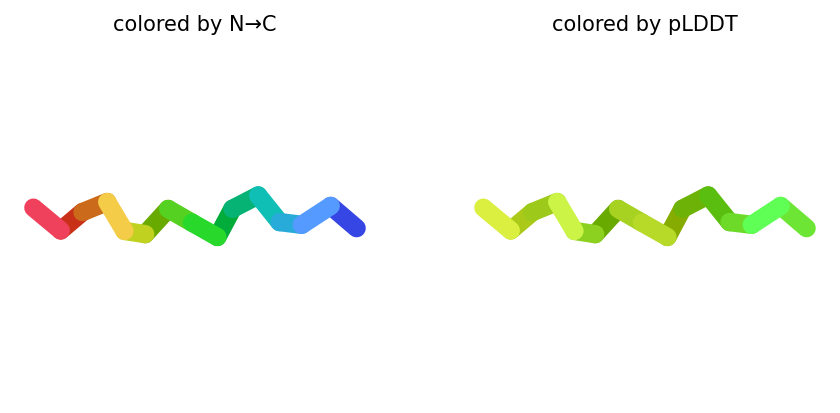

2025-11-17 09:05:35,103 reranking models by 'plddt' metric
2025-11-17 09:05:35,103 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=73.7 pTM=0.0276
2025-11-17 09:05:35,104 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=69.9 pTM=0.0278
2025-11-17 09:05:35,104 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=69.4 pTM=0.0277
2025-11-17 09:05:35,104 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=67.3 pTM=0.0315
2025-11-17 09:05:35,104 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=65.2 pTM=0.0275
2025-11-17 09:05:36,279 Query 102/146: peptide_213_IC50_452.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:05:36,568 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


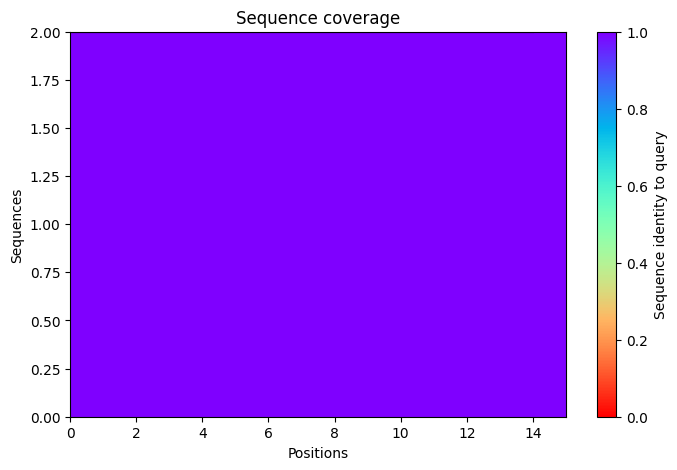

2025-11-17 09:05:50,852 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.3 pTM=0.0358
2025-11-17 09:05:53,430 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=71.7 pTM=0.0346 tol=0.133
2025-11-17 09:05:56,006 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=68.8 pTM=0.0332 tol=0.155
2025-11-17 09:05:58,582 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=69.7 pTM=0.0331 tol=0.0897
2025-11-17 09:05:58,583 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


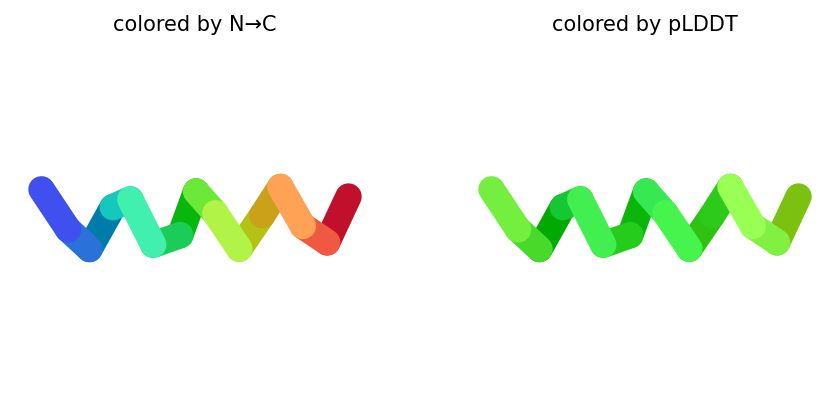

2025-11-17 09:06:01,210 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=74.8 pTM=0.0378
2025-11-17 09:06:03,793 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.2 pTM=0.0345 tol=0.468
2025-11-17 09:06:06,375 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=64.6 pTM=0.0325 tol=0.248
2025-11-17 09:06:08,960 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.1 pTM=0.0324 tol=0.125
2025-11-17 09:06:08,961 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


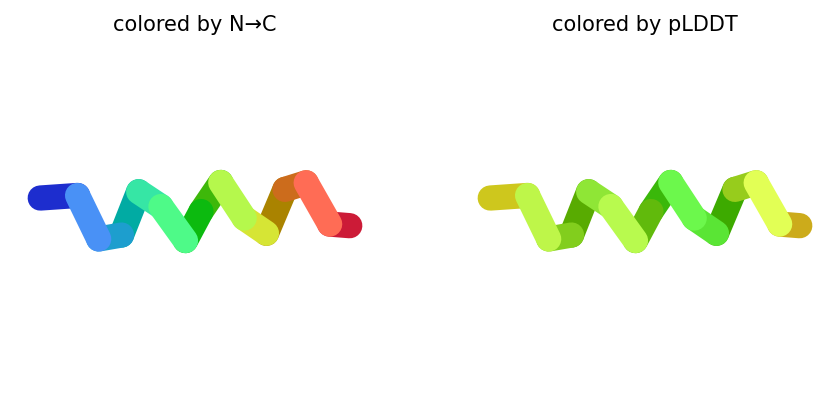

2025-11-17 09:06:11,603 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=64.2 pTM=0.0276
2025-11-17 09:06:14,190 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=65 pTM=0.0264 tol=3.95
2025-11-17 09:06:16,782 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=67.6 pTM=0.0265 tol=0.825
2025-11-17 09:06:19,374 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=69.1 pTM=0.0266 tol=0.423
2025-11-17 09:06:19,375 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


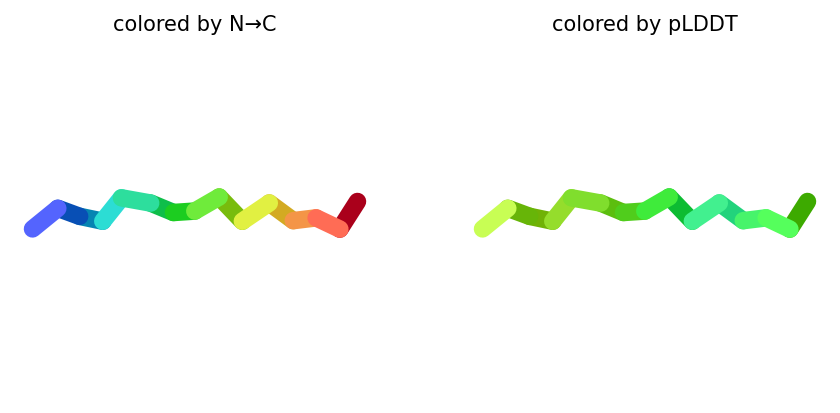

2025-11-17 09:06:22,022 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=63.2 pTM=0.0286
2025-11-17 09:06:24,622 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=65.2 pTM=0.0272 tol=3.51
2025-11-17 09:06:27,224 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.9 pTM=0.0273 tol=0.594
2025-11-17 09:06:29,820 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.2 pTM=0.0275 tol=0.268
2025-11-17 09:06:29,820 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


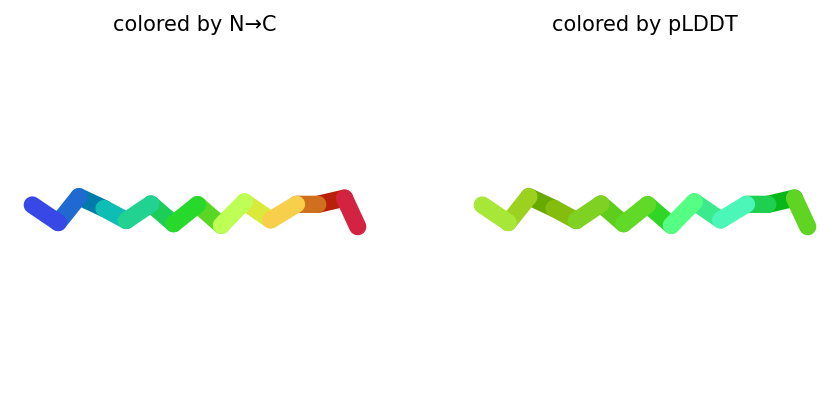

2025-11-17 09:06:32,466 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=65.6 pTM=0.031
2025-11-17 09:06:35,059 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.7 pTM=0.0277 tol=2.99
2025-11-17 09:06:37,650 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=64.3 pTM=0.0271 tol=2.12
2025-11-17 09:06:40,241 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63.3 pTM=0.0271 tol=1.18
2025-11-17 09:06:40,242 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


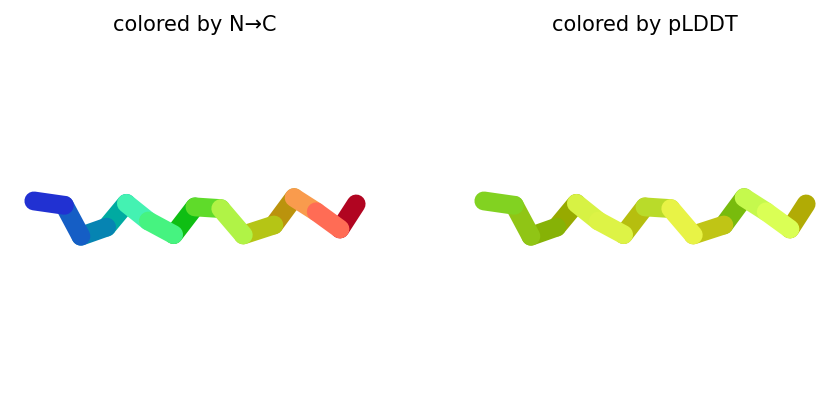

2025-11-17 09:06:40,308 reranking models by 'plddt' metric
2025-11-17 09:06:40,309 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=69.7 pTM=0.0331
2025-11-17 09:06:40,309 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=69.2 pTM=0.0275
2025-11-17 09:06:40,309 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=69.1 pTM=0.0266
2025-11-17 09:06:40,310 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=65.1 pTM=0.0324
2025-11-17 09:06:40,310 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=63.3 pTM=0.0271
2025-11-17 09:06:41,776 Query 103/146: peptide_215_IC50_447.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:06:42,055 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


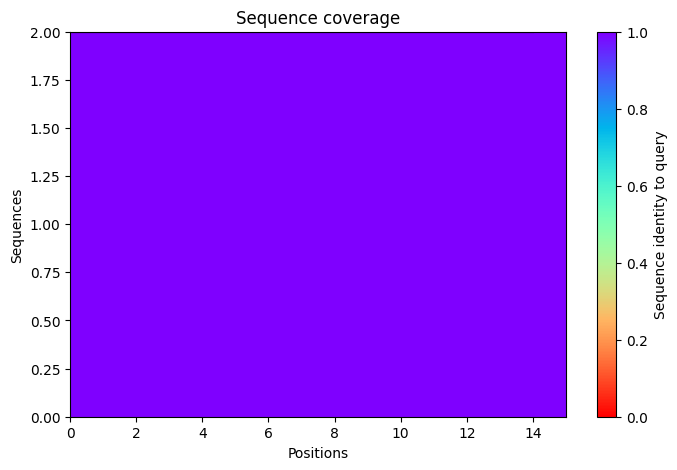

2025-11-17 09:06:56,887 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.9 pTM=0.0328
2025-11-17 09:06:59,466 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.2 pTM=0.0322 tol=0.951
2025-11-17 09:07:02,044 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.3 pTM=0.0325 tol=0.207
2025-11-17 09:07:04,620 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.6 pTM=0.0319 tol=0.159
2025-11-17 09:07:04,621 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


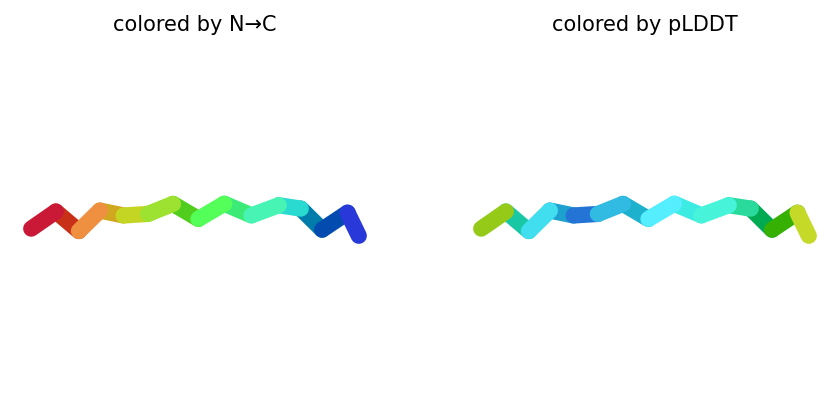

2025-11-17 09:07:07,272 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.5 pTM=0.0313
2025-11-17 09:07:09,854 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74.8 pTM=0.0303 tol=0.614
2025-11-17 09:07:12,439 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=75.4 pTM=0.0304 tol=0.213
2025-11-17 09:07:15,022 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=75.9 pTM=0.0302 tol=0.257
2025-11-17 09:07:15,023 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


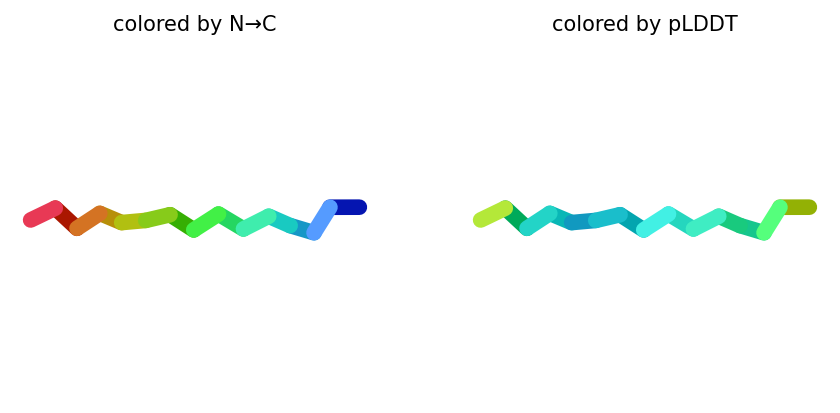

2025-11-17 09:07:17,657 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.2 pTM=0.0299
2025-11-17 09:07:20,250 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=76.2 pTM=0.0304 tol=0.819
2025-11-17 09:07:22,844 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.9 pTM=0.0306 tol=0.707
2025-11-17 09:07:25,439 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=78.6 pTM=0.0303 tol=0.384
2025-11-17 09:07:25,439 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


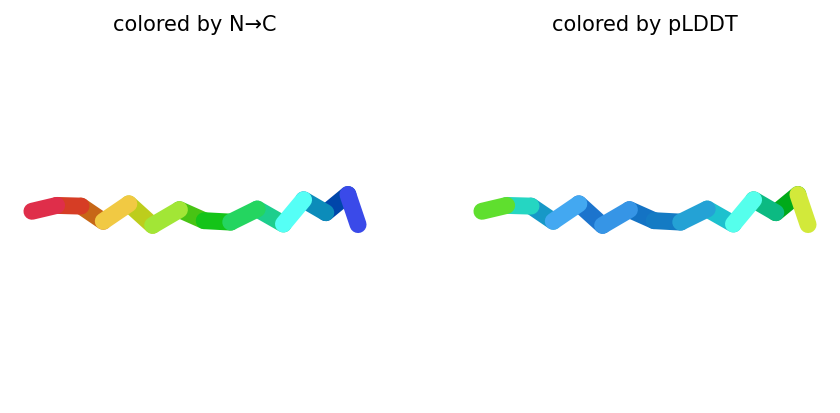

2025-11-17 09:07:28,091 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.7 pTM=0.031
2025-11-17 09:07:30,689 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.6 pTM=0.0308 tol=0.343
2025-11-17 09:07:33,288 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.8 pTM=0.0306 tol=0.47
2025-11-17 09:07:35,882 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=77.1 pTM=0.0307 tol=0.376
2025-11-17 09:07:35,883 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


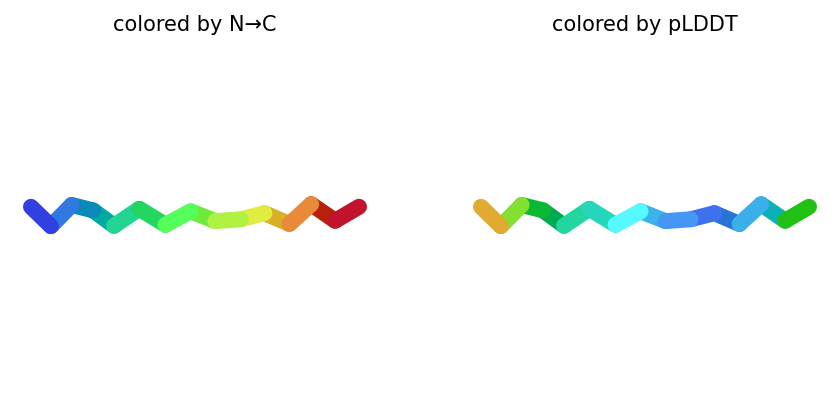

2025-11-17 09:07:38,526 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=72.1 pTM=0.0307
2025-11-17 09:07:41,119 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=71.8 pTM=0.0307 tol=0.632
2025-11-17 09:07:43,709 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.7 pTM=0.0306 tol=0.376
2025-11-17 09:07:46,302 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=71.1 pTM=0.0301 tol=1.33
2025-11-17 09:07:46,302 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


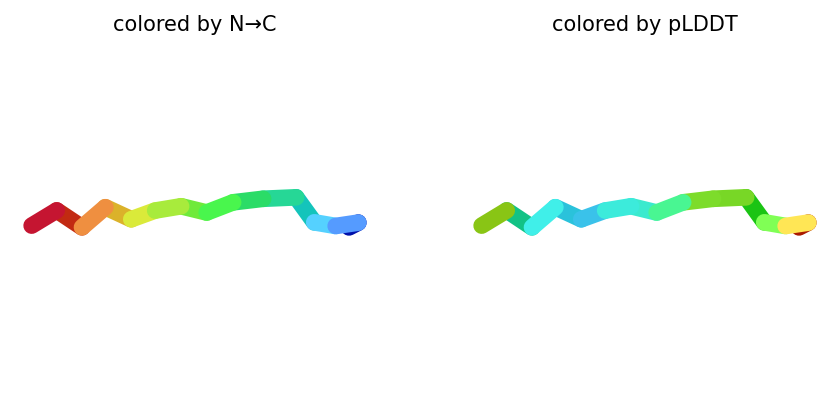

2025-11-17 09:07:46,362 reranking models by 'plddt' metric
2025-11-17 09:07:46,363 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=78.6 pTM=0.0303
2025-11-17 09:07:46,363 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=77.1 pTM=0.0307
2025-11-17 09:07:46,363 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=76.6 pTM=0.0319
2025-11-17 09:07:46,363 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=75.9 pTM=0.0302
2025-11-17 09:07:46,364 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=71.1 pTM=0.0301
2025-11-17 09:07:47,940 Query 104/146: peptide_216_IC50_453.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:07:48,221 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


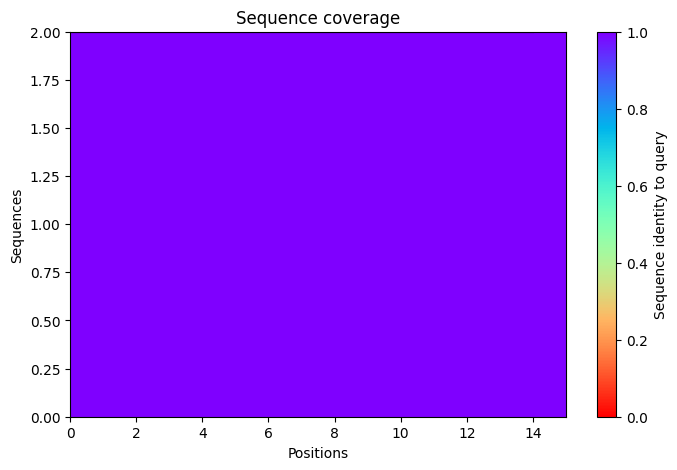

2025-11-17 09:08:00,103 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=80.6 pTM=0.0334
2025-11-17 09:08:02,681 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=79.8 pTM=0.0331 tol=0.525
2025-11-17 09:08:05,255 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79.8 pTM=0.0332 tol=0.256
2025-11-17 09:08:07,835 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=79.9 pTM=0.0331 tol=0.0367
2025-11-17 09:08:07,835 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


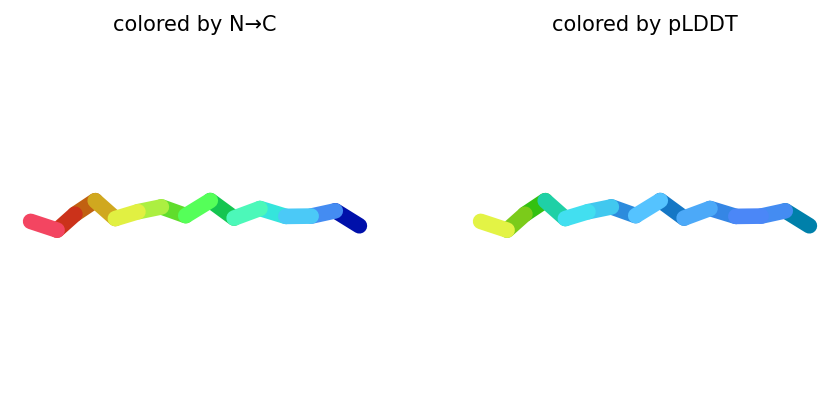

2025-11-17 09:08:10,488 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=74.7 pTM=0.0315
2025-11-17 09:08:13,071 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=76.2 pTM=0.0306 tol=0.256
2025-11-17 09:08:15,651 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=76.1 pTM=0.0304 tol=0.209
2025-11-17 09:08:18,233 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76.9 pTM=0.0302 tol=0.196
2025-11-17 09:08:18,234 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


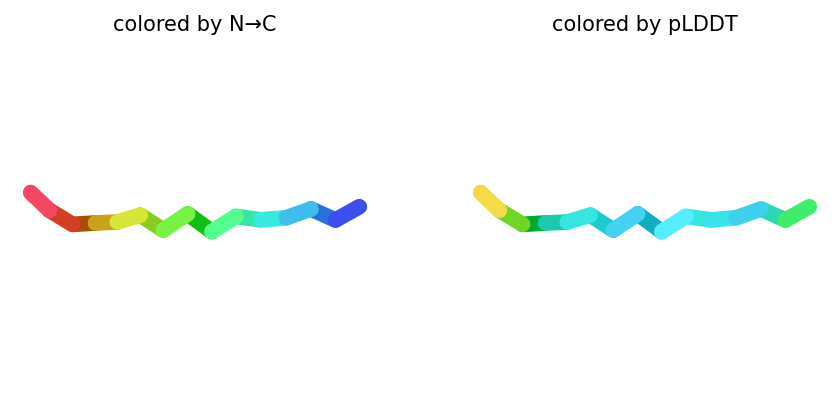

2025-11-17 09:08:20,878 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=77.1 pTM=0.031
2025-11-17 09:08:23,468 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=78.6 pTM=0.0312 tol=0.496
2025-11-17 09:08:26,062 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=79.1 pTM=0.0312 tol=0.47
2025-11-17 09:08:28,656 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=78.7 pTM=0.0313 tol=0.26
2025-11-17 09:08:28,657 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


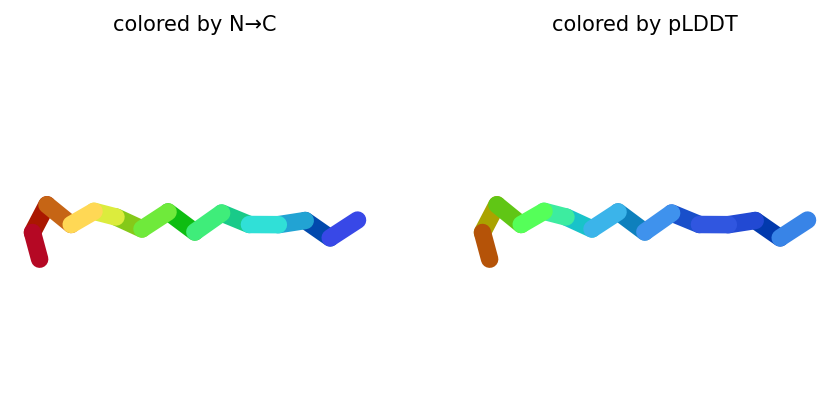

2025-11-17 09:08:31,305 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=79.8 pTM=0.0323
2025-11-17 09:08:33,903 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=79.9 pTM=0.0314 tol=0.193
2025-11-17 09:08:36,501 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=79.5 pTM=0.0314 tol=0.169
2025-11-17 09:08:39,092 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=80.6 pTM=0.0317 tol=0.197
2025-11-17 09:08:39,093 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


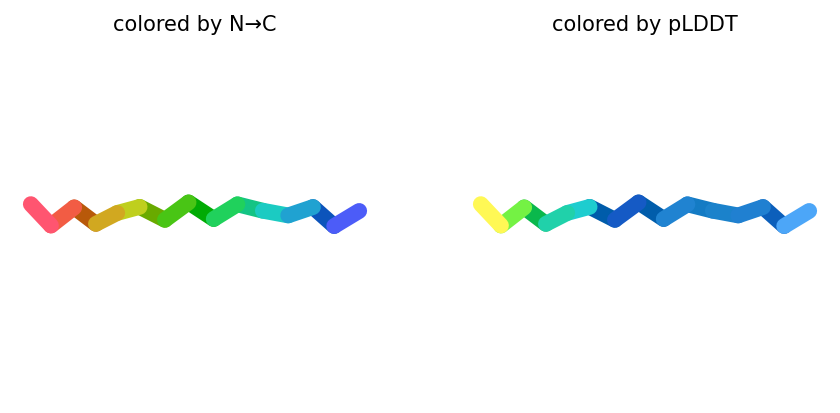

2025-11-17 09:08:41,736 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.6 pTM=0.0313
2025-11-17 09:08:44,328 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.4 pTM=0.0314 tol=0.389
2025-11-17 09:08:46,920 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76 pTM=0.0312 tol=0.261
2025-11-17 09:08:49,509 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=77.3 pTM=0.0312 tol=0.157
2025-11-17 09:08:49,510 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


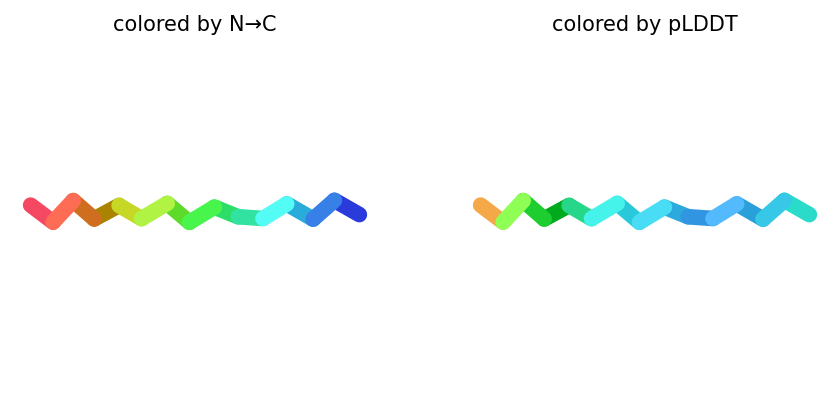

2025-11-17 09:08:49,557 reranking models by 'plddt' metric
2025-11-17 09:08:49,558 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=80.6 pTM=0.0317
2025-11-17 09:08:49,558 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=79.9 pTM=0.0331
2025-11-17 09:08:49,558 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=78.7 pTM=0.0313
2025-11-17 09:08:49,558 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=77.3 pTM=0.0312
2025-11-17 09:08:49,559 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=76.9 pTM=0.0302
2025-11-17 09:08:50,743 Query 105/146: peptide_217_IC50_453.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:08:51,028 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


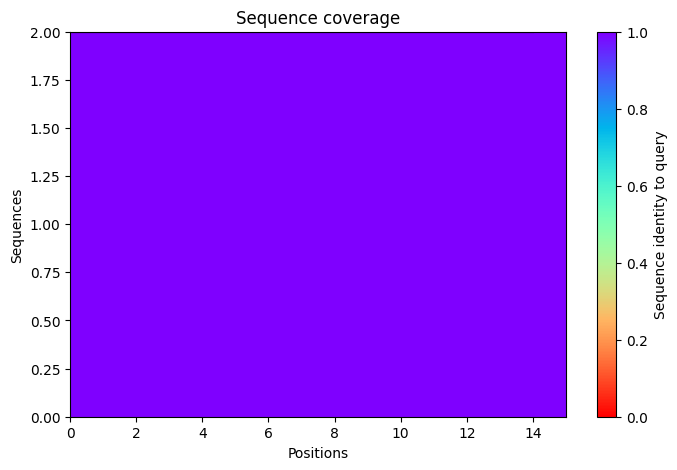

2025-11-17 09:09:04,294 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=62.4 pTM=0.0283
2025-11-17 09:09:06,874 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.8 pTM=0.0287 tol=0.959
2025-11-17 09:09:09,452 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=67.6 pTM=0.0291 tol=0.524
2025-11-17 09:09:12,031 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=67.2 pTM=0.0287 tol=0.409
2025-11-17 09:09:12,031 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


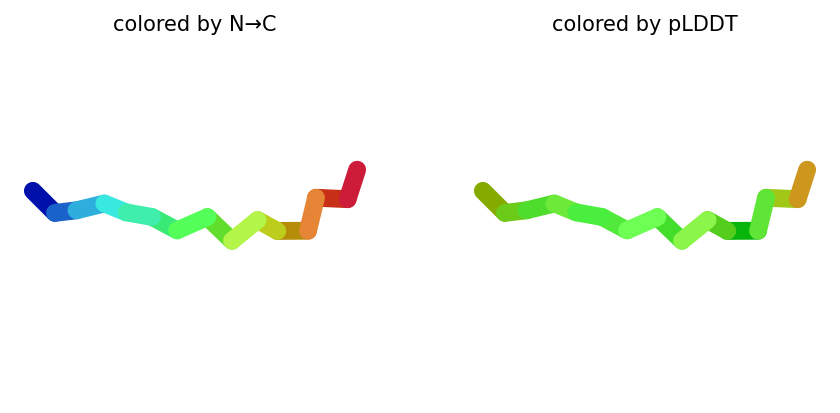

2025-11-17 09:09:14,660 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.3 pTM=0.0269
2025-11-17 09:09:17,238 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.3 pTM=0.0275 tol=0.483
2025-11-17 09:09:19,822 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.2 pTM=0.0276 tol=0.783
2025-11-17 09:09:22,416 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=66.6 pTM=0.0275 tol=0.461
2025-11-17 09:09:22,416 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


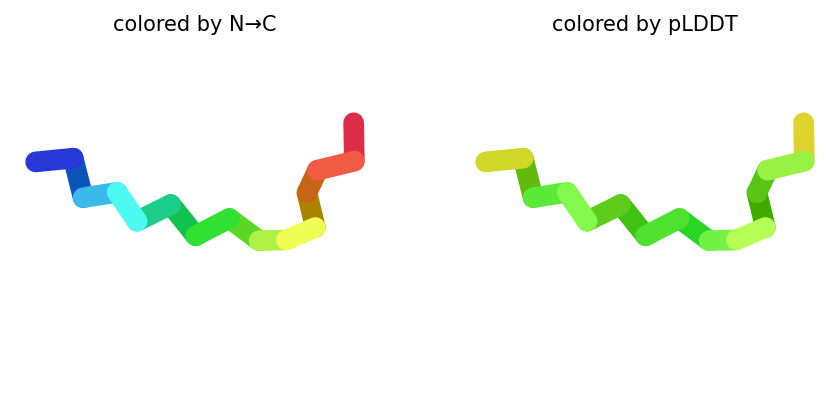

2025-11-17 09:09:25,082 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=63.5 pTM=0.0272
2025-11-17 09:09:27,675 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.9 pTM=0.0274 tol=0.805
2025-11-17 09:09:30,268 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.9 pTM=0.0282 tol=0.783
2025-11-17 09:09:32,862 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.6 pTM=0.0281 tol=0.189
2025-11-17 09:09:32,862 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


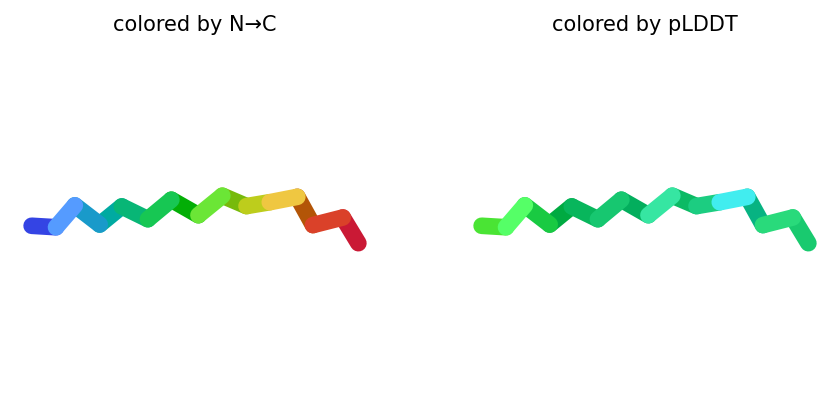

2025-11-17 09:09:35,509 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.4 pTM=0.0279
2025-11-17 09:09:38,108 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=69.2 pTM=0.0284 tol=0.361
2025-11-17 09:09:40,706 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72.6 pTM=0.0286 tol=0.366
2025-11-17 09:09:43,302 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.4 pTM=0.0285 tol=0.359
2025-11-17 09:09:43,302 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


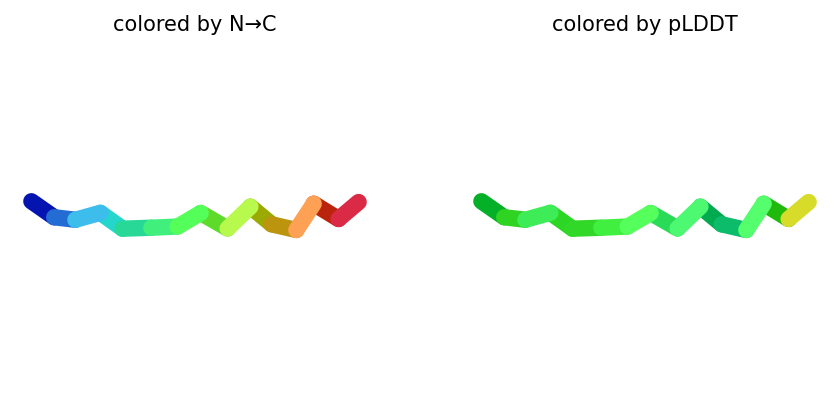

2025-11-17 09:09:45,948 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=64.7 pTM=0.0275
2025-11-17 09:09:48,537 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=68.1 pTM=0.0279 tol=1.19
2025-11-17 09:09:51,130 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.3 pTM=0.0286 tol=1.12
2025-11-17 09:09:53,718 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.7 pTM=0.0287 tol=0.332
2025-11-17 09:09:53,718 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


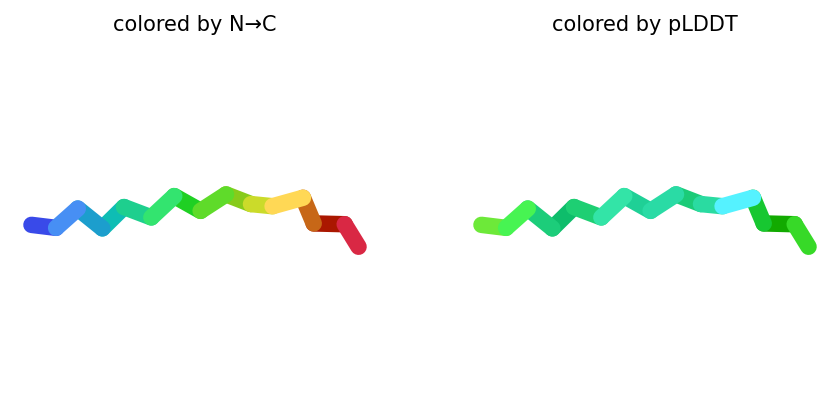

2025-11-17 09:09:53,766 reranking models by 'plddt' metric
2025-11-17 09:09:53,766 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=75.6 pTM=0.0281
2025-11-17 09:09:53,767 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=74.7 pTM=0.0287
2025-11-17 09:09:53,767 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=71.4 pTM=0.0285
2025-11-17 09:09:53,767 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=67.2 pTM=0.0287
2025-11-17 09:09:53,767 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=66.6 pTM=0.0275
2025-11-17 09:09:54,932 Query 106/146: peptide_218_IC50_451.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:09:55,213 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


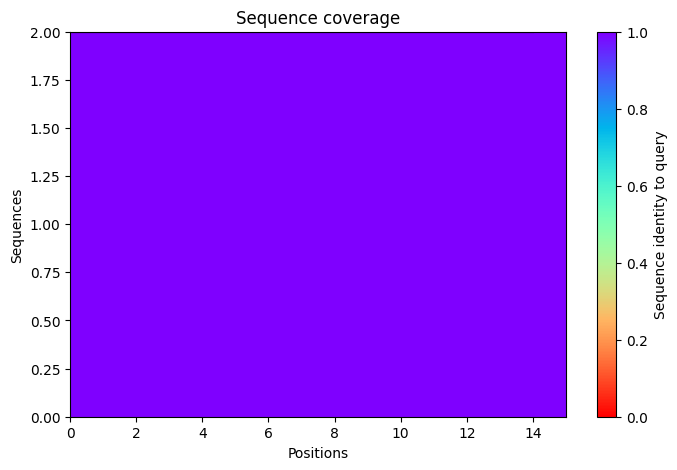

2025-11-17 09:10:06,491 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=75.1 pTM=0.0398
2025-11-17 09:10:09,066 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.3 pTM=0.0412 tol=0.115
2025-11-17 09:10:11,641 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=77.9 pTM=0.0416 tol=0.0935
2025-11-17 09:10:14,220 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=79.2 pTM=0.0419 tol=0.0955
2025-11-17 09:10:14,221 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


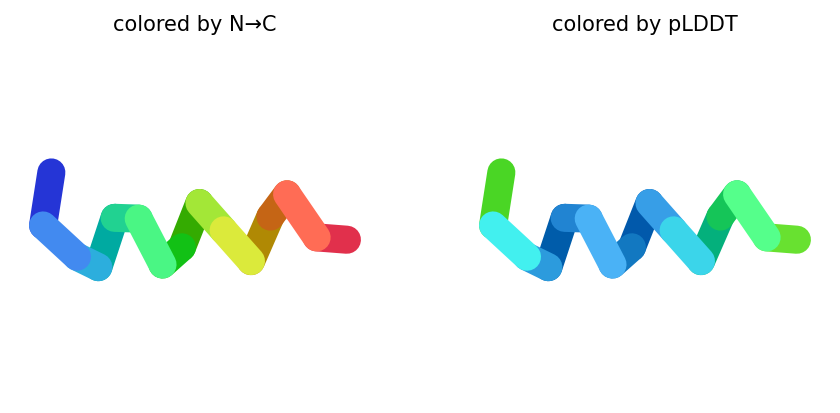

2025-11-17 09:10:16,854 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.1 pTM=0.0398
2025-11-17 09:10:19,434 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.6 pTM=0.04 tol=0.196
2025-11-17 09:10:22,013 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69.8 pTM=0.0386 tol=0.145
2025-11-17 09:10:24,599 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.1 pTM=0.0388 tol=0.0949
2025-11-17 09:10:24,600 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


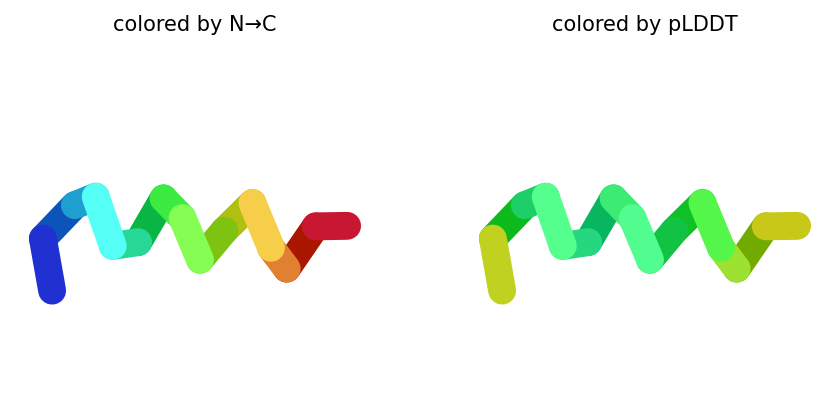

2025-11-17 09:10:27,241 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=67.4 pTM=0.0281
2025-11-17 09:10:29,831 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72 pTM=0.0284 tol=0.689
2025-11-17 09:10:32,422 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.1 pTM=0.0288 tol=0.34
2025-11-17 09:10:35,018 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.5 pTM=0.0287 tol=0.49
2025-11-17 09:10:35,018 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


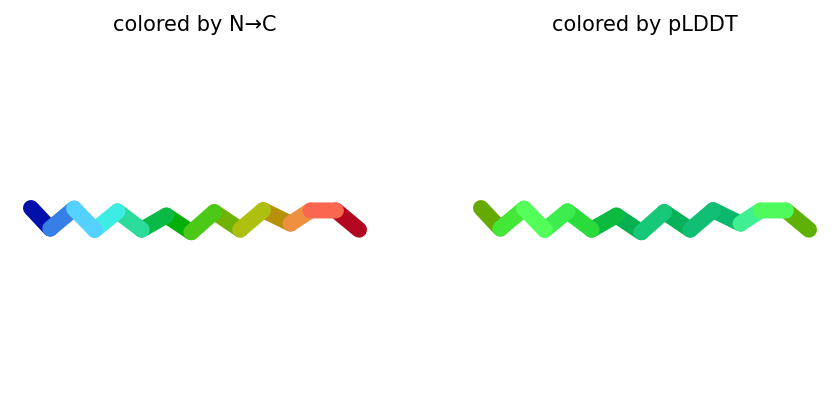

2025-11-17 09:10:37,711 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=64.3 pTM=0.032
2025-11-17 09:10:40,305 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.1 pTM=0.0334 tol=0.843
2025-11-17 09:10:42,896 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=66.4 pTM=0.0341 tol=0.137
2025-11-17 09:10:45,483 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=73.1 pTM=0.0373 tol=0.717
2025-11-17 09:10:45,483 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


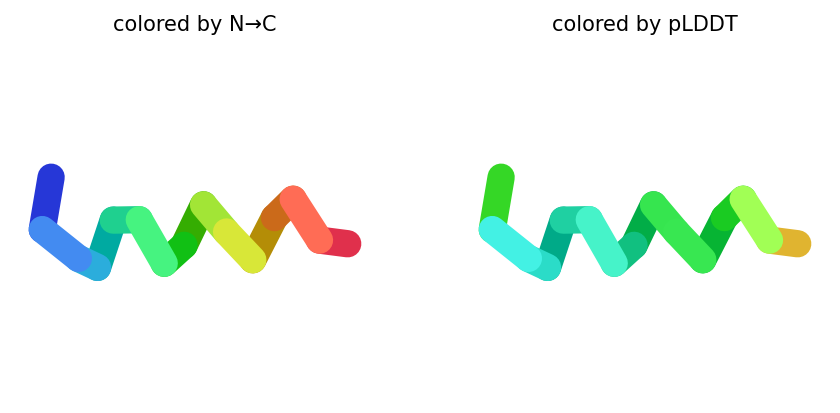

2025-11-17 09:10:48,128 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=61.2 pTM=0.0298
2025-11-17 09:10:50,716 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=63.5 pTM=0.0304 tol=0.861
2025-11-17 09:10:53,305 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.3 pTM=0.0306 tol=0.118
2025-11-17 09:10:55,893 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=63.5 pTM=0.0301 tol=0.389
2025-11-17 09:10:55,894 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


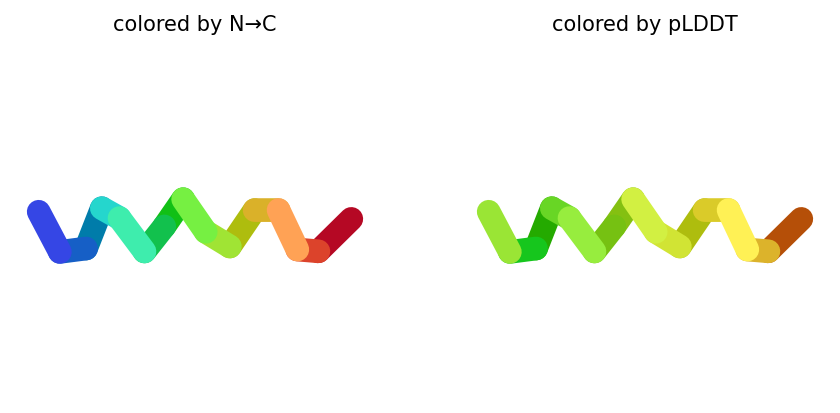

2025-11-17 09:10:55,943 reranking models by 'plddt' metric
2025-11-17 09:10:55,944 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=79.2 pTM=0.0419
2025-11-17 09:10:55,944 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=73.1 pTM=0.0373
2025-11-17 09:10:55,944 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=72.5 pTM=0.0287
2025-11-17 09:10:55,945 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=70.1 pTM=0.0388
2025-11-17 09:10:55,945 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=63.5 pTM=0.0301
2025-11-17 09:10:57,574 Query 107/146: peptide_219_IC50_456.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:10:57,844 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


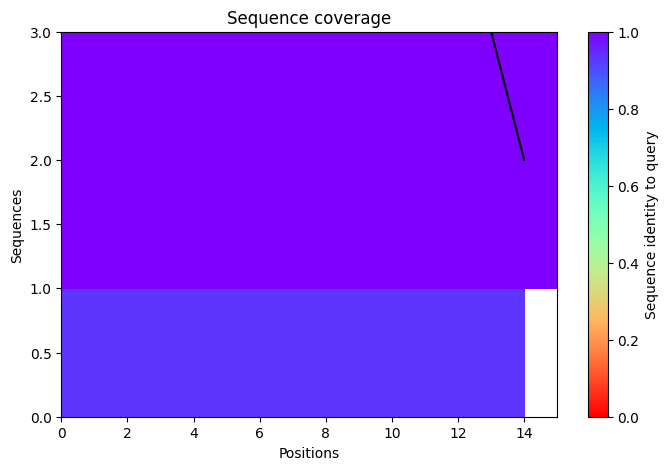

2025-11-17 09:11:11,215 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=74.2 pTM=0.0306
2025-11-17 09:11:13,792 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=73.1 pTM=0.0303 tol=0.146
2025-11-17 09:11:16,370 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.1 pTM=0.0303 tol=0.12
2025-11-17 09:11:18,951 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.6 pTM=0.0313 tol=0.188
2025-11-17 09:11:18,952 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


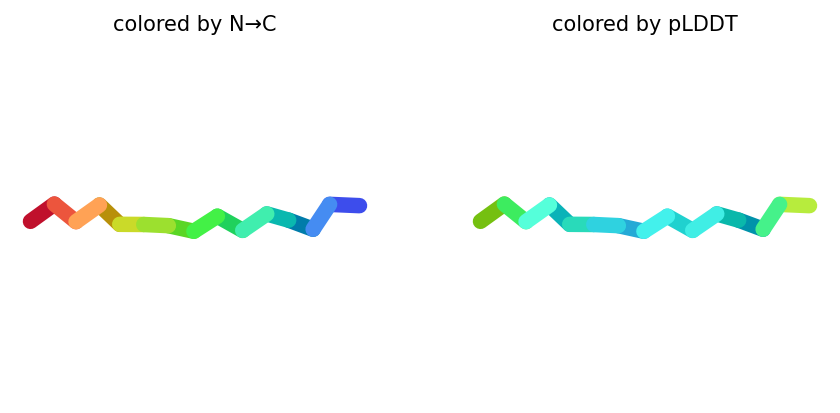

2025-11-17 09:11:21,592 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71.5 pTM=0.0301
2025-11-17 09:11:24,180 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.6 pTM=0.0295 tol=0.445
2025-11-17 09:11:26,776 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.2 pTM=0.0299 tol=0.347
2025-11-17 09:11:29,365 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.7 pTM=0.0306 tol=0.125
2025-11-17 09:11:29,366 alphafold2_ptm_model_2_seed_000 took 10.4s (3 recycles)


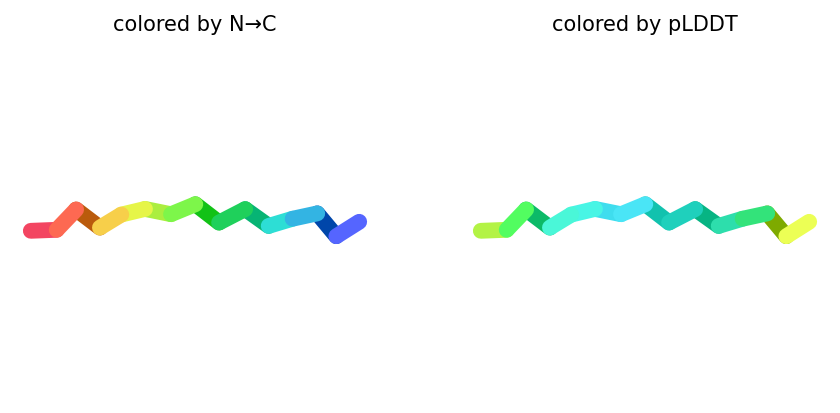

2025-11-17 09:11:32,009 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.1 pTM=0.0297
2025-11-17 09:11:34,607 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=78.7 pTM=0.0297 tol=0.235
2025-11-17 09:11:37,206 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.7 pTM=0.0304 tol=0.159
2025-11-17 09:11:39,807 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=82.1 pTM=0.0312 tol=0.0713
2025-11-17 09:11:39,807 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


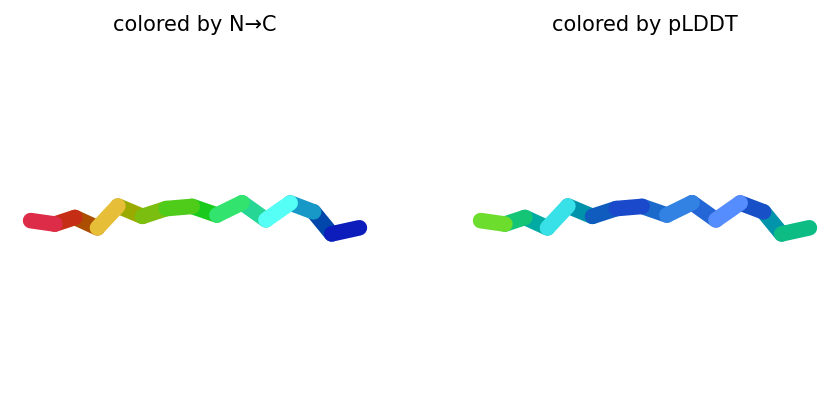

2025-11-17 09:11:42,466 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.6 pTM=0.0298
2025-11-17 09:11:45,058 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75.9 pTM=0.0299 tol=0.464
2025-11-17 09:11:47,657 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.7 pTM=0.0306 tol=0.359
2025-11-17 09:11:50,246 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.9 pTM=0.0309 tol=0.197
2025-11-17 09:11:50,247 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


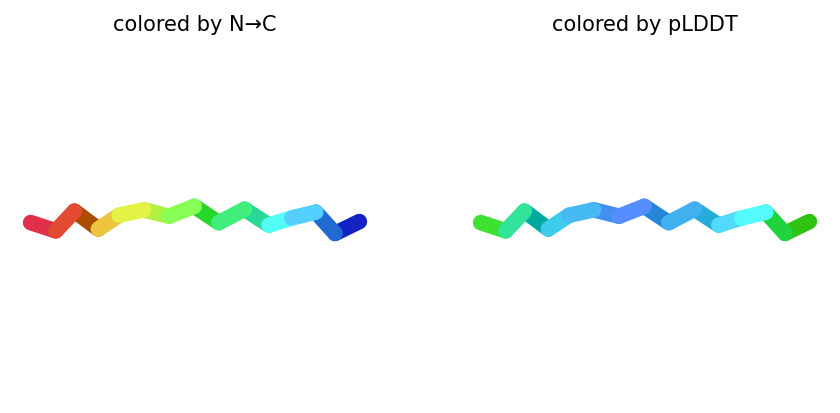

2025-11-17 09:11:52,898 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=76.2 pTM=0.0297
2025-11-17 09:11:55,484 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76 pTM=0.0294 tol=0.157
2025-11-17 09:11:58,065 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=77.2 pTM=0.03 tol=0.143
2025-11-17 09:12:00,653 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78.2 pTM=0.0308 tol=0.238
2025-11-17 09:12:00,653 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


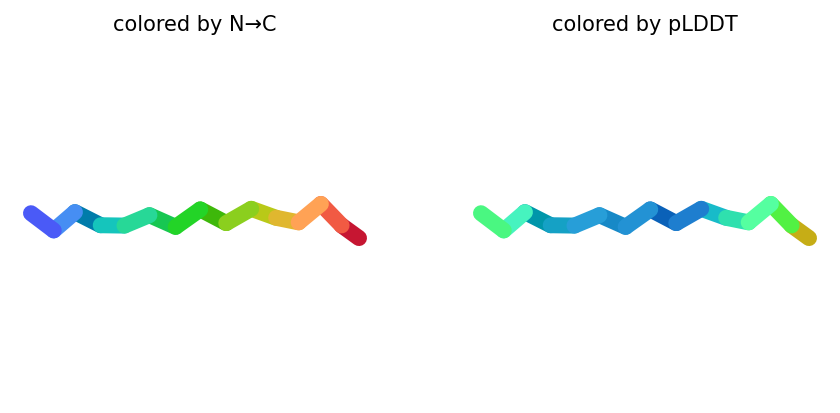

2025-11-17 09:12:00,725 reranking models by 'plddt' metric
2025-11-17 09:12:00,726 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=82.1 pTM=0.0312
2025-11-17 09:12:00,726 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=79.9 pTM=0.0309
2025-11-17 09:12:00,727 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=78.2 pTM=0.0308
2025-11-17 09:12:00,727 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=76.6 pTM=0.0313
2025-11-17 09:12:00,727 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.7 pTM=0.0306
2025-11-17 09:12:02,191 Query 108/146: peptide_220_IC50_455.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:12:02,479 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


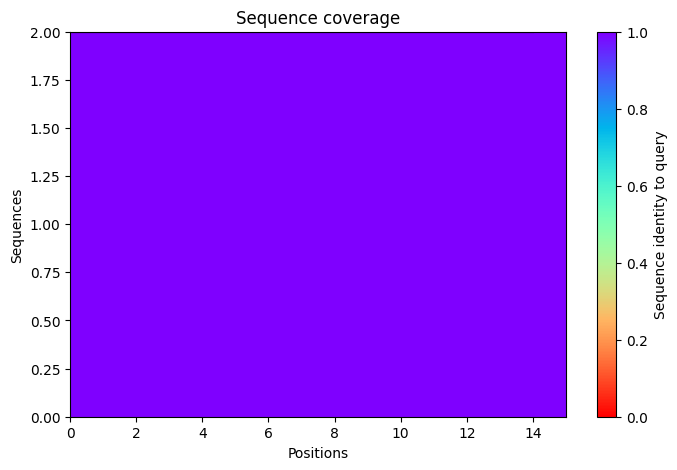

2025-11-17 09:12:13,776 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66.7 pTM=0.0297
2025-11-17 09:12:16,351 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77 pTM=0.0335 tol=2.21
2025-11-17 09:12:18,928 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=80.9 pTM=0.0364 tol=0.26
2025-11-17 09:12:21,505 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=81.6 pTM=0.037 tol=0.0679
2025-11-17 09:12:21,506 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


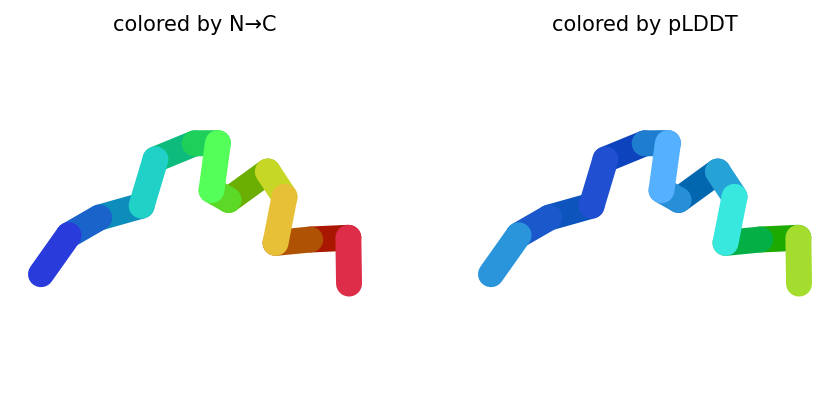

2025-11-17 09:12:24,145 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.5 pTM=0.0312
2025-11-17 09:12:26,727 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=75.4 pTM=0.0344 tol=0.23
2025-11-17 09:12:29,307 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.6 pTM=0.0333 tol=0.0958
2025-11-17 09:12:31,889 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.2 pTM=0.0331 tol=0.216
2025-11-17 09:12:31,890 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


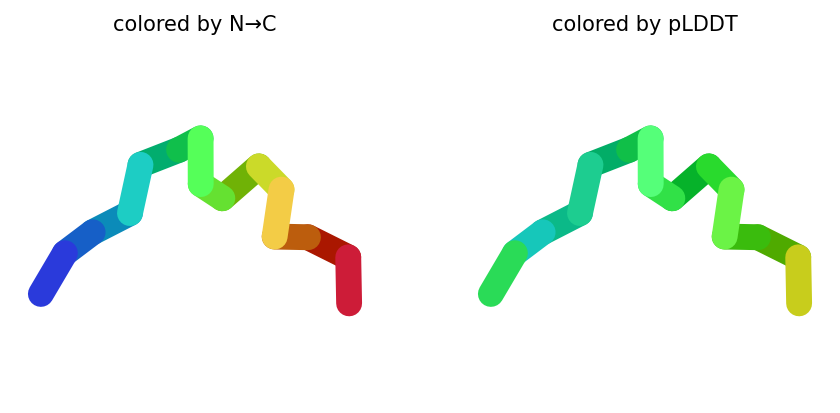

2025-11-17 09:12:34,533 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.1 pTM=0.0286
2025-11-17 09:12:37,121 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.9 pTM=0.0284 tol=0.202
2025-11-17 09:12:39,717 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.6 pTM=0.0283 tol=0.234
2025-11-17 09:12:42,316 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77.4 pTM=0.0285 tol=0.189
2025-11-17 09:12:42,316 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


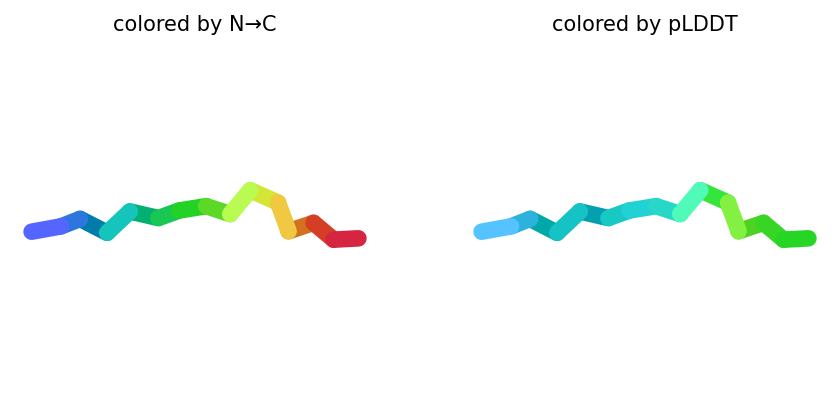

2025-11-17 09:12:44,967 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.2 pTM=0.0288
2025-11-17 09:12:47,565 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75 pTM=0.033 tol=1.14
2025-11-17 09:12:50,167 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.2 pTM=0.0348 tol=0.221
2025-11-17 09:12:52,771 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.8 pTM=0.0363 tol=0.284
2025-11-17 09:12:52,772 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


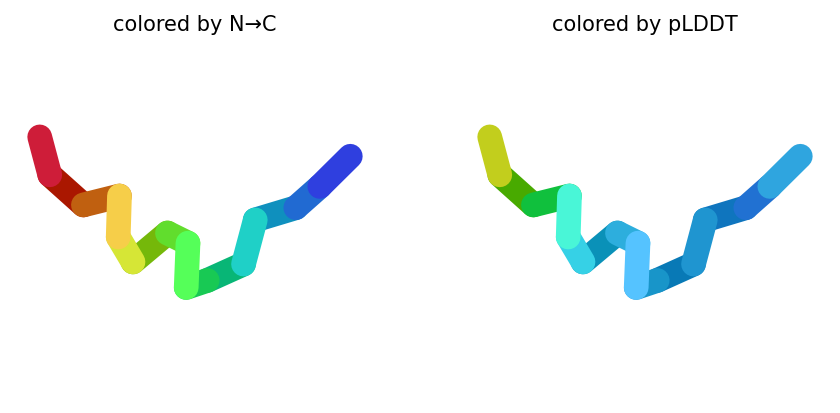

2025-11-17 09:12:55,429 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69.9 pTM=0.0307
2025-11-17 09:12:58,028 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.9 pTM=0.0338 tol=0.534
2025-11-17 09:13:00,624 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=78.2 pTM=0.0345 tol=0.111
2025-11-17 09:13:03,220 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=79.2 pTM=0.0356 tol=0.174
2025-11-17 09:13:03,221 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


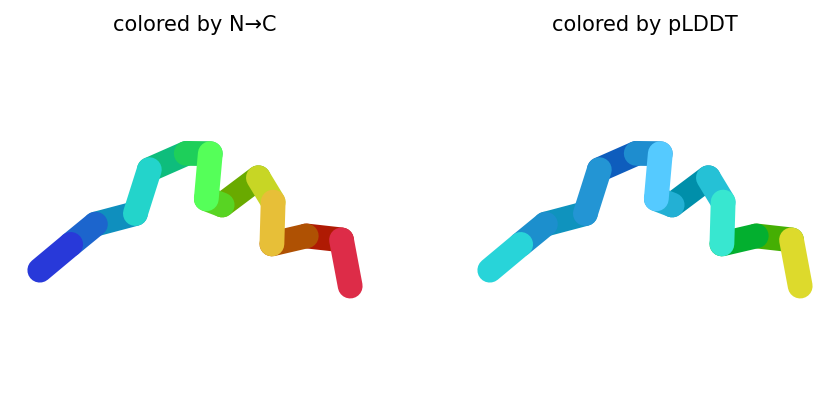

2025-11-17 09:13:03,306 reranking models by 'plddt' metric
2025-11-17 09:13:03,307 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=81.6 pTM=0.037
2025-11-17 09:13:03,307 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=79.8 pTM=0.0363
2025-11-17 09:13:03,307 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=79.2 pTM=0.0356
2025-11-17 09:13:03,307 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=77.4 pTM=0.0285
2025-11-17 09:13:03,307 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.2 pTM=0.0331
2025-11-17 09:13:04,799 Query 109/146: peptide_221_IC50_457.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:13:05,084 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


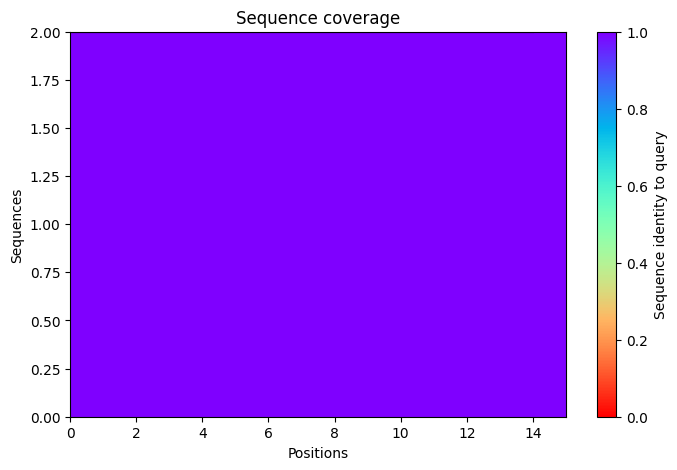

2025-11-17 09:13:18,611 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=67.8 pTM=0.0343
2025-11-17 09:13:21,187 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=68.9 pTM=0.0347 tol=0.184
2025-11-17 09:13:23,760 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=70.9 pTM=0.0353 tol=0.123
2025-11-17 09:13:26,338 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.1 pTM=0.0342 tol=0.264
2025-11-17 09:13:26,339 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


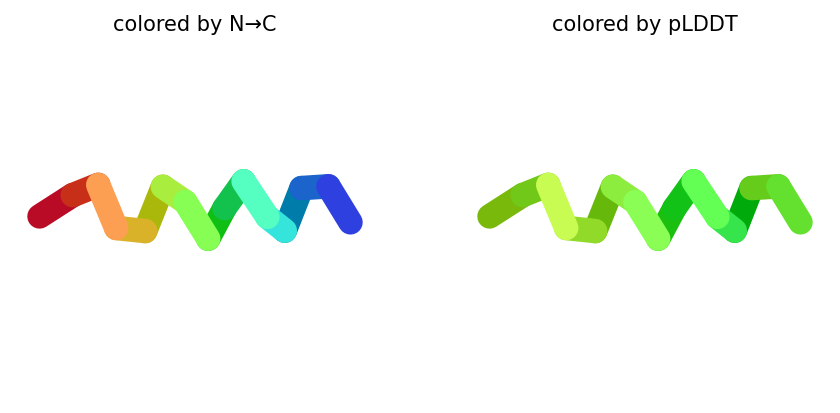

2025-11-17 09:13:28,970 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.8 pTM=0.0286
2025-11-17 09:13:31,551 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.9 pTM=0.027 tol=2.59
2025-11-17 09:13:34,130 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=62.8 pTM=0.0271 tol=1.06
2025-11-17 09:13:36,716 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=65.4 pTM=0.0275 tol=0.869
2025-11-17 09:13:36,717 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


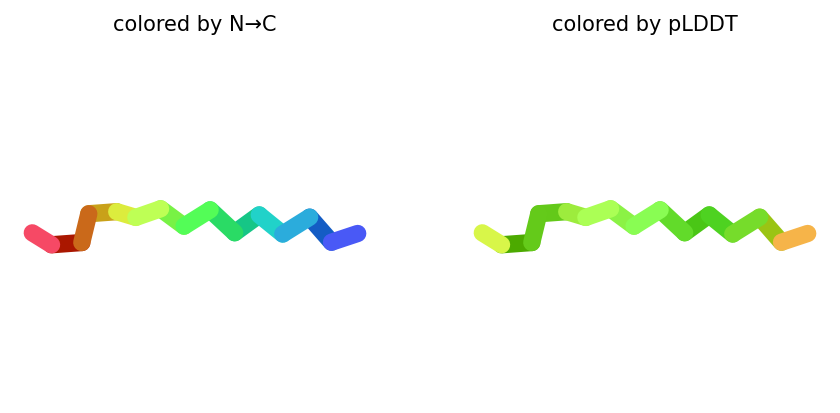

2025-11-17 09:13:39,358 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=60.9 pTM=0.0268
2025-11-17 09:13:41,948 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=69 pTM=0.0271 tol=1.33
2025-11-17 09:13:44,544 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.2 pTM=0.0276 tol=0.329
2025-11-17 09:13:47,137 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=71.9 pTM=0.0276 tol=0.0632
2025-11-17 09:13:47,137 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


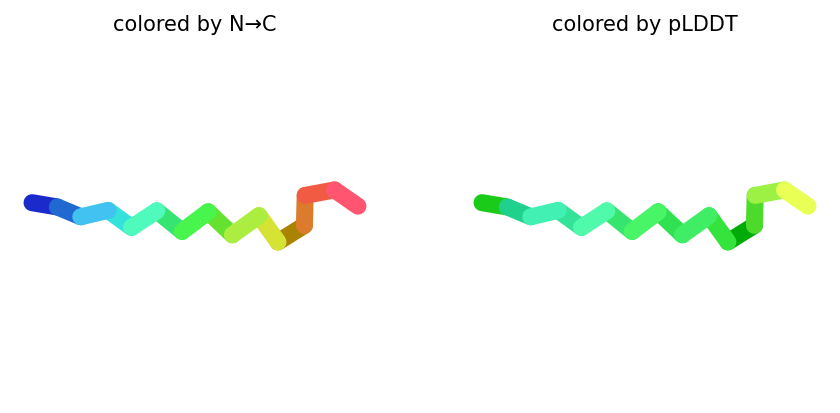

2025-11-17 09:13:49,782 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.6 pTM=0.0271
2025-11-17 09:13:52,380 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.6 pTM=0.0271 tol=0.729
2025-11-17 09:13:54,976 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.1 pTM=0.0272 tol=0.443
2025-11-17 09:13:57,568 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70 pTM=0.0272 tol=0.34
2025-11-17 09:13:57,569 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


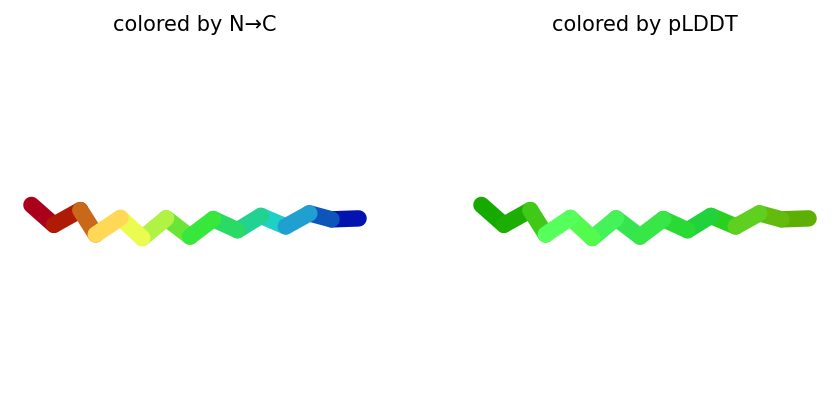

2025-11-17 09:14:00,209 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69.6 pTM=0.0339
2025-11-17 09:14:02,798 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=63.5 pTM=0.0304 tol=1.16
2025-11-17 09:14:05,390 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63.7 pTM=0.0288 tol=0.926
2025-11-17 09:14:07,980 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=62.2 pTM=0.0278 tol=0.697
2025-11-17 09:14:07,981 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


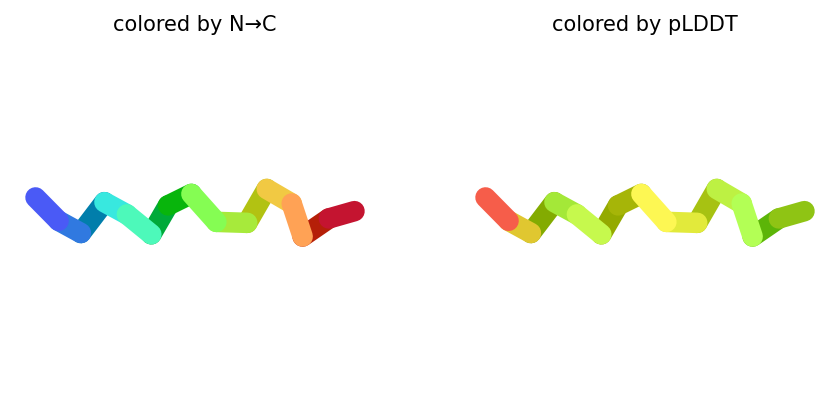

2025-11-17 09:14:08,044 reranking models by 'plddt' metric
2025-11-17 09:14:08,044 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=71.9 pTM=0.0276
2025-11-17 09:14:08,045 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=70 pTM=0.0272
2025-11-17 09:14:08,045 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=68.1 pTM=0.0342
2025-11-17 09:14:08,045 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=65.4 pTM=0.0275
2025-11-17 09:14:08,046 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=62.2 pTM=0.0278
2025-11-17 09:14:09,557 Query 110/146: peptide_222_IC50_462.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:14:09,843 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


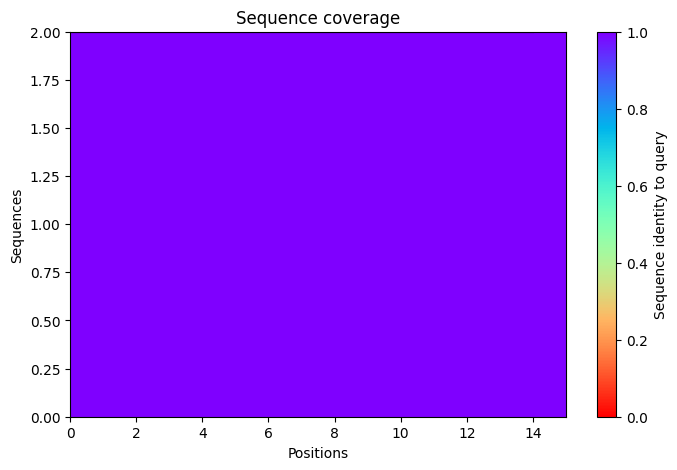

2025-11-17 09:14:21,649 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=84 pTM=0.0348
2025-11-17 09:14:24,226 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83.6 pTM=0.0358 tol=0.192
2025-11-17 09:14:26,802 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.6 pTM=0.0348 tol=0.193
2025-11-17 09:14:29,378 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=78.8 pTM=0.0332 tol=0.135
2025-11-17 09:14:29,378 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


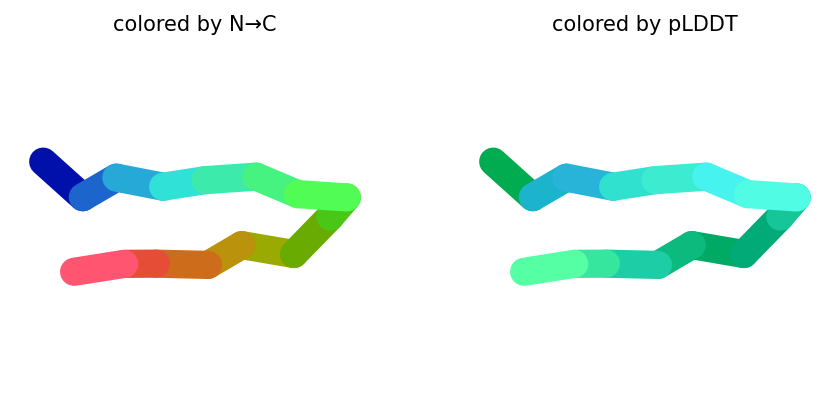

2025-11-17 09:14:32,014 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=79.6 pTM=0.0331
2025-11-17 09:14:34,597 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.2 pTM=0.0289 tol=1.19
2025-11-17 09:14:37,178 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.5 pTM=0.0279 tol=7.64
2025-11-17 09:14:39,763 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.9 pTM=0.028 tol=1.54
2025-11-17 09:14:39,764 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


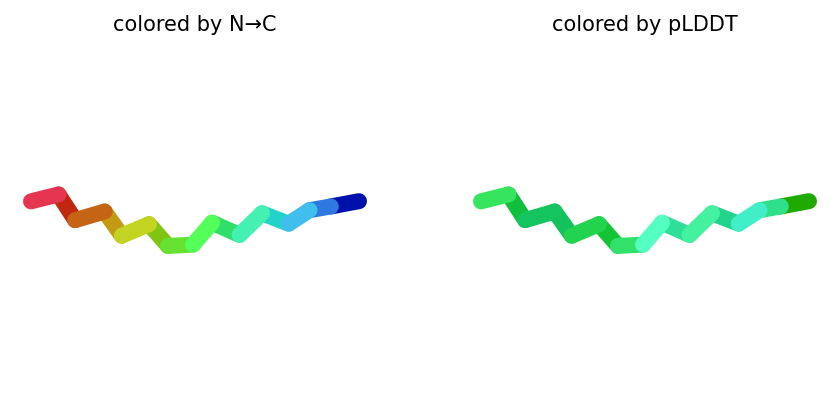

2025-11-17 09:14:42,402 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.3 pTM=0.031
2025-11-17 09:14:44,991 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.4 pTM=0.0292 tol=0.418
2025-11-17 09:14:47,583 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=71.2 pTM=0.0281 tol=0.422
2025-11-17 09:14:50,177 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=69.6 pTM=0.0275 tol=0.874
2025-11-17 09:14:50,178 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


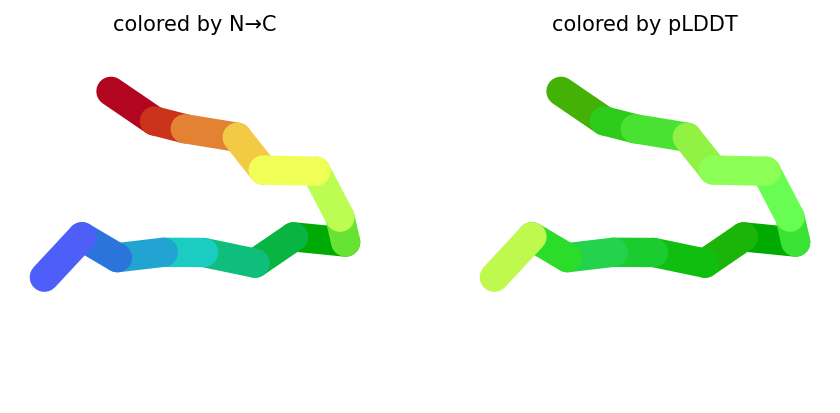

2025-11-17 09:14:52,825 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=80.9 pTM=0.0346
2025-11-17 09:14:55,421 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.9 pTM=0.0327 tol=0.267
2025-11-17 09:14:58,012 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.1 pTM=0.032 tol=0.109
2025-11-17 09:15:00,603 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.2 pTM=0.0316 tol=0.102
2025-11-17 09:15:00,604 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


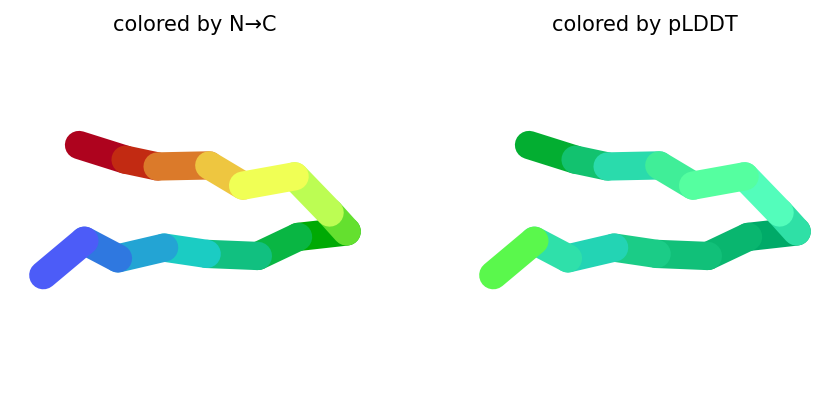

2025-11-17 09:15:03,246 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=78.5 pTM=0.0331
2025-11-17 09:15:05,835 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=72.5 pTM=0.0305 tol=0.368
2025-11-17 09:15:08,426 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=72.1 pTM=0.0297 tol=0.424
2025-11-17 09:15:11,013 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=72.1 pTM=0.0294 tol=0.149
2025-11-17 09:15:11,014 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


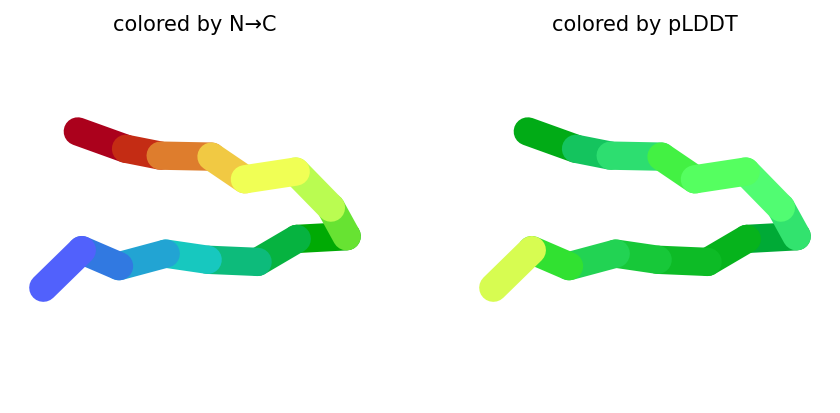

2025-11-17 09:15:11,067 reranking models by 'plddt' metric
2025-11-17 09:15:11,068 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=78.8 pTM=0.0332
2025-11-17 09:15:11,069 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=76.2 pTM=0.0316
2025-11-17 09:15:11,069 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=74.9 pTM=0.028
2025-11-17 09:15:11,070 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=72.1 pTM=0.0294
2025-11-17 09:15:11,070 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=69.6 pTM=0.0275
2025-11-17 09:15:12,263 Query 111/146: peptide_226_IC50_460.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:15:12,535 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


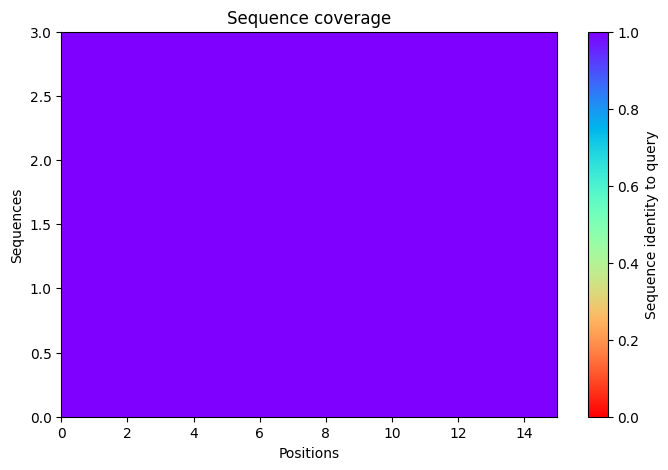

2025-11-17 09:15:24,271 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=77.1 pTM=0.0336
2025-11-17 09:15:26,847 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=79 pTM=0.0353 tol=0.182
2025-11-17 09:15:29,423 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79.4 pTM=0.0357 tol=0.0707
2025-11-17 09:15:32,008 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.7 pTM=0.0366 tol=0.1
2025-11-17 09:15:32,008 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


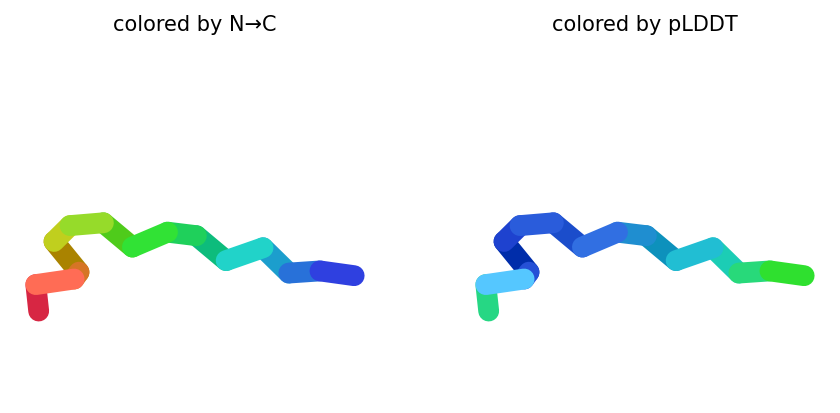

2025-11-17 09:15:34,648 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.9 pTM=0.0309
2025-11-17 09:15:37,233 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.1 pTM=0.031 tol=0.237
2025-11-17 09:15:39,818 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.6 pTM=0.0306 tol=0.164
2025-11-17 09:15:42,405 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.6 pTM=0.0312 tol=0.0633
2025-11-17 09:15:42,406 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


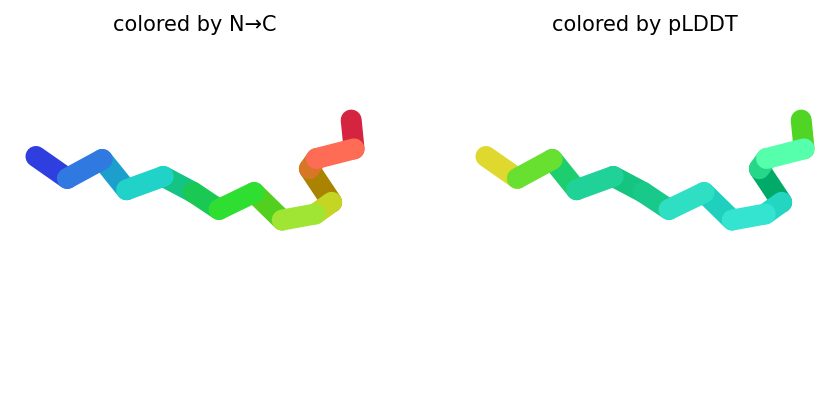

2025-11-17 09:15:45,054 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=80.5 pTM=0.0309
2025-11-17 09:15:47,646 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=83.6 pTM=0.034 tol=0.269
2025-11-17 09:15:50,239 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=83.6 pTM=0.0337 tol=0.0482
2025-11-17 09:15:52,834 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=84.8 pTM=0.0345 tol=0.123
2025-11-17 09:15:52,834 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


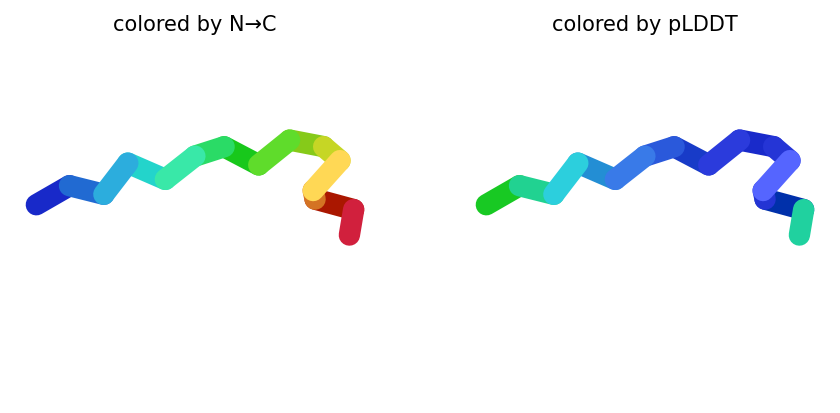

2025-11-17 09:15:55,482 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=77.3 pTM=0.0294
2025-11-17 09:15:58,079 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=79.9 pTM=0.032 tol=0.272
2025-11-17 09:16:00,672 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=81.1 pTM=0.0326 tol=0.0909
2025-11-17 09:16:03,261 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=82.8 pTM=0.0331 tol=0.0947
2025-11-17 09:16:03,262 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


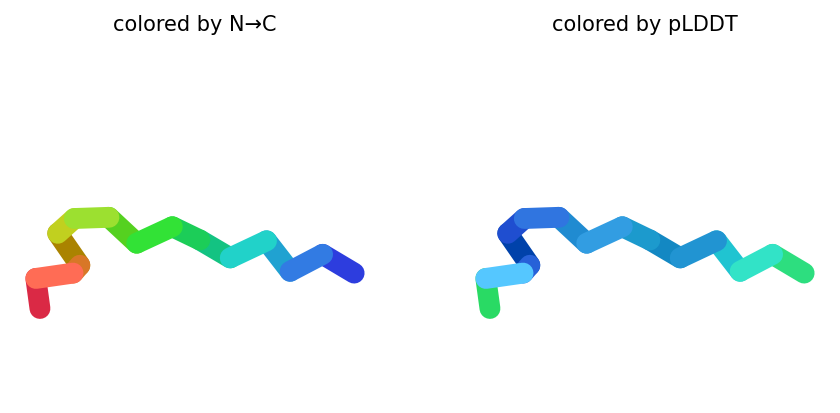

2025-11-17 09:16:05,907 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=73.7 pTM=0.0278
2025-11-17 09:16:08,496 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=75.4 pTM=0.0291 tol=0.456
2025-11-17 09:16:11,081 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=77.4 pTM=0.0303 tol=0.178
2025-11-17 09:16:13,670 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=80.7 pTM=0.0322 tol=0.208
2025-11-17 09:16:13,670 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


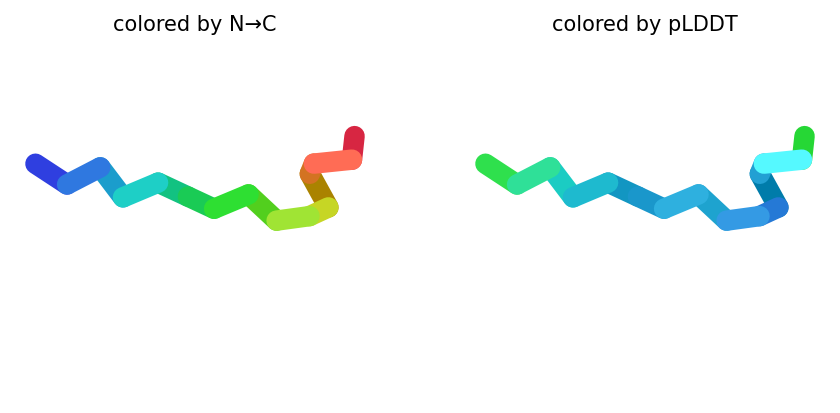

2025-11-17 09:16:13,721 reranking models by 'plddt' metric
2025-11-17 09:16:13,721 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=84.8 pTM=0.0345
2025-11-17 09:16:13,722 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=82.8 pTM=0.0331
2025-11-17 09:16:13,722 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=82.7 pTM=0.0366
2025-11-17 09:16:13,723 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=80.7 pTM=0.0322
2025-11-17 09:16:13,723 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.6 pTM=0.0312
2025-11-17 09:16:14,942 Query 112/146: peptide_230_IC50_462.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:16:15,218 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


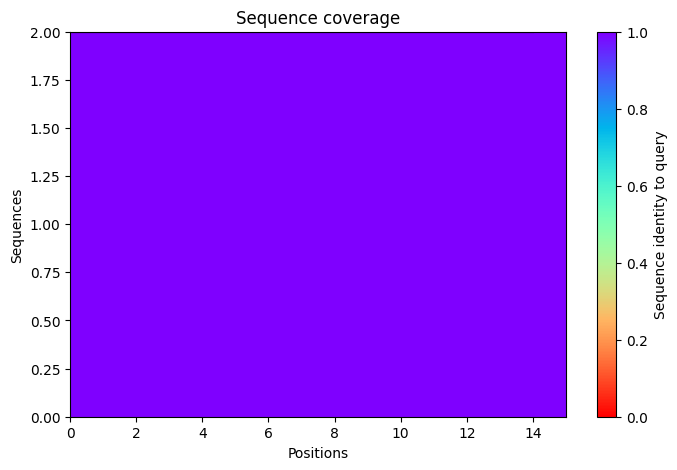

2025-11-17 09:16:25,879 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.9 pTM=0.0282
2025-11-17 09:16:28,454 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.6 pTM=0.0285 tol=0.895
2025-11-17 09:16:31,033 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=68.9 pTM=0.0294 tol=0.42
2025-11-17 09:16:33,613 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=69.6 pTM=0.0298 tol=0.394
2025-11-17 09:16:33,614 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


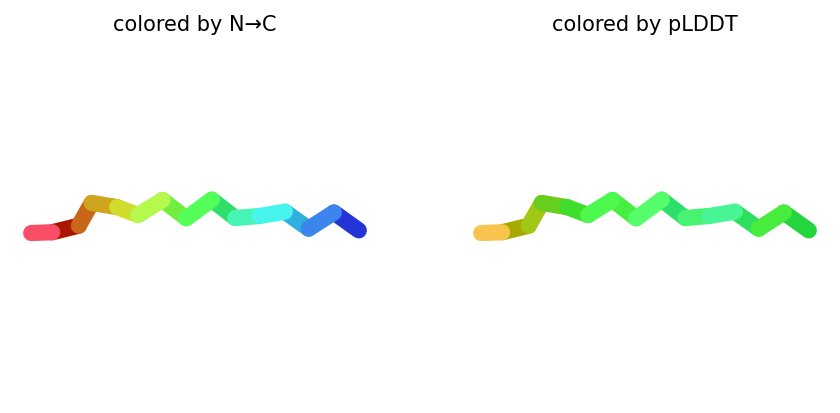

2025-11-17 09:16:36,267 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.4 pTM=0.0267
2025-11-17 09:16:38,847 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.7 pTM=0.0269 tol=1.3
2025-11-17 09:16:41,432 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.6 pTM=0.0277 tol=0.268
2025-11-17 09:16:44,019 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.2 pTM=0.028 tol=0.101
2025-11-17 09:16:44,020 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


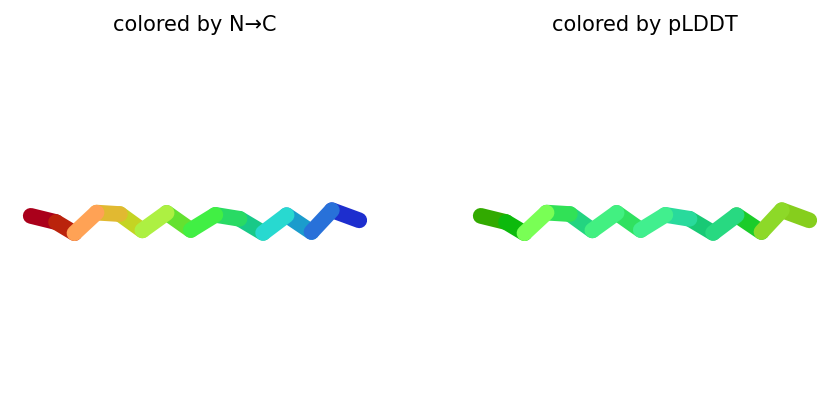

2025-11-17 09:16:46,662 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.2 pTM=0.0278
2025-11-17 09:16:49,253 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=80.9 pTM=0.029 tol=0.539
2025-11-17 09:16:51,847 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.7 pTM=0.0293 tol=0.0946
2025-11-17 09:16:54,438 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.6 pTM=0.0292 tol=0.0894
2025-11-17 09:16:54,439 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


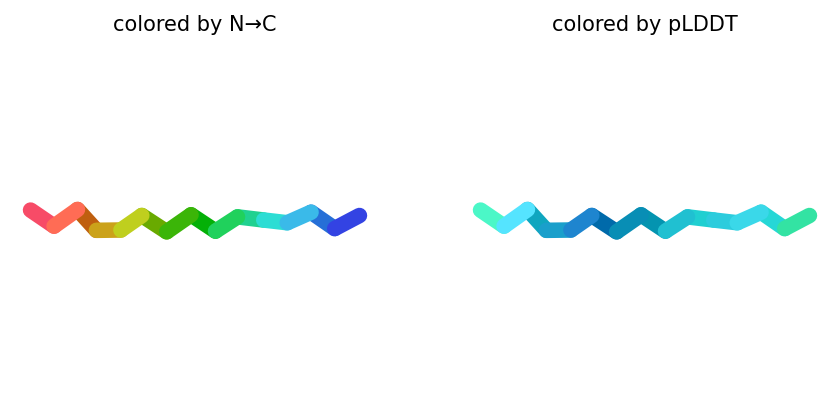

2025-11-17 09:16:57,082 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.4 pTM=0.0269
2025-11-17 09:16:59,673 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.6 pTM=0.029 tol=0.95
2025-11-17 09:17:02,266 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=79.4 pTM=0.0302 tol=0.194
2025-11-17 09:17:04,854 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=80.1 pTM=0.0306 tol=0.107
2025-11-17 09:17:04,855 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


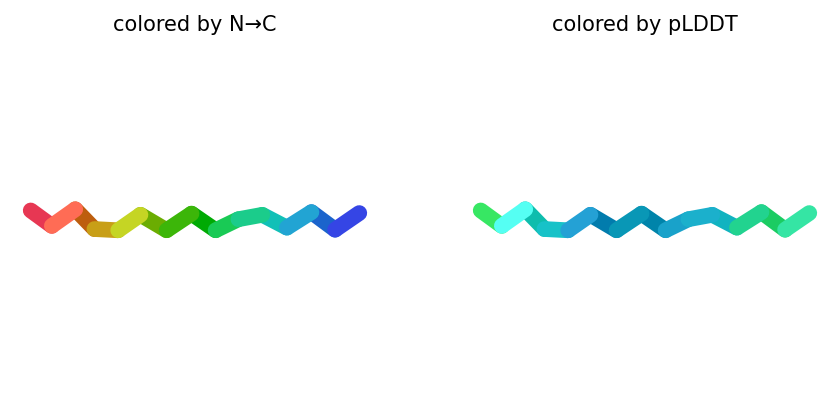

2025-11-17 09:17:07,494 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.1 pTM=0.027
2025-11-17 09:17:10,082 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=74.9 pTM=0.0281 tol=1.34
2025-11-17 09:17:12,671 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=72 pTM=0.0293 tol=0.688
2025-11-17 09:17:15,252 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78.5 pTM=0.0294 tol=0.356
2025-11-17 09:17:15,253 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


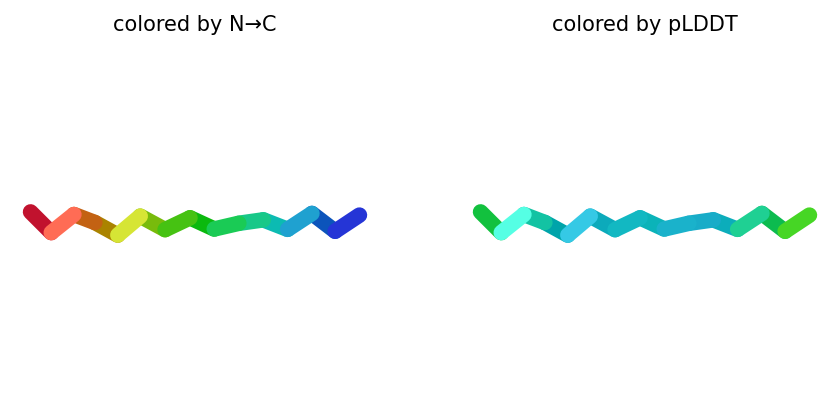

2025-11-17 09:17:15,302 reranking models by 'plddt' metric
2025-11-17 09:17:15,303 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=81.6 pTM=0.0292
2025-11-17 09:17:15,304 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=80.1 pTM=0.0306
2025-11-17 09:17:15,304 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=78.5 pTM=0.0294
2025-11-17 09:17:15,304 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=72.2 pTM=0.028
2025-11-17 09:17:15,304 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=69.6 pTM=0.0298
2025-11-17 09:17:16,828 Query 113/146: peptide_234_IC50_469.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:17:17,103 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


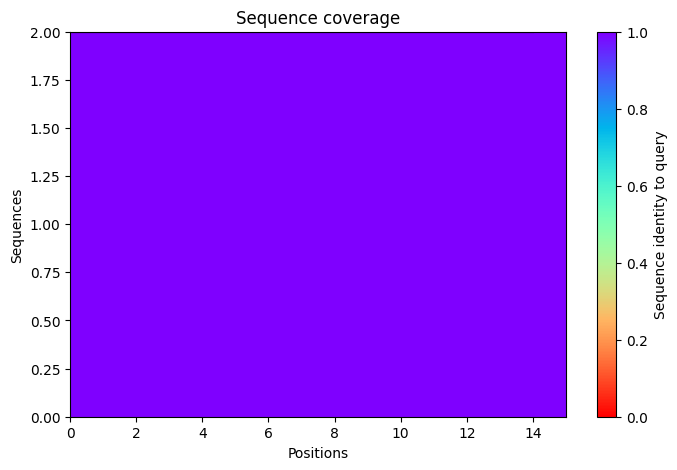

2025-11-17 09:17:30,410 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76.4 pTM=0.0385
2025-11-17 09:17:32,986 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=76.6 pTM=0.0392 tol=0.18
2025-11-17 09:17:35,565 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=76.4 pTM=0.0393 tol=0.175
2025-11-17 09:17:38,143 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76 pTM=0.039 tol=0.111
2025-11-17 09:17:38,143 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


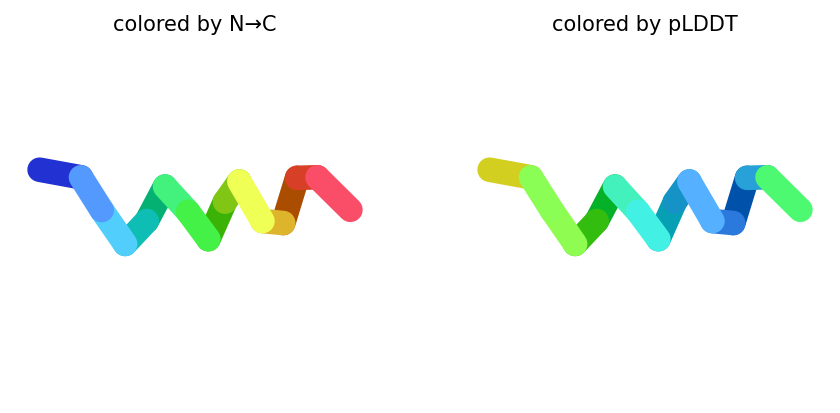

2025-11-17 09:17:40,778 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.2 pTM=0.0371
2025-11-17 09:17:43,361 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.3 pTM=0.0377 tol=0.624
2025-11-17 09:17:45,946 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.6 pTM=0.0369 tol=0.105
2025-11-17 09:17:48,537 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.2 pTM=0.0366 tol=0.162
2025-11-17 09:17:48,538 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


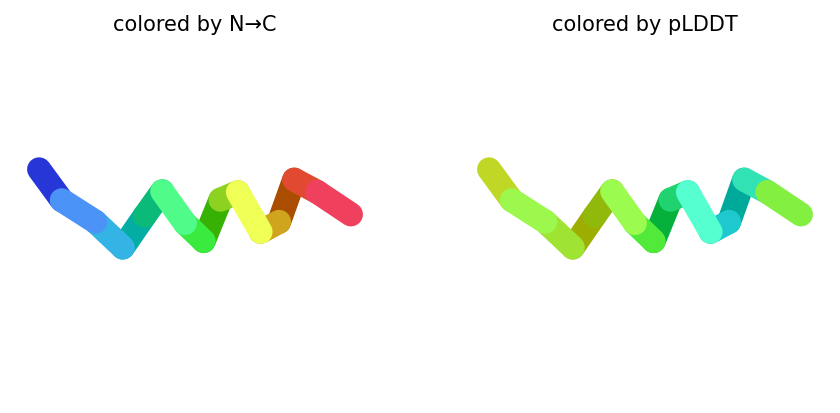

2025-11-17 09:17:51,203 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.9 pTM=0.0322
2025-11-17 09:17:53,794 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.8 pTM=0.0343 tol=0.288
2025-11-17 09:17:56,389 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=75.2 pTM=0.0342 tol=0.331
2025-11-17 09:17:58,987 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.9 pTM=0.0355 tol=0.92
2025-11-17 09:17:58,988 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


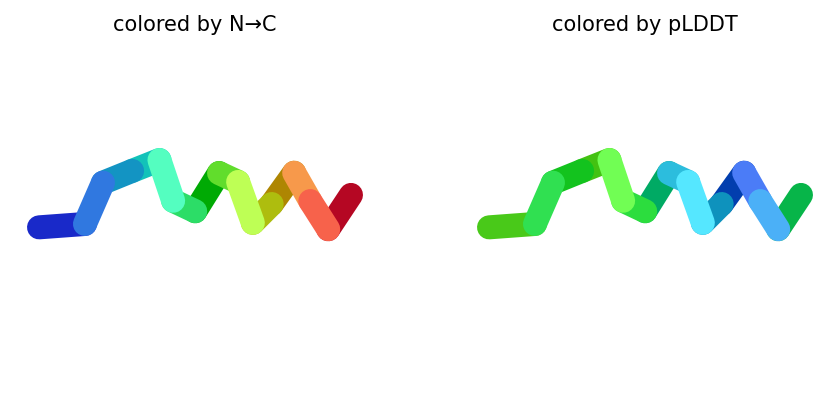

2025-11-17 09:18:01,642 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.3 pTM=0.0372
2025-11-17 09:18:04,246 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=78.2 pTM=0.0403 tol=0.157
2025-11-17 09:18:06,842 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78.4 pTM=0.0406 tol=0.386
2025-11-17 09:18:09,439 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=78 pTM=0.0402 tol=0.149
2025-11-17 09:18:09,440 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


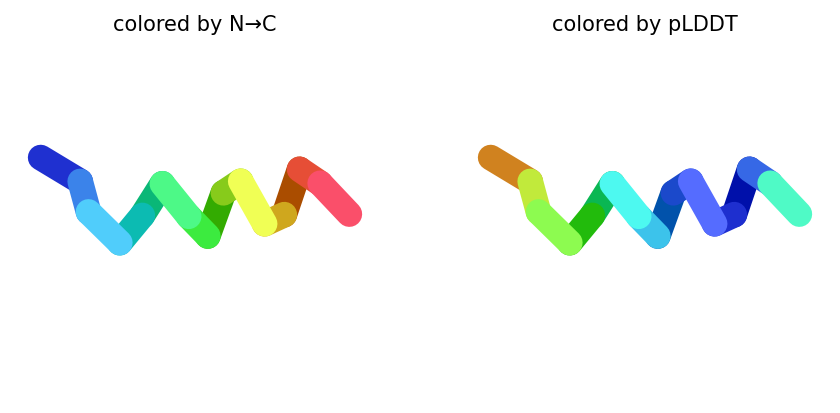

2025-11-17 09:18:12,086 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=86.8 pTM=0.0436
2025-11-17 09:18:14,682 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=88.2 pTM=0.0447 tol=0.118
2025-11-17 09:18:17,273 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=88.8 pTM=0.0443 tol=0.0622
2025-11-17 09:18:19,858 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.6 pTM=0.0447 tol=0.0588
2025-11-17 09:18:19,859 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


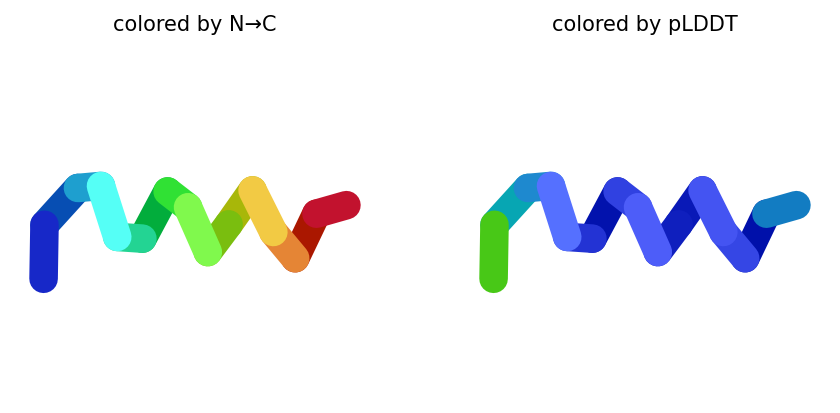

2025-11-17 09:18:19,910 reranking models by 'plddt' metric
2025-11-17 09:18:19,910 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.6 pTM=0.0447
2025-11-17 09:18:19,910 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=78 pTM=0.0402
2025-11-17 09:18:19,911 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=76.9 pTM=0.0355
2025-11-17 09:18:19,911 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=76 pTM=0.039
2025-11-17 09:18:19,911 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=70.2 pTM=0.0366
2025-11-17 09:18:21,109 Query 114/146: peptide_235_IC50_468.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:18:21,384 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


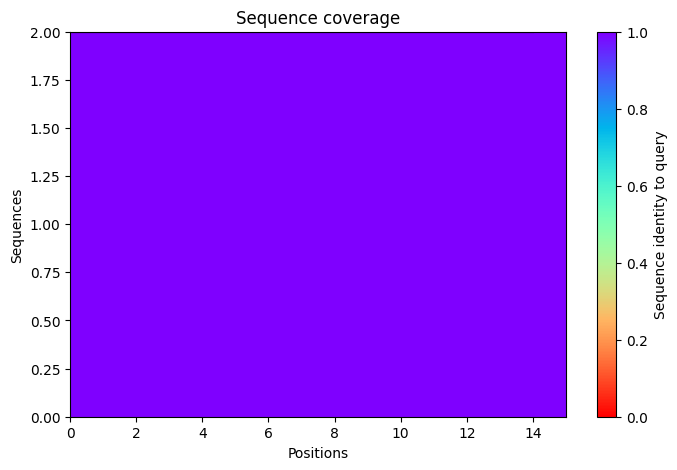

2025-11-17 09:18:31,698 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=63.2 pTM=0.0296
2025-11-17 09:18:34,275 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.1 pTM=0.0293 tol=1.91
2025-11-17 09:18:36,855 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.4 pTM=0.0297 tol=1.09
2025-11-17 09:18:39,434 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.2 pTM=0.0292 tol=0.477
2025-11-17 09:18:39,434 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


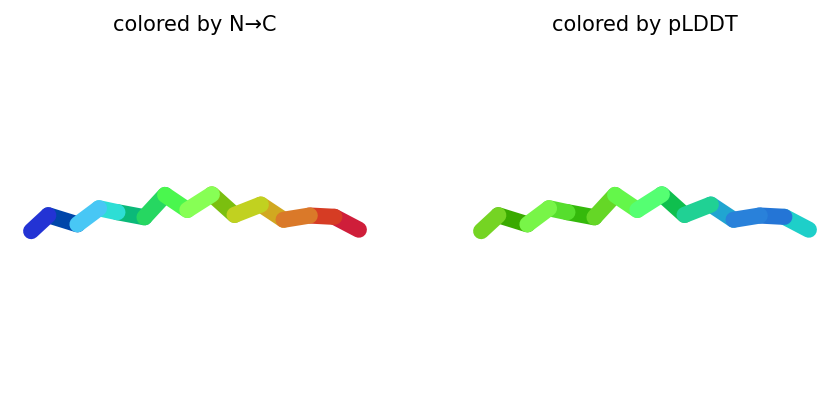

2025-11-17 09:18:42,065 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.5 pTM=0.0274
2025-11-17 09:18:44,643 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.7 pTM=0.0277 tol=1.11
2025-11-17 09:18:47,224 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.6 pTM=0.0277 tol=0.58
2025-11-17 09:18:49,807 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.7 pTM=0.0278 tol=0.245
2025-11-17 09:18:49,808 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


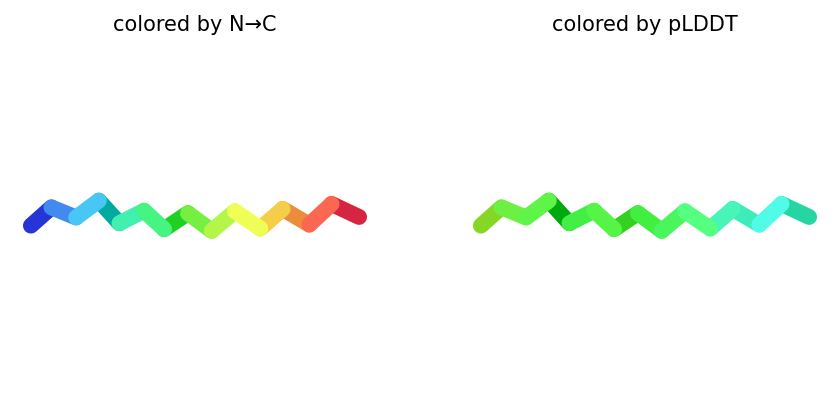

2025-11-17 09:18:52,463 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=64.8 pTM=0.0285
2025-11-17 09:18:55,046 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=69.5 pTM=0.0284 tol=1.15
2025-11-17 09:18:57,637 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72 pTM=0.0287 tol=0.643
2025-11-17 09:19:00,227 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.8 pTM=0.029 tol=0.238
2025-11-17 09:19:00,228 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


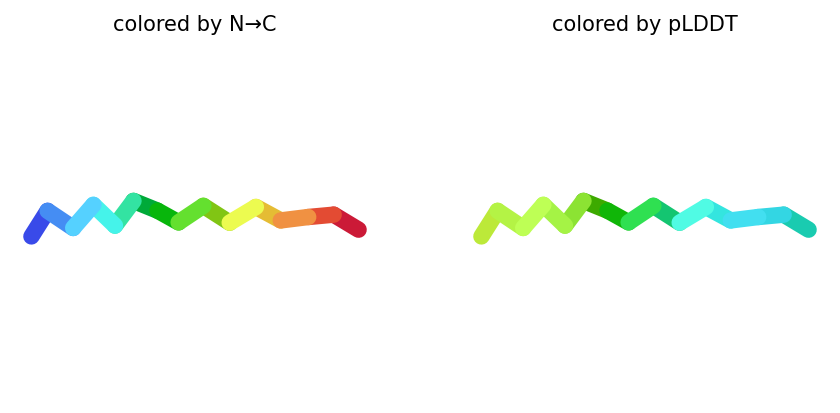

2025-11-17 09:19:02,872 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=66.6 pTM=0.0286
2025-11-17 09:19:05,464 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.4 pTM=0.0287 tol=0.991
2025-11-17 09:19:08,049 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.4 pTM=0.0288 tol=0.249
2025-11-17 09:19:10,638 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.9 pTM=0.0287 tol=0.177
2025-11-17 09:19:10,639 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


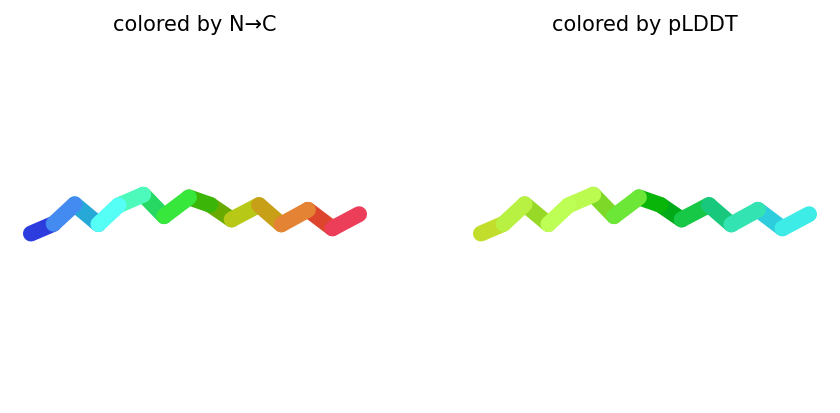

2025-11-17 09:19:13,275 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=67 pTM=0.0299
2025-11-17 09:19:15,865 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=68.9 pTM=0.0288 tol=3.13
2025-11-17 09:19:18,452 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=73.1 pTM=0.0301 tol=1.86
2025-11-17 09:19:21,039 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.1 pTM=0.03 tol=0.514
2025-11-17 09:19:21,039 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


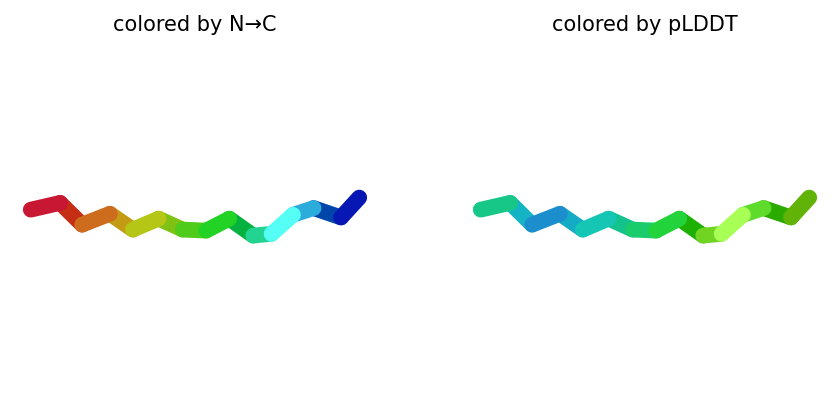

2025-11-17 09:19:21,086 reranking models by 'plddt' metric
2025-11-17 09:19:21,086 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=74.2 pTM=0.0292
2025-11-17 09:19:21,088 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=74.1 pTM=0.03
2025-11-17 09:19:21,089 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=72.8 pTM=0.029
2025-11-17 09:19:21,089 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=72.7 pTM=0.0278
2025-11-17 09:19:21,089 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=70.9 pTM=0.0287
2025-11-17 09:19:22,281 Query 115/146: peptide_237_IC50_470.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:19:22,562 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


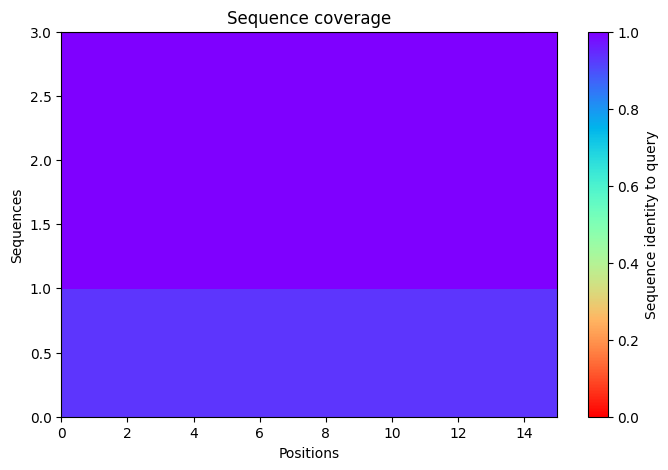

2025-11-17 09:19:34,830 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=74.8 pTM=0.0312
2025-11-17 09:19:37,406 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.8 pTM=0.0307 tol=0.376
2025-11-17 09:19:39,986 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.2 pTM=0.031 tol=0.158
2025-11-17 09:19:42,567 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.9 pTM=0.0313 tol=0.193
2025-11-17 09:19:42,568 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


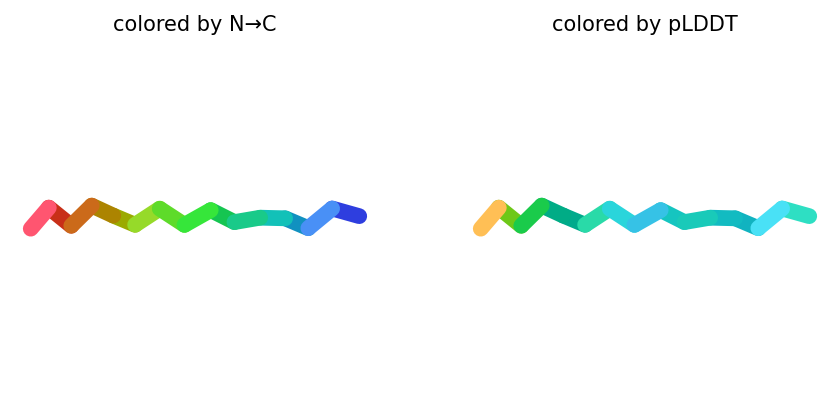

2025-11-17 09:19:45,203 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=72.9 pTM=0.0303
2025-11-17 09:19:47,782 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.1 pTM=0.0298 tol=0.266
2025-11-17 09:19:50,369 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.7 pTM=0.0298 tol=0.0553
2025-11-17 09:19:52,957 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.2 pTM=0.03 tol=0.194
2025-11-17 09:19:52,958 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


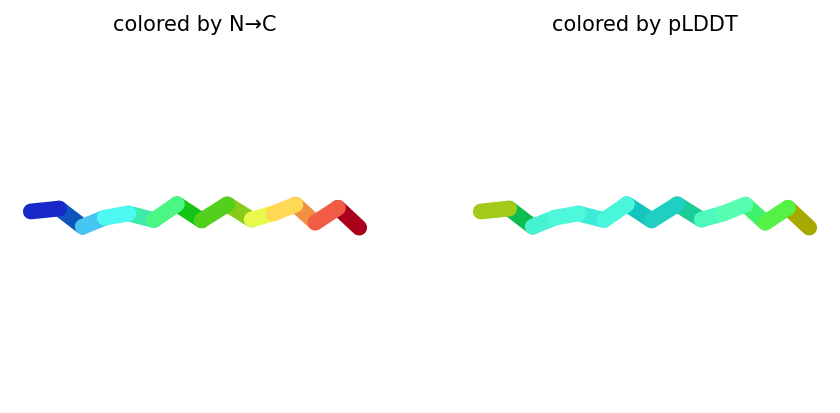

2025-11-17 09:19:55,599 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=77.6 pTM=0.0306
2025-11-17 09:19:58,194 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=77.4 pTM=0.0306 tol=0.442
2025-11-17 09:20:00,788 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.9 pTM=0.0309 tol=0.29
2025-11-17 09:20:03,382 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=79.7 pTM=0.0314 tol=0.2
2025-11-17 09:20:03,383 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


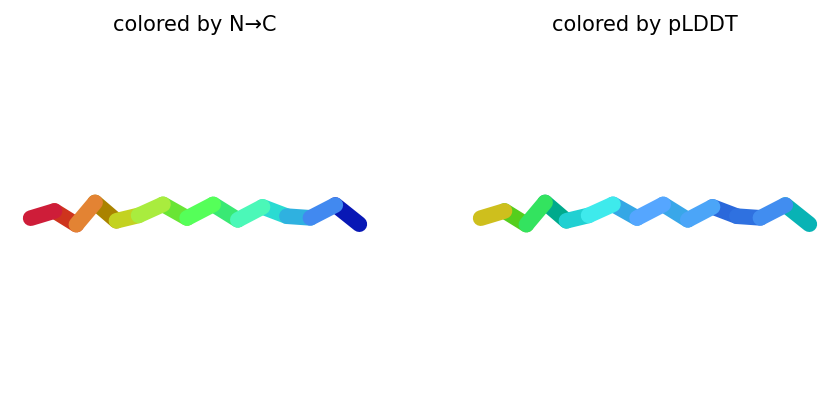

2025-11-17 09:20:06,054 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.3 pTM=0.0302
2025-11-17 09:20:08,652 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.2 pTM=0.0303 tol=0.27
2025-11-17 09:20:11,248 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.4 pTM=0.0306 tol=0.295
2025-11-17 09:20:13,841 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=77.9 pTM=0.0309 tol=0.0673
2025-11-17 09:20:13,842 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


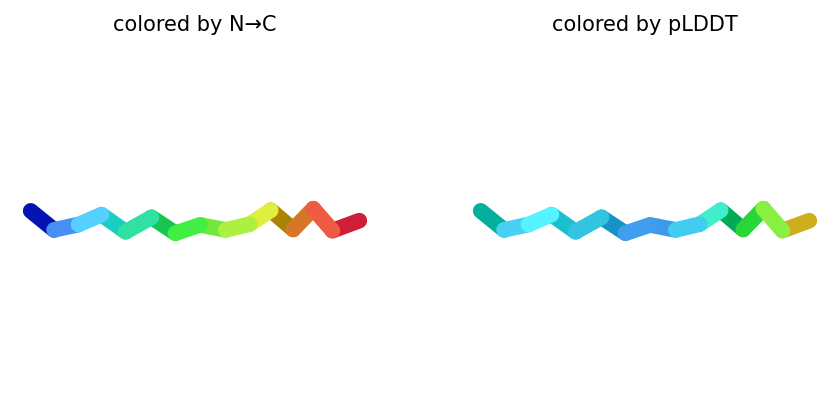

2025-11-17 09:20:16,481 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=75.1 pTM=0.0308
2025-11-17 09:20:19,072 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.3 pTM=0.0304 tol=0.184
2025-11-17 09:20:21,660 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=77.2 pTM=0.0304 tol=0.149
2025-11-17 09:20:24,243 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=78 pTM=0.0311 tol=0.0999
2025-11-17 09:20:24,243 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


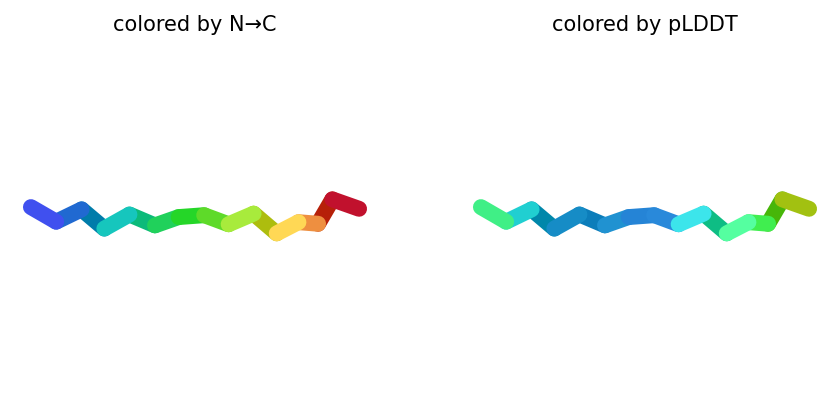

2025-11-17 09:20:24,294 reranking models by 'plddt' metric
2025-11-17 09:20:24,295 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=79.7 pTM=0.0314
2025-11-17 09:20:24,295 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=78 pTM=0.0311
2025-11-17 09:20:24,295 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=77.9 pTM=0.0309
2025-11-17 09:20:24,295 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=76.9 pTM=0.0313
2025-11-17 09:20:24,296 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.2 pTM=0.03
2025-11-17 09:20:25,842 Query 116/146: peptide_238_IC50_466.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:20:26,122 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


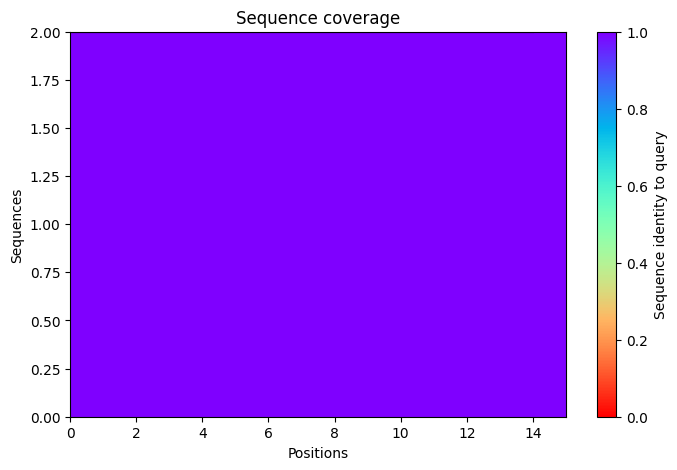

2025-11-17 09:20:37,438 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=84.6 pTM=0.0438
2025-11-17 09:20:40,018 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=86.4 pTM=0.0455 tol=0.0726
2025-11-17 09:20:42,597 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.7 pTM=0.0436 tol=0.0733
2025-11-17 09:20:45,173 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=81.4 pTM=0.0424 tol=0.0574
2025-11-17 09:20:45,173 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


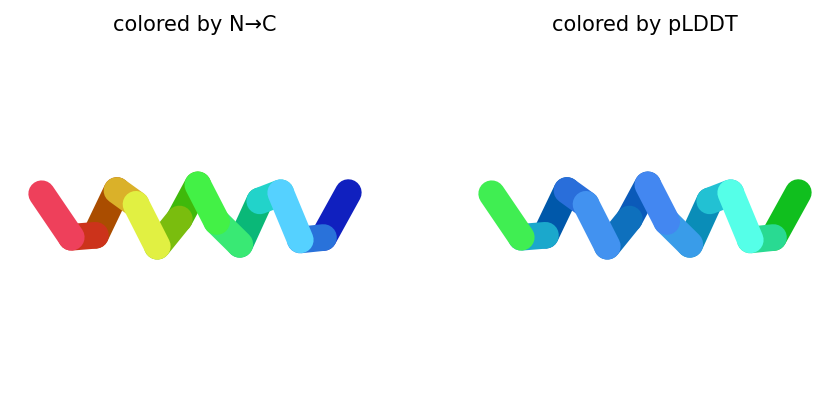

2025-11-17 09:20:47,806 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=76.1 pTM=0.0397
2025-11-17 09:20:50,390 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70.9 pTM=0.0373 tol=0.248
2025-11-17 09:20:52,972 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69 pTM=0.0369 tol=0.0506
2025-11-17 09:20:55,559 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.2 pTM=0.0369 tol=0.0526
2025-11-17 09:20:55,559 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


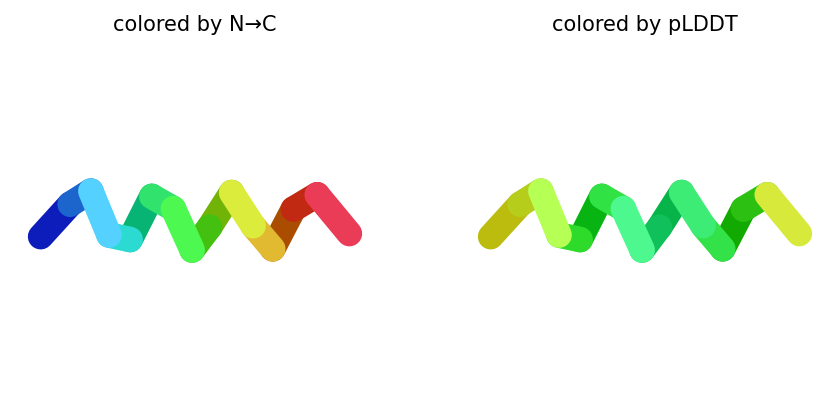

2025-11-17 09:20:58,201 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=68.2 pTM=0.0295
2025-11-17 09:21:00,788 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=63.3 pTM=0.0277 tol=4.02
2025-11-17 09:21:03,382 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.9 pTM=0.0278 tol=2.19
2025-11-17 09:21:05,979 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.2 pTM=0.0279 tol=0.549
2025-11-17 09:21:05,979 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


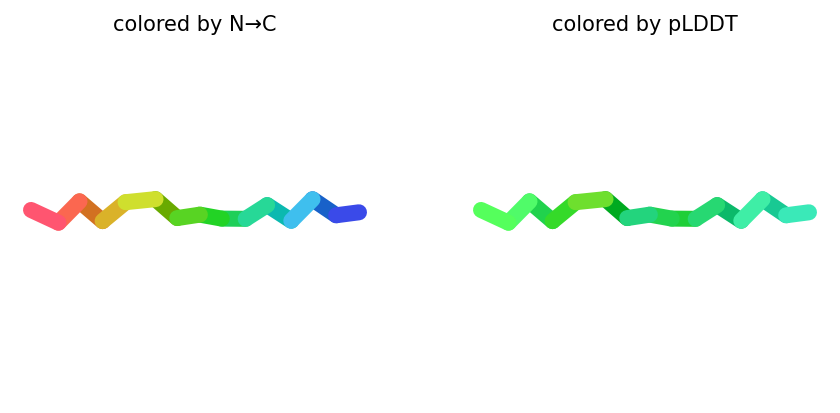

2025-11-17 09:21:08,627 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=71.8 pTM=0.0339
2025-11-17 09:21:11,224 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=74.6 pTM=0.0366 tol=0.157
2025-11-17 09:21:13,819 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=70.6 pTM=0.0355 tol=0.349
2025-11-17 09:21:16,414 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.9 pTM=0.0344 tol=0.225
2025-11-17 09:21:16,415 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


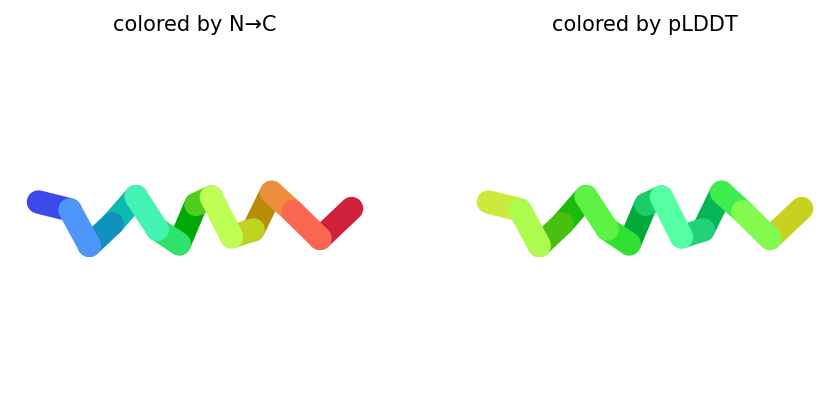

2025-11-17 09:21:19,168 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=63.9 pTM=0.03
2025-11-17 09:21:21,758 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.4 pTM=0.0285 tol=1.61
2025-11-17 09:21:24,344 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=60.5 pTM=0.0281 tol=1.39
2025-11-17 09:21:26,934 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=62.3 pTM=0.0275 tol=0.663
2025-11-17 09:21:26,934 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


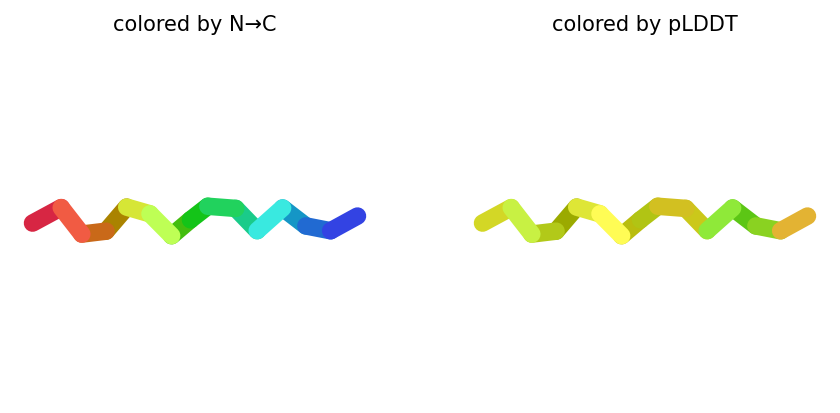

2025-11-17 09:21:26,984 reranking models by 'plddt' metric
2025-11-17 09:21:26,986 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=81.4 pTM=0.0424
2025-11-17 09:21:26,986 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=74.2 pTM=0.0279
2025-11-17 09:21:26,986 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=69.9 pTM=0.0344
2025-11-17 09:21:26,986 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=69.2 pTM=0.0369
2025-11-17 09:21:26,987 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=62.3 pTM=0.0275
2025-11-17 09:21:28,221 Query 117/146: peptide_239_IC50_466.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:21:28,509 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


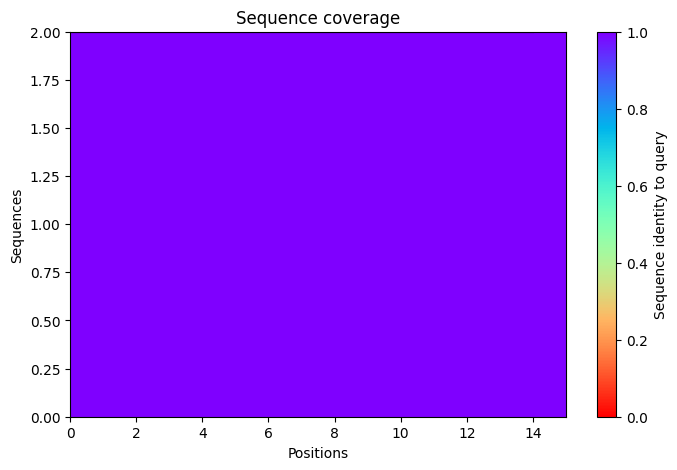

2025-11-17 09:21:40,832 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66 pTM=0.0289
2025-11-17 09:21:43,412 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=74.1 pTM=0.0286 tol=0.546
2025-11-17 09:21:45,992 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.1 pTM=0.0289 tol=0.149
2025-11-17 09:21:48,569 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.1 pTM=0.0284 tol=0.448
2025-11-17 09:21:48,569 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


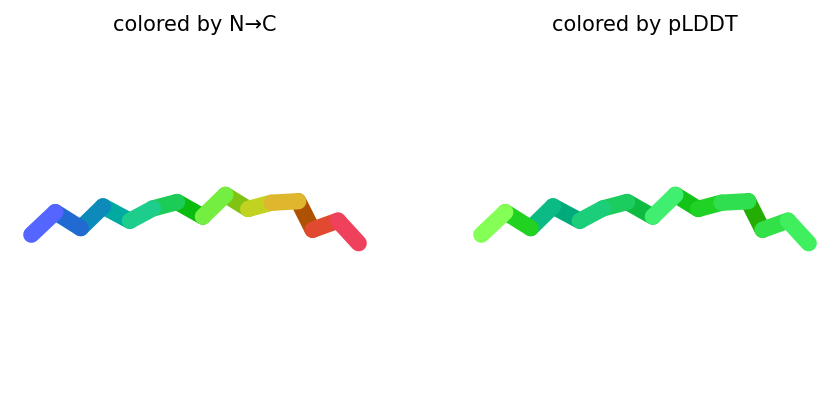

2025-11-17 09:21:51,215 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.8 pTM=0.0275
2025-11-17 09:21:53,798 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=73.3 pTM=0.0279 tol=0.783
2025-11-17 09:21:56,386 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.8 pTM=0.0282 tol=0.475
2025-11-17 09:21:58,971 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.3 pTM=0.0276 tol=0.123
2025-11-17 09:21:58,971 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


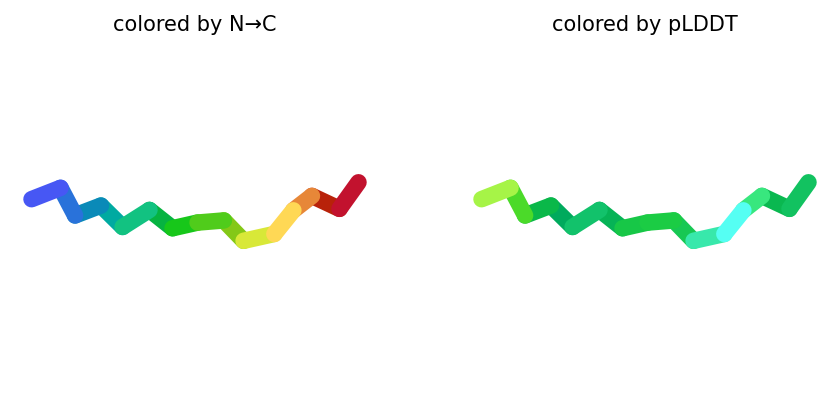

2025-11-17 09:22:01,611 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.6 pTM=0.0275
2025-11-17 09:22:04,204 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.4 pTM=0.0272 tol=0.85
2025-11-17 09:22:06,800 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=73.7 pTM=0.0271 tol=0.239
2025-11-17 09:22:09,396 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.5 pTM=0.0274 tol=0.378
2025-11-17 09:22:09,397 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


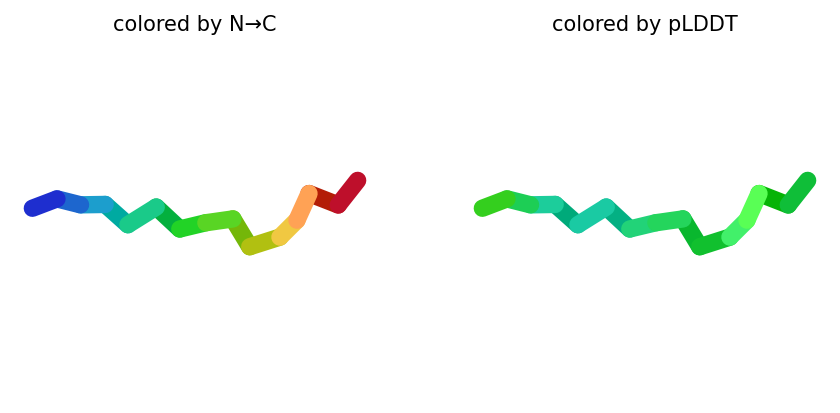

2025-11-17 09:22:12,040 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.2 pTM=0.0276
2025-11-17 09:22:14,634 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.9 pTM=0.0273 tol=0.464
2025-11-17 09:22:17,228 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=74.2 pTM=0.0273 tol=0.456
2025-11-17 09:22:19,819 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=73.9 pTM=0.0271 tol=0.174
2025-11-17 09:22:19,820 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


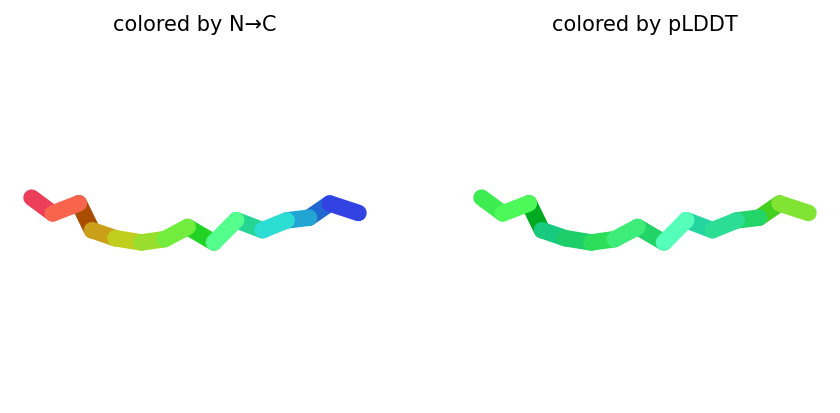

2025-11-17 09:22:22,467 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.9 pTM=0.0271
2025-11-17 09:22:25,056 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=69.8 pTM=0.0275 tol=1.19
2025-11-17 09:22:27,639 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=71.6 pTM=0.0273 tol=0.341
2025-11-17 09:22:30,228 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=71.4 pTM=0.0277 tol=0.314
2025-11-17 09:22:30,229 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


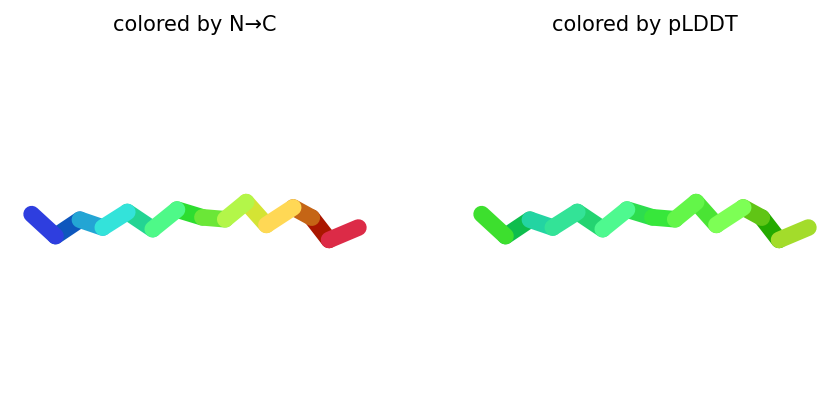

2025-11-17 09:22:30,299 reranking models by 'plddt' metric
2025-11-17 09:22:30,299 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=74.5 pTM=0.0274
2025-11-17 09:22:30,299 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=74.3 pTM=0.0276
2025-11-17 09:22:30,299 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=73.9 pTM=0.0271
2025-11-17 09:22:30,300 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73.1 pTM=0.0284
2025-11-17 09:22:30,300 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=71.4 pTM=0.0277
2025-11-17 09:22:31,607 Query 118/146: peptide_240_IC50_470.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:22:31,885 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


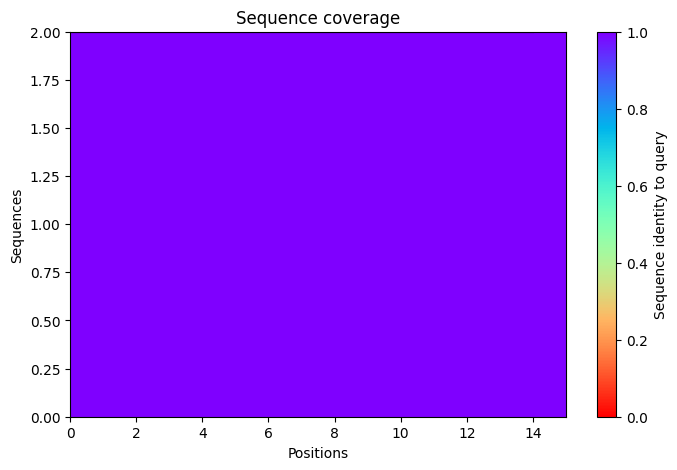

2025-11-17 09:22:47,797 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.9 pTM=0.0353
2025-11-17 09:22:50,372 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=61.6 pTM=0.03 tol=1.97
2025-11-17 09:22:52,952 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=65.4 pTM=0.0296 tol=5.49
2025-11-17 09:22:55,531 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=70.1 pTM=0.0286 tol=0.249
2025-11-17 09:22:55,532 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


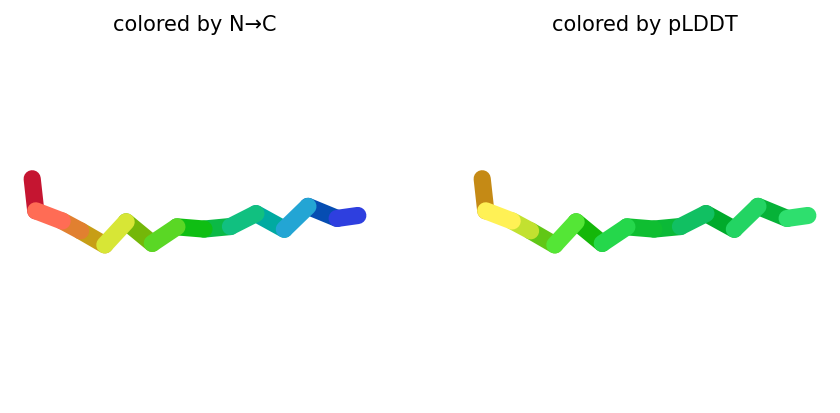

2025-11-17 09:22:58,174 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=64.3 pTM=0.0297
2025-11-17 09:23:00,757 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.4 pTM=0.0272 tol=2.87
2025-11-17 09:23:03,340 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=65.1 pTM=0.0272 tol=2.98
2025-11-17 09:23:05,923 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=66.4 pTM=0.0271 tol=0.192
2025-11-17 09:23:05,924 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


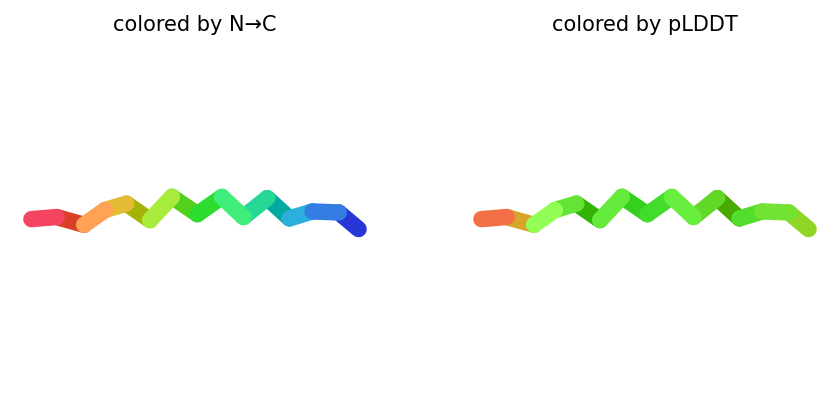

2025-11-17 09:23:08,562 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.1 pTM=0.0284
2025-11-17 09:23:11,154 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.9 pTM=0.0282 tol=0.386
2025-11-17 09:23:13,749 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.7 pTM=0.0282 tol=0.258
2025-11-17 09:23:16,344 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=74.7 pTM=0.0278 tol=0.0804
2025-11-17 09:23:16,345 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


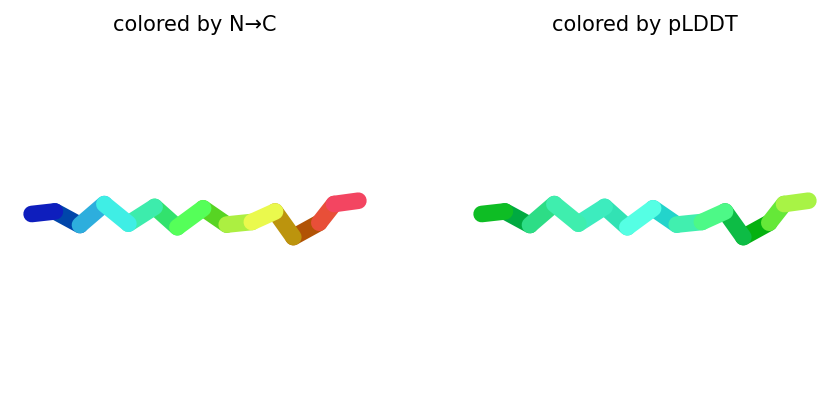

2025-11-17 09:23:19,005 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68 pTM=0.028
2025-11-17 09:23:21,608 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=71.5 pTM=0.0276 tol=0.403
2025-11-17 09:23:24,207 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72.1 pTM=0.0278 tol=0.245
2025-11-17 09:23:26,808 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.1 pTM=0.0274 tol=0.137
2025-11-17 09:23:26,808 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


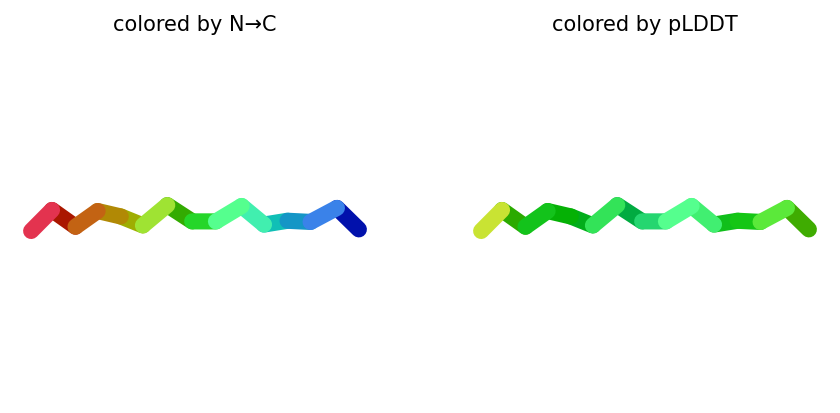

2025-11-17 09:23:29,450 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=65.8 pTM=0.0303
2025-11-17 09:23:32,043 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.5 pTM=0.0282 tol=2
2025-11-17 09:23:34,640 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=63 pTM=0.0276 tol=3.25
2025-11-17 09:23:37,231 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=66.5 pTM=0.0281 tol=0.852
2025-11-17 09:23:37,232 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


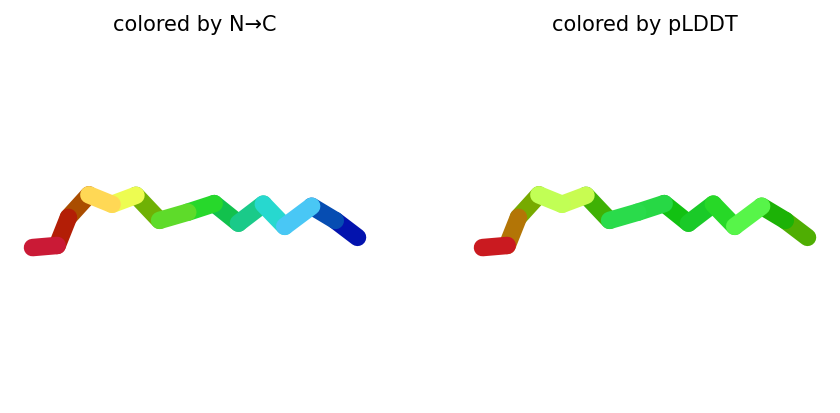

2025-11-17 09:23:37,282 reranking models by 'plddt' metric
2025-11-17 09:23:37,282 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=74.7 pTM=0.0278
2025-11-17 09:23:37,283 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=71.1 pTM=0.0274
2025-11-17 09:23:37,283 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=70.1 pTM=0.0286
2025-11-17 09:23:37,283 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=66.5 pTM=0.0281
2025-11-17 09:23:37,283 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=66.4 pTM=0.0271
2025-11-17 09:23:38,836 Query 119/146: peptide_241_IC50_465.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:23:39,113 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


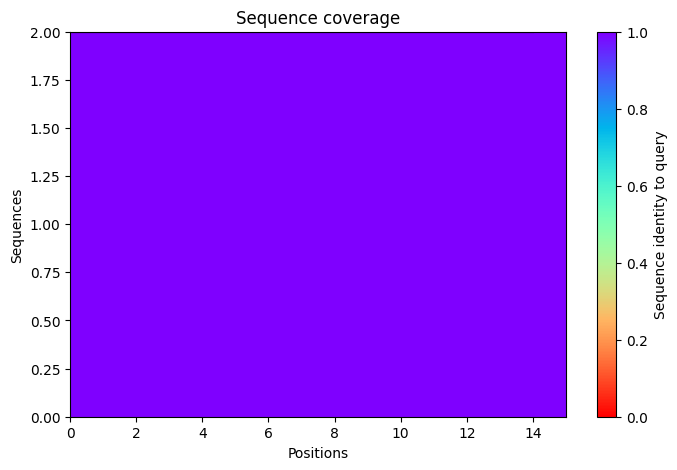

2025-11-17 09:23:51,556 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=83.6 pTM=0.044
2025-11-17 09:23:54,131 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83.2 pTM=0.0445 tol=0.103
2025-11-17 09:23:56,708 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.9 pTM=0.0443 tol=0.0558
2025-11-17 09:23:59,286 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.1 pTM=0.0444 tol=0.13
2025-11-17 09:23:59,287 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


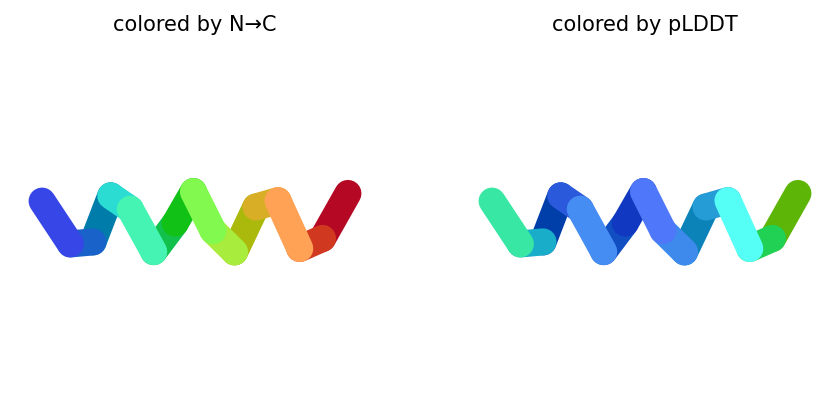

2025-11-17 09:24:01,921 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=73.4 pTM=0.0383
2025-11-17 09:24:04,499 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.4 pTM=0.0379 tol=0.149
2025-11-17 09:24:07,079 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69 pTM=0.0367 tol=0.223
2025-11-17 09:24:09,664 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=70.4 pTM=0.0377 tol=0.105
2025-11-17 09:24:09,665 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


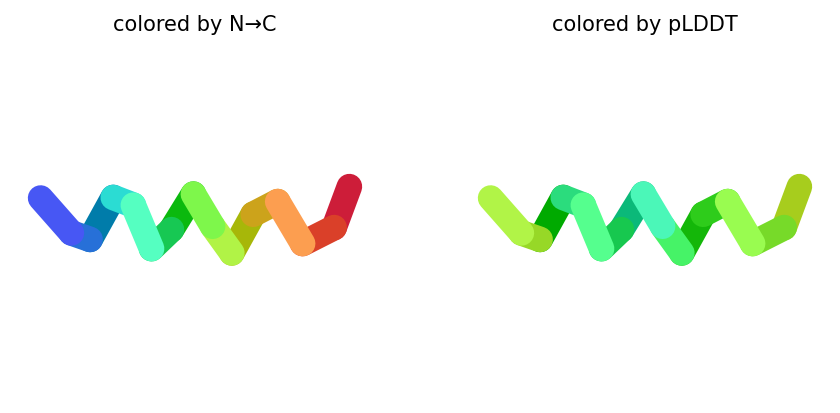

2025-11-17 09:24:12,323 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=78.8 pTM=0.0376
2025-11-17 09:24:14,906 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=83.3 pTM=0.0417 tol=0.226
2025-11-17 09:24:17,497 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=84.9 pTM=0.0422 tol=0.0646
2025-11-17 09:24:20,090 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=85 pTM=0.0427 tol=0.0776
2025-11-17 09:24:20,090 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


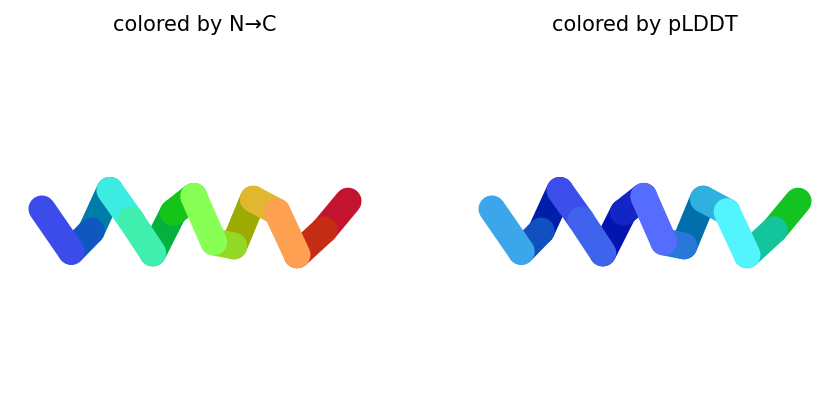

2025-11-17 09:24:22,739 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=80.8 pTM=0.0417
2025-11-17 09:24:25,335 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=84.2 pTM=0.0444 tol=0.233
2025-11-17 09:24:27,929 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=84.3 pTM=0.0446 tol=0.12
2025-11-17 09:24:30,523 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=85.1 pTM=0.0447 tol=0.0766
2025-11-17 09:24:30,524 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


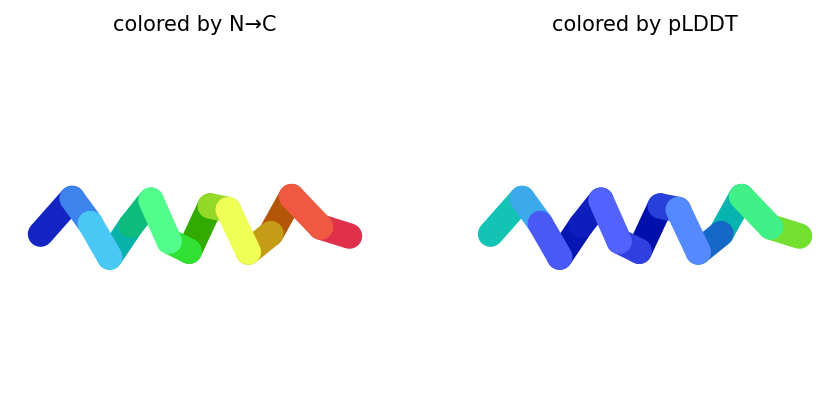

2025-11-17 09:24:33,167 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=83.5 pTM=0.0426
2025-11-17 09:24:35,760 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=84.8 pTM=0.0445 tol=0.217
2025-11-17 09:24:38,351 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=85.5 pTM=0.0449 tol=0.0492
2025-11-17 09:24:40,939 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=84.7 pTM=0.0443 tol=0.195
2025-11-17 09:24:40,939 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


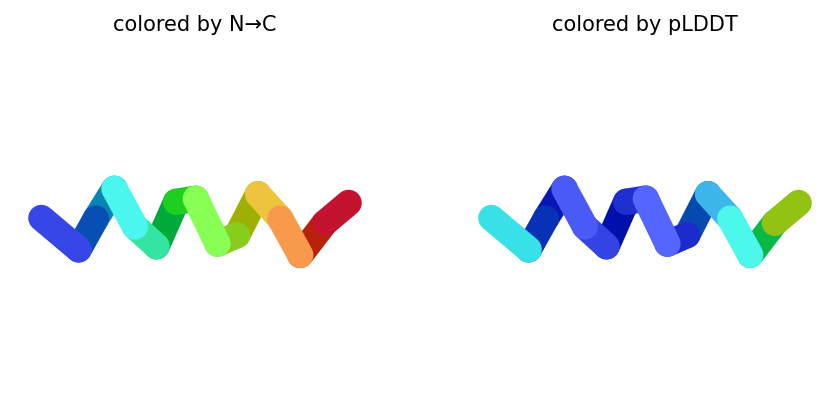

2025-11-17 09:24:40,991 reranking models by 'plddt' metric
2025-11-17 09:24:40,991 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=85.1 pTM=0.0447
2025-11-17 09:24:40,992 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=85 pTM=0.0427
2025-11-17 09:24:40,992 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=84.7 pTM=0.0443
2025-11-17 09:24:40,992 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=82.1 pTM=0.0444
2025-11-17 09:24:40,992 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=70.4 pTM=0.0377
2025-11-17 09:24:42,225 Query 120/146: peptide_242_IC50_473.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:24:42,508 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


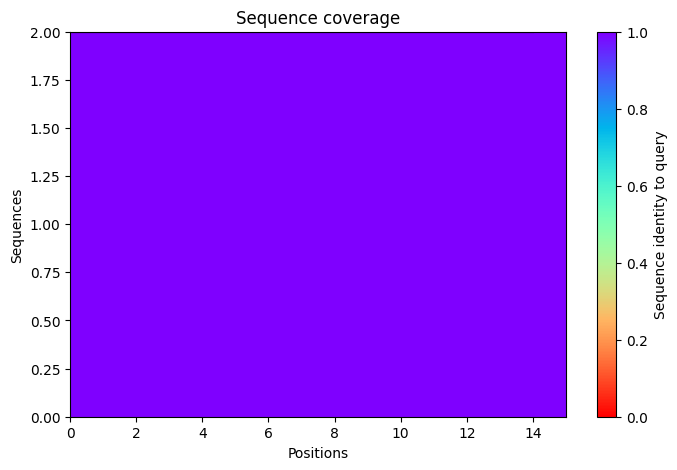

2025-11-17 09:24:54,863 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=83.8 pTM=0.0355
2025-11-17 09:24:57,438 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=83.1 pTM=0.0355 tol=0.151
2025-11-17 09:25:00,018 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=80.1 pTM=0.0344 tol=0.146
2025-11-17 09:25:02,602 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=76.9 pTM=0.0331 tol=0.16
2025-11-17 09:25:02,603 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


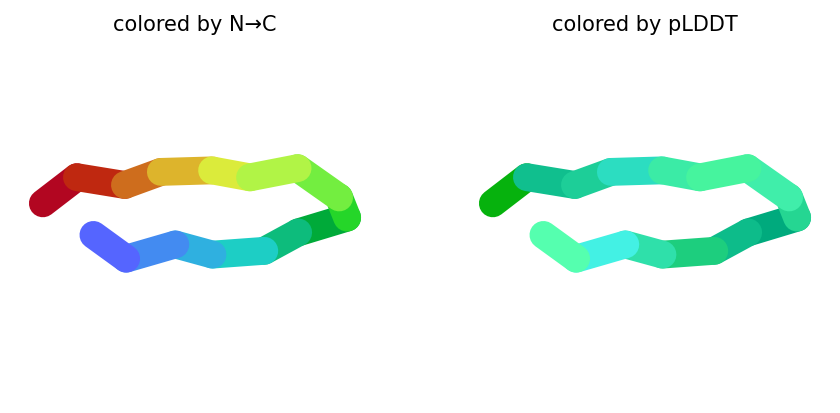

2025-11-17 09:25:05,245 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=79.6 pTM=0.0339
2025-11-17 09:25:07,830 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70.4 pTM=0.0284 tol=6.86
2025-11-17 09:25:10,414 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.7 pTM=0.0287 tol=3.75
2025-11-17 09:25:13,006 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=76.8 pTM=0.0286 tol=0.187
2025-11-17 09:25:13,007 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


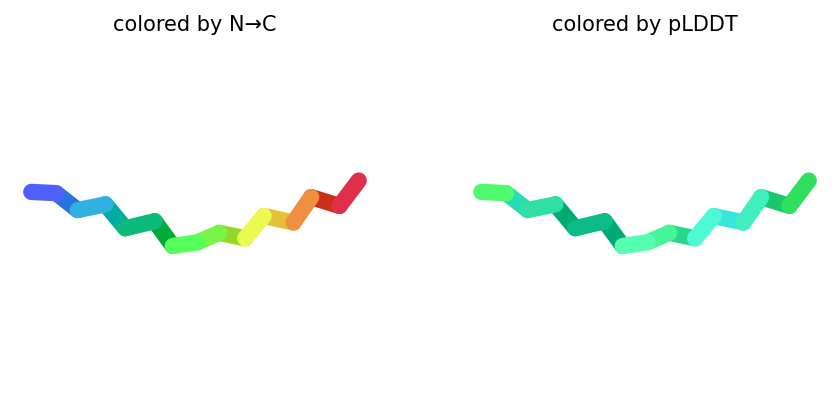

2025-11-17 09:25:15,649 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=77.7 pTM=0.0319
2025-11-17 09:25:18,243 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.1 pTM=0.0296 tol=0.33
2025-11-17 09:25:20,837 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=70.5 pTM=0.0276 tol=0.862
2025-11-17 09:25:23,429 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.1 pTM=0.0275 tol=6.91
2025-11-17 09:25:23,430 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


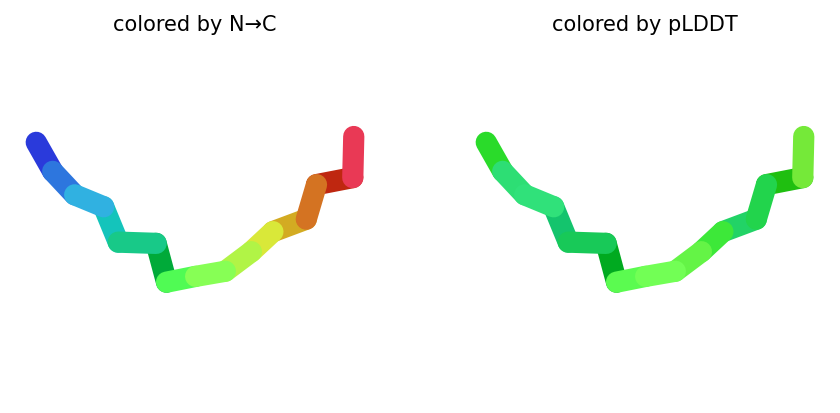

2025-11-17 09:25:26,106 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=80.1 pTM=0.0344
2025-11-17 09:25:28,692 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=76.2 pTM=0.0324 tol=0.32
2025-11-17 09:25:31,283 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=69.5 pTM=0.0298 tol=0.736
2025-11-17 09:25:33,869 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=68.9 pTM=0.029 tol=8.47
2025-11-17 09:25:33,870 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


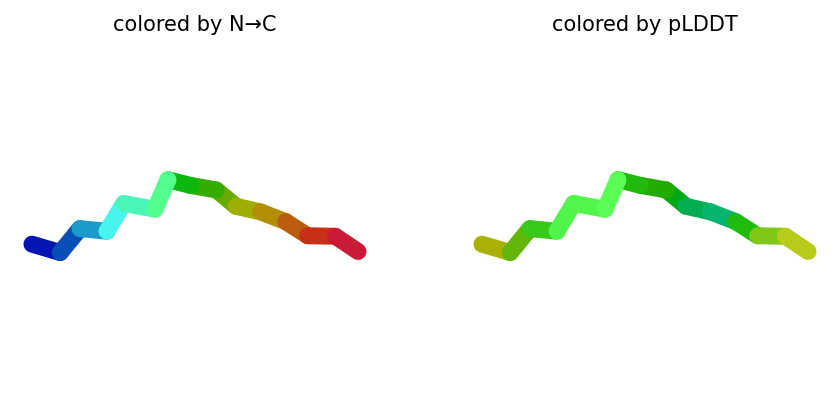

2025-11-17 09:25:36,514 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=82.7 pTM=0.0341
2025-11-17 09:25:39,097 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.4 pTM=0.0323 tol=0.12
2025-11-17 09:25:41,684 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.1 pTM=0.0315 tol=0.23
2025-11-17 09:25:44,266 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=73.4 pTM=0.0307 tol=0.193
2025-11-17 09:25:44,267 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


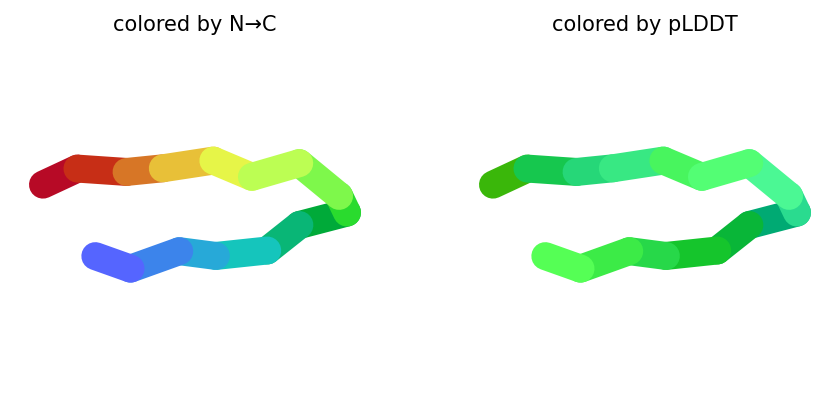

2025-11-17 09:25:44,315 reranking models by 'plddt' metric
2025-11-17 09:25:44,316 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=76.9 pTM=0.0331
2025-11-17 09:25:44,316 rank_002_alphafold2_ptm_model_2_seed_000 pLDDT=76.8 pTM=0.0286
2025-11-17 09:25:44,316 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=73.4 pTM=0.0307
2025-11-17 09:25:44,317 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=72.1 pTM=0.0275
2025-11-17 09:25:44,317 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=68.9 pTM=0.029
2025-11-17 09:25:45,513 Query 121/146: peptide_243_IC50_473.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:25:45,790 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


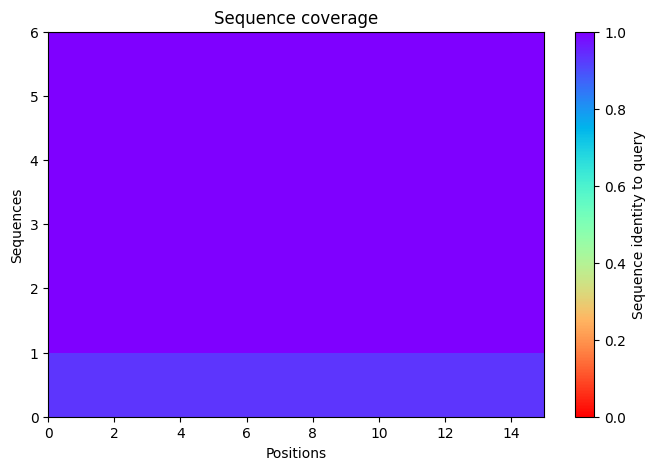

2025-11-17 09:25:58,072 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=70.5 pTM=0.03
2025-11-17 09:26:00,646 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=71.6 pTM=0.0295 tol=0.326
2025-11-17 09:26:03,227 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=71.7 pTM=0.0298 tol=0.355
2025-11-17 09:26:05,806 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.1 pTM=0.0298 tol=0.385
2025-11-17 09:26:05,807 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


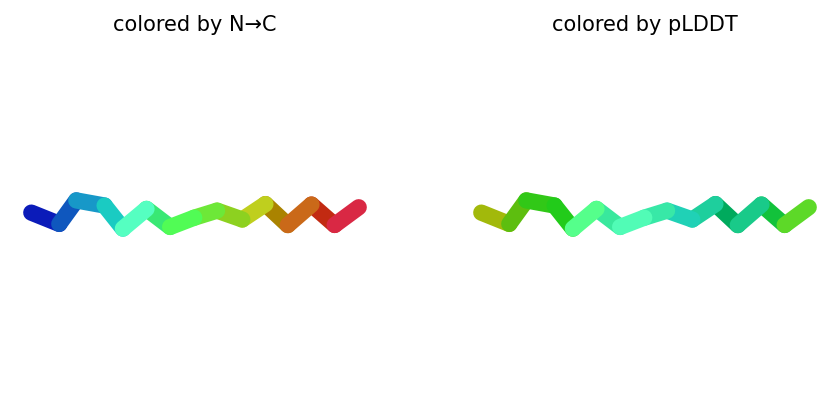

2025-11-17 09:26:08,441 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.5 pTM=0.028
2025-11-17 09:26:11,024 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.7 pTM=0.0285 tol=0.607
2025-11-17 09:26:13,612 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.2 pTM=0.0288 tol=0.13
2025-11-17 09:26:16,195 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.6 pTM=0.0288 tol=0.15
2025-11-17 09:26:16,195 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


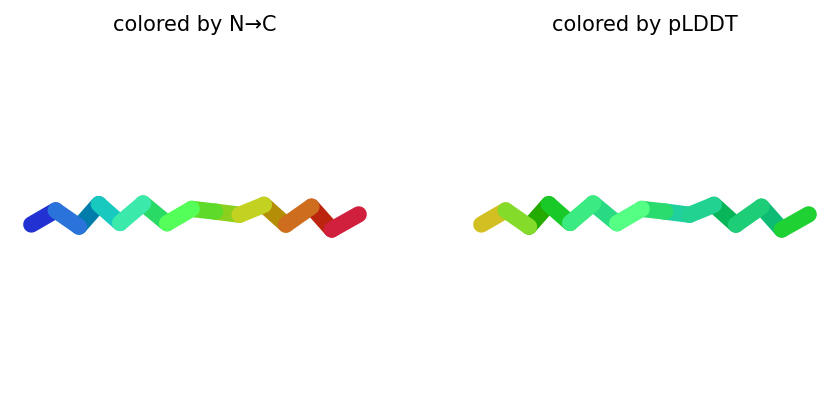

2025-11-17 09:26:18,838 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=69.8 pTM=0.0285
2025-11-17 09:26:21,432 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75.6 pTM=0.0293 tol=0.426
2025-11-17 09:26:24,026 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=78 pTM=0.0298 tol=0.161
2025-11-17 09:26:26,626 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75.5 pTM=0.0304 tol=1.24
2025-11-17 09:26:26,626 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


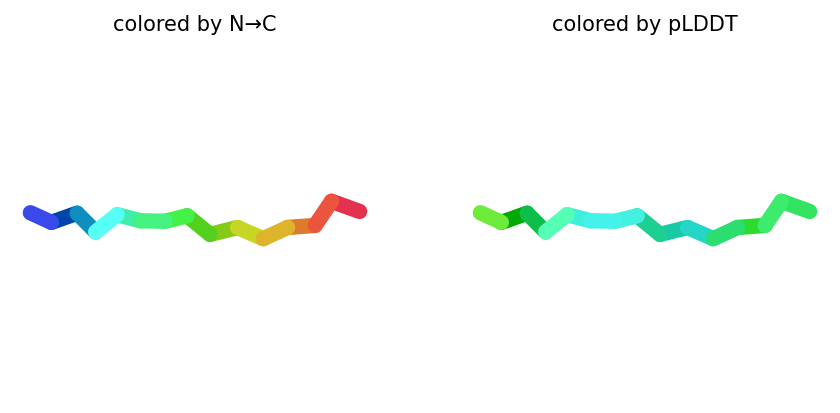

2025-11-17 09:26:29,272 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=70.4 pTM=0.0278
2025-11-17 09:26:31,867 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.6 pTM=0.028 tol=0.304
2025-11-17 09:26:34,462 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72.9 pTM=0.0284 tol=0.215
2025-11-17 09:26:37,062 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.4 pTM=0.0286 tol=0.177
2025-11-17 09:26:37,062 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


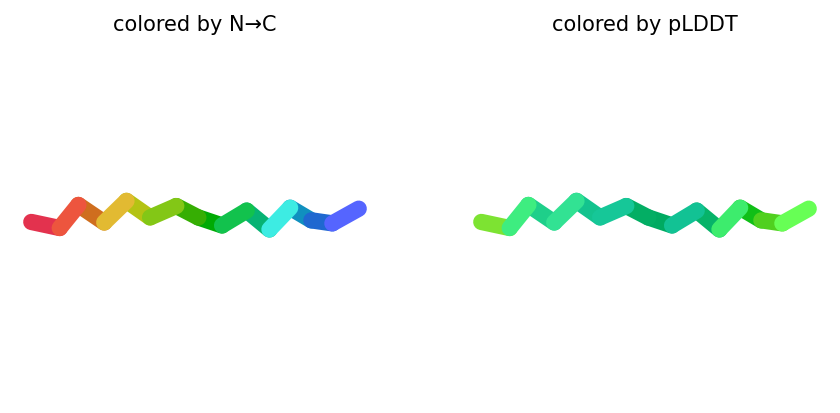

2025-11-17 09:26:39,735 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=66.9 pTM=0.0285
2025-11-17 09:26:42,328 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.1 pTM=0.0281 tol=1.07
2025-11-17 09:26:44,916 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=74.1 pTM=0.0288 tol=0.263
2025-11-17 09:26:47,504 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=73.2 pTM=0.0288 tol=0.504
2025-11-17 09:26:47,505 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


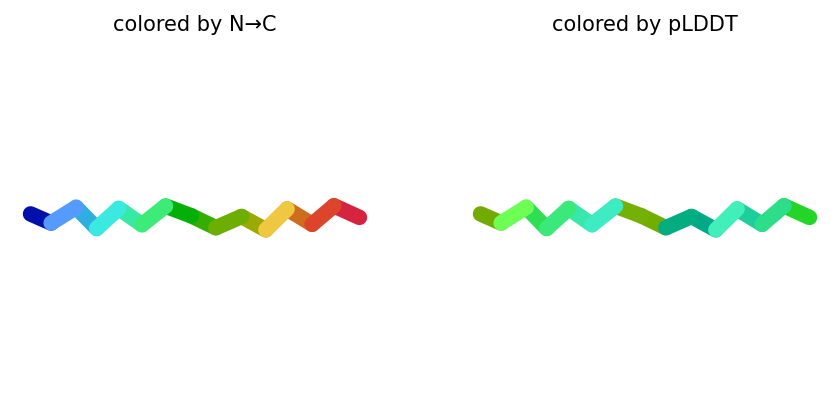

2025-11-17 09:26:47,556 reranking models by 'plddt' metric
2025-11-17 09:26:47,556 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=75.5 pTM=0.0304
2025-11-17 09:26:47,556 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=74.4 pTM=0.0286
2025-11-17 09:26:47,558 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=73.2 pTM=0.0288
2025-11-17 09:26:47,558 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73.1 pTM=0.0298
2025-11-17 09:26:47,558 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.6 pTM=0.0288
2025-11-17 09:26:49,354 Query 122/146: peptide_244_IC50_476.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:26:49,626 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


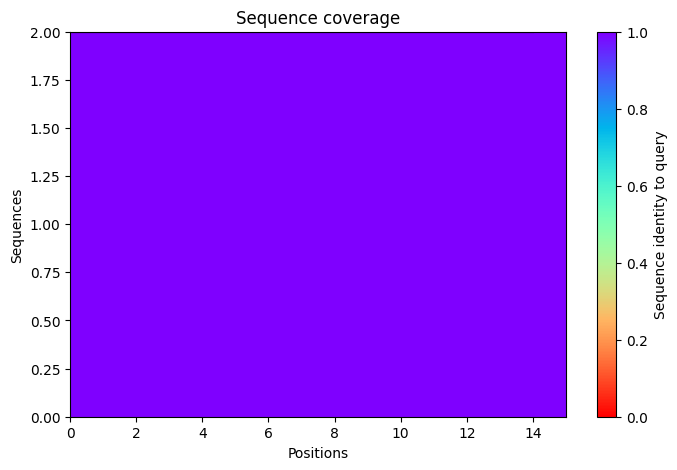

2025-11-17 09:27:00,936 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=69.2 pTM=0.0367
2025-11-17 09:27:03,510 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=68.1 pTM=0.0357 tol=0.332
2025-11-17 09:27:06,087 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=66.5 pTM=0.0357 tol=0.222
2025-11-17 09:27:08,667 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=66.6 pTM=0.0355 tol=0.166
2025-11-17 09:27:08,668 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


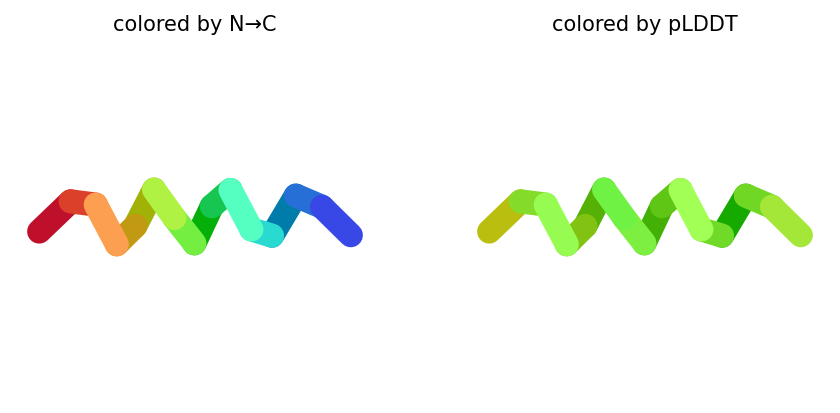

2025-11-17 09:27:11,304 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.6 pTM=0.0322
2025-11-17 09:27:13,881 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=59.5 pTM=0.0322 tol=0.162
2025-11-17 09:27:16,465 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=59.4 pTM=0.0317 tol=0.17
2025-11-17 09:27:19,049 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=59.2 pTM=0.0304 tol=0.248
2025-11-17 09:27:19,049 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


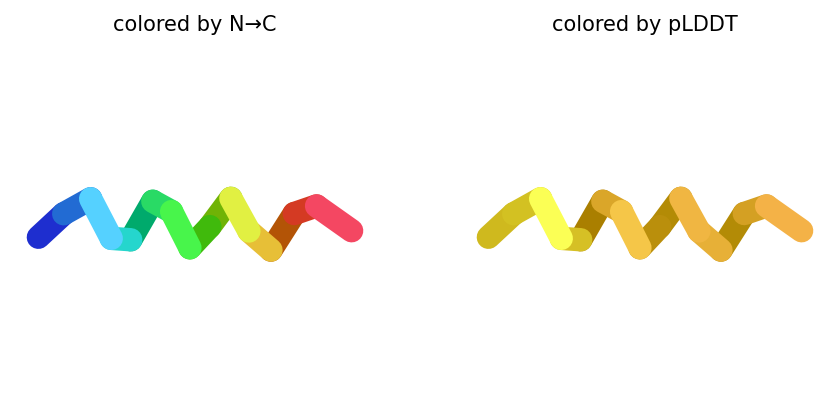

2025-11-17 09:27:21,685 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=61.8 pTM=0.0279
2025-11-17 09:27:24,273 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=64.8 pTM=0.0278 tol=2.76
2025-11-17 09:27:26,864 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=68.4 pTM=0.028 tol=0.87
2025-11-17 09:27:29,458 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=70.6 pTM=0.0277 tol=0.305
2025-11-17 09:27:29,459 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


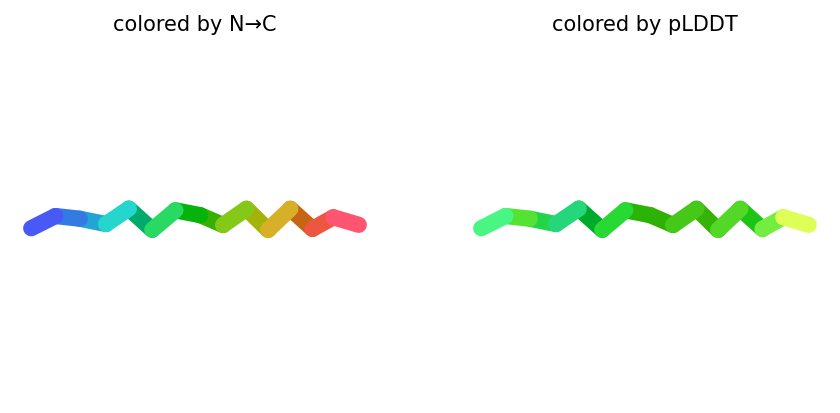

2025-11-17 09:27:32,102 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=66.6 pTM=0.033
2025-11-17 09:27:34,696 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=64.6 pTM=0.0329 tol=0.66
2025-11-17 09:27:37,288 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=61.8 pTM=0.031 tol=0.83
2025-11-17 09:27:39,886 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=61.5 pTM=0.03 tol=0.42
2025-11-17 09:27:39,886 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


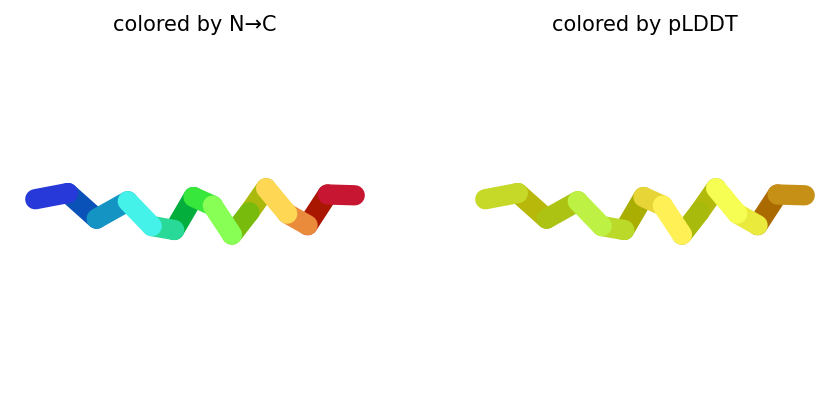

2025-11-17 09:27:42,559 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=60.6 pTM=0.0284
2025-11-17 09:27:45,147 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=58.3 pTM=0.0281 tol=1.69
2025-11-17 09:27:47,732 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=60.2 pTM=0.0277 tol=1.45
2025-11-17 09:27:50,320 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=60.8 pTM=0.0272 tol=1.02
2025-11-17 09:27:50,320 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


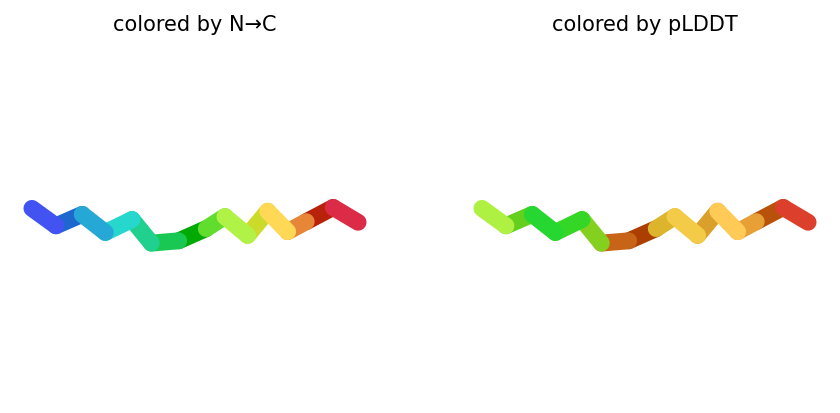

2025-11-17 09:27:50,369 reranking models by 'plddt' metric
2025-11-17 09:27:50,370 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=70.6 pTM=0.0277
2025-11-17 09:27:50,370 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=66.6 pTM=0.0355
2025-11-17 09:27:50,371 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=61.5 pTM=0.03
2025-11-17 09:27:50,371 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=60.8 pTM=0.0272
2025-11-17 09:27:50,371 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=59.2 pTM=0.0304
2025-11-17 09:27:51,762 Query 123/146: peptide_252_IC50_476.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:27:52,058 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


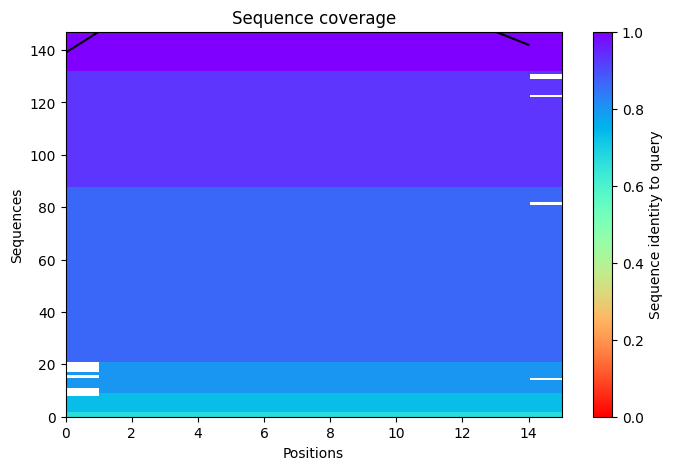

2025-11-17 09:28:05,443 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.4 pTM=0.0297
2025-11-17 09:28:08,027 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=73.4 pTM=0.0303 tol=0.597
2025-11-17 09:28:10,612 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.9 pTM=0.03 tol=0.136
2025-11-17 09:28:13,198 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.7 pTM=0.0298 tol=0.223
2025-11-17 09:28:13,198 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


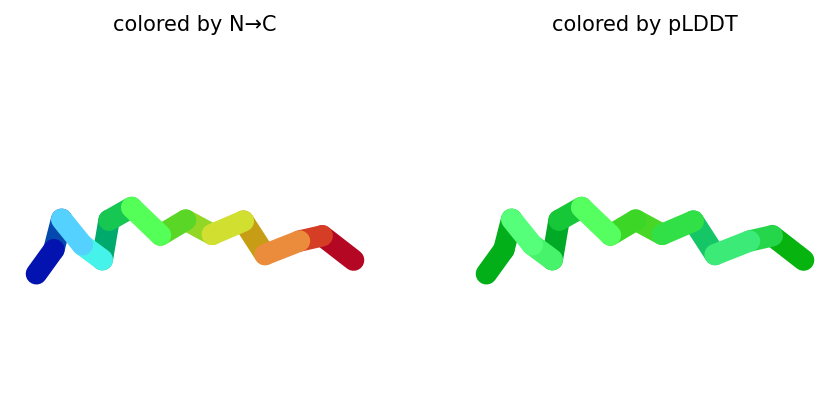

2025-11-17 09:28:15,850 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=70.1 pTM=0.0288
2025-11-17 09:28:18,440 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.8 pTM=0.03 tol=0.832
2025-11-17 09:28:21,032 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.8 pTM=0.0294 tol=0.21
2025-11-17 09:28:23,628 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.6 pTM=0.0288 tol=0.118
2025-11-17 09:28:23,628 alphafold2_ptm_model_2_seed_000 took 10.4s (3 recycles)


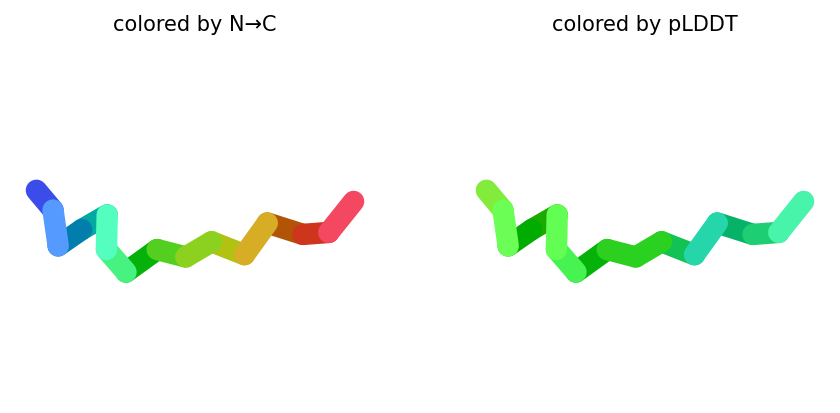

2025-11-17 09:28:26,291 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.8 pTM=0.0289
2025-11-17 09:28:28,895 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=75 pTM=0.029 tol=0.519
2025-11-17 09:28:31,501 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=73.4 pTM=0.0287 tol=0.918
2025-11-17 09:28:34,104 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=75 pTM=0.0286 tol=0.564
2025-11-17 09:28:34,105 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


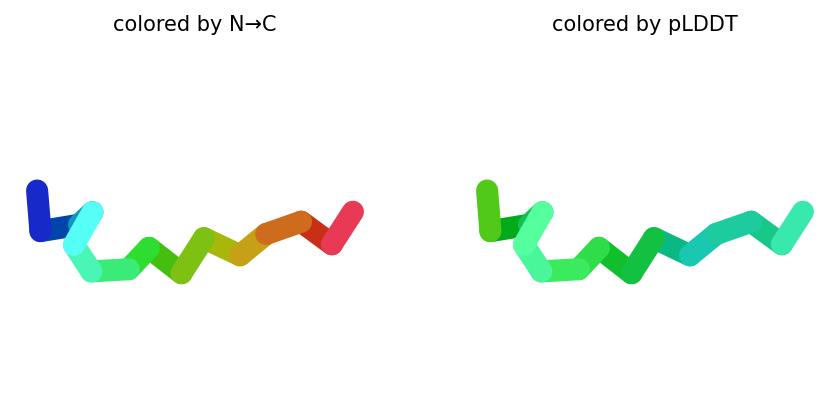

2025-11-17 09:28:36,763 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.5 pTM=0.0291
2025-11-17 09:28:39,365 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.1 pTM=0.0302 tol=1.73
2025-11-17 09:28:41,967 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=75.6 pTM=0.0313 tol=1.22
2025-11-17 09:28:44,574 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=75.2 pTM=0.0314 tol=0.235
2025-11-17 09:28:44,575 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


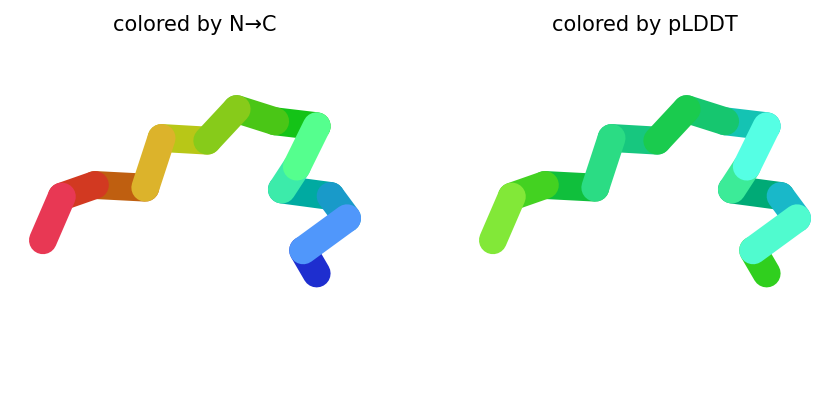

2025-11-17 09:28:47,239 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=69.4 pTM=0.0306
2025-11-17 09:28:49,835 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=73.7 pTM=0.0307 tol=0.911
2025-11-17 09:28:52,430 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=74.4 pTM=0.0302 tol=0.518
2025-11-17 09:28:55,026 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.8 pTM=0.0302 tol=0.0488
2025-11-17 09:28:55,027 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


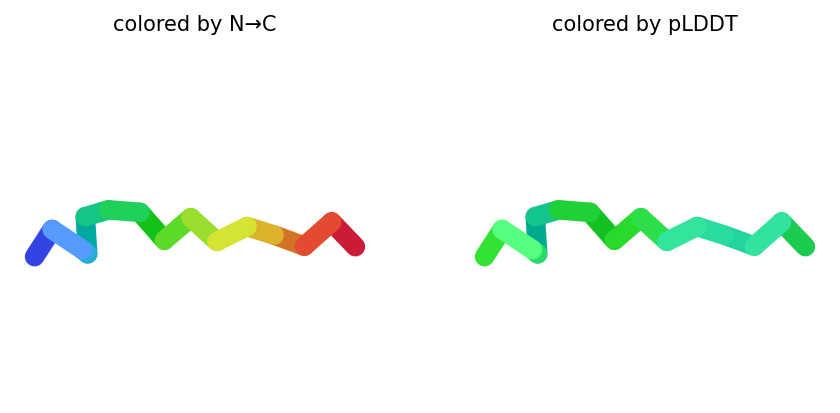

2025-11-17 09:28:55,107 reranking models by 'plddt' metric
2025-11-17 09:28:55,108 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=75.2 pTM=0.0314
2025-11-17 09:28:55,108 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=75 pTM=0.0286
2025-11-17 09:28:55,108 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=74.8 pTM=0.0302
2025-11-17 09:28:55,109 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=72.7 pTM=0.0298
2025-11-17 09:28:55,109 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.6 pTM=0.0288
2025-11-17 09:28:56,453 Query 124/146: peptide_255_IC50_478.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:28:56,730 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


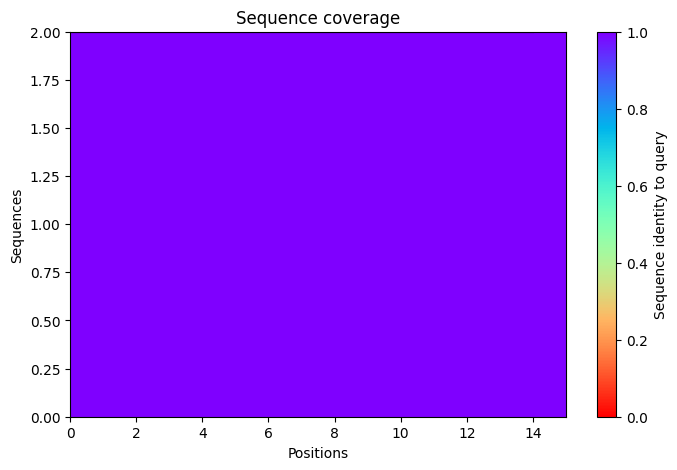

2025-11-17 09:29:10,556 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.5 pTM=0.0284
2025-11-17 09:29:13,132 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=63.2 pTM=0.0283 tol=0.867
2025-11-17 09:29:15,707 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=63.1 pTM=0.0283 tol=0.743
2025-11-17 09:29:18,288 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=62.9 pTM=0.0284 tol=0.16
2025-11-17 09:29:18,289 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


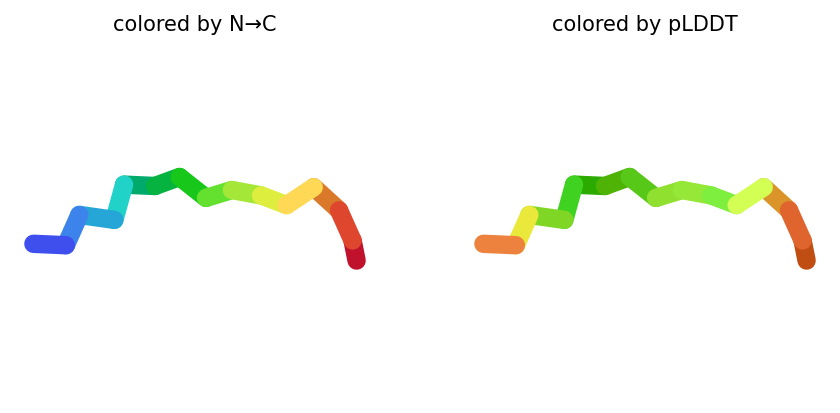

2025-11-17 09:29:20,924 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.9 pTM=0.0274
2025-11-17 09:29:23,503 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=64.6 pTM=0.0277 tol=0.195
2025-11-17 09:29:26,083 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=66.4 pTM=0.0276 tol=0.262
2025-11-17 09:29:28,669 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=66.5 pTM=0.0279 tol=0.165
2025-11-17 09:29:28,670 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


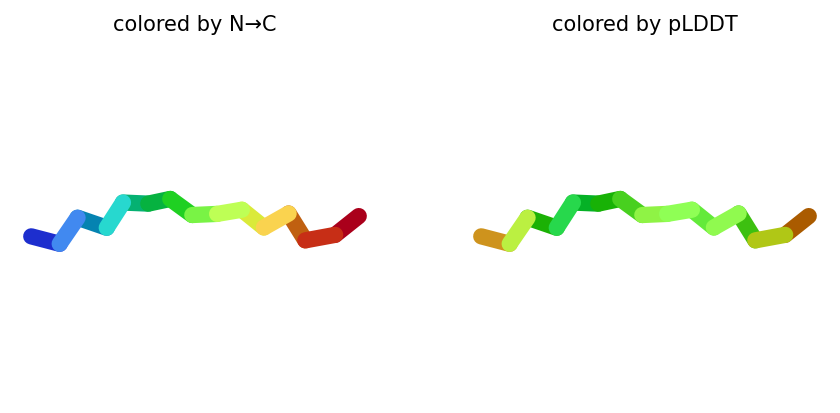

2025-11-17 09:29:31,307 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=63.2 pTM=0.0264
2025-11-17 09:29:33,897 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=68.2 pTM=0.0267 tol=1.3
2025-11-17 09:29:36,489 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=71 pTM=0.0269 tol=0.521
2025-11-17 09:29:39,085 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.4 pTM=0.0271 tol=0.104
2025-11-17 09:29:39,086 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


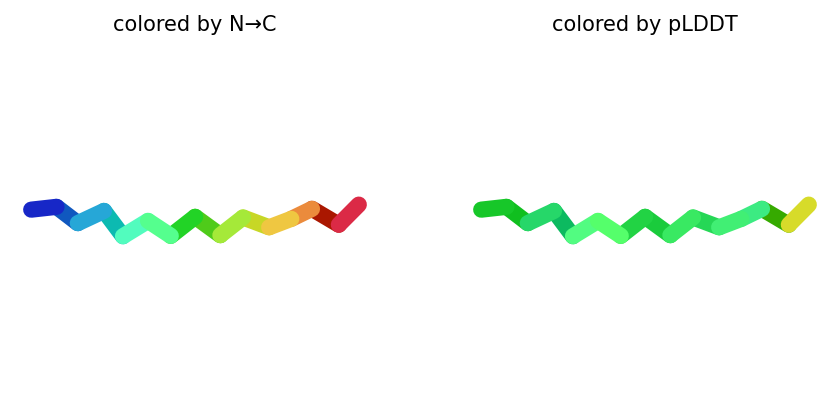

2025-11-17 09:29:41,729 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62.4 pTM=0.0271
2025-11-17 09:29:44,325 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=66.6 pTM=0.0276 tol=0.353
2025-11-17 09:29:46,924 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.7 pTM=0.0276 tol=0.142
2025-11-17 09:29:49,520 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=69.6 pTM=0.0276 tol=0.111
2025-11-17 09:29:49,521 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


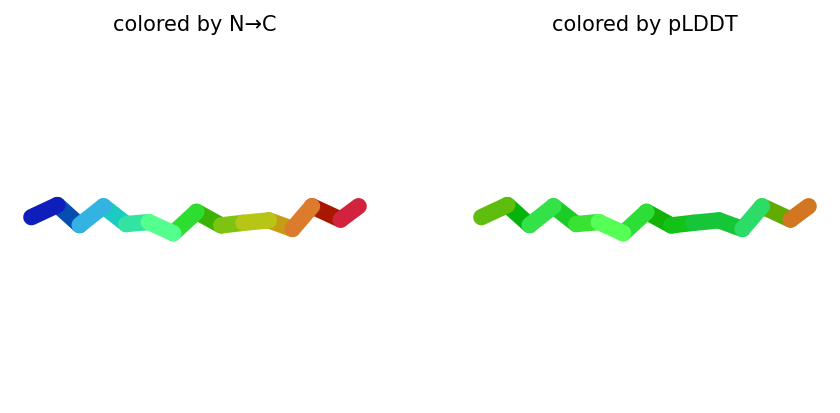

2025-11-17 09:29:52,166 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.7 pTM=0.0271
2025-11-17 09:29:54,762 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=62.8 pTM=0.0269 tol=0.97
2025-11-17 09:29:57,356 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=65.4 pTM=0.0269 tol=0.309
2025-11-17 09:29:59,949 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=67.8 pTM=0.0271 tol=0.315
2025-11-17 09:29:59,949 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


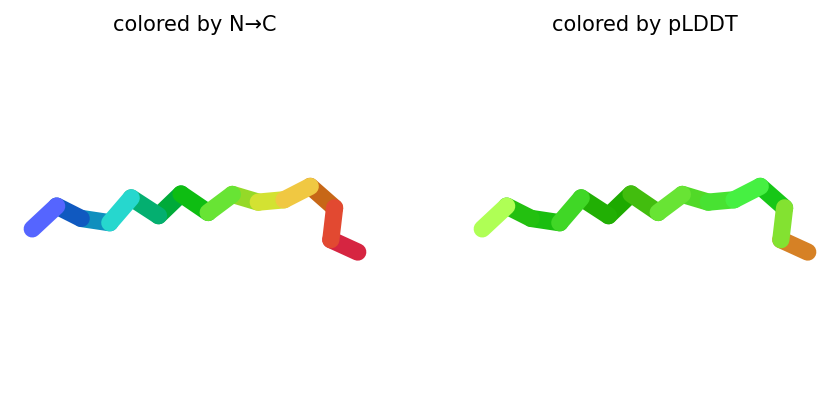

2025-11-17 09:30:00,005 reranking models by 'plddt' metric
2025-11-17 09:30:00,005 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=72.4 pTM=0.0271
2025-11-17 09:30:00,005 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=69.6 pTM=0.0276
2025-11-17 09:30:00,005 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=67.8 pTM=0.0271
2025-11-17 09:30:00,006 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=66.5 pTM=0.0279
2025-11-17 09:30:00,006 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=62.9 pTM=0.0284
2025-11-17 09:30:01,551 Query 125/146: peptide_256_IC50_481.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:30:01,836 Sleeping for 10s. Reason: PENDING


PENDING:   0%|          | 0/150 [elapsed: 00:10 remaining: ?]

2025-11-17 09:30:12,107 Sleeping for 7s. Reason: PENDING


PENDING:   0%|          | 0/150 [elapsed: 00:17 remaining: ?]

2025-11-17 09:30:19,378 Sleeping for 7s. Reason: PENDING


RUNNING:   5%|▍         | 7/150 [elapsed: 00:25 remaining: 08:32]

2025-11-17 09:30:26,643 Sleeping for 6s. Reason: RUNNING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:31 remaining: 00:00]


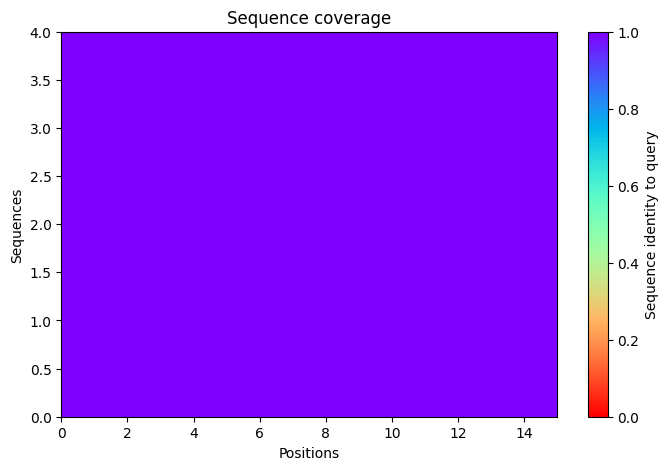

2025-11-17 09:30:38,012 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=68.6 pTM=0.0298
2025-11-17 09:30:40,591 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=68.8 pTM=0.0295 tol=0.322
2025-11-17 09:30:43,170 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=67.6 pTM=0.0294 tol=0.336
2025-11-17 09:30:45,753 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=68.9 pTM=0.0294 tol=0.214
2025-11-17 09:30:45,753 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


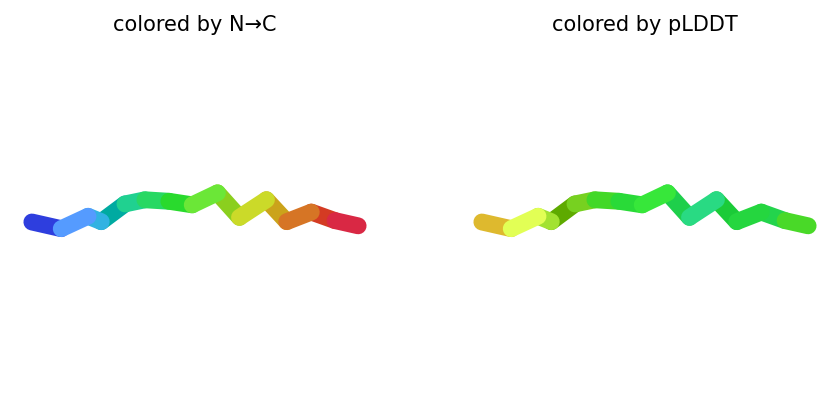

2025-11-17 09:30:48,388 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.5 pTM=0.028
2025-11-17 09:30:50,967 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.3 pTM=0.028 tol=0.401
2025-11-17 09:30:53,553 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68 pTM=0.0282 tol=0.405
2025-11-17 09:30:56,135 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=67.6 pTM=0.0281 tol=0.181
2025-11-17 09:30:56,137 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


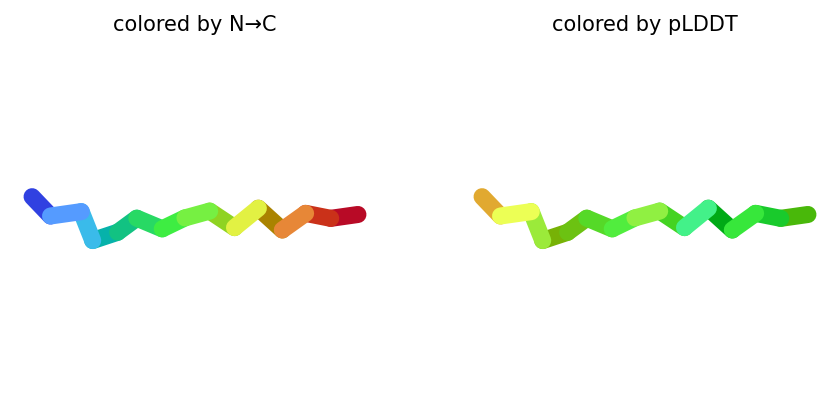

2025-11-17 09:30:58,803 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.3 pTM=0.0288
2025-11-17 09:31:01,393 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.8 pTM=0.0289 tol=0.566
2025-11-17 09:31:03,987 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=75.5 pTM=0.0287 tol=0.211
2025-11-17 09:31:06,581 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.6 pTM=0.0293 tol=0.286
2025-11-17 09:31:06,582 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


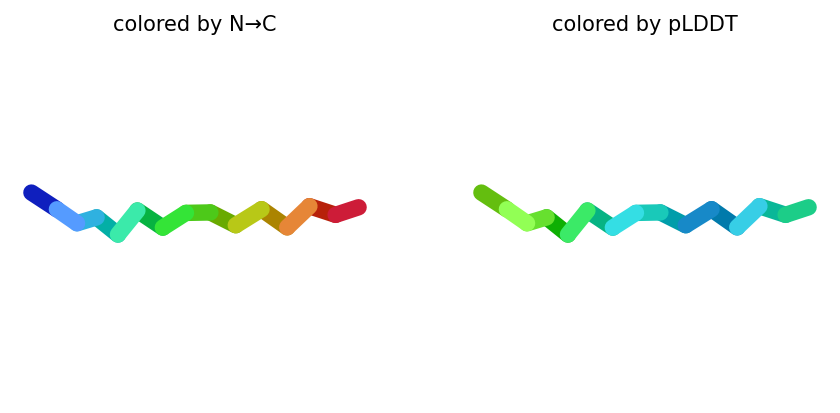

2025-11-17 09:31:09,234 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=66.4 pTM=0.0275
2025-11-17 09:31:11,833 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=68.7 pTM=0.0275 tol=0.351
2025-11-17 09:31:14,432 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=69.8 pTM=0.0275 tol=0.21
2025-11-17 09:31:17,032 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.8 pTM=0.0281 tol=0.284
2025-11-17 09:31:17,032 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


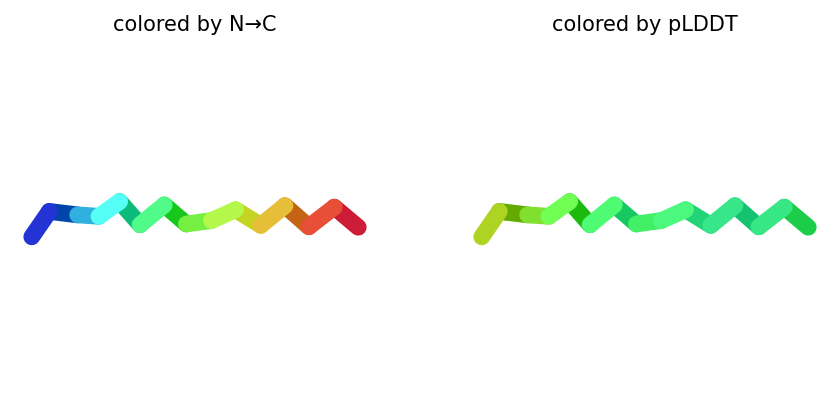

2025-11-17 09:31:19,679 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=67.2 pTM=0.028
2025-11-17 09:31:22,272 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=66.2 pTM=0.0276 tol=1.2
2025-11-17 09:31:24,864 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=70 pTM=0.028 tol=0.36
2025-11-17 09:31:27,451 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=69.8 pTM=0.028 tol=0.0654
2025-11-17 09:31:27,452 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


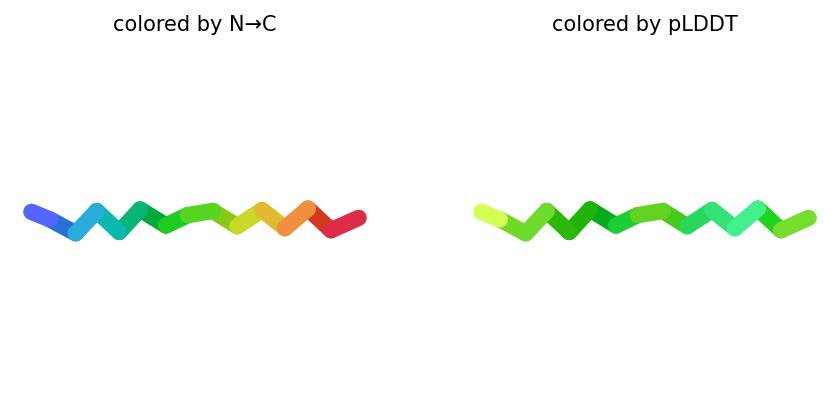

2025-11-17 09:31:27,502 reranking models by 'plddt' metric
2025-11-17 09:31:27,503 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=76.6 pTM=0.0293
2025-11-17 09:31:27,503 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=71.8 pTM=0.0281
2025-11-17 09:31:27,503 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=69.8 pTM=0.028
2025-11-17 09:31:27,504 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=68.9 pTM=0.0294
2025-11-17 09:31:27,504 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=67.6 pTM=0.0281
2025-11-17 09:31:28,725 Query 126/146: peptide_257_IC50_480.1 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:31:29,018 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


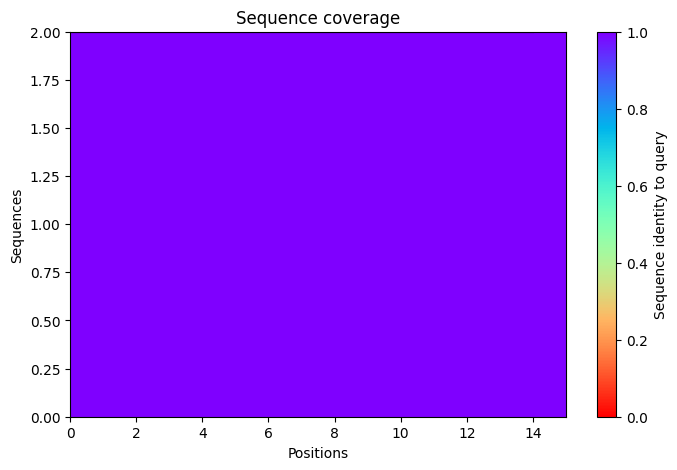

2025-11-17 09:31:44,353 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76.6 pTM=0.0375
2025-11-17 09:31:46,927 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=79.6 pTM=0.0389 tol=0.208
2025-11-17 09:31:49,503 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81.2 pTM=0.0399 tol=0.121
2025-11-17 09:31:52,083 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=79.4 pTM=0.0392 tol=0.0875
2025-11-17 09:31:52,083 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


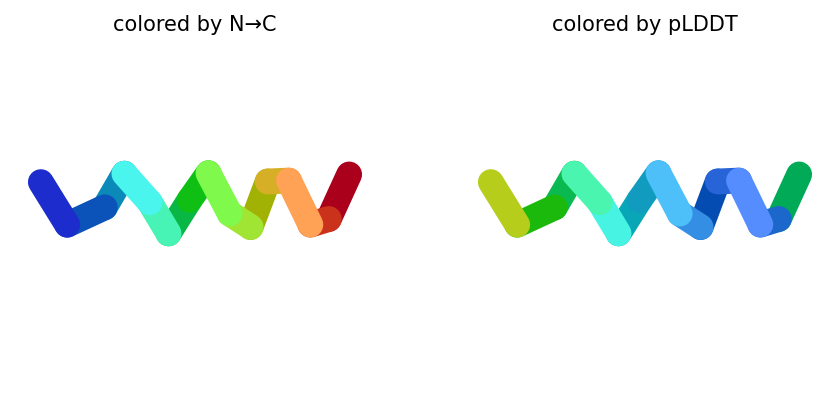

2025-11-17 09:31:54,719 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=75.4 pTM=0.0363
2025-11-17 09:31:57,299 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=74 pTM=0.0356 tol=0.273
2025-11-17 09:31:59,885 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.8 pTM=0.0353 tol=0.191
2025-11-17 09:32:02,464 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.2 pTM=0.0341 tol=0.134
2025-11-17 09:32:02,464 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


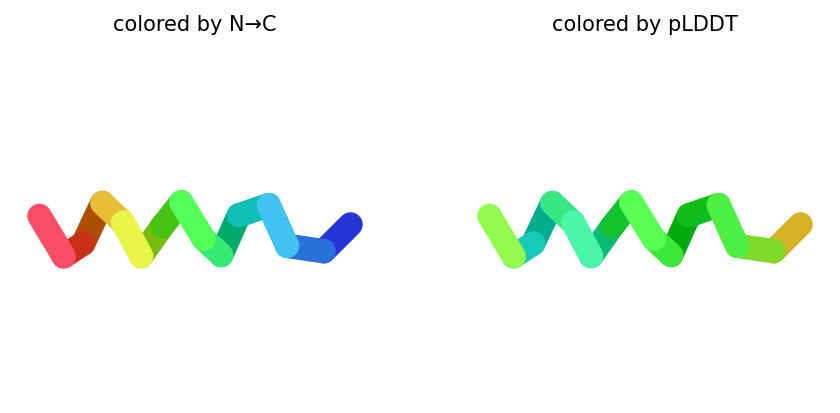

2025-11-17 09:32:05,101 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=67.6 pTM=0.0284
2025-11-17 09:32:07,691 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=66.8 pTM=0.0284 tol=1.26
2025-11-17 09:32:10,283 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=68.1 pTM=0.0271 tol=0.889
2025-11-17 09:32:12,880 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=67 pTM=0.0267 tol=1.12
2025-11-17 09:32:12,881 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


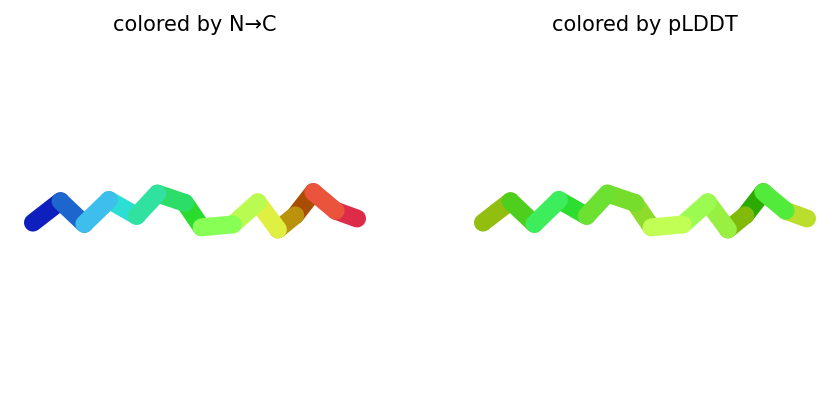

2025-11-17 09:32:15,524 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=71.8 pTM=0.0339
2025-11-17 09:32:18,124 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75.2 pTM=0.0367 tol=0.394
2025-11-17 09:32:20,719 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=77.2 pTM=0.0369 tol=0.0947
2025-11-17 09:32:23,318 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=78.6 pTM=0.0377 tol=0.211
2025-11-17 09:32:23,318 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


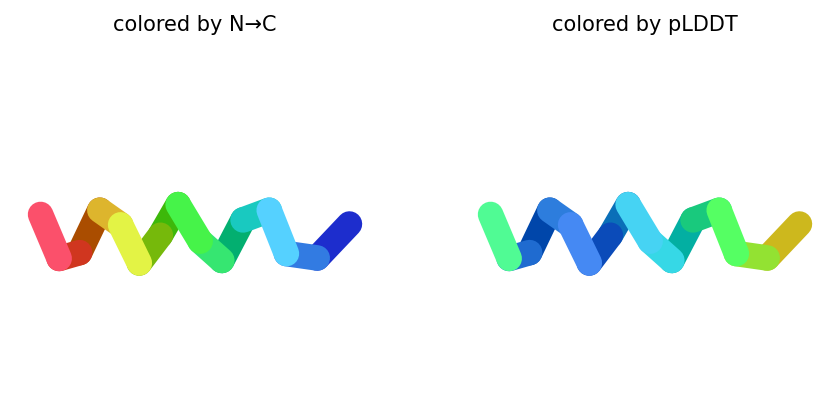

2025-11-17 09:32:26,002 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=88.1 pTM=0.0437
2025-11-17 09:32:28,595 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=88.4 pTM=0.044 tol=0.248
2025-11-17 09:32:31,186 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=88.8 pTM=0.0442 tol=0.154
2025-11-17 09:32:33,770 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.3 pTM=0.0441 tol=0.158
2025-11-17 09:32:33,771 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


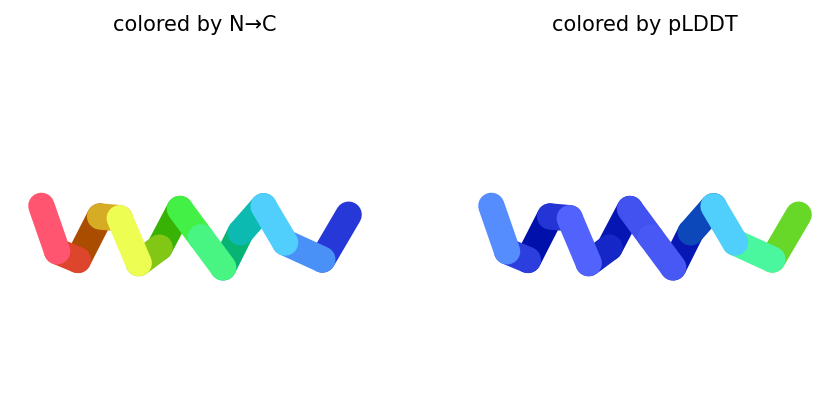

2025-11-17 09:32:33,822 reranking models by 'plddt' metric
2025-11-17 09:32:33,822 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.3 pTM=0.0441
2025-11-17 09:32:33,822 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=79.4 pTM=0.0392
2025-11-17 09:32:33,823 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=78.6 pTM=0.0377
2025-11-17 09:32:33,823 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=71.2 pTM=0.0341
2025-11-17 09:32:33,823 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=67 pTM=0.0267
2025-11-17 09:32:35,192 Query 127/146: peptide_260_IC50_484.8 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:32:35,477 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


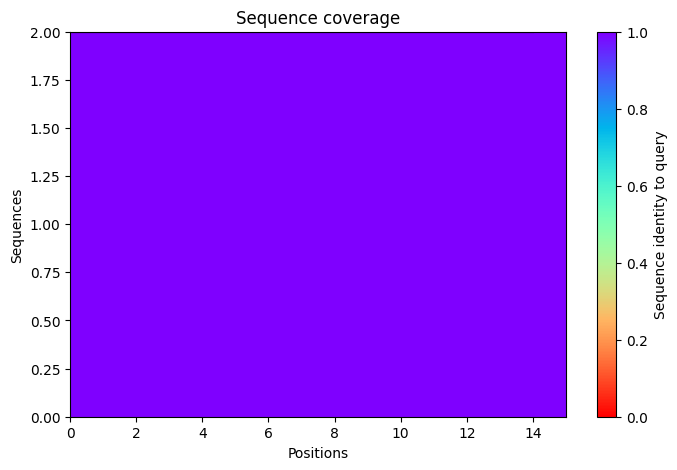

2025-11-17 09:32:48,853 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=79.1 pTM=0.0412
2025-11-17 09:32:51,432 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.6 pTM=0.0426 tol=0.486
2025-11-17 09:32:54,008 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=83.9 pTM=0.0443 tol=0.216
2025-11-17 09:32:56,586 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=84.6 pTM=0.044 tol=0.0798
2025-11-17 09:32:56,586 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


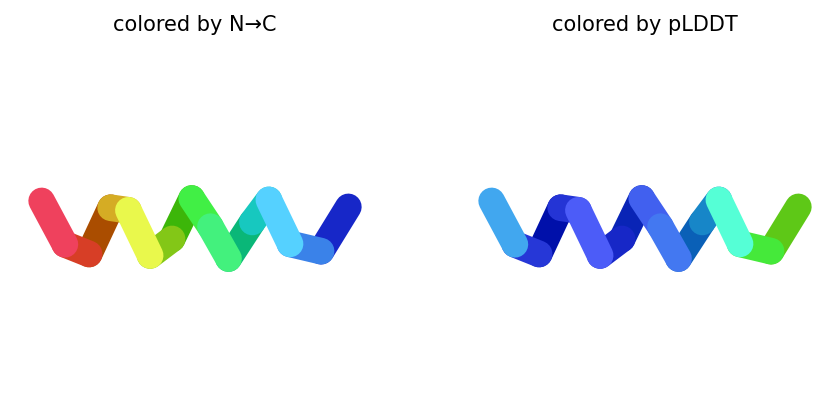

2025-11-17 09:32:59,217 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=81.8 pTM=0.0417
2025-11-17 09:33:01,799 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=81.2 pTM=0.0424 tol=0.127
2025-11-17 09:33:04,381 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=83.6 pTM=0.0439 tol=0.0699
2025-11-17 09:33:06,967 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=83.9 pTM=0.0441 tol=0.0373
2025-11-17 09:33:06,967 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


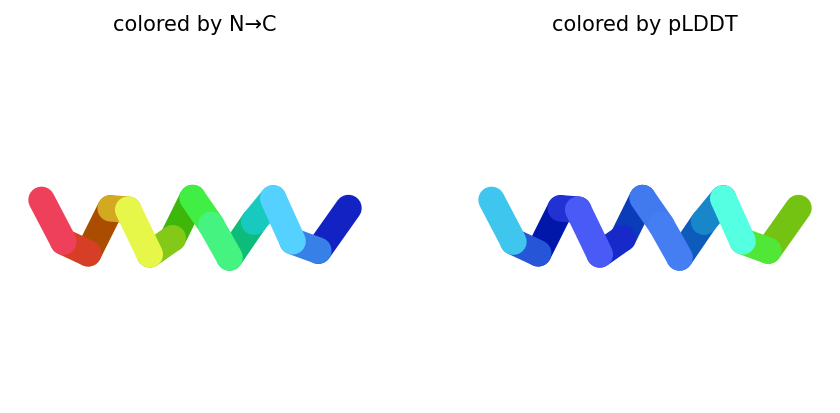

2025-11-17 09:33:09,615 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=84.1 pTM=0.0409
2025-11-17 09:33:12,204 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=84.2 pTM=0.0409 tol=0.199
2025-11-17 09:33:14,798 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=86.1 pTM=0.0419 tol=0.128
2025-11-17 09:33:17,392 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=85.6 pTM=0.0413 tol=0.0526
2025-11-17 09:33:17,393 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


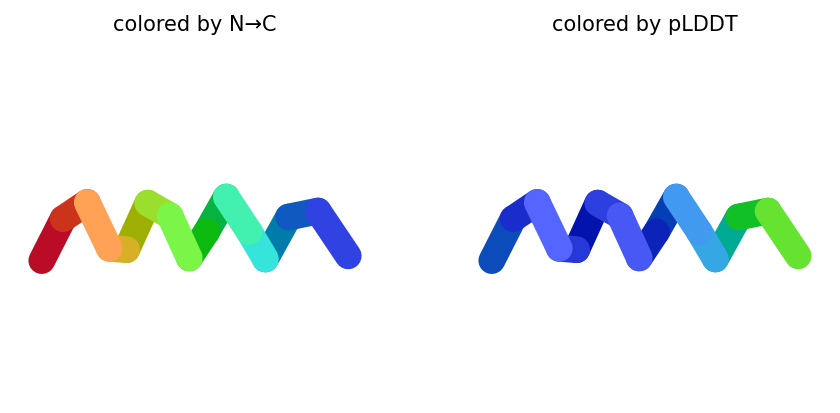

2025-11-17 09:33:20,042 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=84.5 pTM=0.0428
2025-11-17 09:33:22,636 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=86.6 pTM=0.0452 tol=0.201
2025-11-17 09:33:25,232 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=88.6 pTM=0.0461 tol=0.0452
2025-11-17 09:33:27,827 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=88.6 pTM=0.0462 tol=0.0353
2025-11-17 09:33:27,828 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


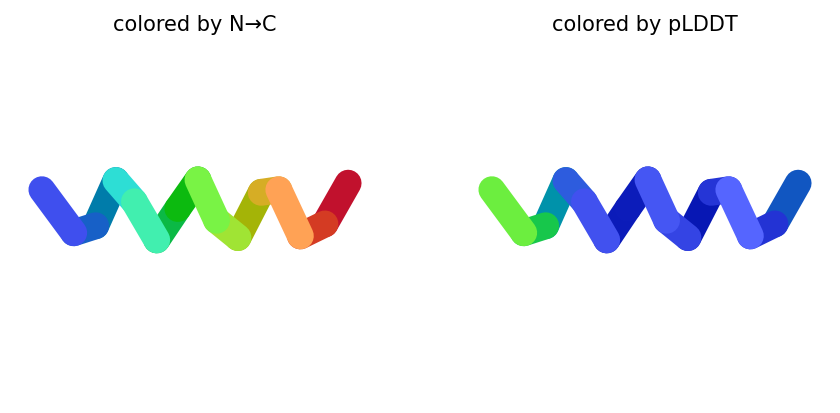

2025-11-17 09:33:30,474 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=89.3 pTM=0.0449
2025-11-17 09:33:33,059 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=91.4 pTM=0.0471 tol=0.153
2025-11-17 09:33:35,650 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=92.4 pTM=0.048 tol=0.0427
2025-11-17 09:33:38,239 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=92.8 pTM=0.0484 tol=0.0254
2025-11-17 09:33:38,239 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


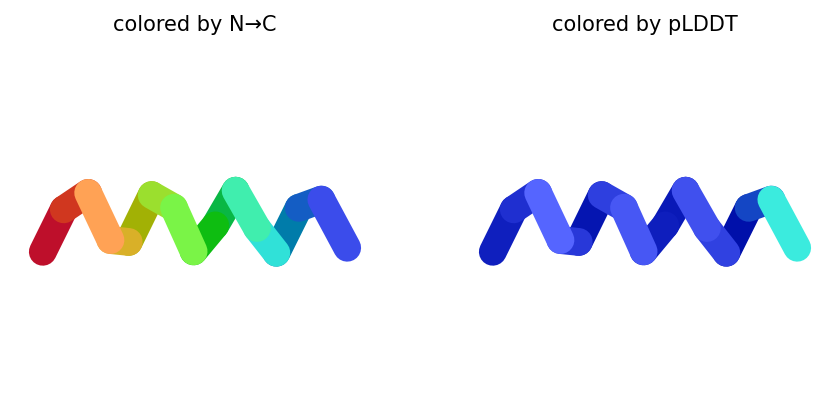

2025-11-17 09:33:38,324 reranking models by 'plddt' metric
2025-11-17 09:33:38,324 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=92.8 pTM=0.0484
2025-11-17 09:33:38,325 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=88.6 pTM=0.0462
2025-11-17 09:33:38,325 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=85.6 pTM=0.0413
2025-11-17 09:33:38,326 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=84.6 pTM=0.044
2025-11-17 09:33:38,326 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=83.9 pTM=0.0441
2025-11-17 09:33:40,124 Query 128/146: peptide_262_IC50_484.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:33:40,402 Sleeping for 5s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:05 remaining: 00:00]


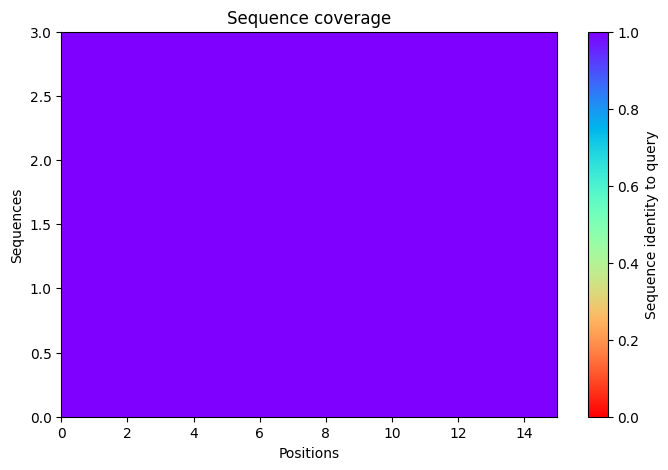

2025-11-17 09:33:50,816 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=71.2 pTM=0.0287
2025-11-17 09:33:53,393 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=69.9 pTM=0.0283 tol=0.294
2025-11-17 09:33:55,973 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=70 pTM=0.0284 tol=0.0842
2025-11-17 09:33:58,552 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73 pTM=0.0287 tol=0.476
2025-11-17 09:33:58,553 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


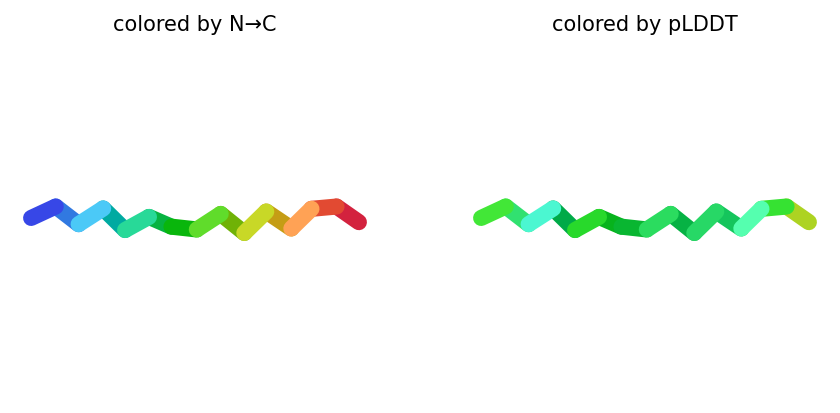

2025-11-17 09:34:01,185 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=67.4 pTM=0.0277
2025-11-17 09:34:03,765 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=69.1 pTM=0.0276 tol=0.309
2025-11-17 09:34:06,351 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=69.8 pTM=0.0275 tol=0.214
2025-11-17 09:34:08,933 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.2 pTM=0.0277 tol=0.201
2025-11-17 09:34:08,934 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


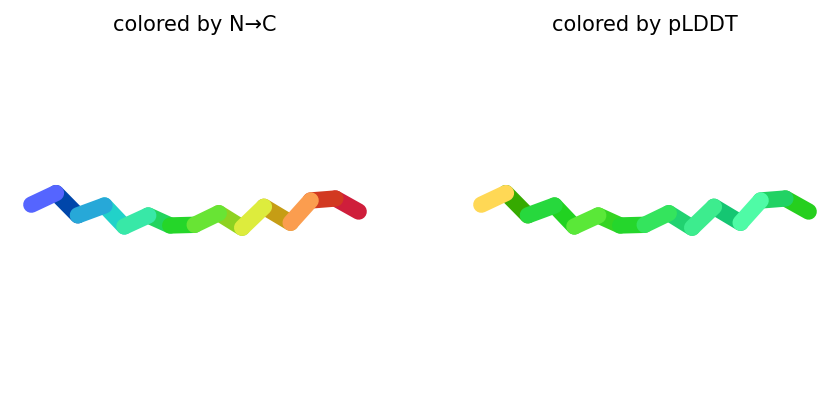

2025-11-17 09:34:11,573 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.1 pTM=0.0275
2025-11-17 09:34:14,163 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.5 pTM=0.0267 tol=0.352
2025-11-17 09:34:16,756 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=74.9 pTM=0.0266 tol=0.0981
2025-11-17 09:34:19,346 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=76.6 pTM=0.0269 tol=0.197
2025-11-17 09:34:19,347 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


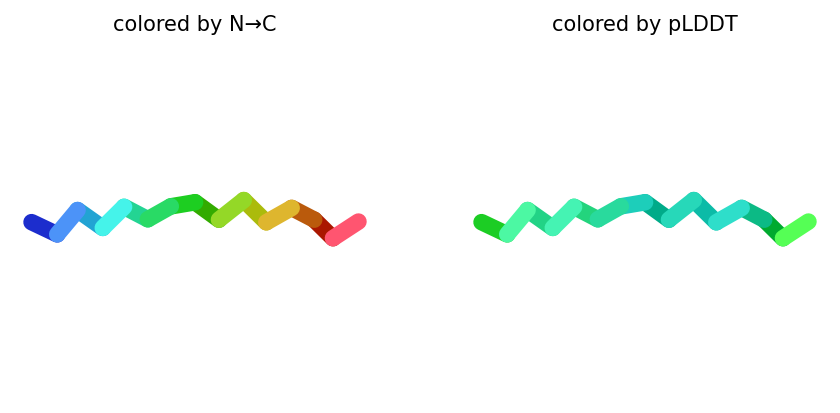

2025-11-17 09:34:21,991 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.2 pTM=0.0284
2025-11-17 09:34:24,582 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=73.4 pTM=0.0274 tol=0.364
2025-11-17 09:34:27,173 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72.8 pTM=0.0273 tol=0.128
2025-11-17 09:34:29,767 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=73.2 pTM=0.0275 tol=0.137
2025-11-17 09:34:29,768 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


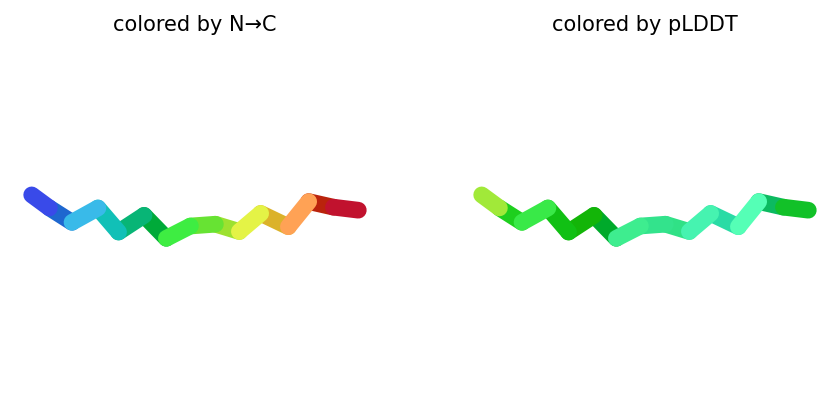

2025-11-17 09:34:32,401 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=70.2 pTM=0.0274
2025-11-17 09:34:34,986 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=73.9 pTM=0.027 tol=0.398
2025-11-17 09:34:37,573 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=74.3 pTM=0.0271 tol=0.0842
2025-11-17 09:34:40,160 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.1 pTM=0.0273 tol=0.198
2025-11-17 09:34:40,161 alphafold2_ptm_model_5_seed_000 took 10.3s (3 recycles)


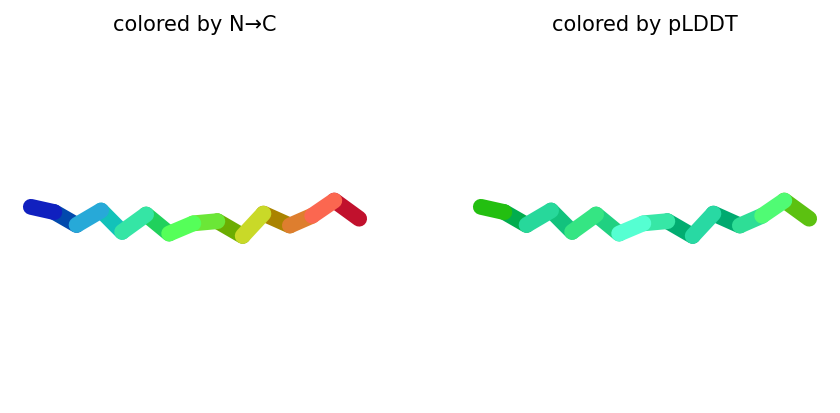

2025-11-17 09:34:40,232 reranking models by 'plddt' metric
2025-11-17 09:34:40,233 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=76.6 pTM=0.0269
2025-11-17 09:34:40,233 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=75.1 pTM=0.0273
2025-11-17 09:34:40,234 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=73.2 pTM=0.0275
2025-11-17 09:34:40,234 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73 pTM=0.0287
2025-11-17 09:34:40,234 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=71.2 pTM=0.0277
2025-11-17 09:34:41,821 Query 129/146: peptide_264_IC50_486.3 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:34:42,102 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


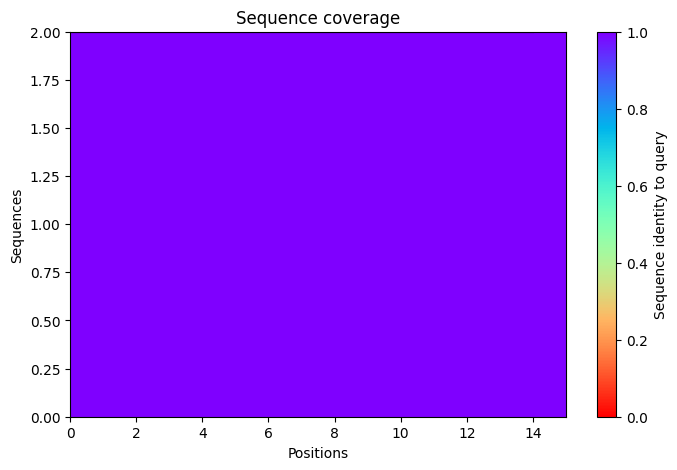

2025-11-17 09:34:53,519 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65.5 pTM=0.0311
2025-11-17 09:34:56,098 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=75.3 pTM=0.0384 tol=2.2
2025-11-17 09:34:58,677 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81.1 pTM=0.0413 tol=0.204
2025-11-17 09:35:01,254 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=80.7 pTM=0.0408 tol=0.06
2025-11-17 09:35:01,254 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


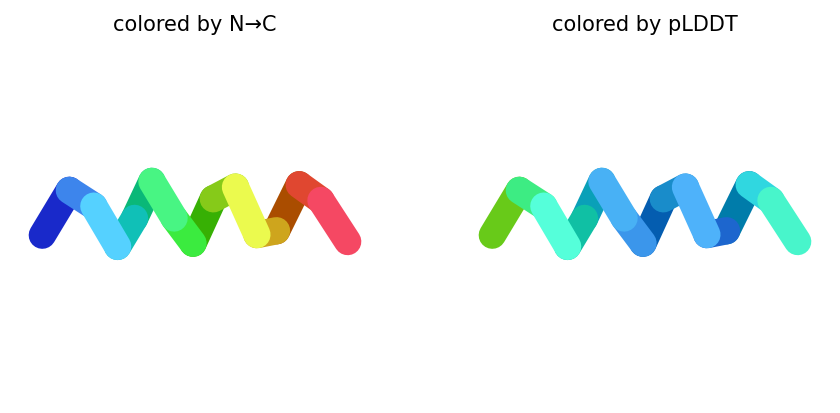

2025-11-17 09:35:03,886 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.7 pTM=0.0315
2025-11-17 09:35:06,469 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63.4 pTM=0.0337 tol=0.391
2025-11-17 09:35:09,056 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=66.4 pTM=0.0344 tol=0.0782
2025-11-17 09:35:11,642 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=66.9 pTM=0.0348 tol=0.131
2025-11-17 09:35:11,643 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


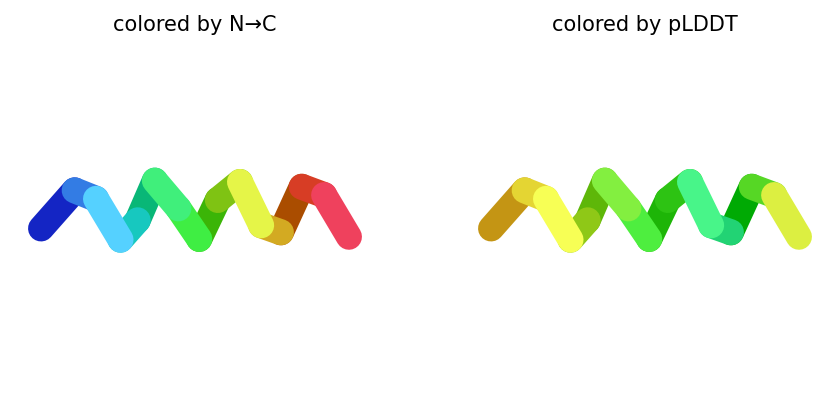

2025-11-17 09:35:14,287 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.4 pTM=0.028
2025-11-17 09:35:16,877 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=70.2 pTM=0.0281 tol=1.27
2025-11-17 09:35:19,474 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=70.9 pTM=0.0286 tol=0.828
2025-11-17 09:35:22,069 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72 pTM=0.0285 tol=0.63
2025-11-17 09:35:22,070 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


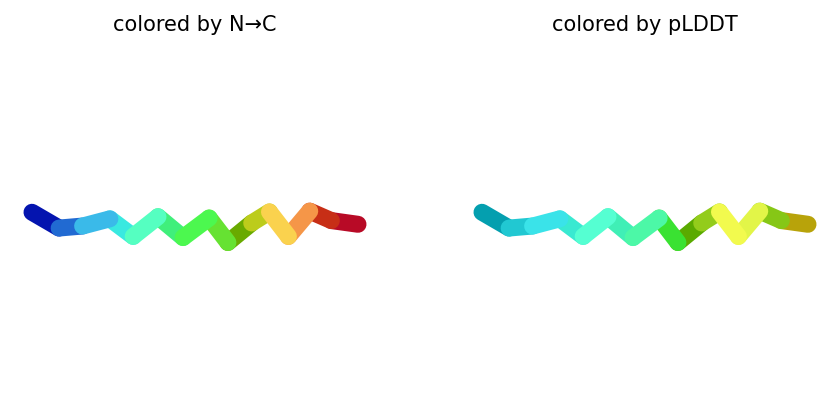

2025-11-17 09:35:24,716 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=68.6 pTM=0.0307
2025-11-17 09:35:27,308 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=68.5 pTM=0.0309 tol=0.373
2025-11-17 09:35:29,903 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.7 pTM=0.0319 tol=0.115
2025-11-17 09:35:32,497 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.9 pTM=0.0318 tol=0.0785
2025-11-17 09:35:32,498 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


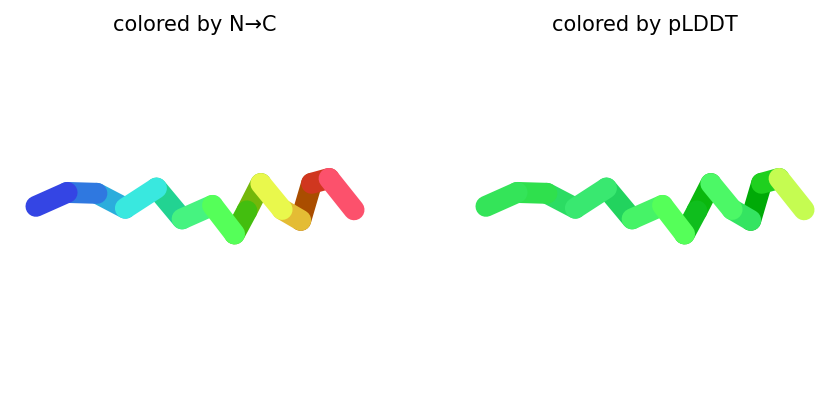

2025-11-17 09:35:35,139 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=79.7 pTM=0.0373
2025-11-17 09:35:37,730 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=76.1 pTM=0.0369 tol=0.203
2025-11-17 09:35:40,320 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76.8 pTM=0.0369 tol=0.054
2025-11-17 09:35:42,908 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=76.4 pTM=0.0367 tol=0.134
2025-11-17 09:35:42,910 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


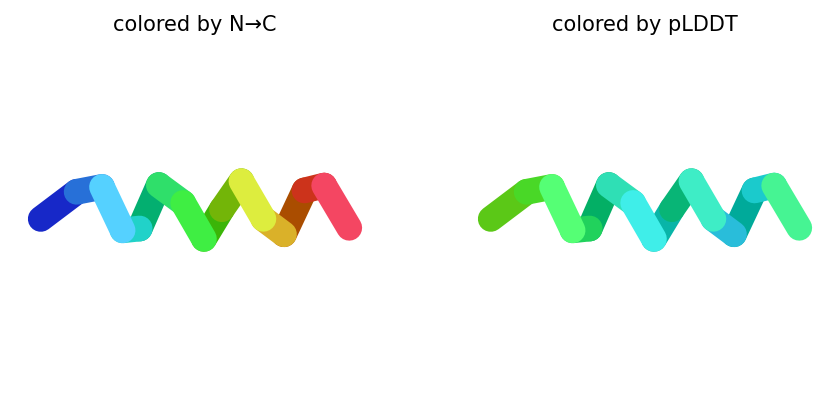

2025-11-17 09:35:42,988 reranking models by 'plddt' metric
2025-11-17 09:35:42,989 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=80.7 pTM=0.0408
2025-11-17 09:35:42,989 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=76.4 pTM=0.0367
2025-11-17 09:35:42,989 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=72 pTM=0.0285
2025-11-17 09:35:42,989 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=71.9 pTM=0.0318
2025-11-17 09:35:42,990 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=66.9 pTM=0.0348
2025-11-17 09:35:44,557 Query 130/146: peptide_266_IC50_484.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:35:44,831 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


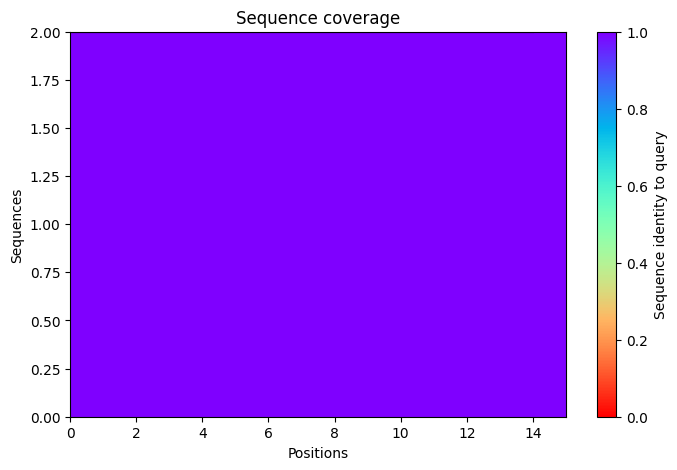

2025-11-17 09:35:59,666 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=65 pTM=0.028
2025-11-17 09:36:02,242 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.9 pTM=0.0293 tol=1.02
2025-11-17 09:36:04,821 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.2 pTM=0.0297 tol=0.729
2025-11-17 09:36:07,399 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.3 pTM=0.0292 tol=0.253
2025-11-17 09:36:07,400 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


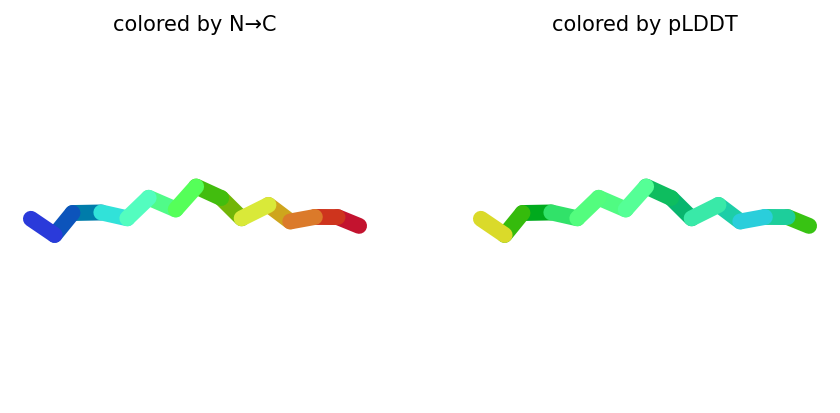

2025-11-17 09:36:10,032 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=64.6 pTM=0.0271
2025-11-17 09:36:12,609 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=68.6 pTM=0.0281 tol=0.583
2025-11-17 09:36:15,193 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.4 pTM=0.0282 tol=0.204
2025-11-17 09:36:17,778 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.8 pTM=0.0282 tol=0.162
2025-11-17 09:36:17,779 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


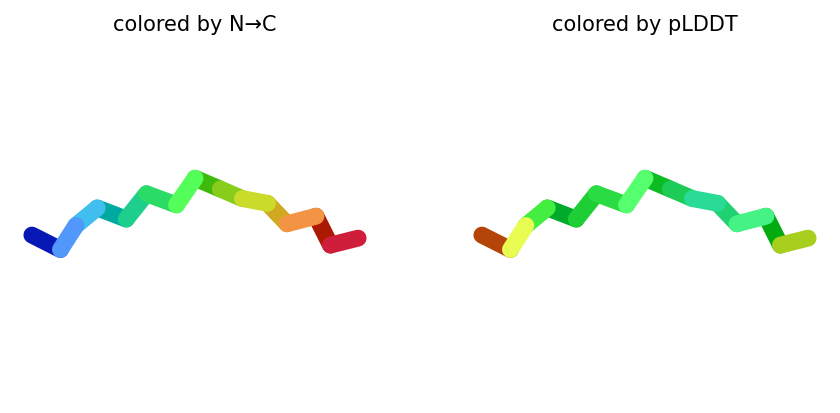

2025-11-17 09:36:20,423 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=64.4 pTM=0.0266
2025-11-17 09:36:23,012 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=63.9 pTM=0.0267 tol=1.51
2025-11-17 09:36:25,606 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63.8 pTM=0.0269 tol=1.34
2025-11-17 09:36:28,197 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=62.4 pTM=0.0272 tol=1.03
2025-11-17 09:36:28,198 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


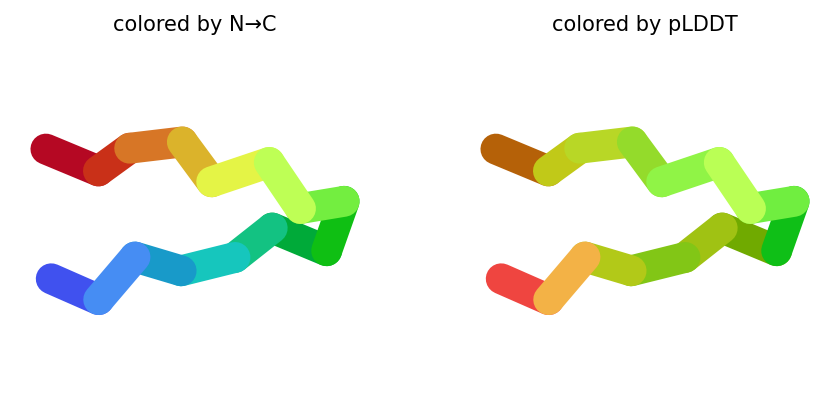

2025-11-17 09:36:30,855 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=67.9 pTM=0.029
2025-11-17 09:36:33,455 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.4 pTM=0.0302 tol=0.882
2025-11-17 09:36:36,051 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=69.1 pTM=0.0296 tol=0.294
2025-11-17 09:36:38,647 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=65.2 pTM=0.0279 tol=0.521
2025-11-17 09:36:38,647 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


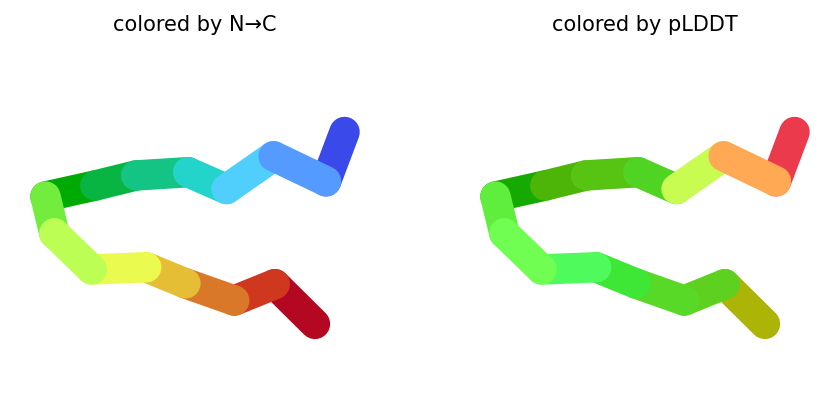

2025-11-17 09:36:41,305 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=62.8 pTM=0.0274
2025-11-17 09:36:43,895 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=67.9 pTM=0.0303 tol=0.807
2025-11-17 09:36:46,494 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=70.6 pTM=0.0312 tol=0.461
2025-11-17 09:36:49,088 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=70.5 pTM=0.0315 tol=0.322
2025-11-17 09:36:49,089 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


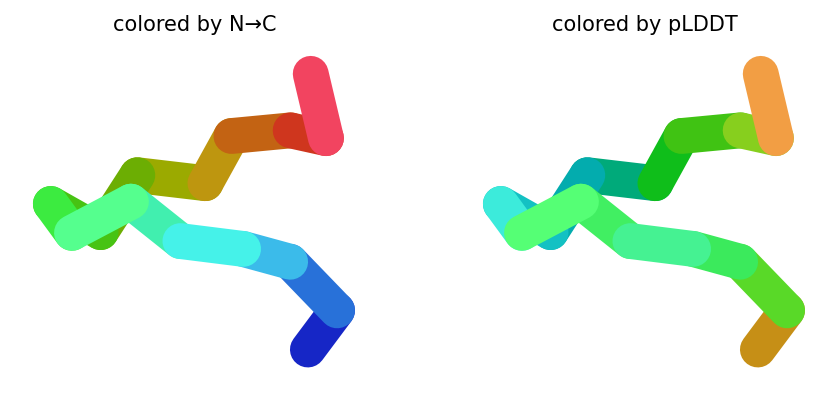

2025-11-17 09:36:49,153 reranking models by 'plddt' metric
2025-11-17 09:36:49,154 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=73.3 pTM=0.0292
2025-11-17 09:36:49,154 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=70.5 pTM=0.0315
2025-11-17 09:36:49,154 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=69.8 pTM=0.0282
2025-11-17 09:36:49,155 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=65.2 pTM=0.0279
2025-11-17 09:36:49,155 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=62.4 pTM=0.0272
2025-11-17 09:36:50,737 Query 131/146: peptide_270_IC50_486.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:36:51,018 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


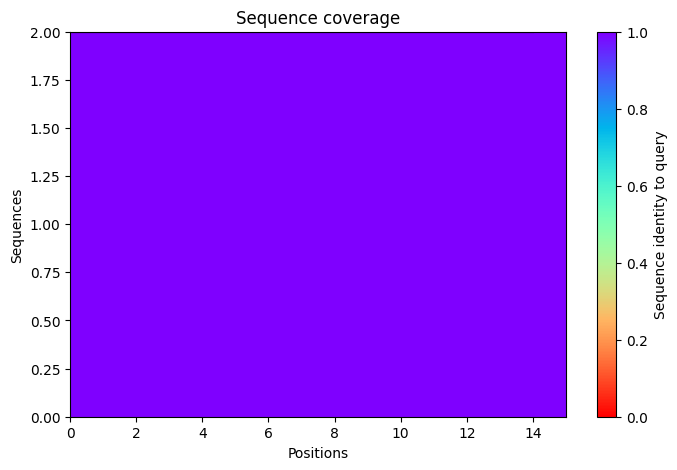

2025-11-17 09:37:03,991 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76.6 pTM=0.04
2025-11-17 09:37:06,569 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=77.4 pTM=0.0414 tol=0.139
2025-11-17 09:37:09,145 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=76.6 pTM=0.041 tol=0.191
2025-11-17 09:37:11,729 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=77.4 pTM=0.0413 tol=0.0653
2025-11-17 09:37:11,730 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


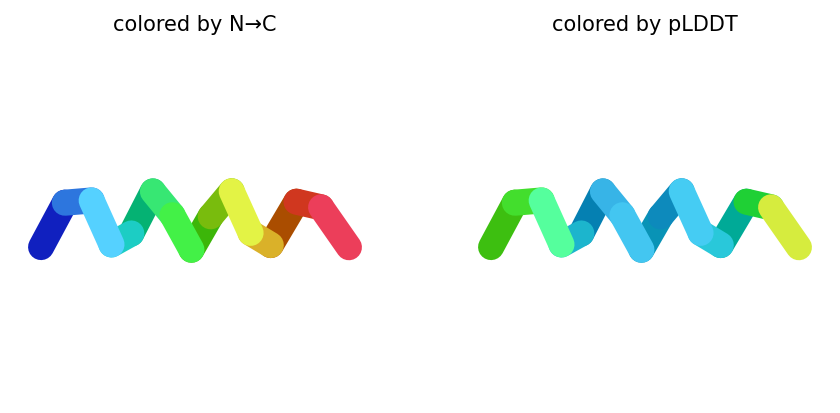

2025-11-17 09:37:14,397 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.2 pTM=0.0354
2025-11-17 09:37:16,981 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.2 pTM=0.038 tol=0.0876
2025-11-17 09:37:19,565 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.6 pTM=0.0368 tol=0.278
2025-11-17 09:37:22,154 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=68.8 pTM=0.0357 tol=0.0523
2025-11-17 09:37:22,155 alphafold2_ptm_model_2_seed_000 took 10.4s (3 recycles)


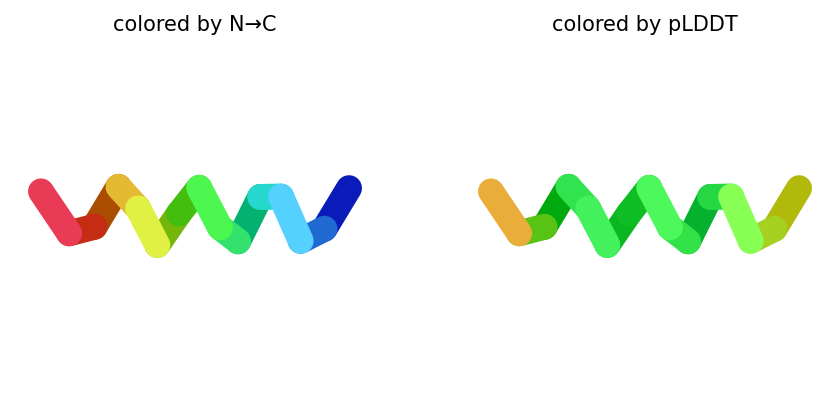

2025-11-17 09:37:24,798 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=65.4 pTM=0.0294
2025-11-17 09:37:27,392 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=63.3 pTM=0.0285 tol=2.01
2025-11-17 09:37:29,988 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63.1 pTM=0.0276 tol=2.75
2025-11-17 09:37:32,581 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=66.4 pTM=0.0273 tol=0.696
2025-11-17 09:37:32,582 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


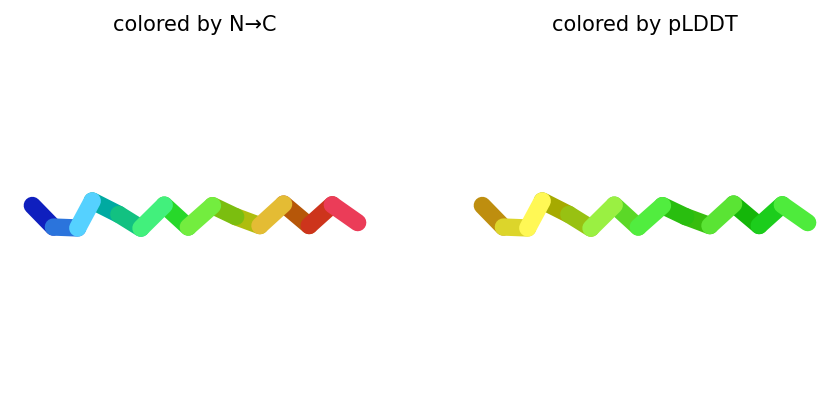

2025-11-17 09:37:35,233 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.6 pTM=0.0344
2025-11-17 09:37:37,834 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=70.6 pTM=0.0355 tol=0.0578
2025-11-17 09:37:40,429 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.1 pTM=0.0361 tol=0.114
2025-11-17 09:37:43,018 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=73.7 pTM=0.037 tol=0.128
2025-11-17 09:37:43,019 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


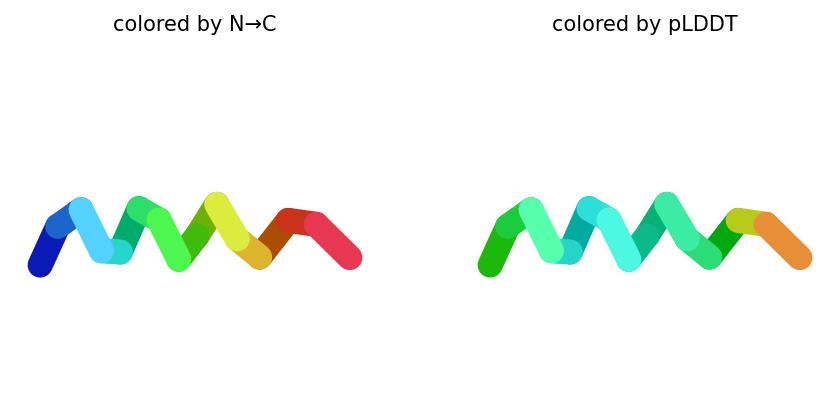

2025-11-17 09:37:45,665 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=61.2 pTM=0.0297
2025-11-17 09:37:48,251 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=61.4 pTM=0.0297 tol=0.585
2025-11-17 09:37:50,841 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=60.2 pTM=0.0287 tol=0.832
2025-11-17 09:37:53,426 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=60 pTM=0.028 tol=0.905
2025-11-17 09:37:53,426 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


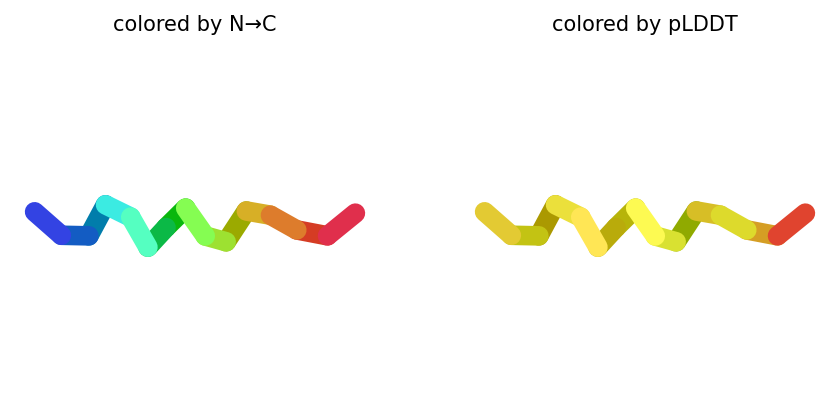

2025-11-17 09:37:53,475 reranking models by 'plddt' metric
2025-11-17 09:37:53,476 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=77.4 pTM=0.0413
2025-11-17 09:37:53,476 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=73.7 pTM=0.037
2025-11-17 09:37:53,476 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=68.8 pTM=0.0357
2025-11-17 09:37:53,477 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=66.4 pTM=0.0273
2025-11-17 09:37:53,477 rank_005_alphafold2_ptm_model_5_seed_000 pLDDT=60 pTM=0.028
2025-11-17 09:37:54,698 Query 132/146: peptide_271_IC50_487.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:37:55,000 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


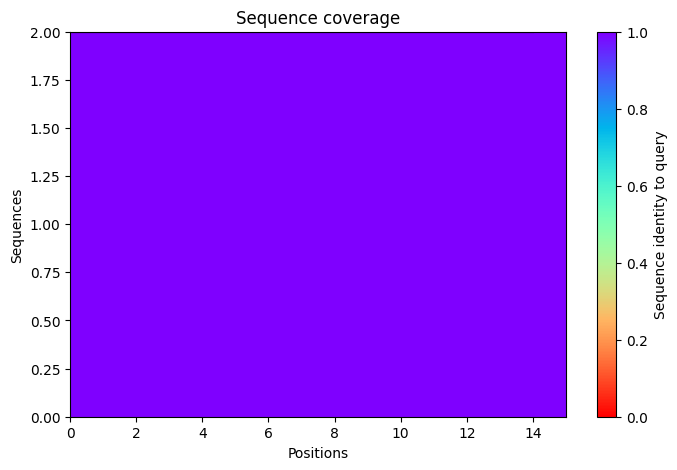

2025-11-17 09:38:09,344 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=81.2 pTM=0.0418
2025-11-17 09:38:11,923 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=84.2 pTM=0.0441 tol=0.161
2025-11-17 09:38:14,502 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=85.9 pTM=0.0451 tol=0.126
2025-11-17 09:38:17,084 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=87.4 pTM=0.0449 tol=0.059
2025-11-17 09:38:17,084 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


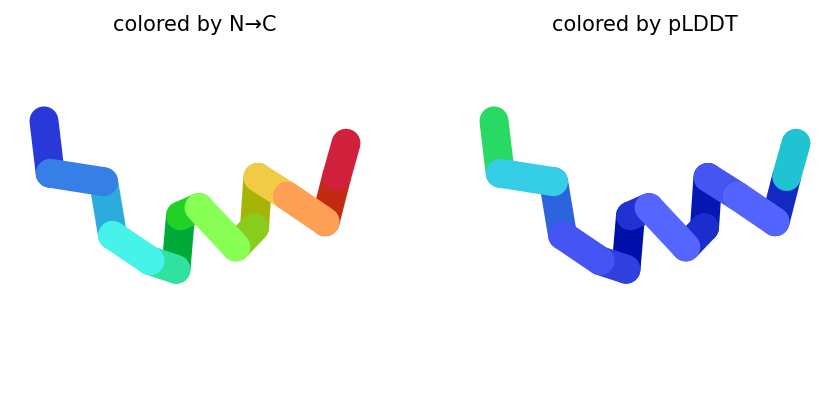

2025-11-17 09:38:19,720 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=85.9 pTM=0.0434
2025-11-17 09:38:22,304 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=84.3 pTM=0.0433 tol=0.0611
2025-11-17 09:38:24,887 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=84.4 pTM=0.0435 tol=0.0661
2025-11-17 09:38:27,476 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=84.4 pTM=0.0429 tol=0.0657
2025-11-17 09:38:27,477 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


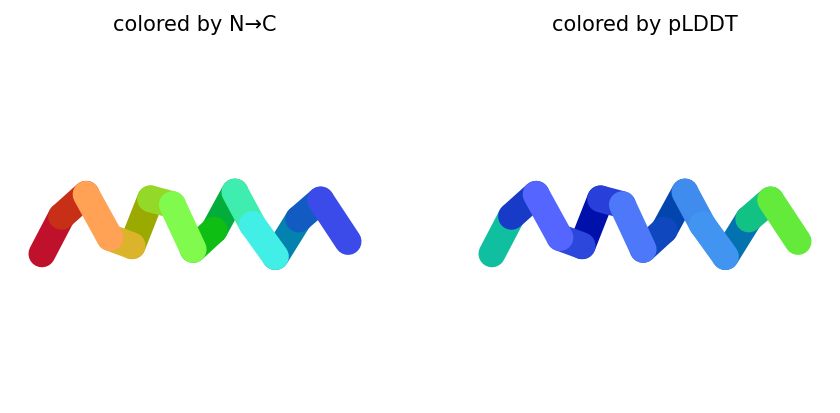

2025-11-17 09:38:30,116 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=87.7 pTM=0.0431
2025-11-17 09:38:32,708 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=88.6 pTM=0.0442 tol=0.224
2025-11-17 09:38:35,300 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=84.7 pTM=0.0426 tol=0.955
2025-11-17 09:38:37,895 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=88.7 pTM=0.0454 tol=0.414
2025-11-17 09:38:37,896 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


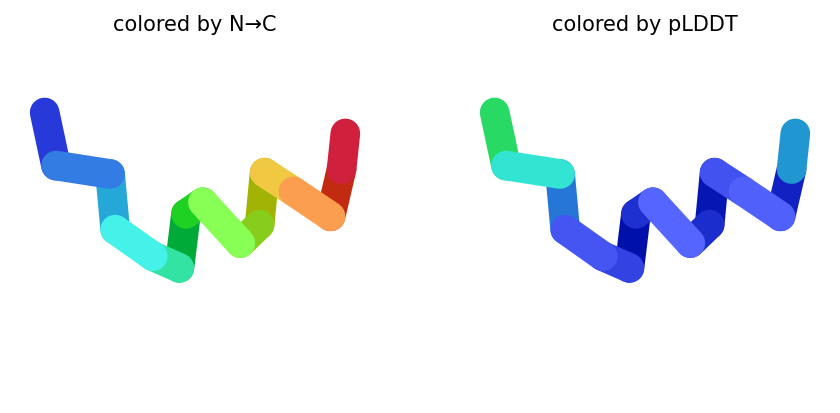

2025-11-17 09:38:40,575 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=85.8 pTM=0.0435
2025-11-17 09:38:43,170 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=88.2 pTM=0.0458 tol=0.0977
2025-11-17 09:38:45,767 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=89.4 pTM=0.0462 tol=0.134
2025-11-17 09:38:48,361 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=90.1 pTM=0.0466 tol=0.0469
2025-11-17 09:38:48,362 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


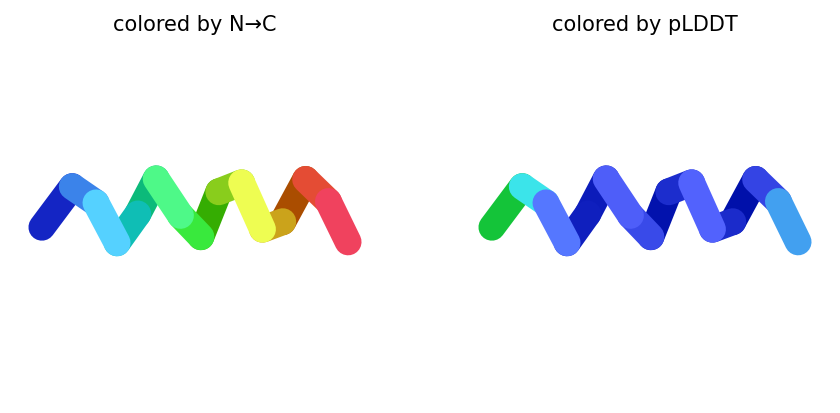

2025-11-17 09:38:51,013 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=89.9 pTM=0.0447
2025-11-17 09:38:53,609 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=92.1 pTM=0.0471 tol=0.0775
2025-11-17 09:38:56,201 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=91.6 pTM=0.0473 tol=0.0356
2025-11-17 09:38:58,788 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=91.9 pTM=0.0474 tol=0.0651
2025-11-17 09:38:58,788 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


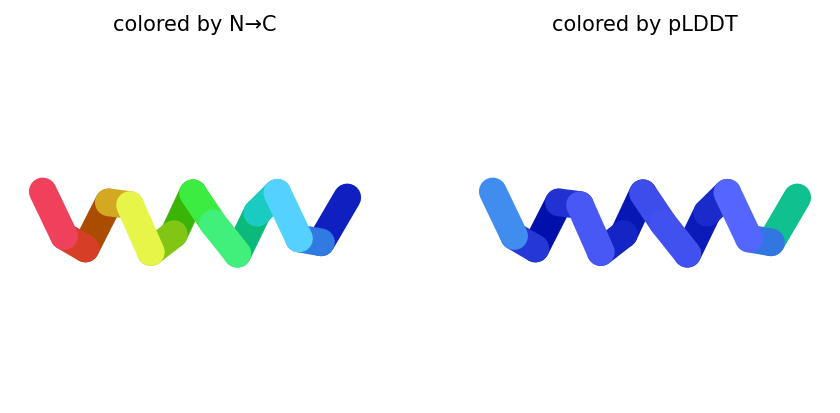

2025-11-17 09:38:58,836 reranking models by 'plddt' metric
2025-11-17 09:38:58,837 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=91.9 pTM=0.0474
2025-11-17 09:38:58,837 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=90.1 pTM=0.0466
2025-11-17 09:38:58,838 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=88.7 pTM=0.0454
2025-11-17 09:38:58,838 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=87.4 pTM=0.0449
2025-11-17 09:38:58,838 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=84.4 pTM=0.0429
2025-11-17 09:39:00,078 Query 133/146: peptide_272_IC50_488.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:39:00,356 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


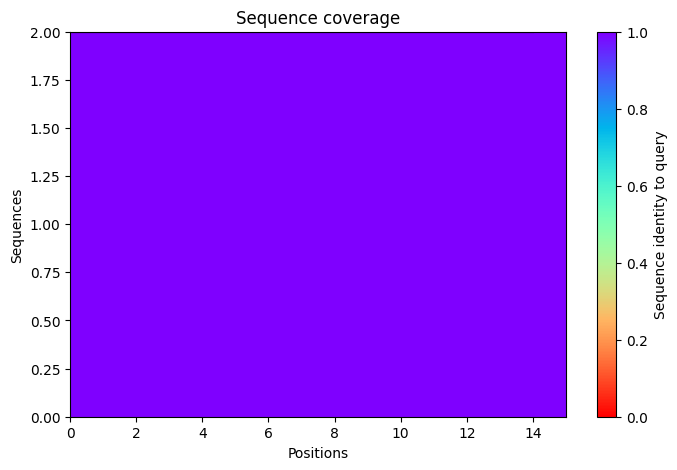

2025-11-17 09:39:12,740 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=82.8 pTM=0.0415
2025-11-17 09:39:15,320 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=87.1 pTM=0.0437 tol=0.168
2025-11-17 09:39:17,895 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=87.6 pTM=0.0439 tol=0.0534
2025-11-17 09:39:20,469 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=87.3 pTM=0.0433 tol=0.0429
2025-11-17 09:39:20,470 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


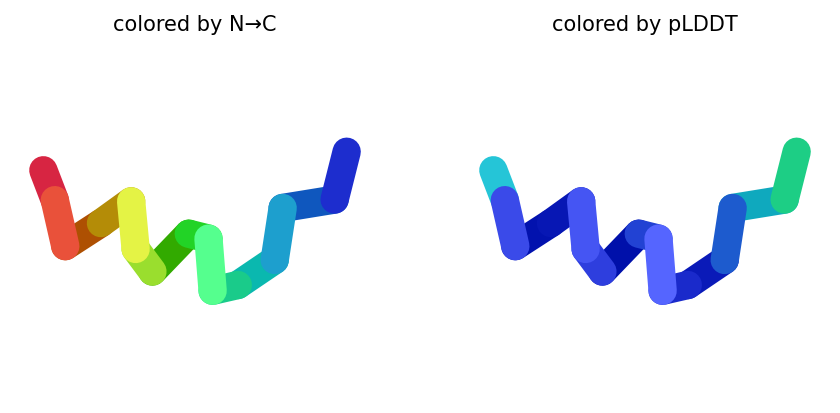

2025-11-17 09:39:23,101 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=81.1 pTM=0.0407
2025-11-17 09:39:25,681 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=82 pTM=0.0421 tol=0.193
2025-11-17 09:39:28,269 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=83.9 pTM=0.043 tol=0.101
2025-11-17 09:39:30,854 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=84.9 pTM=0.043 tol=0.0328
2025-11-17 09:39:30,855 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


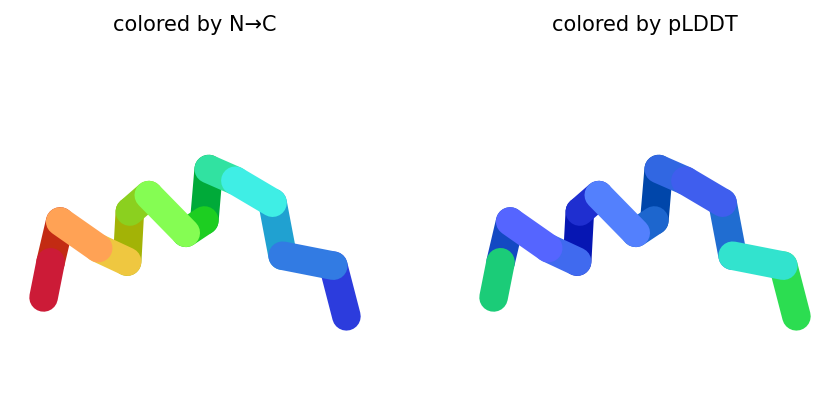

2025-11-17 09:39:33,503 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=84.9 pTM=0.0419
2025-11-17 09:39:36,094 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=87.6 pTM=0.0436 tol=0.157
2025-11-17 09:39:38,687 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=89.8 pTM=0.0444 tol=0.111
2025-11-17 09:39:41,284 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=90.4 pTM=0.0448 tol=0.0395
2025-11-17 09:39:41,284 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


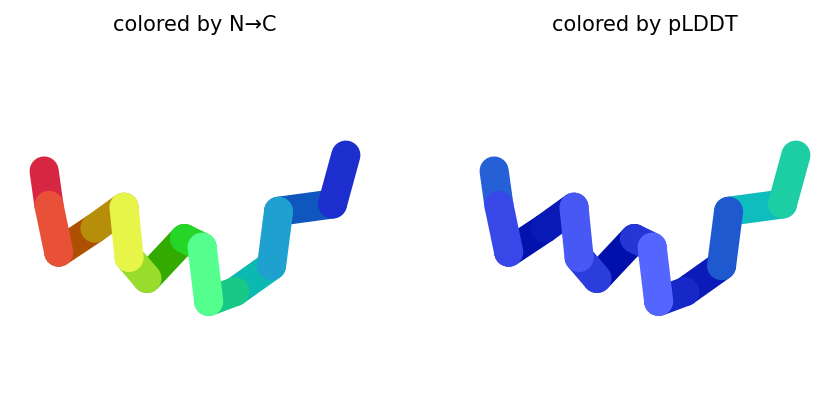

2025-11-17 09:39:43,935 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=88.4 pTM=0.0443
2025-11-17 09:39:46,530 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=90.2 pTM=0.0459 tol=0.0897
2025-11-17 09:39:49,123 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=89.8 pTM=0.0456 tol=0.0571
2025-11-17 09:39:51,715 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=89.4 pTM=0.0452 tol=0.0538
2025-11-17 09:39:51,715 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


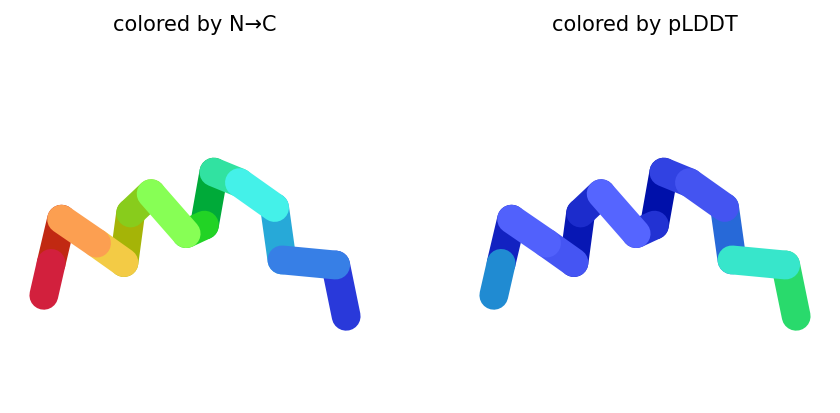

2025-11-17 09:39:54,381 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=82.1 pTM=0.041
2025-11-17 09:39:56,971 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=85.6 pTM=0.0437 tol=0.238
2025-11-17 09:39:59,561 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=87 pTM=0.0444 tol=0.0914
2025-11-17 09:40:02,146 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.4 pTM=0.0449 tol=0.133
2025-11-17 09:40:02,147 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


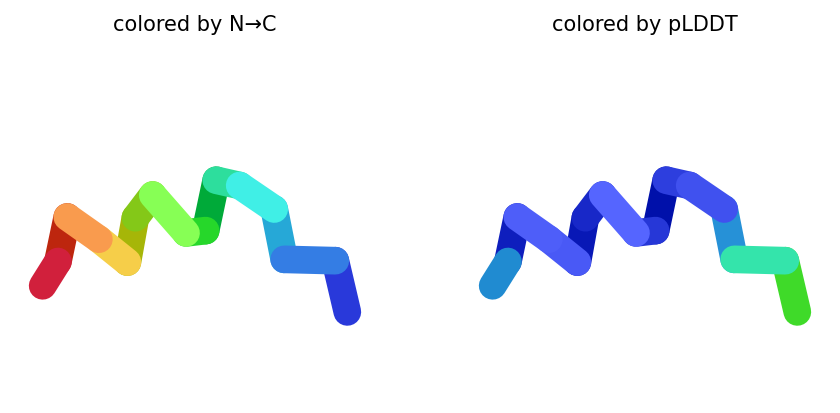

2025-11-17 09:40:02,199 reranking models by 'plddt' metric
2025-11-17 09:40:02,200 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=90.4 pTM=0.0448
2025-11-17 09:40:02,200 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=89.4 pTM=0.0452
2025-11-17 09:40:02,200 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=88.4 pTM=0.0449
2025-11-17 09:40:02,201 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=87.3 pTM=0.0433
2025-11-17 09:40:02,201 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=84.9 pTM=0.043
2025-11-17 09:40:03,838 Query 134/146: peptide_274_IC50_488.4 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:40:04,120 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


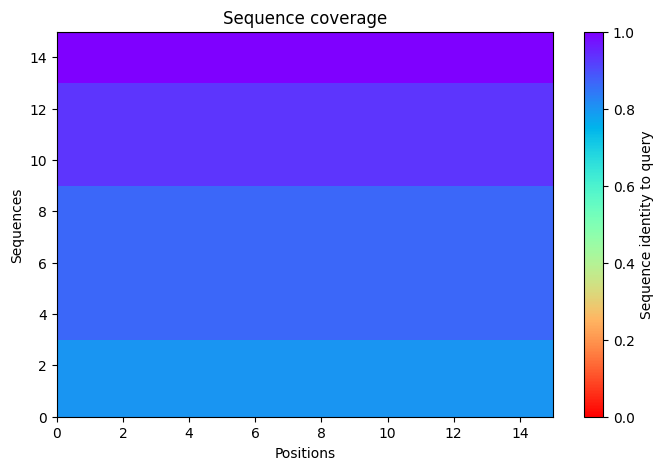

2025-11-17 09:40:17,495 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=71.7 pTM=0.0299
2025-11-17 09:40:20,070 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=70.2 pTM=0.029 tol=0.538
2025-11-17 09:40:22,650 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=72.9 pTM=0.0295 tol=0.358
2025-11-17 09:40:25,232 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73.1 pTM=0.0295 tol=0.273
2025-11-17 09:40:25,233 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


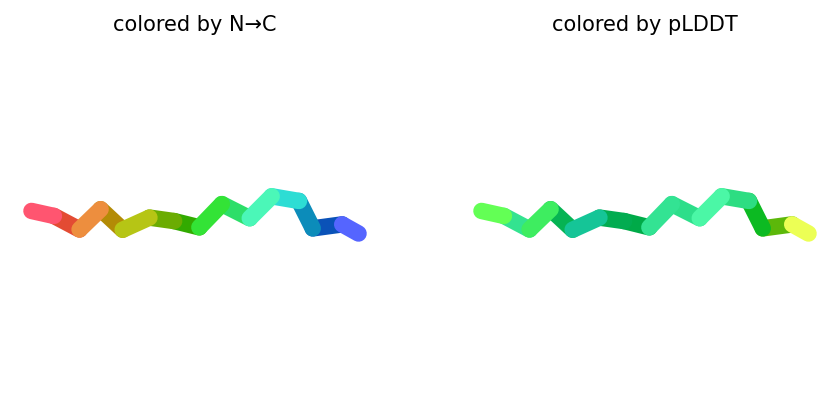

2025-11-17 09:40:27,868 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.3 pTM=0.0275
2025-11-17 09:40:30,451 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.8 pTM=0.0279 tol=0.354
2025-11-17 09:40:33,039 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.4 pTM=0.0283 tol=0.38
2025-11-17 09:40:35,629 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.6 pTM=0.0285 tol=0.442
2025-11-17 09:40:35,629 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


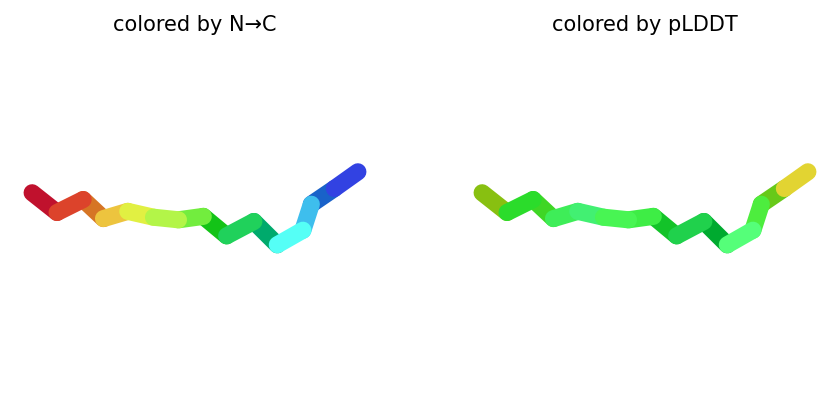

2025-11-17 09:40:38,270 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=79.1 pTM=0.0298
2025-11-17 09:40:40,861 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=77.4 pTM=0.029 tol=0.595
2025-11-17 09:40:43,459 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=77.4 pTM=0.0293 tol=0.159
2025-11-17 09:40:46,057 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=77.8 pTM=0.0298 tol=0.164
2025-11-17 09:40:46,058 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


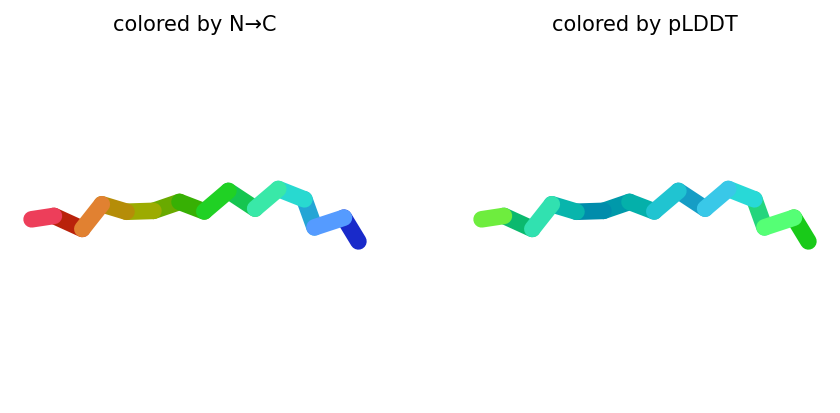

2025-11-17 09:40:48,709 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=74 pTM=0.0289
2025-11-17 09:40:51,308 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=68.7 pTM=0.0272 tol=1.03
2025-11-17 09:40:53,908 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=67.8 pTM=0.0272 tol=0.206
2025-11-17 09:40:56,503 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.1 pTM=0.0272 tol=0.588
2025-11-17 09:40:56,504 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


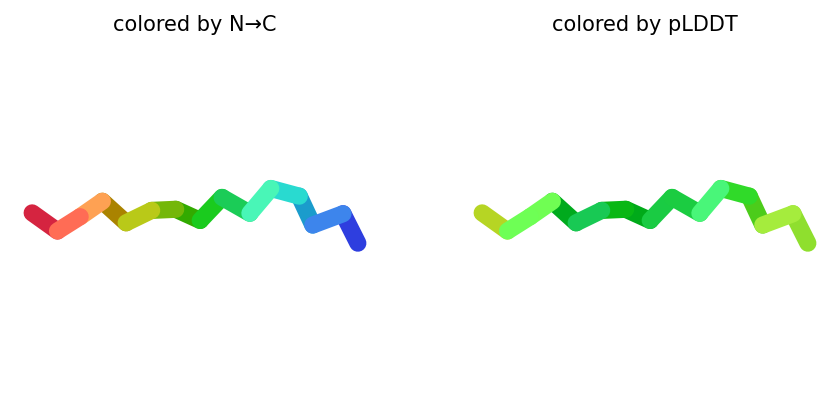

2025-11-17 09:40:59,149 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=68.9 pTM=0.0281
2025-11-17 09:41:01,740 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=70.7 pTM=0.0282 tol=0.354
2025-11-17 09:41:04,330 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=71.8 pTM=0.0288 tol=0.142
2025-11-17 09:41:06,922 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.2 pTM=0.0292 tol=0.25
2025-11-17 09:41:06,923 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


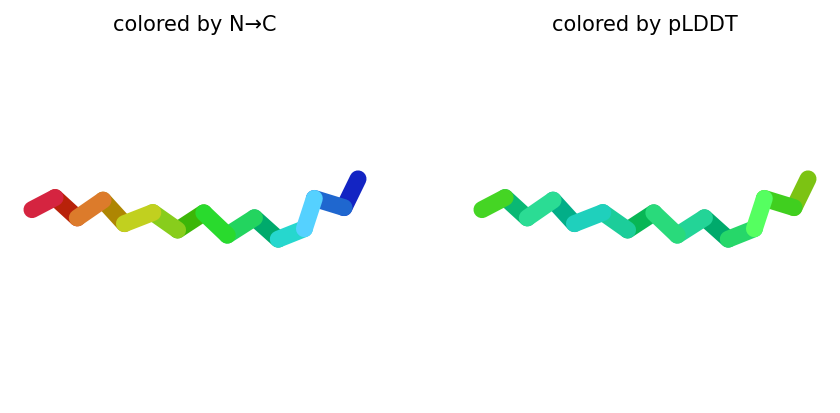

2025-11-17 09:41:07,003 reranking models by 'plddt' metric
2025-11-17 09:41:07,004 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=77.8 pTM=0.0298
2025-11-17 09:41:07,004 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=74.2 pTM=0.0292
2025-11-17 09:41:07,005 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=73.1 pTM=0.0295
2025-11-17 09:41:07,005 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=70.1 pTM=0.0272
2025-11-17 09:41:07,006 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=69.6 pTM=0.0285
2025-11-17 09:41:08,585 Query 135/146: peptide_277_IC50_488.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:41:08,866 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


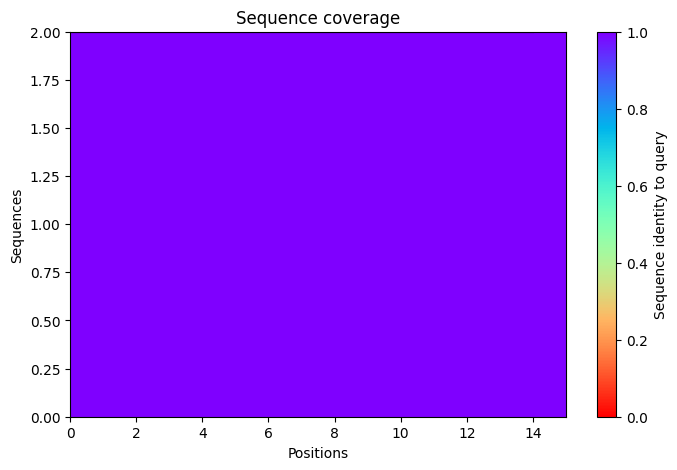

2025-11-17 09:41:20,292 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=80.4 pTM=0.0392
2025-11-17 09:41:22,871 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81 pTM=0.041 tol=0.132
2025-11-17 09:41:25,446 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.7 pTM=0.0419 tol=0.108
2025-11-17 09:41:28,023 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.4 pTM=0.0422 tol=0.0773
2025-11-17 09:41:28,024 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


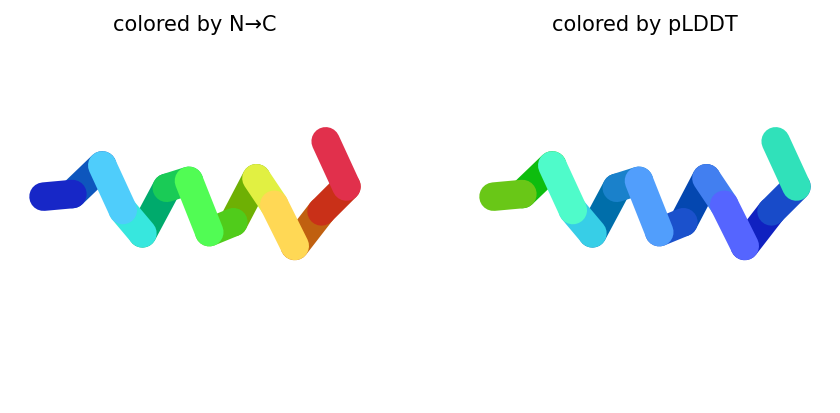

2025-11-17 09:41:30,659 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.8 pTM=0.0329
2025-11-17 09:41:33,242 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.1 pTM=0.035 tol=0.668
2025-11-17 09:41:35,827 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=70.1 pTM=0.0365 tol=0.277
2025-11-17 09:41:38,410 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=71.4 pTM=0.0365 tol=0.169
2025-11-17 09:41:38,410 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


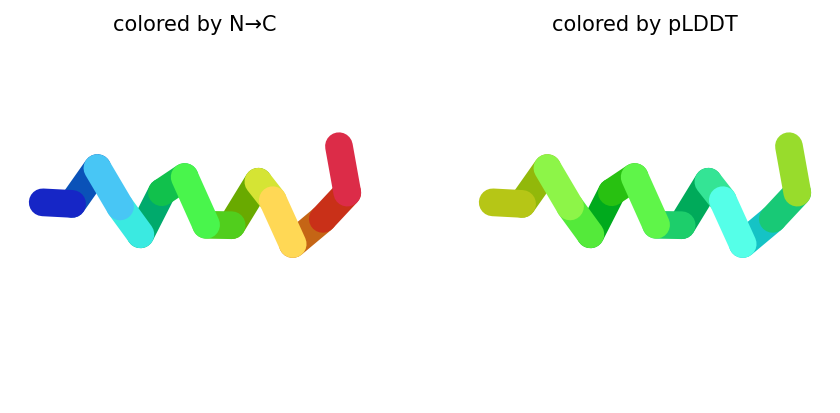

2025-11-17 09:41:41,047 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=76.6 pTM=0.0335
2025-11-17 09:41:43,640 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=80.6 pTM=0.0367 tol=0.436
2025-11-17 09:41:46,235 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=82.6 pTM=0.0378 tol=0.149
2025-11-17 09:41:48,829 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=84.1 pTM=0.0388 tol=0.107
2025-11-17 09:41:48,830 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


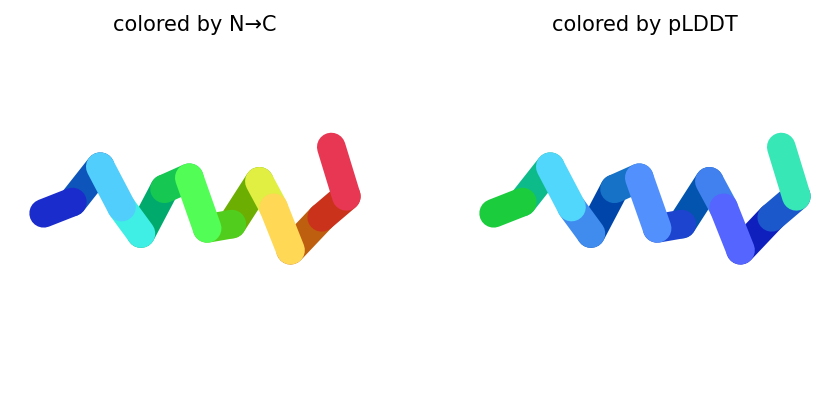

2025-11-17 09:41:51,479 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=73.8 pTM=0.0343
2025-11-17 09:41:54,075 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=74.7 pTM=0.0353 tol=0.112
2025-11-17 09:41:56,673 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.2 pTM=0.0356 tol=0.134
2025-11-17 09:41:59,267 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=77.8 pTM=0.0367 tol=0.0858
2025-11-17 09:41:59,268 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


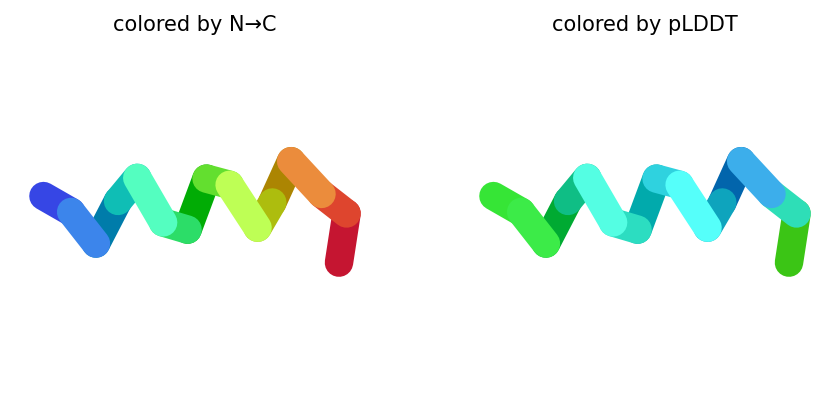

2025-11-17 09:42:01,912 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=88.8 pTM=0.044
2025-11-17 09:42:04,497 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=86 pTM=0.0433 tol=0.265
2025-11-17 09:42:07,085 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=86.2 pTM=0.0431 tol=0.0511
2025-11-17 09:42:09,671 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=87.6 pTM=0.0431 tol=0.0789
2025-11-17 09:42:09,672 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


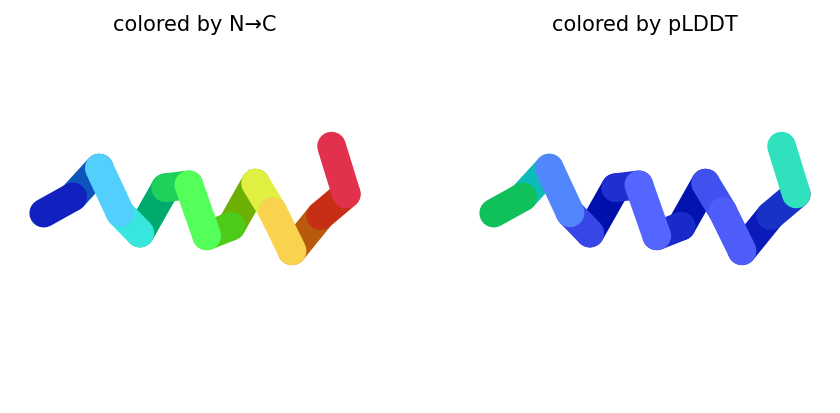

2025-11-17 09:42:09,749 reranking models by 'plddt' metric
2025-11-17 09:42:09,749 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=87.6 pTM=0.0431
2025-11-17 09:42:09,749 rank_002_alphafold2_ptm_model_3_seed_000 pLDDT=84.1 pTM=0.0388
2025-11-17 09:42:09,750 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=82.4 pTM=0.0422
2025-11-17 09:42:09,750 rank_004_alphafold2_ptm_model_4_seed_000 pLDDT=77.8 pTM=0.0367
2025-11-17 09:42:09,750 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=71.4 pTM=0.0365
2025-11-17 09:42:11,303 Query 136/146: peptide_281_IC50_487.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:42:11,590 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


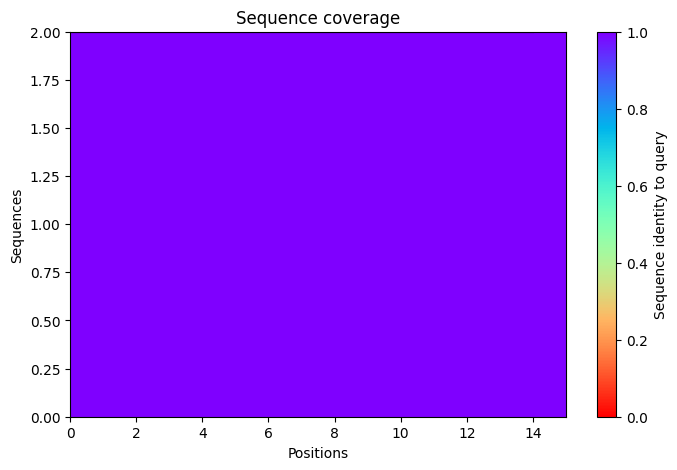

2025-11-17 09:42:23,008 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.9 pTM=0.0356
2025-11-17 09:42:25,586 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=79.5 pTM=0.0402 tol=0.275
2025-11-17 09:42:28,163 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79.4 pTM=0.0396 tol=0.0997
2025-11-17 09:42:30,744 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=80.5 pTM=0.0397 tol=0.184
2025-11-17 09:42:30,744 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


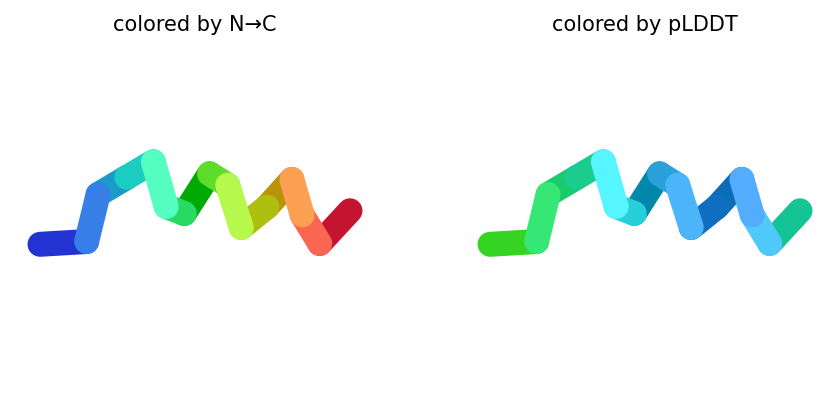

2025-11-17 09:42:33,381 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=63.8 pTM=0.0297
2025-11-17 09:42:35,962 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=63.3 pTM=0.031 tol=0.395
2025-11-17 09:42:38,549 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=63.3 pTM=0.0307 tol=0.473
2025-11-17 09:42:41,133 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=62.9 pTM=0.0296 tol=0.317
2025-11-17 09:42:41,133 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


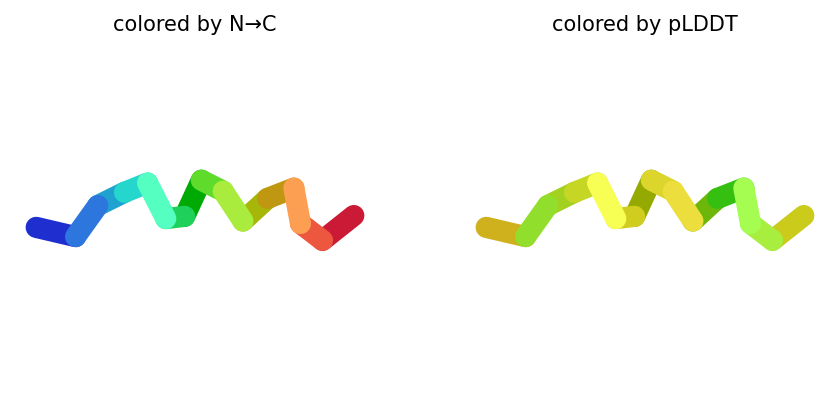

2025-11-17 09:42:43,776 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.4 pTM=0.0295
2025-11-17 09:42:46,372 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=73.6 pTM=0.0302 tol=0.319
2025-11-17 09:42:48,971 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=73.4 pTM=0.0293 tol=0.315
2025-11-17 09:42:51,569 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=73.6 pTM=0.029 tol=0.161
2025-11-17 09:42:51,570 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


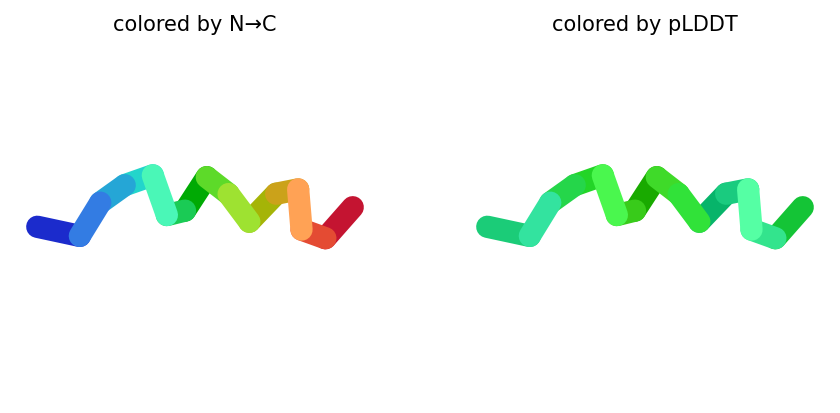

2025-11-17 09:42:54,221 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=69.4 pTM=0.0289
2025-11-17 09:42:56,814 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.4 pTM=0.0314 tol=0.484
2025-11-17 09:42:59,407 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=72 pTM=0.0302 tol=0.204
2025-11-17 09:43:02,006 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=74.2 pTM=0.0313 tol=0.213
2025-11-17 09:43:02,007 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


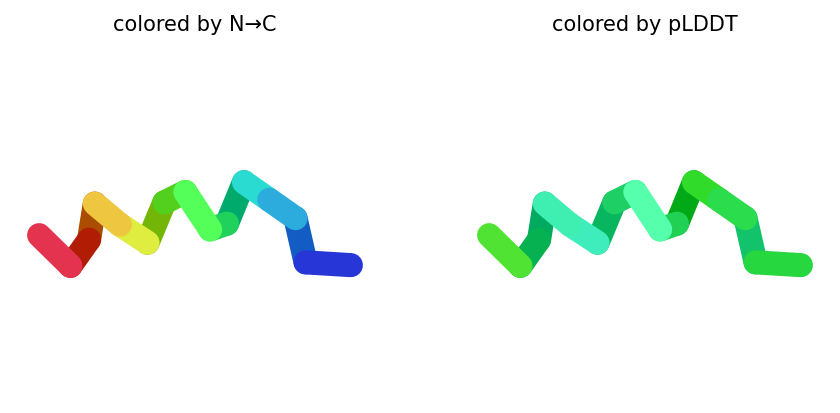

2025-11-17 09:43:04,646 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=86.5 pTM=0.0408
2025-11-17 09:43:07,235 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=87.2 pTM=0.0427 tol=0.144
2025-11-17 09:43:09,820 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=87.9 pTM=0.0425 tol=0.0806
2025-11-17 09:43:12,408 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=88.4 pTM=0.0426 tol=0.064
2025-11-17 09:43:12,409 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


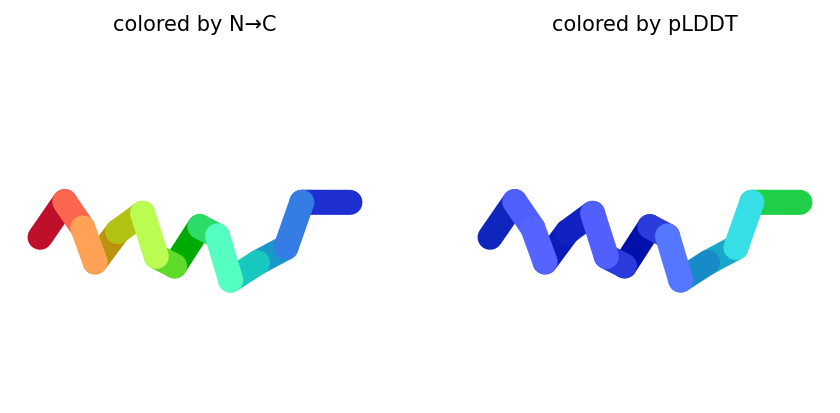

2025-11-17 09:43:12,481 reranking models by 'plddt' metric
2025-11-17 09:43:12,481 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=88.4 pTM=0.0426
2025-11-17 09:43:12,482 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=80.5 pTM=0.0397
2025-11-17 09:43:12,482 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=74.2 pTM=0.0313
2025-11-17 09:43:12,483 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=73.6 pTM=0.029
2025-11-17 09:43:12,483 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=62.9 pTM=0.0296
2025-11-17 09:43:14,547 Query 137/146: peptide_283_IC50_487.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:43:14,826 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


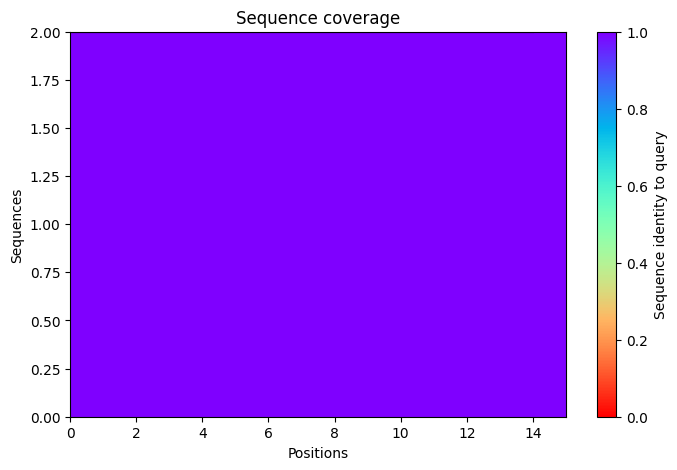

2025-11-17 09:43:26,249 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=79.3 pTM=0.0407
2025-11-17 09:43:28,829 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.3 pTM=0.0423 tol=0.123
2025-11-17 09:43:31,407 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81.8 pTM=0.0432 tol=0.077
2025-11-17 09:43:33,984 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=81.1 pTM=0.0422 tol=0.0581
2025-11-17 09:43:33,985 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


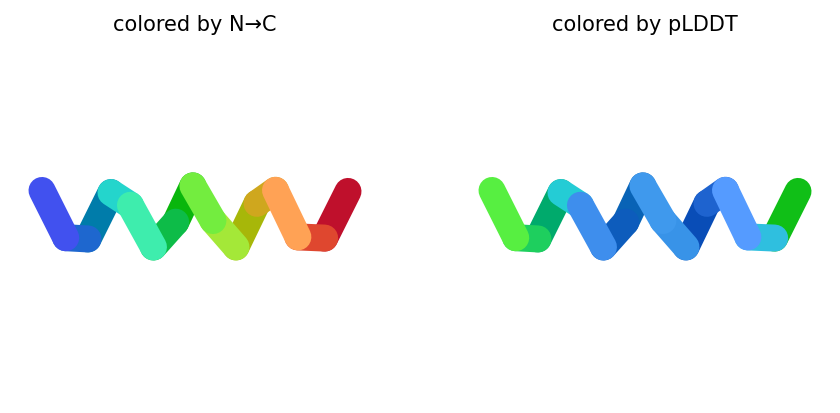

2025-11-17 09:43:36,620 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.4 pTM=0.0356
2025-11-17 09:43:39,205 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.6 pTM=0.0382 tol=0.0901
2025-11-17 09:43:41,786 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=73.8 pTM=0.0388 tol=0.103
2025-11-17 09:43:44,374 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.1 pTM=0.0373 tol=0.0486
2025-11-17 09:43:44,374 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


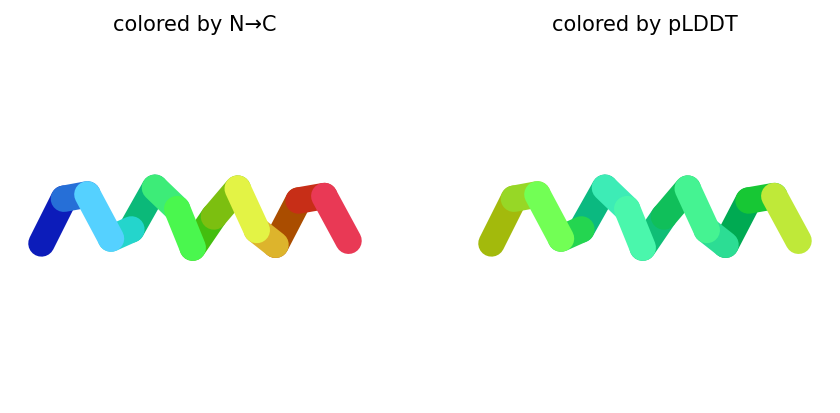

2025-11-17 09:43:47,019 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=70.2 pTM=0.0314
2025-11-17 09:43:49,613 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=66.1 pTM=0.0306 tol=1.08
2025-11-17 09:43:52,207 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=64.2 pTM=0.0292 tol=1.26
2025-11-17 09:43:54,802 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=63.5 pTM=0.028 tol=1.2
2025-11-17 09:43:54,803 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


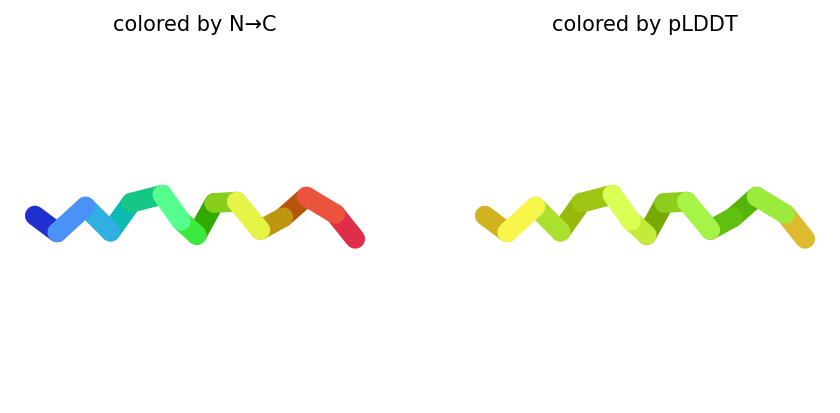

2025-11-17 09:43:57,462 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=76.6 pTM=0.0383
2025-11-17 09:44:00,059 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=77.4 pTM=0.0398 tol=0.2
2025-11-17 09:44:02,657 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=78.1 pTM=0.0403 tol=0.123
2025-11-17 09:44:05,251 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=79.2 pTM=0.0406 tol=0.118
2025-11-17 09:44:05,252 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


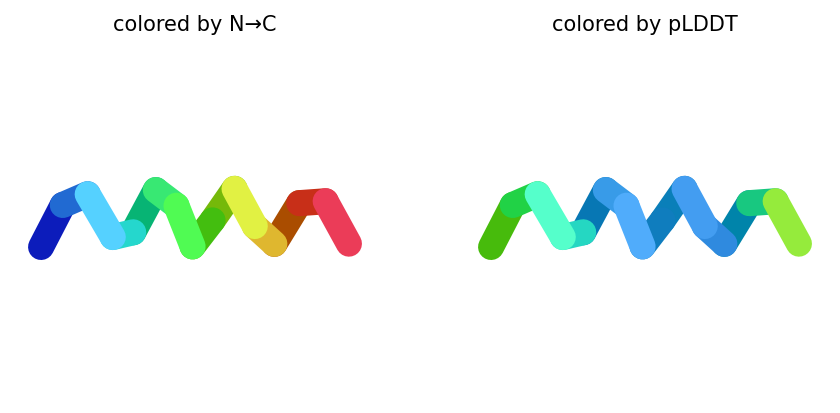

2025-11-17 09:44:07,895 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=64.5 pTM=0.0314
2025-11-17 09:44:10,483 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=66 pTM=0.0321 tol=0.183
2025-11-17 09:44:13,072 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=67.6 pTM=0.0325 tol=0.0529
2025-11-17 09:44:15,660 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=66.4 pTM=0.0321 tol=0.201
2025-11-17 09:44:15,660 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


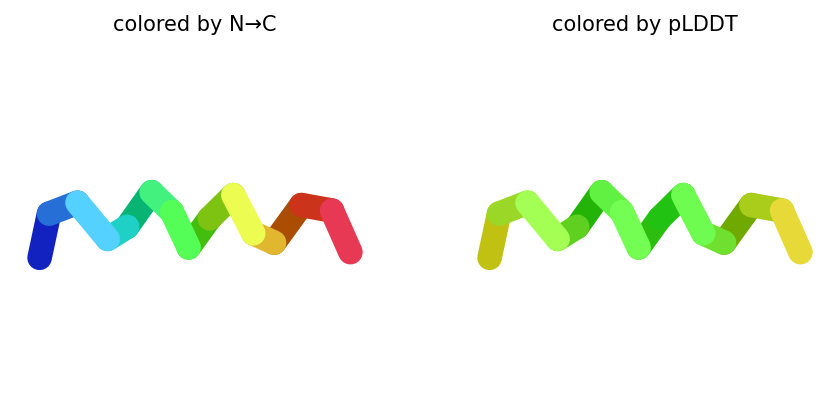

2025-11-17 09:44:15,733 reranking models by 'plddt' metric
2025-11-17 09:44:15,734 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=81.1 pTM=0.0422
2025-11-17 09:44:15,734 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=79.2 pTM=0.0406
2025-11-17 09:44:15,735 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=72.1 pTM=0.0373
2025-11-17 09:44:15,735 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=66.4 pTM=0.0321
2025-11-17 09:44:15,735 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=63.5 pTM=0.028
2025-11-17 09:44:17,189 Query 138/146: peptide_286_IC50_488.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:44:17,490 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


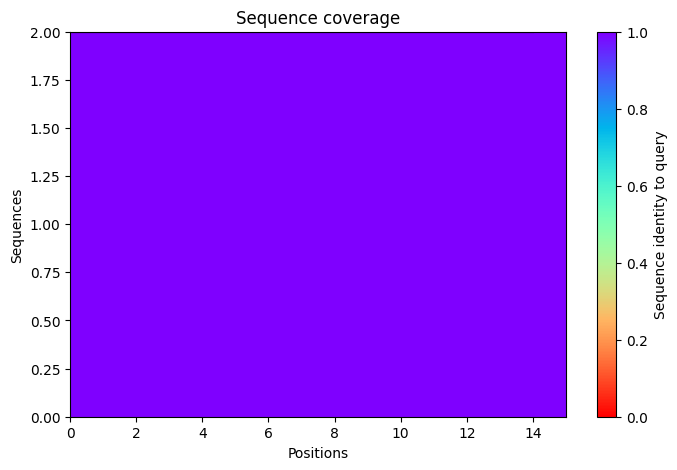

2025-11-17 09:44:32,458 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=78.6 pTM=0.0395
2025-11-17 09:44:35,037 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=78.5 pTM=0.0402 tol=0.197
2025-11-17 09:44:37,616 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=79 pTM=0.0408 tol=0.0827
2025-11-17 09:44:40,192 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=78.9 pTM=0.0405 tol=0.127
2025-11-17 09:44:40,193 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


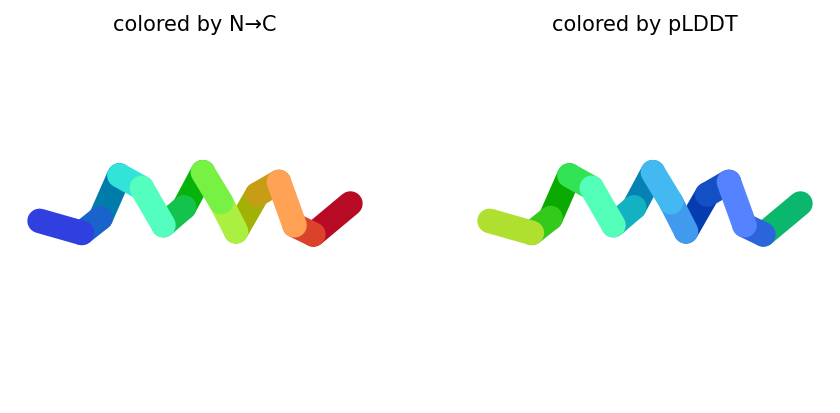

2025-11-17 09:44:42,851 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=75.2 pTM=0.038
2025-11-17 09:44:45,434 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=75.5 pTM=0.039 tol=0.234
2025-11-17 09:44:48,018 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=75.1 pTM=0.0388 tol=0.0816
2025-11-17 09:44:50,599 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=74.5 pTM=0.0382 tol=0.12
2025-11-17 09:44:50,599 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


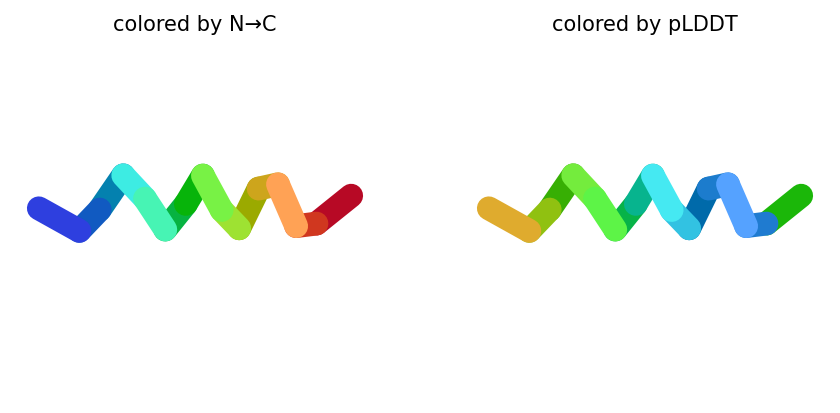

2025-11-17 09:44:53,241 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=77.4 pTM=0.0362
2025-11-17 09:44:55,835 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=79.9 pTM=0.0387 tol=0.401
2025-11-17 09:44:58,428 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=81.6 pTM=0.0395 tol=0.11
2025-11-17 09:45:01,020 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=81.3 pTM=0.0399 tol=0.0809
2025-11-17 09:45:01,021 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


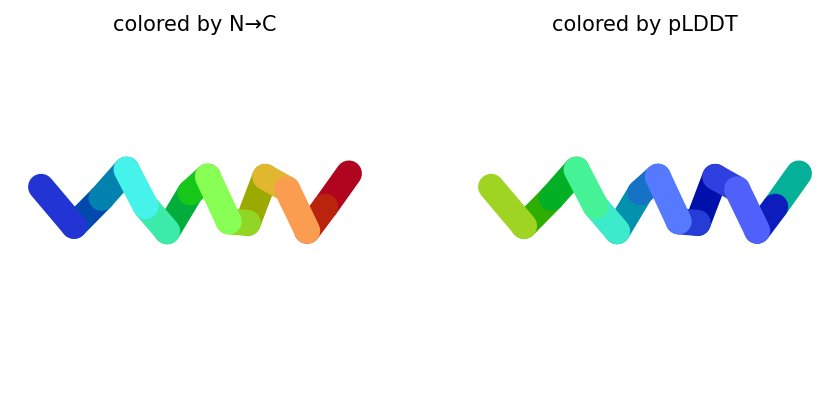

2025-11-17 09:45:03,670 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=79.1 pTM=0.0399
2025-11-17 09:45:06,272 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=81.9 pTM=0.0427 tol=0.149
2025-11-17 09:45:08,874 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=82.8 pTM=0.0429 tol=0.112
2025-11-17 09:45:11,471 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=83.2 pTM=0.0429 tol=0.0743
2025-11-17 09:45:11,472 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


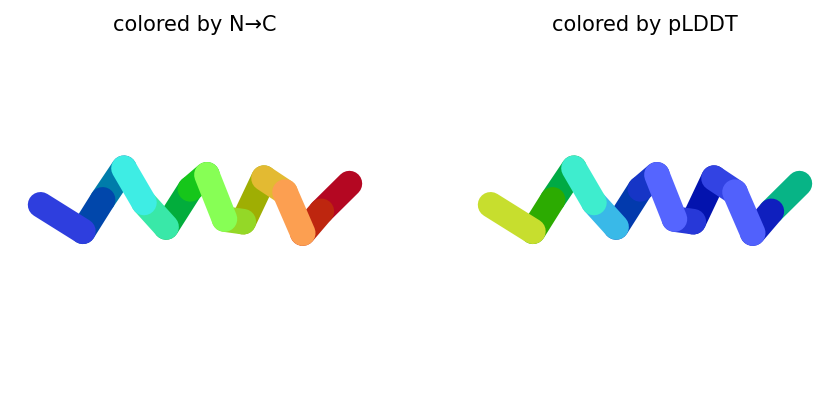

2025-11-17 09:45:14,119 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=88.8 pTM=0.0441
2025-11-17 09:45:16,712 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=89.6 pTM=0.0453 tol=0.0776
2025-11-17 09:45:19,306 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=89.8 pTM=0.0451 tol=0.126
2025-11-17 09:45:21,893 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=89.9 pTM=0.0454 tol=0.0613
2025-11-17 09:45:21,894 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


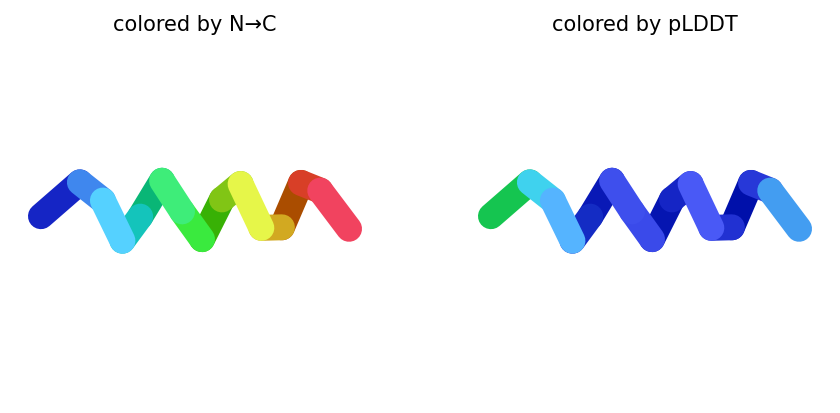

2025-11-17 09:45:21,942 reranking models by 'plddt' metric
2025-11-17 09:45:21,942 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=89.9 pTM=0.0454
2025-11-17 09:45:21,943 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=83.2 pTM=0.0429
2025-11-17 09:45:21,943 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=81.3 pTM=0.0399
2025-11-17 09:45:21,943 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=78.9 pTM=0.0405
2025-11-17 09:45:21,943 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=74.5 pTM=0.0382
2025-11-17 09:45:23,210 Query 139/146: peptide_287_IC50_495.2 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:45:23,488 Sleeping for 7s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:07 remaining: 00:00]


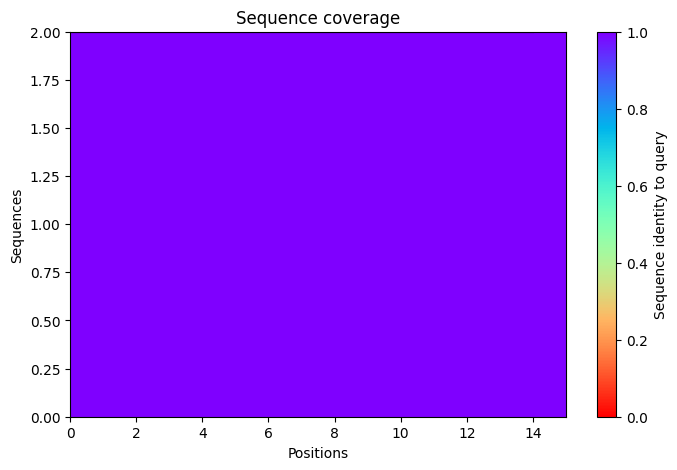

2025-11-17 09:45:36,399 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=61.8 pTM=0.0289
2025-11-17 09:45:38,976 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=65.8 pTM=0.0296 tol=2.58
2025-11-17 09:45:41,552 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=73.6 pTM=0.0302 tol=0.594
2025-11-17 09:45:44,131 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=72.1 pTM=0.0304 tol=0.122
2025-11-17 09:45:44,131 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


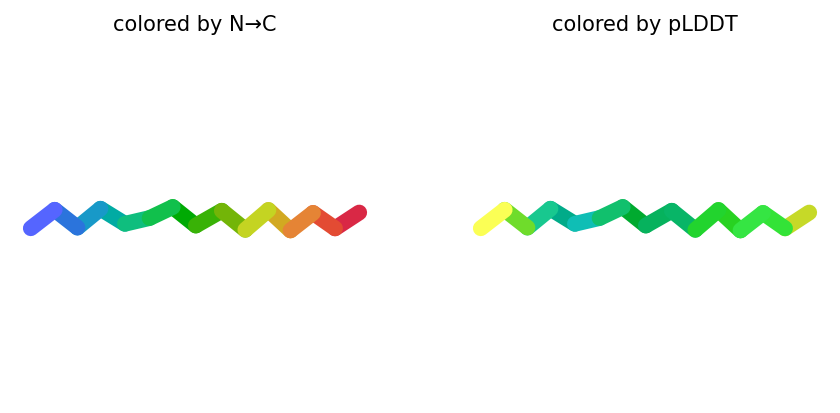

2025-11-17 09:45:46,773 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=65.3 pTM=0.0289
2025-11-17 09:45:49,358 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=72.5 pTM=0.0301 tol=0.97
2025-11-17 09:45:51,938 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=74.5 pTM=0.0305 tol=0.333
2025-11-17 09:45:54,523 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.6 pTM=0.0297 tol=0.266
2025-11-17 09:45:54,524 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


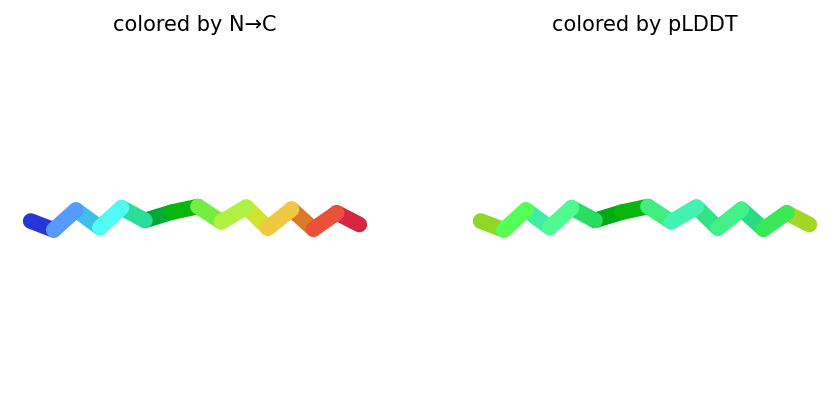

2025-11-17 09:45:57,170 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=73.4 pTM=0.0293
2025-11-17 09:45:59,760 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=76.6 pTM=0.0297 tol=0.471
2025-11-17 09:46:02,354 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=78.6 pTM=0.0301 tol=0.294
2025-11-17 09:46:04,950 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=79.5 pTM=0.0299 tol=0.136
2025-11-17 09:46:04,951 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


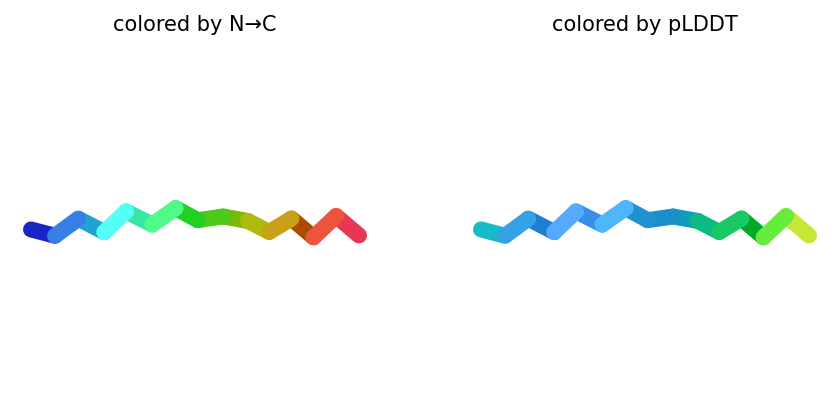

2025-11-17 09:46:07,598 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=65.2 pTM=0.0285
2025-11-17 09:46:10,192 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=69.9 pTM=0.029 tol=0.632
2025-11-17 09:46:12,785 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.1 pTM=0.0294 tol=0.165
2025-11-17 09:46:15,375 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.3 pTM=0.0293 tol=0.174
2025-11-17 09:46:15,376 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


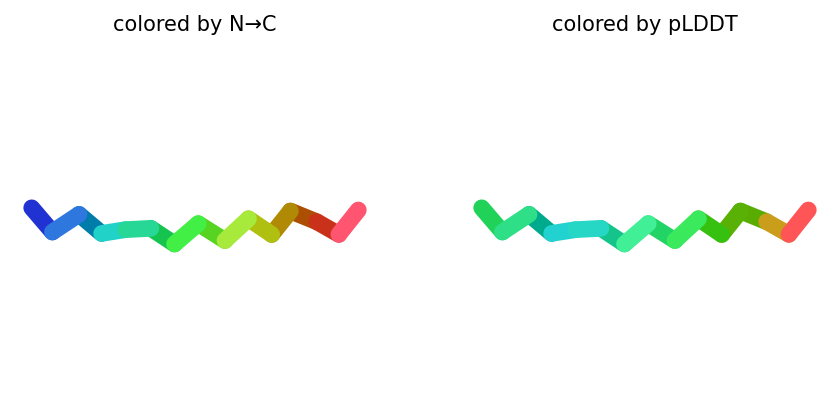

2025-11-17 09:46:18,021 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=64.4 pTM=0.03
2025-11-17 09:46:20,609 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=64.1 pTM=0.0282 tol=3.42
2025-11-17 09:46:23,199 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=70.5 pTM=0.0298 tol=1.45
2025-11-17 09:46:25,788 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=72.7 pTM=0.0303 tol=1
2025-11-17 09:46:25,788 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


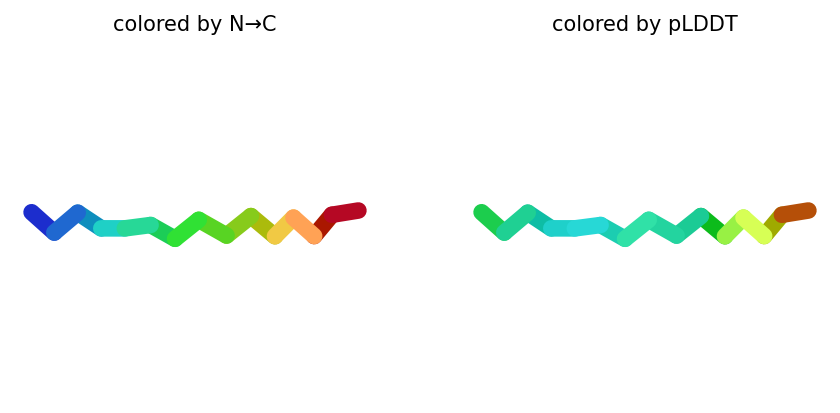

2025-11-17 09:46:25,840 reranking models by 'plddt' metric
2025-11-17 09:46:25,840 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=79.5 pTM=0.0299
2025-11-17 09:46:25,840 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=72.7 pTM=0.0303
2025-11-17 09:46:25,841 rank_003_alphafold2_ptm_model_2_seed_000 pLDDT=72.6 pTM=0.0297
2025-11-17 09:46:25,841 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=72.1 pTM=0.0304
2025-11-17 09:46:25,841 rank_005_alphafold2_ptm_model_4_seed_000 pLDDT=71.3 pTM=0.0293
2025-11-17 09:46:27,462 Query 140/146: peptide_288_IC50_490.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:46:27,732 Sleeping for 6s. Reason: PENDING


PENDING:   0%|          | 0/150 [elapsed: 00:06 remaining: ?]

2025-11-17 09:46:33,994 Sleeping for 10s. Reason: PENDING


PENDING:   0%|          | 0/150 [elapsed: 00:16 remaining: ?]

2025-11-17 09:46:44,269 Sleeping for 8s. Reason: PENDING


PENDING:   0%|          | 0/150 [elapsed: 00:25 remaining: ?]

2025-11-17 09:46:52,536 Sleeping for 8s. Reason: PENDING


RUNNING:   5%|▌         | 8/150 [elapsed: 00:33 remaining: 09:52]

2025-11-17 09:47:00,830 Sleeping for 10s. Reason: RUNNING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:43 remaining: 00:00]


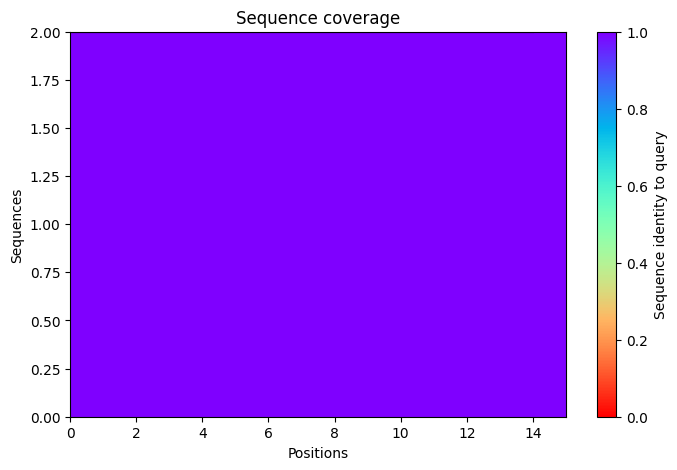

2025-11-17 09:47:16,262 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=78.4 pTM=0.0396
2025-11-17 09:47:18,835 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=80.8 pTM=0.0404 tol=0.425
2025-11-17 09:47:21,412 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=84 pTM=0.0428 tol=0.486
2025-11-17 09:47:23,988 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=83.9 pTM=0.0424 tol=0.0717
2025-11-17 09:47:23,989 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


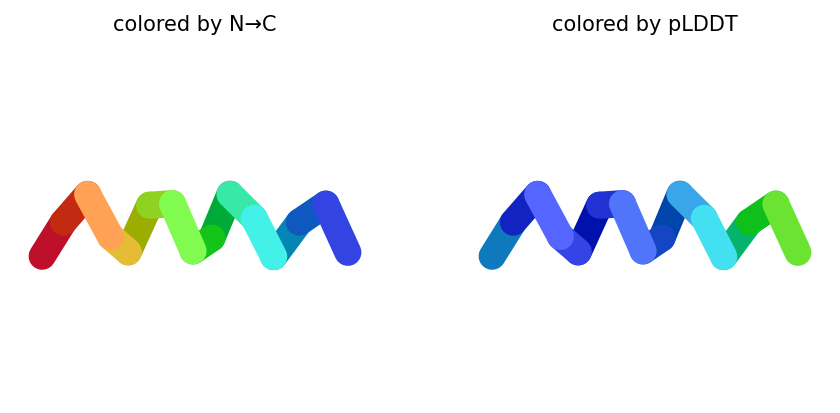

2025-11-17 09:47:26,621 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=81.8 pTM=0.0418
2025-11-17 09:47:29,203 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=83.2 pTM=0.0428 tol=0.129
2025-11-17 09:47:31,784 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=86.2 pTM=0.0446 tol=0.0428
2025-11-17 09:47:34,370 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=87.3 pTM=0.045 tol=0.0415
2025-11-17 09:47:34,371 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


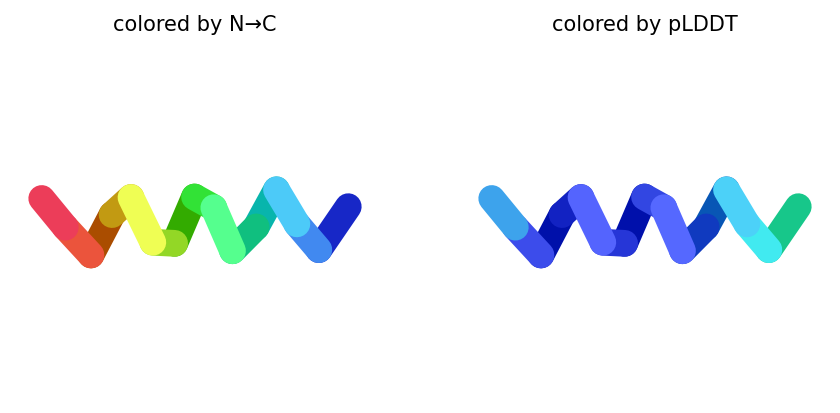

2025-11-17 09:47:37,040 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=88.4 pTM=0.0427
2025-11-17 09:47:39,631 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=86.6 pTM=0.0419 tol=0.11
2025-11-17 09:47:42,223 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=87.9 pTM=0.0431 tol=0.105
2025-11-17 09:47:44,819 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=87.7 pTM=0.0428 tol=0.0807
2025-11-17 09:47:44,820 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


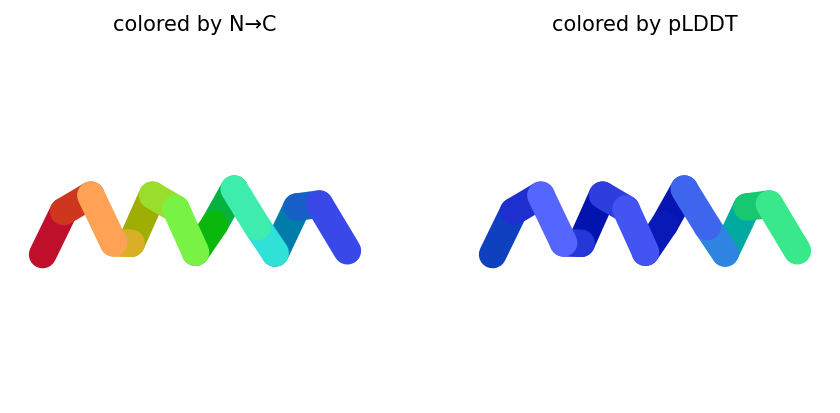

2025-11-17 09:47:47,475 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=82.9 pTM=0.0424
2025-11-17 09:47:50,080 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=86.9 pTM=0.0447 tol=0.337
2025-11-17 09:47:52,679 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=89.9 pTM=0.0466 tol=0.101
2025-11-17 09:47:55,278 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=90.2 pTM=0.0466 tol=0.0463
2025-11-17 09:47:55,279 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


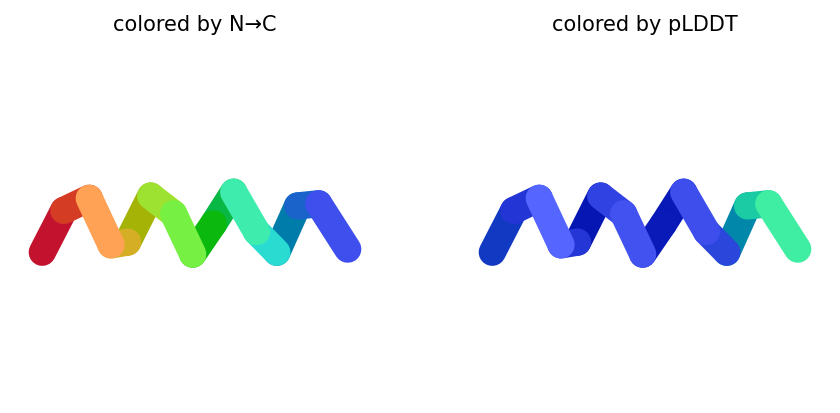

2025-11-17 09:47:57,929 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=90.2 pTM=0.0447
2025-11-17 09:48:00,524 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=92.3 pTM=0.0466 tol=0.0638
2025-11-17 09:48:03,117 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=92.8 pTM=0.047 tol=0.0458
2025-11-17 09:48:05,707 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=93.4 pTM=0.0477 tol=0.0466
2025-11-17 09:48:05,708 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


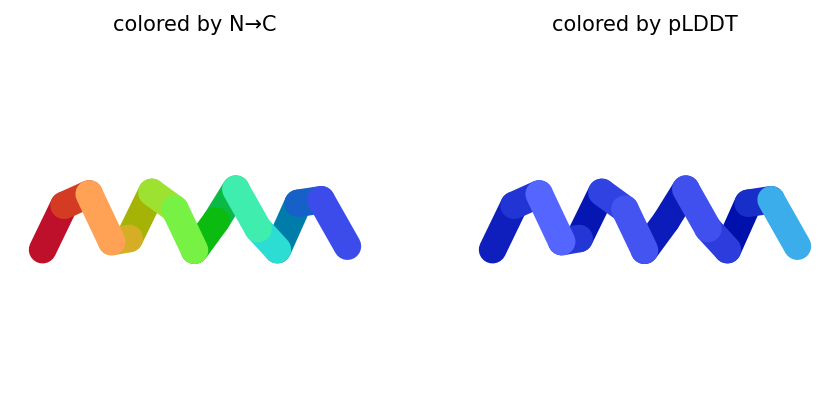

2025-11-17 09:48:05,759 reranking models by 'plddt' metric
2025-11-17 09:48:05,759 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=93.4 pTM=0.0477
2025-11-17 09:48:05,760 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=90.2 pTM=0.0466
2025-11-17 09:48:05,760 rank_003_alphafold2_ptm_model_3_seed_000 pLDDT=87.7 pTM=0.0428
2025-11-17 09:48:05,760 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=87.3 pTM=0.045
2025-11-17 09:48:05,760 rank_005_alphafold2_ptm_model_1_seed_000 pLDDT=83.9 pTM=0.0424
2025-11-17 09:48:07,050 Query 141/146: peptide_289_IC50_491.6 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:48:07,326 Sleeping for 10s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:10 remaining: 00:00]


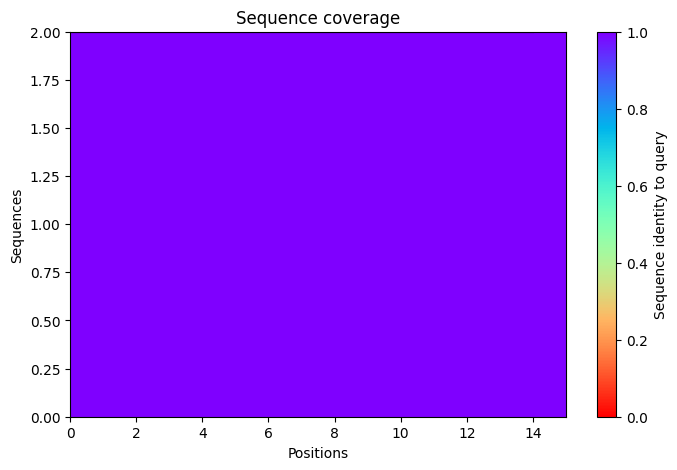

2025-11-17 09:48:22,770 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=78.6 pTM=0.041
2025-11-17 09:48:25,348 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=80.8 pTM=0.0422 tol=0.146
2025-11-17 09:48:27,924 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=81 pTM=0.0422 tol=0.109
2025-11-17 09:48:30,499 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=82.4 pTM=0.0433 tol=0.102
2025-11-17 09:48:30,500 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


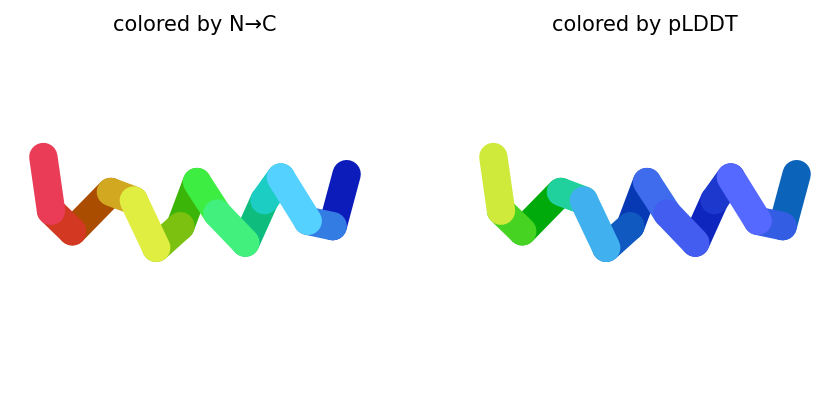

2025-11-17 09:48:33,134 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=72.8 pTM=0.0386
2025-11-17 09:48:35,714 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.2 pTM=0.0381 tol=0.576
2025-11-17 09:48:38,297 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=68.1 pTM=0.036 tol=0.509
2025-11-17 09:48:40,882 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=69.5 pTM=0.0374 tol=0.161
2025-11-17 09:48:40,883 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


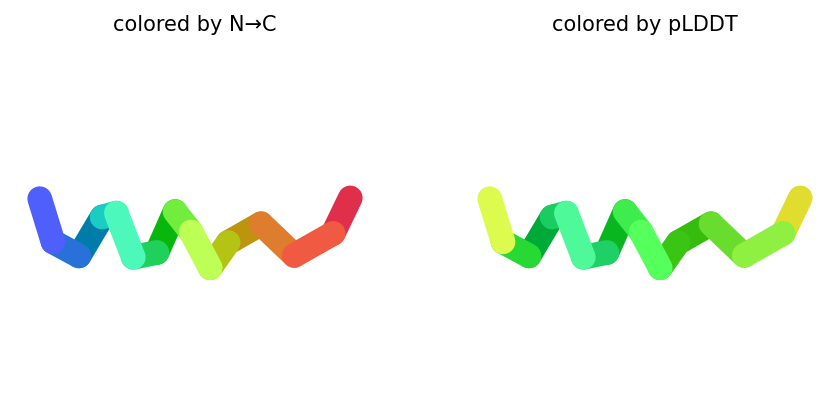

2025-11-17 09:48:43,515 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=68.1 pTM=0.0301
2025-11-17 09:48:46,101 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=65.1 pTM=0.029 tol=1.52
2025-11-17 09:48:48,693 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=65.1 pTM=0.0278 tol=0.554
2025-11-17 09:48:51,287 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=64.1 pTM=0.0285 tol=0.416
2025-11-17 09:48:51,287 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


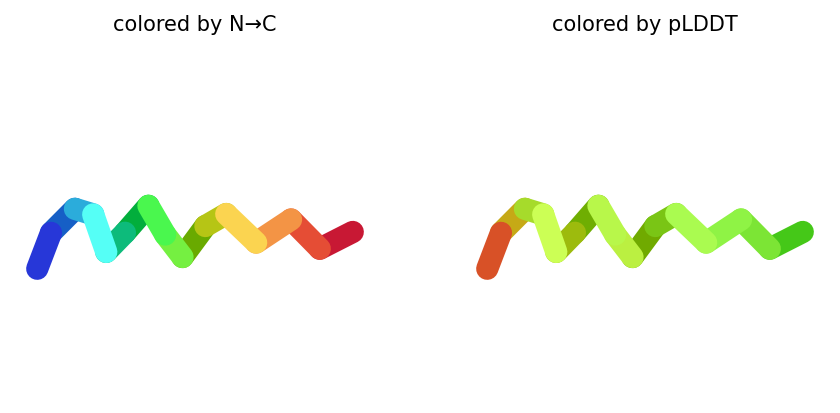

2025-11-17 09:48:53,934 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=74.6 pTM=0.0386
2025-11-17 09:48:56,530 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=72.9 pTM=0.038 tol=0.181
2025-11-17 09:48:59,125 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=71.3 pTM=0.0372 tol=0.15
2025-11-17 09:49:01,725 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=70.2 pTM=0.0367 tol=0.25
2025-11-17 09:49:01,726 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


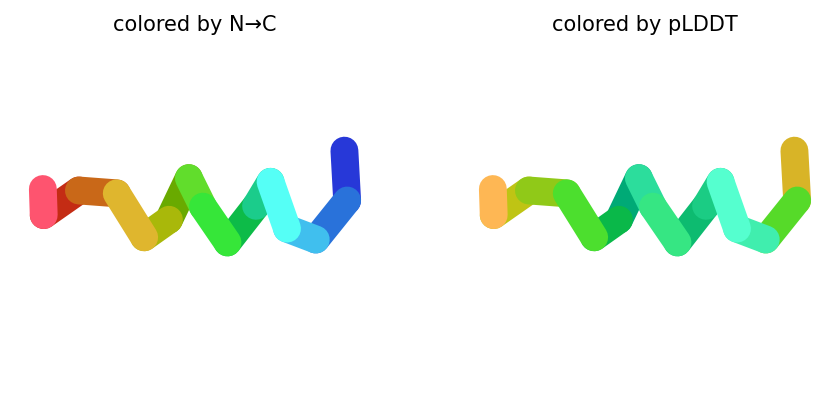

2025-11-17 09:49:04,409 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=81.8 pTM=0.0414
2025-11-17 09:49:07,005 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=78.7 pTM=0.0415 tol=0.633
2025-11-17 09:49:09,598 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=76.1 pTM=0.0406 tol=0.562
2025-11-17 09:49:12,192 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=74.8 pTM=0.0408 tol=0.211
2025-11-17 09:49:12,193 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


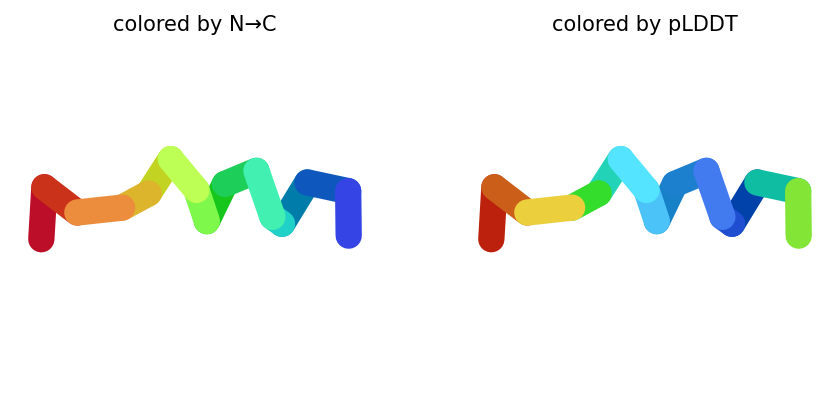

2025-11-17 09:49:12,265 reranking models by 'plddt' metric
2025-11-17 09:49:12,266 rank_001_alphafold2_ptm_model_1_seed_000 pLDDT=82.4 pTM=0.0433
2025-11-17 09:49:12,266 rank_002_alphafold2_ptm_model_5_seed_000 pLDDT=74.8 pTM=0.0408
2025-11-17 09:49:12,267 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=70.2 pTM=0.0367
2025-11-17 09:49:12,267 rank_004_alphafold2_ptm_model_2_seed_000 pLDDT=69.5 pTM=0.0374
2025-11-17 09:49:12,267 rank_005_alphafold2_ptm_model_3_seed_000 pLDDT=64.1 pTM=0.0285
2025-11-17 09:49:13,581 Query 142/146: peptide_290_IC50_495.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:49:13,858 Sleeping for 9s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


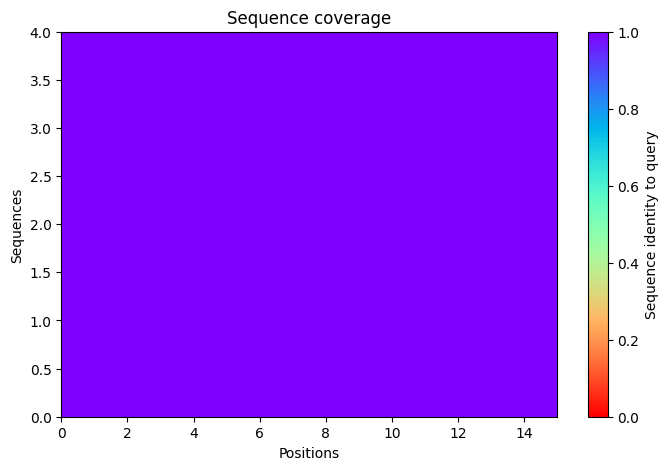

2025-11-17 09:49:28,613 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=66.7 pTM=0.0337
2025-11-17 09:49:31,190 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=71.8 pTM=0.0356 tol=0.482
2025-11-17 09:49:33,770 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=75.1 pTM=0.0371 tol=0.248
2025-11-17 09:49:36,350 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=74.1 pTM=0.0367 tol=0.11
2025-11-17 09:49:36,351 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


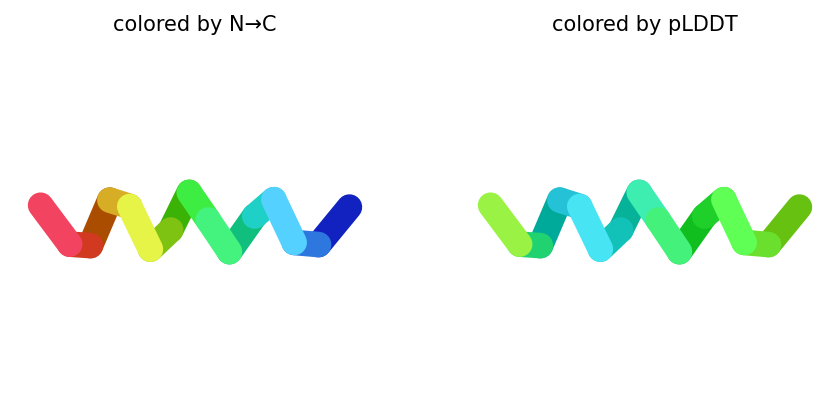

2025-11-17 09:49:38,988 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=60.9 pTM=0.0319
2025-11-17 09:49:41,571 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=60.7 pTM=0.0321 tol=0.158
2025-11-17 09:49:44,154 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=62.9 pTM=0.0338 tol=0.534
2025-11-17 09:49:46,743 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=62.6 pTM=0.0334 tol=0.178
2025-11-17 09:49:46,744 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


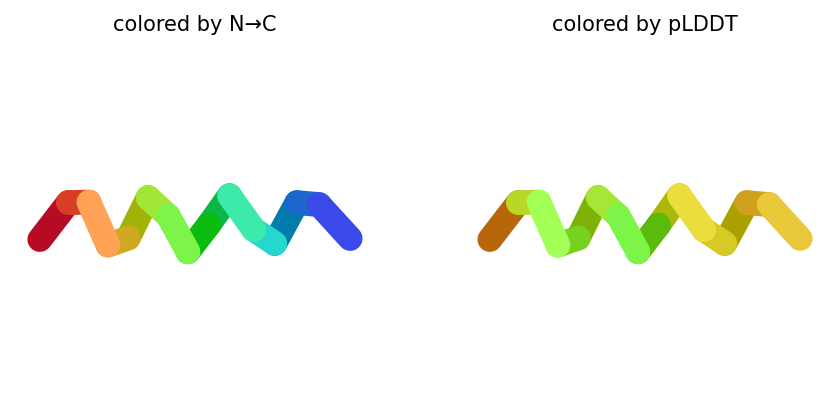

2025-11-17 09:49:49,388 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=64.6 pTM=0.0297
2025-11-17 09:49:51,988 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=69 pTM=0.0309 tol=1.17
2025-11-17 09:49:54,585 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=69.6 pTM=0.0314 tol=0.41
2025-11-17 09:49:57,180 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=71.1 pTM=0.032 tol=0.216
2025-11-17 09:49:57,181 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


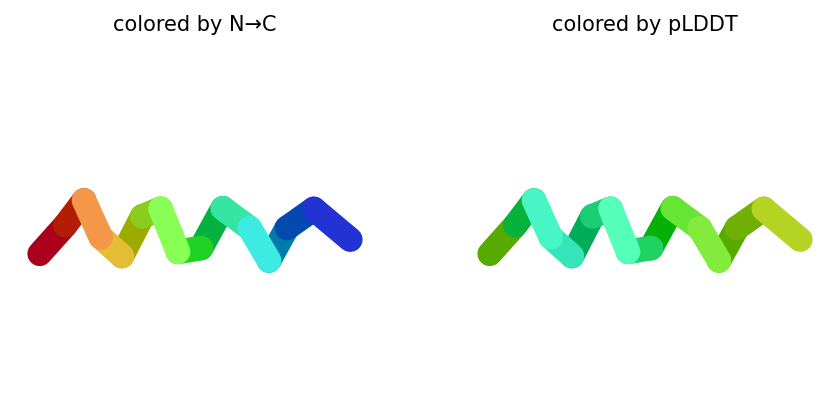

2025-11-17 09:49:59,830 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=62.6 pTM=0.0294
2025-11-17 09:50:02,425 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=63.2 pTM=0.0298 tol=1.72
2025-11-17 09:50:05,017 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=68.9 pTM=0.033 tol=1.62
2025-11-17 09:50:07,607 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=71.9 pTM=0.035 tol=0.52
2025-11-17 09:50:07,608 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


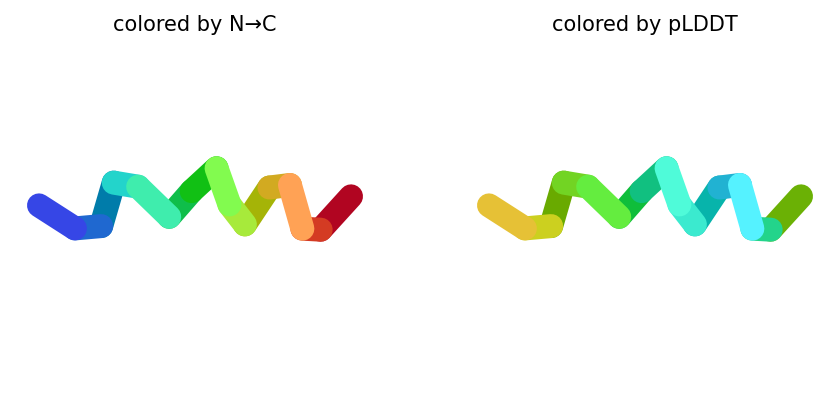

2025-11-17 09:50:10,244 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=73.4 pTM=0.0346
2025-11-17 09:50:12,834 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=75.9 pTM=0.0361 tol=0.17
2025-11-17 09:50:15,417 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=80.2 pTM=0.0382 tol=0.169
2025-11-17 09:50:18,009 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=79.9 pTM=0.038 tol=0.0363
2025-11-17 09:50:18,010 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


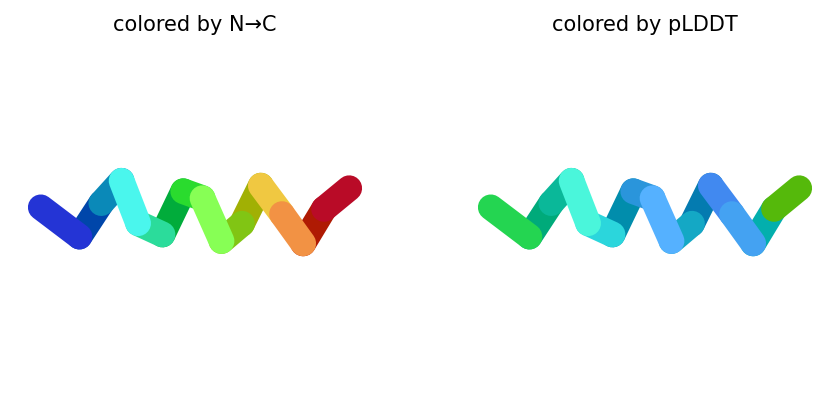

2025-11-17 09:50:18,062 reranking models by 'plddt' metric
2025-11-17 09:50:18,062 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=79.9 pTM=0.038
2025-11-17 09:50:18,064 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=74.1 pTM=0.0367
2025-11-17 09:50:18,064 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=71.9 pTM=0.035
2025-11-17 09:50:18,065 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=71.1 pTM=0.032
2025-11-17 09:50:18,065 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=62.6 pTM=0.0334
2025-11-17 09:50:19,719 Query 143/146: peptide_294_IC50_494.7 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:50:19,999 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:08 remaining: 00:00]


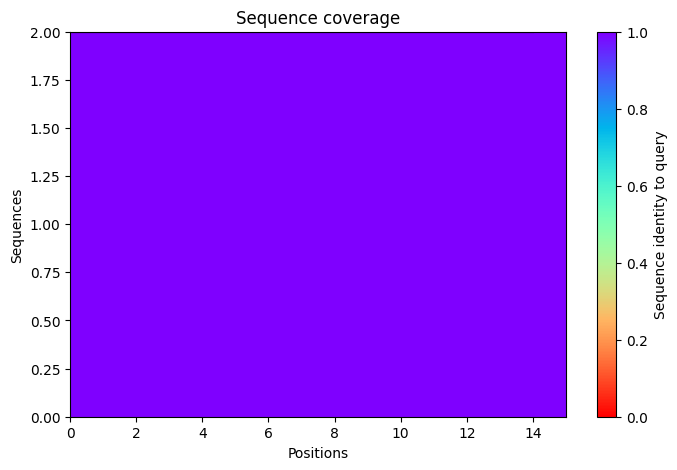

2025-11-17 09:50:33,453 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=72.1 pTM=0.03
2025-11-17 09:50:36,028 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=72.4 pTM=0.0303 tol=0.269
2025-11-17 09:50:38,608 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=74.3 pTM=0.0306 tol=0.47
2025-11-17 09:50:41,188 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=73 pTM=0.0304 tol=0.364
2025-11-17 09:50:41,189 alphafold2_ptm_model_1_seed_000 took 10.4s (3 recycles)


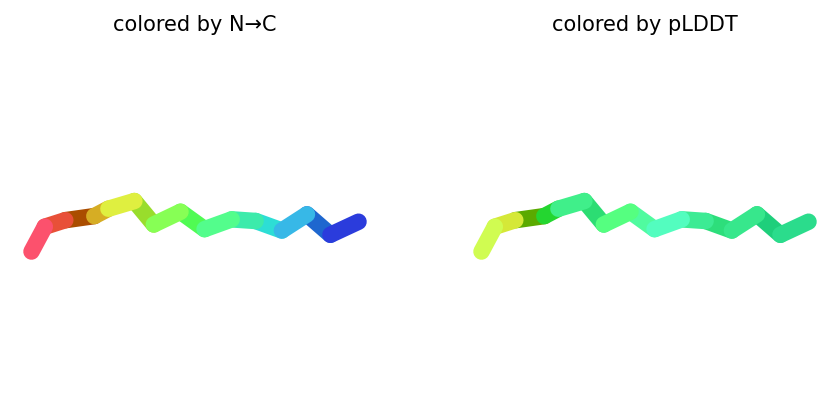

2025-11-17 09:50:43,818 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=69.7 pTM=0.0291
2025-11-17 09:50:46,401 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=70.4 pTM=0.0293 tol=0.783
2025-11-17 09:50:48,985 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=72.2 pTM=0.0296 tol=0.59
2025-11-17 09:50:51,573 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.2 pTM=0.0297 tol=0.411
2025-11-17 09:50:51,573 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


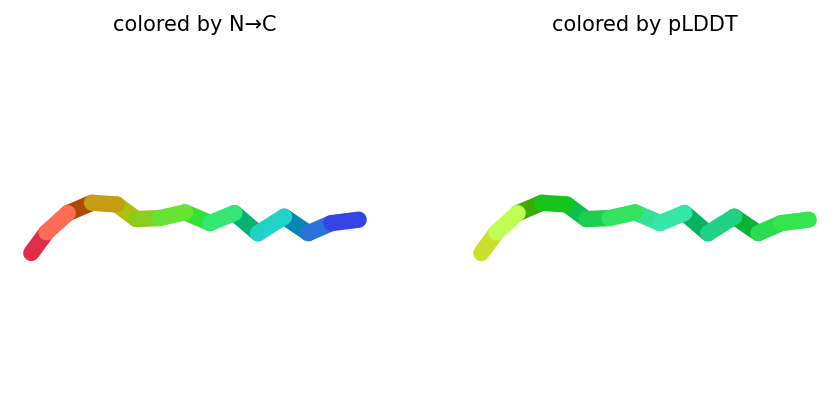

2025-11-17 09:50:54,234 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=75.4 pTM=0.0299
2025-11-17 09:50:56,821 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=78.6 pTM=0.0307 tol=0.799
2025-11-17 09:50:59,414 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=76.1 pTM=0.0308 tol=0.732
2025-11-17 09:51:02,008 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=80.8 pTM=0.0306 tol=0.772
2025-11-17 09:51:02,008 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


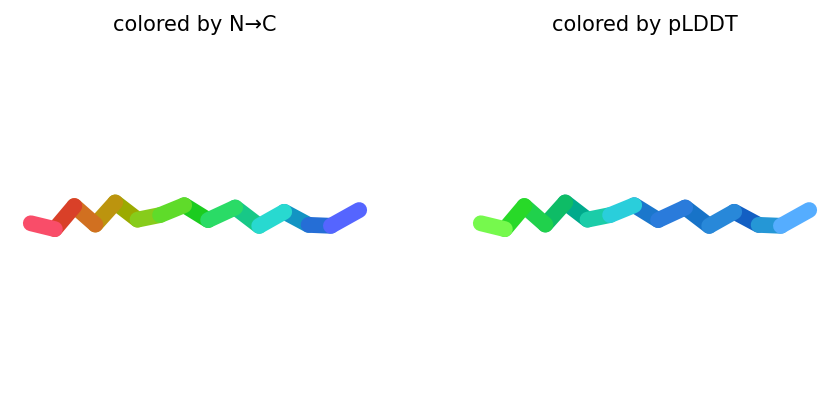

2025-11-17 09:51:04,660 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=74.1 pTM=0.0298
2025-11-17 09:51:07,258 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=75.4 pTM=0.0306 tol=0.534
2025-11-17 09:51:09,857 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=76.1 pTM=0.0308 tol=0.13
2025-11-17 09:51:12,456 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=76.2 pTM=0.0307 tol=0.134
2025-11-17 09:51:12,457 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


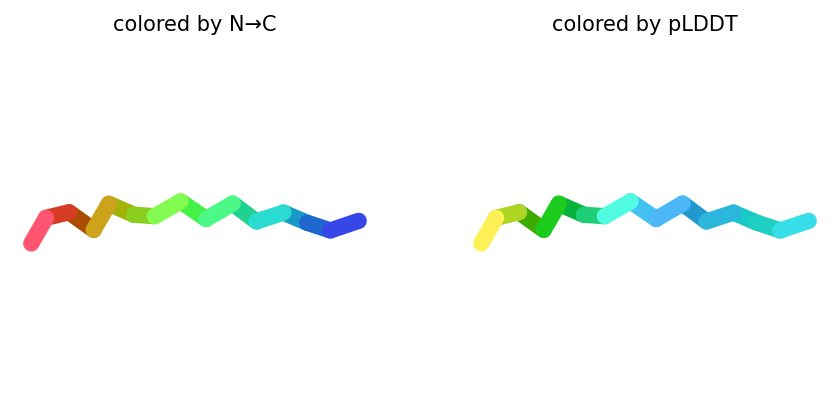

2025-11-17 09:51:15,104 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=72.3 pTM=0.0294
2025-11-17 09:51:17,702 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=73.9 pTM=0.03 tol=0.764
2025-11-17 09:51:20,295 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=75.1 pTM=0.0306 tol=0.315
2025-11-17 09:51:22,883 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=75.1 pTM=0.0303 tol=0.263
2025-11-17 09:51:22,884 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


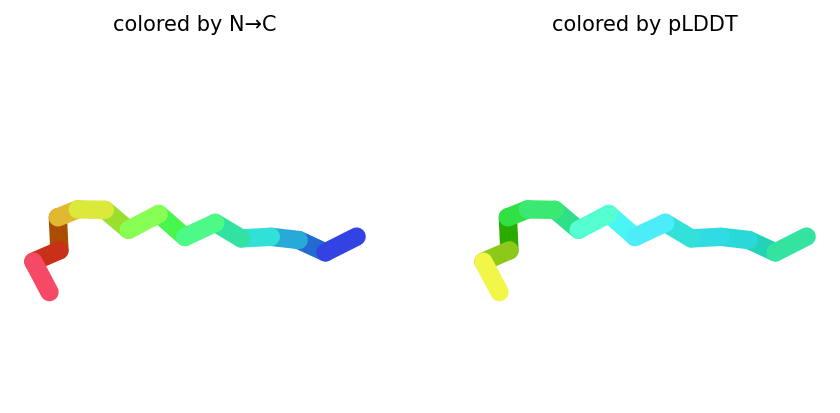

2025-11-17 09:51:22,933 reranking models by 'plddt' metric
2025-11-17 09:51:22,934 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=80.8 pTM=0.0306
2025-11-17 09:51:22,934 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=76.2 pTM=0.0307
2025-11-17 09:51:22,934 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=75.1 pTM=0.0303
2025-11-17 09:51:22,935 rank_004_alphafold2_ptm_model_1_seed_000 pLDDT=73 pTM=0.0304
2025-11-17 09:51:22,935 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.2 pTM=0.0297
2025-11-17 09:51:24,201 Query 144/146: peptide_296_IC50_498.9 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:51:24,726 Sleeping for 8s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:09 remaining: 00:00]


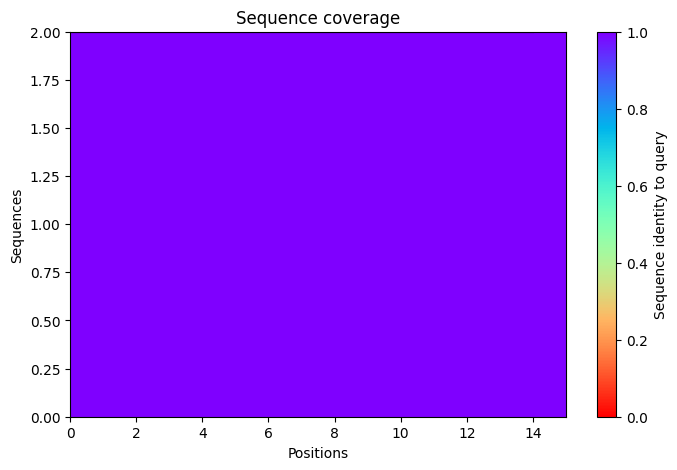

2025-11-17 09:51:38,166 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=76 pTM=0.0373
2025-11-17 09:51:40,742 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=78.8 pTM=0.0392 tol=0.229
2025-11-17 09:51:43,318 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=80 pTM=0.04 tol=0.142
2025-11-17 09:51:45,892 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=78.6 pTM=0.0394 tol=0.135
2025-11-17 09:51:45,893 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


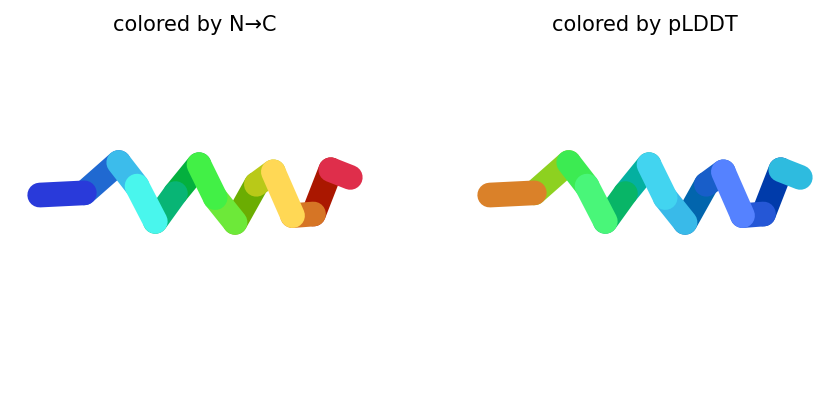

2025-11-17 09:51:48,524 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=71 pTM=0.0352
2025-11-17 09:51:51,104 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=71.8 pTM=0.0358 tol=0.362
2025-11-17 09:51:53,689 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=71.3 pTM=0.0351 tol=0.156
2025-11-17 09:51:56,274 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=72.4 pTM=0.0357 tol=0.135
2025-11-17 09:51:56,275 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


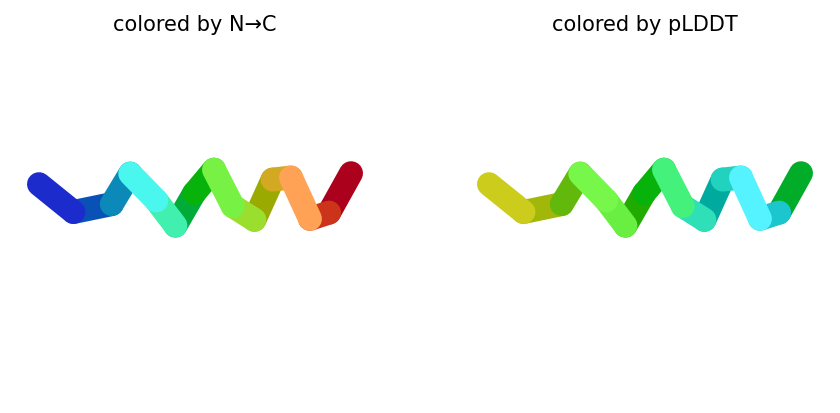

2025-11-17 09:51:58,911 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=71.3 pTM=0.0314
2025-11-17 09:52:01,500 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=72.2 pTM=0.033 tol=0.482
2025-11-17 09:52:04,093 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=71.6 pTM=0.0326 tol=0.509
2025-11-17 09:52:06,687 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.4 pTM=0.0325 tol=0.163
2025-11-17 09:52:06,688 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


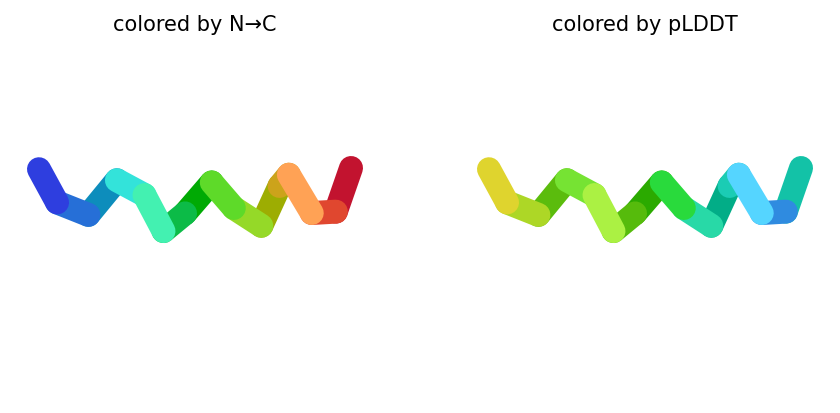

2025-11-17 09:52:09,374 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=75.9 pTM=0.0378
2025-11-17 09:52:11,972 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=79.4 pTM=0.0404 tol=0.292
2025-11-17 09:52:14,570 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=80.7 pTM=0.0403 tol=0.076
2025-11-17 09:52:17,169 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=82.2 pTM=0.0411 tol=0.105
2025-11-17 09:52:17,169 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


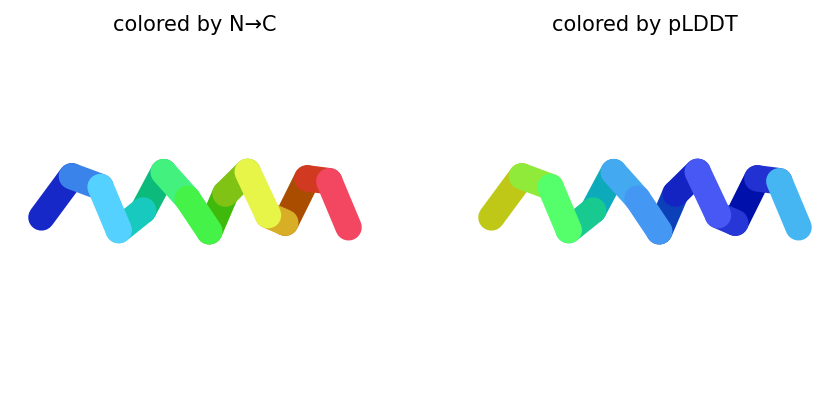

2025-11-17 09:52:19,825 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=90.4 pTM=0.0449
2025-11-17 09:52:22,418 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=90.6 pTM=0.0452 tol=0.106
2025-11-17 09:52:25,010 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=90.5 pTM=0.0454 tol=0.183
2025-11-17 09:52:27,593 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=90.8 pTM=0.0458 tol=0.0909
2025-11-17 09:52:27,594 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


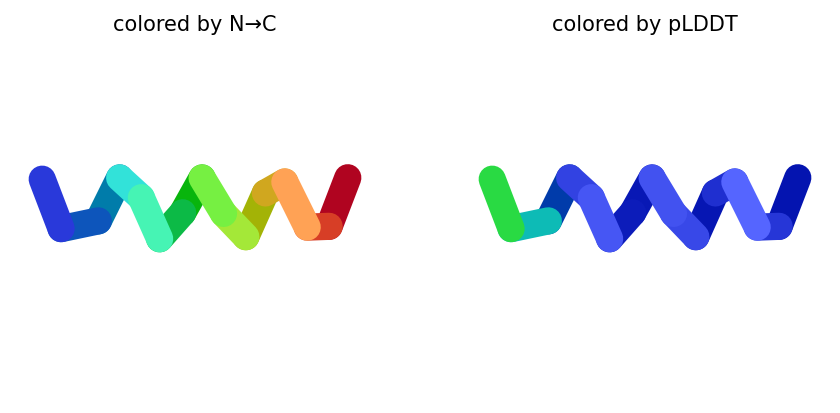

2025-11-17 09:52:27,643 reranking models by 'plddt' metric
2025-11-17 09:52:27,643 rank_001_alphafold2_ptm_model_5_seed_000 pLDDT=90.8 pTM=0.0458
2025-11-17 09:52:27,643 rank_002_alphafold2_ptm_model_4_seed_000 pLDDT=82.2 pTM=0.0411
2025-11-17 09:52:27,644 rank_003_alphafold2_ptm_model_1_seed_000 pLDDT=78.6 pTM=0.0394
2025-11-17 09:52:27,644 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=72.4 pTM=0.0325
2025-11-17 09:52:27,644 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=72.4 pTM=0.0357
2025-11-17 09:52:28,953 Query 145/146: peptide_297_IC50_499.0 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:52:29,233 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


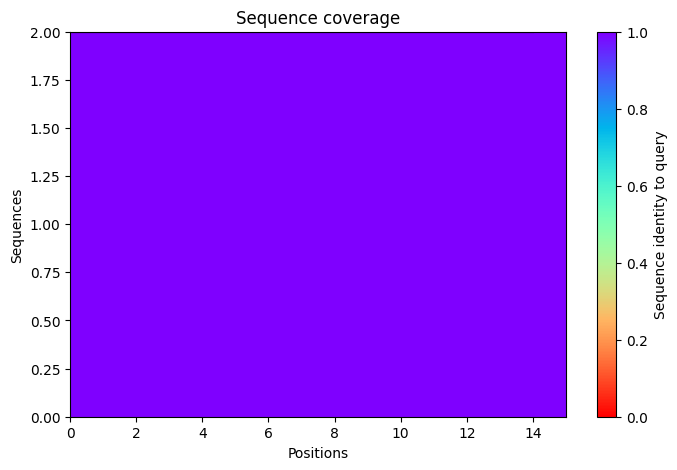

2025-11-17 09:52:40,692 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=62.1 pTM=0.0277
2025-11-17 09:52:43,271 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=62.1 pTM=0.0281 tol=1.74
2025-11-17 09:52:45,848 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=62.8 pTM=0.0281 tol=0.55
2025-11-17 09:52:48,427 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=62.9 pTM=0.0281 tol=0.706
2025-11-17 09:52:48,428 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


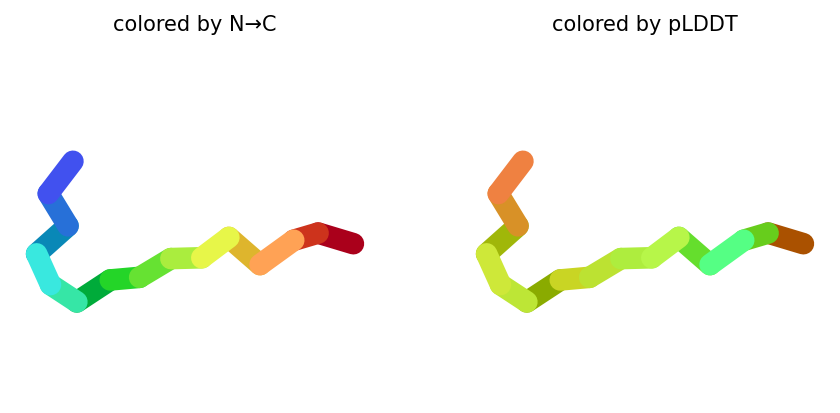

2025-11-17 09:52:51,065 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=61.1 pTM=0.0266
2025-11-17 09:52:53,645 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=61.4 pTM=0.0273 tol=0.305
2025-11-17 09:52:56,229 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=59.5 pTM=0.0273 tol=1.5
2025-11-17 09:52:58,818 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=59.8 pTM=0.0271 tol=1.1
2025-11-17 09:52:58,818 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


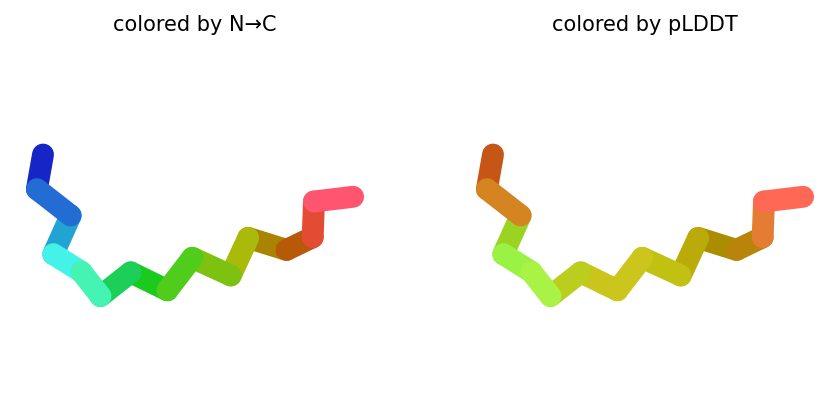

2025-11-17 09:53:01,461 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=58.8 pTM=0.0262
2025-11-17 09:53:04,054 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=59.3 pTM=0.0267 tol=1.17
2025-11-17 09:53:06,648 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=63.7 pTM=0.0271 tol=1.5
2025-11-17 09:53:09,242 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=64.2 pTM=0.0271 tol=0.397
2025-11-17 09:53:09,243 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


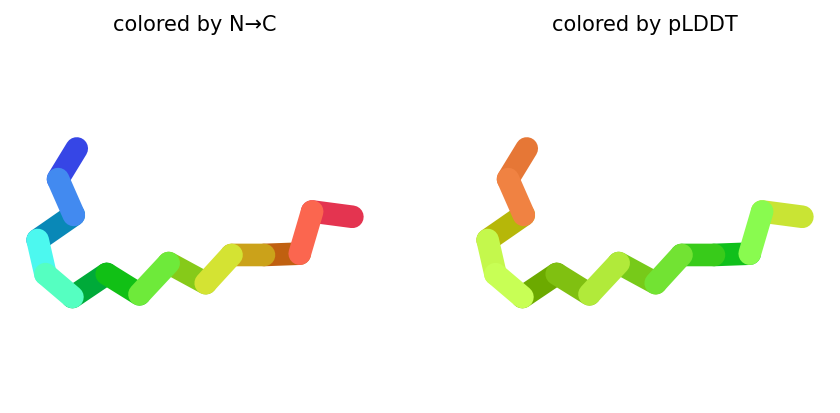

2025-11-17 09:53:11,921 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=61.2 pTM=0.0271
2025-11-17 09:53:14,513 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=62.4 pTM=0.028 tol=0.768
2025-11-17 09:53:17,103 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=63.3 pTM=0.0282 tol=0.314
2025-11-17 09:53:19,696 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=60.8 pTM=0.0279 tol=0.315
2025-11-17 09:53:19,697 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


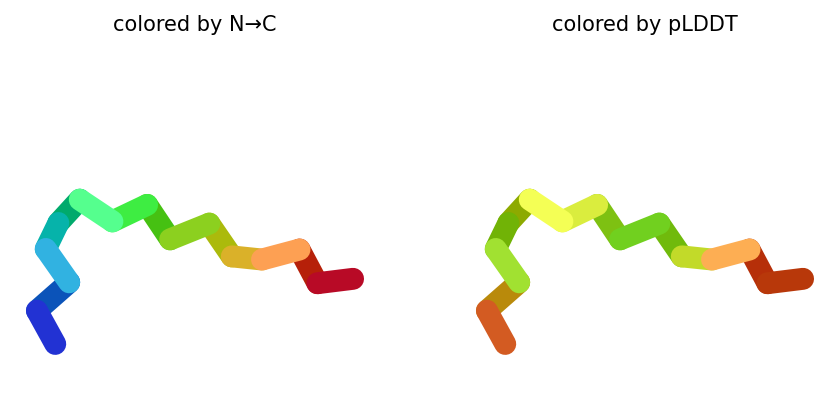

2025-11-17 09:53:22,370 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=58 pTM=0.026
2025-11-17 09:53:24,957 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=57.3 pTM=0.0266 tol=1.54
2025-11-17 09:53:27,545 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=60.6 pTM=0.0274 tol=0.961
2025-11-17 09:53:30,133 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=60.3 pTM=0.0273 tol=0.405
2025-11-17 09:53:30,134 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


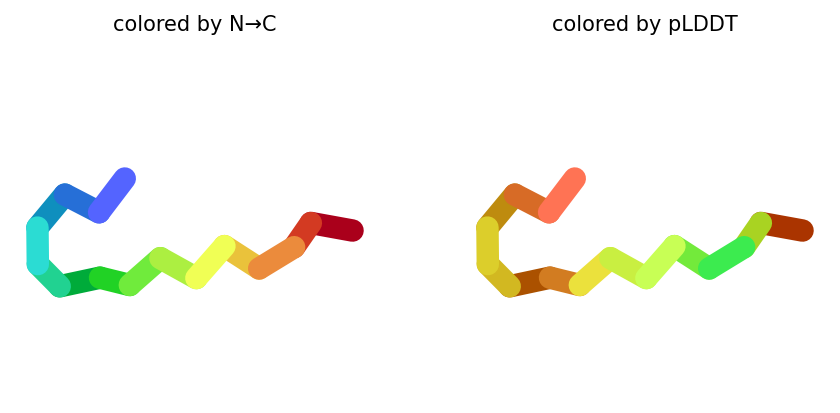

2025-11-17 09:53:30,185 reranking models by 'plddt' metric
2025-11-17 09:53:30,186 rank_001_alphafold2_ptm_model_3_seed_000 pLDDT=64.2 pTM=0.0271
2025-11-17 09:53:30,186 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=62.9 pTM=0.0281
2025-11-17 09:53:30,186 rank_003_alphafold2_ptm_model_4_seed_000 pLDDT=60.8 pTM=0.0279
2025-11-17 09:53:30,186 rank_004_alphafold2_ptm_model_5_seed_000 pLDDT=60.3 pTM=0.0273
2025-11-17 09:53:30,187 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=59.8 pTM=0.0271
2025-11-17 09:53:31,845 Query 146/146: peptide_298_IC50_499.5 (length 15)


PENDING:   0%|          | 0/150 [elapsed: 00:00 remaining: ?]

2025-11-17 09:53:32,149 Sleeping for 6s. Reason: PENDING


COMPLETE: 100%|██████████| 150/150 [elapsed: 00:06 remaining: 00:00]


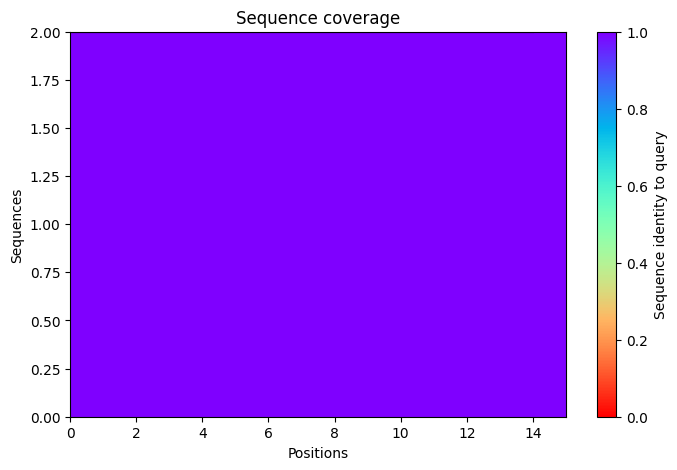

2025-11-17 09:53:43,611 alphafold2_ptm_model_1_seed_000 recycle=0 pLDDT=84.2 pTM=0.0422
2025-11-17 09:53:46,191 alphafold2_ptm_model_1_seed_000 recycle=1 pLDDT=81.4 pTM=0.0414 tol=0.12
2025-11-17 09:53:48,768 alphafold2_ptm_model_1_seed_000 recycle=2 pLDDT=82.9 pTM=0.0417 tol=0.113
2025-11-17 09:53:51,346 alphafold2_ptm_model_1_seed_000 recycle=3 pLDDT=80.8 pTM=0.0405 tol=0.0592
2025-11-17 09:53:51,347 alphafold2_ptm_model_1_seed_000 took 10.5s (3 recycles)


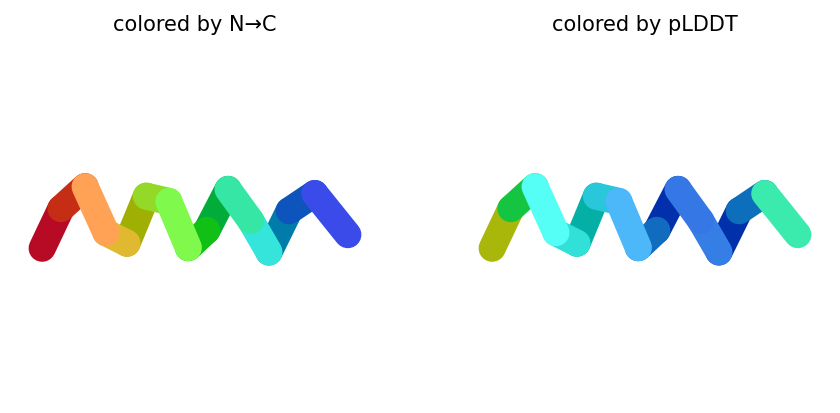

2025-11-17 09:53:53,980 alphafold2_ptm_model_2_seed_000 recycle=0 pLDDT=75.8 pTM=0.0425
2025-11-17 09:53:56,564 alphafold2_ptm_model_2_seed_000 recycle=1 pLDDT=66.5 pTM=0.0387 tol=0.26
2025-11-17 09:53:59,149 alphafold2_ptm_model_2_seed_000 recycle=2 pLDDT=65.9 pTM=0.0384 tol=0.0822
2025-11-17 09:54:01,736 alphafold2_ptm_model_2_seed_000 recycle=3 pLDDT=62.8 pTM=0.0361 tol=0.144
2025-11-17 09:54:01,737 alphafold2_ptm_model_2_seed_000 took 10.3s (3 recycles)


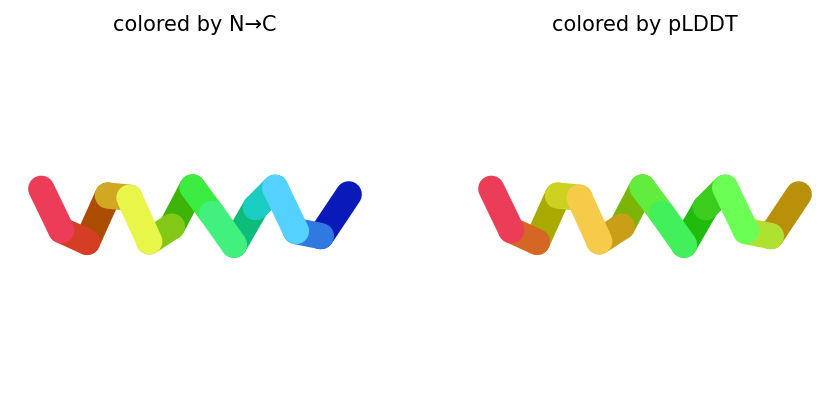

2025-11-17 09:54:04,378 alphafold2_ptm_model_3_seed_000 recycle=0 pLDDT=74.8 pTM=0.0355
2025-11-17 09:54:06,969 alphafold2_ptm_model_3_seed_000 recycle=1 pLDDT=74.8 pTM=0.0352 tol=0.146
2025-11-17 09:54:09,564 alphafold2_ptm_model_3_seed_000 recycle=2 pLDDT=72.8 pTM=0.0347 tol=0.122
2025-11-17 09:54:12,163 alphafold2_ptm_model_3_seed_000 recycle=3 pLDDT=72.9 pTM=0.0343 tol=0.0604
2025-11-17 09:54:12,164 alphafold2_ptm_model_3_seed_000 took 10.4s (3 recycles)


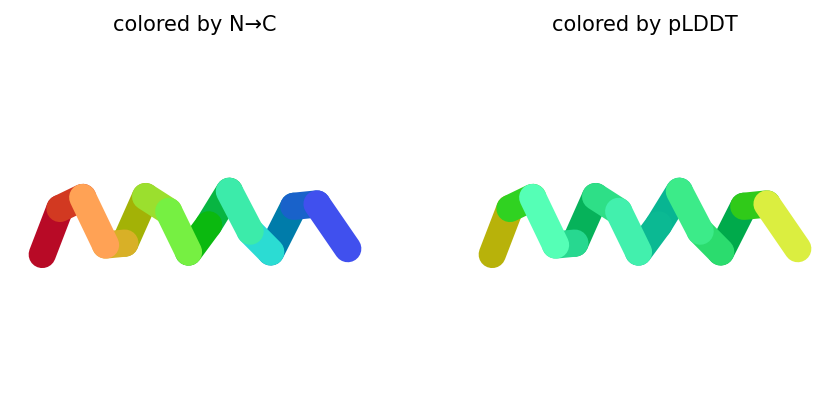

2025-11-17 09:54:14,814 alphafold2_ptm_model_4_seed_000 recycle=0 pLDDT=79.6 pTM=0.0416
2025-11-17 09:54:17,413 alphafold2_ptm_model_4_seed_000 recycle=1 pLDDT=85 pTM=0.0438 tol=0.0905
2025-11-17 09:54:20,008 alphafold2_ptm_model_4_seed_000 recycle=2 pLDDT=86.4 pTM=0.0452 tol=0.0869
2025-11-17 09:54:22,605 alphafold2_ptm_model_4_seed_000 recycle=3 pLDDT=86.9 pTM=0.045 tol=0.0341
2025-11-17 09:54:22,605 alphafold2_ptm_model_4_seed_000 took 10.4s (3 recycles)


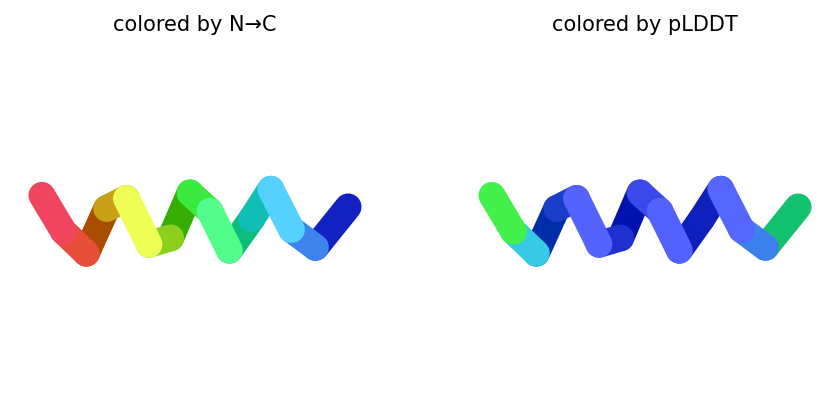

2025-11-17 09:54:25,273 alphafold2_ptm_model_5_seed_000 recycle=0 pLDDT=84.1 pTM=0.0417
2025-11-17 09:54:27,860 alphafold2_ptm_model_5_seed_000 recycle=1 pLDDT=80.6 pTM=0.0406 tol=0.166
2025-11-17 09:54:30,450 alphafold2_ptm_model_5_seed_000 recycle=2 pLDDT=80.7 pTM=0.0406 tol=0.058
2025-11-17 09:54:33,035 alphafold2_ptm_model_5_seed_000 recycle=3 pLDDT=79.9 pTM=0.0399 tol=0.0917
2025-11-17 09:54:33,035 alphafold2_ptm_model_5_seed_000 took 10.4s (3 recycles)


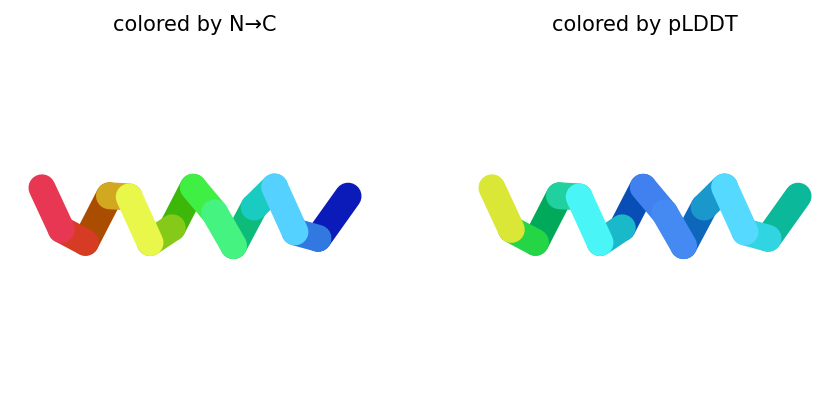

2025-11-17 09:54:33,090 reranking models by 'plddt' metric
2025-11-17 09:54:33,091 rank_001_alphafold2_ptm_model_4_seed_000 pLDDT=86.9 pTM=0.045
2025-11-17 09:54:33,091 rank_002_alphafold2_ptm_model_1_seed_000 pLDDT=80.8 pTM=0.0405
2025-11-17 09:54:33,091 rank_003_alphafold2_ptm_model_5_seed_000 pLDDT=79.9 pTM=0.0399
2025-11-17 09:54:33,091 rank_004_alphafold2_ptm_model_3_seed_000 pLDDT=72.9 pTM=0.0343
2025-11-17 09:54:33,092 rank_005_alphafold2_ptm_model_2_seed_000 pLDDT=62.8 pTM=0.0361
2025-11-17 09:54:34,415 Done


0

In [5]:
#@title Run Prediction
display_images = True #@param {type:"boolean"}

import sys
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from Bio import BiopythonDeprecationWarning
warnings.simplefilter(action='ignore', category=BiopythonDeprecationWarning)
from pathlib import Path
from colabfold.download import download_alphafold_params, default_data_dir
from colabfold.utils import setup_logging
from colabfold.batch import get_queries, run, set_model_type
from colabfold.plot import plot_msa_v2

import os
import numpy as np
try:
  K80_chk = os.popen('nvidia-smi | grep "Tesla K80" | wc -l').read()
except:
  K80_chk = "0"
  pass
if "1" in K80_chk:
  print("WARNING: found GPU Tesla K80: limited to total length < 1000")
  if "TF_FORCE_UNIFIED_MEMORY" in os.environ:
    del os.environ["TF_FORCE_UNIFIED_MEMORY"]
  if "XLA_PYTHON_CLIENT_MEM_FRACTION" in os.environ:
    del os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"]

from colabfold.colabfold import plot_protein
from pathlib import Path
import matplotlib.pyplot as plt

# For some reason we need that to get pdbfixer to import
if use_amber and f"/usr/local/lib/python{python_version}/site-packages/" not in sys.path:
    sys.path.insert(0, f"/usr/local/lib/python{python_version}/site-packages/")

def input_features_callback(input_features):
  if display_images:
    plot_msa_v2(input_features)
    plt.show()
    plt.close()

def prediction_callback(protein_obj, length,
                        prediction_result, input_features, mode):
  model_name, relaxed = mode
  if not relaxed:
    if display_images:
      fig = plot_protein(protein_obj, Ls=length, dpi=150)
      plt.show()
      plt.close()

result_dir = jobname
log_filename = os.path.join(jobname,"log.txt")
setup_logging(Path(log_filename))

queries, is_complex = get_queries(queries_path)
model_type = set_model_type(is_complex, model_type)

if "multimer" in model_type and max_msa is not None:
  use_cluster_profile = False
else:
  use_cluster_profile = True

download_alphafold_params(model_type, Path("."))
results = run(
    queries=queries,
    result_dir=result_dir,
    use_templates=use_templates,
    custom_template_path=custom_template_path,
    num_relax=num_relax,
    msa_mode=msa_mode,
    model_type=model_type,
    num_models=5,
    num_recycles=num_recycles,
    relax_max_iterations=relax_max_iterations,
    recycle_early_stop_tolerance=recycle_early_stop_tolerance,
    num_seeds=num_seeds,
    use_dropout=use_dropout,
    model_order=[1,2,3,4,5],
    is_complex=is_complex,
    data_dir=Path("."),
    keep_existing_results=False,
    rank_by="auto",
    pair_mode=pair_mode,
    pairing_strategy=pairing_strategy,
    stop_at_score=float(100),
    prediction_callback=prediction_callback,
    dpi=dpi,
    zip_results=False,
    save_all=save_all,
    max_msa=max_msa,
    use_cluster_profile=use_cluster_profile,
    input_features_callback=input_features_callback,
    save_recycles=save_recycles,
    user_agent="colabfold/google-colab-main",
    calc_extra_ptm=calc_extra_ptm,
)
results_zip = f"{jobname}.result.zip"
os.system(f"zip -r {results_zip} {jobname}")

In [13]:
#@title Display 3D structure {run: "auto"}

# Ensure py3Dmol is installed
!pip install py3Dmol

import py3Dmol
import glob
import matplotlib.pyplot as plt
import sys
import os

# Redefine python_version here to ensure it's always available
from sys import version_info
python_version = f"{version_info.major}.{version_info.minor}"

# Check for colabfold symlink and recreate if necessary
colabfold_symlink_path = '/content/colabfold'
colabfold_install_path = f'/usr/local/lib/python{python_version}/dist-packages/colabfold'

if not os.path.exists(colabfold_symlink_path) or not os.path.islink(colabfold_symlink_path):
    print(f"ColabFold symlink not found or invalid at {colabfold_symlink_path}. Recreating...")
    if os.path.exists(colabfold_symlink_path):
        os.remove(colabfold_symlink_path)
    os.system(f"ln -s {colabfold_install_path} {colabfold_symlink_path}")
    print(f"Symlink created: {colabfold_symlink_path} -> {colabfold_install_path}")

# Ensure the directory where colabfold symlinks are created is in sys.path
# This assumes the symlinks are created in /content/
if '/content/' not in sys.path:
    sys.path.insert(0, '/content/')

# Additionally, ensure the direct installation path is in sys.path as a fallback
if colabfold_install_path not in sys.path:
    sys.path.insert(0, colabfold_install_path)

from colabfold.colabfold import plot_plddt_legend
from colabfold.colabfold import pymol_color_list, alphabet_list

rank_num = 1 #@param ["1", "2", "3", "4", "5"] {type:"raw"}
color = "lDDT" #@param ["chain", "lDDT", "rainbow"]
show_sidechains = False #@param {type:"boolean"}
show_mainchains = False #@param {type:"boolean"}

# Get the list of query IDs from the results dictionary
query_ids = list(results.keys())

if not query_ids:
    raise ValueError("No prediction results found to display. Please check if the prediction ran successfully.")

def show_pdb_from_content(pdb_content, query_id_for_chains, rank_num_val=1, show_sidechains=False, show_mainchains=False, color="lDDT"):
  view = py3Dmol.view(js='https://3dmol.org/build/3Dmol.js',)
  view.addModel(pdb_content,'pdb')

  if color == "lDDT":
    view.setStyle({'cartoon': {'colorscheme': {'prop':'b','gradient': 'roygb','min':50,'max':90}}})
  elif color == "rainbow":
    view.setStyle({'cartoon': {'color':'spectrum'}})
  elif color == "chain":
    # Get the sequence of the selected_query_id to determine chains if it's a complex
    selected_query_sequence = None
    for q_id, q_seq in queries: # 'queries' is available from cell kOblAo-xetgx
        if q_id == query_id_for_chains:
            selected_query_sequence = q_seq
            break

    if selected_query_sequence:
        # Assuming chains are separated by ':' in the sequence string for complexes
        chains_count = len(selected_query_sequence.split(':'))
        for n in range(chains_count):
            chain_char = alphabet_list[n]
            color_val = pymol_color_list[n]
            view.setStyle({'chain': chain_char}, {'cartoon': {'color': color_val}})
    else:
        # Fallback for single chain or if sequence not found (shouldn't happen with correct parsing)
        view.setStyle({'cartoon': {'color':'spectrum'}})

  if show_sidechains:
    BB = ['C','O','N']
    view.addStyle({'and':[{'resn':["GLY","PRO"],'invert':True},{'atom':BB,'invert':True}]},
                        {'stick':{'colorscheme':"WhiteCarbon",'radius':0.3}})
    view.addStyle({'and':[{'resn':"GLY"},{'atom':'CA'}]},
                        {'sphere':{'colorscheme':"WhiteCarbon",'radius':0.3}})
    view.addStyle({'and':[{'resn':"PRO"},{'atom':['C','O'],'invert':True}]},
                        {'stick':{'colorscheme':"WhiteCarbon",'radius':0.3}})
  if show_mainchains:
    BB = ['C','O','N','CA']
    view.addStyle({'atom':BB},{'stick':{'colorscheme':"WhiteCarbon",'radius':0.3}})

  view.zoomTo()
  return view

# Loop through all query IDs and display the top-ranked model for each
for i, selected_query_id in enumerate(query_ids):
    print(f"Displaying model for query: {selected_query_id}")

    ranked_models_for_query = results[selected_query_id]['ranked_order']

    if not ranked_models_for_query:
        print(f"No ranked models found for query: {selected_query_id}, skipping.")
        continue

    # Get the tag (model identifier) for the selected rank
    model_tag = ranked_models_for_query[rank_num - 1]

    # Get the PDB content directly from the results dictionary
    pdb_content_to_display = results[selected_query_id]['unrelaxed_pdb'][model_tag]

    # Call the updated show_pdb_from_content function
    view = show_pdb_from_content(pdb_content_to_display, selected_query_id, rank_num, show_sidechains, show_mainchains, color)
    view.show()

    # Display pLDDT legend only once
    if i == 0 and color == "lDDT":
      plot_plddt_legend().show()

print("Finished displaying all models.")

ColabFold symlink not found or invalid at /content/colabfold. Recreating...
Symlink created: /content/colabfold -> /usr/local/lib/python3.12/dist-packages/colabfold


ModuleNotFoundError: No module named 'colabfold'

In [ ]:
#@title Plots {run: "auto"}
from IPython.display import display, HTML
import base64
from html import escape

# see: https://stackoverflow.com/a/53688522
def image_to_data_url(filename):
  ext = filename.split('.')[-1]
  prefix = f'data:image/{ext};base64,'
  with open(filename, 'rb') as f:
    img = f.read()
  return prefix + base64.b64encode(img).decode('utf-8')

pae = ""
pae_file = os.path.join(jobname,f"{jobname}{jobname_prefix}_pae.png")
if os.path.isfile(pae_file):
    pae = image_to_data_url(pae_file)
cov = image_to_data_url(os.path.join(jobname,f"{jobname}{jobname_prefix}_coverage.png"))
plddt = image_to_data_url(os.path.join(jobname,f"{jobname}{jobname_prefix}_plddt.png"))
display(HTML(f"""
<style>
  img {{
    float:left;
  }}
  .full {{
    max-width:100%;
  }}
  .half {{
    max-width:50%;
  }}
  @media (max-width:640px) {{
    .half {{
      max-width:100%;
    }}
  }}
</style>
<div style="max-width:90%; padding:2em;">
  <h1>Plots for {escape(jobname)}</h1>
  { '<!--' if pae == '' else '' }<img src="{pae}" class="full" />{ '-->' if pae == '' else '' }
  <img src="{cov}" class="half" />
  <img src="{plddt}" class="half" />
</div>
"""))

In [ ]:
#@title Package and download results
#@markdown If you are having issues downloading the result archive, try disabling your adblocker and run this cell again. If that fails click on the little folder icon to the left, navigate to file: `jobname.result.zip`, right-click and select \"Download\" (see [screenshot](https://pbs.twimg.com/media/E6wRW2lWUAEOuoe?format=jpg&name=small)).

if msa_mode == "custom":
  print("Don't forget to cite your custom MSA generation method.")

files.download(f"{jobname}.result.zip")

if save_to_google_drive == True and drive:
  uploaded = drive.CreateFile({'title': f"{jobname}.result.zip"})
  uploaded.SetContentFile(f"{jobname}.result.zip")
  uploaded.Upload()
  print(f"Uploaded {jobname}.result.zip to Google Drive with ID {uploaded.get('id')}")

# Instructions <a name="Instructions"></a>
For detailed instructions, tips and tricks, see recently published paper at [Nature Protocols](https://www.nature.com/articles/s41596-024-01060-5)

**Quick start**
1. Paste your protein sequence(s) in the input field.
2. Press "Runtime" -> "Run all".
3. The pipeline consists of 5 steps. The currently running step is indicated by a circle with a stop sign next to it.

**Result zip file contents**

1. PDB formatted structures sorted by avg. pLDDT and complexes are sorted by pTMscore. (unrelaxed and relaxed if `use_amber` is enabled).
2. Plots of the model quality.
3. Plots of the MSA coverage.
4. Parameter log file.
5. A3M formatted input MSA.
6. A `predicted_aligned_error_v1.json` using [AlphaFold-DB's format](https://alphafold.ebi.ac.uk/faq#faq-7) and a `scores.json` for each model which contains an array (list of lists) for PAE, a list with the average pLDDT and the pTMscore.
7. BibTeX file with citations for all used tools and databases.

At the end of the job a download modal box will pop up with a `jobname.result.zip` file. Additionally, if the `save_to_google_drive` option was selected, the `jobname.result.zip` will be uploaded to your Google Drive.

**MSA generation for complexes**

For the complex prediction we use unpaired and paired MSAs. Unpaired MSA is generated the same way as for the protein structures prediction by searching the UniRef100 and environmental sequences three iterations each.

The paired MSA is generated by searching the UniRef100 database and pairing the best hits sharing the same NCBI taxonomic identifier (=species or sub-species). We only pair sequences if all of the query sequences are present for the respective taxonomic identifier.

**Using a custom MSA as input**

To predict the structure with a custom MSA (A3M formatted): (1) Change the `msa_mode`: to "custom", (2) Wait for an upload box to appear at the end of the "MSA options ..." box. Upload your A3M. The first fasta entry of the A3M must be the query sequence without gaps.

It is also possilbe to provide custom MSAs for complex predictions. Read more about the format [here](https://github.com/sokrypton/ColabFold/issues/76).

As an alternative for MSA generation the [HHblits Toolkit server](https://toolkit.tuebingen.mpg.de/tools/hhblits) can be used. After submitting your query, click "Query Template MSA" -> "Download Full A3M". Download the A3M file and upload it in this notebook.

**PDB100** <a name="pdb100"></a>

As of 23/06/08, we have transitioned from using the PDB70 to a 100% clustered PDB, the PDB100. The construction methodology of PDB100 differs from that of PDB70.

The PDB70 was constructed by running each PDB70 representative sequence through [HHblits](https://github.com/soedinglab/hh-suite) against the [Uniclust30](https://uniclust.mmseqs.com/). On the other hand, the PDB100 is built by searching each PDB100 representative structure with [Foldseek](https://github.com/steineggerlab/foldseek) against the [AlphaFold Database](https://alphafold.ebi.ac.uk).

To maintain compatibility with older Notebook versions and local installations, the generated files and API responses will continue to be named "PDB70", even though we're now using the PDB100.

**Using custom templates** <a name="custom_templates"></a>

To predict the structure with a custom template (PDB or mmCIF formatted): (1) change the `template_mode` to "custom" in the execute cell and (2) wait for an upload box to appear at the end of the "Input Protein" box. Select and upload your templates (multiple choices are possible).

* Templates must follow the four letter PDB naming with lower case letters.

* Templates in mmCIF format must contain `_entity_poly_seq`. An error is thrown if this field is not present. The field `_pdbx_audit_revision_history.revision_date` is automatically generated if it is not present.

* Templates in PDB format are automatically converted to the mmCIF format. `_entity_poly_seq` and `_pdbx_audit_revision_history.revision_date` are automatically generated.

If you encounter problems, please report them to this [issue](https://github.com/sokrypton/ColabFold/issues/177).

**Comparison to the full AlphaFold2 and AlphaFold2 Colab**

This notebook replaces the homology detection and MSA pairing of AlphaFold2 with MMseqs2. For a comparison against the [AlphaFold2 Colab](https://colab.research.google.com/github/deepmind/alphafold/blob/main/notebooks/AlphaFold.ipynb) and the full [AlphaFold2](https://github.com/deepmind/alphafold) system read our [paper](https://www.nature.com/articles/s41592-022-01488-1).

**Troubleshooting**
* Check that the runtime type is set to GPU at "Runtime" -> "Change runtime type".
* Try to restart the session "Runtime" -> "Factory reset runtime".
* Check your input sequence.

**Known issues**
* Google Colab assigns different types of GPUs with varying amount of memory. Some might not have enough memory to predict the structure for a long sequence.
* Your browser can block the pop-up for downloading the result file. You can choose the `save_to_google_drive` option to upload to Google Drive instead or manually download the result file: Click on the little folder icon to the left, navigate to file: `jobname.result.zip`, right-click and select \"Download\" (see [screenshot](https://pbs.twimg.com/media/E6wRW2lWUAEOuoe?format=jpg&name=small)).

**Limitations**
* Computing resources: Our MMseqs2 API can handle ~20-50k requests per day.
* MSAs: MMseqs2 is very precise and sensitive but might find less hits compared to HHblits/HMMer searched against BFD or MGnify.
* We recommend to additionally use the full [AlphaFold2 pipeline](https://github.com/deepmind/alphafold).

**Description of the plots**
*   **Number of sequences per position** - We want to see at least 30 sequences per position, for best performance, ideally 100 sequences.
*   **Predicted lDDT per position** - model confidence (out of 100) at each position. The higher the better.
*   **Predicted Alignment Error** - For homooligomers, this could be a useful metric to assess how confident the model is about the interface. The lower the better.

**Bugs**
- If you encounter any bugs, please report the issue to https://github.com/sokrypton/ColabFold/issues

**License**

The source code of ColabFold is licensed under [MIT](https://raw.githubusercontent.com/sokrypton/ColabFold/main/LICENSE). Additionally, this notebook uses the AlphaFold2 source code and its parameters licensed under [Apache 2.0](https://raw.githubusercontent.com/deepmind/alphafold/main/LICENSE) and [CC BY 4.0](https://creativecommons.org/licenses/by-sa/4.0/) respectively. Read more about the AlphaFold license [here](https://github.com/deepmind/alphafold).

**Acknowledgments**
- We thank the AlphaFold team for developing an excellent model and open sourcing the software.

- [KOBIC](https://kobic.re.kr) and [Söding Lab](https://www.mpinat.mpg.de/soeding) for providing the computational resources for the MMseqs2 MSA server.

- Richard Evans for helping to benchmark the ColabFold's Alphafold-multimer support.

- [David Koes](https://github.com/dkoes) for his awesome [py3Dmol](https://3dmol.csb.pitt.edu/) plugin, without whom these notebooks would be quite boring!

- Do-Yoon Kim for creating the ColabFold logo.

- A colab by Sergey Ovchinnikov ([@sokrypton](https://twitter.com/sokrypton)), Milot Mirdita ([@milot_mirdita](https://twitter.com/milot_mirdita)) and Martin Steinegger ([@thesteinegger](https://twitter.com/thesteinegger)).
